In [1]:
import numpy as np
import scipy.constants as const
import pandas as pd
from scipy.integrate import quad
import matplotlib.pyplot as plt
g=const.g
import scipy
import json


In [2]:
#плотность воды при разных температурах,кг/м3
#T_К,Тстан=277(К)
def rho(T):
    rho=1000/(1+((T-273)/10000*(0.269*(T-273)**0.637-0.8)))
    return rho

In [3]:
#cosa-учет инклинометрии скважины
df = pd.DataFrame(columns=['MD', 'TVD'], data=[[0, 0], [384.50,310.5], [ 769, 325]])
df

,MD,TVD
0,0.0,0.0
1,384.5,310.5
2,769.0,325.0


In [4]:
MD=df['MD']
TVD=df['TVD']
cos_a=np.zeros(len(MD))
for i in range (1,len(MD)):
    cos_a[i]=(TVD[i]-TVD[i-1])/(MD[i]-MD[i-1])

In [5]:
def Cos_angle(x):
    if x <= MD[1]:
        cos=cos_a[1]
    else: 
        cos=cos_a[2]
    return cos    
# print(Cos_angle(334.5)

In [6]:
#число Рейнольдса
def Re(rho,mu,d,v):
    #rho - kg/m3
    #mu - Pa*s
    #d - m
    #v-m/s
    return (rho*v*d)/(mu)

In [7]:
def mu(P,T):
    #T-K
    #P-MPa
    A= 109.574
    B= 1.1217
    m= A *((1.8*T - 460)**(-B))*( 0.9994 + 0.0058*P/10**6 + 0.6534 * 10**(-4)*(P/10**6)**2)
    return m/10**6

In [8]:
#определение коэфициента трения согласно режиму течения
#e-m
def friction(Re):
    if Re<3000:
        f=64/Re
    else:
        f=1/(1.14-2*np.log10(e/d+21.25/Re**0.9))**2
    return f   

In [9]:
#функция определения температуры
def tempreture(x):
    if x<=MD[1]:
        y=Cos_angle(x)*x
    else:
        y=Cos_angle(x)*(x - MD[1])+TVD[1]
    return T_0 + y*(T_wf-T_0)/TVD[2]


In [10]:
#функция определения производной давления по координате 
def dp_dx(x):
    T=tempreture(x)  
    P=p[-1]
    mu_x=mu(P,T)
    rho_x=rho(T)
    Re_x=Re(rho_x,mu_x,d,v)
#     print(Re_x)
    dp_dx=rho_x*g*Cos_angle(x)-((friction(Re_x)*rho_x*v**2)/(d*2))
#     print("dp_dx=",dp_dx)
    return dp_dx

In [11]:
#Расчет распределения давления в скважине 
e=8*10**(-5)
d=148*10**(-3)
Q=888/86400
v=4*Q/(const.pi*d**2)
P_wh=22.9 * 101325 # P=22.9 atm
T_0=299.2 #T=26.2 C
T_wf=299.2+50
H=769
l=np.linspace(0,H,100)
p=[]
p.append(P_wh)
for i in range(len(l)-1):
    p.append(p[-1]+ quad(dp_dx,l[i],l[i+1])[0])
#     print(p)    
p_atm = [i/101325 for i in p]

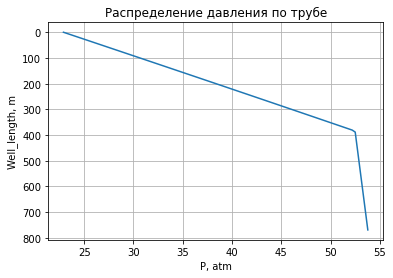

In [12]:
plt.plot(p_atm,l)
plt.title('Распределение давления по трубе')
ax=plt.gca()
ax.invert_yaxis()
plt.grid()
plt.xlabel('P, atm')
plt.ylabel('Well_length, m')
plt.show()

[2320342.5, 2381631.3853955287]
[2320342.5, 2381631.3853955287, 2442903.7285759123]
[2320342.5, 2381631.3853955287, 2442903.7285759123, 2504159.0608817074]
[2320342.5, 2381631.3853955287, 2442903.7285759123, 2504159.0608817074, 2565396.9203515714]
[2320342.5, 2381631.3853955287, 2442903.7285759123, 2504159.0608817074, 2565396.9203515714, 2626616.8514637575]
[2320342.5, 2381631.3853955287, 2442903.7285759123, 2504159.0608817074, 2565396.9203515714, 2626616.8514637575, 2687818.4048974877]
[2320342.5, 2381631.3853955287, 2442903.7285759123, 2504159.0608817074, 2565396.9203515714, 2626616.8514637575, 2687818.4048974877, 2749001.1373121124]
[2320342.5, 2381631.3853955287, 2442903.7285759123, 2504159.0608817074, 2565396.9203515714, 2626616.8514637575, 2687818.4048974877, 2749001.1373121124, 2810164.611142244]
[2320342.5, 2381631.3853955287, 2442903.7285759123, 2504159.0608817074, 2565396.9203515714, 2626616.8514637575, 2687818.4048974877, 2749001.1373121124, 2810164.611142244, 2871308.394407

[2320342.5, 2381631.376422014, 2442903.710634057, 2504159.033976637, 2565396.8844883693, 2626616.80664747, 2687818.35113313, 2749001.0746046724, 2810164.5394966872, 2871308.3138285507, 2932431.97102695, 2993535.08976019, 3054617.2537832037, 3115678.0517923227, 3176717.0772889466, 3237733.92845137, 3298728.2080140836, 3359699.5231539495, 3420647.4853827036, 3481571.7104452997, 3542471.8182236487, 3603347.4326453554, 3664198.181597087, 3725023.696842251, 3785823.6139426664, 3846597.572183972, 3907345.2145045064, 3968066.187427437, 4028760.1409959253, 4089426.728711136, 4150065.607472909, 4210676.437522929, 4271258.882390249, 4331812.608839014, 4392337.28681827, 4452832.589413723, 4513298.19280135, 4573733.776202744, 4634139.021842113, 4694513.614904828, 4754857.243497445, 4815169.598609118, 4875450.374074332, 4935699.266536893, 4995915.975415097, 5056100.2028680295, 5116251.653762945, 5176370.035643647, 5236455.058699857, 5296506.435737492, 5327920.76881981, 5330723.414798748, 5333525.98

[2320342.5, 2381631.3244315092, 2442903.606678566, 2504158.878081586, 2565396.676679116, 2626616.5469493256, 2687818.0395713784, 2749000.71120459, 2810164.124283558, 2871307.8468276835, 2932431.4522636905, 2993534.5192599343, 3054616.631571411, 3115677.3778945245, 3176716.3517307574, 3237733.151258496, 3298727.379212331, 3359698.6427692324, 3420646.5534410505, 3481570.7269728603, 3542470.7832466993, 3603346.346190304]
[2320342.5, 2381631.3244315092, 2442903.606678566, 2504158.878081586, 2565396.676679116, 2626616.5469493256, 2687818.0395713784, 2749000.71120459, 2810164.124283558, 2871307.8468276835, 2932431.4522636905, 2993534.5192599343, 3054616.631571411, 3115677.3778945245, 3176716.3517307574, 3237733.151258496, 3298727.379212331, 3359698.6427692324, 3420646.5534410505, 3481570.7269728603, 3542470.7832466993, 3603346.346190304, 3664197.04369048]
[2320342.5, 2381631.3244315092, 2442903.606678566, 2504158.878081586, 2565396.676679116, 2626616.5469493256, 2687818.0395713784, 2749000.7

[2320342.5, 2381631.3161223386, 2442903.5900639454, 2504158.853165237, 2565396.643464762, 2626616.505440696, 2687817.989772212, 2749000.653118636, 2810164.0579145784, 2871307.772179454, 2932431.369340004, 2993534.4280646, 3054616.532108258, 3115677.2701674015, 3176716.2357435348, 3237733.0270150662, 3298727.2467166106, 3359698.5020251614, 3420646.4044525945, 3481570.56974401, 3542470.6177814724, 3603346.172492745, 3664196.86176466, 3725022.317360794, 3785822.1748431413, 3846596.073497518, 3907343.656262445, 3968064.5696612746, 4028758.4637373574, 4089424.9919920494, 4150063.811325384, 4210674.581979242, 4271256.967482875, 4331810.634600629, 4392335.253281751, 4452830.496612149, 4513296.040768006, 4573731.564971119, 4634136.751445903, 4694511.285377938, 4754854.854873987, 4815167.150923411, 4875447.867360907, 4935696.700830487, 4995913.350750658, 5056097.519280715, 5116248.911288122, 5176367.234316892, 5236452.198556955, 5296503.516814438, 5327917.791148465, 5330720.378385094, 5333522.8

[2320342.5, 2381631.2982973116, 2442903.554421681, 2504158.7997135334, 2565396.5722114327, 2626616.416393575, 2687817.882939156, 2749000.5285075326, 2810163.915533347, 2871307.6120360517, 2932431.191442427, 2993534.2324208887, 3054616.318726497, 3115677.0390557237, 3176715.9869101234, 3237732.7604681575, 3298726.9624644937, 3359698.200076182, 3420646.084815155, 3481570.2324265717, 3542470.262792556, 3603345.7998409327, 3664196.471458596, 3725021.909409185, 3785821.7492547566, 3846595.6302811927, 3907343.1954270783, 3968064.0912158317, 4028757.9676908692, 4089424.4783536135, 4150063.2801041645, 4210674.033184471, 4271256.401123851, 4331810.050686718, 4392334.651822386, 4452829.877616834]
[2320342.5, 2381631.2982973116, 2442903.554421681, 2504158.7997135334, 2565396.5722114327, 2626616.416393575, 2687817.882939156, 2749000.5285075326, 2810163.915533347, 2871307.6120360517, 2932431.191442427, 2993534.2324208887, 3054616.318726497, 3115677.0390557237, 3176715.9869101234, 3237732.7604681575

[2320342.5, 2381631.2788634645, 2442903.515562239, 2504158.7414367683, 2565396.494525642, 2626616.3193070875, 2687817.7664603363, 2749000.392644784, 2810163.7602951173, 2871307.4374308353, 2932430.997478769, 2993534.019107387, 3054616.086071805, 3115676.7870685537, 3176715.7155992477, 3237732.46984241, 3298726.652532773, 3359697.8708474515, 3420645.736298445, 3481569.8646309813, 3542469.875727253, 3603345.393515155, 3664196.0458816537, 3725021.4645904596, 3785821.2852037027, 3846595.147007338, 3907342.6929400247, 3968063.5695252554, 4028757.4268065216, 4089423.918285321, 4150062.7008618284, 4210673.434778069, 4271255.783563436, 4331809.413982419, 4392333.995984411, 4452829.202655463, 4513294.7101719, 4573730.197755666, 4634135.34763132, 4694509.844984585, 4754853.377922368, 4815165.637434175, 4875446.317354846, 4935695.114328535, 4995911.727773894, 5056095.859850359, 5116247.215425537, 5176365.502043583]
[2320342.5, 2381631.2788634645, 2442903.515562239, 2504158.7414367683, 2565396.494

[2320342.5, 2381631.2466963655, 2442903.4512412813, 2504158.6449752436, 2565396.3659369014, 2626616.158604548, 2687817.573657489, 2749000.1677551996, 2810163.503332453, 2871307.148408837, 2932430.676411279, 2993533.666008346, 3054615.700955257, 3115676.369948649, 3176715.2664902452, 3237731.988758681, 3298726.1394888028, 3359697.3258578423, 3420645.159377918]
[2320342.5, 2381631.2466963655, 2442903.4512412813, 2504158.6449752436, 2565396.3659369014, 2626616.158604548, 2687817.573657489, 2749000.1677551996, 2810163.503332453, 2871307.148408837, 2932430.676411279, 2993533.666008346, 3054615.700955257, 3115676.369948649, 3176715.2664902452, 3237731.988758681, 3298726.1394888028, 3359697.3258578423, 3420645.159377918, 3481569.2557943775]
[2320342.5, 2381631.2466963655, 2442903.4512412813, 2504158.6449752436, 2565396.3659369014, 2626616.158604548, 2687817.573657489, 2749000.1677551996, 2810163.503332453, 2871307.148408837, 2932430.676411279, 2993533.666008346, 3054615.700955257, 3115676.369

[2320342.5, 2381631.2351696854, 2442903.4281925643, 2504158.6104091546, 2565396.319858131, 2626616.101017814, 2687817.5045675403, 2749000.087166816, 2810163.4112504483, 2871307.0448380616, 2932430.5613566185, 2993533.5394747253, 3054615.5629476407, 3115676.2204720415, 3176715.1055496926, 3237731.8163592718, 3298725.9556356687, 3359697.1305561587, 3420644.9526329045, 3481569.0376112987, 3542469.0053737015, 3603344.4798481767, 3664195.088921861, 3725020.464358636, 3785820.241720807, 3846594.0602945015, 3907341.5630185544, 3968062.396416634, 4028756.2105324077, 4089422.6588675505, 4150061.3983224146, 4210672.089139202, 4271254.394847483, 4331807.982211927, 4392332.521182101]
[2320342.5, 2381631.2351696854, 2442903.4281925643, 2504158.6104091546, 2565396.319858131, 2626616.101017814, 2687817.5045675403, 2749000.087166816, 2810163.4112504483, 2871307.0448380616, 2932430.5613566185, 2993533.5394747253, 3054615.5629476407, 3115676.2204720415, 3176715.1055496926, 3237731.8163592718, 3298725.95

[2320342.5, 2381631.2109099086, 2442903.379682638, 2504158.5376587603, 2565396.222877009, 2626615.979815768, 2687817.359154443, 2748999.917552612, 2810163.2174451575, 2871306.8268517833, 2932430.3191995337, 2993533.2731570993, 3054615.272479825, 3115675.905864477, 3176714.7668129103, 3237731.453503895, 3298725.5686724144, 3359696.719495839, 3420644.5174864274, 3481568.5783896693, 3542468.5220880224, 3603343.97250965, 3664194.557541788, 3725019.9089484187, 3785819.6622919464, 3846593.4568586005, 3907340.9355873168, 3968061.7450018646, 4028755.5351460134, 4089421.959521539, 4150060.675028896, 4210671.341910387, 4271253.623695687, 4331807.187149564, 4392331.702221687, 4452826.841998389, 4513292.282656273, 4573727.70341756, 4634132.786507087, 4694507.217110853, 4754850.683336041, 4815162.876172433, 4875443.489455141, 4935692.219828596, 4995908.766711719, 5056092.83226422, 5116244.121353974, 5176362.341525405, 5236447.202968853, 5296498.41849085, 5327912.590143549, 5330715.074709039, 533351

[2320342.5, 2381631.198176827, 2442903.3542214595, 2504158.499474501, 2565396.1719747176, 2626615.916200531, 2687817.2828313834, 2748999.828526894, 2810163.115721987, 2871306.7124364097, 2932430.1920972513, 2993533.133373248, 3054615.1200197926, 3115675.740733699, 3176714.5890168715, 3237731.26304813, 3298725.3655625083, 3359696.503737428, 3420644.2890852, 3481568.3373513655, 3542468.2684184355, 3603343.706214626, 3664194.2786272257, 3725019.6174202706, 3785819.358156219, 3846593.140121354, 3907340.6062546647, 3968061.4030799754, 4028755.1806411096, 4089421.592439897, 4150060.295376846, 4210670.949694315, 4271253.21892203, 4331806.769824815, 4392331.272352393, 4452826.39959115, 4513291.827717743, 4573727.235954448, 4634132.306526152, 4694506.724618911, 4754850.178339958, 4815162.358679129, 4875442.959471589, 4935691.677361821, 4995908.211768798, 5056092.264852282, 5116243.5414801985, 5176361.749197026, 5236446.598193153, 5296497.801275163, 5327911.960494375, 5330714.432627601, 5333516.

[2320342.5, 2381631.1715043136, 2442903.300886743, 2504158.4194879616, 2565396.065346813, 2626615.7829417977, 2687817.122952444, 2748999.6420384594, 2810162.90263486, 2871306.472761487, 2932429.9258455285, 2993532.8405558206, 3054614.800647858, 3115675.3948185584, 3176714.2165699326, 3237730.864080908, 3298724.9400866264, 3359696.0517646195, 3420643.8106273087, 3481567.8324203473, 3542467.7370263585, 3603343.1483736713, 3664193.694349688, 3725019.0067185587, 3785818.721042856, 3846592.476608977, 3907339.916356027, 3968060.686807944, 4028754.4380086665, 4089420.8234601393, 4150059.5000629863, 4210670.12805968, 4271252.370980061, 4331805.895589067, 4392330.371836537, 4452825.472808969, 4513290.874683135, 4573726.256681423, 4634131.301028834]
[2320342.5, 2381631.1715043136, 2442903.300886743, 2504158.4194879616, 2565396.065346813, 2626615.7829417977, 2687817.122952444, 2748999.6420384594, 2810162.90263486, 2871306.472761487, 2932429.9258455285, 2993532.8405558206, 3054614.800647858, 31156

[2320342.5, 2381631.1575648943, 2442903.27301323, 2504158.37768572, 2565396.0096212495, 2626615.7132983645, 2687817.039396639, 2748999.5445758286, 2810162.7912709997, 2871306.347502046, 2932429.786696207, 2993532.687522373, 3054614.633736095, 3115675.2140343455, 3176714.0219191923, 3237730.65556962, 3298724.717720829, 3359695.8155504093, 3420643.5605708417, 3481567.5685278387, 3542467.459304083, 3603342.8568279645, 3664193.388986945, 3725018.687545236, 3785818.38806547, 3846592.1298341053, 3907339.5557903075, 3968060.3124580756, 4028754.0498814094, 4089420.421562314, 4150059.0844014743, 4210669.698641423, 4271251.927812062, 4331805.438678389, 4392329.901190303, 4452824.988434363, 4513290.376587399, 4573725.74487186, 4634130.775512808, 4694505.153696466, 4754848.567530242, 4815160.70800414, 4875441.268953497, 4935689.947022961, 4995906.441631678, 5056090.454939574, 5116241.691814743, 5176359.859801827, 5236444.66909138, 5296495.832490151, 5327909.952046802, 5330712.384521362, 5333514.74

[2320342.5, 2381631.143223375, 2442903.24433563, 2504158.3346775207, 2565395.9522879766, 2626615.6416455912, 2687816.953429988, 2748999.444300974, 2810162.6766936677, 2871306.218628017, 2932429.643531318, 2993532.5300725168, 3054614.4620072213, 3115675.0280324635, 3176713.8216503705, 3237730.4410399864, 3298724.488936573, 3359695.57251778, 3420643.303296151, 3481567.2970174598, 3542467.1735644517, 3603342.5568655785, 3664193.0748083657, 3725018.359157087, 3785818.0454744375, 3846591.7730469396, 3907339.184813821, 3968059.9272991447, 4028753.6505469726, 4089420.0080593736, 4150058.6567370947, 4210669.256822731, 4271251.471846249, 4331804.968572708, 4392329.416952069, 4452824.490070953, 4513289.864106254, 4573725.21828048, 4634130.234818756, 4694504.598907366, 4754847.99865378, 4815160.125048062, 4875440.671925608, 4935689.33593113, 4995905.816483829, 5056089.815743694, 5116241.038578877, 5176359.192534081, 5236443.987799916, 5296495.137183191, 5327909.242731634, 5330711.661199356, 53335

[2320342.5, 2381631.113334059, 2442903.1845682138, 2504158.245043314, 2565395.8327983883, 2626615.492312133, 2687816.774264278, 2748999.235314741, 2810162.4378987546, 2871305.9500363832, 2932429.345155041, 2993532.2019237964, 3054614.1040983796, 3115674.6403759476, 3176713.4042587536, 3237729.99392597, 3298724.0121129863, 3359695.0659975833, 3420642.7670924333, 3481566.7311434424, 3542466.5780334873, 3603341.931691152, 3664192.4200040945]
[2320342.5, 2381631.113334059, 2442903.1845682138, 2504158.245043314, 2565395.8327983883, 2626615.492312133, 2687816.774264278, 2748999.235314741, 2810162.4378987546, 2871305.9500363832, 2932429.345155041, 2993532.2019237964, 3054614.1040983796, 3115674.6403759476, 3176713.4042587536, 3237729.99392597, 3298724.0121129863, 3359695.0659975833, 3420642.7670924333, 3481566.7311434424, 3542466.5780334873, 3603341.931691152, 3664192.4200040945, 3725017.674736721]
[2320342.5, 2381631.113334059, 2442903.1845682138, 2504158.245043314, 2565395.8327983883, 26266

[2320342.5, 2381631.097786272, 2442903.1534784175, 2504158.198417337, 2565395.770642113, 2626615.414631497, 2687816.681065277, 2748999.1266034306, 2810162.313681251, 2871305.810318864, 2932429.189943748, 2993532.031225036, 3054613.9179185233, 3115674.4387214337, 3176713.187136087, 3237729.761341723, 3298723.7640738, 3359694.8025101665, 3420642.488163565, 3481566.4367799694, 3542466.268242327, 3603341.606479291, 3664192.079378589, 3725017.318704698, 3785816.9600205156, 3846590.642612767, 3907338.0094208834, 3968058.70696913, 4028752.3853017716, 4089418.69792108, 4150057.3017280037, 4210667.85696534, 4271250.027163255, 4331803.479087009, 4392327.882686763, 4452822.911049338, 4513288.240351825, 4573723.549816932, 4634128.521669977, 4694502.841097445, 4754846.196206997, 4815158.277988894, 4875438.780278724, 4935687.3997213915, 4995903.83573629, 5056087.790483597, 5116238.968831656, 5176357.078325355, 5236441.829155496, 5296492.934129071, 5327906.995290855, 5330709.36937626, 5333511.6691230

[2320342.5, 2381631.0818364057, 2442903.1215845756, 2504158.1505854637, 2565395.706878209, 2626615.334941622, 2687816.5854555503, 2748999.015080034, 2810162.1862504296, 2871305.6669869293, 2932429.0307170763, 2993531.8561100713, 3054613.7269217777, 3115674.2318494883, 3176712.9643955925, 3237729.5227393997, 3298723.5096164388, 3359694.5322046303, 3420642.202016787, 3481566.1347989556, 3542465.950434155, 3603341.2728511095, 3664191.72993762, 3725016.953458235, 3785816.578975925, 3846590.2457774873, 3907337.596802425, 3968058.278575076, 4028751.9411397767, 4089418.2379988707, 4150056.8260533786, 4210667.365546169, 4271249.520007479, 4331802.956202641, 4392327.344081887, 4452822.356732108, 4513287.670330465, 4573722.964099735, 4634127.920265309, 4694502.224013737, 4754845.563452753, 4815157.629572685, 4875438.116209189, 4935686.72000724, 4995903.1403862955, 5056087.079506604, 5116238.242236573, 5176356.33612116, 5236441.07135123, 5296492.160733842, 5327906.2063127365, 5330708.564816774, 5

[2320342.5, 2381631.0654844646, 2442903.088886697, 2504158.1015477073, 2565395.641506694, 2626615.2532425285, 2687816.4874351225, 2748998.9007445807, 2810162.055606326, 2871305.520040618, 2932428.867475069, 2993531.6765789497, 3054613.531108194, 3115674.0197601663, 3176712.736037328, 3237729.278119061, 3298723.2487409683, 3359694.255081043, 3420641.908652172, 3481565.825200476, 3542465.6246090485, 3603340.9308066885, 3664191.371681271, 3725016.578997419, 3785816.1883181785, 3846589.8389304206, 3907337.173773723, 3968057.839372498, 4028751.4857711564, 4089417.7664721156, 4150056.338376471, 4210666.861727164, 4271249.000054507, 4331802.420123903, 4392326.791885658, 4452821.788426735, 4513287.085924369, 4573722.36360141, 4634127.303683318, 4694501.591356717, 4754844.914729409, 4815156.964791795, 4875437.435379602, 4935686.023137872, 4995902.427486136, 5056086.350584709, 5116237.497302068, 5176355.57518324, 5236440.294419157, 5296491.3678169465, 5327905.397419288, 5330707.73994833, 5333510

[2320342.5, 2381631.0487304535, 2442903.0553847896, 2504158.0513040796, 2565395.574527583, 2626615.1695342367, 2687816.387004018, 2748998.783597098, 2810161.9217489706, 2871305.3694799645, 2932428.7002177644, 2993531.4926317125, 3054613.330477817, 3115673.8024535156, 3176712.502061345, 3237729.027480763, 3298722.981447446, 3359693.9711394655, 3420641.6080697835, 3481565.507984598, 3542465.2907670783, 3603340.5803461014, 3664191.004609619, 3725016.19532233, 3785815.7880473584, 3846589.4220716516, 3907336.7403348647, 3968057.3893614863, 4028751.019196004, 4089417.2833409114, 4150055.8386973795, 4210666.345508426, 4271248.467304439, 4331801.870850898, 4392326.226098183, 4452821.206133331, 4513286.487133653, 4573721.7483220715, 4634126.671924123, 4694500.943126502, 4754844.250037087, 4815156.283646349, 4875436.737790088, 4935685.309113419, 4995901.697035942, 5056085.603718046]
[2320342.5, 2381631.0487304535, 2442903.0553847896, 2504158.0513040796, 2565395.574527583, 2626615.1695342367, 268

[2320342.5, 2381631.0487304535, 2442903.0553847896, 2504158.0513040796, 2565395.574527583, 2626615.1695342367, 2687816.387004018, 2748998.783597098, 2810161.9217489706, 2871305.3694799645, 2932428.7002177644, 2993531.4926317125, 3054613.330477817, 3115673.8024535156, 3176712.502061345, 3237729.027480763, 3298722.981447446, 3359693.9711394655, 3420641.6080697835, 3481565.507984598, 3542465.2907670783, 3603340.5803461014, 3664191.004609619, 3725016.19532233, 3785815.7880473584, 3846589.4220716516, 3907336.7403348647, 3968057.3893614863, 4028751.019196004, 4089417.2833409114, 4150055.8386973795, 4210666.345508426, 4271248.467304439, 4331801.870850898, 4392326.226098183, 4452821.206133331, 4513286.487133653, 4573721.7483220715, 4634126.671924123, 4694500.943126502, 4754844.250037087, 4815156.283646349, 4875436.737790088, 4935685.309113419, 4995901.697035942, 5056085.603718046, 5116236.734028278, 5176354.795511734, 5236439.498359418, 5296490.555378525, 5327904.568610651, 5330706.894771075, 

[2320342.5, 2381631.031574376, 2442903.0210788627, 2504157.999854594, 2565395.505940895, 2626615.0838167686, 2687816.2841622615, 2748998.6636376157, 2810161.7846783963, 2871305.215305005, 2932428.5289452015, 2993531.304268403, 3054613.125030693, 3115673.5799295865, 3176712.2624676973, 3237728.7708245604, 3298722.707735932, 3359693.68037996, 3420641.300269687, 3481565.1831513895, 3542464.9489083155, 3603340.221469422, 3664190.628722739, 3725015.802433046, 3785815.3781635454, 3846588.995201264, 3907336.2964859363, 3968056.928542129, 4028750.54141441, 4089416.78860535, 4150055.327016199, 4210665.816890053, 4271247.921757378, 4331801.308383729, 4392325.646719566, 4452820.609852003, 4513285.873958426, 4573721.118261834, 4634126.024987838, 4694500.279323212, 4754843.569375905, 4815155.586136467, 4875436.02344077, 4935684.5779340025, 4995900.94903584, 5056084.838906744, 5116235.952415332, 5176353.997106775, 5236438.683172147, 5296489.723418715, 5327903.719886968, 5330706.02928515, 5333508.264

[2320342.5, 2381631.014016236, 2442902.9859689237, 2504157.9471992617, 2565395.435746643, 2626614.9960901416, 2687816.1789098745, 2748998.540866158, 2810161.644394631, 2871305.0575157716, 2932428.353657416, 2993531.111489059, 3054612.9147668635, 3115673.3521884233, 3176712.0172564317, 3237728.508150505, 3298722.427606479, 3359693.3828025837, 3420640.985251942, 3481564.8507009125, 3542464.5990328253, 3603339.854176718]
[2320342.5, 2381631.014016236, 2442902.9859689237, 2504157.9471992617, 2565395.435746643, 2626614.9960901416, 2687816.1789098745, 2748998.540866158, 2810161.644394631, 2871305.0575157716, 2932428.353657416, 2993531.111489059, 3054612.9147668635, 3115673.3521884233, 3176712.0172564317, 3237728.508150505, 3298722.427606479, 3359693.3828025837, 3420640.985251942, 3481564.8507009125, 3542464.5990328253, 3603339.854176718, 3664190.244020703]
[2320342.5, 2381631.014016236, 2442902.9859689237, 2504157.9471992617, 2565395.435746643, 2626614.9960901416, 2687816.1789098745, 2748998

[2320342.5, 2381631.014016236, 2442902.9859689237, 2504157.9471992617, 2565395.435746643, 2626614.9960901416, 2687816.1789098745, 2748998.540866158, 2810161.644394631, 2871305.0575157716, 2932428.353657416, 2993531.111489059, 3054612.9147668635, 3115673.3521884233, 3176712.0172564317, 3237728.508150505, 3298722.427606479, 3359693.3828025837, 3420640.985251942, 3481564.8507009125, 3542464.5990328253, 3603339.854176718, 3664190.244020703, 3725015.400329641, 3785814.9586668164, 3846588.5583193377, 3907335.8422270203, 3968056.456914513, 4028750.052426463, 4089416.2822655234, 4150054.803333024, 4210665.275872142, 4271247.363413421, 4331800.7327225, 4392325.053749914, 4452819.999582859, 4513285.246398797, 4573720.473420808, 4634125.362874581, 4694499.599946964, 4754842.872745986, 4815154.872262273, 4875435.292331774, 4935683.829599753, 4995900.1834859615, 5056084.056150934, 5116235.152463365, 5176353.179968499, 5236437.848857483, 5296488.871937659, 5327902.851248378, 5330705.143490696, 53335

[2320342.5, 2381630.9960560375, 2442902.9500549794, 2504157.8933380935, 2565395.363944843, 2626614.906354374, 2687816.0712468787, 2748998.4152827496, 2810161.5008977028, 2871304.896112295, 2932428.1743544415, 2993530.914293718, 3054612.6996863685, 3115673.1192300688, 3176711.7664275947, 3237728.2394586448, 3298722.141059139, 3359693.07840739, 3420640.6630166057]
[2320342.5, 2381630.9960560375, 2442902.9500549794, 2504157.8933380935, 2565395.363944843, 2626614.906354374, 2687816.0712468787, 2748998.4152827496, 2810161.5008977028, 2871304.896112295, 2932428.1743544415, 2993530.914293718, 3054612.6996863685, 3115673.1192300688, 3176711.7664275947, 3237728.2394586448, 3298722.141059139, 3359693.07840739, 3420640.6630166057, 3481564.5106332274]
[2320342.5, 2381630.9960560375, 2442902.9500549794, 2504157.8933380935, 2565395.363944843, 2626614.906354374, 2687816.0712468787, 2748998.4152827496, 2810161.5008977028, 2871304.896112295, 2932428.1743544415, 2993530.914293718, 3054612.6996863685, 31

[2320342.5, 2381630.9960560375, 2442902.9500549794, 2504157.8933380935, 2565395.363944843, 2626614.906354374, 2687816.0712468787, 2748998.4152827496, 2810161.5008977028, 2871304.896112295, 2932428.1743544415, 2993530.914293718, 3054612.6996863685, 3115673.1192300688, 3176711.7664275947, 3237728.2394586448, 3298722.141059139, 3359693.07840739, 3420640.6630166057, 3481564.5106332274, 3542464.2411406697, 3603339.478468054, 3664189.8505035774, 3725014.989012185, 3785814.529557244, 3846588.111425947, 3907335.377558193, 3968055.974478715, 4028749.552232243, 4089415.7643215135, 4150054.267647939, 4210664.722454778, 4271246.792272658, 4331800.143867298, 4392324.447189316, 4452819.375325989, 4513284.60445486, 4573719.813799089, 4634124.685584444, 4694498.904997854, 4754842.160147427, 4815154.142023866, 4875434.5444632005, 4935683.064110772, 4995899.400386408, 5056083.255450722, 5116234.334172484, 5176352.3440970145, 5236436.995415537, 5296488.000935466, 5327901.962694996, 5330704.237387832, 533

[2320342.5, 2381630.9776937845, 2442902.9133370384, 2504157.8382711005, 2565395.2905355087, 2626614.814609484, 2687815.961173296, 2748998.2868874157, 2810161.3541876394, 2871304.7310946058, 2932427.9910363117, 2993530.712682416]
[2320342.5, 2381630.9776937845, 2442902.9133370384, 2504157.8382711005, 2565395.2905355087, 2626614.814609484, 2687815.961173296, 2748998.2868874157, 2810161.3541876394, 2871304.7310946058, 2932427.9910363117, 2993530.712682416, 3054612.4797892473]
[2320342.5, 2381630.9776937845, 2442902.9133370384, 2504157.8382711005, 2565395.2905355087, 2626614.814609484, 2687815.961173296, 2748998.2868874157, 2810161.3541876394, 2871304.7310946058, 2932427.9910363117, 2993530.712682416, 3054612.4797892473, 3115672.881054565]
[2320342.5, 2381630.9776937845, 2442902.9133370384, 2504157.8382711005, 2565395.2905355087, 2626614.814609484, 2687815.961173296, 2748998.2868874157, 2810161.3541876394, 2871304.7310946058, 2932427.9910363117, 2993530.712682416, 3054612.4797892473, 31156

[2320342.5, 2381630.9776937845, 2442902.9133370384, 2504157.8382711005, 2565395.2905355087, 2626614.814609484, 2687815.961173296, 2748998.2868874157, 2810161.3541876394, 2871304.7310946058, 2932427.9910363117, 2993530.712682416, 3054612.4797892473, 3115672.881054565, 3176711.5099812304, 3237727.9647490275, 3298721.848093962, 3359692.7671944327, 3420640.3335637334, 3481564.1629483923, 3542463.87523191, 3603339.0943434946, 3664189.44817143, 3725014.568480747, 3785814.0908348993, 3846587.6545211663, 3907334.9024795326, 3968055.4812348164, 4028749.0408318336, 4089415.234773406, 4150053.7199610304, 4210664.156638051, 4271246.20833518, 4331799.541818219, 4392323.827037871, 4452818.737081494, 4513283.948126717, 4573719.13939678, 4634123.993117535, 4694498.194475992, 4754841.43158034, 4815153.395421362, 4875433.779835168, 4935682.28146718, 4995898.599737304, 5056082.436806234, 5116233.497542817, 5176351.489492451, 5236436.122846438, 5296487.110412269, 5327901.054226955, 5330703.3109766925, 533

[2320342.5, 2381630.9589294796, 2442902.875815106, 2504157.7819982925, 2565395.215518653, 2626614.720855487, 2687815.8486891445, 2748998.1556801777, 2810161.204264466, 2871304.562462732, 2932427.803703058, 2993530.5066551883]
[2320342.5, 2381630.9589294796, 2442902.875815106, 2504157.7819982925, 2565395.215518653, 2626614.720855487, 2687815.8486891445, 2748998.1556801777, 2810161.204264466, 2871304.562462732, 2932427.803703058, 2993530.5066551883, 3054612.2550755376]
[2320342.5, 2381630.9589294796, 2442902.875815106, 2504157.7819982925, 2565395.215518653, 2626614.720855487, 2687815.8486891445, 2748998.1556801777, 2810161.204264466, 2871304.562462732, 2932427.803703058, 2993530.5066551883, 3054612.2550755376, 3115672.637661953]
[2320342.5, 2381630.9589294796, 2442902.875815106, 2504157.7819982925, 2565395.215518653, 2626614.720855487, 2687815.8486891445, 2748998.1556801777, 2810161.204264466, 2871304.562462732, 2932427.803703058, 2993530.5066551883, 3054612.2550755376, 3115672.637661953

[2320342.5, 2381630.9589294796, 2442902.875815106, 2504157.7819982925, 2565395.215518653, 2626614.720855487, 2687815.8486891445, 2748998.1556801777, 2810161.204264466, 2871304.562462732, 2932427.803703058, 2993530.5066551883, 3054612.2550755376, 3115672.637661953, 3176711.247917383, 3237727.6840216997, 3298721.548710997, 3359692.4491637633, 3420639.99689338, 3481563.8076464636, 3542463.501306605, 3603338.7018031008, 3664189.037024323, 3725014.1387353917, 3785813.6424998497, 3846587.187605064, 3907334.416991108, 3968054.977182888, 4028748.5182253076, 4089414.693621276, 4150053.1602723775, 4210663.5784220435, 4271245.6116010705, 4331798.926575349, 4392323.193295666, 4452818.084849467, 4513283.2774144625, 4573718.45021398, 4634123.285473953, 4694497.4683814775, 4754840.6870448245, 4815152.632454861, 4875432.998447779, 4935681.48166908, 4995897.781538756, 5056081.600217576, 5116232.642574471, 5176350.616154918, 5236435.231150298, 5296486.200368183, 5327900.125844372, 5330702.364257394, 533

[2320342.5, 2381630.939763127, 2442902.83748919, 2504157.72451968, 2565395.1388942893, 2626614.6250924, 2687815.733794444, 2748998.021661058, 2810161.051128208, 2871304.3902167026, 2932427.612354711, 2993530.2962120674, 3054612.0255452744, 3115672.3890522695, 3176710.9802360917, 3237727.3972767033, 3298721.2429102887, 3359692.1243154276, 3420639.6530055925, 3481563.444727492]
[2320342.5, 2381630.939763127, 2442902.83748919, 2504157.72451968, 2565395.1388942893, 2626614.6250924, 2687815.733794444, 2748998.021661058, 2810161.051128208, 2871304.3902167026, 2932427.612354711, 2993530.2962120674, 3054612.0255452744, 3115672.3890522695, 3176710.9802360917, 3237727.3972767033, 3298721.2429102887, 3359692.1243154276, 3420639.6530055925, 3481563.444727492, 3542463.1193648074]
[2320342.5, 2381630.939763127, 2442902.83748919, 2504157.72451968, 2565395.1388942893, 2626614.6250924, 2687815.733794444, 2748998.021661058, 2810161.051128208, 2871304.3902167026, 2932427.612354711, 2993530.2962120674, 30

[2320342.5, 2381630.939763127, 2442902.83748919, 2504157.72451968, 2565395.1388942893, 2626614.6250924, 2687815.733794444, 2748998.021661058, 2810161.051128208, 2871304.3902167026, 2932427.612354711, 2993530.2962120674, 3054612.0255452744, 3115672.3890522695, 3176710.9802360917, 3237727.3972767033, 3298721.2429102887, 3359692.1243154276, 3420639.6530055925, 3481563.444727492, 3542463.1193648074, 3603338.300846927, 3664188.617062314, 3725013.6997761796, 3785813.1845521573, 3846586.7106777052, 3907333.9210929875, 3968054.462323, 4028747.984412737, 4089414.1408651974, 4150052.5885820547, 4210662.987806829, 4271245.002070406, 4331798.298138766, 4392322.545962781, 4452817.418629984, 4513282.592318175, 4573717.746250767, 4634122.56265378, 4694496.726714395, 4754839.926540969, 4815151.853124453, 4875432.200301123, 4935680.664716566, 4995896.945790854, 5056080.745684843, 5116231.769267543, 5176349.724084514, 5236434.320327219, 5296485.270803308, 5327899.17754735, 5330701.397230041, 5333503.542

[2320342.5, 2381630.920194729, 2442902.7983592963, 2504157.6658352716, 2565395.0606624302, 2626614.527320238, 2687815.616489213, 2748997.884830079, 2810160.8947788896, 2871304.2143565435, 2932427.416991301, 2993530.0813530856, 3054611.7911984934, 3115672.1352255535, 3176710.706937398, 3237727.1045140815, 3298720.930691883, 3359691.7926494745]
[2320342.5, 2381630.920194729, 2442902.7983592963, 2504157.6658352716, 2565395.0606624302, 2626614.527320238, 2687815.616489213, 2748997.884830079, 2810160.8947788896, 2871304.2143565435, 2932427.416991301, 2993530.0813530856, 3054611.7911984934, 3115672.1352255535, 3176710.706937398, 3237727.1045140815, 3298720.930691883, 3359691.7926494745, 3420639.301900423]
[2320342.5, 2381630.920194729, 2442902.7983592963, 2504157.6658352716, 2565395.0606624302, 2626614.527320238, 2687815.616489213, 2748997.884830079, 2810160.8947788896, 2871304.2143565435, 2932427.416991301, 2993530.0813530856, 3054611.7911984934, 3115672.1352255535, 3176710.706937398, 32377

[2320342.5, 2381630.920194729, 2442902.7983592963, 2504157.6658352716, 2565395.0606624302, 2626614.527320238, 2687815.616489213, 2748997.884830079, 2810160.8947788896, 2871304.2143565435, 2932427.416991301, 2993530.0813530856, 3054611.7911984934, 3115672.1352255535, 3176710.706937398, 3237727.1045140815, 3298720.930691883, 3359691.7926494745, 3420639.301900423, 3481563.074191531, 3542462.7294065733, 3603337.8914750316, 3664188.188285463, 3725013.2516031726, 3785812.7169918865, 3846586.2237391565, 3907333.414785239, 3968053.936655223, 4028747.439394195, 4089413.576505245, 4150052.0048901397, 4210662.384792489, 4271244.379743271, 4331797.656508553, 4392321.885039301, 4452816.738423136, 4513281.892837948, 4573717.027507237, 4634121.824657112, 4694495.969474843, 4754839.150068873, 4815151.057430239, 4875431.385395305, 4935679.830609743, 4995896.092493709, 5056079.873208145, 5116230.877622146, 5176348.8132813545, 5236433.390377316, 5296484.321717764, 5327898.209336008, 5330700.409894758, 53

[2320342.5, 2381630.90022429, 2442902.758425431, 2504157.6059450763, 2565394.980823087, 2626614.427539015, 2687815.496773468, 2748997.7451872583, 2810160.735216532, 2871304.034882279, 2932427.2176128533, 2993529.8620782723, 3054611.552035226, 3115671.8761818386, 3176710.428021337, 3237726.805733873, 3298720.6120558204, 3359691.4541659476, 3420638.9435779178, 3481562.696038629, 3542462.331431953]
[2320342.5, 2381630.90022429, 2442902.758425431, 2504157.6059450763, 2565394.980823087, 2626614.427539015, 2687815.496773468, 2748997.7451872583, 2810160.735216532, 2871304.034882279, 2932427.2176128533, 2993529.8620782723, 3054611.552035226, 3115671.8761818386, 3176710.428021337, 3237726.805733873, 3298720.6120558204, 3359691.4541659476, 3420638.9435779178, 3481562.696038629, 3542462.331431953, 3603337.473687467]
[2320342.5, 2381630.90022429, 2442902.758425431, 2504157.6059450763, 2565394.980823087, 2626614.427539015, 2687815.496773468, 2748997.7451872583, 2810160.735216532, 2871304.034882279,

[2320342.5, 2381630.90022429, 2442902.758425431, 2504157.6059450763, 2565394.980823087, 2626614.427539015, 2687815.496773468, 2748997.7451872583, 2810160.735216532, 2871304.034882279, 2932427.2176128533, 2993529.8620782723, 3054611.552035226, 3115671.8761818386, 3176710.428021337, 3237726.805733873, 3298720.6120558204, 3359691.4541659476, 3420638.9435779178, 3481562.696038629, 3542462.331431953, 3603337.473687467, 3664187.750693825, 3725012.7942164275, 3785812.2398190964, 3846585.7267894787, 3907332.898067926, 3968053.400179622, 4028746.883169748, 4089413.000541488, 4150051.4091967023, 4210661.769379095, 4271243.744619736, 4331797.001684788, 4392321.210525306, 4452816.0442290045, 4513281.178973863, 4573716.293983473, 4634121.071484036, 4694495.196662908, 4754838.357628624, 4815150.245372309, 4875430.553730415, 4935678.979348701, 4995895.221647413, 5056078.982787577, 5116229.967638375, 5176347.883745534, 5236432.4413006855, 5296483.353111647, 5327897.221210444, 5330699.40225164, 5333501

[2320342.5, 2381630.8798518116, 2442902.7176875994, 2504157.544849103, 2565394.899376271, 2626614.3257487454, 2687815.374647225, 2748997.602732616, 2810160.572441157, 2871303.8517939337, 2932427.014219395, 2993529.638387656, 3054611.308055503, 3115671.6119211577, 3176710.143487945, 3237726.500936115, 3298720.28700214, 3359691.108864887, 3420638.578038118]
[2320342.5, 2381630.8798518116, 2442902.7176875994, 2504157.544849103, 2565394.899376271, 2626614.3257487454, 2687815.374647225, 2748997.602732616, 2810160.572441157, 2871303.8517939337, 2932427.014219395, 2993529.638387656, 3054611.308055503, 3115671.6119211577, 3176710.143487945, 3237726.500936115, 3298720.28700214, 3359691.108864887, 3420638.578038118, 3481562.3102688296]
[2320342.5, 2381630.8798518116, 2442902.7176875994, 2504157.544849103, 2565394.899376271, 2626614.3257487454, 2687815.374647225, 2748997.602732616, 2810160.572441157, 2871303.8517939337, 2932427.014219395, 2993529.638387656, 3054611.308055503, 3115671.6119211577, 

[2320342.5, 2381630.8798518116, 2442902.7176875994, 2504157.544849103, 2565394.899376271, 2626614.3257487454, 2687815.374647225, 2748997.602732616, 2810160.572441157, 2871303.8517939337, 2932427.014219395, 2993529.638387656, 3054611.308055503, 3115671.6119211577, 3176710.143487945, 3237726.500936115, 3298720.28700214, 3359691.108864887, 3420638.578038118, 3481562.3102688296, 3542461.9254409918, 3603337.0474842815, 3664187.30428745, 3725012.327615996, 3785811.7530338396, 3846585.219828726, 3907332.370941104, 3968052.8528962545, 4028746.315739455, 4089412.4129739874, 4150050.8015018064, 4210661.141566712, 4271243.096699871, 4331796.333667538, 4392320.522420865, 4452815.336047658, 4513280.450725991, 4573715.54567955, 4634120.303134625, 4694494.408278666, 4754837.5492203, 4815149.416950743, 4875429.705306535, 4935678.110933526, 4995894.333252052, 5056078.074423226, 5116229.039316318, 5176346.935477143, 5236431.473097419, 5296482.364985052, 5327896.213170756, 5330698.374300788, 5333500.4610

[2320342.5, 2381630.859077297, 2442902.676145808, 2504157.4825473605, 2565394.816321994, 2626614.221949444, 2687815.250110503, 2748997.4574661725, 2810160.406452788, 2871303.6650915327, 2932426.8068109546, 2993529.410281267, 3054611.059259357, 3115671.342443546, 3176709.8533372595, 3237726.190120848, 3298719.955530885, 3359690.756746339, 3420638.2052810728, 3481561.9168821843, 3542461.5114337443, 3603336.612865531, 3664186.849066396, 3725011.851801939, 3785811.25663618, 3846584.7028569644, 3907331.833404841, 3968052.29480519, 4028745.737103388]
[2320342.5, 2381630.859077297, 2442902.676145808, 2504157.4825473605, 2565394.816321994, 2626614.221949444, 2687815.250110503, 2748997.4574661725, 2810160.406452788, 2871303.6650915327, 2932426.8068109546, 2993529.410281267, 3054611.059259357, 3115671.342443546, 3176709.8533372595, 3237726.190120848, 3298719.955530885, 3359690.756746339, 3420638.2052810728, 3481561.9168821843, 3542461.5114337443, 3603336.612865531, 3664186.849066396, 3725011.851

[2320342.5, 2381630.859077297, 2442902.676145808, 2504157.4825473605, 2565394.816321994, 2626614.221949444, 2687815.250110503, 2748997.4574661725, 2810160.406452788, 2871303.6650915327, 2932426.8068109546, 2993529.410281267, 3054611.059259357, 3115671.342443546, 3176709.8533372595, 3237726.190120848, 3298719.955530885, 3359690.756746339, 3420638.2052810728, 3481561.9168821843, 3542461.5114337443, 3603336.612865531, 3664186.849066396, 3725011.851801939, 3785811.25663618, 3846584.7028569644, 3907331.833404841, 3968052.29480519, 4028745.737103388, 4089411.8138028155, 4150050.1818055254, 4210660.501355416, 4271242.43598375, 4331795.652456881, 4392319.820726056, 4452814.613879178, 4513279.708094416, 4573714.78259555, 4634119.519608965, 4694493.604322206, 4754836.724843992, 4815148.572165632, 4875428.840123758, 4935677.2253643125, 4995893.42730772, 5056077.148115187, 5116228.092656072, 5176345.968476281, 5236430.485767618, 5296481.357338078, 5327895.185217043, 5330697.326042304, 5333499.3925

[2320342.5, 2381630.83790075, 2442902.6338000614, 2504157.4190398557, 2565394.731660266, 2626614.1161411223, 2687815.1231633145, 2748997.3093879432, 2810160.237251443, 2871303.4747750973, 2932426.595387555, 2993529.177759132, 3054610.8056468163, 3115671.067749033, 3176709.5575693115, 3237725.873288105, 3298719.61764209, 3359690.3978103395, 3420637.8253068193, 3481561.515878731, 3542461.089410249, 3603336.169831255, 3664186.385030704, 3725011.3667742983, 3785810.750626161, 3846584.1758742398, 3907331.2854591846, 3968051.7259064782, 4028745.1472615986]
[2320342.5, 2381630.83790075, 2442902.6338000614, 2504157.4190398557, 2565394.731660266, 2626614.1161411223, 2687815.1231633145, 2748997.3093879432, 2810160.237251443, 2871303.4747750973, 2932426.595387555, 2993529.177759132, 3054610.8056468163, 3115671.067749033, 3176709.5575693115, 3237725.873288105, 3298719.61764209, 3359690.3978103395, 3420637.8253068193, 3481561.515878731, 3542461.089410249, 3603336.169831255, 3664186.385030704, 37250

[2320342.5, 2381630.83790075, 2442902.6338000614, 2504157.4190398557, 2565394.731660266, 2626614.1161411223, 2687815.1231633145, 2748997.3093879432, 2810160.237251443, 2871303.4747750973, 2932426.595387555, 2993529.177759132, 3054610.8056468163, 3115671.067749033, 3176709.5575693115, 3237725.873288105, 3298719.61764209, 3359690.3978103395, 3420637.8253068193, 3481561.515878731, 3542461.089410249, 3603336.169831255, 3664186.385030704, 3725011.3667742983, 3785810.750626161, 3846584.1758742398, 3907331.2854591846, 3968051.7259064782, 4028745.1472615986, 4089411.2030280265, 4150049.550107916, 4210659.848745265, 4271241.762471436, 4331794.95805288, 4392319.105440945, 4452813.877723631, 4513278.951079206, 4573714.004731544, 4634118.720907129, 4694492.784793601, 4754835.884499773, 4815147.711017051, 4875427.95818216, 4935676.322641136, 4995892.503814498, 5056076.2038635425, 5116227.127657722, 5176344.982743031, 5236429.479311368, 5296480.330170816, 5327894.137349397, 5330696.257476279, 533349

[2320342.5, 2381630.816322171, 2442902.590650365, 2504157.354326597, 2565394.645391097, 2626614.0083237933, 2687814.9938056762, 2748997.158497947, 2810160.0648371424, 2871303.2808446493, 2932426.3799492205, 2993528.9408212756, 3054610.547217909, 3115670.7878376506, 3176709.2561841346, 3237725.550437921, 3298719.273335793, 3359690.032056928, 3420637.4381153993, 3481561.1072585145, 3542460.659370554, 3603335.7183815045]
[2320342.5, 2381630.816322171, 2442902.590650365, 2504157.354326597, 2565394.645391097, 2626614.0083237933, 2687814.9938056762, 2748997.158497947, 2810160.0648371424, 2871303.2808446493, 2932426.3799492205, 2993528.9408212756, 3054610.547217909, 3115670.7878376506, 3176709.2561841346, 3237725.550437921, 3298719.273335793, 3359690.032056928, 3420637.4381153993, 3481561.1072585145, 3542460.659370554, 3603335.7183815045, 3664185.912180427]
[2320342.5, 2381630.816322171, 2442902.590650365, 2504157.354326597, 2565394.645391097, 2626614.0083237933, 2687814.9938056762, 2748997.1

[2320342.5, 2381630.816322171, 2442902.590650365, 2504157.354326597, 2565394.645391097, 2626614.0083237933, 2687814.9938056762, 2748997.158497947, 2810160.0648371424, 2871303.2808446493, 2932426.3799492205, 2993528.9408212756, 3054610.547217909, 3115670.7878376506, 3176709.2561841346, 3237725.550437921, 3298719.273335793, 3359690.032056928, 3420637.4381153993, 3481561.1072585145, 3542460.659370554, 3603335.7183815045, 3664185.912180427, 3725010.872533129, 3785810.2350038392, 3846583.638880609, 3907330.727104194, 3968051.1462001796, 4028744.546214148, 4089410.580649683, 4150048.906409041, 4210659.183736323, 4271241.076162993, 4331794.250455603, 4392318.376565601, 4452813.127581088, 4513278.17968043, 4573713.212087603, 4634117.907029188, 4694491.949692923, 4754835.028187717, 4815146.8335050745, 4875427.059481817, 4935675.402764076, 4995891.562772464, 5056075.241668372, 5116226.144321348, 5176343.978277478, 5236428.453728753, 5296479.283483348, 5327893.069567903, 5330695.1686028, 5333497.

[2320342.5, 2381630.794341565, 2442902.546696725, 2504157.2884075926, 2565394.5575144975, 2626613.89849747, 2687814.862037603, 2748997.0047962004, 2810159.8892099056, 2871303.0833002105, 2932426.1604959746, 2993528.6994677247, 3054610.283972663, 3115670.502709427, 3176708.9491817597]
[2320342.5, 2381630.794341565, 2442902.546696725, 2504157.2884075926, 2565394.5575144975, 2626613.89849747, 2687814.862037603, 2748997.0047962004, 2810159.8892099056, 2871303.0833002105, 2932426.1604959746, 2993528.6994677247, 3054610.283972663, 3115670.502709427, 3176708.9491817597, 3237725.2215703297]
[2320342.5, 2381630.794341565, 2442902.546696725, 2504157.2884075926, 2565394.5575144975, 2626613.89849747, 2687814.862037603, 2748997.0047962004, 2810159.8892099056, 2871303.0833002105, 2932426.1604959746, 2993528.6994677247, 3054610.283972663, 3115670.502709427, 3176708.9491817597, 3237725.2215703297, 3298718.922612028]
[2320342.5, 2381630.794341565, 2442902.546696725, 2504157.2884075926, 2565394.55751449

[2320342.5, 2381630.794341565, 2442902.546696725, 2504157.2884075926, 2565394.5575144975, 2626613.89849747, 2687814.862037603, 2748997.0047962004, 2810159.8892099056, 2871303.0833002105, 2932426.1604959746, 2993528.6994677247, 3054610.283972663, 3115670.502709427, 3176708.9491817597, 3237725.2215703297, 3298718.922612028, 3359689.659486142, 3420637.0437068525, 3481560.691021576, 3542460.2213147013, 3603335.258516323, 3664185.43051561, 3725010.3690784783, 3785809.709769263, 3846583.091876123, 3907330.1583399205, 3968050.5556863477, 4028743.933961092, 4089409.9466678426, 4150048.250708961, 4210658.506328652, 4271240.377058484, 4331793.5296651125, 4392317.634100088, 4452812.363451615, 4513277.39389816, 4573712.4046638, 4634117.077975217, 4694491.099020248, 4754834.155907905, 4815145.939629786, 4875426.144022813, 4935674.465733216, 4995890.604181703, 5056074.261529763, 5116225.142647038, 5176342.95507971, 5236427.409019864, 5296478.2172757685, 5327891.981872655, 5330694.059421962, 5333496.

[2320342.5, 2381630.7719589327]
[2320342.5, 2381630.7719589327, 2442902.501939144]
[2320342.5, 2381630.7719589327, 2442902.501939144, 2504157.2212828477]
[2320342.5, 2381630.7719589327, 2442902.501939144, 2504157.2212828477, 2565394.468030476]
[2320342.5, 2381630.7719589327, 2442902.501939144, 2504157.2212828477, 2565394.468030476, 2626613.7866621627]
[2320342.5, 2381630.7719589327, 2442902.501939144, 2504157.2212828477, 2565394.468030476, 2626613.7866621627, 2687814.7278591064]
[2320342.5, 2381630.7719589327, 2442902.501939144, 2504157.2212828477, 2565394.468030476, 2626613.7866621627, 2687814.7278591064, 2748996.8482827186]
[2320342.5, 2381630.7719589327, 2442902.501939144, 2504157.2212828477, 2565394.468030476, 2626613.7866621627, 2687814.7278591064, 2748996.8482827186, 2810159.7103697495]
[2320342.5, 2381630.7719589327, 2442902.501939144, 2504157.2212828477, 2565394.468030476, 2626613.7866621627, 2687814.7278591064, 2748996.8482827186, 2810159.7103697495, 2871302.8821417997]
[23203

[2320342.5, 2381630.7719589327, 2442902.501939144, 2504157.2212828477, 2565394.468030476, 2626613.7866621627, 2687814.7278591064, 2748996.8482827186, 2810159.7103697495, 2871302.8821417997, 2932425.937027838, 2993528.453698502, 3054610.0159111028, 3115670.2123643896, 3176708.636562216, 3237724.8866853616, 3298718.5654708287, 3359689.2800980154, 3420636.642081214, 3481560.267167952, 3542459.7752427286, 3603334.79023575, 3664184.940036295, 3725009.8564103893, 3785809.174922478, 3846582.534860829, 3907329.5791664138, 3968049.9543650327, 4028743.3105024816, 4089409.3010825575, 4150047.5830077287, 4210657.816522307, 4271239.665157966, 4331792.795681468, 4392316.878044467, 4452811.585335273, 4513276.593732456, 4573711.582460196, 4634116.233745278, 4694490.232775641, 4754833.267660397, 4815145.029391248, 4875425.211805213, 4935673.5115486225, 4995889.628042284, 5056073.263447785, 5116224.122634863, 5176341.913149798, 5236426.345184772, 5296477.131548149, 5327890.874263727, 5330692.92993384, 5

[2320342.5, 2381630.7719589327, 2442902.501939144, 2504157.2212828477, 2565394.468030476, 2626613.7866621627, 2687814.7278591064, 2748996.8482827186, 2810159.7103697495, 2871302.8821417997, 2932425.937027838, 2993528.453698502, 3054610.0159111028, 3115670.2123643896, 3176708.636562216, 3237724.8866853616, 3298718.5654708287, 3359689.2800980154, 3420636.642081214, 3481560.267167952, 3542459.7752427286, 3603334.79023575, 3664184.940036295, 3725009.8564103893, 3785809.174922478, 3846582.534860829, 3907329.5791664138, 3968049.9543650327, 4028743.3105024816, 4089409.3010825575, 4150047.5830077287, 4210657.816522307, 4271239.665157966, 4331792.795681468, 4392316.878044467, 4452811.585335273, 4513276.593732456, 4573711.582460196, 4634116.233745278, 4694490.232775641, 4754833.267660397, 4815145.029391248, 4875425.211805213, 4935673.5115486225, 4995889.628042284, 5056073.263447785, 5116224.122634863, 5176341.913149798, 5236426.345184772, 5296477.131548149, 5327890.874263727, 5330692.92993384, 5

[2320342.5, 2381630.7491742773, 2442902.4563776283, 2504157.1529523707, 2565394.376939042, 2626613.6728178835, 2687814.5912702014, 2748996.6889575175, 2810159.528316692, 2871302.677369437, 2932425.7095448337, 2993528.2035136316, 3054609.7430332555, 3115669.9168025674, 3176708.3183255345, 3237724.5457830494, 3298718.201912229, 3359688.893892585, 3420636.2332385224, 3481559.835697683, 3542459.321154679, 3603334.31353983, 3664184.440742527, 3725009.3345289086, 3785808.6304635317, 3846581.9678347763, 3907328.989583724, 3968049.3422362874, 4028742.675838372, 4089408.6438938845, 4150046.903305403, 4210657.114317347, 4271238.940461501, 4331792.048504732, 4392316.108398803, 4452810.793232128, 4513275.779183386, 4573710.745476861, 4634115.374339442, 4694489.350959173, 4754832.36344527, 4815144.102789535, 4875424.262829093, 4935672.540210374, 4995888.634354286, 5056072.247422515, 5116223.084284903, 5176340.852487825, 5236425.262223561, 5296476.026300575, 5327889.7467412045, 5330691.780138522]
[2

[2320342.5, 2381630.7491742773, 2442902.4563776283, 2504157.1529523707, 2565394.376939042, 2626613.6728178835, 2687814.5912702014, 2748996.6889575175, 2810159.528316692, 2871302.677369437, 2932425.7095448337, 2993528.2035136316, 3054609.7430332555, 3115669.9168025674, 3176708.3183255345, 3237724.5457830494, 3298718.201912229, 3359688.893892585, 3420636.2332385224, 3481559.835697683, 3542459.321154679, 3603334.31353983, 3664184.440742527, 3725009.3345289086, 3785808.6304635317, 3846581.9678347763, 3907328.989583724, 3968049.3422362874, 4028742.675838372, 4089408.6438938845, 4150046.903305403, 4210657.114317347, 4271238.940461501, 4331792.048504732, 4392316.108398803, 4452810.793232128, 4513275.779183386, 4573710.745476861, 4634115.374339442, 4694489.350959173, 4754832.36344527, 4815144.102789535, 4875424.262829093, 4935672.540210374, 4995888.634354286, 5056072.247422515, 5116223.084284903, 5176340.852487825, 5236425.262223561, 5296476.026300575, 5327889.7467412045, 5330691.780138522, 53

[2320342.5, 2381630.7259876006, 2442902.4100121823, 2504157.0834161686, 2565394.2842402053, 2626613.5569646438, 2687814.4522709018, 2748996.526820613, 2810159.3430507514, 2871302.468983143, 2932425.4780469835, 2993527.9489131374, 3054609.4653391456, 3115669.616023986, 3176707.994471742, 3237724.198863422, 3298717.8319362593, 3359688.500869882, 3420635.817178811, 3481559.396610804, 3542458.859050589, 3603333.828428601, 3664183.932634346, 3725008.8034340777, 3785808.076392467, 3846581.3907980085, 3907328.389591898, 3968048.7193001593, 4028742.0299688117, 4089407.9751018733, 4150046.2116020345, 4210656.399713826, 4271238.202969141, 4331791.288134959, 4392315.325163149, 4452809.987142237, 4513274.950251007, 4573709.893713853, 4634114.4997577695, 4694488.453570907, 4754831.443262585, 4815143.159824714, 4875423.29709452, 4935671.551718537, 4995887.623117777, 5056071.213454028, 5116222.02759723, 5176339.773093863, 5236424.160136307, 5296474.901533121]
[2320342.5, 2381630.7259876006, 2442902.4

[2320342.5, 2381630.7259876006, 2442902.4100121823, 2504157.0834161686, 2565394.2842402053, 2626613.5569646438, 2687814.4522709018, 2748996.526820613, 2810159.3430507514, 2871302.468983143, 2932425.4780469835, 2993527.9489131374, 3054609.4653391456, 3115669.616023986, 3176707.994471742, 3237724.198863422, 3298717.8319362593, 3359688.500869882, 3420635.817178811, 3481559.396610804, 3542458.859050589, 3603333.828428601, 3664183.932634346, 3725008.8034340777, 3785808.076392467, 3846581.3907980085, 3907328.389591898, 3968048.7193001593, 4028742.0299688117, 4089407.9751018733, 4150046.2116020345, 4210656.399713826, 4271238.202969141, 4331791.288134959, 4392315.325163149, 4452809.987142237, 4513274.950251007, 4573709.893713853, 4634114.4997577695, 4694488.453570907, 4754831.443262585, 4815143.159824714, 4875423.29709452, 4935671.551718537, 4995887.623117777, 5056071.213454028, 5116222.02759723, 5176339.773093863, 5236424.160136307, 5296474.901533121, 5327888.599305164, 5330690.610036085, 533

[2320342.5, 2381630.7023989055, 2442902.36284281, 2504157.012674247, 2565394.1899339734, 2626613.4391024536, 2687814.310861219, 2748996.3618720192, 2810159.154571943, 2871302.256982934, 2932425.2425343054, 2993527.68989704, 3054609.182828796, 3115669.3100286704, 3176707.665000865, 3237723.8459265074, 3298717.4555429495, 3359688.1010299376, 3420635.3939021127, 3481558.94990735, 3542458.3889304954, 3603333.334902101, 3664183.415711792, 3725008.2631259384, 3785807.5127093284, 3846580.803750572, 3907327.779190981, 3968048.0855566952, 4028741.3728938485, 4089407.2947065737, 4150045.507897674, 4210655.672711794, 4271237.45268094, 4331790.514572201, 4392314.528337562, 4452809.167065657, 4513274.106935379, 4573709.027171233, 4634113.610000322, 4694487.540610904, 4754830.507112407, 4815142.200496847, 4875422.314601557, 4935670.546073177, 4995886.594332823, 5056070.161542387, 5116220.952571913, 5176338.674967983, 5236423.038923077, 5296473.757245859, 5327887.431955678]
[2320342.5, 2381630.702398

[2320342.5, 2381630.7023989055, 2442902.36284281, 2504157.012674247, 2565394.1899339734, 2626613.4391024536, 2687814.310861219, 2748996.3618720192, 2810159.154571943, 2871302.256982934, 2932425.2425343054, 2993527.68989704, 3054609.182828796, 3115669.3100286704, 3176707.665000865, 3237723.8459265074, 3298717.4555429495, 3359688.1010299376, 3420635.3939021127, 3481558.94990735, 3542458.3889304954, 3603333.334902101, 3664183.415711792, 3725008.2631259384, 3785807.5127093284, 3846580.803750572, 3907327.779190981, 3968048.0855566952, 4028741.3728938485, 4089407.2947065737, 4150045.507897674, 4210655.672711794, 4271237.45268094, 4331790.514572201, 4392314.528337562, 4452809.167065657, 4513274.106935379, 4573709.027171233, 4634113.610000322, 4694487.540610904, 4754830.507112407, 4815142.200496847, 4875422.314601557, 4935670.546073177, 4995886.594332823, 5056070.161542387, 5116220.952571913, 5176338.674967983, 5236423.038923077, 5296473.757245859, 5327887.431955678, 5330689.419626602, 5333491

[2320342.5, 2381630.6784081934, 2442902.3148695156, 2504156.940726612, 2565394.094020355, 2626613.319231323, 2687814.1670411653, 2748996.194111749, 2810158.962880282, 2871302.041368828, 2932425.0030068196, 2993527.42646536, 3054608.895502229, 3115668.998816645, 3176707.32991293, 3237723.486972334, 3298717.07273233, 3359687.6943727853, 3420634.963408462, 3481558.4955873555, 3542457.910794433, 3603332.8329603677, 3664182.889974904, 3725007.7136045303, 3785806.939414155, 3846580.2066925075, 3907327.158381017, 3968047.441005941, 4028740.70461353, 4089406.602708034, 4150044.7921923725, 4210654.933311305, 4271236.689596951, 4331789.727816517, 4392313.717922099, 4452808.333002443, 4513273.249236559, 4573708.1458490575, 4634112.705067157, 4694486.612079224, 4754829.5549947955, 4815141.224805997, 4875421.31535027, 4935669.52327436, 4995885.547999491, 5056069.091687661, 5116219.859209019, 5176337.558110251, 5236421.898583943, 5296472.593438859, 5327886.244692817, 5330688.208910145]
[2320342.5, 2

[2320342.5, 2381630.6540154666, 2442902.2660923027]
[2320342.5, 2381630.6540154666, 2442902.2660923027, 2504156.86757327]
[2320342.5, 2381630.6540154666, 2442902.2660923027, 2504156.86757327, 2565393.996499357]
[2320342.5, 2381630.6540154666, 2442902.2660923027, 2504156.86757327, 2565393.996499357, 2626613.1973512615]
[2320342.5, 2381630.6540154666, 2442902.2660923027, 2504156.86757327, 2565393.996499357, 2626613.1973512615, 2687814.020810752]
[2320342.5, 2381630.6540154666, 2442902.2660923027, 2504156.86757327, 2565393.996499357, 2626613.1973512615, 2687814.020810752, 2748996.0235398165]
[2320342.5, 2381630.6540154666, 2442902.2660923027, 2504156.86757327, 2565393.996499357, 2626613.1973512615, 2687814.020810752, 2748996.0235398165, 2810158.767975785]
[2320342.5, 2381630.6540154666, 2442902.2660923027, 2504156.86757327, 2565393.996499357, 2626613.1973512615, 2687814.020810752, 2748996.0235398165, 2810158.767975785, 2871301.822140842]
[2320342.5, 2381630.6540154666, 2442902.2660923027,

[2320342.5, 2381630.6540154666, 2442902.2660923027, 2504156.86757327, 2565393.996499357, 2626613.1973512615, 2687814.020810752, 2748996.0235398165, 2810158.767975785, 2871301.822140842, 2932424.7594645447, 2993527.1586181186, 3054608.603359468, 3115668.6823879336, 3176706.989207963, 3237723.122000929, 3298716.6835044287, 3359687.280898453, 3420634.525697888, 3481558.0336508523, 3542457.4246424367, 3603332.322603436, 3664182.3554237173, 3725007.1548698917, 3785806.3565069884, 3846579.599623857, 3907326.527162048, 3968046.785647939, 4028740.0251279003, 4089405.8991062995, 4150044.064486175, 4210654.181512403, 4271235.913717222, 4331788.927867954, 4392312.893916809, 4452807.484952651, 4513272.3771546, 4573707.249747384, 4634111.784958333, 4694485.667975925, 4754828.58690981, 4815140.2327522235, 4875420.2993407175, 4935668.483322146, 4995884.484117842, 5056068.003889913, 5116218.747508612, 5176336.422520735, 5236420.739118971, 5296471.41011219, 5327885.037516653, 5330686.977886786]
[232034

[2320342.5, 2381630.6540154666, 2442902.2660923027, 2504156.86757327, 2565393.996499357, 2626613.1973512615, 2687814.020810752, 2748996.0235398165, 2810158.767975785, 2871301.822140842, 2932424.7594645447, 2993527.1586181186, 3054608.603359468, 3115668.6823879336, 3176706.989207963, 3237723.122000929, 3298716.6835044287, 3359687.280898453, 3420634.525697888, 3481558.0336508523, 3542457.4246424367, 3603332.322603436, 3664182.3554237173, 3725007.1548698917, 3785806.3565069884, 3846579.599623857, 3907326.527162048, 3968046.785647939, 4028740.0251279003, 4089405.8991062995, 4150044.064486175, 4210654.181512403, 4271235.913717222, 4331788.927867954, 4392312.893916809, 4452807.484952651, 4513272.3771546, 4573707.249747384, 4634111.784958333, 4694485.667975925, 4754828.58690981, 4815140.2327522235, 4875420.2993407175, 4935668.483322146, 4995884.484117842, 5056068.003889913, 5116218.747508612, 5176336.422520735, 5236420.739118971, 5296471.41011219, 5327885.037516653, 5330686.977886786, 5333488

[2320342.5, 2381630.6292207274, 2442902.216511177, 2504156.793214228, 2565393.8973709894, 2626613.0734622804, 2687813.8721699924, 2748995.8501562364, 2810158.569858467, 2871301.5992989945, 2932424.5119075007, 2993526.8863553377, 3054608.306400535, 3115668.3607425615, 3176706.6428859895, 3237722.7510123197, 3298716.287859275, 3359686.860606973, 3420634.080770425, 3481557.564097876, 3542456.9304745425, 3603331.803831344, 3664181.8120582723, 3725006.586922063, 3785805.763987869, 3846578.9825446634, 3907325.8855341193, 3968046.1194827366, 4028739.334437007, 4089405.18390142, 4150043.3247791333, 4210653.417315144, 4271235.125041809, 4331788.114726568, 4392312.05632175, 4452806.622916336, 4513271.490689563, 4573706.338866273, 4634110.849673911, 4694484.708301071, 4754827.602857516, 4815139.224335594, 4875419.266572969, 4935667.426216607, 4995883.402687951, 5056066.898149217, 5116217.617470769, 5176335.268199511, 5236419.560528239, 5296470.20726593, 5327883.810427262]
[2320342.5, 2381630.6292

[2320342.5, 2381630.6292207274, 2442902.216511177, 2504156.793214228, 2565393.8973709894, 2626613.0734622804, 2687813.8721699924, 2748995.8501562364, 2810158.569858467, 2871301.5992989945, 2932424.5119075007, 2993526.8863553377, 3054608.306400535, 3115668.3607425615, 3176706.6428859895, 3237722.7510123197, 3298716.287859275, 3359686.860606973, 3420634.080770425, 3481557.564097876, 3542456.9304745425, 3603331.803831344, 3664181.8120582723, 3725006.586922063, 3785805.763987869, 3846578.9825446634, 3907325.8855341193, 3968046.1194827366, 4028739.334437007, 4089405.18390142, 4150043.3247791333, 4210653.417315144, 4271235.125041809, 4331788.114726568, 4392312.05632175, 4452806.622916336, 4513271.490689563, 4573706.338866273, 4634110.849673911, 4694484.708301071, 4754827.602857516, 4815139.224335594, 4875419.266572969, 4935667.426216607, 4995883.402687951, 5056066.898149217, 5116217.617470769, 5176335.268199511, 5236419.560528239, 5296470.20726593, 5327883.810427262, 5330685.726556604, 53334

[2320342.5, 2381630.604023977, 2442902.16612614, 2504156.7176494896, 2565393.7966352575, 2626612.947564387, 2687813.7211188953, 2748995.673961019, 2810158.368528341, 2871301.3728432986, 2932424.260335702, 2993526.6096770326, 3054608.0046254485, 3115668.033880547, 3176706.2909470308, 3237722.3740065284, 3298715.8857968925, 3359686.433498369, 3420633.628626098, 3481557.086928453, 3542456.4282907774, 3603331.2766441195, 3664181.2598785977, 3725006.0097610746, 3785805.1618568287, 3846578.355454959, 3907325.233497264, 3968045.442510368, 4028738.632540886, 4089404.4570934307, 4150042.5730712838, 4210652.640719564, 4271234.323570748, 4331787.288392398, 4392311.205136961, 4452805.746893539, 4513270.589841487, 4573705.413205765, 4634109.899213935, 4694483.733054707, 4754826.602837959, 4815138.199556154, 4875418.217047071, 4935666.351957789, 4995882.303709862, 5056065.77446562, 5116216.469095537, 5176334.095146627, 5236418.362811795, 5296468.984900129, 5327882.563424697]
[2320342.5, 2381630.6040

[2320342.5, 2381630.604023977, 2442902.16612614, 2504156.7176494896, 2565393.7966352575, 2626612.947564387, 2687813.7211188953, 2748995.673961019, 2810158.368528341, 2871301.3728432986, 2932424.260335702, 2993526.6096770326, 3054608.0046254485, 3115668.033880547, 3176706.2909470308, 3237722.3740065284, 3298715.8857968925, 3359686.433498369, 3420633.628626098, 3481557.086928453, 3542456.4282907774, 3603331.2766441195, 3664181.2598785977, 3725006.0097610746, 3785805.1618568287, 3846578.355454959, 3907325.233497264, 3968045.442510368, 4028738.632540886, 4089404.4570934307, 4150042.5730712838, 4210652.640719564, 4271234.323570748, 4331787.288392398, 4392311.205136961, 4452805.746893539, 4513270.589841487, 4573705.413205765, 4634109.899213935, 4694483.733054707, 4754826.602837959, 4815138.199556154, 4875418.217047071, 4935666.351957789, 4995882.303709862, 5056065.77446562, 5116216.469095537, 5176334.095146627, 5236418.362811795, 5296468.984900129, 5327882.563424697, 5330684.45491965, 533348

[2320342.5, 2381630.5784252184, 2442902.1149371974, 2504156.640879062, 2565393.6942921695, 2626612.819657591, 2687813.5676574716, 2748995.494954178, 2810158.163985422, 2871301.1427737717, 2932424.0047491686, 2993526.328583225, 3054607.698034231, 3115667.7018019157, 3176705.933391113, 3237721.990983583, 3298715.4773173104, 3359685.9995726724, 3420633.1692649396, 3481556.602142617, 3542455.9180911784, 3603330.7410418014, 3664180.698884734, 3725005.4233869677, 3785804.5501139103, 3846577.7183547886, 3907324.571051528, 3968044.75473088, 4028737.9194395854, 4089403.718682383, 4150041.809362679, 4210651.851725715, 4271233.509304093, 4331786.4488654975, 4392310.3403624995, 4452804.856884318, 4513269.674610431, 4573704.47276592, 4634108.933578463, 4694482.742236891, 4754825.586851198, 4815137.158413964, 4875417.150763084, 4935665.260545753, 4995881.187183639, 5056064.632839185, 5116215.3023829805, 5176332.903362148, 5236417.1459697075, 5296467.743014854, 5327881.296509027, 5330683.162975996, 5

[2320342.5, 2381630.5524244527, 2442902.0629443517, 2504156.5629029498, 2565393.590341733, 2626612.689741902, 2687813.4117857334, 2748995.313135726, 2810157.9562297235, 2871300.9090904286, 2932423.745147916, 2993526.043073932, 3054607.386626901, 3115667.364506686, 3176705.5702182557, 3237721.601943505]
[2320342.5, 2381630.5524244527, 2442902.0629443517, 2504156.5629029498, 2565393.590341733, 2626612.689741902, 2687813.4117857334, 2748995.313135726, 2810157.9562297235, 2871300.9090904286, 2932423.745147916, 2993526.043073932, 3054607.386626901, 3115667.364506686, 3176705.5702182557, 3237721.601943505, 3298715.062420551]
[2320342.5, 2381630.5524244527, 2442902.0629443517, 2504156.5629029498, 2565393.590341733, 2626612.689741902, 2687813.4117857334, 2748995.313135726, 2810157.9562297235, 2871300.9090904286, 2932423.745147916, 2993526.043073932, 3054607.386626901, 3115667.364506686, 3176705.5702182557, 3237721.601943505, 3298715.062420551, 3359685.5588299064]
[2320342.5, 2381630.5524244527

[2320342.5, 2381630.5524244527, 2442902.0629443517, 2504156.5629029498, 2565393.590341733, 2626612.689741902, 2687813.4117857334, 2748995.313135726, 2810157.9562297235, 2871300.9090904286, 2932423.745147916, 2993526.043073932, 3054607.386626901, 3115667.364506686, 3176705.5702182557, 3237721.601943505, 3298715.062420551, 3359685.5588299064, 3420632.702686975, 3481556.109740394, 3542455.3998757713, 3603330.197024416, 3664180.129076709, 3725004.8277997724, 3785803.928759145, 3846577.071244184, 3907323.8981969445, 3968044.0561443064, 4028737.1951331403, 4089402.968668312, 4150041.033653354, 4210651.050333636, 4271232.682241885, 4331785.596145909, 4392309.461998405, 4452803.952888715, 4513268.744996441, 4573703.517546783, 4634107.9527675435, 4694481.7358476715, 4754824.554897283, 4815136.100909076, 4875416.067721062, 4935664.151980555, 4995880.0531093385, 5056063.473269972, 5116214.117333159, 5176331.692846136, 5236415.910002037, 5296466.481610169, 5327880.009680312, 5330681.850725703, 533

[2320342.5, 2381630.5260216813, 2442902.0101476065, 2504156.483721158, 2565393.4847839535, 2626612.5578173273, 2687813.253503689]
[2320342.5, 2381630.5260216813, 2442902.0101476065, 2504156.483721158, 2565393.4847839535, 2626612.5578173273, 2687813.253503689, 2748995.128505673]
[2320342.5, 2381630.5260216813, 2442902.0101476065, 2504156.483721158, 2565393.4847839535, 2626612.5578173273, 2687813.253503689, 2748995.128505673, 2810157.7452612584]
[2320342.5, 2381630.5260216813, 2442902.0101476065, 2504156.483721158, 2565393.4847839535, 2626612.5578173273, 2687813.253503689, 2748995.128505673, 2810157.7452612584, 2871300.671793284]
[2320342.5, 2381630.5260216813, 2442902.0101476065, 2504156.483721158, 2565393.4847839535, 2626612.5578173273, 2687813.253503689, 2748995.128505673, 2810157.7452612584, 2871300.671793284, 2932423.4815319604]
[2320342.5, 2381630.5260216813, 2442902.0101476065, 2504156.483721158, 2565393.4847839535, 2626612.5578173273, 2687813.253503689, 2748995.128505673, 2810157

[2320342.5, 2381630.5260216813, 2442902.0101476065, 2504156.483721158, 2565393.4847839535, 2626612.5578173273, 2687813.253503689, 2748995.128505673, 2810157.7452612584, 2871300.671793284, 2932423.4815319604, 2993525.7531491714, 3054607.0704034776, 3115667.0219948795, 3176705.201428483, 3237721.2068863185, 3298714.6411066414, 3359685.1112700994, 3420632.228892233, 3481555.6097218157, 3542454.873644589, 3603329.6445919983, 3664179.550454558, 3725004.2229995243, 3785803.2977925697, 3846576.414123183, 3907323.2149335523, 3968043.3467506883, 4028736.4596215924, 4089402.2070512604, 4150040.2459433544, 4210650.236543372, 4271231.842384169, 4331784.73023368, 4392308.570044729, 4452803.034906782, 4513267.800999566, 4573702.547548407, 4634106.956781229, 4694480.713887105, 4754823.50697627, 4815135.027041545, 4875414.967921061, 4935663.026262251, 4995878.901487018, 5056062.295758038, 5116212.91394613, 5176330.46359865, 5236414.654908843, 5296465.2006861335, 5327878.702938618, 5330680.518168837, 5

[2320342.5, 2381630.4992169067, 2442901.9565469655, 2504156.4033336923, 2565393.377618839, 2626612.423883876, 2687813.0928113493, 2748994.941064031, 2810157.531080039, 2871300.430882351, 2932423.2139013167, 2993525.458808959, 3054606.7493639784]
[2320342.5, 2381630.4992169067, 2442901.9565469655, 2504156.4033336923, 2565393.377618839, 2626612.423883876, 2687813.0928113493, 2748994.941064031, 2810157.531080039, 2871300.430882351, 2932423.2139013167, 2993525.458808959, 3054606.7493639784, 3115666.674266515]
[2320342.5, 2381630.4992169067, 2442901.9565469655, 2504156.4033336923, 2565393.377618839, 2626612.423883876, 2687813.0928113493, 2748994.941064031, 2810157.531080039, 2871300.430882351, 2932423.2139013167, 2993525.458808959, 3054606.7493639784, 3115666.674266515, 3176704.8270218135]
[2320342.5, 2381630.4992169067, 2442901.9565469655, 2504156.4033336923, 2565393.377618839, 2626612.423883876, 2687813.0928113493, 2748994.941064031, 2810157.531080039, 2871300.430882351, 2932423.213901316

[2320342.5, 2381630.4992169067, 2442901.9565469655, 2504156.4033336923, 2565393.377618839, 2626612.423883876, 2687813.0928113493, 2748994.941064031, 2810157.531080039, 2871300.430882351, 2932423.2139013167, 2993525.458808959, 3054606.7493639784, 3115666.674266515, 3176704.8270218135, 3237720.805812045, 3298714.213375603, 3359684.6568932743, 3420631.747880738, 3481555.102086906, 3542454.339397657, 3603329.083744575, 3664178.9630183093, 3725003.608986254, 3785802.6572142155, 3846575.746991819, 3907322.521261385, 3968042.62655006, 4028735.7129049776, 4089401.433831265, 4150039.446232717, 4210649.410354963, 4271230.989730985, 4331783.85112885, 4392307.664501509, 4452802.102938558, 4513266.842619848, 4573701.562770833, 4634105.945619563, 4694479.6763552325, 4754822.443088203, 4815133.936811416, 4875413.851363127, 4935661.883390889, 4995877.732316724, 5056061.100303429, 5116211.692221943, 5176329.215619737, 5236413.380690175, 5296463.900242796, 5327877.376283992, 5330679.165305446, 5333480.8

[2320342.5, 2381630.4720101305, 2442901.9021424325, 2504156.3217405574, 2565393.2688463954, 2626612.2879415555, 2687812.9297087234, 2748994.7508108118, 2810157.31368608, 2871300.186357646]
[2320342.5, 2381630.4720101305, 2442901.9021424325, 2504156.3217405574, 2565393.2688463954, 2626612.2879415555, 2687812.9297087234, 2748994.7508108118, 2810157.31368608, 2871300.186357646, 2932422.942256002]
[2320342.5, 2381630.4720101305, 2442901.9021424325, 2504156.3217405574, 2565393.2688463954, 2626612.2879415555, 2687812.9297087234, 2748994.7508108118, 2810157.31368608, 2871300.186357646, 2932422.942256002, 2993525.1600533137]
[2320342.5, 2381630.4720101305, 2442901.9021424325, 2504156.3217405574, 2565393.2688463954, 2626612.2879415555, 2687812.9297087234, 2748994.7508108118, 2810157.31368608, 2871300.186357646, 2932422.942256002, 2993525.1600533137, 3054606.4235084234]
[2320342.5, 2381630.4720101305, 2442901.9021424325, 2504156.3217405574, 2565393.2688463954, 2626612.2879415555, 2687812.9297087

[2320342.5, 2381630.4720101305, 2442901.9021424325, 2504156.3217405574, 2565393.2688463954, 2626612.2879415555, 2687812.9297087234, 2748994.7508108118, 2810157.31368608, 2871300.186357646, 2932422.942256002, 2993525.1600533137, 3054606.4235084234, 3115666.321321613, 3176704.44699827, 3237720.3987207077, 3298713.7792274607, 3359684.1956994575, 3420631.259652518, 3481554.586835695, 3542453.7971350076, 3603328.514482178, 3664178.3667679965, 3725002.9857599945, 3785802.0070241173, 3846575.0698501263, 3907321.8171804803, 3968041.89554246, 4028734.9549833345, 4089400.6490083667, 4150038.634521484, 4210648.571768448, 4271230.124282376, 4331782.958831464, 4392306.745368794, 4452801.156984091, 4513265.869857337, 4573700.563214113, 4634104.919282596, 4694478.623252108, 4754821.363233135, 4815132.830218745, 4875412.718047317, 4935660.723366525, 4995876.545598517, 5056059.8869062085, 5116210.45216066, 5176327.948909462, 5236412.087346098, 5296462.580280226, 5327876.029716504, 5330677.7921356, 5333

[2320342.5, 2381630.4720101305, 2442901.9021424325, 2504156.3217405574, 2565393.2688463954, 2626612.2879415555, 2687812.9297087234, 2748994.7508108118, 2810157.31368608, 2871300.186357646, 2932422.942256002, 2993525.1600533137, 3054606.4235084234, 3115666.321321613, 3176704.44699827, 3237720.3987207077, 3298713.7792274607, 3359684.1956994575, 3420631.259652518, 3481554.586835695, 3542453.7971350076, 3603328.514482178, 3664178.3667679965, 3725002.9857599945, 3785802.0070241173, 3846575.0698501263, 3907321.8171804803, 3968041.89554246, 4028734.9549833345, 4089400.6490083667, 4150038.634521484, 4210648.571768448, 4271230.124282376, 4331782.958831464, 4392306.745368794, 4452801.156984091, 4513265.869857337, 4573700.563214113, 4634104.919282596, 4694478.623252108, 4754821.363233135, 4815132.830218745, 4875412.718047317, 4935660.723366525, 4995876.545598517, 5056059.8869062085, 5116210.45216066, 5176327.948909462, 5236412.087346098, 5296462.580280226, 5327876.029716504, 5330677.7921356, 5333

[2320342.5, 2381630.4444013536, 2442901.8469340093, 2504156.2389417575, 2565393.1584666288, 2626612.1499903733, 2687812.76419582, 2748994.5577460243, 2810157.09307939, 2871299.9382191794, 2932422.6665960294, 2993524.85688225, 3054606.0928368284, 3115665.963160192, 3176704.0613578726, 3237719.9856123277, 3298713.3386622365, 3359683.7276886716, 3420630.7642075964, 3481554.0639682063, 3542453.246856664, 3603327.936804833, 3664177.761703646, 3725002.353320774, 3785801.347222304, 3846574.3826981364, 3907321.1026908685, 3968041.15372792, 4028734.1858566967, 4089399.8525825986, 4150037.810809689, 4210647.720783865, 4271229.246038378, 4331782.053341558, 4392305.812646619, 4452800.197043419, 4513264.88271207, 4573699.548878284, 4634103.877770367, 4694477.55457777, 4754820.267411107, 4815131.707263573, 4875411.567973671, 4935659.546189201, 4995875.341332437, 5056058.655566417, 5116209.193762323, 5176326.663467868, 5236410.774876657, 5296461.240798465, 5327874.663236196, 5330676.398659344, 533347

[2320342.5, 2381630.4444013536, 2442901.8469340093, 2504156.2389417575, 2565393.1584666288, 2626612.1499903733, 2687812.76419582, 2748994.5577460243, 2810157.09307939, 2871299.9382191794, 2932422.6665960294, 2993524.85688225, 3054606.0928368284, 3115665.963160192, 3176704.0613578726, 3237719.9856123277, 3298713.3386622365, 3359683.7276886716, 3420630.7642075964, 3481554.0639682063, 3542453.246856664, 3603327.936804833, 3664177.761703646, 3725002.353320774, 3785801.347222304, 3846574.3826981364, 3907321.1026908685, 3968041.15372792, 4028734.1858566967, 4089399.8525825986, 4150037.810809689, 4210647.720783865, 4271229.246038378, 4331782.053341558, 4392305.812646619, 4452800.197043419, 4513264.88271207, 4573699.548878284, 4634103.877770367, 4694477.55457777, 4754820.267411107, 4815131.707263573, 4875411.567973671, 4935659.546189201, 4995875.341332437, 5056058.655566417, 5116209.193762323, 5176326.663467868, 5236410.774876657, 5296461.240798465, 5327874.663236196, 5330676.398659344, 533347

[2320342.5, 2381630.4163905783, 2442901.7909216997, 2504156.1549372976, 2565393.046479545, 2626612.010030337, 2687812.5962726483, 2748994.36186968, 2810156.869259983, 2871299.686466966, 2932422.3869214132, 2993524.549295783, 3054605.75734921, 3115665.5997822685, 3176703.670100638, 3237719.5664869235, 3298712.8916799505, 3359683.252860938, 3420630.261545996, 3481553.5334844654, 3542452.6885626535, 3603327.3507125685, 3664177.1478252867, 3725001.7116686236, 3785800.677808807, 3846573.6855358807, 3907320.377792583, 3968040.4011064735, 4028733.405525099, 4089399.0445539975, 4150036.9750973703, 4210646.857401253, 4271228.354999032, 4331781.134659174, 4392304.866335028, 4452799.223116586, 4513263.881184094, 4573698.519763394, 4634102.821082925, 4694476.47033227, 4754819.15562217, 4815130.567945951, 4875410.401142242, 4935658.3518589735, 4995874.119518542, 5056057.406284112, 5116207.91702699, 5176325.359295014, 5236409.443281909]
[2320342.5, 2381630.4163905783, 2442901.7909216997, 2504156.154

[2320342.5, 2381630.4163905783, 2442901.7909216997, 2504156.1549372976, 2565393.046479545, 2626612.010030337, 2687812.5962726483, 2748994.36186968, 2810156.869259983, 2871299.686466966, 2932422.3869214132, 2993524.549295783, 3054605.75734921, 3115665.5997822685, 3176703.670100638, 3237719.5664869235, 3298712.8916799505, 3359683.252860938, 3420630.261545996, 3481553.5334844654, 3542452.6885626535, 3603327.3507125685, 3664177.1478252867, 3725001.7116686236, 3785800.677808807, 3846573.6855358807, 3907320.377792583, 3968040.4011064735, 4028733.405525099, 4089399.0445539975, 4150036.9750973703, 4210646.857401253, 4271228.354999032, 4331781.134659174, 4392304.866335028, 4452799.223116586, 4513263.881184094, 4573698.519763394, 4634102.821082925, 4694476.47033227, 4754819.15562217, 4815130.567945951, 4875410.401142242, 4935658.3518589735, 4995874.119518542, 5056057.406284112, 5116207.91702699, 5176325.359295014, 5236409.443281909, 5296459.881797574, 5327873.2768431315, 5330674.984876741, 53334

[2320342.5, 2381630.387977806, 2442901.7341055074, 2504156.0697271824, 2565392.932885151, 2626611.868061455, 2687812.4259392177, 2748994.163181789, 2810156.6422278695, 2871299.4311010176, 2932422.1032321686, 2993524.2372939293, 3054605.417045586, 3115665.2311878623, 3176703.273226588, 3237719.141344517, 3298712.4382806253, 3359682.7712162808, 3420629.7516677417, 3481552.9953844966, 3542452.122253001, 3603326.75620541, 3664176.525132946, 3725001.0608035703, 3785799.998783656, 3846572.9783633905, 3907319.642485656, 3968039.6376781547, 4028732.6139885755, 4089398.224922598, 4150036.1273845634, 4210645.981620647, 4271227.451164374, 4331780.202784349, 4392303.906434058, 4452798.23520363, 4513262.865273445, 4573697.4758694805, 4634101.749220309, 4694475.370515645, 4754818.027866363, 4815129.412265917, 4875409.217553071, 4935657.14037588, 4995872.88015687, 5056056.139059333, 5116206.621954703, 5176324.036390941, 5236408.092561898, 5296458.503277597, 5327871.870537353, 5330673.550787833, 53334

[2320342.5, 2381630.359163038, 2442901.6764854346, 2504155.983311416, 2565392.817683452, 2626611.7240837337, 2687812.2531955363]
[2320342.5, 2381630.359163038, 2442901.6764854346, 2504155.983311416, 2565392.817683452, 2626611.7240837337, 2687812.2531955363, 2748993.9616823616]
[2320342.5, 2381630.359163038, 2442901.6764854346, 2504155.983311416, 2565392.817683452, 2626611.7240837337, 2687812.2531955363, 2748993.9616823616, 2810156.411983061]
[2320342.5, 2381630.359163038, 2442901.6764854346, 2504155.983311416, 2565392.817683452, 2626611.7240837337, 2687812.2531955363, 2748993.9616823616, 2810156.411983061, 2871299.172121348]
[2320342.5, 2381630.359163038, 2442901.6764854346, 2504155.983311416, 2565392.817683452, 2626611.7240837337, 2687812.2531955363, 2748993.9616823616, 2810156.411983061, 2871299.172121348, 2932421.8155283085]
[2320342.5, 2381630.359163038, 2442901.6764854346, 2504155.983311416, 2565392.817683452, 2626611.7240837337, 2687812.2531955363, 2748993.9616823616, 2810156.411

[2320342.5, 2381630.359163038, 2442901.6764854346, 2504155.983311416, 2565392.817683452, 2626611.7240837337, 2687812.2531955363, 2748993.9616823616, 2810156.411983061, 2871299.172121348, 2932421.8155283085, 2993523.920876703, 3054605.071925971, 3115664.857376989, 3176702.870735739, 3237718.7101851273, 3298711.9784642817, 3359682.2827547216, 3420629.234572856, 3481552.449668325, 3542451.547927733, 3603326.1532833856, 3664175.893626653, 3725000.4007256445, 3785799.310146881, 3846572.261180696, 3907318.8967701183, 3968038.863442995, 4028731.8112471593, 4089397.393688434, 4150035.2676713034, 4210645.093442083, 4271226.534534442, 4331779.257717123, 4392302.932943751, 4452797.233304594, 4513261.834980168, 4573696.41719659, 4634100.662182566, 4694474.255127944, 4754816.884143735, 4815128.240223526, 4875408.01720621, 4935655.911739974, 4995871.623247476, 5056054.853892137, 5116205.308545518, 5176322.694755707, 5236406.722716683, 5296457.105238593, 5327870.444318921, 5330672.096392684, 5333473.

[2320342.5, 2381630.329946276, 2442901.6180614843, 2504155.895690003, 2565392.700874453]
[2320342.5, 2381630.329946276, 2442901.6180614843, 2504155.895690003, 2565392.700874453, 2626611.57809718]
[2320342.5, 2381630.329946276, 2442901.6180614843, 2504155.895690003, 2565392.700874453, 2626611.57809718, 2687812.078041612]
[2320342.5, 2381630.329946276, 2442901.6180614843, 2504155.895690003, 2565392.700874453, 2626611.57809718, 2687812.078041612, 2748993.757371406]
[2320342.5, 2381630.329946276, 2442901.6180614843, 2504155.895690003, 2565392.700874453, 2626611.57809718, 2687812.078041612, 2748993.757371406, 2810156.1785255685]
[2320342.5, 2381630.329946276, 2442901.6180614843, 2504155.895690003, 2565392.700874453, 2626611.57809718, 2687812.078041612, 2748993.757371406, 2810156.1785255685, 2871298.9095279677]
[2320342.5, 2381630.329946276, 2442901.6180614843, 2504155.895690003, 2565392.700874453, 2626611.57809718, 2687812.078041612, 2748993.757371406, 2810156.1785255685, 2871298.9095279677

[2320342.5, 2381630.329946276, 2442901.6180614843, 2504155.895690003, 2565392.700874453, 2626611.57809718, 2687812.078041612, 2748993.757371406, 2810156.1785255685, 2871298.9095279677, 2932421.523809846, 2993523.600044119, 3054604.721990382, 3115664.478349666, 3176702.4626281094, 3237718.2730087726, 3298711.5122309383, 3359681.78747628, 3420628.7102613603, 3481551.896335972, 3542450.9655868723, 3603325.541946518, 3664175.2533064308, 3724999.7314348705, 3785798.6118985075, 3846571.533987825, 3907318.140645999, 3968038.0784010245, 4028730.997300881, 4089396.550851537, 4150034.3959576217, 4210644.192865595, 4271225.605109269, 4331778.299457528, 4392301.945864139, 4452796.21741951, 4513260.790304298, 4573695.343744756, 4634099.559969729, 4694473.1241692025, 4754815.724454323, 4815127.05181881, 4875406.800101694, 4935654.665951294, 4995870.348790399, 5056053.550782561, 5116203.976799472, 5176321.33438935, 5236405.333746302, 5296455.687680601, 5327868.998187876, 5330670.621691332, 5333472.17

[2320342.5, 2381630.3003275204, 2442901.558833659, 2504155.806862947, 2565392.5824581604, 2626611.4301018007, 2687811.900477453, 2748993.550248932, 2810155.941855402]
[2320342.5, 2381630.3003275204, 2442901.558833659, 2504155.806862947, 2565392.5824581604, 2626611.4301018007, 2687811.900477453, 2748993.550248932, 2810155.941855402, 2871298.643320889]
[2320342.5, 2381630.3003275204, 2442901.558833659, 2504155.806862947, 2565392.5824581604, 2626611.4301018007, 2687811.900477453, 2748993.550248932, 2810155.941855402, 2871298.643320889, 2932421.228076794]
[2320342.5, 2381630.3003275204, 2442901.558833659, 2504155.806862947, 2565392.5824581604, 2626611.4301018007, 2687811.900477453, 2748993.550248932, 2810155.941855402, 2871298.643320889, 2932421.228076794, 2993523.274796191]
[2320342.5, 2381630.3003275204, 2442901.558833659, 2504155.806862947, 2565392.5824581604, 2626611.4301018007, 2687811.900477453, 2748993.550248932, 2810155.941855402, 2871298.643320889, 2932421.228076794, 2993523.27479

[2320342.5, 2381630.3003275204, 2442901.558833659, 2504155.806862947, 2565392.5824581604, 2626611.4301018007, 2687811.900477453, 2748993.550248932, 2810155.941855402, 2871298.643320889, 2932421.228076794, 2993523.274796191, 3054604.3672388326, 3115664.0941059096, 3176702.0489037163, 3237717.829815472, 3298711.039580616, 3359681.285380978, 3420628.178733277, 3481551.3353874614, 3542450.375230443, 3603324.922194833, 3664174.6041723066, 3724999.0529312766, 3785797.9040385652, 3846570.796784807, 3907317.3741133283, 3968037.282552274, 4028730.1721497723, 4089395.69641194, 4150033.512243553, 4210643.279891218, 4271224.662888891, 4331777.328005602, 4392300.945195261, 4452795.1875484185, 4513259.7312458735, 4573694.255514019, 4634098.442581841, 4694471.977639463, 4754814.548798168, 4815125.847051816, 4875405.566239569, 4935653.403009885, 4995869.056785685, 5056052.2297306545, 5116202.6267166175, 5176319.955291923, 5236403.925650807, 5296454.250603675, 5327867.532144272, 5330669.126683833, 5333

[2320342.5, 2381630.270306774, 2442901.4988019625, 2504155.7168302527, 2565392.462434579, 2626611.280097603, 2687811.720503068, 2748993.3403149494, 2810155.7019725726, 2871298.373500124]
[2320342.5, 2381630.270306774, 2442901.4988019625, 2504155.7168302527, 2565392.462434579, 2626611.280097603, 2687811.720503068, 2748993.3403149494, 2810155.7019725726, 2871298.373500124, 2932420.928329166]
[2320342.5, 2381630.270306774, 2442901.4988019625, 2504155.7168302527, 2565392.462434579, 2626611.280097603, 2687811.720503068, 2748993.3403149494, 2810155.7019725726, 2871298.373500124, 2932420.928329166, 2993522.9451329336]
[2320342.5, 2381630.270306774, 2442901.4988019625, 2504155.7168302527, 2565392.462434579, 2626611.280097603, 2687811.720503068, 2748993.3403149494, 2810155.7019725726, 2871298.373500124, 2932420.928329166, 2993522.9451329336, 3054604.00767134]
[2320342.5, 2381630.270306774, 2442901.4988019625, 2504155.7168302527, 2565392.462434579, 2626611.280097603, 2687811.720503068, 2748993.3

[2320342.5, 2381630.270306774, 2442901.4988019625, 2504155.7168302527, 2565392.462434579, 2626611.280097603, 2687811.720503068, 2748993.3403149494, 2810155.7019725726, 2871298.373500124, 2932420.928329166, 2993522.9451329336, 3054604.00767134, 3115663.7046457366, 3176701.6295625786, 3237717.380605245, 3298710.560513335, 3359680.7764688367, 3420627.6399886287, 3481550.7668228163, 3542449.7768584695, 3603324.2940283557, 3664173.9462243067, 3724998.36521489, 3785797.186567082, 3846570.049571671, 3907316.5971721364, 3968036.475896775, 4028729.3357938654, 4089394.830369675, 4150032.61652913, 4210642.354518984, 4271223.707873342, 4331776.343361379, 4392299.930937151, 4452794.143691354, 4513258.657804931, 4573693.152504417, 4634097.310018939, 4694470.815538763, 4754813.357175312, 4815124.625922583, 4875404.315619878, 4935652.1229157895, 4995867.747233376, 5056050.890736458, 5116201.258296994, 5176318.557463465, 5236402.498430241, 5296452.794007856, 5327866.046188151, 5330667.611370232, 533346

[2320342.5, 2381630.2398840375, 2442901.437966396, 2504155.625591923, 2565392.340803714, 2626611.1280845916, 2687811.5381184625, 2748993.127569465, 2810155.4588770876, 2871298.100065681, 2932420.6245669713, 2993522.6110543567, 3054603.6432879143, 3115663.309969159, 3176701.2046047086, 3237716.925378105, 3298710.075029109]
[2320342.5, 2381630.2398840375, 2442901.437966396, 2504155.625591923, 2565392.340803714, 2626611.1280845916, 2687811.5381184625, 2748993.127569465, 2810155.4588770876, 2871298.100065681, 2932420.6245669713, 2993522.6110543567, 3054603.6432879143, 3115663.309969159, 3176701.2046047086, 3237716.925378105, 3298710.075029109, 3359680.2607398718]
[2320342.5, 2381630.2398840375, 2442901.437966396, 2504155.625591923, 2565392.340803714, 2626611.1280845916, 2687811.5381184625, 2748993.127569465, 2810155.4588770876, 2871298.100065681, 2932420.6245669713, 2993522.6110543567, 3054603.6432879143, 3115663.309969159, 3176701.2046047086, 3237716.925378105, 3298710.075029109, 3359680.

[2320342.5, 2381630.2398840375, 2442901.437966396, 2504155.625591923, 2565392.340803714, 2626611.1280845916, 2687811.5381184625, 2748993.127569465, 2810155.4588770876, 2871298.100065681, 2932420.6245669713, 2993522.6110543567, 3054603.6432879143, 3115663.309969159, 3176701.2046047086, 3237716.925378105, 3298710.075029109, 3359680.2607398718, 3420627.0940274317, 3481550.1906420547, 3542449.1704709707, 3603323.6574471067, 3664173.279462452, 3724997.668285732, 3785796.4594840803, 3846569.2923484407, 3907315.8098224476, 3968035.658434552, 4028728.488233187, 4089393.952724771, 4150031.708814382, 4210641.416748925, 4271222.740062653, 4331775.345524892, 4392298.903089846, 4452793.085848355, 4513257.569981508, 4573692.034715988, 4634096.162281063, 4694469.637867143, 4754812.149585794, 4815123.388431151, 4875403.048242659, 4935650.825669048, 4995866.420133515, 5056049.533800017, 5116199.871540648, 5176317.140904025, 5236401.052084651, 5296451.317893194, 5327864.540319563, 5330666.075750575, 533

[2320342.5, 2381630.2090593125, 2442901.3763269633, 2504155.5331479628, 2565392.217565571, 2626610.974062775, 2687811.3533236464, 2748992.91201249, 2810155.2125689606, 2871297.8230175753, 2932420.316790226, 2993522.2725604777, 3054603.274088574, 3115662.910076196, 3176700.7740301266, 3237716.4641340734, 3298709.5831279615]
[2320342.5, 2381630.2090593125, 2442901.3763269633, 2504155.5331479628, 2565392.217565571, 2626610.974062775, 2687811.3533236464, 2748992.91201249, 2810155.2125689606, 2871297.8230175753, 2932420.316790226, 2993522.2725604777, 3054603.274088574, 3115662.910076196, 3176700.7740301266, 3237716.4641340734, 3298709.5831279615, 3359679.738194106]
[2320342.5, 2381630.2090593125, 2442901.3763269633, 2504155.5331479628, 2565392.217565571, 2626610.974062775, 2687811.3533236464, 2748992.91201249, 2810155.2125689606, 2871297.8230175753, 2932420.316790226, 2993522.2725604777, 3054603.274088574, 3115662.910076196, 3176700.7740301266, 3237716.4641340734, 3298709.5831279615, 335967

[2320342.5, 2381630.2090593125, 2442901.3763269633, 2504155.5331479628, 2565392.217565571, 2626610.974062775, 2687811.3533236464, 2748992.91201249, 2810155.2125689606, 2871297.8230175753, 2932420.316790226, 2993522.2725604777, 3054603.274088574, 3115662.910076196, 3176700.7740301266, 3237716.4641340734, 3298709.5831279615, 3359679.738194106, 3420626.5408497094, 3481549.6068452005, 3542448.5560679715, 3603323.0124511104, 3664172.603886768, 3724996.9621438296, 3785795.722789587, 3846568.525115143, 3907315.01206429, 3968034.8301656344, 4028727.6294677653, 4089393.0634772563, 4150030.7890993385, 4210640.46658107, 4271221.759456856, 4331774.334496173, 4392297.8616533745, 4452792.01401945, 4513256.467775637, 4573690.902148765, 4634094.999368248, 4694468.444624639, 4754810.92602965, 4815122.134577559, 4875401.764107952, 4935649.511269701, 4995865.075486141, 5056048.15892137, 5116198.46644762, 5176315.705613643, 5236399.586614079, 5296449.822259731, 5327863.014538551, 5330664.519824909, 533346

[2320342.5, 2381630.1778325997, 2442901.3138836664, 2504155.4394983756, 2565392.092720154, 2626610.818032157, 2687811.166118625, 2748992.693644031, 2810154.9630481983, 2871297.5423558136, 2932420.004998938, 2993521.9296513065, 3054602.9000733304, 3115662.5049668597, 3176700.337838846, 3237715.996873164, 3298709.084809907, 3359679.208831556, 3420625.98045548, 3481549.0154322735, 3542447.9336494925, 3603322.35904039, 3664171.9194972785, 3724996.2467892068, 3785794.976483628, 3846567.747871806, 3907314.203897692, 3968033.991090052, 4028726.759497632, 4089392.162627163, 4150029.8573840326, 4210639.504015454]
[2320342.5, 2381630.1778325997, 2442901.3138836664, 2504155.4394983756, 2565392.092720154, 2626610.818032157, 2687811.166118625, 2748992.693644031, 2810154.9630481983, 2871297.5423558136, 2932420.004998938, 2993521.9296513065, 3054602.9000733304, 3115662.5049668597, 3176700.337838846, 3237715.996873164, 3298709.084809907, 3359679.208831556, 3420625.98045548, 3481549.0154322735, 3542447

[2320342.5, 2381630.1778325997, 2442901.3138836664, 2504155.4394983756, 2565392.092720154, 2626610.818032157, 2687811.166118625, 2748992.693644031, 2810154.9630481983, 2871297.5423558136, 2932420.004998938, 2993521.9296513065, 3054602.9000733304, 3115662.5049668597, 3176700.337838846, 3237715.996873164, 3298709.084809907, 3359679.208831556, 3420625.98045548, 3481549.0154322735, 3542447.9336494925, 3603322.35904039, 3664171.9194972785, 3724996.2467892068, 3785794.976483628, 3846567.747871806, 3907314.203897692, 3968033.991090052, 4028726.759497632, 4089392.162627163, 4150029.8573840326, 4210639.504015454, 4271220.766055985, 4331773.310275257, 4392296.806627774, 4452790.928204678, 4513255.351187356, 4573689.754802785, 4634093.821280529, 4694467.2358112885, 4754809.686506919, 4815120.864361845, 4875400.463215796, 4935648.179717788, 4995863.713291297, 5056046.76610056, 5116197.043017951, 5176314.251592361, 5236398.102018567, 5296448.307107508, 5327861.468845158, 5330662.943593278, 5333464.

[2320342.5, 2381630.1462039007, 2442901.2506365073, 2504155.3446431644, 2565391.9662674684, 2626610.659992745, 2687810.976503406, 2748992.472464096, 2810154.7103148103, 2871297.2580804075, 2932419.6891931207, 2993521.582326856, 3054602.521242197, 3115662.094641165, 3176699.896030882, 3237715.5235953936, 3298708.5800749627, 3359678.67265224, 3420625.412844762, 3481548.4164032917, 3542447.3032155526, 3603321.6972149634, 3664171.2262940034, 3724995.5222218847, 3785794.2205662252, 3846566.960618451, 3907313.385322675, 3968033.141207826, 4028725.878322809, 4089391.2501745145, 4150028.913668488, 4210638.5290521, 4271219.759860066]
[2320342.5, 2381630.1462039007, 2442901.2506365073, 2504155.3446431644, 2565391.9662674684, 2626610.659992745, 2687810.976503406, 2748992.472464096, 2810154.7103148103, 2871297.2580804075, 2932419.6891931207, 2993521.582326856, 3054602.521242197, 3115662.094641165, 3176699.896030882, 3237715.5235953936, 3298708.5800749627, 3359678.67265224, 3420625.412844762, 34815

[2320342.5, 2381630.1462039007, 2442901.2506365073, 2504155.3446431644, 2565391.9662674684, 2626610.659992745, 2687810.976503406, 2748992.472464096, 2810154.7103148103, 2871297.2580804075, 2932419.6891931207, 2993521.582326856, 3054602.521242197, 3115662.094641165, 3176699.896030882, 3237715.5235953936, 3298708.5800749627, 3359678.67265224, 3420625.412844762, 3481548.4164032917, 3542447.3032155526, 3603321.6972149634, 3664171.2262940034, 3724995.5222218847, 3785794.2205662252, 3846566.960618451, 3907313.385322675, 3968033.141207826, 4028725.878322809, 4089391.2501745145, 4150028.913668488, 4210638.5290521, 4271219.759860066, 4331772.272862169, 4392295.738013071, 4452789.828404065, 4513254.220216691, 4573688.592678077, 4634092.628017936, 4694466.011427119, 4754808.43101763, 4815119.577784039, 4875399.145566222, 4935646.831013339, 4995862.333549011, 5056045.355337618, 5116195.601251674, 5176312.778840212, 5236396.598298148, 5296446.772436561, 5327859.903239418, 5330661.347055715, 5333462

[2320342.5, 2381630.1141732167, 2442901.186585489, 2504155.248582334, 2565391.8382075196, 2626610.499944546, 2687810.784477998, 2748992.2484726952, 2810154.454368808, 2871296.970191369, 2932419.369372786, 2993521.23058714, 3054602.1375951893, 3115661.679099128, 3176699.4486062527, 3237715.044300781, 3298708.068923149, 3359678.129656178, 3420624.838017577, 3481547.8097582785, 3542446.664766176, 3603321.0269748573, 3664170.524276969, 3724994.7884418904, 3785793.4550374057, 3846566.1633551065, 3907312.5563392704, 3968032.2805189886, 4028724.985943329, 4089390.3261193438, 4150027.9579527387, 4210637.541691043, 4271218.740869132, 4331771.222256945, 4392294.655809301]
[2320342.5, 2381630.1141732167, 2442901.186585489, 2504155.248582334, 2565391.8382075196, 2626610.499944546, 2687810.784477998, 2748992.2484726952, 2810154.454368808, 2871296.970191369, 2932419.369372786, 2993521.23058714, 3054602.1375951893, 3115661.679099128, 3176699.4486062527, 3237715.044300781, 3298708.068923149, 3359678.1

[2320342.5, 2381630.1141732167, 2442901.186585489, 2504155.248582334, 2565391.8382075196, 2626610.499944546, 2687810.784477998, 2748992.2484726952, 2810154.454368808, 2871296.970191369, 2932419.369372786, 2993521.23058714, 3054602.1375951893, 3115661.679099128, 3176699.4486062527, 3237715.044300781, 3298708.068923149, 3359678.129656178, 3420624.838017577, 3481547.8097582785, 3542446.664766176, 3603321.0269748573, 3664170.524276969, 3724994.7884418904, 3785793.4550374057, 3846566.1633551065, 3907312.5563392704, 3968032.2805189886, 4028724.985943329, 4089390.3261193438, 4150027.9579527387, 4210637.541691043, 4271218.740869132, 4331771.222256945, 4392294.655809301, 4452788.714617648, 4513253.07486368, 4573687.415774678, 4634091.419580509, 4694464.771472174, 4754807.159561825, 4815118.2748441845, 4875397.811159274, 4935645.4651564, 4995860.93625933, 5056043.926632591, 5116194.141148837, 5176311.2873572465, 5236395.075452875, 5296445.218246942, 5327858.3177213855, 5330659.730212274, 5333461

[2320342.5, 2381630.081740549, 2442901.121730614, 2504155.1513158865, 2565391.708540311, 2626610.337887563, 2687810.5900424053, 2748992.021669834, 2810154.195210197, 2871296.6786887045, 2932419.045537942, 2993520.874432168, 3054601.7491323166, 3115661.258340759, 3176698.9955649683, 3237714.5589893376, 3298707.551354477, 3359677.5798433837, 3420624.2559739393, 3481547.1954972493, 3542446.0183013794, 3603320.348320088]
[2320342.5, 2381630.081740549, 2442901.121730614, 2504155.1513158865, 2565391.708540311, 2626610.337887563, 2687810.5900424053, 2748992.021669834, 2810154.195210197, 2871296.6786887045, 2932419.045537942, 2993520.874432168, 3054601.7491323166, 3115661.258340759, 3176698.9955649683, 3237714.5589893376, 3298707.551354477, 3359677.5798433837, 3420624.2559739393, 3481547.1954972493, 3542446.0183013794, 3603320.348320088, 3664169.8134461925]
[2320342.5, 2381630.081740549, 2442901.121730614, 2504155.1513158865, 2565391.708540311, 2626610.337887563, 2687810.5900424053, 2748992.02

[2320342.5, 2381630.081740549, 2442901.121730614, 2504155.1513158865, 2565391.708540311, 2626610.337887563, 2687810.5900424053, 2748992.021669834, 2810154.195210197, 2871296.6786887045, 2932419.045537942, 2993520.874432168, 3054601.7491323166, 3115661.258340759, 3176698.9955649683, 3237714.5589893376, 3298707.551354477, 3359677.5798433837, 3420624.2559739393, 3481547.1954972493, 3542446.0183013794, 3603320.348320088, 3664169.8134461925, 3724994.045449242, 3785792.679897189, 3846565.3560817926, 3907311.7169474973, 3968031.40902356, 4028724.082359214, 4089389.3904616735, 4150026.990236808, 4210636.541932309, 4271217.70908321, 4331770.158459613, 4392293.560016493, 4452787.586845458, 4513251.915128355, 4573686.224092622, 4634090.195968281, 4694463.515946484, 4754805.872139538, 4815116.955542314, 4875396.459994984, 4935644.082147004, 4995859.52142229, 5056042.479985513, 5116192.662709475, 5176309.777143497, 5236393.53348278, 5296443.644538685, 5327856.712291094, 5330658.093062991, 5333459.3

[2320342.5, 2381630.081740549, 2442901.121730614, 2504155.1513158865, 2565391.708540311, 2626610.337887563, 2687810.5900424053, 2748992.021669834, 2810154.195210197, 2871296.6786887045, 2932419.045537942, 2993520.874432168, 3054601.7491323166, 3115661.258340759, 3176698.9955649683, 3237714.5589893376, 3298707.551354477, 3359677.5798433837, 3420624.2559739393, 3481547.1954972493, 3542446.0183013794, 3603320.348320088, 3664169.8134461925, 3724994.045449242, 3785792.679897189, 3846565.3560817926, 3907311.7169474973, 3968031.40902356, 4028724.082359214, 4089389.3904616735, 4150026.990236808, 4210636.541932309, 4271217.70908321, 4331770.158459613, 4392293.560016493, 4452787.586845458, 4513251.915128355, 4573686.224092622, 4634090.195968281, 4694463.515946484, 4754805.872139538, 4815116.955542314, 4875396.459994984, 4935644.082147004, 4995859.52142229, 5056042.479985513, 5116192.662709475, 5176309.777143497, 5236393.53348278, 5296443.644538685, 5327856.712291094, 5330658.093062991, 5333459.3

[2320342.5, 2381630.0489058984, 2442901.056071884, 2504155.052843826, 2565391.577265847, 2626610.1738218023, 2687810.3931966345, 2748991.7920555198, 2810153.932838986, 2871296.3835724243, 2932418.7176886, 2993520.513861951, 3054601.3558535916, 3115660.832366072, 3176698.536907044, 3237714.0676610786, 3298707.027368964, 3359677.023213874, 3420623.666713866, 3481546.573620221, 3542445.3638211796, 3603319.6612506737, 3664169.0938016935, 3724993.2932439595, 3785791.895145596, 3846564.5387985315, 3907310.8671473796, 3968030.5267215646, 4028723.167570487, 4089388.4432015284, 4150026.0105207213, 4210635.529775921, 4271216.6645023255, 4331769.081470198, 4392292.450634673, 4452786.445087519, 4513250.741010741, 4573685.017631936, 4634088.957181279, 4694462.2448500795, 4754804.568750798, 4815115.619878459, 4875395.092073386, 4935642.6819851855, 4995858.089037923, 5056041.015396419, 5116191.165933623, 5176308.248199002, 5236391.9723879015, 5296442.051311827, 5327855.086948581, 5330656.4356079055, 

[2320342.5, 2381630.015669266, 2442900.9896093016, 2504154.953166155, 2565391.4443841325, 2626610.00774727, 2687810.1939406935, 2748991.5596297616, 2810153.6672551855, 2871296.0848425394, 2932418.385824771]
[2320342.5, 2381630.015669266, 2442900.9896093016, 2504154.953166155, 2565391.4443841325, 2626610.00774727, 2687810.1939406935, 2748991.5596297616, 2810153.6672551855, 2871296.0848425394, 2932418.385824771, 2993520.1488765017]
[2320342.5, 2381630.015669266, 2442900.9896093016, 2504154.953166155, 2565391.4443841325, 2626610.00774727, 2687810.1939406935, 2748991.5596297616, 2810153.6672551855, 2871296.0848425394, 2932418.385824771, 2993520.1488765017, 3054600.957759028]
[2320342.5, 2381630.015669266, 2442900.9896093016, 2504154.953166155, 2565391.4443841325, 2626610.00774727, 2687810.1939406935, 2748991.5596297616, 2810153.6672551855, 2871296.0848425394, 2932418.385824771, 2993520.1488765017, 3054600.957759028, 3115660.4011750813]
[2320342.5, 2381630.015669266, 2442900.9896093016, 250

[2320342.5, 2381630.015669266, 2442900.9896093016, 2504154.953166155, 2565391.4443841325, 2626610.00774727, 2687810.1939406935, 2748991.5596297616, 2810153.6672551855, 2871296.0848425394, 2932418.385824771, 2993520.1488765017, 3054600.957759028, 3115660.4011750813, 3176698.072632495, 3237713.570316021, 3298706.4969666274, 3359676.4597676676, 3420623.070237377, 3481545.944127216, 3542444.7013256005, 3603318.965766639, 3664168.3653434967, 3724992.531826069, 3785791.100782653, 3846563.7115053493, 3907310.006938943, 3968029.6336130295, 4028722.241577178, 4089387.4843389373, 4150025.0188045083, 4210634.505221913, 4271215.607126512, 4331767.991288733, 4392291.327663874, 4452785.289343865, 4513249.5525108725, 4573683.796392651, 4634087.703219537, 4694460.958182994, 4754803.24939564, 4815114.267852654, 4875393.707394513, 4935641.264670978, 4995856.639106265, 5056039.532865345, 5116189.650821316, 5176306.700523796, 5236390.392168275, 5296440.438566406, 5327853.441693886, 5330654.757847054, 5333

[2320342.5, 2381629.982030654, 2442900.922342869, 2504154.8522828785, 2565391.3098951722, 2626609.8396639717, 2687809.992274588, 2748991.324392566, 2810153.398458803, 2871295.782499058, 2932418.0499464655, 2993519.7794758314, 3054600.5548486374, 3115659.9647677997, 3176697.602741335, 3237713.066954179, 3298705.960147483, 3359675.8895047805, 3420622.4665444903, 3481545.307018251, 3542444.0308146593]
[2320342.5, 2381629.982030654, 2442900.922342869, 2504154.8522828785, 2565391.3098951722, 2626609.8396639717, 2687809.992274588, 2748991.324392566, 2810153.398458803, 2871295.782499058, 2932418.0499464655, 2993519.7794758314, 3054600.5548486374, 3115659.9647677997, 3176697.602741335, 3237713.066954179, 3298705.960147483, 3359675.8895047805, 3420622.4665444903, 3481545.307018251, 3542444.0308146593, 3603318.261868002]
[2320342.5, 2381629.982030654, 2442900.922342869, 2504154.8522828785, 2565391.3098951722, 2626609.8396639717, 2687809.992274588, 2748991.324392566, 2810153.398458803, 2871295.78

[2320342.5, 2381629.982030654, 2442900.922342869, 2504154.8522828785, 2565391.3098951722, 2626609.8396639717, 2687809.992274588, 2748991.324392566, 2810153.398458803, 2871295.782499058, 2932418.0499464655, 2993519.7794758314, 3054600.5548486374, 3115659.9647677997, 3176697.602741335, 3237713.066954179, 3298705.960147483, 3359675.8895047805, 3420622.4665444903, 3481545.307018251, 3542444.0308146593, 3603318.261868002, 3664167.6280716215, 3724991.7611955903, 3785790.2968083806, 3846562.8742022687, 3907309.1363222124, 3968028.7296979795, 4028721.304379311, 4089386.5138739264, 4150024.015088196, 4210633.468270309, 4271214.536955794, 4331766.887915246, 4392290.191104127, 4452784.1196145285, 4513248.349628782, 4573682.560374804, 4634086.434083088, 4694459.655945262, 4754801.914074098, 4815112.899464934, 4875392.305958403, 4935639.83020442, 4995855.171627355, 5056038.03239233, 5116188.117372596, 5176305.13411792, 5236388.792823942, 5296438.806302464, 5327851.776527051, 5330653.05978048, 53334

[2320342.5, 2381629.982030654, 2442900.922342869, 2504154.8522828785, 2565391.3098951722, 2626609.8396639717, 2687809.992274588, 2748991.324392566, 2810153.398458803, 2871295.782499058, 2932418.0499464655, 2993519.7794758314, 3054600.5548486374, 3115659.9647677997, 3176697.602741335, 3237713.066954179, 3298705.960147483, 3359675.8895047805, 3420622.4665444903, 3481545.307018251, 3542444.0308146593, 3603318.261868002, 3664167.6280716215, 3724991.7611955903, 3785790.2968083806, 3846562.8742022687, 3907309.1363222124, 3968028.7296979795, 4028721.304379311, 4089386.5138739264, 4150024.015088196, 4210633.468270309, 4271214.536955794, 4331766.887915246, 4392290.191104127, 4452784.1196145285, 4513248.349628782, 4573682.560374804, 4634086.434083088, 4694459.655945262, 4754801.914074098, 4815112.899464934, 4875392.305958403, 4935639.83020442, 4995855.171627355, 5056038.03239233, 5116188.117372596, 5176305.13411792, 5236388.792823942, 5296438.806302464, 5327851.776527051, 5330653.05978048, 53334

[2320342.5, 2381629.9479900617, 2442900.8542725877, 2504154.7501939978, 2565391.173798969, 2626609.6695719115, 2687809.788198324, 2748991.0863439403, 2810153.126449846, 2871295.4765419895, 2932417.710053693, 2993519.4056599503, 3054600.147122431, 3115659.5231442386, 3176697.1272335765, 3237712.557575566, 3298705.4169115433, 3359675.3124252274, 3420621.8556352193, 3481544.6622933415, 3542443.352288372, 3603317.5495547787, 3664166.881986085, 3724990.9813525407, 3785789.483222797, 3846562.026889307, 3907308.2552972045, 3968027.8149764324, 4028720.3559769047, 4089385.5318065146, 4150022.9993718034, 4210632.418921131]
[2320342.5, 2381629.9479900617, 2442900.8542725877, 2504154.7501939978, 2565391.173798969, 2626609.6695719115, 2687809.788198324, 2748991.0863439403, 2810153.126449846, 2871295.4765419895, 2932417.710053693, 2993519.4056599503, 3054600.147122431, 3115659.5231442386, 3176697.1272335765, 3237712.557575566, 3298705.4169115433, 3359675.3124252274, 3420621.8556352193, 3481544.66229

[2320342.5, 2381629.9479900617, 2442900.8542725877, 2504154.7501939978, 2565391.173798969, 2626609.6695719115, 2687809.788198324, 2748991.0863439403, 2810153.126449846, 2871295.4765419895, 2932417.710053693, 2993519.4056599503, 3054600.147122431, 3115659.5231442386, 3176697.1272335765, 3237712.557575566, 3298705.4169115433, 3359675.3124252274, 3420621.8556352193, 3481544.6622933415, 3542443.352288372, 3603317.5495547787, 3664166.881986085, 3724990.9813525407, 3785789.483222797, 3846562.026889307, 3907308.2552972045, 3968027.8149764324, 4028720.3559769047, 4089385.5318065146, 4150022.9993718034, 4210632.418921131, 4271213.453990195, 4331765.771349758, 4392289.040955449, 4452782.935899529, 4513247.13236449, 4573681.309578413, 4634085.149771957, 4694458.338136907, 4754800.562786197, 4815111.514715325, 4875390.887765081, 4935638.378585536, 4995853.686601216, 5056036.513977399, 5116186.565587488, 5176303.548981401, 5236387.174354931, 5296437.154520028, 5327850.091448104, 5330651.3414082145,

[2320342.5, 2381629.9135474917, 2442900.785398461, 2504154.6468995176, 2565391.036095529, 2626609.4974710955, 2687809.5817119083, 2748990.8454838917, 2810152.8512283233, 2871295.1669713426, 2932417.366146463, 2993519.027428869, 3054599.734580421, 3115659.0763044115, 3176696.646109233]
[2320342.5, 2381629.9135474917, 2442900.785398461, 2504154.6468995176, 2565391.036095529, 2626609.4974710955, 2687809.5817119083, 2748990.8454838917, 2810152.8512283233, 2871295.1669713426, 2932417.366146463, 2993519.027428869, 3054599.734580421, 3115659.0763044115, 3176696.646109233, 3237712.0421801964]
[2320342.5, 2381629.9135474917, 2442900.785398461, 2504154.6468995176, 2565391.036095529, 2626609.4974710955, 2687809.5817119083, 2748990.8454838917, 2810152.8512283233, 2871295.1669713426, 2932417.366146463, 2993519.027428869, 3054599.734580421, 3115659.0763044115, 3176696.646109233, 3237712.0421801964, 3298704.8672588244]
[2320342.5, 2381629.9135474917, 2442900.785398461, 2504154.6468995176, 2565391.036

[2320342.5, 2381629.9135474917, 2442900.785398461, 2504154.6468995176, 2565391.036095529, 2626609.4974710955, 2687809.5817119083, 2748990.8454838917, 2810152.8512283233, 2871295.1669713426, 2932417.366146463, 2993519.027428869, 3054599.734580421, 3115659.0763044115, 3176696.646109233, 3237712.0421801964, 3298704.8672588244, 3359674.728529024, 3420621.237509582, 3481544.009952506, 3542442.6657467587, 3603316.828826991, 3664166.1270869086, 3724990.1922969436, 3785788.660025927, 3846561.16956649, 3907307.363863947, 3968026.889448416, 4028719.3963699886, 4089384.538136732, 4150021.971655361, 4210631.357174409, 4271212.358229745, 4331764.641592302, 4392287.8772178795, 4452781.738198902, 4513245.900718034, 4573680.044003519, 4634083.85028618, 4694457.004757968, 4754799.195531977, 4815110.113603867, 4875389.452814587, 4935636.909814369, 4995852.184027894, 5056034.977620597, 5116184.995466037, 5176301.945114285, 5236385.536761288, 5296435.483219146, 5327848.386457093, 5330649.602730303, 533345

[2320342.5, 2381629.878702944, 2442900.7157204896, 2504154.5423994395, 2565390.8967848537, 2626609.323361527]
[2320342.5, 2381629.878702944, 2442900.7157204896, 2504154.5423994395, 2565390.8967848537, 2626609.323361527, 2687809.372815345]
[2320342.5, 2381629.878702944, 2442900.7157204896, 2504154.5423994395, 2565390.8967848537, 2626609.323361527, 2687809.372815345, 2748990.6018124255]
[2320342.5, 2381629.878702944, 2442900.7157204896, 2504154.5423994395, 2565390.8967848537, 2626609.323361527, 2687809.372815345, 2748990.6018124255, 2810152.572794241]
[2320342.5, 2381629.878702944, 2442900.7157204896, 2504154.5423994395, 2565390.8967848537, 2626609.323361527, 2687809.372815345, 2748990.6018124255, 2810152.572794241, 2871294.8537871246]
[2320342.5, 2381629.878702944, 2442900.7157204896, 2504154.5423994395, 2565390.8967848537, 2626609.323361527, 2687809.372815345, 2748990.6018124255, 2810152.572794241, 2871294.8537871246, 2932417.0182247837]
[2320342.5, 2381629.878702944, 2442900.715720489

[2320342.5, 2381629.878702944, 2442900.7157204896, 2504154.5423994395, 2565390.8967848537, 2626609.323361527, 2687809.372815345, 2748990.6018124255, 2810152.572794241, 2871294.8537871246, 2932417.0182247837, 2993518.6447825967, 3054599.317222616, 3115658.6242483277, 3176696.1593683157, 3237711.5207680813, 3298704.3111893386, 3359674.1378161833, 3420620.6121675917, 3481543.3499957584, 3542441.9711898332, 3603316.099684653, 3664165.363374108, 3724989.394028814, 3785787.827217785, 3846560.3022338348, 3907306.4620224563, 3968025.9531139485, 4028718.42555858, 4089383.532864596, 4150020.931938888, 4210630.2830301635, 4271211.2496744655, 4331763.498642899, 4392286.699891435, 4452780.5265126685, 4513244.654689432, 4573678.763650139, 4634082.535625777, 4694455.655808464, 4754797.8123114575, 4815108.696130579, 4875388.001106943, 4935635.423890938, 4995850.663907408, 5056033.423321944, 5116183.407008262, 5176300.322516592, 5236383.880043033, 5296433.792399839, 5327846.6615540385, 5330647.84374676

[2320342.5, 2381629.878702944, 2442900.7157204896, 2504154.5423994395, 2565390.8967848537, 2626609.323361527, 2687809.372815345, 2748990.6018124255, 2810152.572794241, 2871294.8537871246, 2932417.0182247837, 2993518.6447825967, 3054599.317222616, 3115658.6242483277, 3176696.1593683157, 3237711.5207680813, 3298704.3111893386, 3359674.1378161833, 3420620.6121675917, 3481543.3499957584, 3542441.9711898332, 3603316.099684653, 3664165.363374108, 3724989.394028814, 3785787.827217785, 3846560.3022338348, 3907306.4620224563, 3968025.9531139485, 4028718.42555858, 4089383.532864596, 4150020.931938888, 4210630.2830301635, 4271211.2496744655, 4331763.498642899, 4392286.699891435, 4452780.5265126685, 4513244.654689432, 4573678.763650139, 4634082.535625777, 4694455.655808464, 4754797.8123114575, 4815108.696130579, 4875388.001106943, 4935635.423890938, 4995850.663907408, 5056033.423321944, 5116183.407008262, 5176300.322516592, 5236383.880043033, 5296433.792399839, 5327846.6615540385, 5330647.84374676

[2320342.5, 2381629.84345642, 2442900.6452386766, 2504154.436693767, 2565390.7558669485, 2626609.1472432124, 2687809.1615086407, 2748990.3553295494, 2810152.2911476074, 2871294.5369893447, 2932416.6662886655, 2993518.2577211442, 3054598.895049029, 3115658.166976001, 3176695.6670108386, 3237710.993339237, 3298703.748703102, 3359673.540286723, 3420619.9796092664, 3481542.6824231176, 3542441.268617615, 3603315.3621277846, 3664164.5908477036, 3724988.586548174, 3785786.984798394, 3846559.4248913624, 3907305.549772755, 3968025.005973052, 4028717.443542703, 4089382.5159901325, 4150019.88022241, 4210629.1964884205, 4271210.128324382]
[2320342.5, 2381629.84345642, 2442900.6452386766, 2504154.436693767, 2565390.7558669485, 2626609.1472432124, 2687809.1615086407, 2748990.3553295494, 2810152.2911476074, 2871294.5369893447, 2932416.6662886655, 2993518.2577211442, 3054598.895049029, 3115658.166976001, 3176695.6670108386, 3237710.993339237, 3298703.748703102, 3359673.540286723, 3420619.9796092664, 3

[2320342.5, 2381629.84345642, 2442900.6452386766, 2504154.436693767, 2565390.7558669485, 2626609.1472432124, 2687809.1615086407, 2748990.3553295494, 2810152.2911476074, 2871294.5369893447, 2932416.6662886655, 2993518.2577211442, 3054598.895049029, 3115658.166976001, 3176695.6670108386, 3237710.993339237, 3298703.748703102, 3359673.540286723, 3420619.9796092664, 3481542.6824231176, 3542441.268617615, 3603315.3621277846, 3664164.5908477036, 3724988.586548174, 3785786.984798394, 3846559.4248913624, 3907305.549772755, 3968025.005973052, 4028717.443542703, 4089382.5159901325, 4150019.88022241, 4210629.1964884205, 4271210.128324382, 4331762.342501575, 4392285.508976144, 4452779.3008408565, 4513243.394278716, 4573677.468518306, 4634081.205790782, 4694454.291288429, 4754796.413124672, 4815107.2622954985, 4875386.532642184, 4935633.920815282, 4995849.126239796, 5056031.851081479, 5116181.800214207, 5176298.681188364, 5236382.204200207, 5296432.0820621485, 5327844.916738985, 5330646.064457654, 5

[2320342.5, 2381629.84345642, 2442900.6452386766, 2504154.436693767, 2565390.7558669485, 2626609.1472432124, 2687809.1615086407, 2748990.3553295494, 2810152.2911476074, 2871294.5369893447, 2932416.6662886655, 2993518.2577211442, 3054598.895049029, 3115658.166976001, 3176695.6670108386, 3237710.993339237, 3298703.748703102, 3359673.540286723, 3420619.9796092664, 3481542.6824231176, 3542441.268617615, 3603315.3621277846, 3664164.5908477036, 3724988.586548174, 3785786.984798394, 3846559.4248913624, 3907305.549772755, 3968025.005973052, 4028717.443542703, 4089382.5159901325, 4150019.88022241, 4210629.1964884205, 4271210.128324382, 4331762.342501575, 4392285.508976144, 4452779.3008408565, 4513243.394278716, 4573677.468518306, 4634081.205790782, 4694454.291288429, 4754796.413124672, 4815107.2622954985, 4875386.532642184, 4935633.920815282, 4995849.126239796, 5056031.851081479, 5116181.800214207, 5176298.681188364, 5236382.204200207, 5296432.0820621485, 5327844.916738985, 5330646.064457654, 5

[2320342.5, 2381629.807807921, 2442900.573953023, 2504154.329782503, 2565390.613341817, 2626608.969116156, 2687808.9477918018, 2748990.1060352703, 2810152.00628843, 2871294.2165780114, 2932416.310338117, 2993517.866244521, 3054598.4680596697, 3115657.7044874416, 3176695.1690368126, 3237710.4598936737, 3298703.179800127, 3359672.9359406554, 3420619.33983462, 3481542.0072345976, 3542440.5580301196, 3603314.616156402, 3664163.809507712, 3724987.7698550397, 3785786.132767772, 3846558.5375390924, 3907304.6271148627, 3968024.0480257473, 4028716.4503223784, 4089381.4875133624, 4150018.816505949, 4210628.097549202, 4271208.994179519, 4331761.1731683565, 4392284.304472034, 4452778.061183494, 4513242.119485913, 4573676.158608045, 4634079.860781221, 4694452.9111978905, 4754794.99797165, 4815105.812098652, 4875385.047420339, 4935632.400587428, 4995847.5710250875]
[2320342.5, 2381629.807807921, 2442900.573953023, 2504154.329782503, 2565390.613341817, 2626608.969116156, 2687808.9477918018, 2748990.1

[2320342.5, 2381629.807807921, 2442900.573953023, 2504154.329782503, 2565390.613341817, 2626608.969116156, 2687808.9477918018, 2748990.1060352703, 2810152.00628843, 2871294.2165780114, 2932416.310338117, 2993517.866244521, 3054598.4680596697, 3115657.7044874416, 3176695.1690368126, 3237710.4598936737, 3298703.179800127, 3359672.9359406554, 3420619.33983462, 3481542.0072345976, 3542440.5580301196, 3603314.616156402, 3664163.809507712, 3724987.7698550397, 3785786.132767772, 3846558.5375390924, 3907304.6271148627, 3968024.0480257473, 4028716.4503223784, 4089381.4875133624, 4150018.816505949, 4210628.097549202, 4271208.994179519, 4331761.1731683565, 4392284.304472034, 4452778.061183494, 4513242.119485913, 4573676.158608045, 4634079.860781221, 4694452.9111978905, 4754794.99797165, 4815105.812098652, 4875385.047420339, 4935632.400587428, 4995847.5710250875, 5056030.260899232, 5116180.175083897, 5176297.021129629, 5236380.509232841, 5296430.352206104, 5327843.152011962, 5330644.264862991, 533

[2320342.5, 2381629.7717574476, 2442900.501863532, 2504154.221665651, 2565390.4692094633, 2626608.7889803625, 2687808.731664833, 2748989.8539295937, 2810151.718216716, 2871293.892553132, 2932415.9503731476, 2993517.4703527372, 3054598.036254549, 3115657.2367826616, 3176694.6654462502, 3237709.9204314053, 3298702.6044804268, 3359672.324777995, 3420618.6928436663, 3481541.3244302142, 3542439.839427363, 3603313.8617705223, 3664163.019354151, 3724986.943949431, 3785785.2711259383, 3846557.640177045, 3907303.6940488005, 3968023.079272056, 4028715.4458976286, 4089380.447434308, 4150017.7407895275, 4210626.986212532, 4271207.847239899, 4331759.990643265, 4392283.086379126, 4452776.807540602, 4513240.830311045]
[2320342.5, 2381629.7717574476, 2442900.501863532, 2504154.221665651, 2565390.4692094633, 2626608.7889803625, 2687808.731664833, 2748989.8539295937, 2810151.718216716, 2871293.892553132, 2932415.9503731476, 2993517.4703527372, 3054598.036254549, 3115657.2367826616, 3176694.6654462502, 3

[2320342.5, 2381629.7717574476, 2442900.501863532, 2504154.221665651, 2565390.4692094633, 2626608.7889803625, 2687808.731664833, 2748989.8539295937, 2810151.718216716, 2871293.892553132, 2932415.9503731476, 2993517.4703527372, 3054598.036254549, 3115657.2367826616, 3176694.6654462502, 3237709.9204314053, 3298702.6044804268, 3359672.324777995, 3420618.6928436663, 3481541.3244302142, 3542439.839427363, 3603313.8617705223, 3664163.019354151, 3724986.943949431, 3785785.2711259383, 3846557.640177045, 3907303.6940488005, 3968023.079272056, 4028715.4458976286, 4089380.447434308, 4150017.7407895275, 4210626.986212532, 4271207.847239899, 4331759.990643265, 4392283.086379126, 4452776.807540602, 4513240.830311045, 4573674.833919384, 4634078.500597118, 4694451.5155368745, 4754793.566852416, 4815104.345540065, 4875383.545441433, 4935630.863207404, 4995845.99826331, 5056028.65277523, 5116178.531617363, 5176295.342340416, 5236378.795140965, 5296428.602831737, 5327841.367372998, 5330642.444962809, 533

[2320342.5, 2381629.7353050006, 2442900.4289702037, 2504154.1123432126, 2565390.32346989, 2626608.606835835, 2687808.513127739, 2748989.5990125253, 2810151.4269324713, 2871293.564914714, 2932415.5863937642, 2993517.070045801, 3054597.5996336755, 3115656.76386167, 3176694.156239162, 3237709.3749524434, 3298702.0227440144, 3359671.706798755, 3420618.038636421, 3481540.6340099825, 3542439.1128093614, 3603313.098970162, 3664162.220387039, 3724986.1088313656, 3785784.399872911, 3846556.7328052395, 3907302.750574589, 3968022.099711999]
[2320342.5, 2381629.7353050006, 2442900.4289702037, 2504154.1123432126, 2565390.32346989, 2626608.606835835, 2687808.513127739, 2748989.5990125253, 2810151.4269324713, 2871293.564914714, 2932415.5863937642, 2993517.070045801, 3054597.5996336755, 3115656.76386167, 3176694.156239162, 3237709.3749524434, 3298702.0227440144, 3359671.706798755, 3420618.038636421, 3481540.6340099825, 3542439.1128093614, 3603313.098970162, 3664162.220387039, 3724986.1088313656, 37857

[2320342.5, 2381629.7353050006, 2442900.4289702037, 2504154.1123432126, 2565390.32346989, 2626608.606835835, 2687808.513127739, 2748989.5990125253, 2810151.4269324713, 2871293.564914714, 2932415.5863937642, 2993517.070045801, 3054597.5996336755, 3115656.76386167, 3176694.156239162, 3237709.3749524434, 3298702.0227440144, 3359671.706798755, 3420618.038636421, 3481540.6340099825, 3542439.1128093614, 3603313.098970162, 3664162.220387039, 3724986.1088313656, 3785784.399872911, 3846556.7328052395, 3907302.750574589, 3968022.099711999, 4028714.4302684744, 4089379.3957529915, 4150016.6530731684, 4210625.862478433, 4271206.687505547, 4331758.794926326, 4392281.854697447, 4452775.53991221, 4513239.526754142, 4573673.494452348, 4634077.125238505, 4694450.104305411, 4754792.119767002, 4815102.862619773, 4875382.026705502, 4935629.3086752435, 4995844.407954497, 5056027.026709508, 5116176.869814639, 5176293.644820762, 5236377.061924614, 5296426.833939084, 5327839.562822133, 5330640.604757147, 53334

[2320342.5, 2381629.698450581, 2442900.3552730414, 2504154.001815191, 2565390.1761231013, 2626608.42268258, 2687808.292180526, 2748989.3412840725, 2810151.132435704, 2871293.2336627664, 2932415.2183999773, 2993516.665323723, 3054597.1581970616, 3115656.2857244806, 3176693.641415562, 3237708.823456802, 3298701.4345909045, 3359671.082002951, 3420617.3772128983, 3481539.935973918, 3542438.3781761304, 3603312.3277553376, 3664161.4126063907, 3724985.26450086, 3785783.5190087087, 3846555.8154236935, 3907301.796692245, 3968021.1093455944, 4028713.4034349355, 4089378.332469433, 4150015.5533568924, 4210624.726346928, 4271205.514976485, 4331757.586017562, 4392280.609427021, 4452774.258298339]
[2320342.5, 2381629.698450581, 2442900.3552730414, 2504154.001815191, 2565390.1761231013, 2626608.42268258, 2687808.292180526, 2748989.3412840725, 2810151.132435704, 2871293.2336627664, 2932415.2183999773, 2993516.665323723, 3054597.1581970616, 3115656.2857244806, 3176693.641415562, 3237708.823456802, 32987

[2320342.5, 2381629.698450581, 2442900.3552730414, 2504154.001815191, 2565390.1761231013, 2626608.42268258, 2687808.292180526, 2748989.3412840725, 2810151.132435704, 2871293.2336627664, 2932415.2183999773, 2993516.665323723, 3054597.1581970616, 3115656.2857244806, 3176693.641415562, 3237708.823456802, 3298701.4345909045, 3359671.082002951, 3420617.3772128983, 3481539.935973918, 3542438.3781761304, 3603312.3277553376, 3664161.4126063907, 3724985.26450086, 3785783.5190087087, 3846555.8154236935, 3907301.796692245, 3968021.1093455944, 4028713.4034349355, 4089378.332469433, 4150015.5533568924, 4210624.726346928, 4271205.514976485, 4331757.586017562, 4392280.609427021, 4452774.258298339, 4513238.208815225, 4573672.140206963, 4634075.734705404, 4694448.677503523, 4754790.656715432, 4815101.363337796, 4875380.491212568, 4935627.7369909715, 4995842.800098675, 5056025.382702092, 5116175.189675752, 5176291.928570692, 5236375.309583815, 5296425.045528171, 5327837.738359394, 5330638.744246032, 533

[2320342.5, 2381629.6611941904, 2442900.2807720467, 2504153.8900815896, 2565390.0271691014, 2626608.236520602, 2687808.0688232007, 2748989.080744242, 2810150.8347264216, 2871292.898797297, 2932414.846391795, 2993516.2561865128, 3054596.7119447165, 3115655.8023711024, 3176693.12097546, 3237708.265944492, 3298700.8400211083, 3359670.450390595, 3420616.708573113, 3481539.230322036, 3542437.6355276858, 3603311.548126065, 3664160.5960122244, 3724984.4109579325, 3785782.6285333484, 3846554.8880324257, 3907300.8324017893, 3968020.1081728623, 4028712.3653970324, 4089377.2575836536, 4150014.4416407207, 4210623.577818037, 4271204.329652734, 4331756.363916997, 4392279.35056787, 4452772.962699015, 4513236.876494321, 4573670.771183252, 4634074.328997841, 4694447.235131239, 4754789.177697732, 4815099.847694164, 4875378.93896266, 4935626.148154615, 4995841.174695872, 5056023.720753011, 5116173.491200733, 5176290.193590241, 5236373.538118602, 5296423.237599034, 5327835.893984815, 5330636.863429501, 53

[2320342.5, 2381629.6235358287, 2442900.2054672204, 2504153.7771424092, 2565389.876607892, 2626608.0483499025, 2687807.843055764, 2748988.817393036, 2810150.533804628, 2871292.5603183103, 2932414.4703692235, 2993515.8426341764, 3054596.260876647, 3115655.3138015433, 3176692.594918865, 3237707.702415523, 3298700.2390346364, 3359669.8119616983, 3420616.0327170757, 3481538.5170543473, 3542436.8848640393, 3603310.7600823576, 3664159.7706045536, 3724983.548202597, 3785781.7284468464, 3846553.9506314527, 3907299.857703238, 3968019.0961938207, 4028711.3161547827, 4089376.1710956716, 4150013.317924673, 4210622.416891781, 4271203.131534316, 4331755.128624651, 4392278.078120016, 4452771.653114257, 4513235.52979145, 4573669.38738124]
[2320342.5, 2381629.6235358287, 2442900.2054672204, 2504153.7771424092, 2565389.876607892, 2626608.0483499025, 2687807.843055764, 2748988.817393036, 2810150.533804628, 2871292.5603183103, 2932414.4703692235, 2993515.8426341764, 3054596.260876647, 3115655.3138015433, 

[2320342.5, 2381629.6235358287, 2442900.2054672204, 2504153.7771424092, 2565389.876607892, 2626608.0483499025, 2687807.843055764, 2748988.817393036, 2810150.533804628, 2871292.5603183103, 2932414.4703692235, 2993515.8426341764, 3054596.260876647, 3115655.3138015433, 3176692.594918865, 3237707.702415523, 3298700.2390346364, 3359669.8119616983, 3420616.0327170757, 3481538.5170543473, 3542436.8848640393, 3603310.7600823576, 3664159.7706045536, 3724983.548202597, 3785781.7284468464, 3846553.9506314527, 3907299.857703238, 3968019.0961938207, 4028711.3161547827, 4089376.1710956716, 4150013.317924673, 4210622.416891781, 4271203.131534316, 4331755.128624651, 4392278.078120016, 4452771.653114257, 4513235.52979145, 4573669.38738124, 4634072.908115839, 4694445.777188579, 4754787.682713927, 4815098.315688901, 4875377.369955802, 4935624.542166202, 4995839.531746114, 5056022.040862292, 5116171.774389606, 5176288.4398794295, 5236371.747528998, 5296421.410151695, 5327834.02969842, 5330634.962307576, 5

[2320342.5, 2381629.585475497, 2442900.1293585645, 2504153.6629976537, 2565389.724439478, 2626607.858170488, 2687807.6148782247, 2748988.5512304637, 2810150.229670332, 2871292.218225816, 2932414.090332272, 2993515.424666724, 3054595.8049928653, 3115654.820015816, 3176692.063245789, 3237707.1328699086, 3298699.6316315024, 3359669.166716275, 3420615.349644801, 3481537.796170868, 3542436.1261852076, 3603309.9636242315, 3664158.9363833955, 3724982.676234871, 3785780.8187492196, 3846553.003220792, 3907298.872596609, 3968018.0734084877, 4028710.255708206, 4089375.0730055063, 4150012.1822087686, 4210621.243568179, 4271201.92062125, 4331753.880140543]
[2320342.5, 2381629.585475497, 2442900.1293585645, 2504153.6629976537, 2565389.724439478, 2626607.858170488, 2687807.6148782247, 2748988.5512304637, 2810150.229670332, 2871292.218225816, 2932414.090332272, 2993515.424666724, 3054595.8049928653, 3115654.820015816, 3176692.063245789, 3237707.1328699086, 3298699.6316315024, 3359669.166716275, 342061

[2320342.5, 2381629.585475497, 2442900.1293585645, 2504153.6629976537, 2565389.724439478, 2626607.858170488, 2687807.6148782247, 2748988.5512304637, 2810150.229670332, 2871292.218225816, 2932414.090332272, 2993515.424666724, 3054595.8049928653, 3115654.820015816, 3176692.063245789, 3237707.1328699086, 3298699.6316315024, 3359669.166716275, 3420615.349644801, 3481537.796170868, 3542436.1261852076, 3603309.9636242315, 3664158.9363833955, 3724982.676234871, 3785780.8187492196, 3846553.003220792, 3907298.872596609, 3968018.0734084877, 4028710.255708206, 4089375.0730055063, 4150012.1822087686, 4210621.243568179, 4271201.92062125, 4331753.880140543, 4392276.792083478, 4452770.329544089, 4513234.168706635, 4573667.988800947, 4634071.47205942, 4694444.30367557, 4754786.17176404, 4815096.767322031, 4875375.78419202, 4935622.9190257555, 4995837.871249426, 5056020.34302996, 5116170.0392424, 5176286.667438289, 5236369.937815034, 5296419.563186185, 5327832.145500242, 5330633.040880291, 5333433.8619

[2320342.5, 2381629.5470131966, 2442900.052446082, 2504153.547647326, 2565389.5706638624, 2626607.665982362, 2687807.3842905858, 2748988.282256529, 2810149.922323539, 2871291.87251982, 2932413.706280948, 2993515.0022841645, 3054595.344293379, 3115654.3210139293, 3176691.5259562433, 3237706.5573076587, 3298699.017811718, 3359668.514654337, 3420614.6593563026, 3481537.0676716114, 3542435.3594912053, 3603309.1587517024, 3664158.0933487657, 3724981.7950547724, 3785779.899440487, 3846552.045800463, 3907297.877081923, 3968017.039816885, 4028709.1840573237, 4089373.9633131805, 4150011.034493031, 4210620.057847256, 4271200.696913561, 4331752.618464701, 4392275.492458285, 4452768.991988537, 4513232.793239904, 4573666.575442403, 4634070.020828616, 4694442.814592239, 4754784.644848103]
[2320342.5, 2381629.5470131966, 2442900.052446082, 2504153.547647326, 2565389.5706638624, 2626607.665982362, 2687807.3842905858, 2748988.282256529, 2810149.922323539, 2871291.87251982, 2932413.706280948, 2993515.00

[2320342.5, 2381629.5081489277, 2442899.974729772, 2504153.431091427, 2565389.4152810476, 2626607.4717855277, 2687807.1512928517, 2748988.010471238, 2810149.611764255, 2871291.52320033, 2932413.3182152594, 2993514.5754865054, 3054594.8787781983, 3115653.8167958935, 3176690.9830502374, 3237705.975728785, 3298698.3975752946, 3359667.855775897, 3420613.9618515926, 3481536.331556591, 3542434.5847820453, 3603308.345464784, 3664157.241500679, 3724980.9046623143, 3785778.9705206617, 3846551.0783704794, 3907296.8711591945, 3968015.995419026]
[2320342.5, 2381629.5081489277, 2442899.974729772, 2504153.431091427, 2565389.4152810476, 2626607.4717855277, 2687807.1512928517, 2748988.010471238, 2810149.611764255, 2871291.52320033, 2932413.3182152594, 2993514.5754865054, 3054594.8787781983, 3115653.8167958935, 3176690.9830502374, 3237705.975728785, 3298698.3975752946, 3359667.855775897, 3420613.9618515926, 3481536.331556591, 3542434.5847820453, 3603308.345464784, 3664157.241500679, 3724980.9046623143,

[2320342.5, 2381629.5081489277, 2442899.974729772, 2504153.431091427, 2565389.4152810476, 2626607.4717855277, 2687807.1512928517, 2748988.010471238, 2810149.611764255, 2871291.52320033, 2932413.3182152594, 2993514.5754865054, 3054594.8787781983, 3115653.8167958935, 3176690.9830502374, 3237705.975728785, 3298698.3975752946, 3359667.855775897, 3420613.9618515926, 3481536.331556591, 3542434.5847820453, 3603308.345464784, 3664157.241500679, 3724980.9046623143, 3785778.9705206617, 3846551.0783704794, 3907296.8711591945, 3968015.995419026, 4028708.101202151, 4089372.8420187095, 4150009.8747774763, 4210618.859729028, 4271199.460411267, 4331751.343597142, 4392274.179244454, 4452767.640447619, 4513231.403391275, 4573665.147305626, 4634068.554423443, 4694441.309938608, 4754783.101966133, 4815093.621503583, 4875372.562393798, 4935619.621288883, 4995834.497615383, 5056016.893540581, 5116166.51393987, 5176283.0663651405, 5236366.261014146, 5296415.810700779, 5327828.317368656, 5330629.137109764, 53

[2320342.5, 2381629.4688826916, 2442899.896209639, 2504153.31332996, 2565389.2582910373, 2626607.27557999, 2687806.915885028, 2748987.7358745956, 2810149.297992486, 2871291.1702673514, 2932412.9261352126, 2993514.1442737547, 3054594.40844733, 3115653.3073617164, 3176690.4345277804, 3237705.3881332967, 3298697.7709222427, 3359667.190080966, 3420613.2571306834, 3481535.58782582, 3542433.8020577417, 3603307.5237634904, 3664156.380839149, 3724980.0050575123, 3785778.03198976, 3846550.100930859, 3907295.8548284406, 3968014.940214929, 4028707.0071427054, 4089371.7091221116, 4150008.703062122, 4210617.649213514, 4271198.211114386, 4331750.055537884, 4392272.852442005, 4452766.274921357, 4513229.999160769, 4573663.704390639, 4634067.072843925, 4694439.789714697, 4754781.543118156, 4815092.024052048, 4875370.9263594, 4935617.946692499, 4995832.784478072, 5056015.141883579, 5116164.723784592, 5176281.237733181, 5236364.393927271, 5296413.905180931, 5327826.373435301, 5330627.154766574, 5333427.8

[2320342.5, 2381629.429214489, 2442899.8168856828, 2504153.1943629277, 2565389.099693835, 2626607.0773657523, 2687806.6780671193, 2748987.4584666076, 2810148.981008239, 2871290.813720893, 2932412.530040817, 2993513.7086459217, 3054593.9333007853, 3115652.7927114097]
[2320342.5, 2381629.429214489, 2442899.8168856828, 2504153.1943629277, 2565389.099693835, 2626607.0773657523, 2687806.6780671193, 2748987.4584666076, 2810148.981008239, 2871290.813720893, 2932412.530040817, 2993513.7086459217, 3054593.9333007853, 3115652.7927114097, 3176689.880388885]
[2320342.5, 2381629.429214489, 2442899.8168856828, 2504153.1943629277, 2565389.099693835, 2626607.0773657523, 2687806.6780671193, 2748987.4584666076, 2810148.981008239, 2871290.813720893, 2932412.530040817, 2993513.7086459217, 3054593.9333007853, 3115652.7927114097, 3176689.880388885, 3237704.7945212075]
[2320342.5, 2381629.429214489, 2442899.8168856828, 2504153.1943629277, 2565389.099693835, 2626607.0773657523, 2687806.6780671193, 2748987.458

[2320342.5, 2381629.429214489, 2442899.8168856828, 2504153.1943629277, 2565389.099693835, 2626607.0773657523, 2687806.6780671193, 2748987.4584666076, 2810148.981008239, 2871290.813720893, 2932412.530040817, 2993513.7086459217, 3054593.9333007853, 3115652.7927114097, 3176689.880388885, 3237704.7945212075, 3298697.1378525756, 3359666.5175695573, 3420612.5451935884, 3481534.836479311, 3542433.011318308, 3603306.6936478363, 3664155.5113641922, 3724979.096240383, 3785777.0838478, 3846549.1134816185, 3907294.8280896796, 3968013.874204614, 4028705.9018790084, 4089370.5646234085, 4150007.519346992, 4210616.426300737, 4271196.949022942, 4331748.754286952, 4392271.512050961, 4452764.895409772, 4513228.58054841, 4573662.246697465, 4634065.576090085, 4694438.253920532, 4754779.9683041945, 4815090.410239007, 4875369.27356818, 4935616.254944188, 4995831.053793937, 5056013.372285072, 5116162.915293343, 5176279.390371, 5236362.507716146, 5296411.9801430255, 5327824.409590274]
[2320342.5, 2381629.42921

[2320342.5, 2381629.429214489, 2442899.8168856828, 2504153.1943629277, 2565389.099693835, 2626607.0773657523, 2687806.6780671193, 2748987.4584666076, 2810148.981008239, 2871290.813720893, 2932412.530040817, 2993513.7086459217, 3054593.9333007853, 3115652.7927114097, 3176689.880388885, 3237704.7945212075, 3298697.1378525756, 3359666.5175695573, 3420612.5451935884, 3481534.836479311, 3542433.011318308, 3603306.6936478363, 3664155.5113641922, 3724979.096240383, 3785777.0838478, 3846549.1134816185, 3907294.8280896796, 3968013.874204614, 4028705.9018790084, 4089370.5646234085, 4150007.519346992, 4210616.426300737, 4271196.949022942, 4331748.754286952, 4392271.512050961, 4452764.895409772, 4513228.58054841, 4573662.246697465, 4634065.576090085, 4694438.253920532, 4754779.9683041945, 4815090.410239007, 4875369.27356818, 4935616.254944188, 4995831.053793937, 5056013.372285072, 5116162.915293343, 5176279.390371, 5236362.507716146, 5296411.9801430255, 5327824.409590274, 5330625.152118138, 533342

[2320342.5, 2381629.389144321, 2442899.736757905, 2504153.0741903316, 2565388.939489443, 2626606.8771428186, 2687806.4378391295, 2748987.1782472786, 2810148.660811519, 2871290.453560959, 2932412.1299320767, 2993513.268603012, 3054593.45333857, 3115652.2728449795, 3176689.3206335567, 3237704.1948925233, 3298696.4983663005, 3359665.8382416796, 3420611.8260403173, 3481534.0775170755, 3542432.2125637564, 3603305.855117834, 3664154.633075821, 3724978.1782109397, 3785776.126094794, 3846548.116022772, 3907293.7909429255]
[2320342.5, 2381629.389144321, 2442899.736757905, 2504153.0741903316, 2565388.939489443, 2626606.8771428186, 2687806.4378391295, 2748987.1782472786, 2810148.660811519, 2871290.453560959, 2932412.1299320767, 2993513.268603012, 3054593.45333857, 3115652.2728449795, 3176689.3206335567, 3237704.1948925233, 3298696.4983663005, 3359665.8382416796, 3420611.8260403173, 3481534.0775170755, 3542432.2125637564, 3603305.855117834, 3664154.633075821, 3724978.1782109397, 3785776.126094794,

[2320342.5, 2381629.389144321, 2442899.736757905, 2504153.0741903316, 2565388.939489443, 2626606.8771428186, 2687806.4378391295, 2748987.1782472786, 2810148.660811519, 2871290.453560959, 2932412.1299320767, 2993513.268603012, 3054593.45333857, 3115652.2728449795, 3176689.3206335567, 3237704.1948925233, 3298696.4983663005, 3359665.8382416796, 3420611.8260403173, 3481534.0775170755, 3542432.2125637564, 3603305.855117834, 3664154.633075821, 3724978.1782109397, 3785776.126094794, 3846548.116022772, 3907293.7909429255, 3968012.7973880945, 4028704.785411073, 4089369.408522614, 4150006.323632099, 4210615.190990712, 4271195.674136951, 4331747.439844362, 4392270.15807134, 4452763.501912885, 4513227.147554219, 4573660.774226124, 4634064.064161945, 4694436.702556134, 4754778.377524272, 4815088.780064481, 4875367.604020161, 4935614.546043969, 4995829.305563001, 5056011.584745082, 5116161.088466147, 5176277.524278624, 5236360.602380796, 5296410.035587086, 5327822.425833602, 5330623.129164482, 53334

[2320342.5, 2381629.389144321, 2442899.736757905, 2504153.0741903316, 2565388.939489443, 2626606.8771428186, 2687806.4378391295, 2748987.1782472786, 2810148.660811519, 2871290.453560959, 2932412.1299320767, 2993513.268603012, 3054593.45333857, 3115652.2728449795, 3176689.3206335567, 3237704.1948925233, 3298696.4983663005, 3359665.8382416796, 3420611.8260403173, 3481534.0775170755, 3542432.2125637564, 3603305.855117834, 3664154.633075821, 3724978.1782109397, 3785776.126094794, 3846548.116022772, 3907293.7909429255, 3968012.7973880945, 4028704.785411073, 4089369.408522614, 4150006.323632099, 4210615.190990712, 4271195.674136951, 4331747.439844362, 4392270.15807134, 4452763.501912885, 4513227.147554219, 4573660.774226124, 4634064.064161945, 4694436.702556134, 4754778.377524272, 4815088.780064481, 4875367.604020161, 4935614.546043969, 4995829.305563001, 5056011.584745082, 5116161.088466147, 5176277.524278624, 5236360.602380796, 5296410.035587086, 5327822.425833602, 5330623.129164482, 53334

[2320342.5, 2381629.3486721874, 2442899.655826308, 2504152.952812175, 2565388.777677865, 2626606.6749111926, 2687806.1952010635, 2748986.8952166145, 2810148.3374023316, 2871290.0897875577, 2932411.725809002, 2993512.8241450354, 3054592.9685606947, 3115651.747762438, 3176688.755261809, 3237703.589247258, 3298695.8524634317, 3359665.1520973467, 3420611.0996708837, 3481533.3109391276, 3542431.405794101, 3603305.0081734983, 3664153.7459740504, 3724977.250969197, 3785775.1587307584, 3846547.1085543362, 3907292.7433881955, 3968011.709765388]
[2320342.5, 2381629.3486721874, 2442899.655826308, 2504152.952812175, 2565388.777677865, 2626606.6749111926, 2687806.1952010635, 2748986.8952166145, 2810148.3374023316, 2871290.0897875577, 2932411.725809002, 2993512.8241450354, 3054592.9685606947, 3115651.747762438, 3176688.755261809, 3237703.589247258, 3298695.8524634317, 3359665.1520973467, 3420611.0996708837, 3481533.3109391276, 3542431.405794101, 3603305.0081734983, 3664153.7459740504, 3724977.250969

[2320342.5, 2381629.3486721874, 2442899.655826308, 2504152.952812175, 2565388.777677865, 2626606.6749111926, 2687806.1952010635, 2748986.8952166145, 2810148.3374023316, 2871290.0897875577, 2932411.725809002, 2993512.8241450354, 3054592.9685606947, 3115651.747762438, 3176688.755261809, 3237703.589247258, 3298695.8524634317, 3359665.1520973467, 3420611.0996708837, 3481533.3109391276, 3542431.405794101, 3603305.0081734983, 3664153.7459740504, 3724977.250969197, 3785775.1587307584, 3846547.1085543362, 3907292.7433881955, 3968011.709765388, 4028703.657738918, 4089368.2408197466, 4150005.115917464, 4210613.943283457, 4271194.386456432, 4331746.112210135, 4392268.790503162, 4452762.094430715, 4513225.7001782125, 4573659.286976636, 4634062.537059525, 4694435.135621525, 4754776.770778409, 4815087.133528492, 4875365.917715362, 4935612.819991867, 4995827.539785287, 5056009.779263635, 5116159.243303028, 5176275.639456077, 5236358.677921247, 5296408.071513141, 5327820.422165313, 5330621.085905634, 

[2320342.5, 2381629.30779809]
[2320342.5, 2381629.30779809, 2442899.574090893]
[2320342.5, 2381629.30779809, 2442899.574090893, 2504152.830228459]
[2320342.5, 2381629.30779809, 2442899.574090893, 2504152.830228459, 2565388.6142591033]
[2320342.5, 2381629.30779809, 2442899.574090893, 2504152.830228459, 2565388.6142591033, 2626606.470670878]
[2320342.5, 2381629.30779809, 2442899.574090893, 2504152.830228459, 2565388.6142591033, 2626606.470670878, 2687805.950152925]
[2320342.5, 2381629.30779809, 2442899.574090893, 2504152.830228459, 2565388.6142591033, 2626606.470670878, 2687805.950152925, 2748986.609374619]
[2320342.5, 2381629.30779809, 2442899.574090893, 2504152.830228459, 2565388.6142591033, 2626606.470670878, 2687805.950152925, 2748986.609374619, 2810148.010780683]
[2320342.5, 2381629.30779809, 2442899.574090893, 2504152.830228459, 2565388.6142591033, 2626606.470670878, 2687805.950152925, 2748986.609374619, 2810148.010780683, 2871289.722400694]
[2320342.5, 2381629.30779809, 2442899.57

[2320342.5, 2381629.30779809, 2442899.574090893, 2504152.830228459, 2565388.6142591033, 2626606.470670878, 2687805.950152925, 2748986.609374619, 2810148.010780683, 2871289.722400694, 2932411.3176715975, 2993512.3752719983, 3054592.478967166, 3115651.217463791, 3176688.184273649, 3237702.977585419, 3298695.2001439775, 3359664.4591365685, 3420610.366085299, 3481532.5367454784, 3542430.5910093538, 3603304.1528148414, 3664152.8500588937, 3724976.3145151697, 3785774.1817557076, 3846546.0910763266, 3907291.685425506, 3968010.611336512, 4028702.518862561, 4089367.061514825, 4150003.896203104, 4210612.683178993, 4271193.085981404, 4331744.7713842895, 4392267.409346448, 4452760.672963284, 4513224.238420417, 4573657.784949026, 4634060.994782848, 4694433.553116728, 4754775.148066631, 4815085.470631065, 4875364.214653811, 4935611.076787907, 4995825.756460821, 5056007.955840754, 5116157.37980401, 5176273.735903383, 5236356.734337523, 5296406.0879212115, 5327818.3985854285, 5330619.022341616, 533341

[2320342.5, 2381629.266522029, 2442899.4915516605, 2504152.706439186, 2565388.449233161, 2626606.2644218775, 2687805.7026947183, 2748986.3207212975, 2810147.6809465773, 2871289.351400374, 2932410.9055198696, 2993511.921983907, 3054591.984557991, 3115650.681949047, 3176687.6076690843, 3237702.359907015, 3298694.541407947, 3359663.7593593537, 3420609.6252835714, 3481531.7549361372, 3542429.7682095245, 3603303.289041874, 3664151.945330362, 3724975.3688488686, 3785773.1951696533, 3846545.063588754, 3907290.617054868, 3968009.5021014777, 4028701.3687820137, 4089365.870607862, 4150002.664489033, 4210611.410677333, 4271191.772711882, 4331743.417366841, 4392266.014601213, 4452759.237510607, 4513222.762280844, 4573656.2681433065, 4634059.437331931, 4694431.955041758, 4754773.509388952, 4815083.791372215, 4875362.494835523, 4935609.316432104, 4995823.95558962, 5056006.11447646, 5116155.497969114, 5176271.813620565, 5236354.771629646, 5296404.084811324, 5327816.355093976, 5330616.938472457, 53334

[2320342.5, 2381629.224844005, 2442899.4082086133, 2504152.581444359, 2565388.282600041, 2626606.0561641958, 2687805.4528264487, 2748986.0292566563, 2810147.3479000228, 2871288.976786606, 2932410.4893538286, 2993511.4642807725, 3054591.4853331815, 3115650.1412182185, 3176687.0254481295, 3237701.7362120613, 3298693.876255356, 3359663.052765719, 3420608.877265719, 3481530.965511123, 3542428.9373946325, 3603302.416854616, 3664151.0317884744, 3724974.413970314, 3785772.198972616, 3846544.0260916403, 3907289.538276304, 3968008.3820603075, 4028700.207497299, 4089364.66809888, 4150001.4207752747, 4210610.125778502, 4271190.446647892, 4331742.050157814, 4392264.606267482, 4452757.788072709, 4513221.271759522, 4573654.7365595065]
[2320342.5, 2381629.224844005, 2442899.4082086133, 2504152.581444359, 2565388.282600041, 2626606.0561641958, 2687805.4528264487, 2748986.0292566563, 2810147.3479000228, 2871288.976786606, 2932410.4893538286, 2993511.4642807725, 3054591.4853331815, 3115650.1412182185, 3

[2320342.5, 2381629.1827640194, 2442899.324061752]
[2320342.5, 2381629.1827640194, 2442899.324061752, 2504152.455243979]
[2320342.5, 2381629.1827640194, 2442899.324061752, 2504152.455243979, 2565388.114359746]
[2320342.5, 2381629.1827640194, 2442899.324061752, 2504152.455243979, 2565388.114359746, 2626605.8458978357]
[2320342.5, 2381629.1827640194, 2442899.324061752, 2504152.455243979, 2565388.114359746, 2626605.8458978357, 2687805.200548119]
[2320342.5, 2381629.1827640194, 2442899.324061752, 2504152.455243979, 2565388.114359746, 2626605.8458978357, 2687805.200548119, 2748985.734980698]
[2320342.5, 2381629.1827640194, 2442899.324061752, 2504152.455243979, 2565388.114359746, 2626605.8458978357, 2687805.200548119, 2748985.734980698, 2810147.0116410223]
[2320342.5, 2381629.1827640194, 2442899.324061752, 2504152.455243979, 2565388.114359746, 2626605.8458978357, 2687805.200548119, 2748985.734980698, 2810147.0116410223, 2871288.598559393]
[2320342.5, 2381629.1827640194, 2442899.324061752, 25

[2320342.5, 2381629.1827640194, 2442899.324061752, 2504152.455243979, 2565388.114359746, 2626605.8458978357, 2687805.200548119, 2748985.734980698, 2810147.0116410223, 2871288.598559393, 2932410.0691734767, 2993511.0021625976, 3054590.9812927404, 3115649.595271309, 3176686.4376107873, 3237701.1065005604, 3298693.2046862068, 3359662.339355668, 3420608.122031746, 3481530.16847044, 3542428.0985646825, 3603301.5362530723, 3664150.1094332384, 3724973.4498795136, 3785771.1931646043, 3846542.9785849946, 3907288.4490898233, 3968007.2512130123, 4028699.0350084286, 4089363.453987891, 4150000.1650618403, 4210608.82848251, 4271189.107789444, 4331740.669757223, 4392263.184345269, 4452756.324649605, 4513219.7668564655, 4573653.190197641, 4634056.276907473, 4694428.712181404, 4754770.1841359995, 4815080.383770359, 4875359.004928849, 4935605.74426509, 4995820.301207131, 5056002.377923744, 5116151.679291803, 5176267.912864669, 5236350.78884155, 5296400.020037787, 5327812.208376476, 5330612.709818824, 53

[2320342.5, 2381629.140282072, 2442899.239111078, 2504152.3278380483, 2565387.9445122783, 2626605.6336227995, 2687804.945859732, 2748985.437893427, 2810146.67216958, 2871288.216718741, 2932409.6449788213, 2993510.5356293903, 3054590.472436677, 3115649.0441083275, 3176685.844157068, 3237700.470772524, 3298692.5267005125, 3359661.6191292135, 3420607.3595816647, 3481529.3638141006, 3542427.2517196876, 3603300.647237256, 3664149.178264667, 3724972.47657648, 3785770.1777456314, 3846541.92106883, 3907287.34949544, 3968006.1095596054, 4028697.8513154155, 4089362.228274909, 4149998.8973487453, 4210607.518789374, 4271187.756136555, 4331739.276165082, 4392261.7488345895, 4452754.847241311, 4513218.247571691, 4573651.629057726, 4634054.673933963, 4694427.067396052, 4754768.497560758, 4815078.655427383, 4875357.234840494, 4935603.932453909, 4995818.447695874, 5056000.482735355, 5116149.742449421, 5176265.934391625, 5236348.768761366, 5296397.958374172, 5327810.105150465, 5330610.565034389, 5333410

[2320342.5, 2381629.097398164, 2442899.153356593, 2504152.19922657, 2565387.7730576415, 2626605.4193390924, 2687804.6887612944, 2748985.1379948496, 2810146.3294857047, 2871287.8312646584, 2932409.216769871, 2993510.06468116, 3054589.9587650006, 3115648.4877292844, 3176685.2450869824, 3237699.8290279624, 3298691.842298284, 3359660.892086367, 3420606.589915488, 3481528.551542119, 3542426.3968596626, 3603299.7498071836, 3664148.2382827755, 3724971.494061231, 3785769.1527157146, 3846540.8535431647, 3907286.239493172, 3968004.9571001064, 4028696.6564182807, 4089360.9909599554, 4149997.6176360105, 4210606.196699115, 4271186.3916892465, 4331737.869381414, 4392260.299735467, 4452753.355847851, 4513216.713905222, 4573650.053139785, 4634053.055786298, 4694425.407040614, 4754766.795019705, 4815076.910723075, 4875355.447995494, 4935602.103490979, 4995816.576637976, 5055998.569605648, 5116147.787271258, 5176263.937188555, 5236346.729557128, 5296395.877192698, 5327807.982012985, 5330608.399944912, 5

[2320342.5, 2381629.054112296, 2442899.066798298, 2504152.069409544, 2565387.599995837, 2626605.2030467163, 2687804.429252808, 2748984.8352849684, 2810145.9835893977, 2871287.442197147, 2932408.784546628, 2993509.589317909, 3054589.4402777143, 3115647.9261341835, 3176684.640400535, 3237699.1812668815, 3298691.1514795274, 3359660.158227135, 3420605.813033222, 3481527.7316545015, 3542425.533984614, 3603298.843962861, 3664147.2894875724, 3724970.5023337738, 3785768.1180748623, 3846539.7760080076, 3907285.119083029, 3968003.7938345247, 4028695.4503170326, 4089359.742043039, 4149996.325923646, 4210604.862211743, 4271185.014447529, 4331736.44940623, 4392258.837047912, 4452751.850469237, 4513215.165857071, 4573648.462443834, 4634051.422464492, 4694423.7311151065, 4754765.076512857, 4815075.149657453, 4875353.644393868, 4935600.257376321, 4995814.688033457, 5055996.638534641, 5116145.813757333, 5176261.921255476, 5236344.671228856, 5296393.776493386, 5327805.838964059, 5330606.214550415, 53334

[2320342.5, 2381629.010424469, 2442898.979436195, 2504151.9383869744, 2565387.425326869, 2626604.984745675, 2687804.167334278, 2748984.52976379, 2810145.634480667, 2871287.049516216, 2932408.348309103, 2993509.1095396485, 3054588.91697483, 3115647.3593230373, 3176684.0300977384, 3237698.5274892943, 3298690.454244256, 3359659.4175515315, 3420605.028934883, 3481526.9041512646, 3542424.6630945588, 3603297.9297043066, 3664146.3318790747, 3724969.501394126, 3785767.073823093, 3846538.6884633773, 3907283.9882650306, 3968002.6197628803, 4028694.233011693, 4089358.4815241816, 4149995.022211673, 4210603.515327282, 4271183.6244114265, 4331735.016239555, 4392257.36077195, 4452750.331105492, 4513213.603427263, 4573646.856969895, 4634049.773968566, 4694422.039619551, 4754763.342040235, 4815073.372230537, 4875351.824035634, 4935598.394109952, 4995812.781882338]
[2320342.5, 2381629.010424469, 2442898.979436195, 2504151.9383869744, 2565387.425326869, 2626604.984745675, 2687804.167334278, 2748984.52976

[2320342.5, 2381628.9663346834, 2442898.8912702845]
[2320342.5, 2381628.9663346834, 2442898.8912702845, 2504151.806158862]
[2320342.5, 2381628.9663346834, 2442898.8912702845, 2504151.806158862, 2565387.2490507388]
[2320342.5, 2381628.9663346834, 2442898.8912702845, 2504151.806158862, 2565387.2490507388, 2626604.764435972]
[2320342.5, 2381628.9663346834, 2442898.8912702845, 2504151.806158862, 2565387.2490507388, 2626604.764435972, 2687803.9030057075]
[2320342.5, 2381628.9663346834, 2442898.8912702845, 2504151.806158862, 2565387.2490507388, 2626604.764435972, 2687803.9030057075, 2748984.221431317]
[2320342.5, 2381628.9663346834, 2442898.8912702845, 2504151.806158862, 2565387.2490507388, 2626604.764435972, 2687803.9030057075, 2748984.221431317, 2810145.2821595157]
[2320342.5, 2381628.9663346834, 2442898.8912702845, 2504151.806158862, 2565387.2490507388, 2626604.764435972, 2687803.9030057075, 2748984.221431317, 2810145.2821595157, 2871286.6532218684]
[2320342.5, 2381628.9663346834, 2442898

[2320342.5, 2381628.9663346834, 2442898.8912702845, 2504151.806158862, 2565387.2490507388, 2626604.764435972, 2687803.9030057075, 2748984.221431317, 2810145.2821595157, 2871286.6532218684, 2932407.9080572985, 2993508.625346382, 3054588.3888563514, 3115646.78729585, 3176683.4141785973, 3237697.867695206, 3298689.7505924758, 3359658.6700595627, 3420604.2376204757, 3481526.069032414, 3542423.7841895027, 3603297.007031526, 3664145.36545729, 3724968.4912422965, 3785766.0199604146, 3846537.590909282, 3907282.8470391845, 3968001.4348851815, 4028693.0045022704, 4089357.209403392, 4149993.706500102, 4210602.15604574, 4271182.221580947, 4331733.569881395, 4392255.87090759, 4452748.797756627, 4513212.026615807, 4573645.2367179785, 4634048.110298534, 4694420.332553959, 4754761.591601853, 4815071.578442342, 4875349.98692081, 4935596.513691891, 4995810.858184635, 5055992.72256881, 5116141.811722279, 5176257.83319938, 5236340.497200295, 5296389.516541329, 5327801.493131947, 5330601.782846449, 5333401

[2320342.5, 2381628.921842939, 2442898.8023005677, 2504151.6727252086, 2565387.0711674485, 2626604.5421176096, 2687803.6362670995, 2748983.9102875534, 2810144.926625949, 2871286.2533141105, 2932407.4637912214, 2993508.136738117, 3054587.8559222864, 3115646.2100526295, 3176682.7926431205, 3237697.2018846255, 3298689.0405241963, 3359657.9157512393, 3420603.439090012, 3481525.226297962, 3542422.89726946, 3603296.0759445336, 3664144.3902222323, 3724967.4718782995, 3785764.956486843, 3846536.4833457386, 3907281.6954055084, 3968000.239201446, 4028691.764788782, 4089355.925680689, 4149992.3787889513, 4210600.784367137, 4271180.805956113, 4331732.110331777, 4392254.367454854, 4452747.250422664, 4513210.435422727, 4573643.601688109, 4634046.431454419, 4694418.609918358, 4754759.825197736, 4815069.768292892, 4875348.13304942, 4935594.616122161, 4995808.916940372, 5055990.737674028, 5116139.783201192, 5176255.761076406, 5236338.38150005, 5296387.35728863, 5327799.290348807, 5330599.536537026, 533

[2320342.5, 2381628.8769492377, 2442898.7125270464, 2504151.538086016, 2565386.8916770015, 2626604.3177905907, 2687803.3671184583, 2748983.5963325044, 2810144.567879971, 2871285.849792947, 2932407.0155108776, 2993507.6437148596, 3054587.318172642, 3115645.6275933837, 3176682.165491316, 3237696.530057561, 3298688.3240394257, 3359657.1546265692, 3420602.6333435006, 3481524.375947917, 3542422.0023344373, 3603295.136443337, 3664143.40617391, 3724966.443302143, 3785763.883402386, 3846535.3657727554, 3907280.533364011, 3967999.0327116833, 4028690.5138712386, 4089354.630356082, 4149991.039078231, 4210599.400291482, 4271179.377536932, 4331730.6375907045, 4392252.850413751, 4452745.689103614, 4513208.829848033, 4573641.951880298, 4634044.737436233, 4694416.871712757, 4754758.042827896, 4815067.9417822, 4875346.262421477]
[2320342.5, 2381628.8769492377, 2442898.7125270464, 2504151.538086016, 2565386.8916770015, 2626604.3177905907, 2687803.3671184583, 2748983.5963325044, 2810144.567879971, 287128

[2320342.5, 2381628.8769492377, 2442898.7125270464, 2504151.538086016, 2565386.8916770015, 2626604.3177905907, 2687803.3671184583, 2748983.5963325044, 2810144.567879971, 2871285.849792947, 2932407.0155108776, 2993507.6437148596, 3054587.318172642, 3115645.6275933837, 3176682.165491316, 3237696.530057561, 3298688.3240394257, 3359657.1546265692, 3420602.6333435006, 3481524.375947917, 3542422.0023344373, 3603295.136443337, 3664143.40617391, 3724966.443302143, 3785763.883402386, 3846535.3657727554, 3907280.533364011, 3967999.0327116833, 4028690.5138712386, 4089354.630356082, 4149991.039078231, 4210599.400291482, 4271179.377536932, 4331730.6375907045, 4392252.850413751, 4452745.689103614, 4513208.829848033, 4573641.951880298, 4634044.737436233, 4694416.871712757, 4754758.042827896, 4815067.9417822, 4875346.262421477, 4935592.701400777, 4995806.958149566, 5055988.734838025, 5116137.736344422, 5176253.670223504, 5236336.246675854, 5296385.178518174, 5327797.067654304, 5330597.269922668, 53333

[2320342.5, 2381628.8316535796, 2442898.6219497216, 2504151.402241287, 2565386.7105794, 2626604.091454919, 2687803.0955597875, 2748983.279566174, 2810144.2059215875, 2871285.4426583834, 2932406.5632162723, 2993507.146276615, 3054586.775607424, 3115645.039918118, 3176681.5327231903, 3237695.8522140207, 3298687.6011381727, 3359656.386685562, 3420601.820380951, 3481523.517982289, 3542421.0993844476, 3603294.188527949, 3664142.4133123364, 3724965.4055138417, 3785762.8007070594, 3846534.238190348, 3907279.3609147076, 3967997.8154159095, 4028689.251749656, 4089353.323429589, 4149989.687367959, 4210598.003818795, 4271177.936323426, 4331729.151658202, 4392251.319784302, 4452744.113799496, 4513207.209891747, 4573640.287294565, 4634043.028243996, 4694415.117937177, 4754756.244492352, 4815066.098910286, 4875344.375037001, 4935590.769527759, 4995804.981812237, 5055986.7140608225, 5116135.671151993, 5176251.560640699, 5236334.092727729, 5296382.980229988, 5327794.8250484625, 5330594.983003401, 5333

[2320342.5, 2381628.7859559655, 2442898.5305685946, 2504151.2651910223, 2565386.5278746462, 2626603.863110597, 2687802.82159109, 2748982.959988565]
[2320342.5, 2381628.7859559655, 2442898.5305685946, 2504151.2651910223, 2565386.5278746462, 2626603.863110597, 2687802.82159109, 2748982.959988565, 2810143.840750802]
[2320342.5, 2381628.7859559655, 2442898.5305685946, 2504151.2651910223, 2565386.5278746462, 2626603.863110597, 2687802.82159109, 2748982.959988565, 2810143.840750802, 2871285.0319104246]
[2320342.5, 2381628.7859559655, 2442898.5305685946, 2504151.2651910223, 2565386.5278746462, 2626603.863110597, 2687802.82159109, 2748982.959988565, 2810143.840750802, 2871285.0319104246, 2932406.106907412]
[2320342.5, 2381628.7859559655, 2442898.5305685946, 2504151.2651910223, 2565386.5278746462, 2626603.863110597, 2687802.82159109, 2748982.959988565, 2810143.840750802, 2871285.0319104246, 2932406.106907412, 2993506.644423391]
[2320342.5, 2381628.7859559655, 2442898.5305685946, 2504151.2651910

[2320342.5, 2381628.7859559655, 2442898.5305685946, 2504151.2651910223, 2565386.5278746462, 2626603.863110597, 2687802.82159109, 2748982.959988565, 2810143.840750802, 2871285.0319104246, 2932406.106907412, 2993506.644423391, 3054586.22822664, 3115644.4470268423, 3176680.894338753, 3237695.1683540135, 3298686.871820447, 3359655.6119282274, 3420601.0002023736, 3481522.65240109, 3542420.188419501, 3603293.232198381, 3664141.4116375227, 3724964.3585134065, 3785761.7084008735, 3846533.1005985267, 3907278.1780576105, 3967996.5873141363, 4028687.978424047, 4089352.004901222, 4149988.323658148, 4210596.594949089, 4271176.4823156055, 4331727.652534281, 4392249.775566523, 4452742.524510327, 4513205.575553884, 4573638.607930928, 4634041.303877727, 4694413.34859164, 4754754.430191127, 4815064.239677173, 4875342.470896016, 4935588.820503131, 4995802.987928406, 5055984.6753424425, 5116133.587623925, 5176249.432328012, 5236331.919655697, 5296380.76242409, 5327792.562531303, 5330592.675779247, 5333392

[2320342.5, 2381628.7398563954, 2442898.4383836663, 2504151.126935224, 2565386.343562742, 2626603.6327576274, 2687802.5452123694, 2748982.637599683, 2810143.4723676196, 2871284.6175490757, 2932405.6465843013, 2993506.1381551926, 3054585.676030296, 3115643.848919562, 3176680.2503380105, 3237694.478477547, 3298686.1360862567, 3359654.830354574]
[2320342.5, 2381628.7398563954, 2442898.4383836663, 2504151.126935224, 2565386.343562742, 2626603.6327576274, 2687802.5452123694, 2748982.637599683, 2810143.4723676196, 2871284.6175490757, 2932405.6465843013, 2993506.1381551926, 3054585.676030296, 3115643.848919562, 3176680.2503380105, 3237694.478477547, 3298686.1360862567, 3359654.830354574, 3420600.1728077778]
[2320342.5, 2381628.7398563954, 2442898.4383836663, 2504151.126935224, 2565386.343562742, 2626603.6327576274, 2687802.5452123694, 2748982.637599683, 2810143.4723676196, 2871284.6175490757, 2932405.6465843013, 2993506.1381551926, 3054585.676030296, 3115643.848919562, 3176680.2503380105, 323

[2320342.5, 2381628.7398563954, 2442898.4383836663, 2504151.126935224, 2565386.343562742, 2626603.6327576274, 2687802.5452123694, 2748982.637599683, 2810143.4723676196, 2871284.6175490757, 2932405.6465843013, 2993506.1381551926, 3054585.676030296, 3115643.848919562, 3176680.2503380105, 3237694.478477547, 3298686.1360862567, 3359654.830354574, 3420600.1728077778, 3481521.779204329, 3542419.269439608, 3603292.2674546433, 3664140.40114948, 3724963.3023008495, 3785760.6064838413, 3846531.952997306, 3907276.984792733, 3967995.348406378, 4028686.693894426, 4089350.674770996, 4149986.9479488134, 4210595.17368238, 4271175.015513489, 4331726.140218958, 4392248.217760428, 4452740.921236122, 4513203.92683446, 4573636.913789402, 4634039.564337441, 4694411.563676157, 4754752.599924234, 4815062.364082875, 4875340.549998535, 4935586.854326905, 4995800.976498089, 5055982.6186828995, 5116131.485760233, 5176247.285285458, 5236329.727459774, 5296378.525100498, 5327790.280102842, 5330590.3482502205, 53333

[2320342.5, 2381628.6933548707]
[2320342.5, 2381628.6933548707, 2442898.3453949387]
[2320342.5, 2381628.6933548707, 2442898.3453949387, 2504150.9874738944]
[2320342.5, 2381628.6933548707, 2442898.3453949387, 2504150.9874738944, 2565386.157643691]
[2320342.5, 2381628.6933548707, 2442898.3453949387, 2504150.9874738944, 2565386.157643691, 2626603.4003960136]
[2320342.5, 2381628.6933548707, 2442898.3453949387, 2504150.9874738944, 2565386.157643691, 2626603.4003960136, 2687802.26642363]
[2320342.5, 2381628.6933548707, 2442898.3453949387, 2504150.9874738944, 2565386.157643691, 2626603.4003960136, 2687802.26642363, 2748982.312399531]
[2320342.5, 2381628.6933548707, 2442898.3453949387, 2504150.9874738944, 2565386.157643691, 2626603.4003960136, 2687802.26642363, 2748982.312399531, 2810143.100772044]
[2320342.5, 2381628.6933548707, 2442898.3453949387, 2504150.9874738944, 2565386.157643691, 2626603.4003960136, 2687802.26642363, 2748982.312399531, 2810143.100772044, 2871284.1995743415]
[2320342.5,

[2320342.5, 2381628.6933548707, 2442898.3453949387, 2504150.9874738944, 2565386.157643691, 2626603.4003960136, 2687802.26642363, 2748982.312399531, 2810143.100772044, 2871284.1995743415, 2932405.182246946, 2993505.627472026, 3054585.119018398, 3115643.2455962836, 3176679.6007209695, 3237693.7825846276, 3298685.3939356087, 3359654.0419646096, 3420599.3381971708, 3481520.8983920137, 3542418.3424447766, 3603291.2942967447, 3664139.381848218, 3724962.2368761804, 3785759.4949559732, 3846530.7953866962, 3907275.781120087, 3967994.098692647, 4028685.3981608055, 4089349.333038924, 4149985.560239969, 4210593.74001868, 4271173.535917089, 4331724.6147122495, 4392246.646366033, 4452739.303976897, 4513202.263733491, 4573635.204870003, 4634037.809623153, 4694409.763190746, 4754750.753691689, 4815060.472127407, 4875338.612344574, 4935584.8709991, 4995798.947521304, 5055980.544082214, 5116129.36556094, 5176245.119513059, 5236327.516139983, 5296376.268259236, 5327787.977763102, 5330588.000416347]
[2320

[2320342.5, 2381628.6464513913, 2442898.2516024117, 2504150.846807034, 2565385.970117494, 2626603.1660257573, 2687801.985224873]
[2320342.5, 2381628.6464513913, 2442898.2516024117, 2504150.846807034, 2565385.970117494, 2626603.1660257573, 2687801.985224873, 2748981.9843881116]
[2320342.5, 2381628.6464513913, 2442898.2516024117, 2504150.846807034, 2565385.970117494, 2626603.1660257573, 2687801.985224873, 2748981.9843881116, 2810142.7259640796]
[2320342.5, 2381628.6464513913, 2442898.2516024117, 2504150.846807034, 2565385.970117494, 2626603.1660257573, 2687801.985224873, 2748981.9843881116, 2810142.7259640796, 2871283.777986226]
[2320342.5, 2381628.6464513913, 2442898.2516024117, 2504150.846807034, 2565385.970117494, 2626603.1660257573, 2687801.985224873, 2748981.9843881116, 2810142.7259640796, 2871283.777986226, 2932404.7138953498]
[2320342.5, 2381628.6464513913, 2442898.2516024117, 2504150.846807034, 2565385.970117494, 2626603.1660257573, 2687801.985224873, 2748981.9843881116, 2810142.

[2320342.5, 2381628.6464513913, 2442898.2516024117, 2504150.846807034, 2565385.970117494, 2626603.1660257573, 2687801.985224873, 2748981.9843881116, 2810142.7259640796, 2871283.777986226, 2932404.7138953498, 2993505.112373895, 3054584.557190952, 3115642.637057013, 3176678.945487636, 3237693.0806752625, 3298684.64536851, 3359653.2467583413, 3420598.496370561, 3481520.009964153, 3542417.4074350162, 3603290.3127246946, 3664138.3537337454, 3724961.162239408, 3785758.373817278, 3846529.6277667065, 3907274.5670396816, 3967992.8381729526, 4028684.091223195, 4089347.979705016, 4149984.1605316247, 4210592.293958002, 4271172.0435264185, 4331723.076014165, 4392245.06138335, 4452737.672732664, 4513200.586250991, 4573633.481172746, 4634036.03973488, 4694407.947135425, 4754748.891493512, 4815058.56381079, 4875336.657934154, 4935582.870519736, 4995796.900998072, 5055978.451540406, 5116127.227026062, 5176242.935010834, 5236325.285696342, 5296373.99190032, 5327785.655512105, 5330585.632277645, 5333385.

[2320342.5, 2381628.5991459577]
[2320342.5, 2381628.5991459577, 2442898.157006087]
[2320342.5, 2381628.5991459577, 2442898.157006087, 2504150.7049346454]
[2320342.5, 2381628.5991459577, 2442898.157006087, 2504150.7049346454, 2565385.7809841535]
[2320342.5, 2381628.5991459577, 2442898.157006087, 2504150.7049346454, 2565385.7809841535, 2626602.929646862]
[2320342.5, 2381628.5991459577, 2442898.157006087, 2504150.7049346454, 2565385.7809841535, 2626602.929646862, 2687801.7016161033]
[2320342.5, 2381628.5991459577, 2442898.157006087, 2504150.7049346454, 2565385.7809841535, 2626602.929646862, 2687801.7016161033, 2748981.65356543]
[2320342.5, 2381628.5991459577, 2442898.157006087, 2504150.7049346454, 2565385.7809841535, 2626602.929646862, 2687801.7016161033, 2748981.65356543, 2810142.347943731]
[2320342.5, 2381628.5991459577, 2442898.157006087, 2504150.7049346454, 2565385.7809841535, 2626602.929646862, 2687801.7016161033, 2748981.65356543, 2810142.347943731, 2871283.3527847347]
[2320342.5, 2

[2320342.5, 2381628.5991459577, 2442898.157006087, 2504150.7049346454, 2565385.7809841535, 2626602.929646862, 2687801.7016161033, 2748981.65356543, 2810142.347943731, 2871283.3527847347, 2932404.2415295197, 2993504.5928608077, 3054583.990547965, 3115642.0233017583, 3176678.2846380197, 3237692.3727494613, 3298683.890384971, 3359652.4447357804, 3420597.64732796, 3481519.113920759, 3542416.4644103386, 3603289.3227385054, 3664137.3168060756, 3724960.078390547, 3785757.2430677707, 3846528.450137352, 3907273.3425515317, 3967991.5668473095, 4028682.77308161, 4089346.6147692874, 4149982.7488237955, 4210590.835500359, 4271170.538341491, 4331721.52412472, 4392243.462812394, 4452736.02750344, 4513198.894386974, 4573631.742697646, 4634034.254672636, 4694406.115510207, 4754747.0133297155, 4815056.639133036, 4875334.686767289, 4935580.852888826, 4995794.836928405, 5055976.341057488, 5116125.070155616, 5176240.731778797, 5236323.036128866, 5296371.696023768]
[2320342.5, 2381628.5991459577, 2442898.15

[2320342.5, 2381628.5991459577, 2442898.157006087, 2504150.7049346454, 2565385.7809841535, 2626602.929646862, 2687801.7016161033, 2748981.65356543, 2810142.347943731, 2871283.3527847347, 2932404.2415295197, 2993504.5928608077, 3054583.990547965, 3115642.0233017583, 3176678.2846380197, 3237692.3727494613, 3298683.890384971, 3359652.4447357804, 3420597.64732796, 3481519.113920759, 3542416.4644103386, 3603289.3227385054, 3664137.3168060756, 3724960.078390547, 3785757.2430677707, 3846528.450137352, 3907273.3425515317, 3967991.5668473095, 4028682.77308161, 4089346.6147692874, 4149982.7488237955, 4210590.835500359, 4271170.538341491, 4331721.52412472, 4392243.462812394, 4452736.02750344, 4513198.894386974, 4573631.742697646, 4634034.254672636, 4694406.115510207, 4754747.0133297155, 4815056.639133036, 4875334.686767289, 4935580.852888826, 4995794.836928405, 5055976.341057488, 5116125.070155616, 5176240.731778797, 5236323.036128866, 5296371.696023768, 5327783.3133498635, 5330583.243834131, 533

[2320342.5, 2381628.5514385714, 2442898.0616059657, 2504150.56185673, 2565385.590243672, 2626602.6912593306, 2687801.415597324, 2748981.3199314903, 2810141.966711003, 2871282.923969873, 2932403.765149461, 2993504.0689327694, 3054583.4190894426, 3115641.404330526, 3176677.6181721264, 3237691.6588072306, 3298683.128984999, 3359651.6358969337, 3420596.791069375, 3481518.210261839, 3542415.513370753, 3603288.3243381865, 3664136.271065219, 3724958.9853296075, 3785756.1027074615, 3846527.2624986437, 3907272.107655649, 3967990.2847157307, 4028681.4437360642, 4089345.2382317525, 4149981.3251164975, 4210589.364645769, 4271169.020362324, 4331719.959043933, 4392241.850653184, 4452734.368289242, 4513197.18814146, 4573629.9894447215, 4634032.454436442, 4694404.268315112]
[2320342.5, 2381628.5514385714, 2442898.0616059657, 2504150.56185673, 2565385.590243672, 2626602.6912593306, 2687801.415597324, 2748981.3199314903, 2810141.966711003, 2871282.923969873, 2932403.765149461, 2993504.0689327694, 305458

[2320342.5, 2381628.5514385714, 2442898.0616059657, 2504150.56185673, 2565385.590243672, 2626602.6912593306, 2687801.415597324, 2748981.3199314903, 2810141.966711003, 2871282.923969873, 2932403.765149461, 2993504.0689327694, 3054583.4190894426, 3115641.404330526, 3176677.6181721264, 3237691.6588072306, 3298683.128984999, 3359651.6358969337, 3420596.791069375, 3481518.210261839, 3542415.513370753, 3603288.3243381865, 3664136.271065219, 3724958.9853296075, 3785756.1027074615, 3846527.2624986437, 3907272.107655649, 3967990.2847157307, 4028681.4437360642, 4089345.2382317525, 4149981.3251164975, 4210589.364645769, 4271169.020362324, 4331719.959043933, 4392241.850653184, 4452734.368289242, 4513197.18814146, 4573629.9894447215, 4634032.454436442, 4694404.268315112, 4754745.11920032, 4815054.698094168, 4875332.698844, 4935578.818106392, 4995792.755312326, 5055974.212633484, 5116122.894949624, 5176238.509816973, 5236320.767437579, 5296369.380629603, 5327780.951276405, 5330580.835085831, 5333380

[2320342.5, 2381628.5033292323, 2442897.965402049, 2504150.4175732895, 2565385.3978960523, 2626602.450863166, 2687801.127168538, 2748980.9834862957, 2810141.5822658986, 2871282.4915416446, 2932403.2847551783, 2993503.5405897847, 3054582.842815391, 3115640.7801433215, 3176676.946089962, 3237690.9388485765, 3298682.3611686, 3359650.8202418084, 3420595.927594813, 3481517.2989874003, 3542414.5543162655, 3603287.317523745, 3664135.2165111816, 3724957.883056596, 3785754.952736358, 3846526.0648505897, 3907270.8623520425, 3967988.9917782247, 4028680.1031865655, 4089343.8500924194, 4149979.889409738, 4210587.881394239, 4271167.489588926, 4331718.380771812, 4392240.224905728, 4452732.69509008]
[2320342.5, 2381628.5033292323, 2442897.965402049, 2504150.4175732895, 2565385.3978960523, 2626602.450863166, 2687801.127168538, 2748980.9834862957, 2810141.5822658986, 2871282.4915416446, 2932403.2847551783, 2993503.5405897847, 3054582.842815391, 3115640.7801433215, 3176676.946089962, 3237690.9388485765, 

[2320342.5, 2381628.5033292323, 2442897.965402049, 2504150.4175732895, 2565385.3978960523, 2626602.450863166, 2687801.127168538, 2748980.9834862957, 2810141.5822658986, 2871282.4915416446, 2932403.2847551783, 2993503.5405897847, 3054582.842815391, 3115640.7801433215, 3176676.946089962, 3237690.9388485765, 3298682.3611686, 3359650.8202418084, 3420595.927594813, 3481517.2989874003, 3542414.5543162655, 3603287.317523745, 3664135.2165111816, 3724957.883056596, 3785754.952736358, 3846526.0648505897, 3907270.8623520425, 3967988.9917782247, 4028680.1031865655, 4089343.8500924194, 4149979.889409738, 4210587.881394239, 4271167.489588926, 4331718.380771812, 4392240.224905728, 4452732.69509008, 4513195.467514458, 4573628.221413985, 4634030.6390263075, 4694402.405550152, 4754743.209105338, 4815052.740694196, 4875330.6941642985, 4935576.766172448, 4995790.656149849, 5055972.066268407, 5116120.701408101, 5176236.269125376, 5236318.479622497, 5296367.045717841, 5327778.5692917425, 5330578.406032759, 

[2320342.5, 2381628.4548179405, 2442897.8683943376, 2504150.2720843246, 2565385.2039412945, 2626602.2084583687, 2687800.836329747, 2748980.644229848, 2810141.194608421, 2871282.0555000524, 2932402.8003466744, 2993503.007831858, 3054582.261725814, 3115640.1507401504, 3176676.2683915333, 3237690.2128735064, 3298681.5869357823, 3359649.997770413]
[2320342.5, 2381628.4548179405, 2442897.8683943376, 2504150.2720843246, 2565385.2039412945, 2626602.2084583687, 2687800.836329747, 2748980.644229848, 2810141.194608421, 2871282.0555000524, 2932402.8003466744, 2993503.007831858, 3054582.261725814, 3115640.1507401504, 3176676.2683915333, 3237690.2128735064, 3298681.5869357823, 3359649.997770413, 3420595.0569042834]
[2320342.5, 2381628.4548179405, 2442897.8683943376, 2504150.2720843246, 2565385.2039412945, 2626602.2084583687, 2687800.836329747, 2748980.644229848, 2810141.194608421, 2871282.0555000524, 2932402.8003466744, 2993503.007831858, 3054582.261725814, 3115640.1507401504, 3176676.2683915333, 3

[2320342.5, 2381628.4548179405, 2442897.8683943376, 2504150.2720843246, 2565385.2039412945, 2626602.2084583687, 2687800.836329747, 2748980.644229848, 2810141.194608421, 2871282.0555000524, 2932402.8003466744, 2993503.007831858, 3054582.261725814, 3115640.1507401504, 3176676.2683915333, 3237690.2128735064, 3298681.5869357823, 3359649.997770413, 3420595.0569042834, 3481516.380097453, 3542413.587246888, 3603286.3022951926, 3664134.153143977, 3724956.7715715263, 3785753.7931544743, 3846524.8571932036, 3907269.606640726, 3967987.6880348064, 4028678.75143313, 4089342.450351305, 4149978.4417035347, 4210586.385745787, 4271165.946021313, 4331716.789308374, 4392238.585570043, 4452731.007905969, 4513193.732505985, 4573626.438605449, 4634028.808442249, 4694400.527215344, 4754741.283044786, 4815050.7669331385, 4875328.672728203, 4935574.697087011, 4995788.539440992, 5055969.901962276, 5116118.489531064, 5176234.009704023, 5236316.172683637, 5296364.691288498, 5327776.167395894, 5330575.956674932, 5

[2320342.5, 2381628.4059046977, 2442897.770582834, 2504150.125389839, 2565385.008379403, 2626601.964044944, 2687800.5430809567, 2748980.3021621536, 2810140.803738577, 2871281.615845104, 2932402.311923958, 2993502.4706589975, 3054581.675820721, 3115639.516121021, 3176675.5850768485, 3237689.4808820286, 3298680.8062865543, 3359649.168482756, 3420594.1789977956, 3481515.453592007, 3542412.612162629, 3603285.2786525385, 3664133.0809636135, 3724955.6508744075, 3785752.6239618193, 3846523.6395264952, 3907268.3405217086, 3967986.373485485]
[2320342.5, 2381628.4059046977, 2442897.770582834, 2504150.125389839, 2565385.008379403, 2626601.964044944, 2687800.5430809567, 2748980.3021621536, 2810140.803738577, 2871281.615845104, 2932402.311923958, 2993502.4706589975, 3054581.675820721, 3115639.516121021, 3176675.5850768485, 3237689.4808820286, 3298680.8062865543, 3359649.168482756, 3420594.1789977956, 3481515.453592007, 3542412.612162629, 3603285.2786525385, 3664133.0809636135, 3724955.6508744075, 3

[2320342.5, 2381628.4059046977, 2442897.770582834, 2504150.125389839, 2565385.008379403, 2626601.964044944, 2687800.5430809567, 2748980.3021621536, 2810140.803738577, 2871281.615845104, 2932402.311923958, 2993502.4706589975, 3054581.675820721, 3115639.516121021, 3176675.5850768485, 3237689.4808820286, 3298680.8062865543, 3359649.168482756, 3420594.1789977956, 3481515.453592007, 3542412.612162629, 3603285.2786525385, 3664133.0809636135, 3724955.6508744075, 3785752.6239618193, 3846523.6395264952, 3907268.3405217086, 3967986.373485485, 4028677.388475767, 4089341.0390084186, 4149976.9819978974, 4210584.877700424, 4271164.389659499, 4331715.184653631, 4392236.932646143, 4452729.306736927, 4513191.983116057, 4573624.641019135, 4634026.962684285, 4694398.6333107045, 4754739.341018681, 4815048.776811012, 4875326.634535731, 4935572.610850098, 4995786.405185771, 5055967.719715106, 5116116.259318531, 5176231.7315529315, 5236313.846621016, 5296362.317341595, 5327773.745588881, 5330573.487012372, 5

[2320342.5, 2381628.356589503, 2442897.6719675367, 2504149.977489832, 2565384.811210378, 2626601.7176228925, 2687800.247422168, 2748979.9572832137, 2810140.4096563677, 2871281.172576802, 2932401.819487031, 2993501.929071206, 3054581.085100115, 3115638.876285938, 3176674.896145913, 3237688.742874149, 3298680.019220922, 3359648.332378844, 3420593.2938753557, 3481514.519471069, 3542411.6290634973, 3603284.246595791, 3664131.999970101, 3724954.5209652493, 3785751.4451584034]
[2320342.5, 2381628.356589503, 2442897.6719675367, 2504149.977489832, 2565384.811210378, 2626601.7176228925, 2687800.247422168, 2748979.9572832137, 2810140.4096563677, 2871281.172576802, 2932401.819487031, 2993501.929071206, 3054581.085100115, 3115638.876285938, 3176674.896145913, 3237688.742874149, 3298680.019220922, 3359648.332378844, 3420593.2938753557, 3481514.519471069, 3542411.6290634973, 3603284.246595791, 3664131.999970101, 3724954.5209652493, 3785751.4451584034, 3846522.4118504752]
[2320342.5, 2381628.35658950

[2320342.5, 2381628.356589503, 2442897.6719675367, 2504149.977489832, 2565384.811210378, 2626601.7176228925, 2687800.247422168, 2748979.9572832137, 2810140.4096563677, 2871281.172576802, 2932401.819487031, 2993501.929071206, 3054581.085100115, 3115638.876285938, 3176674.896145913, 3237688.742874149, 3298680.019220922, 3359648.332378844, 3420593.2938753557, 3481514.519471069, 3542411.6290634973, 3603284.246595791, 3664131.999970101, 3724954.5209652493, 3785751.4451584034, 3846522.4118504752, 3907267.0639950023, 3967985.0481302724, 4028676.014314488, 4089339.6160637722, 4149975.5102928383, 4210583.357258161, 4271162.820503494, 4331713.566807597, 4392235.26613404, 4452727.591582963, 4513190.219344685, 4573622.82865505, 4634025.101752425, 4694396.723836245, 4754737.383027037, 4815046.770327831, 4875324.579586896, 4935570.507461724, 4995784.253384203, 5055965.519526917, 5116114.010770519, 5176229.434672122, 5236311.501434655, 5296359.92387715, 5327771.303870721, 5330570.997045098, 5333370.6

[2320342.5, 2381628.3068723585, 2442897.5725484486, 2504149.828384306, 2565384.6124342224, 2626601.469192217, 2687799.9493533843, 2748979.6095930324, 2810140.012361798, 2871280.72569515, 2932401.3230358986, 2993501.3830684894, 3054580.4895640016, 3115638.231234907, 3176674.2015987323, 3237687.9988498734, 3298679.225738893, 3359647.4894586843, 3420592.401536972, 3481513.5777346464, 3542410.6379495, 3603283.206124958, 3664130.910163447, 3724953.38184406, 3785750.2567442353, 3846521.174165153, 3907265.7770606168, 3967983.711969179, 4028674.628949305, 4089338.1815173775, 4149974.026588369, 4210581.82441901, 4271161.238553311, 4331711.9357702825, 4392233.586033747, 4452725.862444092, 4513188.441191883, 4573621.001513211, 4634023.225646685, 4694394.798791982, 4754735.409069868, 4815044.74748361, 4875322.507881714, 4935568.386921904, 4995782.084036302, 5055963.30139772, 5116111.743887043, 5176227.119061606, 5236309.137124566, 5296357.510895177, 5327768.842241428, 5330568.486773123, 5333368.05

[2320342.5, 2381628.2567532635, 2442897.4723255704, 2504149.678073263, 2565384.4120509387, 2626601.2187529216, 2687799.6488746097, 2748979.2590916143, 2810139.6118548727, 2871280.275200154, 2932400.822570567, 2993500.8326508533, 3054579.889212388, 3115637.580967936, 3176673.5014353152, 3237687.248809212, 3298678.4258404756, 3359646.639722287, 3420591.5019826544, 3481512.628382751, 3542409.6388206487, 3603282.1572400527, 3664129.8115436644, 3724952.2335108533, 3785749.0587193286, 3846519.926470542]
[2320342.5, 2381628.2567532635, 2442897.4723255704, 2504149.678073263, 2565384.4120509387, 2626601.2187529216, 2687799.6488746097, 2748979.2590916143, 2810139.6118548727, 2871280.275200154, 2932400.822570567, 2993500.8326508533, 3054579.889212388, 3115637.580967936, 3176673.5014353152, 3237687.248809212, 3298678.4258404756, 3359646.639722287, 3420591.5019826544, 3481512.628382751, 3542409.6388206487, 3603282.1572400527, 3664129.8115436644, 3724952.2335108533, 3785749.0587193286, 3846519.92647

[2320342.5, 2381628.2567532635, 2442897.4723255704, 2504149.678073263, 2565384.4120509387, 2626601.2187529216, 2687799.6488746097, 2748979.2590916143, 2810139.6118548727, 2871280.275200154, 2932400.822570567, 2993500.8326508533, 3054579.889212388, 3115637.580967936, 3176673.5014353152, 3237687.248809212, 3298678.4258404756, 3359646.639722287, 3420591.5019826544, 3481512.628382751, 3542409.6388206487, 3603282.1572400527, 3664129.8115436644, 3724952.2335108533, 3785749.0587193286, 3846519.926470542, 3907264.479718566, 3967982.365002219, 4028673.2323802314, 4089336.735369249, 4149972.530884505, 4210580.279182989, 4271159.643808967, 4331710.291541707, 4392231.892345281, 4452724.11932033, 4513186.648657669, 4573619.159593635, 4634021.334367082, 4694392.858177932, 4754733.419147191, 4815042.708278366, 4875320.419420201, 4935566.249230657, 4995779.897142087, 5055961.065327538, 5116109.458668122, 5176224.784721406, 5236306.753690772, 5296355.078395697, 5327766.3607010245, 5330565.956196471, 53

[2320342.5, 2381628.2567532635, 2442897.4723255704, 2504149.678073263, 2565384.4120509387, 2626601.2187529216, 2687799.6488746097, 2748979.2590916143, 2810139.6118548727, 2871280.275200154, 2932400.822570567, 2993500.8326508533, 3054579.889212388, 3115637.580967936, 3176673.5014353152, 3237687.248809212, 3298678.4258404756, 3359646.639722287, 3420591.5019826544, 3481512.628382751, 3542409.6388206487, 3603282.1572400527, 3664129.8115436644, 3724952.2335108533, 3785749.0587193286, 3846519.926470542, 3907264.479718566, 3967982.365002219, 4028673.2323802314, 4089336.735369249, 4149972.530884505, 4210580.279182989, 4271159.643808967, 4331710.291541707, 4392231.892345281, 4452724.11932033, 4513186.648657669, 4573619.159593635, 4634021.334367082, 4694392.858177932, 4754733.419147191, 4815042.708278366, 4875320.419420201, 4935566.249230657, 4995779.897142087, 5055961.065327538, 5116109.458668122, 5176224.784721406, 5236306.753690772, 5296355.078395697, 5327766.3607010245, 5330565.956196471, 53

[2320342.5, 2381628.2062322185, 2442897.371298902, 2504149.526556703, 2565384.210060527, 2626600.9663050063, 2687799.345985845, 2748978.9057789603, 2810139.2081355937, 2871279.8210918168, 2932400.318091039, 2993500.2778183017, 3054579.2840452776, 3115636.925485028, 3176672.7956556645, 3237686.4927521665, 3298677.619525674, 3359645.7831696556, 3420590.595212407, 3481511.671415386, 3542408.6316769477, 3603281.0999410786, 3664128.704110758, 3724951.0759656327, 3785747.8510836875, 3846518.668766647, 3907263.1719688545, 3967981.0072293975, 4028671.824607273, 4089335.2776193926, 4149971.0231812517, 4210578.721550101, 4271158.036270468, 4331708.634121873, 4392230.185068648, 4452722.362211685, 4513184.84174205, 4573617.30289633, 4634019.427913627, 4694390.901994105, 4754731.413259017, 4815040.652712112, 4875318.314202372, 4935564.094387994, 4995777.692701571, 5055958.811316381, 5116107.15511377, 5176222.431651534, 5236304.351133283, 5296352.626378724, 5327763.859249524, 5330563.405315154, 5333

[2320342.5, 2381628.155309225, 2442897.2694684467, 2504149.373834629, 2565384.0064629912]
[2320342.5, 2381628.155309225, 2442897.2694684467, 2504149.373834629, 2565384.0064629912, 2626600.711848475]
[2320342.5, 2381628.155309225, 2442897.2694684467, 2504149.373834629, 2565384.0064629912, 2626600.711848475, 2687799.040687095]
[2320342.5, 2381628.155309225, 2442897.2694684467, 2504149.373834629, 2565384.0064629912, 2626600.711848475, 2687799.040687095, 2748978.5496550757]
[2320342.5, 2381628.155309225, 2442897.2694684467, 2504149.373834629, 2565384.0064629912, 2626600.711848475, 2687799.040687095, 2748978.5496550757, 2810138.801203966]
[2320342.5, 2381628.155309225, 2442897.2694684467, 2504149.373834629, 2565384.0064629912, 2626600.711848475, 2687799.040687095, 2748978.5496550757, 2810138.801203966, 2871279.363370143]
[2320342.5, 2381628.155309225, 2442897.2694684467, 2504149.373834629, 2565384.0064629912, 2626600.711848475, 2687799.040687095, 2748978.5496550757, 2810138.801203966, 28712

[2320342.5, 2381628.155309225, 2442897.2694684467, 2504149.373834629, 2565384.0064629912, 2626600.711848475, 2687799.040687095, 2748978.5496550757, 2810138.801203966, 2871279.363370143, 2932399.80959732, 2993499.71857084, 3054578.6740626767, 3115636.26478619, 3176672.084259788, 3237685.7306787455, 3298676.806794496, 3359644.919800799, 3420589.681226239, 3481510.706832562, 3542407.6165184085, 3603280.034228047, 3664127.5878647394, 3724949.909208412, 3785746.6338373264, 3846517.4010534827, 3907261.8538114973, 3967979.6386507293, 4028670.405630445, 4089333.8082678234, 4149969.5034786253, 4210577.151520365, 4271156.415937829, 4331706.963510801, 4392228.464203867, 4452720.591118175, 4513183.020445044, 4573615.431421314, 4634017.506286334, 4694388.930240519, 4754729.3914053645, 4815038.580784864, 4875316.192228241, 4935561.922393933, 4995775.470714769, 5055956.539364266, 5116104.833224002, 5176220.059852007, 5236301.929452119, 5296350.154844276, 5327761.3378869435, 5330560.834129192, 5333360

[2320342.5, 2381628.155309225, 2442897.2694684467, 2504149.373834629, 2565384.0064629912, 2626600.711848475, 2687799.040687095, 2748978.5496550757, 2810138.801203966, 2871279.363370143, 2932399.80959732, 2993499.71857084, 3054578.6740626767, 3115636.26478619, 3176672.084259788, 3237685.7306787455, 3298676.806794496, 3359644.919800799, 3420589.681226239, 3481510.706832562, 3542407.6165184085, 3603280.034228047, 3664127.5878647394, 3724949.909208412, 3785746.6338373264, 3846517.4010534827, 3907261.8538114973, 3967979.6386507293, 4028670.405630445, 4089333.8082678234, 4149969.5034786253, 4210577.151520365, 4271156.415937829, 4331706.963510801, 4392228.464203867, 4452720.591118175, 4513183.020445044, 4573615.431421314, 4634017.506286334, 4694388.930240519, 4754729.3914053645, 4815038.580784864, 4875316.192228241, 4935561.922393933, 4995775.470714769, 5055956.539364266, 5116104.833224002, 5176220.059852007, 5236301.929452119, 5296350.154844276, 5327761.3378869435, 5330560.834129192, 5333360

[2320342.5, 2381628.1039842824, 2442897.166834203, 2504149.2199070416, 2565383.8012583316, 2626600.455383329, 2687798.7329783607, 2748978.190719962, 2810138.3910599924, 2871278.9020351362, 2932399.2970894137, 2993499.154908473, 3054578.059264591, 3115635.598871428, 3176671.367247693, 3237684.962588957, 3298675.9876469495, 3359644.049615725, 3420588.760024159, 3481509.734634287, 3542406.593345038, 3603278.9601009665, 3664126.4628056176, 3724948.733239199, 3785745.406980253, 3846516.1233310564, 3907260.5252465024, 3967978.2592662233, 4028668.9754497567, 4089332.327314551, 4149967.9717766354, 4210575.569093789, 4271154.7828110615, 4331705.279708499, 4392226.729750946, 4452718.806039808, 4513181.184766661, 4573613.545168597, 4634015.569485217, 4694386.942917186, 4754727.353586245, 4815036.492496636, 4875314.053497823]
[2320342.5, 2381628.1039842824, 2442897.166834203, 2504149.2199070416, 2565383.8012583316, 2626600.455383329, 2687798.7329783607, 2748978.190719962, 2810138.3910599924, 28712

[2320342.5, 2381628.1039842824, 2442897.166834203, 2504149.2199070416, 2565383.8012583316, 2626600.455383329, 2687798.7329783607, 2748978.190719962, 2810138.3910599924, 2871278.9020351362, 2932399.2970894137, 2993499.154908473, 3054578.059264591, 3115635.598871428, 3176671.367247693, 3237684.962588957, 3298675.9876469495, 3359644.049615725, 3420588.760024159, 3481509.734634287, 3542406.593345038, 3603278.9601009665, 3664126.4628056176, 3724948.733239199, 3785745.406980253, 3846516.1233310564, 3907260.5252465024, 3967978.2592662233, 4028668.9754497567, 4089332.327314551, 4149967.9717766354, 4210575.569093789, 4271154.7828110615, 4331705.279708499, 4392226.729750946, 4452718.806039808, 4513181.184766661, 4573613.545168597, 4634015.569485217, 4694386.942917186, 4754727.353586245, 4815036.492496636, 4875314.053497823, 4935559.733248488, 4995773.2311817, 5055954.249471211, 5116102.4929988375, 5176217.669322842, 5236299.488647297, 5296347.663792368, 5327758.7966133, 5330558.242638599, 533335

[2320342.5, 2381628.0522573916, 2442897.063396173, 2504149.0647739423, 2565383.594446551, 2626600.1969095715, 2687798.422859646, 2748977.828973624, 2810137.977703677, 2871278.4370868006, 2932398.7805673247, 2993498.586831205, 3054577.4396510236, 3115634.9277407457, 3176670.644619382, 3237684.188482804, 3298675.1620830395, 3359643.172614439, 3420587.8316061725, 3481508.7548205676, 3542405.5621568435, 3603277.8775598435, 3664125.3289333987]
[2320342.5, 2381628.0522573916, 2442897.063396173, 2504149.0647739423, 2565383.594446551, 2626600.1969095715, 2687798.422859646, 2748977.828973624, 2810137.977703677, 2871278.4370868006, 2932398.7805673247, 2993498.586831205, 3054577.4396510236, 3115634.9277407457, 3176670.644619382, 3237684.188482804, 3298675.1620830395, 3359643.172614439, 3420587.8316061725, 3481508.7548205676, 3542405.5621568435, 3603277.8775598435, 3664125.3289333987, 3724947.5480580013]
[2320342.5, 2381628.0522573916, 2442897.063396173, 2504149.0647739423, 2565383.594446551, 2626

[2320342.5, 2381628.0522573916, 2442897.063396173, 2504149.0647739423, 2565383.594446551, 2626600.1969095715, 2687798.422859646, 2748977.828973624, 2810137.977703677, 2871278.4370868006, 2932398.7805673247, 2993498.586831205, 3054577.4396510236, 3115634.9277407457, 3176670.644619382, 3237684.188482804, 3298675.1620830395, 3359643.172614439, 3420587.8316061725, 3481508.7548205676, 3542405.5621568435, 3603277.8775598435, 3664125.3289333987, 3724947.5480580013, 3785744.170512475, 3846514.8355993778, 3907259.1862738794, 3967976.869075889, 4028667.5340652177, 4089330.834759586, 4149966.4280752926, 4210573.974270385, 4271153.136890178, 4331703.58271498, 4392224.981709898, 4452717.0069766, 4513179.334706916, 4573611.644138194, 4634013.617510289, 4694384.940024117, 4754725.299801671, 4815034.3878474375, 4875311.898011129, 4935557.526951671, 4995770.974102371, 5055951.941637225, 5116100.134438286, 5176215.2600640515, 5236297.028718829, 5296345.153223016, 5327756.23542861, 5330555.6308433935, 53

[2320342.5, 2381628.0001285532, 2442896.9591543577, 2504148.908435333, 2565383.3860276514, 2626599.9364272044]
[2320342.5, 2381628.0001285532, 2442896.9591543577, 2504148.908435333, 2565383.3860276514, 2626599.9364272044, 2687798.110330953]
[2320342.5, 2381628.0001285532, 2442896.9591543577, 2504148.908435333, 2565383.3860276514, 2626599.9364272044, 2687798.110330953, 2748977.4644160634]
[2320342.5, 2381628.0001285532, 2442896.9591543577, 2504148.908435333, 2565383.3860276514, 2626599.9364272044, 2687798.110330953, 2748977.4644160634, 2810137.5611350224]
[2320342.5, 2381628.0001285532, 2442896.9591543577, 2504148.908435333, 2565383.3860276514, 2626599.9364272044, 2687798.110330953, 2748977.4644160634, 2810137.5611350224, 2871277.96852514]
[2320342.5, 2381628.0001285532, 2442896.9591543577, 2504148.908435333, 2565383.3860276514, 2626599.9364272044, 2687798.110330953, 2748977.4644160634, 2810137.5611350224, 2871277.96852514, 2932398.2600310575]
[2320342.5, 2381628.0001285532, 2442896.959

[2320342.5, 2381628.0001285532, 2442896.9591543577, 2504148.908435333, 2565383.3860276514, 2626599.9364272044, 2687798.110330953, 2748977.4644160634, 2810137.5611350224, 2871277.96852514, 2932398.2600310575, 2993498.014339041, 3054576.815221981, 3115634.2513941503, 3176669.916374863, 3237683.4083602945, 3298674.330102773, 3359642.288796948, 3420586.8959722864, 3481507.767391411, 3542404.5229538335, 3603276.786604687, 3664124.186248093, 3724946.353664829, 3785742.9244340034, 3846513.5378584564, 3907257.8368936386, 3967975.468079737, 4028666.0814768393, 4089329.3306029397, 4149964.8723746086, 4210572.367050163, 4271151.4781751875, 4331701.8725302555, 4392223.220080738, 4452715.193928562, 4513177.470265821, 4573609.728330118, 4634011.650361565, 4694382.9215613315, 4754723.230051661, 4815032.266837291, 4875309.7257681815, 4935555.303503502, 4995768.699476806, 5055949.615862331, 5116097.757542368, 5176212.8320756545, 5236294.549666734, 5296342.623136238, 5327753.654332889, 5330552.998743592

[2320342.5, 2381628.0001285532, 2442896.9591543577, 2504148.908435333, 2565383.3860276514, 2626599.9364272044, 2687798.110330953, 2748977.4644160634, 2810137.5611350224, 2871277.96852514, 2932398.2600310575, 2993498.014339041, 3054576.815221981, 3115634.2513941503, 3176669.916374863, 3237683.4083602945, 3298674.330102773, 3359642.288796948, 3420586.8959722864, 3481507.767391411, 3542404.5229538335, 3603276.786604687, 3664124.186248093, 3724946.353664829, 3785742.9244340034, 3846513.5378584564, 3907257.8368936386, 3967975.468079737, 4028666.0814768393, 4089329.3306029397, 4149964.8723746086, 4210572.367050163, 4271151.4781751875, 4331701.8725302555, 4392223.220080738, 4452715.193928562, 4513177.470265821, 4573609.728330118, 4634011.650361565, 4694382.9215613315, 4754723.230051661, 4815032.266837291, 4875309.7257681815, 4935555.303503502, 4995768.699476806, 5055949.615862331, 5116097.757542368, 5176212.8320756545, 5236294.549666734, 5296342.623136238, 5327753.654332889, 5330552.998743592

[2320342.5, 2381627.9475977677, 2442896.854108758, 2504148.7508912147, 2565383.176001634, 2626599.67393623, 2687797.7953922846, 2748977.0970472842, 2810137.1413540337, 2871277.496350159, 2932397.735480617, 2993497.437431986, 3054576.185977469, 3115633.569831647, 3176669.1825141422, 3237682.6222214354, 3298673.491706158, 3359641.398163261, 3420585.9531225106, 3481506.7723468267, 3542403.475736017, 3603275.687235507, 3664123.0347497095, 3724945.150059691, 3785741.668744847, 3846512.2301083026, 3907256.4771057903, 3967974.056277778, 4028664.617684632, 4089327.8148446223, 4149963.304674594, 4210570.747433137, 4271149.806666104, 4331700.149154337, 4392221.444863474, 4452713.366895705, 4513175.591443386, 4573607.797744378, 4634009.668039054, 4694380.887528836, 4754721.144336223, 4815030.129466203, 4875307.536768986, 4935553.062903989, 4995766.407305013, 5055947.272146537, 5116095.362311095, 5176210.385357664, 5236292.051491025, 5296340.073532046, 5327751.053326152, 5330550.346339207, 5333349

[2320342.5, 2381627.9475977677, 2442896.854108758, 2504148.7508912147, 2565383.176001634, 2626599.67393623, 2687797.7953922846, 2748977.0970472842, 2810137.1413540337, 2871277.496350159, 2932397.735480617, 2993497.437431986, 3054576.185977469, 3115633.569831647, 3176669.1825141422, 3237682.6222214354, 3298673.491706158, 3359641.398163261, 3420585.9531225106, 3481506.7723468267, 3542403.475736017, 3603275.687235507, 3664123.0347497095, 3724945.150059691, 3785741.668744847, 3846512.2301083026, 3907256.4771057903, 3967974.056277778, 4028664.617684632, 4089327.8148446223, 4149963.304674594, 4210570.747433137, 4271149.806666104, 4331700.149154337, 4392221.444863474, 4452713.366895705, 4513175.591443386, 4573607.797744378, 4634009.668039054, 4694380.887528836, 4754721.144336223, 4815030.129466203, 4875307.536768986, 4935553.062903989, 4995766.407305013, 5055947.272146537, 5116095.362311095, 5176210.385357664, 5236292.051491025, 5296340.073532046, 5327751.053326152, 5330550.346339207, 5333349

[2320342.5, 2381627.8946650354, 2442896.748259374, 2504148.592141588, 2565382.9643685003, 2626599.40943665, 2687797.4780436433, 2748976.7268672893, 2810136.718360713, 2871277.020561861, 2932397.2069160063, 2993496.8561100448, 3054575.551917492, 3115632.8830532413, 3176668.443037225, 3237681.8300662315, 3298672.646893199, 3359640.5007133824, 3420585.00305685, 3481505.769686821, 3542402.4205034003, 3603274.57945231, 3664121.874438256, 3724943.9372425964, 3785740.4034450157, 3846510.9123489256, 3907255.106910344, 3967972.6336700222, 4028663.1426886064, 4089326.2874846454, 4149961.724975261, 4210569.115419316, 4271148.122362938, 4331698.412587238, 4392219.656058121, 4452711.525878044, 4513173.698239625, 4573605.852380992, 4634007.670542772, 4694378.837926648]
[2320342.5, 2381627.8946650354, 2442896.748259374, 2504148.592141588, 2565382.9643685003, 2626599.40943665, 2687797.4780436433, 2748976.7268672893, 2810136.718360713, 2871277.020561861, 2932397.2069160063, 2993496.8561100448, 3054575.

[2320342.5, 2381627.8946650354, 2442896.748259374, 2504148.592141588, 2565382.9643685003, 2626599.40943665, 2687797.4780436433, 2748976.7268672893, 2810136.718360713, 2871277.020561861, 2932397.2069160063, 2993496.8561100448, 3054575.551917492, 3115632.8830532413, 3176668.443037225, 3237681.8300662315, 3298672.646893199, 3359640.5007133824, 3420585.00305685, 3481505.769686821, 3542402.4205034003, 3603274.57945231, 3664121.874438256, 3724943.9372425964, 3785740.4034450157, 3846510.9123489256, 3907255.106910344, 3967972.6336700222, 4028663.1426886064, 4089326.2874846454, 4149961.724975261, 4210569.115419316, 4271148.122362938, 4331698.412587238, 4392219.656058121, 4452711.525878044, 4513173.698239625, 4573605.852380992, 4634007.670542772, 4694378.837926648, 4754719.042655373, 4815027.97573419, 4875305.33101356, 4935550.805153151, 4995764.097587009, 5055944.91048986, 5116092.948744482, 5176207.919910095, 5236289.534191718, 5296337.504410458, 5327748.432408417, 5330547.673630259, 5333346.8

[2320342.5, 2381627.841330357, 2442896.641606208, 2504148.432186456, 2565382.751128253, 2626599.1429284676, 2687797.158285032, 2748976.3538760813, 2810136.292155064, 2871276.541160249, 2932396.67433723, 2993496.270373221, 3054574.913042054, 3115632.1910589375, 3176667.6979441163, 3237681.0318946894, 3298671.7956639035, 3359639.59644732, 3420584.045775312, 3481504.7594114006, 3542401.3572559915]
[2320342.5, 2381627.841330357, 2442896.641606208, 2504148.432186456, 2565382.751128253, 2626599.1429284676, 2687797.158285032, 2748976.3538760813, 2810136.292155064, 2871276.541160249, 2932396.67433723, 2993496.270373221, 3054574.913042054, 3115632.1910589375, 3176667.6979441163, 3237681.0318946894, 3298671.7956639035, 3359639.59644732, 3420584.045775312, 3481504.7594114006, 3542401.3572559915, 3603273.4632551046]
[2320342.5, 2381627.841330357, 2442896.641606208, 2504148.432186456, 2565382.751128253, 2626599.1429284676, 2687797.158285032, 2748976.3538760813, 2810136.292155064, 2871276.541160249,

[2320342.5, 2381627.841330357, 2442896.641606208, 2504148.432186456, 2565382.751128253, 2626599.1429284676, 2687797.158285032, 2748976.3538760813, 2810136.292155064, 2871276.541160249, 2932396.67433723, 2993496.270373221, 3054574.913042054, 3115632.1910589375, 3176667.6979441163, 3237681.0318946894, 3298671.7956639035, 3359639.59644732, 3420584.045775312, 3481504.7594114006, 3542401.3572559915, 3603273.4632551046, 3664120.7053137408, 3724942.715213553, 3785739.128534517, 3846509.5845803334, 3907253.7263073088, 3967971.200256478, 4028661.656488771, 4089324.748523018, 4149960.133276618, 4210567.471008712, 4271146.425265701, 4331696.662828968, 4392217.853664689, 4452709.670875589, 4513171.790654553, 4573603.89223997, 4634005.657872731, 4694376.772754778, 4754716.925009123, 4815025.805641264, 4875303.108501916, 4935548.530250997, 4995761.770322805, 5055942.530892313, 5116090.516842545, 5176205.435732963, 5236286.997768829, 5296334.915771488, 5327745.791579697, 5330544.980616761, 5333344.09

[2320342.5, 2381627.7875937326, 2442896.53414926, 2504148.271025819, 2565382.5362808937, 2626598.8744116845, 2687796.8361164536]
[2320342.5, 2381627.7875937326, 2442896.53414926, 2504148.271025819, 2565382.5362808937, 2626598.8744116845, 2687796.8361164536, 2748975.9780736635]
[2320342.5, 2381627.7875937326, 2442896.53414926, 2504148.271025819, 2565382.5362808937, 2626598.8744116845, 2687796.8361164536, 2748975.9780736635, 2810135.862737091]
[2320342.5, 2381627.7875937326, 2442896.53414926, 2504148.271025819, 2565382.5362808937, 2626598.8744116845, 2687796.8361164536, 2748975.9780736635, 2810135.862737091, 2871276.058145328]
[2320342.5, 2381627.7875937326, 2442896.53414926, 2504148.271025819, 2565382.5362808937, 2626598.8744116845, 2687796.8361164536, 2748975.9780736635, 2810135.862737091, 2871276.058145328, 2932396.1377442926]
[2320342.5, 2381627.7875937326, 2442896.53414926, 2504148.271025819, 2565382.5362808937, 2626598.8744116845, 2687796.8361164536, 2748975.9780736635, 2810135.862

[2320342.5, 2381627.7875937326, 2442896.53414926, 2504148.271025819, 2565382.5362808937, 2626598.8744116845, 2687796.8361164536, 2748975.9780736635, 2810135.862737091, 2871276.058145328, 2932396.1377442926, 2993495.6802215194, 3054574.2693511606, 3115631.493848741, 3176666.9472348215, 3237680.227706814, 3298670.938018277, 3359638.68536508, 3420583.081277903, 3481503.741520573, 3542400.2859937972, 3603272.338643897, 3664119.527376171, 3724941.4839725685, 3785737.844013359, 3846508.2468025354, 3907252.3352966933, 3967969.756037155, 4028660.1590851364, 4089323.1979597495, 4149958.529578676, 4210565.8142013345, 4271144.715374402, 4331694.8998795375, 4392216.037683189, 4452707.801888351, 4513169.868688177, 4573601.9173213225, 4634003.630028942, 4694374.6920132395, 4754714.791397487, 4815023.61918744, 4875300.869234068, 4935546.2381975455, 4995759.42551242, 5055940.133353913, 5116088.066605298, 5176202.9328262815, 5236284.442222371, 5296332.307615153, 5327743.130840009, 5330542.26729873, 533

[2320342.5, 2381627.7875937326, 2442896.53414926, 2504148.271025819, 2565382.5362808937, 2626598.8744116845, 2687796.8361164536, 2748975.9780736635, 2810135.862737091, 2871276.058145328, 2932396.1377442926, 2993495.6802215194, 3054574.2693511606, 3115631.493848741, 3176666.9472348215, 3237680.227706814, 3298670.938018277, 3359638.68536508, 3420583.081277903, 3481503.741520573, 3542400.2859937972, 3603272.338643897, 3664119.527376171, 3724941.4839725685, 3785737.844013359, 3846508.2468025354, 3907252.3352966933, 3967969.756037155, 4028660.1590851364, 4089323.1979597495, 4149958.529578676, 4210565.8142013345, 4271144.715374402, 4331694.8998795375, 4392216.037683189, 4452707.801888351, 4513169.868688177, 4573601.9173213225, 4634003.630028942, 4694374.6920132395, 4754714.791397487, 4815023.61918744, 4875300.869234068, 4935546.2381975455, 4995759.42551242, 5055940.133353913, 5116088.066605298, 5176202.9328262815, 5236284.442222371, 5296332.307615153, 5327743.130840009, 5330542.26729873, 533

[2320342.5, 2381627.7334551625, 2442896.4258885304, 2504148.108659677, 2565382.319826423, 2626598.603886302, 2687796.511537909, 2748975.5994600384, 2810135.4301067954, 2871275.5715171006, 2932395.5971371974, 2993495.0856549446, 3054573.6208448163, 3115630.7914226577, 3176666.190909347, 3237679.4175026123, 3298670.0739563257, 3359637.7674666685, 3420582.1095646303, 3481502.716014345, 3542399.2067168257, 3603271.205618696, 3664118.3406255553, 3724940.2435196517, 3785736.549881551, 3846506.8990155403, 3907250.9338785065, 3967968.301012063, 4028658.6504777116, 4089321.635794851, 4149956.9138814453, 4210564.144997194, 4271142.9926890535, 4331693.123738959, 4392214.208113634, 4452705.918916345, 4513167.932340514, 4573599.927625066, 4634001.587011421, 4694372.595702048, 4754712.64182048, 4815021.416372732, 4875298.613210033, 4935543.92899281, 4995757.063155865, 5055937.717874674, 5116085.598032757, 5176200.411190069]
[2320342.5, 2381627.7334551625, 2442896.4258885304, 2504148.108659677, 25653

[2320342.5, 2381627.7334551625, 2442896.4258885304, 2504148.108659677, 2565382.319826423, 2626598.603886302, 2687796.511537909, 2748975.5994600384, 2810135.4301067954, 2871275.5715171006, 2932395.5971371974, 2993495.0856549446, 3054573.6208448163, 3115630.7914226577, 3176666.190909347, 3237679.4175026123, 3298670.0739563257, 3359637.7674666685, 3420582.1095646303, 3481502.716014345, 3542399.2067168257, 3603271.205618696, 3664118.3406255553, 3724940.2435196517, 3785736.549881551, 3846506.8990155403, 3907250.9338785065, 3967968.301012063, 4028658.6504777116, 4089321.635794851, 4149956.9138814453, 4210564.144997194, 4271142.9926890535, 4331693.123738959, 4392214.208113634, 4452705.918916345, 4513167.932340514, 4573599.927625066, 4634001.587011421, 4694372.595702048, 4754712.64182048, 4815021.416372732, 4875298.613210033, 4935543.92899281, 4995757.063155865, 5055937.717874674, 5116085.598032757, 5176200.411190069, 5236281.867552362, 5296329.679941467, 5327740.450189369, 5330539.533676181, 

[2320342.5, 2381627.6789146475, 2442896.316824021, 2504147.9450880336, 2565382.1017648443, 2626598.3313523238, 2687796.184549403, 2748975.2180352095, 2810134.9942641817, 2871275.0812755707, 2932395.052515948, 2993494.4866735, 3054572.967523025, 3115630.0837806906, 3176665.428967696, 3237678.601282088, 3298669.203478054, 3359636.8427520907, 3420581.130635499, 3481501.682892723, 3542398.119425083, 3603270.064179508, 3664117.145061901, 3724938.99385481, 3785735.2461391008, 3846505.541219356, 3907249.5220527574, 3967966.8351812097, 4028657.1306665055, 4089320.0620283303, 4149955.286184934]
[2320342.5, 2381627.6789146475, 2442896.316824021, 2504147.9450880336, 2565382.1017648443, 2626598.3313523238, 2687796.184549403, 2748975.2180352095, 2810134.9942641817, 2871275.0812755707, 2932395.052515948, 2993494.4866735, 3054572.967523025, 3115630.0837806906, 3176665.428967696, 3237678.601282088, 3298669.203478054, 3359636.8427520907, 3420581.130635499, 3481501.682892723, 3542398.119425083, 3603270.

[2320342.5, 2381627.6789146475, 2442896.316824021, 2504147.9450880336, 2565382.1017648443, 2626598.3313523238, 2687796.184549403, 2748975.2180352095, 2810134.9942641817, 2871275.0812755707, 2932395.052515948, 2993494.4866735, 3054572.967523025, 3115630.0837806906, 3176665.428967696, 3237678.601282088, 3298669.203478054, 3359636.8427520907, 3420581.130635499, 3481501.682892723, 3542398.119425083, 3603270.064179508, 3664117.145061901, 3724938.99385481, 3785735.2461391008, 3846505.541219356, 3907249.5220527574, 3967966.8351812097, 4028657.1306665055, 4089320.0620283303, 4149955.286184934, 4210562.4633963, 4271141.257209663, 4331691.334407241, 4392212.364956031, 4452704.021959574, 4513165.981611567, 4573597.923151203, 4633999.528820172, 4694370.483821207, 4754710.476278105, 4815019.197197144, 4875296.340429811, 4935541.602636793, 4995754.683253147, 5055935.2844546, 5116083.111124925, 5176197.870824328, 5236279.273758806, 5296327.032750437, 5327737.749627783, 5330536.7797491215, 5333335.735

[2320342.5, 2381627.6239721878, 2442896.206955732, 2504147.7803108883, 2565381.8820961574, 2626598.05680975, 2687795.8551509352, 2748974.8337991782, 2810134.555209252, 2871274.587420741, 2932394.503880549, 2993493.883277191, 3054572.309385792]
[2320342.5, 2381627.6239721878, 2442896.206955732, 2504147.7803108883, 2565381.8820961574, 2626598.05680975, 2687795.8551509352, 2748974.8337991782, 2810134.555209252, 2871274.587420741, 2932394.503880549, 2993493.883277191, 3054572.309385792, 3115629.3709228463]
[2320342.5, 2381627.6239721878, 2442896.206955732, 2504147.7803108883, 2565381.8820961574, 2626598.05680975, 2687795.8551509352, 2748974.8337991782, 2810134.555209252, 2871274.587420741, 2932394.503880549, 2993493.883277191, 3054572.309385792, 3115629.3709228463, 3176664.6614098754]
[2320342.5, 2381627.6239721878, 2442896.206955732, 2504147.7803108883, 2565381.8820961574, 2626598.05680975, 2687795.8551509352, 2748974.8337991782, 2810134.555209252, 2871274.587420741, 2932394.503880549, 29

[2320342.5, 2381627.6239721878, 2442896.206955732, 2504147.7803108883, 2565381.8820961574, 2626598.05680975, 2687795.8551509352, 2748974.8337991782, 2810134.555209252, 2871274.587420741, 2932394.503880549, 2993493.883277191, 3054572.309385792, 3115629.3709228463, 3176664.6614098754, 3237677.779045248, 3298668.3265834698, 3359635.9112213543, 3420580.144490517, 3481500.642155715, 3542397.024118577, 3603268.9143263414, 3664115.940685216, 3724937.7349780523, 3785733.932786017, 3846504.1734139924, 3907248.0998194558, 3967965.3585446067, 4028655.5996515295, 4089318.4766602, 4149953.646489155, 4210560.769398664, 4271139.508936246, 4331689.531884397, 4392210.508210395, 4452702.111018059, 4513164.016501357, 4573595.903899756, 4633997.455455217, 4694368.356370739, 4754708.294770386, 4815016.9616607, 4875294.05089343, 4935539.259129521, 4995752.285804289, 5055932.833093717, 5116080.60588183, 5176195.311729085, 5236276.6608417295, 5296324.366042088, 5327735.029155276, 5330534.005517577, 5333332.90

[2320342.5, 2381627.6239721878, 2442896.206955732, 2504147.7803108883, 2565381.8820961574, 2626598.05680975, 2687795.8551509352, 2748974.8337991782, 2810134.555209252, 2871274.587420741, 2932394.503880549, 2993493.883277191, 3054572.309385792, 3115629.3709228463, 3176664.6614098754, 3237677.779045248, 3298668.3265834698, 3359635.9112213543, 3420580.144490517, 3481500.642155715, 3542397.024118577, 3603268.9143263414, 3664115.940685216, 3724937.7349780523, 3785733.932786017, 3846504.1734139924, 3907248.0998194558, 3967965.3585446067, 4028655.5996515295, 4089318.4766602, 4149953.646489155, 4210560.769398664, 4271139.508936246, 4331689.531884397, 4392210.508210395, 4452702.111018059, 4513164.016501357, 4573595.903899756, 4633997.455455217, 4694368.356370739, 4754708.294770386, 4815016.9616607, 4875294.05089343, 4935539.259129521, 4995752.285804289, 5055932.833093717, 5116080.60588183, 5176195.311729085, 5236276.6608417295, 5296324.366042088, 5327735.029155276, 5330534.005517577, 5333332.90

[2320342.5, 2381627.568627784, 2442896.0962836645, 2504147.6143282433, 2565381.660820365, 2626597.7802585834, 2687795.5233425098, 2748974.4467519484, 2810134.1129420106, 2871274.089952617, 2932393.9512310047, 2993493.275466021, 3054571.6464331225, 3115628.65284913, 3176663.8882358912, 3237676.9507920984, 3298667.4432725795, 3359634.9728744663, 3420579.1511296923, 3481499.593803328, 3542395.9207973164, 3603267.7560592047, 3664114.7274955097, 3724936.4668893884, 3785732.60982231, 3846502.7955994587, 3907246.6671786113, 3967963.871102263, 4028654.057432793, 4089316.8796904692, 4149951.9947941187, 4210559.063004297, 4271137.747868811, 4331687.716170438, 4392208.637876737, 4452700.186091806, 4513162.03700989, 4573593.869870732, 4633995.366916561, 4694366.21335065, 4754706.09729733, 4815014.709763408, 4875291.744600896, 4935536.8984710025, 4995749.870809302, 5055930.363792034]
[2320342.5, 2381627.568627784, 2442896.0962836645, 2504147.6143282433, 2565381.660820365, 2626597.7802585834, 268779

[2320342.5, 2381627.568627784, 2442896.0962836645, 2504147.6143282433, 2565381.660820365, 2626597.7802585834, 2687795.5233425098, 2748974.4467519484, 2810134.1129420106, 2871274.089952617, 2932393.9512310047, 2993493.275466021, 3054571.6464331225, 3115628.65284913, 3176663.8882358912, 3237676.9507920984, 3298667.4432725795, 3359634.9728744663, 3420579.1511296923, 3481499.593803328, 3542395.9207973164, 3603267.7560592047, 3664114.7274955097, 3724936.4668893884, 3785732.60982231, 3846502.7955994587, 3907246.6671786113, 3967963.871102263, 4028654.057432793, 4089316.8796904692, 4149951.9947941187, 4210559.063004297, 4271137.747868811, 4331687.716170438, 4392208.637876737, 4452700.186091806, 4513162.03700989, 4573593.869870732, 4633995.366916561, 4694366.21335065, 4754706.09729733, 4815014.709763408, 4875291.744600896, 4935536.8984710025, 4995749.870809302, 5055930.363792034, 5116078.08230348, 5176192.733904351, 5236274.028801144, 5296321.679816433, 5327732.288771862, 5330531.210981561, 533

[2320342.5, 2381627.5128814364, 2442895.984807819, 2504147.447140099, 2565381.437937468, 2626597.501698826, 2687795.1891241283, 2748974.0568935224, 2810133.6674624598, 2871273.5888712, 2932393.3945673173, 2993492.663239994, 3054570.978665019, 3115627.929559544, 3176663.109445746, 3237676.116522643, 3298666.553545386, 3359634.02771143, 3420578.1505530276, 3481498.5378355663, 3542394.8094613045, 3603266.5893781018, 3664113.5054927855, 3724935.189588821, 3785731.2772479835, 3846501.40777576, 3907245.2241302286, 3967962.372854184, 4028652.5040103015]
[2320342.5, 2381627.5128814364, 2442895.984807819, 2504147.447140099, 2565381.437937468, 2626597.501698826, 2687795.1891241283, 2748974.0568935224, 2810133.6674624598, 2871273.5888712, 2932393.3945673173, 2993492.663239994, 3054570.978665019, 3115627.929559544, 3176663.109445746, 3237676.116522643, 3298666.553545386, 3359634.02771143, 3420578.1505530276, 3481498.5378355663, 3542394.8094613045, 3603266.5893781018, 3664113.5054927855, 3724935.18

[2320342.5, 2381627.5128814364, 2442895.984807819, 2504147.447140099, 2565381.437937468, 2626597.501698826, 2687795.1891241283, 2748974.0568935224, 2810133.6674624598, 2871273.5888712, 2932393.3945673173, 2993492.663239994, 3054570.978665019, 3115627.929559544, 3176663.109445746, 3237676.116522643, 3298666.553545386, 3359634.02771143, 3420578.1505530276, 3481498.5378355663, 3542394.8094613045, 3603266.5893781018, 3664113.5054927855, 3724935.189588821, 3785731.2772479835, 3846501.40777576, 3907245.2241302286, 3967962.372854184, 4028652.5040103015, 4089315.271119144, 4149950.3310998296, 4210557.344213205, 4271135.974007363, 4331685.887265369, 4392206.753955063, 4452698.247180824, 4513160.043137177, 4573591.821064139, 4633993.263204216, 4694364.054760952, 4754703.883858947, 4815012.441505277, 4875289.421552219, 4935534.520661246, 4995747.438268193, 5055927.87654956, 5116075.540389884, 5176190.137350132, 5236271.377637055, 5296318.974073476, 5327729.528477545, 5330528.396141077, 5333327.18

[2320342.5, 2381627.4567331458, 2442895.8725281977, 2504147.2787464582, 2565381.2134474698, 2626597.221130481, 2687794.8524957947, 2748973.664223904, 2810133.2187706036, 2871273.084176495, 2932392.833889493, 2993492.0465991157, 3054570.3060814887, 3115627.2010540967, 3176662.3250394478, 3237675.2762368885, 3298665.657401898, 3359633.0757322544, 3420577.142760532, 3481497.474252439, 3542393.690110551, 3603265.4142830432, 3664112.274677055, 3724933.9030763623, 3785729.9350630487, 3846500.0099429074, 3907243.77067432, 3967960.863800382, 4028650.939384068, 4089313.6509462367, 4149948.6554063023, 4210555.613025403, 4271134.18735192, 4331684.045169206, 4392204.856445389, 4452696.294285129, 4513158.034883232, 4573589.757479994, 4633991.144318197, 4694361.880601659, 4754701.654455254, 4815010.156886324, 4875287.081747418, 4935532.125700272, 4995744.988180984]
[2320342.5, 2381627.4567331458, 2442895.8725281977, 2504147.2787464582, 2565381.2134474698, 2626597.221130481, 2687794.8524957947, 27489

[2320342.5, 2381627.4567331458, 2442895.8725281977, 2504147.2787464582, 2565381.2134474698, 2626597.221130481, 2687794.8524957947, 2748973.664223904, 2810133.2187706036, 2871273.084176495, 2932392.833889493, 2993492.0465991157, 3054570.3060814887, 3115627.2010540967, 3176662.3250394478, 3237675.2762368885, 3298665.657401898, 3359633.0757322544, 3420577.142760532, 3481497.474252439, 3542393.690110551, 3603265.4142830432, 3664112.274677055, 3724933.9030763623, 3785729.9350630487, 3846500.0099429074, 3907243.77067432, 3967960.863800382, 4028650.939384068, 4089313.6509462367, 4149948.6554063023, 4210555.613025403, 4271134.18735192, 4331684.045169206, 4392204.856445389, 4452696.294285129, 4513158.034883232, 4573589.757479994, 4633991.144318197, 4694361.880601659, 4754701.654455254, 4815010.156886324, 4875287.081747418, 4935532.125700272, 4995744.988180984, 5055925.3713663155, 5116072.980141064, 5176187.522066453, 5236268.707349488, 5296316.248813245, 5327726.748272353, 5330525.560996155, 53

[2320342.5, 2381627.400182912, 2442895.7594447997, 2504147.10914732, 2565380.9873503693, 2626596.938553548, 2687794.5134575088, 2748973.268743093, 2810132.7668664427, 2871272.575868503, 2932392.269197531, 2993491.4255433865, 3054569.628682532, 3115626.4673327883, 3176661.5350169977, 3237674.4299348383, 3298664.754842118, 3359632.1169369416, 3420576.127752209, 3481496.40305395, 3542392.5627450603, 3603264.2307740324]
[2320342.5, 2381627.400182912, 2442895.7594447997, 2504147.10914732, 2565380.9873503693, 2626596.938553548, 2687794.5134575088, 2748973.268743093, 2810132.7668664427, 2871272.575868503, 2932392.269197531, 2993491.4255433865, 3054569.628682532, 3115626.4673327883, 3176661.5350169977, 3237674.4299348383, 3298664.754842118, 3359632.1169369416, 3420576.127752209, 3481496.40305395, 3542392.5627450603, 3603264.2307740324, 3664111.0350483214]
[2320342.5, 2381627.400182912, 2442895.7594447997, 2504147.10914732, 2565380.9873503693, 2626596.938553548, 2687794.5134575088, 2748973.2687

[2320342.5, 2381627.400182912, 2442895.7594447997, 2504147.10914732, 2565380.9873503693, 2626596.938553548, 2687794.5134575088, 2748973.268743093, 2810132.7668664427, 2871272.575868503, 2932392.269197531, 2993491.4255433865, 3054569.628682532, 3115626.4673327883, 3176661.5350169977, 3237674.4299348383, 3298664.754842118, 3359632.1169369416, 3420576.127752209, 3481496.40305395, 3542392.5627450603, 3603264.2307740324, 3664111.0350483214, 3724932.607352016, 3785728.5832675104, 3846498.602100906, 3907242.30681089, 3967959.3439408615, 4028649.363554097, 4089312.0191717534, 4149946.9677135414, 4210553.869440894, 4271132.387902483, 4331682.189881953, 4392202.945347718, 4452694.3274047235, 4513156.012248059, 4573587.6791183, 4633989.010258508, 4694359.690872776, 4754699.409086253, 4815007.855906554, 4875284.725186494, 4935529.713588079, 4995742.520547673, 5055922.8482423, 5116070.401557018, 5176184.888053309, 5236266.017938438, 5296313.504035735, 5327723.9481562795, 5330522.705546788, 5333321.

[2320342.5, 2381627.3432307355, 2442895.645557626, 2504146.9383426867, 2565380.75964617, 2626596.6539680306, 2687794.172009275, 2748972.870451095, 2810132.3117499826, 2871272.06394723, 2932391.7004914396, 2993490.800072814, 3054568.9464681563, 3115625.728395627, 3176660.739378404, 3237673.5776164993, 3298663.845866053, 3359631.1513255, 3420575.105528067, 3481495.324240108]
[2320342.5, 2381627.3432307355, 2442895.645557626, 2504146.9383426867, 2565380.75964617, 2626596.6539680306, 2687794.172009275, 2748972.870451095, 2810132.3117499826, 2871272.06394723, 2932391.7004914396, 2993490.800072814, 3054568.9464681563, 3115625.728395627, 3176660.739378404, 3237673.5776164993, 3298663.845866053, 3359631.1513255, 3420575.105528067, 3481495.324240108, 3542391.427364841]
[2320342.5, 2381627.3432307355, 2442895.645557626, 2504146.9383426867, 2565380.75964617, 2626596.6539680306, 2687794.172009275, 2748972.870451095, 2810132.3117499826, 2871272.06394723, 2932391.7004914396, 2993490.800072814, 30545

[2320342.5, 2381627.3432307355, 2442895.645557626, 2504146.9383426867, 2565380.75964617, 2626596.6539680306, 2687794.172009275, 2748972.870451095, 2810132.3117499826, 2871272.06394723, 2932391.7004914396, 2993490.800072814, 3054568.9464681563, 3115625.728395627, 3176660.739378404, 3237673.5776164993, 3298663.845866053, 3359631.1513255, 3420575.105528067, 3481495.324240108, 3542391.427364841, 3603263.0388510795, 3664109.7866065954, 3724931.3024157933, 3785727.22186138, 3846497.1842497676, 3907240.8325399514, 3967957.8132756366, 4028647.7765204026, 4089310.375795708, 4149945.268021562, 4210552.113459693, 4271130.575659071, 4331680.321403628, 4392201.020662069, 4452692.346539628, 4513153.975231677, 4573585.585979077, 4633986.861025169, 4694357.485574324, 4754697.1477519665, 4815005.538565986, 4875282.35186947, 4935527.2843246935, 4995740.035368287, 5055920.30717754, 5116067.804637775, 5176182.235310733, 5236263.309403938, 5296310.739740977, 5327721.128129359, 5330519.829793011, 5333318.45

[2320342.5, 2381627.2858766173, 2442895.5308666783, 2504146.7663325598, 2565380.5303348727, 2626596.3673739303, 2687793.8281510947, 2748972.4693479124, 2810131.853421226, 2871271.548412679, 2932391.127771221, 2993490.170187401, 3054568.259438366, 3115624.984242617, 3176659.9381236713, 3237672.719281878, 3298662.930473711, 3359630.1788979373, 3420574.076088113, 3481494.2378109195, 3542390.2839699006, 3603261.838514191, 3664108.529351884, 3724929.988267701, 3785725.8508446645, 3846495.7563894987, 3907239.3478615102, 3967956.2718047127, 4028646.1782829906, 4089308.7208181066, 4149943.5563303703, 4210550.345081809]
[2320342.5, 2381627.2858766173, 2442895.5308666783, 2504146.7663325598, 2565380.5303348727, 2626596.3673739303, 2687793.8281510947, 2748972.4693479124, 2810131.853421226, 2871271.548412679, 2932391.127771221, 2993490.170187401, 3054568.259438366, 3115624.984242617, 3176659.9381236713, 3237672.719281878, 3298662.930473711, 3359630.1788979373, 3420574.076088113, 3481494.2378109195

[2320342.5, 2381627.2858766173, 2442895.5308666783, 2504146.7663325598, 2565380.5303348727, 2626596.3673739303, 2687793.8281510947, 2748972.4693479124, 2810131.853421226, 2871271.548412679, 2932391.127771221, 2993490.170187401, 3054568.259438366, 3115624.984242617, 3176659.9381236713, 3237672.719281878, 3298662.930473711, 3359630.1788979373, 3420574.076088113, 3481494.2378109195, 3542390.2839699006, 3603261.838514191, 3664108.529351884, 3724929.988267701, 3785725.8508446645, 3846495.7563894987, 3907239.3478615102, 3967956.2718047127, 4028646.1782829906, 4089308.7208181066, 4149943.5563303703, 4210550.345081809, 4271128.750621689, 4331678.439734236, 4392199.0823884485, 4452690.351689847, 4513151.923834094, 4573583.478062333, 4633984.696618186, 4694355.264706309, 4754694.870452401, 4815003.20486463, 4875279.961796355, 4935524.837910123, 4995737.532642834, 5055917.748172045, 5116065.189383342, 5176179.563838731, 5236260.581745994, 5296307.9559289785, 5327718.288191597, 5330516.933734828, 

[2320342.5, 2381627.228120557, 2442895.415371957, 2504146.5931169395, 2565380.2994164787, 2626596.078771249, 2687793.48188297, 2748972.0654335455, 2810131.391880174, 2871271.0292648515, 2932390.551036878, 2993489.535887151, 3054567.567593164, 3115624.2348737614, 3176659.131252803, 3237671.8549309764, 3298662.008665093, 3359629.199654255, 3420573.0394323496, 3481493.1437663888, 3542389.132560243]
[2320342.5, 2381627.228120557, 2442895.415371957, 2504146.5931169395, 2565380.2994164787, 2626596.078771249, 2687793.48188297, 2748972.0654335455, 2810131.391880174, 2871271.0292648515, 2932390.551036878, 2993489.535887151, 3054567.567593164, 3115624.2348737614, 3176659.131252803, 3237671.8549309764, 3298662.008665093, 3359629.199654255, 3420573.0394323496, 3481493.1437663888, 3542389.132560243, 3603260.6297633722]
[2320342.5, 2381627.228120557, 2442895.415371957, 2504146.5931169395, 2565380.2994164787, 2626596.078771249, 2687793.48188297, 2748972.0654335455, 2810131.391880174, 2871271.02926485

[2320342.5, 2381627.228120557, 2442895.415371957, 2504146.5931169395, 2565380.2994164787, 2626596.078771249, 2687793.48188297, 2748972.0654335455, 2810131.391880174, 2871271.0292648515, 2932390.551036878, 2993489.535887151, 3054567.567593164, 3115624.2348737614, 3176659.131252803, 3237671.8549309764, 3298662.008665093, 3359629.199654255, 3420573.0394323496, 3481493.1437663888, 3542389.132560243, 3603260.6297633722, 3664107.263284192, 3724928.664907744, 3785724.4702173686, 3846494.3185201054, 3907237.8527755737, 3967954.719528097, 4028644.568841869, 4089307.054238957, 4149941.832639974, 4210548.564307249, 4271126.912790346, 4331676.544873788, 4392197.130526865, 4452688.342855392, 4513149.858055319, 4573581.355368076, 4633982.517037572, 4694353.028268743, 4754692.57718757, 4815000.854802497, 4875277.55496716, 4935522.374344379, 4995735.012371325, 5055915.171225824, 5116062.555793731, 5176176.873637313, 5236257.834964618, 5296305.152599752, 5327715.428343007, 5330514.017372253, 5333312.53

[2320342.5, 2381627.228120557, 2442895.415371957, 2504146.5931169395, 2565380.2994164787, 2626596.078771249, 2687793.48188297, 2748972.0654335455, 2810131.391880174, 2871271.0292648515, 2932390.551036878, 2993489.535887151, 3054567.567593164, 3115624.2348737614, 3176659.131252803, 3237671.8549309764, 3298662.008665093, 3359629.199654255, 3420573.0394323496, 3481493.1437663888, 3542389.132560243, 3603260.6297633722, 3664107.263284192, 3724928.664907744, 3785724.4702173686, 3846494.3185201054, 3907237.8527755737, 3967954.719528097, 4028644.568841869, 4089307.054238957, 4149941.832639974, 4210548.564307249, 4271126.912790346, 4331676.544873788, 4392197.130526865, 4452688.342855392, 4513149.858055319, 4573581.355368076, 4633982.517037572, 4694353.028268743, 4754692.57718757, 4815000.854802497, 4875277.55496716, 4935522.374344379, 4995735.012371325, 5055915.171225824, 5116062.555793731, 5176176.873637313, 5236257.834964618, 5296305.152599752, 5327715.428343007, 5330514.017372253, 5333312.53

[2320342.5, 2381627.169962555, 2442895.299073462, 2504146.418695827, 2565380.06689099, 2626595.788159988, 2687793.133204903, 2748971.6587079987, 2810130.927126831, 2871270.5065037515, 2932389.970288414, 2993488.8971720673, 3054566.8709325534, 3115623.4802890643, 3176658.3187658032, 3237670.9845638005, 3298661.0804402065, 3359628.21359446, 3420571.995560784, 3481492.0421065222, 3542387.973135875, 3603259.41259863, 3664105.988403527, 3724927.3323359312, 3785723.079979502, 3846492.870641597, 3907236.3472821508, 3967953.1564457994, 4028642.9481970468, 4089305.3760582684, 4149940.096950383, 4210546.771136022, 4271125.062165051, 4331674.636822291, 4392195.165077328, 4452686.32003627, 4513147.777895359, 4573579.217896315, 4633980.322283333, 4694350.776261633, 4754690.267957479, 4814998.488379593, 4875275.131381892, 4935519.893627468, 4995732.474553767]
[2320342.5, 2381627.169962555, 2442895.299073462, 2504146.418695827, 2565380.06689099, 2626595.788159988, 2687793.133204903, 2748971.658707998

[2320342.5, 2381627.169962555, 2442895.299073462, 2504146.418695827, 2565380.06689099, 2626595.788159988, 2687793.133204903, 2748971.6587079987, 2810130.927126831, 2871270.5065037515, 2932389.970288414, 2993488.8971720673, 3054566.8709325534, 3115623.4802890643, 3176658.3187658032, 3237670.9845638005, 3298661.0804402065, 3359628.21359446, 3420571.995560784, 3481492.0421065222, 3542387.973135875, 3603259.41259863, 3664105.988403527, 3724927.3323359312, 3785723.079979502, 3846492.870641597, 3907236.3472821508, 3967953.1564457994, 4028642.9481970468, 4089305.3760582684, 4149940.096950383, 4210546.771136022, 4271125.062165051, 4331674.636822291, 4392195.165077328, 4452686.32003627, 4513147.777895359, 4573579.217896315, 4633980.322283333, 4694350.776261633, 4754690.267957479, 4814998.488379593, 4875275.131381892, 4935519.893627468, 4995732.474553767, 5055912.576338886, 5116059.903868948, 5176174.164706488, 5236255.069059817, 5296302.329753304, 5327712.548583595, 5330511.080705294, 5333309.5

[2320342.5, 2381627.1114026126, 2442895.181971195, 2504146.243069224, 2565379.8327584076, 2626595.495540149, 2687792.7821168955, 2748971.2491712733, 2810130.4591611987, 2871269.9801293816, 2932389.3855258324, 2993488.2540421537, 3054566.1694565397, 3115622.720488531, 3176657.500662678, 3237670.1081803553, 3298660.1457990557, 3359627.220718558, 3420570.9444734217, 3481490.932831326, 3542386.805696803, 3603258.1870199707, 3664104.7047098964, 3724925.990552269, 3785721.6801310712, 3846491.4127539806, 3907234.831381249, 3967951.5825578272, 4028641.316348532, 4089303.68627605, 4149938.349261606, 4210544.965568138, 4271123.198745814, 4331672.715579757, 4392193.186039848, 4452684.283232494, 4513145.68335423, 4573577.065647066, 4633978.112355486, 4694348.5086849965, 4754687.942762145, 4814996.105595937, 4875272.691040568, 4935517.395759408, 4995729.91919018, 5055909.963511251, 5116057.233609015]
[2320342.5, 2381627.1114026126, 2442895.181971195, 2504146.243069224, 2565379.8327584076, 2626595.4

[2320342.5, 2381627.1114026126, 2442895.181971195, 2504146.243069224, 2565379.8327584076, 2626595.495540149, 2687792.7821168955, 2748971.2491712733, 2810130.4591611987, 2871269.9801293816, 2932389.3855258324, 2993488.2540421537, 3054566.1694565397, 3115622.720488531, 3176657.500662678, 3237670.1081803553, 3298660.1457990557, 3359627.220718558, 3420570.9444734217, 3481490.932831326, 3542386.805696803, 3603258.1870199707, 3664104.7047098964, 3724925.990552269, 3785721.6801310712, 3846491.4127539806, 3907234.831381249, 3967951.5825578272, 4028641.316348532, 4089303.68627605, 4149938.349261606, 4210544.965568138, 4271123.198745814, 4331672.715579757, 4392193.186039848, 4452684.283232494, 4513145.68335423, 4573577.065647066, 4633978.112355486, 4694348.5086849965, 4754687.942762145, 4814996.105595937, 4875272.691040568, 4935517.395759408, 4995729.91919018, 5055909.963511251, 5116057.233609015, 5176171.437046276, 5236252.284031613, 5296299.487389657, 5327709.648913384, 5330508.123733973, 5333

[2320342.5, 2381627.0524407295, 2442895.0640651565, 2504146.0662371316, 2565379.597018733, 2626595.2009117347, 2687792.428618951, 2748970.836823373, 2810129.9879832813, 2871269.4501417466, 2932388.7967491383, 2993487.606497416, 3054565.463165127, 3115621.955472166, 3176656.676943432, 3237669.225780647, 3298659.204741648, 3359626.221026556, 3420569.886170271, 3481489.8159408085, 3542385.630243036, 3603256.953027403, 3664103.4122033073, 3724924.639556765, 3785720.270672084, 3846489.9448572635, 3907233.305072875, 3967949.997864188, 4028639.6732963333, 4089301.9848923087, 4149936.5895736516, 4210543.147603606, 4271121.3225326445, 4331670.781146193, 4392191.193414435, 4452682.232444073, 4513143.574431937, 4573574.898620333, 4633975.887254034, 4694346.225538837, 4754685.601601574, 4814993.706451534, 4875270.233943196]
[2320342.5, 2381627.0524407295, 2442895.0640651565, 2504146.0662371316, 2565379.597018733, 2626595.2009117347, 2687792.428618951, 2748970.836823373, 2810129.9879832813, 2871269

[2320342.5, 2381627.0524407295, 2442895.0640651565, 2504146.0662371316, 2565379.597018733, 2626595.2009117347, 2687792.428618951, 2748970.836823373, 2810129.9879832813, 2871269.4501417466, 2932388.7967491383, 2993487.606497416, 3054565.463165127, 3115621.955472166, 3176656.676943432, 3237669.225780647, 3298659.204741648, 3359626.221026556, 3420569.886170271, 3481489.8159408085, 3542385.630243036, 3603256.953027403, 3664103.4122033073, 3724924.639556765, 3785720.270672084, 3846489.9448572635, 3907233.305072875, 3967949.997864188, 4028639.6732963333, 4089301.9848923087, 4149936.5895736516, 4210543.147603606, 4271121.3225326445, 4331670.781146193, 4392191.193414435, 4452682.232444073, 4513143.574431937, 4573574.898620333, 4633975.887254034, 4694346.225538837, 4754685.601601574, 4814993.706451534, 4875270.233943196, 4935514.880740209, 4995727.34628057, 5055907.332742925, 5116054.545013938, 5176168.690656685, 5236249.479880012, 5296296.625508817, 5327706.729332382, 5330505.146458298, 533330

[2320342.5, 2381626.9930769056, 2442894.9453553474, 2504145.8881995506, 2565379.3596719685, 2626594.904274747, 2687792.0727110705, 2748970.4216643, 2810129.513593081, 2871268.9165408486, 2932388.203958334, 2993486.954537856, 3054564.75205832, 3115621.1852399744, 3176655.84760807, 3237668.337364679, 3298658.2572679864, 3359625.2145184577, 3420568.8206513342, 3481488.6914349725, 3542384.446774577, 3603255.7106209313, 3664102.110883766, 3724923.2793494267, 3785718.8516025483, 3846488.4669514545, 3907231.7683570394, 3967948.402364892, 4028638.0190404598, 4089300.271907056, 4149934.81788653, 4210541.317242435, 4271119.433525552, 4331668.833521611, 4392189.187201099, 4452680.167671017, 4513141.451128495, 4573572.716816131, 4633973.646978994, 4694343.926823169, 4754683.244475779, 4814991.290946399, 4875267.760089789, 4935512.348569879, 4995724.75582495, 5055904.684033919, 5116051.838083729, 5176165.925537727, 5236246.656605028, 5296293.744110798, 5327703.7898406, 5330502.148878282, 5333300.43

[2320342.5, 2381626.9930769056, 2442894.9453553474, 2504145.8881995506, 2565379.3596719685, 2626594.904274747, 2687792.0727110705, 2748970.4216643, 2810129.513593081, 2871268.9165408486, 2932388.203958334, 2993486.954537856, 3054564.75205832, 3115621.1852399744, 3176655.84760807, 3237668.337364679, 3298658.2572679864, 3359625.2145184577, 3420568.8206513342, 3481488.6914349725, 3542384.446774577, 3603255.7106209313, 3664102.110883766, 3724923.2793494267, 3785718.8516025483, 3846488.4669514545, 3907231.7683570394, 3967948.402364892, 4028638.0190404598, 4089300.271907056, 4149934.81788653, 4210541.317242435, 4271119.433525552, 4331668.833521611, 4392189.187201099, 4452680.167671017, 4513141.451128495, 4573572.716816131, 4633973.646978994, 4694343.926823169, 4754683.244475779, 4814991.290946399, 4875267.760089789, 4935512.348569879, 4995724.75582495, 5055904.684033919, 5116051.838083729, 5176165.925537727, 5236246.656605028, 5296293.744110798, 5327703.7898406, 5330502.148878282, 5333300.43

[2320342.5, 2381626.933311142, 2442894.8258417677, 2504145.7089564814, 2565379.1207181136, 2626594.6056291857, 2687791.7143932558, 2748970.003694055, 2810129.0359905986, 2871268.379326689, 2932387.6071534213, 2993486.2981634764, 3054564.03613612, 3115620.409791957, 3176655.012656594, 3237667.4429324553, 3298657.3033780754, 3359624.2011942673, 3420567.7479166174, 3481487.5593138244, 3542383.2552914317, 3603254.4598005614, 3664100.8007512777, 3724921.9099302585, 3785717.4229224683, 3846486.979036558, 3907230.221233746, 3967946.7960599433, 4028636.3535809168, 4089298.547320297, 4149933.034200247, 4210539.474484633, 4271117.531724544, 4331666.872706019, 4392187.167399848, 4452678.088913335, 4513139.31344391, 4573570.520234469, 4633971.391530375, 4694341.612538005, 4754680.871384773, 4814988.859080542, 4875265.269480358, 4935509.799248436, 4995722.147823333, 5055902.01738425]
[2320342.5, 2381626.933311142, 2442894.8258417677, 2504145.7089564814, 2565379.1207181136, 2626594.6056291857, 26877

[2320342.5, 2381626.933311142, 2442894.8258417677, 2504145.7089564814, 2565379.1207181136, 2626594.6056291857, 2687791.7143932558, 2748970.003694055, 2810129.0359905986, 2871268.379326689, 2932387.6071534213, 2993486.2981634764, 3054564.03613612, 3115620.409791957, 3176655.012656594, 3237667.4429324553, 3298657.3033780754, 3359624.2011942673, 3420567.7479166174, 3481487.5593138244, 3542383.2552914317, 3603254.4598005614, 3664100.8007512777, 3724921.9099302585, 3785717.4229224683, 3846486.979036558, 3907230.221233746, 3967946.7960599433, 4028636.3535809168, 4089298.547320297, 4149933.034200247, 4210539.474484633, 4271117.531724544, 4331666.872706019, 4392187.167399848, 4452678.088913335, 4513139.31344391, 4573570.520234469, 4633971.391530375, 4694341.612538005, 4754680.871384773, 4814988.859080542, 4875265.269480358, 4935509.799248436, 4995722.147823333, 5055902.01738425, 5116049.112818404, 5176163.141689417, 5236243.814206676, 5296290.843195617, 5327700.830438057, 5330499.130993941, 53

[2320342.5, 2381626.873143439, 2442894.705524419, 2504145.5285079265, 2565378.8801571717, 2626594.3049750547, 2687791.3536655097, 2748969.582912642, 2810128.555175839, 2871267.8384992722, 2932387.006334405, 2993485.6373742823, 3054563.3153985324, 3115619.6291281204, 3176654.1720890105, 3237666.5424839817, 3298656.3430719213, 3359623.1810539914, 3420566.6679661265, 3481486.41957737, 3542382.055793607, 3603253.2005662997, 3664099.4818058494, 3724920.5312992684, 3785715.9846318522, 3846485.4811125826, 3907228.663703004, 3967945.178949351]
[2320342.5, 2381626.873143439, 2442894.705524419, 2504145.5285079265, 2565378.8801571717, 2626594.3049750547, 2687791.3536655097, 2748969.582912642, 2810128.555175839, 2871267.8384992722, 2932387.006334405, 2993485.6373742823, 3054563.3153985324, 3115619.6291281204, 3176654.1720890105, 3237666.5424839817, 3298656.3430719213, 3359623.1810539914, 3420566.6679661265, 3481486.41957737, 3542382.055793607, 3603253.2005662997, 3664099.4818058494, 3724920.531299

[2320342.5, 2381626.873143439, 2442894.705524419, 2504145.5285079265, 2565378.8801571717, 2626594.3049750547, 2687791.3536655097, 2748969.582912642, 2810128.555175839, 2871267.8384992722, 2932387.006334405, 2993485.6373742823, 3054563.3153985324, 3115619.6291281204, 3176654.1720890105, 3237666.5424839817, 3298656.3430719213, 3359623.1810539914, 3420566.6679661265, 3481486.41957737, 3542382.055793607, 3603253.2005662997, 3664099.4818058494, 3724920.5312992684, 3785715.9846318522, 3846485.4811125826, 3907228.663703004, 3967945.178949351, 4028634.676917713, 4089296.81113204, 4149931.2385148113, 4210537.619330208, 4271115.61712963, 4331664.898699425, 4392185.134010691, 4452675.996171037, 4513137.161378192, 4573568.308875354, 4633969.120908182, 4694339.282683349, 4754678.482328561, 4814986.41085397, 4875262.7621149095, 4935507.232775881, 4995719.522275724, 5055899.332793921, 5116046.369217967, 5176160.339111758, 5236240.952684958, 5296287.922763275, 5327697.851124753, 5330496.092805278, 533

[2320342.5, 2381626.812573797, 2442894.5844033016, 2504145.346853886, 2565378.6379891434, 2626594.0023123547, 2687790.990527834]
[2320342.5, 2381626.812573797, 2442894.5844033016, 2504145.346853886, 2565378.6379891434, 2626594.0023123547, 2687790.990527834, 2748969.159320063]
[2320342.5, 2381626.812573797, 2442894.5844033016, 2504145.346853886, 2565378.6379891434, 2626594.0023123547, 2687790.990527834, 2748969.159320063, 2810128.0711488044]
[2320342.5, 2381626.812573797, 2442894.5844033016, 2504145.346853886, 2565378.6379891434, 2626594.0023123547, 2687790.990527834, 2748969.159320063, 2810128.0711488044, 2871267.294058602]
[2320342.5, 2381626.812573797, 2442894.5844033016, 2504145.346853886, 2565378.6379891434, 2626594.0023123547, 2687790.990527834, 2748969.159320063, 2810128.0711488044, 2871267.294058602, 2932386.401501288]
[2320342.5, 2381626.812573797, 2442894.5844033016, 2504145.346853886, 2565378.6379891434, 2626594.0023123547, 2687790.990527834, 2748969.159320063, 2810128.071148

[2320342.5, 2381626.812573797, 2442894.5844033016, 2504145.346853886, 2565378.6379891434, 2626594.0023123547, 2687790.990527834, 2748969.159320063, 2810128.0711488044, 2871267.294058602, 2932386.401501288, 2993484.972170277, 3054562.5898455614, 3115618.8432484693, 3176653.3259053244, 3237665.636019264, 3298655.3763495293, 3359622.154097636, 3420565.5807998683, 3481485.2722256165, 3542380.848281111, 3603251.932918155, 3664098.1540474896, 3724919.143456464, 3785714.536730709, 3846483.973179537, 3907227.0957648214, 3967943.5510331243, 4028632.9890508587, 4089295.063342295, 4149929.430830233, 4210535.751779169, 4271113.689740818, 4331662.911501839, 4392183.087033638, 4452673.8894441305, 4513134.99493135, 4573566.082738797, 4633966.835112428, 4694336.937259215, 4754676.077307155, 4814983.946266696, 4875260.237993458, 4935504.649152231, 4995716.879182141, 5055896.63026295, 5116043.6072824355, 5176157.517804772, 5236238.072039897, 5296284.982813792, 5327694.85190071, 5330493.0343123125, 53332

[2320342.5, 2381626.812573797, 2442894.5844033016, 2504145.346853886, 2565378.6379891434, 2626594.0023123547, 2687790.990527834, 2748969.159320063, 2810128.0711488044, 2871267.294058602, 2932386.401501288, 2993484.972170277, 3054562.5898455614, 3115618.8432484693, 3176653.3259053244, 3237665.636019264, 3298655.3763495293, 3359622.154097636, 3420565.5807998683, 3481485.2722256165, 3542380.848281111, 3603251.932918155, 3664098.1540474896, 3724919.143456464, 3785714.536730709, 3846483.973179537, 3907227.0957648214, 3967943.5510331243, 4028632.9890508587, 4089295.063342295, 4149929.430830233, 4210535.751779169, 4271113.689740818, 4331662.911501839, 4392183.087033638, 4452673.8894441305, 4513134.99493135, 4573566.082738797, 4633966.835112428, 4694336.937259215, 4754676.077307155, 4814983.946266696, 4875260.237993458, 4935504.649152231, 4995716.879182141, 5055896.63026295, 5116043.6072824355, 5176157.517804772, 5236238.072039897, 5296284.982813792, 5327694.85190071, 5330493.0343123125, 53332

[2320342.5, 2381626.7516022157, 2442894.462478416, 2504145.1639943607, 2565378.3942140294, 2626593.697641087, 2687790.6249802304, 2748968.73291632, 2810127.583909497, 2871266.7460046797, 2932385.7926540743, 2993484.302551464, 3054561.8594772103, 3115618.052153006, 3176652.4741055383, 3237664.723538304, 3298654.403210903, 3359621.120325205, 3420564.4864178463, 3481484.1172585674, 3542379.632753946, 3603250.65685613, 3664096.817476202, 3724917.7464018506, 3785713.079219043, 3846482.4552374254, 3907225.5174192037, 3967941.912311268, 4028631.289980358, 4089293.303951068, 4149927.611146518, 4210533.871831524, 4271111.749558117, 4331660.911113269, 4392181.026468697, 4452671.768732626, 4513132.814103396, 4573563.841824808, 4633964.534143124, 4694334.576265612, 4754673.656320567, 4814981.46531873, 4875257.697116015, 4935502.048377497, 4995714.218542592]
[2320342.5, 2381626.7516022157, 2442894.462478416, 2504145.1639943607, 2565378.3942140294, 2626593.697641087, 2687790.6249802304, 2748968.7329

[2320342.5, 2381626.7516022157, 2442894.462478416, 2504145.1639943607, 2565378.3942140294, 2626593.697641087, 2687790.6249802304, 2748968.73291632, 2810127.583909497, 2871266.7460046797, 2932385.7926540743, 2993484.302551464, 3054561.8594772103, 3115618.052153006, 3176652.4741055383, 3237664.723538304, 3298654.403210903, 3359621.120325205, 3420564.4864178463, 3481484.1172585674, 3542379.632753946, 3603250.65685613, 3664096.817476202, 3724917.7464018506, 3785713.079219043, 3846482.4552374254, 3907225.5174192037, 3967941.912311268, 4028631.289980358, 4089293.303951068, 4149927.611146518, 4210533.871831524, 4271111.749558117, 4331660.911113269, 4392181.026468697, 4452671.768732626, 4513132.814103396, 4573563.841824808, 4633964.534143124, 4694334.576265612, 4754673.656320567, 4814981.46531873, 4875257.697116015, 4935502.048377497, 4995714.218542592, 5055893.909791347, 5116040.827011819, 5176154.677768465, 5236235.172271499, 5296282.02334718, 5327691.832765939, 5330489.955515059, 5333288.00

[2320342.5, 2381626.6902286964, 2442894.3397497637, 2504144.9799293526, 2565378.1488318327, 2626593.3909612554, 2687790.2570227017, 2748968.3037014166, 2810127.09345792, 2871266.1943375096, 2932385.1797927665, 2993483.6285178475, 3054561.124293484, 3115617.2558417367, 3176651.6166896587, 3237663.8050411097, 3298653.423656049, 3359620.079736705, 3420563.3848200683, 3481482.9546762314, 3542378.4092121217, 3603249.3723802343, 3664095.472091996, 3724916.3401354374, 3785711.6120968643, 3846480.9272862594, 3907223.9286661623, 3967940.262783794, 4028629.579706223, 4089291.53295837, 4149925.7794636786, 4210531.979487285, 4271109.796581538, 4331658.897533727, 4392178.952315881, 4452669.634036535, 4513130.61889434, 4573561.586133401, 4633962.2180002825, 4694332.199702554, 4754671.219368811, 4814978.968010087, 4875255.139482591, 4935499.430451692, 4995711.540357091, 5055891.171379124, 5116038.028406132, 5176151.819002853, 5236232.253379782, 5296279.044363453, 5327688.793720453, 5330486.856413528,

[2320342.5, 2381626.566275843, 2442894.0918811588]
[2320342.5, 2381626.566275843, 2442894.0918811588, 2504144.6081828894]
[2320342.5, 2381626.566275843, 2442894.0918811588, 2504144.6081828894, 2565377.6532461913]
[2320342.5, 2381626.566275843, 2442894.0918811588, 2504144.6081828894, 2565377.6532461913, 2626592.7715759]
[2320342.5, 2381626.566275843, 2442894.0918811588, 2504144.6081828894, 2565377.6532461913, 2626592.7715759, 2687789.513877874]
[2320342.5, 2381626.566275843, 2442894.0918811588, 2504144.6081828894, 2565377.6532461913, 2626592.7715759, 2687789.513877874, 2748967.4368381323]
[2320342.5, 2381626.566275843, 2442894.0918811588, 2504144.6081828894, 2565377.6532461913, 2626592.7715759, 2687789.513877874, 2748967.4368381323, 2810126.102917965]
[2320342.5, 2381626.566275843, 2442894.0918811588, 2504144.6081828894, 2565377.6532461913, 2626592.7715759, 2687789.513877874, 2748967.4368381323, 2810126.102917965, 2871265.0801634337]
[2320342.5, 2381626.566275843, 2442894.0918811588, 25

[2320342.5, 2381626.5036965096, 2442893.966741208, 2504144.4205014366, 2565377.4030427504, 2626592.45887038, 2687789.1386905788, 2748966.999189757, 2810125.602829593, 2871264.5176565344, 2932383.3171243067, 2993481.5799282016, 3054558.889850079, 3115614.83561312, 3176649.0107454886]
[2320342.5, 2381626.5036965096, 2442893.966741208, 2504144.4205014366, 2565377.4030427504, 2626592.45887038, 2687789.1386905788, 2748966.999189757, 2810125.602829593, 2871264.5176565344, 2932383.3171243067, 2993481.5799282016, 3054558.889850079, 3115614.83561312, 3176649.0107454886, 3237661.013452149]
[2320342.5, 2381626.5036965096, 2442893.966741208, 2504144.4205014366, 2565377.4030427504, 2626592.45887038, 2687789.1386905788, 2748966.999189757, 2810125.602829593, 2871264.5176565344, 2932383.3171243067, 2993481.5799282016, 3054558.889850079, 3115614.83561312, 3176649.0107454886, 3237661.013452149, 3298650.446494157]
[2320342.5, 2381626.5036965096, 2442893.966741208, 2504144.4205014366, 2565377.4030427504, 

[2320342.5, 2381626.5036965096, 2442893.966741208, 2504144.4205014366, 2565377.4030427504, 2626592.45887038, 2687789.1386905788, 2748966.999189757, 2810125.602829593, 2871264.5176565344, 2932383.3171243067, 2993481.5799282016, 3054558.889850079, 3115614.83561312, 3176649.0107454886, 3237661.013452149, 3298650.446494157, 3359616.9170748284, 3420560.036732234, 3481479.421237538, 3542374.6904987316, 3603245.4684693646, 3664091.383061912, 3724912.066065443, 3785707.153067296, 3846476.2833784763, 3907219.0999625386, 3967935.2493677116, 4028624.3816620633, 4089286.1503715054, 4149920.212420465, 4210526.2280750545, 4271103.860888591, 4331652.777649323, 4392172.648330235, 4452663.146040806, 4513123.946980622, 4573554.73039472, 4633955.178530588, 4694324.976596709, 4754663.812722586, 4814971.377920154, 4875247.366046513, 4935491.4737679195, 4995703.400524952, 5055882.8484988175, 5116029.522578722, 5176143.130330261, 5236223.3819647785, 5296269.990309653, 5327679.557119789, 5330477.43728336, 533

[2320342.5, 2381626.4407152394, 2442893.8407974923, 2504144.231614504, 2565377.15123223, 2626592.1441563005, 2687788.761093365, 2748966.558730228, 2810125.099528959, 2871263.951536396, 2932382.6882066503, 2993480.888235398, 3054558.13540488, 3115614.018438657, 3176648.130865268, 3237660.0708900504, 3298649.441274431, 3359615.849222093, 3420558.9062714726, 3481478.2281940957, 3542373.434898313, 3603244.1503380323, 3664090.0024260813, 3724910.622951881, 3785705.6475031176, 3846474.7153911428, 3907217.4695798545, 3967933.5566178216, 4028622.6265734495, 4089284.332972985, 4149918.3327411884, 4210524.286144501, 4271101.856736567, 4331650.71130596, 4392170.519825986, 4452660.955406442, 4513121.694247233, 4573552.415593709, 4633952.801693669, 4694322.537755906, 4754661.311910229]
[2320342.5, 2381626.4407152394, 2442893.8407974923, 2504144.231614504, 2565377.15123223, 2626592.1441563005, 2687788.761093365, 2748966.558730228, 2810125.099528959, 2871263.951536396, 2932382.6882066503, 2993480.888

[2320342.5, 2381626.4407152394, 2442893.8407974923, 2504144.231614504, 2565377.15123223, 2626592.1441563005, 2687788.761093365, 2748966.558730228, 2810125.099528959, 2871263.951536396, 2932382.6882066503, 2993480.888235398, 3054558.13540488, 3115614.018438657, 3176648.130865268, 3237660.0708900504, 3298649.441274431, 3359615.849222093, 3420558.9062714726, 3481478.2281940957, 3542373.434898313, 3603244.1503380323, 3664090.0024260813, 3724910.622951881, 3785705.6475031176, 3846474.7153911428, 3907217.4695798545, 3967933.5566178216, 4028622.6265734495, 4089284.332972985, 4149918.3327411884, 4210524.286144501, 4271101.856736567, 4331650.71130596, 4392170.519825986, 4452660.955406442, 4513121.694247233, 4573552.415593709, 4633952.801693669, 4694322.537755906, 4754661.311910229, 4814968.815168877, 4875244.741389254, 4935488.787237912, 4995700.65215573, 5055880.038324206, 5116026.650632841, 5176140.196647516, 5236220.3865798665, 5296266.933257554, 5327676.438431539, 5330474.256964821, 5333272

[2320342.5, 2381626.377332032, 2442893.714050013, 2504144.0415220936, 2565376.8978146333, 2626591.8274336644, 2687788.381086236, 2748966.1154595492, 2810124.593016069, 2871263.3818030246, 2932382.055274917, 2993480.192127809, 3054557.3761443254, 3115613.196048408, 3176647.2453689747, 3237659.1223117393, 3298648.4296385013, 3359614.774553314]
[2320342.5, 2381626.377332032, 2442893.714050013, 2504144.0415220936, 2565376.8978146333, 2626591.8274336644, 2687788.381086236, 2748966.1154595492, 2810124.593016069, 2871263.3818030246, 2932382.055274917, 2993480.192127809, 3054557.3761443254, 3115613.196048408, 3176647.2453689747, 3237659.1223117393, 3298648.4296385013, 3359614.774553314, 3420557.7685949807]
[2320342.5, 2381626.377332032, 2442893.714050013, 2504144.0415220936, 2565376.8978146333, 2626591.8274336644, 2687788.381086236, 2748966.1154595492, 2810124.593016069, 2871263.3818030246, 2932382.055274917, 2993480.192127809, 3054557.3761443254, 3115613.196048408, 3176647.2453689747, 3237659

[2320342.5, 2381626.377332032, 2442893.714050013, 2504144.0415220936, 2565376.8978146333, 2626591.8274336644, 2687788.381086236, 2748966.1154595492, 2810124.593016069, 2871263.3818030246, 2932382.055274917, 2993480.192127809, 3054557.3761443254, 3115613.196048408, 3176647.2453689747, 3237659.1223117393, 3298648.4296385013, 3359614.774553314, 3420557.7685949807, 3481477.0275353934, 3542372.171283264, 3603242.823792859, 3664088.612977363, 3724909.170626551, 3785704.132328459, 3846473.137394788, 3907215.828789781, 3967931.853062349, 4028620.860281238, 4089282.5039730323, 4149916.4410628257, 4210522.331817392, 4271099.839790706, 4331648.631771666, 4392168.377733902, 4452658.750787535, 4513119.427132785, 4573550.086015322, 4633950.409683256, 4694320.083345694, 4754658.79513275, 4814966.236056971, 4875242.099976065, 4935486.083556885, 4995697.886240607, 5055877.210209029, 5116023.760351941, 5176137.244235521, 5236217.372071689, 5296263.856688395, 5327673.299832631, 5330471.056342063, 5333268

[2320342.5, 2381626.377332032, 2442893.714050013, 2504144.0415220936, 2565376.8978146333, 2626591.8274336644, 2687788.381086236, 2748966.1154595492, 2810124.593016069, 2871263.3818030246, 2932382.055274917, 2993480.192127809, 3054557.3761443254, 3115613.196048408, 3176647.2453689747, 3237659.1223117393, 3298648.4296385013, 3359614.774553314, 3420557.7685949807, 3481477.0275353934, 3542372.171283264, 3603242.823792859, 3664088.612977363, 3724909.170626551, 3785704.132328459, 3846473.137394788, 3907215.828789781, 3967931.853062349, 4028620.860281238, 4089282.5039730323, 4149916.4410628257, 4210522.331817392, 4271099.839790706, 4331648.631771666, 4392168.377733902, 4452658.750787535, 4513119.427132785, 4573550.086015322, 4633950.409683256, 4694320.083345694, 4754658.79513275, 4814966.236056971, 4875242.099976065, 4935486.083556885, 4995697.886240607, 5055877.210209029, 5116023.760351941, 5176137.244235521, 5236217.372071689, 5296263.856688395, 5327673.299832631, 5330471.056342063, 5333268

[2320342.5, 2381626.3135468885, 2442893.58649877, 2504143.850224205, 2565376.64278996, 2626591.508702472, 2687787.9986691917, 2748965.6693777214, 2810124.083290923, 2871262.8084564204, 2932381.4183291066, 2993479.491605434, 3054556.6120684147, 3115612.3684423734, 3176646.3542566104, 3237658.1677172175, 3298647.4115863694, 3359613.6930684927, 3420556.6237027613, 3481475.819261433, 3542370.8996535856, 3603241.4888338465, 3664087.2147157593, 3724907.7090894547, 3785702.6075433227, 3846471.549389414, 3907214.17759232, 3967930.1387012964, 4028619.0827854318, 4089280.6633716496, 4149914.5373853804, 4210520.365093732, 4271097.810051011, 4331646.539046445, 4392166.22205399, 4452656.532184089, 4513117.145637285, 4573547.741659565, 4633948.002499356, 4694317.613366076, 4754656.262390153, 4814963.64058444, 4875239.441806951, 4935483.362724842, 4995695.10277959, 5055874.36415329, 5116020.851736031, 5176134.273094281, 5236214.338440252, 5296260.760602183, 5327670.141323072, 5330467.835415092, 53332

[2320342.5, 2381626.3135468885, 2442893.58649877, 2504143.850224205, 2565376.64278996, 2626591.508702472, 2687787.9986691917, 2748965.6693777214, 2810124.083290923, 2871262.8084564204, 2932381.4183291066, 2993479.491605434, 3054556.6120684147, 3115612.3684423734, 3176646.3542566104, 3237658.1677172175, 3298647.4115863694, 3359613.6930684927, 3420556.6237027613, 3481475.819261433, 3542370.8996535856, 3603241.4888338465, 3664087.2147157593, 3724907.7090894547, 3785702.6075433227, 3846471.549389414, 3907214.17759232, 3967930.1387012964, 4028619.0827854318, 4089280.6633716496, 4149914.5373853804, 4210520.365093732, 4271097.810051011, 4331646.539046445, 4392166.22205399, 4452656.532184089, 4513117.145637285, 4573547.741659565, 4633948.002499356, 4694317.613366076, 4754656.262390153, 4814963.64058444, 4875239.441806951, 4935483.362724842, 4995695.10277959, 5055874.36415329, 5116020.851736031, 5176134.273094281, 5236214.338440252, 5296260.760602183, 5327670.141323072, 5330467.835415092, 53332

[2320342.5, 2381626.249359809, 2442893.4581437646, 2504143.65772084, 2565376.386158212, 2626591.187962725, 2687787.6138422354, 2748965.2204847476, 2810123.570353524, 2871262.231496586, 2932380.777369222, 2993478.786668277, 3054555.8431771514, 3115611.535620557, 3176645.4575281786, 3237657.2071064883, 3298646.387118039, 3359612.6047676336, 3420555.4715948175, 3481474.6033722195, 3542369.620009283, 3603240.145461, 3664085.8076412757, 3724906.238340599, 3785701.0731477155, 3846469.9513750286, 3907212.5159874796, 3967928.4135346725, 4028617.294086039, 4089278.8111688453, 4149912.6217088606, 4210518.38597353, 4271095.767517492, 4331644.433130306, 4392164.052786257, 4452654.299596114, 4513114.849760742, 4573545.382526448, 4633945.580141977, 4694315.1278170645, 4754653.7136824485]
[2320342.5, 2381626.249359809, 2442893.4581437646, 2504143.65772084, 2565376.386158212, 2626591.187962725, 2687787.6138422354, 2748965.2204847476, 2810123.570353524, 2871262.231496586, 2932380.777369222, 2993478.786

[2320342.5, 2381626.249359809, 2442893.4581437646, 2504143.65772084, 2565376.386158212, 2626591.187962725, 2687787.6138422354, 2748965.2204847476, 2810123.570353524, 2871262.231496586, 2932380.777369222, 2993478.786668277, 3054555.8431771514, 3115611.535620557, 3176645.4575281786, 3237657.2071064883, 3298646.387118039, 3359612.6047676336, 3420555.4715948175, 3481474.6033722195, 3542369.620009283, 3603240.145461, 3664085.8076412757, 3724906.238340599, 3785701.0731477155, 3846469.9513750286, 3907212.5159874796, 3967928.4135346725, 4028617.294086039, 4089278.8111688453, 4149912.6217088606, 4210518.38597353, 4271095.767517492, 4331644.433130306, 4392164.052786257, 4452654.299596114, 4513114.849760742, 4573545.382526448, 4633945.580141977, 4694315.1278170645, 4754653.7136824485, 4814961.028751294, 4875236.766881921, 4935480.624741792, 4995692.301772687, 5055871.500157, 5116017.924785117, 5176131.283223803, 5236211.2856855625, 5296257.644998925, 5327666.96290287, 5330464.594183919, 5333262.1

[2320342.5, 2381626.184770793, 2442893.328984997, 2504143.4640119993, 2565376.1279193903, 2626590.8652144247, 2687787.226605368, 2748964.768780629, 2810123.0542038744, 2871261.6509235254, 2932380.132395268, 2993478.077316342, 3054555.06947054, 3115610.6975829643, 3176644.5551836845, 3237656.2404795573, 3298645.3562335167, 3359611.5096507426, 3420554.312271157, 3481473.379867759, 3542368.332350363, 3603238.793674327, 3664084.3917539194, 3724904.7583799907, 3785699.529141644]
[2320342.5, 2381626.184770793, 2442893.328984997, 2504143.4640119993, 2565376.1279193903, 2626590.8652144247, 2687787.226605368, 2748964.768780629, 2810123.0542038744, 2871261.6509235254, 2932380.132395268, 2993478.077316342, 3054555.06947054, 3115610.6975829643, 3176644.5551836845, 3237656.2404795573, 3298645.3562335167, 3359611.5096507426, 3420554.312271157, 3481473.379867759, 3542368.332350363, 3603238.793674327, 3664084.3917539194, 3724904.7583799907, 3785699.529141644, 3846468.3433516384]
[2320342.5, 2381626.18

[2320342.5, 2381626.184770793, 2442893.328984997, 2504143.4640119993, 2565376.1279193903, 2626590.8652144247, 2687787.226605368, 2748964.768780629, 2810123.0542038744, 2871261.6509235254, 2932380.132395268, 2993478.077316342, 3054555.06947054, 3115610.6975829643, 3176644.5551836845, 3237656.2404795573, 3298645.3562335167, 3359611.5096507426, 3420554.312271157, 3481473.379867759, 3542368.332350363, 3603238.793674327, 3664084.3917539194, 3724904.7583799907, 3785699.529141644, 3846468.3433516384, 3907210.843975267, 3967926.677562483, 4028615.4941830663, 4089276.947364626, 4149910.6940332735, 4210516.394456792, 4271093.712190156, 4331642.314023258, 4392161.8699307125, 4452652.053023618, 4513112.539503164, 4573543.00861598, 4633943.142611131, 4694312.626698669, 4754651.149009648, 4814958.400557544, 4875234.075200988, 4935477.869607748, 4995689.48321991, 5055868.61822017, 5116014.979499213, 5176128.274624103, 5236208.213807637, 5296254.509878637, 5327663.76457204, 5330461.332648557, 5333258.

[2320342.5, 2381626.1197798415, 2442893.1990224672, 2504143.2690976835, 2565375.868073496, 2626590.5404575733, 2687786.8369585914, 2748964.3142653685, 2810122.5348419766, 2871261.0667372406, 2932379.4834072464, 2993477.3635496316, 3054554.290948584, 3115609.8543295977, 3176643.6472231317, 3237655.2678364287]
[2320342.5, 2381626.1197798415, 2442893.1990224672, 2504143.2690976835, 2565375.868073496, 2626590.5404575733, 2687786.8369585914, 2748964.3142653685, 2810122.5348419766, 2871261.0667372406, 2932379.4834072464, 2993477.3635496316, 3054554.290948584, 3115609.8543295977, 3176643.6472231317, 3237655.2678364287, 3298644.318932806]
[2320342.5, 2381626.1197798415, 2442893.1990224672, 2504143.2690976835, 2565375.868073496, 2626590.5404575733, 2687786.8369585914, 2748964.3142653685, 2810122.5348419766, 2871261.0667372406, 2932379.4834072464, 2993477.3635496316, 3054554.290948584, 3115609.8543295977, 3176643.6472231317, 3237655.2678364287, 3298644.318932806, 3359610.4077178244]
[2320342.5, 

[2320342.5, 2381626.1197798415, 2442893.1990224672, 2504143.2690976835, 2565375.868073496, 2626590.5404575733, 2687786.8369585914, 2748964.3142653685, 2810122.5348419766, 2871261.0667372406, 2932379.4834072464, 2993477.3635496316, 3054554.290948584, 3115609.8543295977, 3176643.6472231317, 3237655.2678364287, 3298644.318932806, 3359610.4077178244, 3420553.145731783, 3481472.1487480565, 3542367.03667683, 3603237.4334738315, 3664082.967053695, 3724903.2692076345, 3785697.9755251133, 3846466.725319248, 3907209.1615556865, 3967924.9307847344, 4028613.68307652, 4089275.0719589987, 4149908.754358626, 4210514.390543525, 4271091.644069009, 4331640.181725306, 4392159.673487363, 4452649.792466608, 4513110.214864558, 4573540.619928167, 4633940.689906823, 4694310.110010896, 4754648.568371757, 4814955.756003197, 4875231.366764158, 4935475.097322718, 4995686.647121268, 5055865.71834281, 5116012.015878329, 5176125.247295188, 5236205.122806482, 5296251.355241327, 5327660.546330591, 5330458.0508090155, 

[2320342.5, 2381626.0543869548, 2442893.068256177, 2504143.072977894, 2565375.6066205306]
[2320342.5, 2381626.0543869548, 2442893.068256177, 2504143.072977894, 2565375.6066205306, 2626590.2136921715]
[2320342.5, 2381626.0543869548, 2442893.068256177, 2504143.072977894, 2565375.6066205306, 2626590.2136921715, 2687786.4449019074]
[2320342.5, 2381626.0543869548, 2442893.068256177, 2504143.072977894, 2565375.6066205306, 2626590.2136921715, 2687786.4449019074, 2748963.8569389675]
[2320342.5, 2381626.0543869548, 2442893.068256177, 2504143.072977894, 2565375.6066205306, 2626590.2136921715, 2687786.4449019074, 2748963.8569389675, 2810122.012267832]
[2320342.5, 2381626.0543869548, 2442893.068256177, 2504143.072977894, 2565375.6066205306, 2626590.2136921715, 2687786.4449019074, 2748963.8569389675, 2810122.012267832, 2871260.478937733]
[2320342.5, 2381626.0543869548, 2442893.068256177, 2504143.072977894, 2565375.6066205306, 2626590.2136921715, 2687786.4449019074, 2748963.8569389675, 2810122.01226

[2320342.5, 2381626.0543869548, 2442893.068256177, 2504143.072977894, 2565375.6066205306, 2626590.2136921715, 2687786.4449019074, 2748963.8569389675, 2810122.012267832, 2871260.478937733, 2932378.830405159, 2993476.645368148, 3054553.507611286, 3115609.0058604605, 3176642.733646523, 3237654.2891771053, 3298643.2752159107, 3359609.2989688828, 3420551.9719767007, 3481470.9100131164, 3542365.73298869, 3603236.0648595197, 3664081.5335406093, 3724901.7708235374, 3785696.412298131, 3846465.0972778657, 3907207.468728747, 3967923.173201435, 4028611.860766408, 4089273.1849519718, 4149906.8026849264, 4210512.3742337385, 4271089.563154062, 4331638.036236461, 4392157.463456219, 4452647.517925094, 4513107.875844934, 4573538.21646302, 4633938.222029063, 4694307.577753754, 4754645.971768785, 4814953.095088262, 4875228.641571441, 4935472.30788671, 4995683.79347677, 5055862.800524927, 5116009.033922472, 5176122.201237067, 5236202.012682106, 5296248.181087002, 5327657.30817853]
[2320342.5, 2381626.05438

[2320342.5, 2381626.0543869548, 2442893.068256177, 2504143.072977894, 2565375.6066205306, 2626590.2136921715, 2687786.4449019074, 2748963.8569389675, 2810122.012267832, 2871260.478937733, 2932378.830405159, 2993476.645368148, 3054553.507611286, 3115609.0058604605, 3176642.733646523, 3237654.2891771053, 3298643.2752159107, 3359609.2989688828, 3420551.9719767007, 3481470.9100131164, 3542365.73298869, 3603236.0648595197, 3664081.5335406093, 3724901.7708235374, 3785696.412298131, 3846465.0972778657, 3907207.468728747, 3967923.173201435, 4028611.860766408, 4089273.1849519718, 4149906.8026849264, 4210512.3742337385, 4271089.563154062, 4331638.036236461, 4392157.463456219, 4452647.517925094, 4513107.875844934, 4573538.21646302, 4633938.222029063, 4694307.577753754, 4754645.971768785, 4814953.095088262, 4875228.641571441, 4935472.30788671, 4995683.79347677, 5055862.800524927, 5116009.033922472, 5176122.201237067, 5236202.012682106, 5296248.181087002, 5327657.30817853, 5330454.748665302, 533325

[2320342.5, 2381625.9885921334, 2442892.9366861265, 2504142.8756526313, 2565375.3435604945, 2626589.884918221, 2687786.050435317, 2748963.396801428, 2810121.4864814444, 2871259.8875250067, 2932378.17338901, 2993475.922771896, 3054552.7194586494, 3115608.1521755564, 3176641.8144538626, 3237653.3045015913, 3298642.2250828343, 3359608.183403921, 3420550.7910059127, 3481469.663662942, 3542364.4212859455, 3603234.687831395, 3664080.091214665, 3724900.263227703, 3785694.8394607003, 3846463.4592274954, 3907205.7654944523, 3967921.404812588, 4028610.027252735, 4089271.2863435494, 4149904.8390121795, 4210510.3455274375, 4271087.469445319, 4331635.877556728, 4392155.239837285, 4452645.229399082, 4513105.522444299, 4573535.798220546, 4633935.73897786, 4694305.029927256, 4754643.359200744, 4814950.417812752]
[2320342.5, 2381625.9885921334, 2442892.9366861265, 2504142.8756526313, 2565375.3435604945, 2626589.884918221, 2687786.050435317, 2748963.396801428, 2810121.4864814444, 2871259.8875250067, 293

[2320342.5, 2381625.9885921334, 2442892.9366861265, 2504142.8756526313, 2565375.3435604945, 2626589.884918221, 2687786.050435317, 2748963.396801428, 2810121.4864814444, 2871259.8875250067, 2932378.17338901, 2993475.922771896, 3054552.7194586494, 3115608.1521755564, 3176641.8144538626, 3237653.3045015913, 3298642.2250828343, 3359608.183403921, 3420550.7910059127, 3481469.663662942, 3542364.4212859455, 3603234.687831395, 3664080.091214665, 3724900.263227703, 3785694.8394607003, 3846463.4592274954, 3907205.7654944523, 3967921.404812588, 4028610.027252735, 4089271.2863435494, 4149904.8390121795, 4210510.3455274375, 4271087.469445319, 4331635.877556728, 4392155.239837285, 4452645.229399082, 4513105.522444299, 4573535.798220546, 4633935.73897786, 4694305.029927256, 4754643.359200744, 4814950.417812752, 4875225.899622848, 4935469.501299737, 4995680.922286428, 5055859.864766535, 5116006.033631656, 5176119.136449755, 5236198.883434527, 5296244.987415681, 5327654.050115876, 5330451.426217436, 53

[2320342.5, 2381625.922395377, 2442892.804312316, 2504142.6771218963, 2565375.0788933896, 2626589.554135723, 2687785.6535588233, 2748962.9338527517, 2810120.9574828143, 2871259.2924990626, 2932377.512358801, 2993475.195760876, 3054551.9264906766, 3115607.2932748883, 3176640.889645154, 3237652.3138098908, 3298641.168533582, 3359607.0610229447, 3420549.6028194265, 3481468.409697541, 3542363.101568604, 3603233.3023894643, 3664078.6400758703]
[2320342.5, 2381625.922395377, 2442892.804312316, 2504142.6771218963, 2565375.0788933896, 2626589.554135723, 2687785.6535588233, 2748962.9338527517, 2810120.9574828143, 2871259.2924990626, 2932377.512358801, 2993475.195760876, 3054551.9264906766, 3115607.2932748883, 3176640.889645154, 3237652.3138098908, 3298641.168533582, 3359607.0610229447, 3420549.6028194265, 3481468.409697541, 3542363.101568604, 3603233.3023894643, 3664078.6400758703, 3724898.7464201385]
[2320342.5, 2381625.922395377, 2442892.804312316, 2504142.6771218963, 2565375.0788933896, 2626

[2320342.5, 2381625.922395377, 2442892.804312316, 2504142.6771218963, 2565375.0788933896, 2626589.554135723, 2687785.6535588233, 2748962.9338527517, 2810120.9574828143, 2871259.2924990626, 2932377.512358801, 2993475.195760876, 3054551.9264906766, 3115607.2932748883, 3176640.889645154, 3237652.3138098908, 3298641.168533582, 3359607.0610229447, 3420549.6028194265, 3481468.409697541, 3542363.101568604, 3603233.3023894643, 3664078.6400758703, 3724898.7464201385, 3785693.2570128287, 3846461.811168144, 3907204.05185281, 3967919.6256182026, 4028608.18253551, 4089269.376133741, 4149902.8633403946, 4210508.3044246305, 4271085.362942789, 4331633.705686116, 4392153.00263057, 4452642.926888581, 4513103.154662662, 4573533.365200753, 4633933.24075322, 4694302.466531404, 4754640.730667639, 4814947.7241766695, 4875223.140918385, 4935466.677561804, 4995678.033550247, 5055856.9110676395, 5116003.015005886, 5176116.052933254, 5236195.735063744, 5296241.774227363, 5327650.772142628, 5330448.083465416, 533

[2320342.5, 2381625.922395377, 2442892.804312316, 2504142.6771218963, 2565375.0788933896, 2626589.554135723, 2687785.6535588233, 2748962.9338527517, 2810120.9574828143, 2871259.2924990626, 2932377.512358801, 2993475.195760876, 3054551.9264906766, 3115607.2932748883, 3176640.889645154, 3237652.3138098908, 3298641.168533582, 3359607.0610229447, 3420549.6028194265, 3481468.409697541, 3542363.101568604, 3603233.3023894643, 3664078.6400758703, 3724898.7464201385, 3785693.2570128287, 3846461.811168144, 3907204.05185281, 3967919.6256182026, 4028608.18253551, 4089269.376133741, 4149902.8633403946, 4210508.3044246305, 4271085.362942789, 4331633.705686116, 4392153.00263057, 4452642.926888581, 4513103.154662662, 4573533.365200753, 4633933.24075322, 4694302.466531404, 4754640.730667639, 4814947.7241766695, 4875223.140918385, 4935466.677561804, 4995678.033550247, 5055856.9110676395, 5116003.015005886, 5176116.052933254, 5236195.735063744, 5296241.774227363, 5327650.772142628, 5330448.083465416, 533

[2320342.5, 2381625.8557966864, 2442892.6711347466, 2504142.4773856904, 2565374.812619217, 2626589.2213446796, 2687785.254272427, 2748962.468092941, 2810120.425271945, 2871258.6938599045, 2932376.8473145356, 2993474.4643350933, 3054551.1287073726, 3115606.429158461, 3176639.9592204015, 3237651.317102008, 3298640.1055681575, 3359605.931825958, 3420548.4074172447, 3481467.148116916, 3542361.7738366695, 3603231.908533733, 3664077.1801242293, 3724897.2204008494, 3785691.664954522, 3846460.1530998177, 3907202.327803826, 3967917.8356182836, 4028606.3266147375, 4089267.4543225514, 4149900.875669577, 4210506.250925324, 4271083.243646478, 4331631.520624631, 4392150.751836082, 4452640.6103936, 4513100.772500032, 4573530.917403652, 4633930.727355157, 4694299.8875662135, 4754638.086169482, 4814945.014180031, 4875220.365458067, 4935463.836672924, 4995675.127268242, 5055853.939428255, 5115999.978045177, 5176112.950687584, 5236192.567569777, 5296238.541522069, 5327647.4742588075]
[2320342.5, 2381625.

[2320342.5, 2381625.8557966864, 2442892.6711347466, 2504142.4773856904, 2565374.812619217, 2626589.2213446796, 2687785.254272427, 2748962.468092941, 2810120.425271945, 2871258.6938599045, 2932376.8473145356, 2993474.4643350933, 3054551.1287073726, 3115606.429158461, 3176639.9592204015, 3237651.317102008, 3298640.1055681575, 3359605.931825958, 3420548.4074172447, 3481467.148116916, 3542361.7738366695, 3603231.908533733, 3664077.1801242293, 3724897.2204008494, 3785691.664954522, 3846460.1530998177, 3907202.327803826, 3967917.8356182836, 4028606.3266147375, 4089267.4543225514, 4149900.875669577, 4210506.250925324, 4271083.243646478, 4331631.520624631, 4392150.751836082, 4452640.6103936, 4513100.772500032, 4573530.917403652, 4633930.727355157, 4694299.8875662135, 4754638.086169482, 4814945.014180031, 4875220.365458067, 4935463.836672924, 4995675.127268242, 5055853.939428255, 5115999.978045177, 5176112.950687584, 5236192.567569777, 5296238.541522069, 5327647.4742588075, 5330444.720409264, 5

[2320342.5, 2381625.788796061, 2442892.5371534177, 2504142.276444013, 2565374.5447379774, 2626588.8865450914, 2687784.85257613, 2748961.9995219978, 2810119.889848838, 2871258.091607534, 2932376.1782562155, 2993473.7284945496, 3054550.326108739, 3115605.5598262763, 3176639.023179608, 3237650.3143779463, 3298639.036186565, 3359604.7958129654, 3420547.2047993722, 3481465.878921072, 3542360.4380901465, 3603230.506264204, 3664075.7113597468, 3724895.68516984, 3785690.0632857857, 3846458.485022522, 3907200.593347506, 3967916.034812838, 4028604.4594904245]
[2320342.5, 2381625.788796061, 2442892.5371534177, 2504142.276444013, 2565374.5447379774, 2626588.8865450914, 2687784.85257613, 2748961.9995219978, 2810119.889848838, 2871258.091607534, 2932376.1782562155, 2993473.7284945496, 3054550.326108739, 3115605.5598262763, 3176639.023179608, 3237650.3143779463, 3298639.036186565, 3359604.7958129654, 3420547.2047993722, 3481465.878921072, 3542360.4380901465, 3603230.506264204, 3664075.7113597468, 372

[2320342.5, 2381625.788796061, 2442892.5371534177, 2504142.276444013, 2565374.5447379774, 2626588.8865450914, 2687784.85257613, 2748961.9995219978, 2810119.889848838, 2871258.091607534, 2932376.1782562155, 2993473.7284945496, 3054550.326108739, 3115605.5598262763, 3176639.023179608, 3237650.3143779463, 3298639.036186565, 3359604.7958129654, 3420547.2047993722, 3481465.878921072, 3542360.4380901465, 3603230.506264204, 3664075.7113597468, 3724895.68516984, 3785690.0632857857, 3846458.485022522, 3907200.593347506, 3967916.034812838, 4028604.4594904245, 4089265.520909988, 4149898.875999734, 4210504.185029523, 4271081.111556393, 4331629.32237228, 4392148.487453826, 4452638.279914141, 4513098.375956411, 4573528.454829244, 4633928.19878367, 4694297.293031684, 4754635.425706275, 4814942.287822834, 4875217.573241891, 4935460.9786331, 4995672.203440414, 5055850.949848383, 5115996.9227495305, 5176109.829712743, 5236189.380952627, 5296235.289299799, 5327644.156464415, 5330441.3370489795, 5333238.4

[2320342.5, 2381625.7213935023, 2442892.4023683313, 2504142.0742968665, 2565374.275249672, 2626588.54973696, 2687784.4484699336, 2748961.5281399237]
[2320342.5, 2381625.7213935023, 2442892.4023683313, 2504142.0742968665, 2565374.275249672, 2626588.54973696, 2687784.4484699336, 2748961.5281399237, 2810119.3512134957]
[2320342.5, 2381625.7213935023, 2442892.4023683313, 2504142.0742968665, 2565374.275249672, 2626588.54973696, 2687784.4484699336, 2748961.5281399237, 2810119.3512134957, 2871257.4857419534]
[2320342.5, 2381625.7213935023, 2442892.4023683313, 2504142.0742968665, 2565374.275249672, 2626588.54973696, 2687784.4484699336, 2748961.5281399237, 2810119.3512134957, 2871257.4857419534, 2932375.5051838434]
[2320342.5, 2381625.7213935023, 2442892.4023683313, 2504142.0742968665, 2565374.275249672, 2626588.54973696, 2687784.4484699336, 2748961.5281399237, 2810119.3512134957, 2871257.4857419534, 2932375.5051838434, 2993472.988239247]
[2320342.5, 2381625.7213935023, 2442892.4023683313, 2504

[2320342.5, 2381625.7213935023, 2442892.4023683313, 2504142.0742968665, 2565374.275249672, 2626588.54973696, 2687784.4484699336, 2748961.5281399237, 2810119.3512134957, 2871257.4857419534, 2932375.5051838434, 2993472.988239247, 3054549.518694778, 3115604.6852783374, 3176638.081522776, 3237649.3056377084, 3298637.960388807, 3359603.652983969, 3420545.9949658127, 3481464.6021100134, 3542359.0943290396, 3603229.095580884, 3664074.2337824283, 3724894.1407271163, 3785688.452006624, 3846456.806936262, 3907198.848483856, 3967914.2232018705, 4028602.5811625766, 4089263.575896056, 4149896.864330871, 4210502.106737237, 4271078.9666725425, 4331627.110929071, 4392146.209483812, 4452635.935450217, 4513095.965031812, 4573525.977477543, 4633925.655038773, 4694294.682927831, 4754632.749278033, 4814939.545105097, 4875214.764269876, 4935458.103442346, 4995669.262066777, 5055847.942328037, 5115993.849118961, 5176106.690008746, 5236186.175212309, 5296232.017560568, 5327640.818759464, 5330437.933384578, 53

[2320342.5, 2381625.7213935023, 2442892.4023683313, 2504142.0742968665, 2565374.275249672, 2626588.54973696, 2687784.4484699336, 2748961.5281399237, 2810119.3512134957, 2871257.4857419534, 2932375.5051838434, 2993472.988239247, 3054549.518694778, 3115604.6852783374, 3176638.081522776, 3237649.3056377084, 3298637.960388807, 3359603.652983969, 3420545.9949658127, 3481464.6021100134, 3542359.0943290396, 3603229.095580884, 3664074.2337824283, 3724894.1407271163, 3785688.452006624, 3846456.806936262, 3907198.848483856, 3967914.2232018705, 4028602.5811625766, 4089263.575896056, 4149896.864330871, 4210502.106737237, 4271078.9666725425, 4331627.110929071, 4392146.209483812, 4452635.935450217, 4513095.965031812, 4573525.977477543, 4633925.655038773, 4694294.682927831, 4754632.749278033, 4814939.545105097, 4875214.764269876, 4935458.103442346, 4995669.262066777, 5055847.942328037, 5115993.849118961, 5176106.690008746, 5236186.175212309, 5296232.017560568, 5327640.818759464, 5330437.933384578, 53

[2320342.5, 2381625.6535890102, 2442892.266779488, 2504141.870944252, 2565374.0041543026, 2626588.2109202873, 2687784.0419538408, 2748961.0539467214, 2810118.809365921, 2871256.876263167, 2932374.828097424, 2993472.2435691915, 3054548.706465496, 3115603.8055146504, 3176637.1342499126, 3237648.2908813017, 3298636.8781748917, 3359602.503338978, 3420544.777916574, 3481463.3176837475, 3542357.7425533566, 3603227.6764837797, 3664072.747392282, 3724892.5870726863, 3785686.8311170465, 3846455.118841047, 3907197.093212884, 3967912.400785391, 4028600.691631204, 4089261.6192807658, 4149894.840662999, 4210500.016048475, 4271076.808994935, 4331624.886295014, 4392143.917926049, 4452633.577001836, 4513093.539726243, 4573523.485348557, 4633923.096120475, 4694292.057254662, 4754630.056884763, 4814936.786026825, 4875211.938542028, 4935455.21110067, 4995666.303147341, 5055844.916867226, 5115990.757153478, 5176103.531575604]
[2320342.5, 2381625.6535890102, 2442892.266779488, 2504141.870944252, 2565374.00

[2320342.5, 2381625.6535890102, 2442892.266779488, 2504141.870944252, 2565374.0041543026, 2626588.2109202873, 2687784.0419538408, 2748961.0539467214, 2810118.809365921, 2871256.876263167, 2932374.828097424, 2993472.2435691915, 3054548.706465496, 3115603.8055146504, 3176637.1342499126, 3237648.2908813017, 3298636.8781748917, 3359602.503338978, 3420544.777916574, 3481463.3176837475, 3542357.7425533566, 3603227.6764837797, 3664072.747392282, 3724892.5870726863, 3785686.8311170465, 3846455.118841047, 3907197.093212884, 3967912.400785391, 4028600.691631204, 4089261.6192807658, 4149894.840662999, 4210500.016048475, 4271076.808994935, 4331624.886295014, 4392143.917926049, 4452633.577001836, 4513093.539726243, 4573523.485348557, 4633923.096120475, 4694292.057254662, 4754630.056884763, 4814936.786026825, 4875211.938542028, 4935455.21110067, 4995666.303147341, 5055844.916867226, 5115990.757153478, 5176103.531575604, 5236182.950348831, 5296228.726304385, 5327637.461143965, 5330434.509416069, 5333

[2320342.5, 2381625.585382585, 2442892.130386887, 2504141.6663861685, 2565373.7314518695, 2626587.8700950737, 2687783.633027851, 2748960.576942391, 2810118.264306115, 2871256.263171174, 2932374.1469969572, 2993471.494484382, 3054547.889420893, 3115602.920535215, 3176636.1813610173, 3237647.2701087254, 3298635.789544818, 3359601.346877991, 3420543.553651656, 3481462.0256422753, 3542356.3827630985, 3603226.2489728923, 3664071.252189308, 3724891.0242065513, 3785685.200617054, 3846453.420736878, 3907195.3275345927, 3967910.5675634015, 4028598.7908963077, 4089259.651064119, 4149892.804996119, 4210497.912963238, 4271074.638523572, 4331622.64847011, 4392141.612780538, 4452631.204569, 4513091.1000397075, 4573520.978442288, 4633920.522028779, 4694289.416012179, 4754627.3485264685, 4814934.010588024, 4875209.096058352]
[2320342.5, 2381625.585382585, 2442892.130386887, 2504141.6663861685, 2565373.7314518695, 2626587.8700950737, 2687783.633027851, 2748960.576942391, 2810118.264306115, 2871256.2631

[2320342.5, 2381625.585382585, 2442892.130386887, 2504141.6663861685, 2565373.7314518695, 2626587.8700950737, 2687783.633027851, 2748960.576942391, 2810118.264306115, 2871256.263171174, 2932374.1469969572, 2993471.494484382, 3054547.889420893, 3115602.920535215, 3176636.1813610173, 3237647.2701087254, 3298635.789544818, 3359601.346877991, 3420543.553651656, 3481462.0256422753, 3542356.3827630985, 3603226.2489728923, 3664071.252189308, 3724891.0242065513, 3785685.200617054, 3846453.420736878, 3907195.3275345927, 3967910.5675634015, 4028598.7908963077, 4089259.651064119, 4149892.804996119, 4210497.912963238, 4271074.638523572, 4331622.64847011, 4392141.612780538, 4452631.204569, 4513091.1000397075, 4573520.978442288, 4633920.522028779, 4694289.416012179, 4754627.3485264685, 4814934.010588024, 4875209.096058352, 4935452.301608076, 4995663.32668211, 5055841.873465957, 5115987.646853087, 5176100.354413321, 5236179.706362199, 5296225.415531256, 5327634.083617924, 5330431.0651434595, 5333227.

[2320342.5, 2381625.5167742264, 2442891.99319053, 2504141.460622618, 2565373.457142374, 2626587.5272613214, 2687783.2216919675, 2748960.0971269365, 2810117.7160340804, 2871255.646465979, 2932373.4618824474, 2993470.7409848245, 3054547.067560974, 3115602.030340038, 3176635.2228560965, 3237646.243319987, 3298634.694498593, 3359600.1836010152, 3420542.322171065, 3481460.7259856025, 3542355.014958271, 3603224.8130482286, 3664069.748173514, 3724889.4521287177, 3785683.560506654, 3846451.7126237624, 3907193.5514489887, 3967908.723535909, 4028596.8789578956, 4089257.6712461235, 4149890.7573302398, 4210495.797481536, 4271072.455258465, 4331620.397454372, 4392139.294047292, 4452628.818151722, 4513088.645972217, 4573518.45675875]
[2320342.5, 2381625.5167742264, 2442891.99319053, 2504141.460622618, 2565373.457142374, 2626587.5272613214, 2687783.2216919675, 2748960.0971269365, 2810117.7160340804, 2871255.646465979, 2932373.4618824474, 2993470.7409848245, 3054547.067560974, 3115602.030340038, 31766

[2320342.5, 2381625.5167742264, 2442891.99319053, 2504141.460622618, 2565373.457142374, 2626587.5272613214, 2687783.2216919675, 2748960.0971269365, 2810117.7160340804, 2871255.646465979, 2932373.4618824474, 2993470.7409848245, 3054547.067560974, 3115602.030340038, 3176635.2228560965, 3237646.243319987, 3298634.694498593, 3359600.1836010152, 3420542.322171065, 3481460.7259856025, 3542355.014958271, 3603224.8130482286, 3664069.748173514, 3724889.4521287177, 3785683.560506654, 3846451.7126237624, 3907193.5514489887, 3967908.723535909, 4028596.8789578956, 4089257.6712461235, 4149890.7573302398, 4210495.797481536, 4271072.455258465, 4331620.397454372, 4392139.294047292, 4452628.818151722, 4513088.645972217, 4573518.45675875, 4633917.932763698, 4694286.759200397, 4754624.624203163, 4814931.218788706, 4875206.236818861, 4935449.374964579, 4995660.3326710975, 5055838.812124242, 5115984.518217801, 5176097.158521913, 5236176.443252428, 5296222.085241196, 5327630.686181355, 5330427.6005667625, 53

[2320342.5, 2381625.447763935, 2442891.855190417, 2504141.253653601, 2565373.1812258167, 2626587.182419031, 2687782.8079461907, 2748959.614500358, 2810117.164549818, 2871255.0261475826, 2932372.772753895, 2993469.983070519, 3054546.2408857397, 3115601.134929118, 3176634.2587351506, 3237645.210515086, 3298633.593036218, 3359599.013508053, 3420541.0834748046, 3481459.4187137336, 3542353.639138879, 3603223.368709793, 3664068.2353449045, 3724887.870839191, 3785681.9107858515, 3846449.994501706]
[2320342.5, 2381625.447763935, 2442891.855190417, 2504141.253653601, 2565373.1812258167, 2626587.182419031, 2687782.8079461907, 2748959.614500358, 2810117.164549818, 2871255.0261475826, 2932372.772753895, 2993469.983070519, 3054546.2408857397, 3115601.134929118, 3176634.2587351506, 3237645.210515086, 3298633.593036218, 3359599.013508053, 3420541.0834748046, 3481459.4187137336, 3542353.639138879, 3603223.368709793, 3664068.2353449045, 3724887.870839191, 3785681.9107858515, 3846449.994501706, 3907191.

[2320342.5, 2381625.447763935, 2442891.855190417, 2504141.253653601, 2565373.1812258167, 2626587.182419031, 2687782.8079461907, 2748959.614500358, 2810117.164549818, 2871255.0261475826, 2932372.772753895, 2993469.983070519, 3054546.2408857397, 3115601.134929118, 3176634.2587351506, 3237645.210515086, 3298633.593036218, 3359599.013508053, 3420541.0834748046, 3481459.4187137336, 3542353.639138879, 3603223.368709793, 3664068.2353449045, 3724887.870839191, 3785681.9107858515, 3846449.994501706, 3907191.7649560785, 3967906.8687029197, 4028594.9558159746, 4089255.6798267863, 4149888.697665368, 4210493.669603374, 4271070.259199618, 4331618.133247801, 4392136.961726315, 4452626.417750005, 4513086.177523776, 4573515.920297946, 4633915.328325234, 4694284.086819319, 4754621.883914852, 4814928.410628876, 4875203.36082356, 4935446.431170182, 4995657.321114308, 5055835.732842086, 5115981.371247624, 5176093.9439013805, 5236173.161019522, 5296218.735434208, 5327627.268834264, 5330424.115685985, 533322

[2320342.5, 2381625.378351711, 2442891.7163865482, 2504141.0454791184, 2565372.9037021995, 2626586.835568204, 2687782.3917905227, 2748959.1290626572, 2810116.6098533305, 2871254.402215988, 2932372.0796113033, 2993469.220741469, 3054545.409395194, 3115600.234302461, 3176633.2889981843, 3237644.171694028]
[2320342.5, 2381625.378351711, 2442891.7163865482, 2504141.0454791184, 2565372.9037021995, 2626586.835568204, 2687782.3917905227, 2748959.1290626572, 2810116.6098533305, 2871254.402215988, 2932372.0796113033, 2993469.220741469, 3054545.409395194, 3115600.234302461, 3176633.2889981843, 3237644.171694028, 3298632.485157698]
[2320342.5, 2381625.378351711, 2442891.7163865482, 2504141.0454791184, 2565372.9037021995, 2626586.835568204, 2687782.3917905227, 2748959.1290626572, 2810116.6098533305, 2871254.402215988, 2932372.0796113033, 2993469.220741469, 3054545.409395194, 3115600.234302461, 3176633.2889981843, 3237644.171694028, 3298632.485157698, 3359597.8365991083]
[2320342.5, 2381625.3783517

[2320342.5, 2381625.378351711, 2442891.7163865482, 2504141.0454791184, 2565372.9037021995, 2626586.835568204, 2687782.3917905227, 2748959.1290626572, 2810116.6098533305, 2871254.402215988, 2932372.0796113033, 2993469.220741469, 3054545.409395194, 3115600.234302461, 3176633.2889981843, 3237644.171694028, 3298632.485157698, 3359597.8365991083, 3420539.8375628786, 3481458.103826672, 3542352.255304926, 3603221.9159575896, 3664066.713703484, 3724886.280337976, 3785680.251454651, 3846448.2663707132, 3907189.968055866, 3967905.0030644387, 4028593.021470549, 4089253.6768061123, 4149886.6260015094, 4210491.52932876, 4271068.0503470395, 4331615.855850409, 4392134.615817616, 4452624.003363858, 4513083.694694393, 4573513.369059885, 4633912.708713399, 4694281.398868955, 4754619.127661543, 4814925.586108544, 4875200.468072459, 4935443.470224898, 4995654.292011755, 5055832.635619502, 5115978.205942571, 5176090.710551741, 5236169.859663494, 5296215.366110307, 5327623.831576663, 5330420.6105011385, 533

[2320342.5, 2381625.3085375554, 2442891.5767789255, 2504140.836099171, 2565372.624571523, 2626586.4867088427]
[2320342.5, 2381625.3085375554, 2442891.5767789255, 2504140.836099171, 2565372.624571523, 2626586.4867088427, 2687781.973224966]
[2320342.5, 2381625.3085375554, 2442891.5767789255, 2504140.836099171, 2565372.624571523, 2626586.4867088427, 2687781.973224966, 2748958.6408138378]
[2320342.5, 2381625.3085375554, 2442891.5767789255, 2504140.836099171, 2565372.624571523, 2626586.4867088427, 2687781.973224966, 2748958.6408138378, 2810116.051944621]
[2320342.5, 2381625.3085375554, 2442891.5767789255, 2504140.836099171, 2565372.624571523, 2626586.4867088427, 2687781.973224966, 2748958.6408138378, 2810116.051944621, 2871253.774671198]
[2320342.5, 2381625.3085375554, 2442891.5767789255, 2504140.836099171, 2565372.624571523, 2626586.4867088427, 2687781.973224966, 2748958.6408138378, 2810116.051944621, 2871253.774671198, 2932371.382454676]
[2320342.5, 2381625.3085375554, 2442891.5767789255,

[2320342.5, 2381625.3085375554, 2442891.5767789255, 2504140.836099171, 2565372.624571523, 2626586.4867088427, 2687781.973224966, 2748958.6408138378, 2810116.051944621, 2871253.774671198, 2932371.382454676, 2993468.453997678, 3054544.5730893407, 3115599.3284600703, 3176632.313645202, 3237643.126856818, 3298631.370863037, 3359596.652874186, 3420538.5844352925, 3481456.781324423, 3542350.8634564183, 3603220.454791624, 3664065.1832492575, 3724884.680625078, 3785678.582513059, 3846446.528230791, 3907188.1607483597, 3967903.1266204733, 4028591.075921627, 4089251.6621841094, 4149884.5423386716, 4210489.3766577, 4271065.828700736, 4331613.5652622, 4392132.2563212, 4452621.574993289, 4513081.197484076, 4573510.803044575, 4633910.0739282, 4694278.695349312, 4754616.355443245, 4814922.745227717, 4875197.558565565, 4935440.492128733, 4995651.245363441, 5055829.520456494, 5115975.022302646, 5176087.458472997, 5236166.5391843505, 5296211.9772695, 5327620.37440856, 5330417.085012232, 5333213.72142999

[2320342.5, 2381625.238321468, 2442891.436367548, 2504140.62551376, 2565372.3438337883]
[2320342.5, 2381625.238321468, 2442891.436367548, 2504140.62551376, 2565372.3438337883, 2626586.135840947]
[2320342.5, 2381625.238321468, 2442891.436367548, 2504140.62551376, 2565372.3438337883, 2626586.135840947, 2687781.55224952]
[2320342.5, 2381625.238321468, 2442891.436367548, 2504140.62551376, 2565372.3438337883, 2626586.135840947, 2687781.55224952, 2748958.1497538993]
[2320342.5, 2381625.238321468, 2442891.436367548, 2504140.62551376, 2565372.3438337883, 2626586.135840947, 2687781.55224952, 2748958.1497538993, 2810115.49082369]
[2320342.5, 2381625.238321468, 2442891.436367548, 2504140.62551376, 2565372.3438337883, 2626586.135840947, 2687781.55224952, 2748958.1497538993, 2810115.49082369, 2871253.143513214]
[2320342.5, 2381625.238321468, 2442891.436367548, 2504140.62551376, 2565372.3438337883, 2626586.135840947, 2687781.55224952, 2748958.1497538993, 2810115.49082369, 2871253.143513214, 2932370.

[2320342.5, 2381625.238321468, 2442891.436367548, 2504140.62551376, 2565372.3438337883, 2626586.135840947, 2687781.55224952, 2748958.1497538993, 2810115.49082369, 2871253.143513214, 2932370.6812840146, 2993467.682839148, 3054543.7319681817, 3115598.4174019475, 3176631.3326762053, 3237642.0760034565, 3298630.2501522377, 3359595.462333289, 3420537.324092048, 3481455.4512069896, 3542349.4635933577, 3603218.9852118995, 3664063.6439822293, 3724883.071700501, 3785676.9039610787, 3846444.7800819417, 3907186.343033561, 3967901.239371026, 4028589.119169211, 4089249.6359607796, 4149882.4466768564, 4210487.211590198, 4271063.59426071, 4331611.261483179, 4392129.883237072, 4452619.1326383, 4513078.685892828, 4573508.222252021, 4633907.42396964, 4694275.976260396, 4754613.567259963, 4814919.887986401, 4875194.632302885, 4935437.496881692, 4995648.181169377, 5055826.38735307, 5115971.820327856, 5176084.187665157, 5236163.199582099, 5296208.568911792, 5327616.897329962, 5330413.539219271, 5333210.106

[2320342.5, 2381625.1677034483, 2442891.295152417, 2504140.4137228853, 2565372.0614889963, 2626585.7829645183, 2687781.128864188, 2748957.655882845, 2810114.9264905406, 2871252.5087420386, 2932369.976099322, 2993466.907265883, 3054542.8860317213, 3115597.5011280985, 3176630.3460912, 3237641.0191339506, 3298629.1230253065, 3359594.2649764237, 3420536.0565331536, 3481454.1134743798, 3542348.055715753, 3603217.507218424]
[2320342.5, 2381625.1677034483, 2442891.295152417, 2504140.4137228853, 2565372.0614889963, 2626585.7829645183, 2687781.128864188, 2748957.655882845, 2810114.9264905406, 2871252.5087420386, 2932369.976099322, 2993466.907265883, 3054542.8860317213, 3115597.5011280985, 3176630.3460912, 3237641.0191339506, 3298629.1230253065, 3359594.2649764237, 3420536.0565331536, 3481454.1134743798, 3542348.055715753, 3603217.507218424, 3664062.0959024075]
[2320342.5, 2381625.1677034483, 2442891.295152417, 2504140.4137228853, 2565372.0614889963, 2626585.7829645183, 2687781.128864188, 274895

[2320342.5, 2381625.1677034483, 2442891.295152417, 2504140.4137228853, 2565372.0614889963, 2626585.7829645183, 2687781.128864188, 2748957.655882845, 2810114.9264905406, 2871252.5087420386, 2932369.976099322, 2993466.907265883, 3054542.8860317213, 3115597.5011280985, 3176630.3460912, 3237641.0191339506, 3298629.1230253065, 3359594.2649764237, 3420536.0565331536, 3481454.1134743798, 3542348.055715753, 3603217.507218424, 3664062.0959024075, 3724881.453564253, 3785675.21579872, 3846443.0219241763, 3907184.5149114807, 3967899.3413161077, 4028587.151213312, 4089247.5981361354, 4149880.339016077, 4210485.034126265, 4271061.347026975, 4331608.944513358, 4392127.496565245, 4452616.676298906, 4513076.159920663, 4573505.626682235, 4633904.758837734, 4694273.24160222, 4754610.763111711, 4814917.01438461, 4875191.689284431, 4935434.484483789, 4995645.099429572, 5055823.236309243, 5115968.600018214, 5176080.898128235, 5236159.840856751, 5296205.141037197, 5327613.40034088, 5330409.973122269, 5333206

[2320342.5, 2381625.0966834975, 2442891.1531335325, 2504140.200726548, 2565371.7775371484]
[2320342.5, 2381625.0966834975, 2442891.1531335325, 2504140.200726548, 2565371.7775371484, 2626585.4280795585]
[2320342.5, 2381625.0966834975, 2442891.1531335325, 2504140.200726548, 2565371.7775371484, 2626585.4280795585, 2687780.7030689707]
[2320342.5, 2381625.0966834975, 2442891.1531335325, 2504140.200726548, 2565371.7775371484, 2626585.4280795585, 2687780.7030689707, 2748957.159200676]
[2320342.5, 2381625.0966834975, 2442891.1531335325, 2504140.200726548, 2565371.7775371484, 2626585.4280795585, 2687780.7030689707, 2748957.159200676, 2810114.358945173]
[2320342.5, 2381625.0966834975, 2442891.1531335325, 2504140.200726548, 2565371.7775371484, 2626585.4280795585, 2687780.7030689707, 2748957.159200676, 2810114.358945173, 2871251.8703576727]
[2320342.5, 2381625.0966834975, 2442891.1531335325, 2504140.200726548, 2565371.7775371484, 2626585.4280795585, 2687780.7030689707, 2748957.159200676, 2810114.3

[2320342.5, 2381625.0966834975, 2442891.1531335325, 2504140.200726548, 2565371.7775371484, 2626585.4280795585, 2687780.7030689707, 2748957.159200676, 2810114.358945173, 2871251.8703576727, 2932369.266900599, 2993466.127277883, 3054542.035279959, 3115596.5796385217, 3176629.3538901852, 3237639.956248299, 3298627.9894822426, 3359593.06080359, 3420534.781758608, 3481452.7681265925, 3542346.639823604, 3603216.020811198, 3664060.5390097913, 3724879.8262163345, 3785673.5180259813, 3846441.2537574936, 3907182.6763821193, 3967897.432455719, 4028585.172053931, 4089245.5487101767, 4149878.2193563334, 4210482.844265902, 4271059.086999531, 4331606.6143527385, 4392125.09630572, 4452614.205975107, 4513073.619567581, 4573503.016335218, 4633902.078532483, 4694270.491374784, 4754607.942998489, 4814914.124422344, 4875188.729510206, 4935431.454935026, 4995642.000144032, 5055820.067325017, 5115965.361373725, 5176077.589862233, 5236156.463008313, 5296201.693645719, 5327609.883441322, 5330406.386721232, 533

[2320342.5, 2381625.025261616, 2442891.0103108957, 2504139.9865247495, 2565371.491978245, 2626585.0711860685, 2687780.2748638694, 2748956.6597073935, 2810113.7881875914, 2871251.22836012, 2932368.55368785, 2993465.342875153, 3054541.1797129014, 3115595.6529332246, 3176628.356073168, 3237638.88734651, 3298626.8495230535, 3359591.849814795, 3420533.499768419, 3481451.4151636367, 3542345.215916919, 3603214.52599023, 3664058.973304392, 3724878.1896567554, 3785671.810642874, 3846439.475581904, 3907180.8274454856, 3967895.5127898683, 4028583.181691076, 4089243.487682913, 4149876.087697635, 4210480.64200912, 4271056.8141783895, 4331604.271001331]
[2320342.5, 2381625.025261616, 2442891.0103108957, 2504139.9865247495, 2565371.491978245, 2626585.0711860685, 2687780.2748638694, 2748956.6597073935, 2810113.7881875914, 2871251.22836012, 2932368.55368785, 2993465.342875153, 3054541.1797129014, 3115595.6529332246, 3176628.356073168, 3237638.88734651, 3298626.8495230535, 3359591.849814795, 3420533.499

[2320342.5, 2381625.025261616, 2442891.0103108957, 2504139.9865247495, 2565371.491978245, 2626585.0711860685, 2687780.2748638694, 2748956.6597073935, 2810113.7881875914, 2871251.22836012, 2932368.55368785, 2993465.342875153, 3054541.1797129014, 3115595.6529332246, 3176628.356073168, 3237638.88734651, 3298626.8495230535, 3359591.849814795, 3420533.499768419, 3481451.4151636367, 3542345.215916919, 3603214.52599023, 3664058.973304392, 3724878.1896567554, 3785671.810642874, 3846439.475581904, 3907180.8274454856, 3967895.5127898683, 4028583.181691076, 4089243.487682913, 4149876.087697635, 4210480.64200912, 4271056.8141783895, 4331604.271001331, 4392122.682458506, 4452611.7216669135, 4513071.0648335945, 4573500.391210982, 4633899.383053897, 4694267.7255781, 4754605.106920309, 4814911.2180996165, 4875185.752980221, 4935428.408235418, 4995638.883312769, 5055816.880400406, 5115962.104394403, 5176074.262867168, 5236153.066036799, 5296198.226737375, 5327606.346631302, 5330402.780016175, 5333199.1

[2320342.5, 2381624.953437803, 2442890.866684506, 2504139.77111749, 2565371.2048122874, 2626584.7122840495, 2687779.844248886, 2748956.157403, 2810113.214217796, 2871250.5827493826, 2932367.8364610765, 2993464.554057694, 3054540.319330549, 3115594.7210122077, 3176627.3526401496, 3237637.812428584, 3298625.703147741, 3359590.632010041, 3420532.2105625886, 3481450.054585513, 3542343.783995699, 3603213.0227555213, 3664057.3987862086, 3724876.5438855165]
[2320342.5, 2381624.953437803, 2442890.866684506, 2504139.77111749, 2565371.2048122874, 2626584.7122840495, 2687779.844248886, 2748956.157403, 2810113.214217796, 2871250.5827493826, 2932367.8364610765, 2993464.554057694, 3054540.319330549, 3115594.7210122077, 3176627.3526401496, 3237637.812428584, 3298625.703147741, 3359590.632010041, 3420532.2105625886, 3481450.054585513, 3542343.783995699, 3603213.0227555213, 3664057.3987862086, 3724876.5438855165, 3785670.093649399]
[2320342.5, 2381624.953437803, 2442890.866684506, 2504139.77111749, 256

[2320342.5, 2381624.953437803, 2442890.866684506, 2504139.77111749, 2565371.2048122874, 2626584.7122840495, 2687779.844248886, 2748956.157403, 2810113.214217796, 2871250.5827493826, 2932367.8364610765, 2993464.554057694, 3054540.319330549, 3115594.7210122077, 3176627.3526401496, 3237637.812428584, 3298625.703147741, 3359590.632010041, 3420532.2105625886, 3481450.054585513, 3542343.783995699, 3603213.0227555213, 3664057.3987862086, 3724876.5438855165, 3785670.093649399, 3846437.68739741, 3907178.968101584, 3967893.582318561, 4028581.180124753, 4089241.415054349, 4149873.944039987, 4210478.427355923, 4271054.528563553, 4331601.914459137, 4392120.255023609, 4452609.22337433, 4513068.495718706, 4573497.751309531, 4633896.672401982, 4694264.944212175, 4754602.254877177, 4814908.295416431, 4875182.75969448, 4935425.344384964, 4995635.748935784, 5055813.675535409, 5115958.829080247, 5176070.917143038, 5236149.649942208, 5296194.740312163, 5327602.7899108175, 5330399.153007096, 5333195.4419267

[2320342.5, 2381624.88121206, 2442890.7222543657, 2504139.5545047703, 2565370.9160392773, 2626584.351373504, 2687779.411224023, 2748955.6522874977]
[2320342.5, 2381624.88121206, 2442890.7222543657, 2504139.5545047703, 2565370.9160392773, 2626584.351373504, 2687779.411224023, 2748955.6522874977, 2810112.6370357904]
[2320342.5, 2381624.88121206, 2442890.7222543657, 2504139.5545047703, 2565370.9160392773, 2626584.351373504, 2687779.411224023, 2748955.6522874977, 2810112.6370357904, 2871249.933525462]
[2320342.5, 2381624.88121206, 2442890.7222543657, 2504139.5545047703, 2565370.9160392773, 2626584.351373504, 2687779.411224023, 2748955.6522874977, 2810112.6370357904, 2871249.933525462, 2932367.115220281]
[2320342.5, 2381624.88121206, 2442890.7222543657, 2504139.5545047703, 2565370.9160392773, 2626584.351373504, 2687779.411224023, 2748955.6522874977, 2810112.6370357904, 2871249.933525462, 2932367.115220281, 2993463.760825509]
[2320342.5, 2381624.88121206, 2442890.7222543657, 2504139.55450477

[2320342.5, 2381624.88121206, 2442890.7222543657, 2504139.5545047703, 2565370.9160392773, 2626584.351373504, 2687779.411224023, 2748955.6522874977, 2810112.6370357904, 2871249.933525462, 2932367.115220281, 2993463.760825509, 3054539.454132905, 3115593.7838754747, 3176626.343591134, 3237636.731494525, 3298624.5503563085, 3359589.407389331, 3420530.9141411213, 3481448.6863922267, 3542342.3440599493, 3603211.5111070764, 3664055.815455247, 3724874.888902623, 3785668.3670455613, 3846435.889204016, 3907177.0983504173, 3967891.6410417994, 4028579.1673549647, 4089239.330824489, 4149871.788383393, 4210476.200306315, 4271052.2301550275, 4331599.544726166, 4392117.814001034, 4452606.711097363, 4513065.912222924, 4573495.096630871, 4633893.946576744, 4694262.1472770125, 4754599.386869099, 4814905.356372795, 4875179.749652994, 4935422.263383677, 4995632.59701309, 5055810.452730039, 5115955.5354312705, 5176067.552689855, 5236146.214724553, 5296191.234370096, 5327599.213279883, 5330395.505694009, 533

[2320342.5, 2381624.88121206, 2442890.7222543657, 2504139.5545047703, 2565370.9160392773, 2626584.351373504, 2687779.411224023, 2748955.6522874977, 2810112.6370357904, 2871249.933525462, 2932367.115220281, 2993463.760825509, 3054539.454132905, 3115593.7838754747, 3176626.343591134, 3237636.731494525, 3298624.5503563085, 3359589.407389331, 3420530.9141411213, 3481448.6863922267, 3542342.3440599493, 3603211.5111070764, 3664055.815455247, 3724874.888902623, 3785668.3670455613, 3846435.889204016, 3907177.0983504173, 3967891.6410417994, 4028579.1673549647, 4089239.330824489, 4149871.788383393, 4210476.200306315, 4271052.2301550275, 4331599.544726166, 4392117.814001034, 4452606.711097363, 4513065.912222924, 4573495.096630871, 4633893.946576744, 4694262.1472770125, 4754599.386869099, 4814905.356372795, 4875179.749652994, 4935422.263383677, 4995632.59701309, 5055810.452730039, 5115955.5354312705, 5176067.552689855, 5236146.214724553, 5296191.234370096, 5327599.213279883, 5330395.505694009, 533

[2320342.5, 2381624.808584386, 2442890.5770204733, 2504139.3366865907, 2565370.6256592143, 2626583.988454431, 2687778.9757892797, 2748955.144360887, 2810112.0566415745, 2871249.2806883603, 2932366.3899654653, 2993462.9631786016, 3054538.584119973, 3115592.841523028, 3176625.328926123, 3237635.644544336, 3298623.39114876, 3359588.17595267, 3420529.610504021, 3481447.3105837824, 3542340.896109675, 3603209.991044902, 3664054.223311514, 3724873.224708082, 3785666.6308313683, 3846434.0810017292, 3907175.2181919944, 3967889.6889595934, 4028577.1433817204, 4089237.234993341, 4149869.6207278627, 4210473.9608603055, 4271049.918952823, 4331597.161802426, 4392115.359390792, 4452604.1848360235, 4513063.314346258, 4573492.427175015, 4633891.205578195, 4694259.334772626, 4754596.502896086, 4814902.400968721, 4875176.722855772, 4935419.165231568, 4995629.427544697, 5055807.211984308, 5115952.223447485, 5176064.169507634, 5236142.760383847]
[2320342.5, 2381624.808584386, 2442890.5770204733, 2504139.33

[2320342.5, 2381624.808584386, 2442890.5770204733, 2504139.3366865907, 2565370.6256592143, 2626583.988454431, 2687778.9757892797, 2748955.144360887, 2810112.0566415745, 2871249.2806883603, 2932366.3899654653, 2993462.9631786016, 3054538.584119973, 3115592.841523028, 3176625.328926123, 3237635.644544336, 3298623.39114876, 3359588.17595267, 3420529.610504021, 3481447.3105837824, 3542340.896109675, 3603209.991044902, 3664054.223311514, 3724873.224708082, 3785666.6308313683, 3846434.0810017292, 3907175.2181919944, 3967889.6889595934, 4028577.1433817204, 4089237.234993341, 4149869.6207278627, 4210473.9608603055, 4271049.918952823, 4331597.161802426, 4392115.359390792, 4452604.1848360235, 4513063.314346258, 4573492.427175015, 4633891.205578195, 4694259.334772626, 4754596.502896086, 4814902.400968721, 4875176.722855772, 4935419.165231568, 4995629.427544697, 5055807.211984308, 5115952.223447485, 5176064.169507634, 5236142.760383847, 5296187.708911188, 5327595.616738515, 5330391.8380769305, 533

[2320342.5, 2381624.735554782, 2442890.4309828305, 2504139.1176629523, 2565370.3336720997, 2626583.623526832, 2687778.5379446577, 2748954.633623169, 2810111.47303515, 2871248.624238079, 2932365.660696631, 2993462.161116971, 3054537.709291753, 3115591.89395487, 3176624.30864512, 3237634.5515780197, 3298622.2255250975, 3359586.93770006, 3420528.29965129, 3481445.9271601816, 3542339.4401448774, 3603208.4625689983, 3664052.62235501, 3724871.5513018942, 3785664.8850068212, 3846432.2627905514, 3907173.3276263163, 3967887.726071943, 4028575.1082050214, 4089235.1275609075, 4149867.4410733976, 4210471.709017897, 4271047.59495694, 4331594.765687918, 4392112.891192884, 4452601.644590312, 4513060.702088709, 4573489.742941963, 4633888.449406335, 4694256.506699016]
[2320342.5, 2381624.735554782, 2442890.4309828305, 2504139.1176629523, 2565370.3336720997, 2626583.623526832, 2687778.5379446577, 2748954.633623169, 2810111.47303515, 2871248.624238079, 2932365.660696631, 2993462.161116971, 3054537.709291

[2320342.5, 2381624.735554782, 2442890.4309828305, 2504139.1176629523, 2565370.3336720997, 2626583.623526832, 2687778.5379446577, 2748954.633623169, 2810111.47303515, 2871248.624238079, 2932365.660696631, 2993462.161116971, 3054537.709291753, 3115591.89395487, 3176624.30864512, 3237634.5515780197, 3298622.2255250975, 3359586.93770006, 3420528.29965129, 3481445.9271601816, 3542339.4401448774, 3603208.4625689983, 3664052.62235501, 3724871.5513018942, 3785664.8850068212, 3846432.2627905514, 3907173.3276263163, 3967887.726071943, 4028575.1082050214, 4089235.1275609075, 4149867.4410733976, 4210471.709017897, 4271047.59495694, 4331594.765687918, 4392112.891192884, 4452601.644590312, 4513060.702088709, 4573489.742941963, 4633888.449406335, 4694256.506699016, 4754593.602958142, 4814899.429204211, 4875173.679302816, 4935416.049928636, 4995626.240530605, 5055803.953298216, 5115948.89312889, 5176060.767596372, 5236139.28692009, 5296184.163935437, 5327592.000286709, 5330388.150155856, 5333184.2258

[2320342.5, 2381624.6621232484, 2442890.2841414376, 2504138.897433856, 2565370.040077935, 2626583.256590709, 2687778.0976901595, 2748954.1200743467, 2810110.8862165203, 2871247.9641746203, 2932364.927413781, 2993461.354640623, 3054536.82964825, 3115590.9411710044, 3176623.2827481288, 3237633.452595581, 3298621.053485326, 3359585.692631506, 3420526.9815829336, 3481444.536121431, 3542337.976165564, 3603206.9256793736, 3664051.012585743, 3724869.8686840674, 3785663.1295719272, 3846430.4345704904, 3907171.426653391]
[2320342.5, 2381624.6621232484, 2442890.2841414376, 2504138.897433856, 2565370.040077935, 2626583.256590709, 2687778.0976901595, 2748954.1200743467, 2810110.8862165203, 2871247.9641746203, 2932364.927413781, 2993461.354640623, 3054536.82964825, 3115590.9411710044, 3176623.2827481288, 3237633.452595581, 3298621.053485326, 3359585.692631506, 3420526.9815829336, 3481444.536121431, 3542337.976165564, 3603206.9256793736, 3664051.012585743, 3724869.8686840674, 3785663.1295719272, 384

[2320342.5, 2381624.6621232484, 2442890.2841414376, 2504138.897433856, 2565370.040077935, 2626583.256590709, 2687778.0976901595, 2748954.1200743467, 2810110.8862165203, 2871247.9641746203, 2932364.927413781, 2993461.354640623, 3054536.82964825, 3115590.9411710044, 3176623.2827481288, 3237633.452595581, 3298621.053485326, 3359585.692631506, 3420526.9815829336, 3481444.536121431, 3542337.976165564, 3603206.9256793736, 3664051.012585743, 3724869.8686840674, 3785663.1295719272, 3846430.4345704904, 3907171.426653391, 3967885.7523788577, 4028573.061824876, 4089233.0085271965, 4149865.249420006, 4210469.444779096, 4271045.258167387, 4331592.35638265, 4392110.409407317, 4452599.090360235, 4513058.075450285, 4573487.043931722, 4633885.678061173, 4694253.663056192, 4754590.687055273, 4814896.441079271, 4875170.618994135, 4935412.917474893, 4995623.035970827, 5055800.676671773, 5115945.544475498, 5176057.346956084, 5236135.794333294, 5296180.599442857, 5327588.363924478, 5330384.441930801, 533318

[2320342.5, 2381624.5882897847, 2442890.1364962943, 2504138.675999302, 2565369.744876721, 2626582.8876460637, 2687777.6550257863, 2748953.6037144214, 2810110.296185687, 2871247.300497988, 2932364.190116919, 2993460.543749559, 3054535.9451894667, 3115589.9831714346]
[2320342.5, 2381624.5882897847, 2442890.1364962943, 2504138.675999302, 2565369.744876721, 2626582.8876460637, 2687777.6550257863, 2748953.6037144214, 2810110.296185687, 2871247.300497988, 2932364.190116919, 2993460.543749559, 3054535.9451894667, 3115589.9831714346, 3176622.2512351526]
[2320342.5, 2381624.5882897847, 2442890.1364962943, 2504138.675999302, 2565369.744876721, 2626582.8876460637, 2687777.6550257863, 2748953.6037144214, 2810110.296185687, 2871247.300497988, 2932364.190116919, 2993460.543749559, 3054535.9451894667, 3115589.9831714346, 3176622.2512351526, 3237632.347597022]
[2320342.5, 2381624.5882897847, 2442890.1364962943, 2504138.675999302, 2565369.744876721, 2626582.8876460637, 2687777.6550257863, 2748953.60371

[2320342.5, 2381624.5882897847, 2442890.1364962943, 2504138.675999302, 2565369.744876721, 2626582.8876460637, 2687777.6550257863, 2748953.6037144214, 2810110.296185687, 2871247.300497988, 2932364.190116919, 2993460.543749559, 3054535.9451894667, 3115589.9831714346, 3176622.2512351526, 3237632.347597022, 3298619.875029449, 3359584.4407470115, 3420525.656298956, 3481443.137467534, 3542336.5041717375, 3603205.380376031, 3664049.3940037168, 3724868.176854606, 3785661.3645266914, 3846428.5963415504, 3907169.5152732236, 3967883.7678803415, 4028571.004241289, 4089230.8778922134, 4149863.0457676933, 4210467.168143911, 4271042.908584173, 4331589.933886632, 4392107.914034101, 4452596.522145805, 4513055.434430997, 4573484.330144303, 4633882.891542719, 4694250.803844162, 4754587.755187489, 4814893.4365939135, 4875167.5419297395, 4935409.767870347, 4995619.813865369, 5055797.382104989, 5115942.177487316, 5176053.907586774, 5236132.282623466, 5296177.015433455, 5327584.707651831, 5330380.713401771, 

[2320342.5, 2381624.5882897847, 2442890.1364962943, 2504138.675999302, 2565369.744876721, 2626582.8876460637, 2687777.6550257863, 2748953.6037144214, 2810110.296185687, 2871247.300497988, 2932364.190116919, 2993460.543749559, 3054535.9451894667, 3115589.9831714346, 3176622.2512351526, 3237632.347597022, 3298619.875029449, 3359584.4407470115, 3420525.656298956, 3481443.137467534, 3542336.5041717375, 3603205.380376031, 3664049.3940037168, 3724868.176854606, 3785661.3645266914, 3846428.5963415504, 3907169.5152732236, 3967883.7678803415, 4028571.004241289, 4089230.8778922134, 4149863.0457676933, 4210467.168143911, 4271042.908584173, 4331589.933886632, 4392107.914034101, 4452596.522145805, 4513055.434430997, 4573484.330144303, 4633882.891542719, 4694250.803844162, 4754587.755187489, 4814893.4365939135, 4875167.5419297395, 4935409.767870347, 4995619.813865369, 5055797.382104989, 5115942.177487316, 5176053.907586774, 5236132.282623466, 5296177.015433455, 5327584.707651831, 5330380.713401771, 

[2320342.5, 2381624.514054392, 2442889.988047402, 2504138.4533592914, 2565369.448068458, 2626582.516692896, 2687777.2099515386, 2748953.084543394, 2810109.7029426508, 2871246.6332081812, 2932363.448806045, 2993459.728443781, 3054535.055915404, 3115589.0199561613, 3176621.2141061923, 3237631.236582345, 3298618.6901574675, 3359583.182046578, 3420524.3237993577, 3481441.7311984915, 3542335.0241634, 3603203.8266589725, 3664047.766608933, 3724866.4758135113, 3785659.5898711155, 3846426.748103734, 3907167.5934858164, 3967881.7725763973, 4028568.935454264, 4089228.735655961, 4149860.830116463, 4210464.879112343, 4271040.546207297, 4331587.498199863, 4392105.405073236, 4452593.939947019, 4513052.779030843, 4573481.601579705, 4633880.089850972, 4694247.929062928, 4754584.807354792, 4814890.415748139, 4875164.4481096305, 4935406.601115001, 4995616.574214237, 5055794.069597867, 5115938.792164349, 5176050.44948845, 5236128.751790612]
[2320342.5, 2381624.514054392, 2442889.988047402, 2504138.453359

[2320342.5, 2381624.514054392, 2442889.988047402, 2504138.4533592914, 2565369.448068458, 2626582.516692896, 2687777.2099515386, 2748953.084543394, 2810109.7029426508, 2871246.6332081812, 2932363.448806045, 2993459.728443781, 3054535.055915404, 3115589.0199561613, 3176621.2141061923, 3237631.236582345, 3298618.6901574675, 3359583.182046578, 3420524.3237993577, 3481441.7311984915, 3542335.0241634, 3603203.8266589725, 3664047.766608933, 3724866.4758135113, 3785659.5898711155, 3846426.748103734, 3907167.5934858164, 3967881.7725763973, 4028568.935454264, 4089228.735655961, 4149860.830116463, 4210464.879112343, 4271040.546207297, 4331587.498199863, 4392105.405073236, 4452593.939947019, 4513052.779030843, 4573481.601579705, 4633880.089850972, 4694247.929062928, 4754584.807354792, 4814890.415748139, 4875164.4481096305, 4935406.601115001, 4995616.574214237, 5055794.069597867, 5115938.792164349, 5176050.44948845, 5236128.751790612, 5296173.411907236, 5327581.031468773, 5330376.964568773, 5333172

[2320342.5, 2381624.4394170702, 2442889.8387947613, 2504138.229513826, 2565369.1496531484, 2626582.143731208, 2687776.7624674193, 2748952.562561267, 2810109.1064874143, 2871245.9623052035, 2932362.7034811615, 2993458.90872329, 3054534.161826065, 3115588.051525188, 3176620.171361252, 3237630.119551554, 3298617.498869387, 3359581.916530211, 3420522.984084146, 3481440.3173143114, 3542333.536140559, 3603202.264528205, 3664046.1304013995, 3724864.765560792, 3785657.805605208, 3846424.88985705, 3907165.661291178, 3967879.766467034, 4028566.855463809, 4089226.5818184484, 4149858.602466324, 4210462.577684403, 4271038.1710367715, 4331585.0493223565, 4392102.882524735, 4452591.3437638935, 4513050.109249839]
[2320342.5, 2381624.4394170702, 2442889.8387947613, 2504138.229513826, 2565369.1496531484, 2626582.143731208, 2687776.7624674193, 2748952.562561267, 2810109.1064874143, 2871245.9623052035, 2932362.7034811615, 2993458.90872329, 3054534.161826065, 3115588.051525188, 3176620.171361252, 3237630.1

[2320342.5, 2381624.4394170702, 2442889.8387947613, 2504138.229513826, 2565369.1496531484, 2626582.143731208, 2687776.7624674193, 2748952.562561267, 2810109.1064874143, 2871245.9623052035, 2932362.7034811615, 2993458.90872329, 3054534.161826065, 3115588.051525188, 3176620.171361252, 3237630.119551554, 3298617.498869387, 3359581.916530211, 3420522.984084146, 3481440.3173143114, 3542333.536140559, 3603202.264528205, 3664046.1304013995, 3724864.765560792, 3785657.805605208, 3846424.88985705, 3907165.661291178, 3967879.766467034, 4028566.855463809, 4089226.5818184484, 4149858.602466324, 4210462.577684403, 4271038.1710367715, 4331585.0493223565, 4392102.882524735, 4452591.3437638935, 4513050.109249839, 4573478.8582379455, 4633877.27298595, 4694245.038712505, 4754581.843557197, 4814887.378541962, 4875161.337533823, 4935403.417208871, 4995613.317017443, 5055790.739150422, 5115935.388506612, 5176046.9726611255, 5236125.201834747, 5296169.788864215, 5327577.335375319, 5330373.195431822, 5333168

[2320342.5, 2381624.364377819, 2442889.6887383712, 2504138.0044629034, 2565368.8496307908, 2626581.768760999, 2687776.3125734273, 2748952.0377680403, 2810108.5068199784, 2871245.2877890565, 2932361.9541422715, 2993458.084588091, 3054533.2629214525, 3115587.077878518, 3176619.123000335, 3237628.9965046514, 3298616.301165209, 3359580.6441979124, 3420521.637153322, 3481438.895814994, 3542332.0401032143, 3603200.6939837304]
[2320342.5, 2381624.364377819, 2442889.6887383712, 2504138.0044629034, 2565368.8496307908, 2626581.768760999, 2687776.3125734273, 2748952.0377680403, 2810108.5068199784, 2871245.2877890565, 2932361.9541422715, 2993458.084588091, 3054533.2629214525, 3115587.077878518, 3176619.123000335, 3237628.9965046514, 3298616.301165209, 3359580.6441979124, 3420521.637153322, 3481438.895814994, 3542332.0401032143, 3603200.6939837304, 3664044.485381117]
[2320342.5, 2381624.364377819, 2442889.6887383712, 2504138.0044629034, 2565368.8496307908, 2626581.768760999, 2687776.3125734273, 274

[2320342.5, 2381624.364377819, 2442889.6887383712, 2504138.0044629034, 2565368.8496307908, 2626581.768760999, 2687776.3125734273, 2748952.0377680403, 2810108.5068199784, 2871245.2877890565, 2932361.9541422715, 2993458.084588091, 3054533.2629214525, 3115587.077878518, 3176619.123000335, 3237628.9965046514, 3298616.301165209, 3359580.6441979124, 3420521.637153322, 3481438.895814994, 3542332.0401032143, 3603200.6939837304, 3664044.485381117, 3724863.0460964483, 3785656.0117289694, 3846423.021601499, 3907163.7186893094, 3967877.7495522527, 4028564.764269926, 4089224.4163796776, 4149856.3628172786, 4210460.2638600925, 4271035.783072597, 4331582.587254112, 4392100.346388598, 4452588.733596426, 4513047.425087984, 4573476.100119021, 4633874.440947649, 4694242.132792892, 4754578.863794703, 4814884.324975384, 4875158.210202318, 4935400.216151955, 4995610.042274988, 5055787.390762654, 5115931.966514106, 5176043.477104803, 5236121.632755873, 5296166.146304396, 5327573.619371474, 5330369.405990923,

[2320342.5, 2381624.2889366397, 2442889.5378782344, 2504137.7782065277, 2565368.5480013886, 2626581.391782273, 2687775.860269567, 2748951.5101637184, 2810107.9039403466, 2871244.6096597435, 2932361.2007893776, 2993457.2560381857, 3054532.3592015705, 3115586.099016155, 3176618.069023445, 3237627.867441642, 3298615.0970449396, 3359579.365049688, 3420520.2830068916, 3481437.4667005464, 3542330.5360513744, 3603199.1150255557, 3664042.8315480943, 3724861.3174204896]
[2320342.5, 2381624.2889366397, 2442889.5378782344, 2504137.7782065277, 2565368.5480013886, 2626581.391782273, 2687775.860269567, 2748951.5101637184, 2810107.9039403466, 2871244.6096597435, 2932361.2007893776, 2993457.2560381857, 3054532.3592015705, 3115586.099016155, 3176618.069023445, 3237627.867441642, 3298615.0970449396, 3359579.365049688, 3420520.2830068916, 3481437.4667005464, 3542330.5360513744, 3603199.1150255557, 3664042.8315480943, 3724861.3174204896, 3785654.208242409]
[2320342.5, 2381624.2889366397, 2442889.537878234

[2320342.5, 2381624.2889366397, 2442889.5378782344, 2504137.7782065277, 2565368.5480013886, 2626581.391782273, 2687775.860269567, 2748951.5101637184, 2810107.9039403466, 2871244.6096597435, 2932361.2007893776, 2993457.2560381857, 3054532.3592015705, 3115586.099016155, 3176618.069023445, 3237627.867441642, 3298615.0970449396, 3359579.365049688, 3420520.2830068916, 3481437.4667005464, 3542330.5360513744, 3603199.1150255557, 3664042.8315480943, 3724861.3174204896, 3785654.208242409, 3846421.1433370896, 3907161.7656802195, 3967875.7218320626, 4028562.661872624, 4089222.239339657, 4149854.111169335, 4210457.93763942, 4271033.382314785, 4331580.11199514, 4392097.796664837, 4452586.10944463, 4513044.72654529, 4573473.327222946, 4633871.593736085, 4694239.211304104, 4754575.868067325, 4814881.2550484175, 4875155.066115128, 4935396.9979442675, 4995606.749986887, 5055784.024434577, 5115928.5261868425, 5176039.9628194915, 5236118.044553999, 5296162.484227788, 5327569.883457244, 5330365.596246082,

[2320342.5, 2381624.2130935313, 2442889.3862143494, 2504137.550744697, 2565368.2447649403, 2626581.0127950287, 2687775.4055558373, 2748950.9797483]
[2320342.5, 2381624.2130935313, 2442889.3862143494, 2504137.550744697, 2565368.2447649403, 2626581.0127950287, 2687775.4055558373, 2748950.9797483, 2810107.2978485185]
[2320342.5, 2381624.2130935313, 2442889.3862143494, 2504137.550744697, 2565368.2447649403, 2626581.0127950287, 2687775.4055558373, 2748950.9797483, 2810107.2978485185, 2871243.927917264]
[2320342.5, 2381624.2130935313, 2442889.3862143494, 2504137.550744697, 2565368.2447649403, 2626581.0127950287, 2687775.4055558373, 2748950.9797483, 2810107.2978485185, 2871243.927917264, 2932360.44342248]
[2320342.5, 2381624.2130935313, 2442889.3862143494, 2504137.550744697, 2565368.2447649403, 2626581.0127950287, 2687775.4055558373, 2748950.9797483, 2810107.2978485185, 2871243.927917264, 2932360.44342248, 2993456.423073575]
[2320342.5, 2381624.2130935313, 2442889.3862143494, 2504137.55074469

[2320342.5, 2381624.2130935313, 2442889.3862143494, 2504137.550744697, 2565368.2447649403, 2626581.0127950287, 2687775.4055558373, 2748950.9797483, 2810107.2978485185, 2871243.927917264, 2932360.44342248, 2993456.423073575, 3054531.450666419, 3115585.1149381, 3176617.009430583, 3237626.732362528, 3298613.88650858, 3359578.0790855396, 3420518.921644857, 3481436.0299709705, 3542329.0239850404, 3603197.5276536825, 3664041.168902332, 3724859.579532916, 3785652.395145527, 3846419.2550638234, 3907159.80226391, 3967873.683306465, 4028560.5482719047, 4089220.0506983898, 4149851.8475224967, 4210455.599022388, 4271030.968763336, 4331577.623545443, 4392095.233353452, 4452583.471308505, 4513042.013621757, 4573470.539549719, 4633868.7313512545, 4694236.274246137, 4754572.856375059, 4814878.168761061, 4875151.905272252, 4935393.762585808, 4995603.440153139, 5055780.640166191, 5115925.067524824, 5176036.429805197, 5236114.43722913, 5296158.802634394, 5327566.127632636, 5330361.766197306, 5333157.3306

[2320342.5, 2381624.2130935313, 2442889.3862143494, 2504137.550744697, 2565368.2447649403, 2626581.0127950287, 2687775.4055558373, 2748950.9797483, 2810107.2978485185, 2871243.927917264, 2932360.44342248, 2993456.423073575, 3054531.450666419, 3115585.1149381, 3176617.009430583, 3237626.732362528, 3298613.88650858, 3359578.0790855396, 3420518.921644857, 3481436.0299709705, 3542329.0239850404, 3603197.5276536825, 3664041.168902332, 3724859.579532916, 3785652.395145527, 3846419.2550638234, 3907159.80226391, 3967873.683306465, 4028560.5482719047, 4089220.0506983898, 4149851.8475224967, 4210455.599022388, 4271030.968763336, 4331577.623545443, 4392095.233353452, 4452583.471308505, 4513042.013621757, 4573470.539549719, 4633868.7313512545, 4694236.274246137, 4754572.856375059, 4814878.168761061, 4875151.905272252, 4935393.762585808, 4995603.440153139, 5055780.640166191, 5115925.067524824, 5176036.429805197, 5236114.43722913, 5296158.802634394, 5327566.127632636, 5330361.766197306, 5333157.3306

[2320342.5, 2381624.1368484953, 2442889.2337467177, 2504137.322077414, 2565367.9399214494, 2626580.631799269, 2687774.9484322406, 2748950.446521788, 2810106.6885444974, 2871243.2425616216, 2932359.682041582, 2993455.585694262, 3054530.5373160015, 3115584.1256443555, 3176615.944221752, 3237625.5912673105, 3298612.669556132, 3359576.786305469, 3420517.55306722, 3481434.5856262683, 3542327.503904215, 3603195.9318681136, 3664039.4974438334, 3724857.832433732, 3785650.5724383285, 3846417.3567817044, 3907157.828440385, 3967871.633975465, 4028558.423467773, 4089217.8504558797, 4149849.571876768, 4210453.248009004, 4271028.542418256, 4331575.121905027, 4392092.65645445, 4452580.819188059, 4513039.286317394, 4573467.737099349, 4633865.853793168, 4694233.321619002, 4754569.828717918, 4814875.066113325, 4875148.727673702, 4935390.510076587, 4995600.112773754, 5055777.237957506, 5115921.59052806, 5176032.878061926, 5236110.810781276, 5296155.1015242245, 5327562.351897658]
[2320342.5, 2381624.13684

[2320342.5, 2381624.1368484953, 2442889.2337467177, 2504137.322077414, 2565367.9399214494, 2626580.631799269, 2687774.9484322406, 2748950.446521788, 2810106.6885444974, 2871243.2425616216, 2932359.682041582, 2993455.585694262, 3054530.5373160015, 3115584.1256443555, 3176615.944221752, 3237625.5912673105, 3298612.669556132, 3359576.786305469, 3420517.55306722, 3481434.5856262683, 3542327.503904215, 3603195.9318681136, 3664039.4974438334, 3724857.832433732, 3785650.5724383285, 3846417.3567817044, 3907157.828440385, 3967871.633975465, 4028558.423467773, 4089217.8504558797, 4149849.571876768, 4210453.248009004, 4271028.542418256, 4331575.121905027, 4392092.65645445, 4452580.819188059, 4513039.286317394, 4573467.737099349, 4633865.853793168, 4694233.321619002, 4754569.828717918, 4814875.066113325, 4875148.727673702, 4935390.510076587, 4995600.112773754, 5055777.237957506, 5115921.59052806, 5176032.878061926, 5236110.810781276, 5296155.1015242245, 5327562.351897658, 5330357.915844604, 533315

[2320342.5, 2381624.060201531, 2442889.080475339, 2504137.0922046774, 2565367.633470914, 2626580.248794993, 2687774.4888987774, 2748949.9104841826, 2810106.0760282837, 2871242.553592817, 2932358.9166466855, 2993454.7439002483, 3054529.61915032, 3115583.1311349245, 3176614.8733969554, 3237624.4441559943, 3298611.446187601, 3359575.486709482, 3420516.177273987, 3481433.133666446, 3542325.975808905, 3603194.3276688564, 3664037.817172606, 3724856.0761229447, 3785648.7401208202, 3846415.4484907407, 3907155.844209653, 3967869.5738390703, 4028556.2874602373, 4089215.638612136, 4149847.2842321573, 4210450.884599273, 4271026.103279554, 4331572.6070739, 4392090.065967841, 4452578.153083301, 4513036.544632209, 4573464.919871845, 4633862.961061836, 4694230.35342271]
[2320342.5, 2381624.060201531, 2442889.080475339, 2504137.0922046774, 2565367.633470914, 2626580.248794993, 2687774.4888987774, 2748949.9104841826, 2810106.0760282837, 2871242.553592817, 2932358.9166466855, 2993454.7439002483, 3054529.

[2320342.5, 2381624.060201531, 2442889.080475339, 2504137.0922046774, 2565367.633470914, 2626580.248794993, 2687774.4888987774, 2748949.9104841826, 2810106.0760282837, 2871242.553592817, 2932358.9166466855, 2993454.7439002483, 3054529.61915032, 3115583.1311349245, 3176614.8733969554, 3237624.4441559943, 3298611.446187601, 3359575.486709482, 3420516.177273987, 3481433.133666446, 3542325.975808905, 3603194.3276688564, 3664037.817172606, 3724856.0761229447, 3785648.7401208202, 3846415.4484907407, 3907155.844209653, 3967869.5738390703, 4028556.2874602373, 4089215.638612136, 4149847.2842321573, 4210450.884599273, 4271026.103279554, 4331572.6070739, 4392090.065967841, 4452578.153083301, 4513036.544632209, 4573464.919871845, 4633862.961061836, 4694230.35342271, 4754566.785095911, 4814871.94710522, 4875145.533319486, 4935387.240416615, 4995596.767848743, 5055773.817808535, 5115918.095196563, 5176029.307589693, 5236107.165210448, 5296151.380897293, 5327558.556252324, 5330354.045187989, 5333149.

[2320342.5, 2381623.9831526387, 2442888.9264002144, 2504136.8611264895, 2565367.325413337, 2626579.8637822033, 2687774.02695545, 2748949.371635487, 2810105.46029988, 2871241.861010853, 2932358.1472377926, 2993453.8976915376, 3054528.6961693782, 3115582.1314098104, 3176613.796956197, 3237623.291028583, 3298610.21640299, 3359574.180297581, 3420514.79426516, 3481431.6740915067, 3542324.4396991124, 3603192.7150559127, 3664036.128088652, 3724854.3106005564, 3785646.898193005, 3846413.530190934, 3907153.849571715, 3967867.5028972826, 4028554.1402492984]
[2320342.5, 2381623.9831526387, 2442888.9264002144, 2504136.8611264895, 2565367.325413337, 2626579.8637822033, 2687774.02695545, 2748949.371635487, 2810105.46029988, 2871241.861010853, 2932358.1472377926, 2993453.8976915376, 3054528.6961693782, 3115582.1314098104, 3176613.796956197, 3237623.291028583, 3298610.21640299, 3359574.180297581, 3420514.79426516, 3481431.6740915067, 3542324.4396991124, 3603192.7150559127, 3664036.128088652, 3724854.3

[2320342.5, 2381623.9831526387, 2442888.9264002144, 2504136.8611264895, 2565367.325413337, 2626579.8637822033, 2687774.02695545, 2748949.371635487, 2810105.46029988, 2871241.861010853, 2932358.1472377926, 2993453.8976915376, 3054528.6961693782, 3115582.1314098104, 3176613.796956197, 3237623.291028583, 3298610.21640299, 3359574.180297581, 3420514.79426516, 3481431.6740915067, 3542324.4396991124, 3603192.7150559127, 3664036.128088652, 3724854.3106005564, 3785646.898193005, 3846413.530190934, 3907153.849571715, 3967867.5028972826, 4028554.1402492984, 4089213.415167159, 4149844.9845886664, 4210448.5087931985, 4271023.651347232, 4331570.079052065, 4392087.461893625, 4452575.472994231, 4513033.788566203, 4573462.087867208, 4633860.053157257, 4694227.3696572585, 4754563.725509035, 4814868.811736744, 4875142.322209604, 4935383.95360589, 4995593.405378103, 5055770.379719272, 5115914.581530327, 5176025.718388491, 5236103.500516642, 5296147.640753592, 5327554.740696628, 5330350.154227456, 5333145

[2320342.5, 2381623.905701819, 2442888.7715213443, 2504136.62884285, 2565367.0157487183, 2626579.4767609, 2687773.5626022588, 2748948.829975701, 2810104.841359287, 2871241.164815731, 2932357.373814905, 2993453.0470681307, 3054527.768373177, 3115581.126469014, 3176612.7148994766, 3237622.131885077, 3298608.9802022995]
[2320342.5, 2381623.905701819, 2442888.7715213443, 2504136.62884285, 2565367.0157487183, 2626579.4767609, 2687773.5626022588, 2748948.829975701, 2810104.841359287, 2871241.164815731, 2932357.373814905, 2993453.0470681307, 3054527.768373177, 3115581.126469014, 3176612.7148994766, 3237622.131885077, 3298608.9802022995, 3359572.867069768]
[2320342.5, 2381623.905701819, 2442888.7715213443, 2504136.62884285, 2565367.0157487183, 2626579.4767609, 2687773.5626022588, 2748948.829975701, 2810104.841359287, 2871241.164815731, 2932357.373814905, 2993453.0470681307, 3054527.768373177, 3115581.126469014, 3176612.7148994766, 3237622.131885077, 3298608.9802022995, 3359572.867069768, 34205

[2320342.5, 2381623.905701819, 2442888.7715213443, 2504136.62884285, 2565367.0157487183, 2626579.4767609, 2687773.5626022588, 2748948.829975701, 2810104.841359287, 2871241.164815731, 2932357.373814905, 2993453.0470681307, 3054527.768373177, 3115581.126469014, 3176612.7148994766, 3237622.131885077, 3298608.9802022995, 3359572.867069768, 3420513.4040407413, 3481430.206901452, 3542322.89557484, 3603191.094029285, 3664034.4301919737, 3724852.5358665693, 3785645.046654885, 3846411.6018822878, 3907151.844526576, 3967865.421150107, 4028551.981834963, 4089211.180120956, 4149842.6729463018, 4210446.120590788, 4271021.186621296, 4331567.537839528, 4392084.844231811, 4452572.77892086, 4513031.018119386, 4573459.241085448, 4633857.130079443, 4694224.3703226615, 4754560.649957307, 4814865.660007912, 4875139.094344071, 4935380.649644428, 4995590.025361852, 5055766.923689736, 5115911.049529373, 5176022.110458342, 5236099.816699877, 5296143.881093145, 5327550.905230591, 5330346.242963025, 5333141.5065

[2320342.5, 2381623.827849072, 2442888.615838729, 2504136.39535376, 2565366.704477059, 2626579.0877310853, 2687773.095839205, 2748948.285504827, 2810104.2192065073, 2871240.4650074528, 2932356.5963780247, 2993452.19203003, 3054526.835761719, 3115580.1163125397, 3176611.6272267997, 3237620.9667254817, 3298607.7375855357, 3359571.5470260484]
[2320342.5, 2381623.827849072, 2442888.615838729, 2504136.39535376, 2565366.704477059, 2626579.0877310853, 2687773.095839205, 2748948.285504827, 2810104.2192065073, 2871240.4650074528, 2932356.5963780247, 2993452.19203003, 3054526.835761719, 3115580.1163125397, 3176611.6272267997, 3237620.9667254817, 3298607.7375855357, 3359571.5470260484, 3420512.0066007366]
[2320342.5, 2381623.827849072, 2442888.615838729, 2504136.39535376, 2565366.704477059, 2626579.0877310853, 2687773.095839205, 2748948.285504827, 2810104.2192065073, 2871240.4650074528, 2932356.5963780247, 2993452.19203003, 3054526.835761719, 3115580.1163125397, 3176611.6272267997, 3237620.966725

[2320342.5, 2381623.827849072, 2442888.615838729, 2504136.39535376, 2565366.704477059, 2626579.0877310853, 2687773.095839205, 2748948.285504827, 2810104.2192065073, 2871240.4650074528, 2932356.5963780247, 2993452.19203003, 3054526.835761719, 3115580.1163125397, 3176611.6272267997, 3237620.9667254817, 3298607.7375855357, 3359571.5470260484, 3420512.0066007366, 3481428.732096288, 3542321.3434360935, 3603189.4645889807, 3664032.723482579, 3724850.751920992, 3785643.1855064696, 3846409.663564811, 3907149.8290742435, 3967863.328597551, 4028549.8122172374, 4089208.933473534, 4149840.3493050705, 4210443.719992047, 4271018.709101753, 4331564.983436297, 4392082.212982405, 4452570.070863192, 4513028.233291765, 4573456.379526571, 4633854.191828399, 4694221.355418923, 4754557.558440729, 4814862.491918728, 4875135.84972289, 4935377.328532232, 4995586.627799992, 5055763.44971993, 5115907.499193701, 5176018.483799247, 5236096.1137601575, 5296140.101915953, 5327547.049854216, 5330342.311394701, 533313

[2320342.5, 2381623.7495943974, 2442888.459352368, 2504136.160659219, 2565366.391598359, 2626578.6966927582, 2687772.62666629, 2748947.738222866]
[2320342.5, 2381623.7495943974, 2442888.459352368, 2504136.160659219, 2565366.391598359, 2626578.6966927582, 2687772.62666629, 2748947.738222866, 2810103.5938415416]
[2320342.5, 2381623.7495943974, 2442888.459352368, 2504136.160659219, 2565366.391598359, 2626578.6966927582, 2687772.62666629, 2748947.738222866, 2810103.5938415416, 2871239.76158602]
[2320342.5, 2381623.7495943974, 2442888.459352368, 2504136.160659219, 2565366.391598359, 2626578.6966927582, 2687772.62666629, 2748947.738222866, 2810103.5938415416, 2871239.76158602, 2932355.8149271538]
[2320342.5, 2381623.7495943974, 2442888.459352368, 2504136.160659219, 2565366.391598359, 2626578.6966927582, 2687772.62666629, 2748947.738222866, 2810103.5938415416, 2871239.76158602, 2932355.8149271538, 2993451.332577238]
[2320342.5, 2381623.7495943974, 2442888.459352368, 2504136.160659219, 2565366

[2320342.5, 2381623.7495943974, 2442888.459352368, 2504136.160659219, 2565366.391598359, 2626578.6966927582, 2687772.62666629, 2748947.738222866, 2810103.5938415416, 2871239.76158602, 2932355.8149271538, 2993451.332577238, 3054525.8983350066, 3115579.100940388, 3176610.5339381667, 3237619.7955497974, 3298606.488552699, 3359570.2201664224, 3420510.6019451465, 3481427.2496760157, 3542319.783282874, 3603187.8267349997, 3664031.0079604676, 3724848.958763824, 3785641.3147477573, 3846407.7152385022, 3907147.8032147177, 3967861.225239615, 4028547.6313961227, 4089206.6752248933, 4149838.013664974, 4210441.306996978, 4271016.218788606, 4331562.415842373, 4392079.56814541, 4452567.348821231, 4513025.434083341, 4573453.503190581, 4633851.238404128, 4694218.324946046, 4754554.450959304, 4814859.307469195, 4875132.588346065, 4935373.990269306, 4995583.212692529, 5055759.95780986, 5115903.93052332, 5176014.838411213, 5236092.391697488, 5296136.303222021, 5327543.174567509, 5330338.359522488, 5333133

[2320342.5, 2381623.7495943974, 2442888.459352368, 2504136.160659219, 2565366.391598359, 2626578.6966927582, 2687772.62666629, 2748947.738222866, 2810103.5938415416, 2871239.76158602, 2932355.8149271538, 2993451.332577238, 3054525.8983350066, 3115579.100940388, 3176610.5339381667, 3237619.7955497974, 3298606.488552699, 3359570.2201664224, 3420510.6019451465, 3481427.2496760157, 3542319.783282874, 3603187.8267349997, 3664031.0079604676, 3724848.958763824, 3785641.3147477573, 3846407.7152385022, 3907147.8032147177, 3967861.225239615, 4028547.6313961227, 4089206.6752248933, 4149838.013664974, 4210441.306996978, 4271016.218788606, 4331562.415842373, 4392079.56814541, 4452567.348821231, 4513025.434083341, 4573453.503190581, 4633851.238404128, 4694218.324946046, 4754554.450959304, 4814859.307469195, 4875132.588346065, 4935373.990269306, 4995583.212692529, 5055759.95780986, 5115903.93052332, 5176014.838411213, 5236092.391697488, 5296136.303222021, 5327543.174567509, 5330338.359522488, 5333133

[2320342.5, 2381623.6709377966, 2442888.3020622637, 2504135.92475923, 2565366.0771126216, 2626578.3036459223, 2687772.155083516, 2748947.18812982, 2810102.9652643926, 2871239.0545514347, 2932355.029462294, 2993450.4687097566, 3054524.9560930426, 3115578.0803525634, 3176609.435033582, 3237618.618358029, 3298605.2331037945, 3359568.8864908963, 3420509.190073977, 3481425.759640641, 3542318.215115188, 3603186.1804673485, 3664029.2836256465, 3724847.1563950726, 3785639.4343787567, 3846405.7569033704, 3907145.7669480066, 3967859.111076307, 4028545.4393716273, 4089204.4053750425, 4149835.6660260195, 4210438.881605589, 4271013.715681863, 4331559.835057765, 4392076.909720834, 4452564.612794986, 4513022.620494124, 4573450.612077485, 4633848.26980664, 4694215.278904042, 4754551.327513045, 4814856.106659324, 4875129.310213607, 4935370.634855662, 4995579.780039472, 5055756.447959534, 5115900.343518237, 5176011.174294248, 5236088.650511878]
[2320342.5, 2381623.6709377966, 2442888.3020622637, 2504135

[2320342.5, 2381623.6709377966, 2442888.3020622637, 2504135.92475923, 2565366.0771126216, 2626578.3036459223, 2687772.155083516, 2748947.18812982, 2810102.9652643926, 2871239.0545514347, 2932355.029462294, 2993450.4687097566, 3054524.9560930426, 3115578.0803525634, 3176609.435033582, 3237618.618358029, 3298605.2331037945, 3359568.8864908963, 3420509.190073977, 3481425.759640641, 3542318.215115188, 3603186.1804673485, 3664029.2836256465, 3724847.1563950726, 3785639.4343787567, 3846405.7569033704, 3907145.7669480066, 3967859.111076307, 4028545.4393716273, 4089204.4053750425, 4149835.6660260195, 4210438.881605589, 4271013.715681863, 4331559.835057765, 4392076.909720834, 4452564.612794986, 4513022.620494124, 4573450.612077485, 4633848.26980664, 4694215.278904042, 4754551.327513045, 4814856.106659324, 4875129.310213607, 4935370.634855662, 4995579.780039472, 5055756.447959534, 5115900.343518237, 5176011.174294248, 5236088.650511878, 5296132.48501136, 5327539.279370479, 5330334.387346396, 533

[2320342.5, 2381623.5918792686, 2442888.143968415, 2504135.687653792, 2565365.761019846, 2626577.9085905775, 2687771.6810908834, 2748946.63522569, 2810102.333475061, 2871238.343903699, 2932354.2399834483, 2993449.600427588, 3054524.0090358285, 3115577.054549067, 3176608.3305130475, 3237617.435150178, 3298603.971238823, 3359567.5459994706, 3420507.770987229, 3481424.2619901644, 3542316.6389330365, 3603184.525786029, 3664027.5504781175, 3724845.3448147397, 3785637.5443994687, 3846403.7885594163, 3907143.7202741117, 3967856.9861076293, 4028543.236143753, 4089202.123923984, 4149833.306388211]
[2320342.5, 2381623.5918792686, 2442888.143968415, 2504135.687653792, 2565365.761019846, 2626577.9085905775, 2687771.6810908834, 2748946.63522569, 2810102.333475061, 2871238.343903699, 2932354.2399834483, 2993449.600427588, 3054524.0090358285, 3115577.054549067, 3176608.3305130475, 3237617.435150178, 3298603.971238823, 3359567.5459994706, 3420507.770987229, 3481424.2619901644, 3542316.6389330365, 3603

[2320342.5, 2381623.5918792686, 2442888.143968415, 2504135.687653792, 2565365.761019846, 2626577.9085905775, 2687771.6810908834, 2748946.63522569, 2810102.333475061, 2871238.343903699, 2932354.2399834483, 2993449.600427588, 3054524.0090358285, 3115577.054549067, 3176608.3305130475, 3237617.435150178, 3298603.971238823, 3359567.5459994706, 3420507.770987229, 3481424.2619901644, 3542316.6389330365, 3603184.525786029, 3664027.5504781175, 3724845.3448147397, 3785637.5443994687, 3846403.7885594163, 3907143.7202741117, 3967856.9861076293, 4028543.236143753, 4089202.123923984, 4149833.306388211, 4210436.443817882, 4271011.199781525, 4331557.2410824755, 4392074.237708679, 4452561.862784457, 4513019.792524114, 4573447.7061872855, 4633845.286035936, 4694212.21729291, 4754548.18810195, 4814852.889489116, 4875126.015325517, 4935367.2622913, 4995576.329840823, 5055752.920168956, 5115896.738178455, 5176007.491448356, 5236084.89020333, 5296128.647283972, 5327535.36426313, 5330330.394866429, 5333125.3

[2320342.5, 2381623.512418814, 2442887.9850708223, 2504135.449342905, 2565365.443320032, 2626577.511526724, 2687771.2046883926, 2748946.079510477, 2810101.6984735485, 2871237.6296428135, 2932353.446490617, 2993448.7277307343, 3054523.0571633675, 3115576.023529902, 3176607.2203765665, 3237616.245926249, 3298602.70295779, 3359566.1986921504, 3420506.3446849077, 3481422.7567245928, 3542315.054736425, 3603182.8626910467, 3664025.808517886, 3724843.52402283, 3785635.644809899, 3846401.810206646]
[2320342.5, 2381623.512418814, 2442887.9850708223, 2504135.449342905, 2565365.443320032, 2626577.511526724, 2687771.2046883926, 2748946.079510477, 2810101.6984735485, 2871237.6296428135, 2932353.446490617, 2993448.7277307343, 3054523.0571633675, 3115576.023529902, 3176607.2203765665, 3237616.245926249, 3298602.70295779, 3359566.1986921504, 3420506.3446849077, 3481422.7567245928, 3542315.054736425, 3603182.8626910467, 3664025.808517886, 3724843.52402283, 3785635.644809899, 3846401.810206646, 3907141.

[2320342.5, 2381623.512418814, 2442887.9850708223, 2504135.449342905, 2565365.443320032, 2626577.511526724, 2687771.2046883926, 2748946.079510477, 2810101.6984735485, 2871237.6296428135, 2932353.446490617, 2993448.7277307343, 3054523.0571633675, 3115576.023529902, 3176607.2203765665, 3237616.245926249, 3298602.70295779, 3359566.1986921504, 3420506.3446849077, 3481422.7567245928, 3542315.054736425, 3603182.8626910467, 3664025.808517886, 3724843.52402283, 3785635.644809899, 3846401.810206646, 3907141.663193039, 3967854.8503335873, 4028541.0217125057, 4089199.830871723, 4149830.934751553, 4210433.9936338635, 4271008.6710876, 4331554.633916511, 4392071.552108954, 4452559.098789655, 4513016.950173322, 4573444.785519992, 4633842.287092025, 4694209.14011266, 4754545.032726029, 4814849.655958579, 4875122.703681803, 4935363.872576228, 4995572.86209659, 5055749.374438132, 5115893.1145039825, 5176003.789873543, 5236081.110771853, 5296124.790039866, 5327531.42924547, 5330326.3820825955, 5333121.26

[2320342.5, 2381623.432556433, 2442887.8253694866, 2504135.209826571, 2565365.124013182, 2626577.1124543627, 2687770.7258760454, 2748945.5209841826, 2810101.0602598567, 2871236.911768781, 2932352.6489838036, 2993447.850619198, 3054522.1004756615, 3115574.9872950707, 3176606.1046241405, 3237615.0506862425]
[2320342.5, 2381623.432556433, 2442887.8253694866, 2504135.209826571, 2565365.124013182, 2626577.1124543627, 2687770.7258760454, 2748945.5209841826, 2810101.0602598567, 2871236.911768781, 2932352.6489838036, 2993447.850619198, 3054522.1004756615, 3115574.9872950707, 3176606.1046241405, 3237615.0506862425, 3298601.4282606966]
[2320342.5, 2381623.432556433, 2442887.8253694866, 2504135.209826571, 2565365.124013182, 2626577.1124543627, 2687770.7258760454, 2748945.5209841826, 2810101.0602598567, 2871236.911768781, 2932352.6489838036, 2993447.850619198, 3054522.1004756615, 3115574.9872950707, 3176606.1046241405, 3237615.0506862425, 3298601.4282606966, 3359564.844568938]
[2320342.5, 2381623.

[2320342.5, 2381623.432556433, 2442887.8253694866, 2504135.209826571, 2565365.124013182, 2626577.1124543627, 2687770.7258760454, 2748945.5209841826, 2810101.0602598567, 2871236.911768781, 2932352.6489838036, 2993447.850619198, 3054522.1004756615, 3115574.9872950707, 3176606.1046241405, 3237615.0506862425, 3298601.4282606966, 3359564.844568938, 3420504.9111670153, 3481421.243843927, 3542313.462525356, 3603181.191182404, 3664024.0577449547, 3724841.6940193484, 3785633.735610052, 3846399.821845064, 3907139.595704793, 3967852.7037541857, 4028538.796077891, 4089197.526218266, 4149828.551116052, 4210431.53105354, 4271006.129600095, 4331552.01355988, 4392068.852921664, 4452556.320810584, 4513014.093441754, 4573441.850075611, 4633839.272974916, 4694206.047363301, 4754541.861385291, 4814846.406067724, 4875119.375282477, 4935360.465710458, 4995569.376806784, 5055745.810767075, 5115889.472494831, 5176000.069569824, 5236077.312217458, 5296120.913279054, 5327527.47431751, 5330322.348994905, 5333117

[2320342.5, 2381623.3522921265]
[2320342.5, 2381623.3522921265, 2442887.664864409]
[2320342.5, 2381623.3522921265, 2442887.664864409, 2504134.96910479]
[2320342.5, 2381623.3522921265, 2442887.664864409, 2504134.96910479, 2565364.8030992965]
[2320342.5, 2381623.3522921265, 2442887.664864409, 2504134.96910479, 2565364.8030992965, 2626576.711373497]
[2320342.5, 2381623.3522921265, 2442887.664864409, 2504134.96910479, 2565364.8030992965, 2626576.711373497, 2687770.244653844]
[2320342.5, 2381623.3522921265, 2442887.664864409, 2504134.96910479, 2565364.8030992965, 2626576.711373497, 2687770.244653844, 2748944.959646809]
[2320342.5, 2381623.3522921265, 2442887.664864409, 2504134.96910479, 2565364.8030992965, 2626576.711373497, 2687770.244653844, 2748944.959646809, 2810100.418833988]
[2320342.5, 2381623.3522921265, 2442887.664864409, 2504134.96910479, 2565364.8030992965, 2626576.711373497, 2687770.244653844, 2748944.959646809, 2810100.418833988, 2871236.1902816035]
[2320342.5, 2381623.35229212

[2320342.5, 2381623.3522921265, 2442887.664864409, 2504134.96910479, 2565364.8030992965, 2626576.711373497, 2687770.244653844, 2748944.959646809, 2810100.418833988, 2871236.1902816035, 2932351.8474630094, 2993446.969092981, 3054521.138972713, 3115573.9458445753, 3176604.983255773, 3237613.849430163, 3298600.1471475465, 3359563.4836298367, 3420503.4704335555, 3481419.7233481715, 3542311.862299834, 3603179.5112601058, 3664022.298159329, 3724839.854804299, 3785631.8167999326, 3846397.8234746754, 3907137.5178093794, 3967850.54636943, 4028536.559239913, 4089195.209963618, 4149826.1554817134, 4210429.056076916, 4271003.575319012, 4331549.380012583, 4392066.140146813, 4452553.528847249, 4513011.222329413, 4573438.899854146, 4633836.243684609, 4694202.939044834, 4754538.6740797395, 4814843.139816552, 4875116.030127538, 4935357.041693992, 4995565.873971408, 5055742.229155786, 5115885.812151002, 5175996.330537198, 5236073.494540148, 5296117.017001538, 5327523.499479254]
[2320342.5, 2381623.35229

[2320342.5, 2381623.3522921265, 2442887.664864409, 2504134.96910479, 2565364.8030992965, 2626576.711373497, 2687770.244653844, 2748944.959646809, 2810100.418833988, 2871236.1902816035, 2932351.8474630094, 2993446.969092981, 3054521.138972713, 3115573.9458445753, 3176604.983255773, 3237613.849430163, 3298600.1471475465, 3359563.4836298367, 3420503.4704335555, 3481419.7233481715, 3542311.862299834, 3603179.5112601058, 3664022.298159329, 3724839.854804299, 3785631.8167999326, 3846397.8234746754, 3907137.5178093794, 3967850.54636943, 4028536.559239913, 4089195.209963618, 4149826.1554817134, 4210429.056076916, 4271003.575319012, 4331549.380012583, 4392066.140146813, 4452553.528847249, 4513011.222329413, 4573438.899854146, 4633836.243684609, 4694202.939044834, 4754538.6740797395, 4814843.139816552, 4875116.030127538, 4935357.041693992, 4995565.873971408, 5055742.229155786, 5115885.812151002, 5175996.330537198, 5236073.494540148, 5296117.017001538, 5327523.499479254, 5330318.295603365, 533311

[2320342.5, 2381623.2716258937, 2442887.503555588, 2504134.7271775627, 2565364.480578376, 2626576.3082841253, 2687769.761021788, 2748944.3954983563, 2810099.774195942, 2871235.465181281, 2932351.041928235, 2993446.0831520837, 3054520.1726545226, 3115572.8991784174, 3176603.8562714653, 3237612.6421580114, 3298598.859618341, 3359562.115874848, 3420502.02248453, 3481418.1952373283, 3542310.25405986, 3603177.822924153, 3664020.5297610103, 3724838.0063776826, 3785629.888379541, 3846395.815095481, 3907135.4295067987, 3967848.3781793225, 4028534.3111985745, 4089192.8821077803, 4149823.747848539, 4210426.568703994, 4271001.008244356, 4331546.733274627, 4392063.413784406, 4452550.722899655, 4513008.336836304, 4573435.934855602, 4633833.199221113, 4694199.815157266, 4754535.470809379, 4814839.85720507, 4875112.668216995, 4935353.600526835, 4995562.353590468, 5055738.629604273, 5115882.133472502, 5175992.572775674, 5236069.65773993, 5296113.101207324, 5327519.504730708, 5330314.221907978, 5333108

[2320342.5, 2381623.1905577355, 2442887.3414430255, 2504134.4840448895, 2565364.156450421, 2626575.9031862495, 2687769.2749798796, 2748943.828538826, 2810099.126345722, 2871234.736467817, 2932350.232379484, 2993445.19279651, 3054519.201521094, 3115571.8472965998, 3176602.7236712202, 3237611.428869791, 3298597.565673084, 3359560.7413039757, 3420500.567319943, 3481416.6595114013, 3542308.637805439, 3603176.126174551, 3664018.752550003, 3724836.1487395056, 3785627.950348885, 3846393.796707487, 3907133.3307970576]
[2320342.5, 2381623.1905577355, 2442887.3414430255, 2504134.4840448895, 2565364.156450421, 2626575.9031862495, 2687769.2749798796, 2748943.828538826, 2810099.126345722, 2871234.736467817, 2932350.232379484, 2993445.19279651, 3054519.201521094, 3115571.8472965998, 3176602.7236712202, 3237611.428869791, 3298597.565673084, 3359560.7413039757, 3420500.567319943, 3481416.6595114013, 3542308.637805439, 3603176.126174551, 3664018.752550003, 3724836.1487395056, 3785627.950348885, 3846393

[2320342.5, 2381623.1905577355, 2442887.3414430255, 2504134.4840448895, 2565364.156450421, 2626575.9031862495, 2687769.2749798796, 2748943.828538826, 2810099.126345722, 2871234.736467817, 2932350.232379484, 2993445.19279651, 3054519.201521094, 3115571.8472965998, 3176602.7236712202, 3237611.428869791, 3298597.565673084, 3359560.7413039757, 3420500.567319943, 3481416.6595114013, 3542308.637805439, 3603176.126174551, 3664018.752550003, 3724836.1487395056, 3785627.950348885, 3846393.796707487, 3907133.3307970576, 3967846.199183868, 4028532.051953881, 4089190.542650759, 4149821.3282165346, 4210424.068934781, 4270998.428376133, 4331544.073346015, 4392060.673834448, 4452547.902967806, 4513005.436962432, 4573432.955079985, 4633830.139584431, 4694196.675700604, 4754532.251574216, 4814836.558233284, 4875109.289550854, 4935350.142208994, 4995558.81566397, 5055735.012112541, 5115878.436459339, 5175988.796285257, 5236065.80181681, 5296109.165896421, 5327515.49007188, 5330310.127908754, 5333104.691

[2320342.5, 2381623.109087651, 2442887.1785267205, 2504134.23970677, 2565363.830715432, 2626575.4960798696, 2687768.7865281184, 2748943.2587682195, 2810098.4752833275, 2871234.0041412106, 2932349.418816756, 2993444.2980262605, 3054518.2255724277, 3115570.7901991243, 3176601.58545504, 3237610.2095655035, 3298596.265311777, 3359559.3599172216, 3420499.1049397956, 3481415.116170392, 3542307.0135365725, 3603174.4210113008, 3664016.966526309, 3724834.281889769, 3785626.0027079643, 3846391.7683106954, 3907131.221680158, 3967844.0093830694, 4028529.781505836, 4089188.1915925588]
[2320342.5, 2381623.109087651, 2442887.1785267205, 2504134.23970677, 2565363.830715432, 2626575.4960798696, 2687768.7865281184, 2748943.2587682195, 2810098.4752833275, 2871234.0041412106, 2932349.418816756, 2993444.2980262605, 3054518.2255724277, 3115570.7901991243, 3176601.58545504, 3237610.2095655035, 3298596.265311777, 3359559.3599172216, 3420499.1049397956, 3481415.116170392, 3542307.0135365725, 3603174.4210113008

[2320342.5, 2381623.109087651, 2442887.1785267205, 2504134.23970677, 2565363.830715432, 2626575.4960798696, 2687768.7865281184, 2748943.2587682195, 2810098.4752833275, 2871234.0041412106, 2932349.418816756, 2993444.2980262605, 3054518.2255724277, 3115570.7901991243, 3176601.58545504, 3237610.2095655035, 3298596.265311777, 3359559.3599172216, 3420499.1049397956, 3481415.116170392, 3542307.0135365725, 3603174.4210113008, 3664016.966526309, 3724834.281889769, 3785626.0027079643, 3846391.7683106954, 3907131.221680158, 3967844.0093830694, 4028529.781505836, 4089188.1915925588, 4149818.8965857048, 4210421.55676928, 4270995.835714347, 4331541.400226755, 4392057.920296945, 4452545.069051709, 4513002.522707805, 4573429.960527301, 4633827.064774571, 4694193.520674852, 4754529.016374257, 4814833.2429011995, 4875105.89412912, 4935346.666740476, 4995555.260191921, 5055731.376680599, 5115874.72111152, 5175985.001065956, 5236061.926770797, 5296105.211068836, 5327511.455502777, 5330306.0136057, 533310

[2320342.5, 2381623.027215642, 2442887.0148066753, 2504133.9941632072, 2565363.5033734115, 2626575.0869649886, 2687768.295666508, 2748942.6861865395, 2810097.821008763, 2871233.268201467, 2932348.601240056, 2993443.398841339, 3054517.2448085286, 3115569.727885995, 3176600.4416229287]
[2320342.5, 2381623.027215642, 2442887.0148066753, 2504133.9941632072, 2565363.5033734115, 2626575.0869649886, 2687768.295666508, 2748942.6861865395, 2810097.821008763, 2871233.268201467, 2932348.601240056, 2993443.398841339, 3054517.2448085286, 3115569.727885995, 3176600.4416229287, 3237608.9842451545]
[2320342.5, 2381623.027215642, 2442887.0148066753, 2504133.9941632072, 2565363.5033734115, 2626575.0869649886, 2687768.295666508, 2748942.6861865395, 2810097.821008763, 2871233.268201467, 2932348.601240056, 2993443.398841339, 3054517.2448085286, 3115569.727885995, 3176600.4416229287, 3237608.9842451545, 3298594.9585344256]
[2320342.5, 2381623.027215642, 2442887.0148066753, 2504133.9941632072, 2565363.503373

[2320342.5, 2381623.027215642, 2442887.0148066753, 2504133.9941632072, 2565363.5033734115, 2626575.0869649886, 2687768.295666508, 2748942.6861865395, 2810097.821008763, 2871233.268201467, 2932348.601240056, 2993443.398841339, 3054517.2448085286, 3115569.727885995, 3176600.4416229287, 3237608.9842451545, 3298594.9585344256, 3359557.9717145916, 3420497.6353440946, 3481413.5652143075, 3542305.3812532676, 3603172.7074344107, 3664015.1716899364, 3724832.4058284806, 3785624.0454567876, 3846389.7299051136, 3907129.102156107, 3967841.8087769337, 4028527.4998544455, 4089185.828933184, 4149816.452956055, 4210419.032207496, 4270993.230259003, 4331538.71391685, 4392055.153171902, 4452542.22115137, 4512999.594072428, 4573426.951197555, 4633823.974791538, 4694190.350080017, 4754525.765209509, 4814829.911208825, 4875102.481951801, 4935343.174121289, 4995551.687174329, 5055727.7233084515, 5115870.987429052, 5175981.187117778, 5236058.032601897, 5296101.236724576, 5327507.4010234075, 5330301.878998823,

[2320342.5, 2381622.944941708, 2442886.8502828893, 2504133.7474142, 2565363.1744243586, 2626574.675841606, 2687767.8023950476]
[2320342.5, 2381622.944941708, 2442886.8502828893, 2504133.7474142, 2565363.1744243586, 2626574.675841606, 2687767.8023950476, 2748942.110793785]
[2320342.5, 2381622.944941708, 2442886.8502828893, 2504133.7474142, 2565363.1744243586, 2626574.675841606, 2687767.8023950476, 2748942.110793785, 2810097.1635220265]
[2320342.5, 2381622.944941708, 2442886.8502828893, 2504133.7474142, 2565363.1744243586, 2626574.675841606, 2687767.8023950476, 2748942.110793785, 2810097.1635220265, 2871232.5286485846]
[2320342.5, 2381622.944941708, 2442886.8502828893, 2504133.7474142, 2565363.1744243586, 2626574.675841606, 2687767.8023950476, 2748942.110793785, 2810097.1635220265, 2871232.5286485846, 2932347.7796493825]
[2320342.5, 2381622.944941708, 2442886.8502828893, 2504133.7474142, 2565363.1744243586, 2626574.675841606, 2687767.8023950476, 2748942.110793785, 2810097.1635220265, 287

[2320342.5, 2381622.944941708, 2442886.8502828893, 2504133.7474142, 2565363.1744243586, 2626574.675841606, 2687767.8023950476, 2748942.110793785, 2810097.1635220265, 2871232.5286485846, 2932347.7796493825, 2993442.495241745, 3054516.2592293955, 3115568.6603572117, 3176599.292174886, 3237607.7529087425, 3298593.645341029, 3359556.5766960853, 3420496.1585328397, 3481412.006643147, 3542303.7409555237, 3603170.9854438794, 3664013.368040884, 3724830.52055564, 3785622.0785953547, 3846387.681490742, 3907126.9722249056, 3967839.5973654627, 4028525.2069997117, 4089183.4546726383, 4149813.9973275876, 4210416.495249434, 4270990.6120101055, 4331536.014416304, 4392052.372459321, 4452539.35926679, 4512996.651056301, 4573423.92709075, 4633820.869635333, 4694187.163916101, 4754522.498079972, 4814826.56315616, 4875099.053018898, 4935339.664351432, 4995548.096611194, 5055724.051996102, 5115867.235411935, 5175977.354440724, 5236054.119310112, 5296097.242863642, 5327503.326633772, 5330297.724088127, 53330

[2320342.5, 2381622.944941708, 2442886.8502828893, 2504133.7474142, 2565363.1744243586, 2626574.675841606, 2687767.8023950476, 2748942.110793785, 2810097.1635220265, 2871232.5286485846, 2932347.7796493825, 2993442.495241745, 3054516.2592293955, 3115568.6603572117, 3176599.292174886, 3237607.7529087425, 3298593.645341029, 3359556.5766960853, 3420496.1585328397, 3481412.006643147, 3542303.7409555237, 3603170.9854438794, 3664013.368040884, 3724830.52055564, 3785622.0785953547, 3846387.681490742, 3907126.9722249056, 3967839.5973654627, 4028525.2069997117, 4089183.4546726383, 4149813.9973275876, 4210416.495249434, 4270990.6120101055, 4331536.014416304, 4392052.372459321, 4452539.35926679, 4512996.651056301, 4573423.92709075, 4633820.869635333, 4694187.163916101, 4754522.498079972, 4814826.56315616, 4875099.053018898, 4935339.664351432, 4995548.096611194, 5055724.051996102, 5115867.235411935, 5175977.354440724, 5236054.119310112, 5296097.242863642, 5327503.326633772, 5330297.724088127, 53330

[2320342.5, 2381622.8622658486, 2442886.6849553627, 2504133.4994597496, 2565362.843868275, 2626574.262709724, 2687767.3067137394, 2748941.53258996, 2810096.502823123, 2871231.7854825677, 2932346.9540447406, 2993441.5872274837, 3054515.268835034, 3115567.58761278, 3176598.1371109183, 3237606.5155562744, 3298592.3257315936, 3359555.1748617087, 3420494.6745060366, 3481410.440456917, 3542302.092643347, 3603169.2550397133, 3664011.555579159, 3724828.6260712547, 3785620.102123672, 3846385.6230675876, 3907124.8318865607, 3967837.375148663, 4028522.902941642, 4089181.0688109286, 4149811.5297003104, 4210413.945895101, 4270987.98096766, 4331533.301725126, 4392049.578159212, 4452536.483397978, 4512993.693659436, 4573420.888206896, 4633817.74930597, 4694183.962183115, 4754519.214985659, 4814823.198743218, 4875095.607330424, 4935336.137430919, 4995544.48850253, 5055720.362743563, 5115863.465060184, 5175973.503034807, 5236050.186895456, 5296093.22948605, 5327499.232333886]
[2320342.5, 2381622.862265

[2320342.5, 2381622.8622658486, 2442886.6849553627, 2504133.4994597496, 2565362.843868275, 2626574.262709724, 2687767.3067137394, 2748941.53258996, 2810096.502823123, 2871231.7854825677, 2932346.9540447406, 2993441.5872274837, 3054515.268835034, 3115567.58761278, 3176598.1371109183, 3237606.5155562744, 3298592.3257315936, 3359555.1748617087, 3420494.6745060366, 3481410.440456917, 3542302.092643347, 3603169.2550397133, 3664011.555579159, 3724828.6260712547, 3785620.102123672, 3846385.6230675876, 3907124.8318865607, 3967837.375148663, 4028522.902941642, 4089181.0688109286, 4149811.5297003104, 4210413.945895101, 4270987.98096766, 4331533.301725126, 4392049.578159212, 4452536.483397978, 4512993.693659436, 4573420.888206896, 4633817.74930597, 4694183.962183115, 4754519.214985659, 4814823.198743218, 4875095.607330424, 4935336.137430919, 4995544.48850253, 5055720.362743563, 5115863.465060184, 5175973.503034807, 5236050.186895456, 5296093.22948605, 5327499.232333886, 5330293.548873625, 5333087

[2320342.5, 2381622.7791880644, 2442886.518824096, 2504133.2502998556, 2565362.5117051606, 2626573.847569341, 2687766.8086225833, 2748940.9515750627, 2810095.8389120507, 2871231.038703416, 2932346.1244261293, 2993440.674798554, 3054514.2736254437, 3115566.5096526984, 3176596.976431024, 3237605.272187749, 3298590.9997061184, 3359553.766211461, 3420493.183263685, 3481408.8666556175, 3542300.4363167384, 3603167.516221914, 3664009.734304762, 3724826.722375325, 3785618.116041742, 3846383.554635652, 3907122.6811410743, 3967835.142126536, 4028520.587680237, 4089178.6713480563, 4149809.0500742253, 4210411.384144498, 4270985.337131673, 4331530.575843317, 4392046.770271579, 4452533.59354494, 4512990.721881837, 4573417.834545998, 4633814.61380345, 4694180.744881063, 4754515.915926573, 4814819.81797]
[2320342.5, 2381622.7791880644, 2442886.518824096, 2504133.2502998556, 2565362.5117051606, 2626573.847569341, 2687766.8086225833, 2748940.9515750627, 2810095.8389120507, 2871231.038703416, 2932346.124

[2320342.5, 2381622.7791880644, 2442886.518824096, 2504133.2502998556, 2565362.5117051606, 2626573.847569341, 2687766.8086225833, 2748940.9515750627, 2810095.8389120507, 2871231.038703416, 2932346.1244261293, 2993440.674798554, 3054514.2736254437, 3115566.5096526984, 3176596.976431024, 3237605.272187749, 3298590.9997061184, 3359553.766211461, 3420493.183263685, 3481408.8666556175, 3542300.4363167384, 3603167.516221914, 3664009.734304762, 3724826.722375325, 3785618.116041742, 3846383.554635652, 3907122.6811410743, 3967835.142126536, 4028520.587680237, 4089178.6713480563, 4149809.0500742253, 4210411.384144498, 4270985.337131673, 4331530.575843317, 4392046.770271579, 4452533.59354494, 4512990.721881837, 4573417.834545998, 4633814.61380345, 4694180.744881063, 4754515.915926573, 4814819.81797, 4875092.14488638, 4935332.5933597535, 4995540.86284834, 5055716.6555508375, 5115859.676373801, 5175969.63290003, 5236046.235357931, 5296089.196591801, 5327495.118123751, 5330289.353355317, 5333083.514

[2320342.5, 2381622.695708356, 2442886.351889089, 2504132.9999345196, 2565362.177935017, 2626573.43042046, 2687766.3081215816, 2748940.3677490964, 2810095.1717888126]
[2320342.5, 2381622.695708356, 2442886.351889089, 2504132.9999345196, 2565362.177935017, 2626573.43042046, 2687766.3081215816, 2748940.3677490964, 2810095.1717888126, 2871230.2883111313]
[2320342.5, 2381622.695708356, 2442886.351889089, 2504132.9999345196, 2565362.177935017, 2626573.43042046, 2687766.3081215816, 2748940.3677490964, 2810095.1717888126, 2871230.2883111313, 2932345.290793551]
[2320342.5, 2381622.695708356, 2442886.351889089, 2504132.9999345196, 2565362.177935017, 2626573.43042046, 2687766.3081215816, 2748940.3677490964, 2810095.1717888126, 2871230.2883111313, 2932345.290793551, 2993439.757954959]
[2320342.5, 2381622.695708356, 2442886.351889089, 2504132.9999345196, 2565362.177935017, 2626573.43042046, 2687766.3081215816, 2748940.3677490964, 2810095.1717888126, 2871230.2883111313, 2932345.290793551, 2993439.7

[2320342.5, 2381622.695708356, 2442886.351889089, 2504132.9999345196, 2565362.177935017, 2626573.43042046, 2687766.3081215816, 2748940.3677490964, 2810095.1717888126, 2871230.2883111313, 2932345.290793551, 2993439.757954959, 3054513.273600627, 3115565.426476971, 3176595.8101352067, 3237604.02280317, 3298589.667264608, 3359552.3507453473, 3420491.68480579, 3481407.285239253, 3542298.7719757026, 3603165.768990486, 3664007.9042176986, 3724824.809467857, 3785616.120349569, 3846381.47619494, 3907120.5199884516, 3967832.8982990882, 4028518.261215504, 4089176.262284028, 4149806.558449338, 4210408.809997631, 4270982.680502145, 4331527.836770883, 4392043.948796422, 4452530.689707676, 4512987.735723503, 4573414.766108055, 4633811.463127774, 4694177.512009946, 4754512.600902716, 4814816.420836511, 4875088.665686771, 4935329.032137937, 4995537.219648625, 5055712.930417927, 5115855.86935279, 5175965.744036398, 5236042.2646975415, 5296085.144180899, 5327490.984003371]
[2320342.5, 2381622.695708356, 

[2320342.5, 2381622.695708356, 2442886.351889089, 2504132.9999345196, 2565362.177935017, 2626573.43042046, 2687766.3081215816, 2748940.3677490964, 2810095.1717888126, 2871230.2883111313, 2932345.290793551, 2993439.757954959, 3054513.273600627, 3115565.426476971, 3176595.8101352067, 3237604.02280317, 3298589.667264608, 3359552.3507453473, 3420491.68480579, 3481407.285239253, 3542298.7719757026, 3603165.768990486, 3664007.9042176986, 3724824.809467857, 3785616.120349569, 3846381.47619494, 3907120.5199884516, 3967832.8982990882, 4028518.261215504, 4089176.262284028, 4149806.558449338, 4210408.809997631, 4270982.680502145, 4331527.836770883, 4392043.948796422, 4452530.689707676, 4512987.735723503, 4573414.766108055, 4633811.463127774, 4694177.512009946, 4754512.600902716, 4814816.420836511, 4875088.665686771, 4935329.032137937, 4995537.219648625, 5055712.930417927, 5115855.86935279, 5175965.744036398, 5236042.2646975415, 5296085.144180899, 5327490.984003371, 5330285.13753321, 5333079.21694

[2320342.5, 2381622.611826723, 2442886.1841503438, 2504132.748363742, 2565361.8425578442, 2626573.011263082, 2687765.8052107347, 2748939.781112062, 2810094.5014534104, 2871229.5343057164, 2932344.453147009, 2993438.836696701, 3054512.2687605876, 3115564.3380856006, 3176594.6382234707, 3237602.767402542, 3298588.3284070664, 3359550.928463371, 3420490.1791323554, 3481405.696207828, 3542297.099620243, 3603164.0133454325, 3664006.0653179716, 3724822.8873488526, 3785614.1150471563, 3846379.387745456, 3907118.3484286964, 3967830.643666323, 4028515.923547446, 4089173.841618847, 4149804.0548256533, 4210406.223454506, 4270980.011079084, 4331525.0845078295, 4392041.113733753, 4452527.771886197, 4512984.735184448, 4573411.68289308, 4633808.297278955, 4694174.263569774, 4754509.269914097, 4814813.0073427595, 4875085.169731606, 4935325.45376548, 4995533.558903397, 5055709.187344844, 5115852.04399716, 5175961.836443919, 5236038.274914296, 5296081.072253353, 5327486.829972755]
[2320342.5, 2381622.611

[2320342.5, 2381622.611826723, 2442886.1841503438, 2504132.748363742, 2565361.8425578442, 2626573.011263082, 2687765.8052107347, 2748939.781112062, 2810094.5014534104, 2871229.5343057164, 2932344.453147009, 2993438.836696701, 3054512.2687605876, 3115564.3380856006, 3176594.6382234707, 3237602.767402542, 3298588.3284070664, 3359550.928463371, 3420490.1791323554, 3481405.696207828, 3542297.099620243, 3603164.0133454325, 3664006.0653179716, 3724822.8873488526, 3785614.1150471563, 3846379.387745456, 3907118.3484286964, 3967830.643666323, 4028515.923547446, 4089173.841618847, 4149804.0548256533, 4210406.223454506, 4270980.011079084, 4331525.0845078295, 4392041.113733753, 4452527.771886197, 4512984.735184448, 4573411.68289308, 4633808.297278955, 4694174.263569774, 4754509.269914097, 4814813.0073427595, 4875085.169731606, 4935325.45376548, 4995533.558903397, 5055709.187344844, 5115852.04399716, 5175961.836443919, 5236038.274914296, 5296081.072253353, 5327486.829972755, 5330280.9014073135, 533

[2320342.5, 2381622.527543166, 2442886.015607859, 2504132.4955875226, 2565361.505573643, 2626572.590097206, 2687765.299890043, 2748939.1916639595, 2810093.8279058444, 2871228.7766871713, 2932343.6114865025, 2993437.9110237802, 3054511.2591053243, 3115563.244478587, 3176593.460695815, 3237601.5059858635, 3298586.9831334925, 3359549.4993655323, 3420488.666243381, 3481404.099561342, 3542295.4192503607, 3603162.249286755, 3664004.2176055834]
[2320342.5, 2381622.527543166, 2442886.015607859, 2504132.4955875226, 2565361.505573643, 2626572.590097206, 2687765.299890043, 2748939.1916639595, 2810093.8279058444, 2871228.7766871713, 2932343.6114865025, 2993437.9110237802, 3054511.2591053243, 3115563.244478587, 3176593.460695815, 3237601.5059858635, 3298586.9831334925, 3359549.4993655323, 3420488.666243381, 3481404.099561342, 3542295.4192503607, 3603162.249286755, 3664004.2176055834, 3724820.9560183156]
[2320342.5, 2381622.527543166, 2442886.015607859, 2504132.4955875226, 2565361.505573643, 2626572

[2320342.5, 2381622.527543166, 2442886.015607859, 2504132.4955875226, 2565361.505573643, 2626572.590097206, 2687765.299890043, 2748939.1916639595, 2810093.8279058444, 2871228.7766871713, 2932343.6114865025, 2993437.9110237802, 3054511.2591053243, 3115563.244478587, 3176593.460695815, 3237601.5059858635, 3298586.9831334925, 3359549.4993655323, 3420488.666243381, 3481404.099561342, 3542295.4192503607, 3603162.249286755, 3664004.2176055834, 3724820.9560183156, 3785612.1001345073, 3846377.289287202, 3907116.1664618114, 3967828.378228243, 4028513.5746760657, 4089171.4093525168, 4149801.5392031735, 4210403.624515125, 4270977.328862492, 4331522.319054158, 4392038.26508357, 4452524.840080502, 4512981.7202646695, 4573408.584901072, 4633805.116256993, 4694170.999560552, 4754505.922960721, 4814809.577488749, 4875081.657020888, 4935321.858242386, 4995529.880612658, 5055705.426331591, 5115848.200306916, 5175957.910122598, 5236034.2660082, 5296076.980809169, 5327482.656031909, 5330276.644977632, 533

[2320342.5, 2381622.527543166, 2442886.015607859, 2504132.4955875226, 2565361.505573643, 2626572.590097206, 2687765.299890043, 2748939.1916639595, 2810093.8279058444, 2871228.7766871713, 2932343.6114865025, 2993437.9110237802, 3054511.2591053243, 3115563.244478587, 3176593.460695815, 3237601.5059858635, 3298586.9831334925, 3359549.4993655323, 3420488.666243381, 3481404.099561342, 3542295.4192503607, 3603162.249286755, 3664004.2176055834, 3724820.9560183156, 3785612.1001345073, 3846377.289287202, 3907116.1664618114, 3967828.378228243, 4028513.5746760657, 4089171.4093525168, 4149801.5392031735, 4210403.624515125, 4270977.328862492, 4331522.319054158, 4392038.26508357, 4452524.840080502, 4512981.7202646695, 4573408.584901072, 4633805.116256993, 4694170.999560552, 4754505.922960721, 4814809.577488749, 4875081.657020888, 4935321.858242386, 4995529.880612658, 5055705.426331591, 5115848.200306916, 5175957.910122598, 5236034.2660082, 5296076.980809169, 5327482.656031909, 5330276.644977632, 533

[2320342.5, 2381622.442857685, 2442885.846261636, 2504132.241605863, 2565361.166982414, 2626572.166922835, 2687764.7921595094, 2748938.599404792, 2810093.1511461167, 2871228.0154554984, 2932342.765812035, 2993436.980936201, 3054510.2446348425, 3115562.1456559356, 3176592.2775522447, 3237600.2385531403, 3298585.631443892, 3359548.0634518364, 3420487.1461388725, 3481402.4952998017, 3542293.7308660615, 3603160.4768144595, 3664002.361080539, 3724819.0154762506, 3785610.0756116267, 3846375.180820184, 3907113.974087802, 3967826.1019848543, 4028511.21460137, 4089168.9654850434, 4149799.011581905, 4210401.013179494, 4270974.6338523775, 4331519.540409879, 4392035.402845884, 4452521.894290602, 4512978.690964178, 4573405.47213204, 4633801.920061896, 4694167.719982283, 4754502.560042594, 4814806.131274487, 4875078.127554625, 4935318.245568663, 4995526.184776418, 5055701.647378176]
[2320342.5, 2381622.442857685, 2442885.846261636, 2504132.241605863, 2565361.166982414, 2626572.166922835, 2687764.792

[2320342.5, 2381622.442857685, 2442885.846261636, 2504132.241605863, 2565361.166982414, 2626572.166922835, 2687764.7921595094, 2748938.599404792, 2810093.1511461167, 2871228.0154554984, 2932342.765812035, 2993436.980936201, 3054510.2446348425, 3115562.1456559356, 3176592.2775522447, 3237600.2385531403, 3298585.631443892, 3359548.0634518364, 3420487.1461388725, 3481402.4952998017, 3542293.7308660615, 3603160.4768144595, 3664002.361080539, 3724819.0154762506, 3785610.0756116267, 3846375.180820184, 3907113.974087802, 3967826.1019848543, 4028511.21460137, 4089168.9654850434, 4149799.011581905, 4210401.013179494, 4270974.6338523775, 4331519.540409879, 4392035.402845884, 4452521.894290602, 4512978.690964178, 4573405.47213204, 4633801.920061896, 4694167.719982283, 4754502.560042594, 4814806.131274487, 4875078.127554625, 4935318.245568663, 4995526.184776418, 5055701.647378176, 5115844.3382820655, 5175953.965072444, 5236030.237979264, 5296072.8698483575, 5327478.462180845, 5330272.368244177, 53

[2320342.5, 2381622.3577702804, 2442885.676111675, 2504131.986418763, 2565360.8267841595, 2626571.7417399692, 2687764.2820191337, 2748938.004334559, 2810092.4711742285, 2871227.2506106985, 2932341.916123607, 2993436.0464339624, 3054509.2253491413, 3115561.041617645, 3176591.0887927595, 3237598.9651043722, 3298584.2733382653, 3359546.620722283, 3420485.61881883, 3481400.883423206, 3542292.034467345, 3603158.695928546, 3664000.4957428393, 3724817.0657226588]
[2320342.5, 2381622.3577702804, 2442885.676111675, 2504131.986418763, 2565360.8267841595, 2626571.7417399692, 2687764.2820191337, 2748938.004334559, 2810092.4711742285, 2871227.2506106985, 2932341.916123607, 2993436.0464339624, 3054509.2253491413, 3115561.041617645, 3176591.0887927595, 3237598.9651043722, 3298584.2733382653, 3359546.620722283, 3420485.61881883, 3481400.883423206, 3542292.034467345, 3603158.695928546, 3664000.4957428393, 3724817.0657226588, 3785608.041478516]
[2320342.5, 2381622.3577702804, 2442885.676111675, 2504131.

[2320342.5, 2381622.3577702804, 2442885.676111675, 2504131.986418763, 2565360.8267841595, 2626571.7417399692, 2687764.2820191337, 2748938.004334559, 2810092.4711742285, 2871227.2506106985, 2932341.916123607, 2993436.0464339624, 3054509.2253491413, 3115561.041617645, 3176591.0887927595, 3237598.9651043722, 3298584.2733382653, 3359546.620722283, 3420485.61881883, 3481400.883423206, 3542292.034467345, 3603158.695928546, 3664000.4957428393, 3724817.0657226588, 3785608.041478516, 3846373.0623444025, 3907111.7713066703, 3967823.8149361582, 4028508.8433233597, 4089166.5100164283, 4149796.4719618503, 4210398.3894476155, 4270971.92604874, 4331516.748574991, 4392032.527020694, 4452518.934516496, 4512975.647282975, 4573402.344585988, 4633798.708693667, 4694164.424834975, 4754499.18115972, 4814802.668699977, 4875074.581332821, 4935314.615744314, 4995522.4713946795, 5055697.850484604, 5115840.457922613, 5175950.00129346, 5236026.190827489, 5296068.739370919, 5327474.248419562, 5330268.071206949, 53

[2320342.5, 2381622.272280952, 2442885.5051579755, 2504131.7300262237, 2565360.4849788784, 2626571.3145486093, 2687763.769468917, 2748937.4064532635, 2810091.7879901817, 2871226.482152775, 2932341.062421222, 2993435.107517069, 3054508.2012482258, 3115559.932363721, 3176589.894417365, 3237597.685639565, 3298582.908816618, 3359545.1711768797, 3420484.08428326, 3481399.2639315627, 3542290.330054219, 3603156.9066290217, 3663998.621592491, 3724815.106757547, 3785605.9977351823, 3846370.9338598656]
[2320342.5, 2381622.272280952, 2442885.5051579755, 2504131.7300262237, 2565360.4849788784, 2626571.3145486093, 2687763.769468917, 2748937.4064532635, 2810091.7879901817, 2871226.482152775, 2932341.062421222, 2993435.107517069, 3054508.2012482258, 3115559.932363721, 3176589.894417365, 3237597.685639565, 3298582.908816618, 3359545.1711768797, 3420484.08428326, 3481399.2639315627, 3542290.330054219, 3603156.9066290217, 3663998.621592491, 3724815.106757547, 3785605.9977351823, 3846370.9338598656, 3907

[2320342.5, 2381622.1863897005, 2442885.333400539, 2504131.472428245, 2565360.141566572, 2626570.885348756, 2687763.2545088604, 2748936.805760905, 2810091.1015939764, 2871225.710081727, 2932340.20470488, 2993434.1641855203]
[2320342.5, 2381622.1863897005, 2442885.333400539, 2504131.472428245, 2565360.141566572, 2626570.885348756, 2687763.2545088604, 2748936.805760905, 2810091.1015939764, 2871225.710081727, 2932340.20470488, 2993434.1641855203, 3054507.172332094]
[2320342.5, 2381622.1863897005, 2442885.333400539, 2504131.472428245, 2565360.141566572, 2626570.885348756, 2687763.2545088604, 2748936.805760905, 2810091.1015939764, 2871225.710081727, 2932340.20470488, 2993434.1641855203, 3054507.172332094, 3115558.8178941617]
[2320342.5, 2381622.1863897005, 2442885.333400539, 2504131.472428245, 2565360.141566572, 2626570.885348756, 2687763.2545088604, 2748936.805760905, 2810091.1015939764, 2871225.710081727, 2932340.20470488, 2993434.1641855203, 3054507.172332094, 3115558.8178941617, 3176588

[2320342.5, 2381622.100096525, 2442885.1608393653, 2504131.213624828, 2565359.7965472406, 2626570.4541404103, 2687762.737138965, 2748936.202257486, 2810090.4119856153, 2871224.9343975573, 2932339.3429745827, 2993433.2164393193, 3054506.1386007513, 3115557.6982089723, 3176587.488818848, 3237595.1086618328, 3298580.160525262, 3359542.25163852]
[2320342.5, 2381622.100096525, 2442885.1608393653, 2504131.213624828, 2565359.7965472406, 2626570.4541404103, 2687762.737138965, 2748936.202257486, 2810090.4119856153, 2871224.9343975573, 2932339.3429745827, 2993433.2164393193, 3054506.1386007513, 3115557.6982089723, 3176587.488818848, 3237595.1086618328, 3298580.160525262, 3359542.25163852, 3420480.9935655384]
[2320342.5, 2381622.100096525, 2442885.1608393653, 2504131.213624828, 2565359.7965472406, 2626570.4541404103, 2687762.737138965, 2748936.202257486, 2810090.4119856153, 2871224.9343975573, 2932339.3429745827, 2993433.2164393193, 3054506.1386007513, 3115557.6982089723, 3176587.488818848, 32375

[2320342.5, 2381622.0134014273, 2442884.987474455, 2504130.953615973, 2565359.4499208857, 2626570.0209235735, 2687762.2173592323, 2748935.5959430067, 2810089.719165099, 2871224.155100267, 2932338.477230332, 2993432.2642784673, 3054505.1000541975, 3115556.573308153, 3176586.2775957314, 3237593.8111489145, 3298578.77675556, 3359540.781645572, 3420479.437383395, 3481394.3597663553, 3542285.1687283926, 3603151.4882487967, 3663992.9462655718]
[2320342.5, 2381622.0134014273, 2442884.987474455, 2504130.953615973, 2565359.4499208857, 2626570.0209235735, 2687762.2173592323, 2748935.5959430067, 2810089.719165099, 2871224.155100267, 2932338.477230332, 2993432.2642784673, 3054505.1000541975, 3115556.573308153, 3176586.2775957314, 3237593.8111489145, 3298578.77675556, 3359540.781645572, 3420479.437383395, 3481394.3597663553, 3542285.1687283926, 3603151.4882487967, 3663992.9462655718, 3724809.1745931087]
[2320342.5, 2381622.0134014273, 2442884.987474455, 2504130.953615973, 2565359.4499208857, 262657

[2320342.5, 2381621.926304406, 2442884.8133058078, 2504130.692401679, 2565359.1016875063, 2626569.5856982446, 2687761.695169661, 2748934.986817468, 2810089.023132428, 2871223.3721898575, 2932337.6074721296, 2993431.3077029665, 3054504.056692436, 3115555.443191707, 3176585.0607567127, 3237592.5076199644, 3298577.3865698455, 3359539.3048367808, 3420477.8739857324, 3481392.709814538, 3542283.4322576458, 3603149.6652948493, 3663991.0368646523, 3724807.1787819406, 3785597.7266596574, 3846362.319834205, 3907100.601294325, 3967812.2176132286, 4028496.8188837585, 4089154.058656399, 4149783.5938799474, 4210385.084844686, 4270958.195127902, 4331502.591541615, 4392017.944082388, 4452503.925883081, 4512960.213166469, 4573386.485200588, 4633782.424255731, 4694147.715563, 4754482.04727433, 4814785.1104239, 4875056.5988908755]
[2320342.5, 2381621.926304406, 2442884.8133058078, 2504130.692401679, 2565359.1016875063, 2626569.5856982446, 2687761.695169661, 2748934.986817468, 2810089.023132428, 2871223.3

[2320342.5, 2381621.8388054627, 2442884.638333425, 2504130.4299819497, 2565358.7518471056, 2626569.1484644273, 2687761.170570256, 2748934.3748808727, 2810088.3238876057, 2871222.585666331, 2932336.733699978, 2993430.346712819, 3054503.008515468, 3115554.307859637, 3176583.8383017946, 3237591.1980749853, 3298575.989968121, 3359537.82121215, 3420476.303372554, 3481391.052247685, 3542281.687772502, 3603147.833927305, 3663989.1186510986, 3724805.173759267, 3785595.634865247, 3846360.14130593, 3907098.336070543, 3967809.8657327774, 4028494.3803859535, 4089151.533581028, 4149780.982267268, 4210382.38673542, 4270955.410563232, 4331499.720563184, 4392014.986732286, 4452500.882203853, 4512957.083201103, 4573383.268992514, 4633779.121848819, 4694144.327001554, 4754478.572603083, 4814781.549688016, 4875052.952135938, 4935292.476635403, 4995499.822649104, 5055674.692380177, 5115816.790739576, 5175925.825314464, 5236001.506337572, 5296043.546657488, 5327448.547737646, 5330241.862604722, 5333035.103

[2320342.5, 2381621.7509045964, 2442884.462557306, 2504130.166356783, 2565358.400399682, 2626568.70922212, 2687760.6435610144, 2748933.7601332194, 2810087.6214306303, 2871221.795529687, 2932335.8559138756, 2993429.3813080234, 3054501.9555232935, 3115553.1673119413, 3176582.610230976, 3237589.8825139767, 3298574.586950387, 3359536.3307716805, 3420474.725543861, 3481389.3870657976, 3542279.9352729633, 3603145.9941461654, 3663987.191624914, 3724803.159525092, 3785593.533460633, 3846357.952768919, 3907096.060439666, 3967807.503047047, 4028491.930684863, 4089148.996904546, 4149778.3586558327, 4210379.676229938, 4270952.613205073, 4331496.836394176, 4392012.015794715, 4452497.824540454, 4512953.93885506, 4573380.038007456, 4633775.804268812, 4694140.9228711035, 4754475.0819671275, 4814777.972591922, 4875049.288625498, 4935288.726756832, 4995495.986449036, 5055670.76990566, 5115812.782038071, 5175921.730433838, 5235997.325326099, 5296039.279563841, 5327444.194605016, 5330237.4234412685, 53330

[2320342.5, 2381621.6626018076, 2442884.285977452, 2504129.9015261806, 2565358.047345238, 2626568.2679713247, 2687760.11414194, 2748933.142574512, 2810086.9157615067, 2871221.0017799293, 2932334.974113828, 2993428.4114885856, 3054500.8977159173, 3115552.0215486255, 3176581.3765442623, 3237588.5609369446, 3298573.1775166485, 3359534.8335153772, 3420473.140499658, 3481387.714268881, 3542278.1747590336, 3603144.1459514345, 3663985.2557861004, 3724801.136079418, 3785591.4224458174, 3846355.7542231753, 3907093.774401697, 3967805.129556042, 4028489.469780492, 4089146.4486269564, 4149775.723045646, 4210376.953328244, 4270949.803053428, 4331493.939034598, 4392009.031269679, 4452494.752892888, 4512950.780128344, 4573376.792245414, 4633772.471515712, 4694137.503171653, 4754471.575366465, 4814774.379135621, 4875045.608359559, 4935284.959727679, 4995492.132703514, 5055666.82949103, 5115808.755002009, 5175917.616824429, 5235993.125191833, 5296034.992953614, 5327439.821562215, 5330232.963974089, 533

[2320342.5, 2381621.484790464, 2442883.930406539, 2504129.3682486694, 2565357.336415288, 2626567.3794442737]
[2320342.5, 2381621.484790464, 2442883.930406539, 2504129.3682486694, 2565357.336415288, 2626567.3794442737, 2687759.0480742934]
[2320342.5, 2381621.484790464, 2442883.930406539, 2504129.3682486694, 2565357.336415288, 2626567.3794442737, 2687759.0480742934, 2748931.8990239347]
[2320342.5, 2381621.484790464, 2442883.930406539, 2504129.3682486694, 2565357.336415288, 2626567.3794442737, 2687759.0480742934, 2748931.8990239347, 2810085.4947868134]
[2320342.5, 2381621.484790464, 2442883.930406539, 2504129.3682486694, 2565357.336415288, 2626567.3794442737, 2687759.0480742934, 2748931.8990239347, 2810085.4947868134, 2871219.403441075]
[2320342.5, 2381621.484790464, 2442883.930406539, 2504129.3682486694, 2565357.336415288, 2626567.3794442737, 2687759.0480742934, 2748931.8990239347, 2810085.4947868134, 2871219.403441075, 2932333.1984718973]
[2320342.5, 2381621.484790464, 2442883.930406539

[2320342.5, 2381621.395281909, 2442883.7514154804, 2504129.0998017616, 2565356.9785397835, 2626566.9321680185, 2687758.5114257224, 2748931.273032067, 2810084.7794812466, 2871218.5988519806, 2932332.3046300174, 2993425.475542425, 3054497.69540259, 3115548.5529649723, 3176577.6417887667, 3237584.5601097196, 3298568.9107194226, 3359530.300851481, 3420468.34207401, 3481382.6501879743, 3542272.8451309227, 3603138.550885722, 3663979.3953939234, 3724795.010473435, 3785585.0317401956, 3846349.098533579]
[2320342.5, 2381621.395281909, 2442883.7514154804, 2504129.0998017616, 2565356.9785397835, 2626566.9321680185, 2687758.5114257224, 2748931.273032067, 2810084.7794812466, 2871218.5988519806, 2932332.3046300174, 2993425.475542425, 3054497.69540259, 3115548.5529649723, 3176577.6417887667, 3237584.5601097196, 3298568.9107194226, 3359530.300851481, 3420468.34207401, 3481382.6501879743, 3542272.8451309227, 3603138.550885722, 3663979.3953939234, 3724795.010473435, 3785585.0317401956, 3846349.098533579

[2320342.5, 2381621.3053714326, 2442883.571620688, 2504128.83014942, 2565356.619057261, 2626566.482883279, 2687757.9723673225, 2748930.644229149, 2810084.060963535, 2871217.7906497777, 2932331.406774197, 2993424.488064428, 3054496.61833442, 3115547.386339191, 3176576.3856384885, 3237583.2144686077, 3298567.475621684, 3359528.776331861, 3420466.7281677886, 3481380.946930961, 3542271.0525594535, 3603136.669036653, 3663977.424304627, 3724792.9501817957, 3785582.8822846063, 3846346.859952935, 3907084.526178969, 3967795.5275393343, 4028479.5141302603, 4089136.13950559, 4149765.060617449, 4210365.937759422, 4270938.4345120685, 4331482.217690657, 4391996.957294965, 4452482.326461047, 4512938.001414841, 4573363.66142752, 4633758.988772489, 4694123.668683937, 4754457.389316855, 4814759.841708459]
[2320342.5, 2381621.3053714326, 2442883.571620688, 2504128.83014942, 2565356.619057261, 2626566.482883279, 2687757.9723673225, 2748930.644229149, 2810084.060963535, 2871217.7906497777, 2932331.40677419

[2320342.5, 2381621.2150590345, 2442883.3910221616, 2504128.5592916445, 2565356.2579677193, 2626566.0315900547, 2687757.4308990925, 2748930.01261518, 2810083.3392336797, 2871216.9788344665, 2932330.5049044364, 2993423.496171795, 3054495.536451056, 3115546.2144977986, 3176575.1238723253, 3237581.8628114825, 3298566.0341079514, 3359527.2449964182, 3420465.1070460696, 3481379.236058932, 3542269.251973607, 3603134.7787740068, 3663975.444402717, 3724790.8806786733, 3785580.7232188317, 3846344.611363575, 3907082.188105591, 3967793.100022003, 4028476.997209534, 4089133.533222515, 4149762.3650135575, 4210363.1528767245, 4270935.560393054, 4331479.254378286, 4391993.904832667, 4452479.184892714, 4512934.770784828, 4573360.341780637, 4633755.580154001, 4694120.171139555, 4754453.802892737, 4814756.166451204, 4875026.9556975635, 4935265.867323365, 4995472.600794273, 5055646.858316371, 5115788.3448035335, 5175896.76784582, 5235971.837678834, 5296013.267154011, 5327417.657695882, 5330210.3620825615

[2320342.5, 2381621.1243447154, 2442883.209619902, 2504128.287228436, 2565355.895271161, 2626565.5782883475, 2687756.887021035, 2748929.3781901635, 2810082.6142916824, 2871216.16340605, 2932329.599020739, 2993422.499864529, 3054494.449752501, 3115545.0374407973, 3176573.856490279, 3237580.505138346, 3298564.5861782283, 3359525.706845156, 3420463.4787088553, 3481377.517571888, 3542267.4433733863, 3603132.8800977874, 3663973.4556881986, 3724788.801964072, 3785578.554542877, 3846342.352765503, 3907079.839625143, 3967790.661699419, 4028474.4690855495, 4089130.915338356, 4149759.6574109374, 4210360.35559784, 4270932.67348058, 4331476.27787537, 4391990.83878293, 4452476.029340242, 4512931.52577417, 4573357.007356801, 4633752.156362449, 4694116.658026201, 4754450.200503942, 4814752.474833772, 4875023.174898739, 4935261.997390828, 4995468.641776136, 5055642.810261175, 5115784.207760245, 5175892.541863825, 5235967.522807939, 5296008.863444436, 5327413.16519219, 5330205.78079317, 5332998.3223178

[2320342.5, 2381621.0332284747, 2442883.0274139093, 2504128.0139597952, 2565355.5309675857, 2626565.1229781574, 2687756.3407331496, 2748928.7409540983, 2810081.886137543, 2871215.344364527, 2932328.689123105, 2993421.4991426296, 3054493.358238755, 3115543.855168187, 3176572.58349235, 3237579.1414491986, 3298563.131832515, 3359524.1618780755, 3420461.843156148, 3481375.7914698324, 3542265.6267587934, 3603130.973007996, 3663971.4581610723, 3724786.714037993, 3785576.376256742, 3846340.08415872, 3907077.4807376256, 3967788.2125715828, 4028471.929758307, 4089128.285853114, 4149756.9378095907, 4210357.545922768, 4270929.773774644, 4331473.288181909, 4391987.759145754, 4452472.859803632, 4512928.266382868, 4573353.658156014, 4633748.717397837, 4694113.129343879, 4754446.582150475, 4814748.766856169, 4875019.377344452, 4935258.110307746, 4995464.665212582, 5055638.744265903, 5115780.052382436, 5175888.297153085, 5235963.188814291, 5296004.440218321, 5327408.652778367, 5330201.179200095, 53329

[2320342.5, 2381620.941710313, 2442882.844404184, 2504127.7394857216, 2565355.1650569937, 2626564.665659485, 2687755.7920354377, 2748928.100906986, 2810081.1547712623, 2871214.5217098994, 2932327.775211534, 2993420.4940060982, 3054492.2619098183, 3115542.66767997, 3176571.30487854, 3237577.771744042, 3298561.6710708127, 3359522.6100951773, 3420460.2003879487, 3481374.0577527657, 3542263.8021298293, 3603129.0575046353, 3663969.451821341, 3724784.6169004394, 3785574.188360431, 3846337.8055432304, 3907075.1114430437, 3967785.7526384993, 4028469.3792278124, 4089125.644766794, 4149754.2062095227, 4210354.723851517, 4270926.861275258, 4331470.2852979135, 4391984.66592115, 4452469.676282891, 4512924.99261093, 4573350.294178281, 4633745.26326017, 4694109.585092595, 4754442.94783234, 4814745.042518399, 4875015.563034704, 4935254.20607412, 4995460.671103613, 5055634.660330559, 5115775.878670113, 5175884.033713604, 5235958.835697897, 5295999.997475674, 5327404.120454422, 5330196.557303345, 533298

[2320342.5, 2381620.8497902304, 2442882.660590726, 2504127.463806217, 2565354.7975393874, 2626564.2063323325, 2687755.2409279016, 2748927.4580488293, 2810080.420192845, 2871213.695442172, 2932326.8572860323, 2993419.48445494, 3054491.1607656977, 3115541.4749761513, 3176570.0206488543, 3237576.3960228823, 3298560.2038931274, 3359521.0514964676, 3420458.5504042627, 3481372.3164206943, 3542261.9694865006, 3603127.13358771, 3663967.4366690097, 3724782.510551416, 3785571.990853949, 3846335.5169190383, 3907072.731741401, 3967783.2819001717, 4028466.8174940683, 4089122.992079399, 4149751.4626107365, 4210351.889384088, 4270923.93598242, 4331467.269223383, 4391981.559109118, 4452466.478778022, 4512921.70445836, 4573346.9154236065, 4633741.793949453, 4694106.025272353, 4754439.297549543, 4814741.301820467, 4875011.731969505, 4935250.284689959, 4995456.659449238, 5055630.55845515, 5115771.686623281, 5175879.751545388, 5235954.463458759, 5295995.535216497, 5327399.5682203565, 5330191.9151029205, 5

[2320342.5, 2381620.7574682273, 2442882.475973536, 2504127.186921281, 2565354.428414765, 2626563.744996698, 2687754.687410539, 2748926.8123796266, 2810079.682402288, 2871212.865561341, 2932325.935346597, 2993418.4704891527, 3054490.05480639, 3115540.2770567285, 3176568.730803291, 3237575.0142857167, 3298558.7302994574, 3359519.4860819452, 3420456.8932050895, 3481370.567473617, 3542260.128828806, 3603125.2012572205, 3663965.4127040785, 3724780.3949909224, 3785569.783737296, 3846333.2182861445, 3907070.341632699, 3967780.8003566028, 4028464.244557078, 4089120.3277909327, 4149748.7070132354, 4210349.042520486, 4270920.997896136, 4331464.239958321, 4391978.438709661, 4452463.267289029, 4512918.401925159, 4573343.521891994, 4633738.309465689, 4694102.449883155, 4754435.631302086, 4814737.544762376, 4875007.884148852, 4935246.3461552635, 4995452.6302494565, 5055626.438639676, 5115767.4762419425, 5175875.45064844, 5235950.072096882, 5295991.053440795, 5327394.996076177, 5330187.252598829, 533

[2320342.5, 2381620.5716184587, 2442882.10432796, 2504126.6295351163, 2565353.685344478, 2626562.8162999926, 2687753.5731463456, 2748925.512608092, 2810078.197184766, 2871211.1949603814, 2932324.079425935, 2993416.4293137006, 3054487.8284422248, 3115537.8655710835]
[2320342.5, 2381620.5716184587, 2442882.10432796, 2504126.6295351163, 2565353.685344478, 2626562.8162999926, 2687753.5731463456, 2748925.512608092, 2810078.197184766, 2871211.1949603814, 2932324.079425935, 2993416.4293137006, 3054487.8284422248, 3115537.8655710835, 3176566.134264544]
[2320342.5, 2381620.5716184587, 2442882.10432796, 2504126.6295351163, 2565353.685344478, 2626562.8162999926, 2687753.5731463456, 2748925.512608092, 2810078.197184766, 2871211.1949603814, 2932324.079425935, 2993416.4293137006, 3054487.8284422248, 3115537.8655710835, 3176566.134264544, 3237572.232763383]
[2320342.5, 2381620.5716184587, 2442882.10432796, 2504126.6295351163, 2565353.685344478, 2626562.8162999926, 2687753.5731463456, 2748925.51260809

[2320342.5, 2381620.478090694, 2442881.917299575, 2504126.349033889, 2565353.3113988144, 2626562.3489389224, 2687753.0123995156]
[2320342.5, 2381620.478090694, 2442881.917299575, 2504126.349033889, 2565353.3113988144, 2626562.3489389224, 2687753.0123995156, 2748924.858505762]
[2320342.5, 2381620.478090694, 2442881.917299575, 2504126.349033889, 2565353.3113988144, 2626562.3489389224, 2687753.0123995156, 2748924.858505762, 2810077.4497578037]
[2320342.5, 2381620.478090694, 2442881.917299575, 2504126.349033889, 2565353.3113988144, 2626562.3489389224, 2687753.0123995156, 2748924.858505762, 2810077.4497578037, 2871210.354240256]
[2320342.5, 2381620.478090694, 2442881.917299575, 2504126.349033889, 2565353.3113988144, 2626562.3489389224, 2687753.0123995156, 2748924.858505762, 2810077.4497578037, 2871210.354240256, 2932323.145444713]
[2320342.5, 2381620.478090694, 2442881.917299575, 2504126.349033889, 2565353.3113988144, 2626562.3489389224, 2687753.0123995156, 2748924.858505762, 2810077.449757

[2320342.5, 2381620.478090694, 2442881.917299575, 2504126.349033889, 2565353.3113988144, 2626562.3489389224, 2687753.0123995156, 2748924.858505762, 2810077.4497578037, 2871210.354240256, 2932323.145444713, 2993415.4021040406, 3054486.708037372, 3115536.652004866, 3176564.827571366, 3237570.83297822, 3298554.271022573, 3359514.7489435356, 3420451.878314681, 3481365.2749423855, 3542254.558769563, 3603119.3537844005, 3663959.2879337217, 3724773.993040664, 3785563.1047263504, 3846326.2623352935, 3907063.1088642776, 3967773.2908944855, 4028456.4585266663, 4089112.265319142, 4149740.368228482, 4210340.427552674, 4270912.106876645, 4331455.0730199935, 4391968.995986791, 4452453.548917348, 4512908.408041824, 4573333.252635577, 4633727.7649761615, 4694091.630301882, 4754424.536771809, 4814726.175427204, 4874996.24015425, 4935234.427648037, 4995440.437377745, 5055613.971552941, 5115754.735090954, 5175862.435585269, 5235936.783274885, 5295977.491014607, 5327381.160183014, 5330173.143264614, 53329

[2320342.5, 2381620.3841610095, 2442881.729467459, 2504126.067327232, 2565352.9358461383, 2626561.8795693745, 2687752.4492428643, 2748924.201592391, 2810076.699118707, 2871209.509907033, 2932322.207449563, 2993414.370479757, 3054485.582817339, 3115535.4332230506, 3176563.5152623164, 3237569.4271770585, 3298552.771764991, 3359513.156265789, 3420450.1922535864, 3481363.4955353136, 3542252.6860544356, 3603117.387799683, 3663957.228718422, 3724771.840634325, 3785560.8591690473, 3846323.923667628, 3907060.6771273734, 3967770.7661299845, 4028453.8407767243, 4089109.5546264234, 4149737.5646361564, 4210337.531104411, 4270909.1176166115, 4331451.990992847, 4391965.821237678, 4452450.281491897, 4512905.047986145]
[2320342.5, 2381620.3841610095, 2442881.729467459, 2504126.067327232, 2565352.9358461383, 2626561.8795693745, 2687752.4492428643, 2748924.201592391, 2810076.699118707, 2871209.509907033, 2932322.207449563, 2993414.370479757, 3054485.582817339, 3115535.4332230506, 3176563.5152623164, 323

[2320342.5, 2381620.3841610095, 2442881.729467459, 2504126.067327232, 2565352.9358461383, 2626561.8795693745, 2687752.4492428643, 2748924.201592391, 2810076.699118707, 2871209.509907033, 2932322.207449563, 2993414.370479757, 3054485.582817339, 3115535.4332230506, 3176563.5152623164, 3237569.4271770585, 3298552.771764991, 3359513.156265789, 3420450.1922535864, 3481363.4955353136, 3542252.6860544356, 3603117.387799683, 3663957.228718422, 3724771.840634325, 3785560.8591690473, 3846323.923667628, 3907060.6771273734, 3967770.7661299845, 4028453.8407767243, 4089109.5546264234, 4149737.5646361564, 4210337.531104411, 4270909.1176166115, 4331451.990992847, 4391965.821237678, 4452450.281491897, 4512905.047986145, 4573329.799996255, 4633724.2198002525, 4694087.992636909, 4754420.8066657595, 4814722.352928526, 4874992.325311844, 4935230.420511259, 4995436.337996397, 5055609.7799772695, 5115750.4513716465, 5175858.059773449, 5235932.31542211, 5295972.931172864, 5327376.508398432, 5330168.399545908,

[2320342.5, 2381620.289829405, 2442881.540831613, 2504125.784415147, 2565352.558686451, 2626561.4081913508, 2687751.8836763934, 2748923.541867981, 2810075.9452674794, 2871208.6619607164, 2932321.265440489, 2993413.3344408553, 3054484.4527821303, 3115534.2092256444, 3176562.197337403, 3237568.015359906, 3298551.2660914394, 3359511.556772246, 3420448.4989770213, 3481361.7085132534, 3542250.8053249596, 3603115.413401419, 3663955.1606905404, 3724769.6790165356, 3785558.6040015924, 3846321.57499128, 3907058.23498343, 3967768.230560262, 4028451.211823556, 4089106.8323326544, 4149734.7490451373, 4210334.622259996, 4270906.115563153, 4331448.895775192, 4391962.632901164, 4452447.000082346, 4512901.673549861, 4573326.33258002, 4633720.659451322, 4694084.339403007, 4754417.060595078, 4814718.514069716, 4874988.393714016, 4935226.396223976, 4995432.221069674, 5055605.570461566, 5115746.149317864, 5175853.665232929, 5235927.828446629, 5295968.351814629, 5327371.83670377]
[2320342.5, 2381620.289829

[2320342.5, 2381620.1950958804, 2442881.3513920363, 2504125.500297633, 2565352.179919752, 2626560.9348048503, 2687751.3157001026, 2748922.879332532, 2810075.18820412, 2871207.810401305, 2932320.3194174906]
[2320342.5, 2381620.1950958804, 2442881.3513920363, 2504125.500297633, 2565352.179919752, 2626560.9348048503, 2687751.3157001026, 2748922.879332532, 2810075.18820412, 2871207.810401305, 2932320.3194174906, 2993412.293987334]
[2320342.5, 2381620.1950958804, 2442881.3513920363, 2504125.500297633, 2565352.179919752, 2626560.9348048503, 2687751.3157001026, 2748922.879332532, 2810075.18820412, 2871207.810401305, 2932320.3194174906, 2993412.293987334, 3054483.317931745]
[2320342.5, 2381620.1950958804, 2442881.3513920363, 2504125.500297633, 2565352.179919752, 2626560.9348048503, 2687751.3157001026, 2748922.879332532, 2810075.18820412, 2871207.810401305, 2932320.3194174906, 2993412.293987334, 3054483.317931745, 3115532.980012645]
[2320342.5, 2381620.1950958804, 2442881.3513920363, 2504125.50

[2320342.5, 2381620.1950958804, 2442881.3513920363, 2504125.500297633, 2565352.179919752, 2626560.9348048503, 2687751.3157001026, 2748922.879332532, 2810075.18820412, 2871207.810401305, 2932320.3194174906, 2993412.293987334, 3054483.317931745, 3115532.980012645, 3176560.8737966237, 3237566.5975267603, 3298549.754001916, 3359509.950462903, 3420446.798484982, 3481359.913876201, 3542248.9165811324, 3603113.4305896056, 3663953.083850075, 3724767.508187293, 3785556.339223984, 3846319.2163062487, 3907055.7824324453, 3967765.6841853173, 4028448.5716671613, 4089104.0984378336, 4149731.9214554243, 4210331.701019429, 4270903.100716271, 4331445.787367031, 4391959.4309772495, 4452443.704688694, 4512898.284732971, 4573322.850386871, 4633717.083929369, 4694080.670600177, 4754413.2985597635, 4814714.658850774, 4874984.445360764, 4935222.354786187, 4995428.086597573, 5055601.343005826, 5115741.828929603, 5175849.251963705, 5235923.322348436, 5295963.752939896, 5327367.145099021, 5330158.851197593, 533

[2320342.5, 2381620.099960436, 2442881.1611487293, 2504125.21497469, 2565351.799546041, 2626560.459409874, 2687750.7453139927, 2748922.2139860447, 2810074.4279286303, 2871206.9552288014, 2932319.3693805696, 2993411.2491191947, 3054482.178266186, 3115531.745584055, 3176559.5446399804, 3237565.1736776237, 3298548.235496423, 3359508.3373377635, 3420445.0907774726, 3481358.1116241612, 3542247.019822959, 3603111.4393642475, 3663950.99819703, 3724765.3281466016, 3785554.064836226, 3846316.8476125374, 3907053.319474424, 3967763.1270051533, 4028445.9203075427, 4089101.3529419643, 4149729.0818670196, 4210328.767382712, 4270900.073075968, 4331442.665768364, 4391956.215465938, 4452440.395310947, 4512894.881535482, 4573319.353416815, 4633713.493234401, 4694076.986228423, 4754409.520559821, 4814710.787271706, 4874980.4802520955]
[2320342.5, 2381620.099960436, 2442881.1611487293, 2504125.21497469, 2565351.799546041, 2626560.459409874, 2687750.7453139927, 2748922.2139860447, 2810074.4279286303, 28712

[2320342.5, 2381620.099960436, 2442881.1611487293, 2504125.21497469, 2565351.799546041, 2626560.459409874, 2687750.7453139927, 2748922.2139860447, 2810074.4279286303, 2871206.9552288014, 2932319.3693805696, 2993411.2491191947, 3054482.178266186, 3115531.745584055, 3176559.5446399804, 3237565.1736776237, 3298548.235496423, 3359508.3373377635, 3420445.0907774726, 3481358.1116241612, 3542247.019822959, 3603111.4393642475, 3663950.99819703, 3724765.3281466016, 3785554.064836226, 3846316.8476125374, 3907053.319474424, 3967763.1270051533, 4028445.9203075427, 4089101.3529419643, 4149729.0818670196, 4210328.767382712, 4270900.073075968, 4331442.665768364, 4391956.215465938, 4452440.395310947, 4512894.881535482, 4573319.353416815, 4633713.493234401, 4694076.986228423, 4754409.520559821, 4814710.787271706, 4874980.4802520955, 4935218.296197901, 4995423.934580104, 5055597.097610061, 5115737.490206875, 5175844.819965788, 5235918.797127546, 5295959.134548679, 5327362.4335841965, 5330154.046567988, 

[2320342.5, 2381620.004423072, 2442880.9701016922, 2504124.92844632, 2565351.41756532, 2626559.982006423, 2687750.172518065, 2748921.545828521, 2810073.6644410114, 2871206.096443206, 2932318.415329727, 2993410.19983644, 3054481.033785454, 3115530.5059398767, 3176558.2098674765, 3237563.7438125, 3298546.7105749655, 3359506.7173968316, 3420443.375854497, 3481356.301757137, 3542245.115050441, 3603109.4397253473, 3663948.9037314085, 3724763.1388944658, 3785551.7808383233, 3846314.4689101516, 3907050.8461093702, 3967760.559019775, 4028443.2577447053, 4089098.5958450516, 4149726.2302799295, 4210325.821349851, 4270897.032642247, 4331439.530979197, 4391952.986367233, 4452437.071949106, 4512891.463957394, 4573315.841669853, 4633709.887366417, 4694073.286287747, 4754405.726595254, 4814706.899332515, 4874976.498388012, 4935214.220459116, 4995419.765017266, 5055592.83427427, 5115733.133149678, 5175840.369239178, 5235914.252783954, 5295954.4966409765, 5327357.702159299, 5330149.221634757, 5332940.6

[2320342.5, 2381619.908483789, 2442880.778250926, 2504124.640712523, 2565351.0339775905, 2626559.5025944994, 2687749.597312322, 2748920.874859962, 2810072.897741266, 2871205.234044522, 2932317.457264966, 2993409.146139072, 3054479.884489552, 3115529.261080113, 3176556.869479114, 3237562.307931391, 3298545.1792375436, 3359505.0906401086]
[2320342.5, 2381619.908483789, 2442880.778250926, 2504124.640712523, 2565351.0339775905, 2626559.5025944994, 2687749.597312322, 2748920.874859962, 2810072.897741266, 2871205.234044522, 2932317.457264966, 2993409.146139072, 3054479.884489552, 3115529.261080113, 3176556.869479114, 3237562.307931391, 3298545.1792375436, 3359505.0906401086, 3420441.6537160566]
[2320342.5, 2381619.908483789, 2442880.778250926, 2504124.640712523, 2565351.0339775905, 2626559.5025944994, 2687749.597312322, 2748920.874859962, 2810072.897741266, 2871205.234044522, 2932317.457264966, 2993409.146139072, 3054479.884489552, 3115529.261080113, 3176556.869479114, 3237562.307931391, 329

[2320342.5, 2381619.908483789, 2442880.778250926, 2504124.640712523, 2565351.0339775905, 2626559.5025944994, 2687749.597312322, 2748920.874859962, 2810072.897741266, 2871205.234044522, 2932317.457264966, 2993409.146139072, 3054479.884489552, 3115529.261080113, 3176556.869479114, 3237562.307931391, 3298545.1792375436, 3359505.0906401086, 3420441.6537160566, 3481354.4842751306, 3542243.202263583, 3603107.431672909, 3663946.800453214, 3724760.9404308875, 3785549.487230277, 3846312.0801990926, 3907048.362337287, 3967757.980229186, 4028440.583978653, 4089095.8271470997, 4149723.3666941575, 4210322.86292085, 4270893.979415115, 4331436.382999535, 4391949.743681141, 4452433.734603178, 4512888.0319987135, 4573312.315145992, 4633706.266325427, 4694069.5707781585, 4754401.916666069, 4814702.995033208, 4874972.499768522, 4935210.127569843, 4995415.57790907, 5055588.552998463, 5115728.757758022, 5175835.899783883, 5235909.6893176725, 5295949.839216799, 5327352.950824334, 5330144.376397907, 5332935.

[2320342.5, 2381619.812142587, 2442880.585596431, 2504124.351773299, 2565350.6487828507, 2626559.0211741016, 2687749.0196967614, 2748920.2010803674, 2810072.127829393, 2871204.3680327483, 2932316.4951862856, 2993408.0880270903, 3054478.7303784806, 3115528.0110047627, 3176555.5234748935, 3237560.866034297, 3298543.6414841586, 3359503.4570675953, 3420439.9243621523, 3481352.659178143, 3542241.2814623844, 3603105.415206932]
[2320342.5, 2381619.812142587, 2442880.585596431, 2504124.351773299, 2565350.6487828507, 2626559.0211741016, 2687749.0196967614, 2748920.2010803674, 2810072.127829393, 2871204.3680327483, 2932316.4951862856, 2993408.0880270903, 3054478.7303784806, 3115528.0110047627, 3176555.5234748935, 3237560.866034297, 3298543.6414841586, 3359503.4570675953, 3420439.9243621523, 3481352.659178143, 3542241.2814623844, 3603105.415206932, 3663944.6883624466]
[2320342.5, 2381619.812142587, 2442880.585596431, 2504124.351773299, 2565350.6487828507, 2626559.0211741016, 2687749.0196967614, 2

[2320342.5, 2381619.812142587, 2442880.585596431, 2504124.351773299, 2565350.6487828507, 2626559.0211741016, 2687749.0196967614, 2748920.2010803674, 2810072.127829393, 2871204.3680327483, 2932316.4951862856, 2993408.0880270903, 3054478.7303784806, 3115528.0110047627, 3176555.5234748935, 3237560.866034297, 3298543.6414841586, 3359503.4570675953, 3420439.9243621523, 3481352.659178143, 3542241.2814623844, 3603105.415206932, 3663944.6883624466, 3724758.732755868, 3785547.1840120903, 3846309.6814793632, 3907045.8681581765, 3967755.3906333875, 4028437.8990093875, 4089093.0468481104, 4149720.4911097055, 4210319.89209571, 4270890.913394573, 4331433.221829381, 4391946.487407665, 4452430.383273166, 4512884.585659445, 4573308.773845235, 4633702.630111433, 4694065.839699658, 4754398.090772269, 4814699.074373787, 4874968.484393626, 4935206.017530084, 4995411.373255516, 5055584.25378264, 5115724.36403191, 5175831.411599907, 5235905.106728703, 5295945.162276147, 5327348.179579308, 5330139.510857442, 

[2320342.5, 2381619.715399465, 2442880.3921382064, 2504124.061628648, 2565350.2619811026, 2626558.5377452318, 2687748.4396713865, 2748919.52448974, 2810071.3547053956, 2871203.498407888, 2932315.5290936893, 2993407.0255004987, 3054477.571452243, 3115526.755713831, 3176554.1718548187, 3237559.418121222, 3298542.0973148146, 3359501.816679296, 3420438.1877927887, 3481350.8264661785, 3542239.35264685, 3603103.3903274215, 3663942.5674591116, 3724756.5158694126, 3785544.871183766, 3846307.2727509663, 3907043.3635720415, 3967752.790232383]
[2320342.5, 2381619.715399465, 2442880.3921382064, 2504124.061628648, 2565350.2619811026, 2626558.5377452318, 2687748.4396713865, 2748919.52448974, 2810071.3547053956, 2871203.498407888, 2932315.5290936893, 2993407.0255004987, 3054477.571452243, 3115526.755713831, 3176554.1718548187, 3237559.418121222, 3298542.0973148146, 3359501.816679296, 3420438.1877927887, 3481350.8264661785, 3542239.35264685, 3603103.3903274215, 3663942.5674591116, 3724756.5158694126, 

[2320342.5, 2381619.715399465, 2442880.3921382064, 2504124.061628648, 2565350.2619811026, 2626558.5377452318, 2687748.4396713865, 2748919.52448974, 2810071.3547053956, 2871203.498407888, 2932315.5290936893, 2993407.0255004987, 3054477.571452243, 3115526.755713831, 3176554.1718548187, 3237559.418121222, 3298542.0973148146, 3359501.816679296, 3420438.1877927887, 3481350.8264661785, 3542239.35264685, 3603103.3903274215, 3663942.5674591116, 3724756.5158694126, 3785544.871183766, 3846307.2727509663, 3907043.3635720415, 3967752.790232383, 4028435.2028369117, 4089090.254948086, 4149717.6035265764, 4210316.908874436, 4270887.8345806245, 4331430.047468736, 4391943.217546805, 4452427.017959071, 4512881.124939591, 4573305.217767584, 4633698.978724437, 4694062.0930522485, 4754394.248913857, 4814695.137354257, 4874964.452263331, 4935201.890339843, 4995407.151056611, 5055579.93662681, 5115719.9519713465, 5175826.904687254, 5235900.505017051, 5295940.465819027, 5327343.388424224, 5330134.625013368, 5

[2320342.5, 2381619.6182544245, 2442880.197876253, 2504123.770278571, 2565349.8735723463, 2626558.05230789, 2687747.8572361968, 2748918.8450880786, 2810070.5783692724, 2871202.6251699403, 2932314.558987176, 2993405.9585592956, 3054476.407710837, 3115525.4952073162, 3176552.814618888, 3237557.964192165, 3298540.546729511, 3359500.1694752104, 3420436.4440079657, 3481348.986139238, 3542237.4158169813, 3603101.357034379, 3663940.4377432102, 3724754.2897715224, 3785542.5487453076, 3846304.854013906, 3907040.8485788866, 3967750.179026177, 4028432.4954612306, 4089087.4514470324, 4149714.7039447757, 4210313.913257032, 4270884.742973275]
[2320342.5, 2381619.6182544245, 2442880.197876253, 2504123.770278571, 2565349.8735723463, 2626558.05230789, 2687747.8572361968, 2748918.8450880786, 2810070.5783692724, 2871202.6251699403, 2932314.558987176, 2993405.9585592956, 3054476.407710837, 3115525.4952073162, 3176552.814618888, 3237557.964192165, 3298540.546729511, 3359500.1694752104, 3420436.4440079657, 

[2320342.5, 2381619.6182544245, 2442880.197876253, 2504123.770278571, 2565349.8735723463, 2626558.05230789, 2687747.8572361968, 2748918.8450880786, 2810070.5783692724, 2871202.6251699403, 2932314.558987176, 2993405.9585592956, 3054476.407710837, 3115525.4952073162, 3176552.814618888, 3237557.964192165, 3298540.546729511, 3359500.1694752104, 3420436.4440079657, 3481348.986139238, 3542237.4158169813, 3603101.357034379, 3663940.4377432102, 3724754.2897715224, 3785542.5487453076, 3846304.854013906, 3907040.8485788866, 3967750.179026177, 4028432.4954612306, 4089087.4514470324, 4149714.7039447757, 4210313.913257032, 4270884.742973275, 4331426.859917607, 4391939.93409857, 4452423.638660902, 4512877.649839157, 4573301.646913048, 4633695.312164446, 4694058.330835938, 4754390.39109084, 4814691.183974623, 4874960.403377641, 4935197.745999125, 4995402.9113123575, 5055575.601530973, 5115715.521576336, 5175822.37904593, 5235895.884182721, 5295935.749845446, 5327338.57735909, 5330129.718865691, 53329

[2320342.5, 2381619.5207074652, 2442880.002810572, 2504123.4777230686, 2565349.483556582, 2626557.564862076, 2687747.2723911926, 2748918.162875385, 2810069.7988210255, 2871201.748318907, 2932313.5848667477, 2993404.887203484, 3054475.2391542667, 3115524.2294852207, 3176551.4517671047, 3237556.504247129, 3298538.98972825, 3359498.51545534, 3420434.6930076843, 3481347.138197321, 3542235.4709727773, 3603099.3153278036, 3663938.299214741, 3724752.0544621963, 3785540.216696713, 3846302.4252681797, 3907038.323178709, 3967747.5570147675, 4028429.7768823416, 4089084.636344947, 4149711.792364301, 4210310.905243496, 4270881.6385725215, 4331423.659175992, 4391936.637062956, 4452420.245378654, 4512874.16035814, 4573298.0612816205, 4633691.630431458, 4694054.553050724, 4754386.517303216, 4814687.214234883, 4874956.3377365535, 4935193.584507928, 4995398.654022756, 5055571.248495132]
[2320342.5, 2381619.5207074652, 2442880.002810572, 2504123.4777230686, 2565349.483556582, 2626557.564862076, 2687747.2

[2320342.5, 2381619.5207074652, 2442880.002810572, 2504123.4777230686, 2565349.483556582, 2626557.564862076, 2687747.2723911926, 2748918.162875385, 2810069.7988210255, 2871201.748318907, 2932313.5848667477, 2993404.887203484, 3054475.2391542667, 3115524.2294852207, 3176551.4517671047, 3237556.504247129, 3298538.98972825, 3359498.51545534, 3420434.6930076843, 3481347.138197321, 3542235.4709727773, 3603099.3153278036, 3663938.299214741, 3724752.0544621963, 3785540.216696713, 3846302.4252681797, 3907038.323178709, 3967747.5570147675, 4028429.7768823416, 4089084.636344947, 4149711.792364301, 4210310.905243496, 4270881.6385725215, 4331423.659175992, 4391936.637062956, 4452420.245378654, 4512874.16035814, 4573298.0612816205, 4633691.630431458, 4694054.553050724, 4754386.517303216, 4814687.214234883, 4874956.3377365535, 4935193.584507928, 4995398.654022756, 5055571.248495132, 5115711.072846878, 5175817.834675933, 5235891.244225713, 5295931.014355401, 5327333.746383902, 5330124.792414408, 5332

[2320342.5, 2381619.422758587, 2442879.8069411623, 2504123.183962141, 2565349.0919338115, 2626557.075407793, 2687746.685136377, 2748917.4778516614, 2810069.0160606573, 2871200.8678547908, 2932312.6067324076, 2993403.8114330657, 3054474.065782534, 3115522.958547548, 3176550.083299472, 3237555.0382861174, 3298537.426311036, 3359496.8546196907, 3420432.9347919514, 3481345.282640436, 3542233.518114247, 3603097.2652077046, 3663936.151873715, 3724749.809941445, 3785537.875037994, 3846299.9865137995, 3907035.7873715213, 3967744.924198166, 4028427.047100257, 4089081.809641842, 4149708.868785165, 4210307.884833841, 4270878.521378377, 4331420.445243903, 4391933.326439976, 4452416.838112342, 4512870.656496555, 4573294.460873318, 4633687.933525486, 4694050.759696618, 4754382.627550997, 4814683.22813505, 4874952.2553400835, 4935189.405866268, 4995394.3791878205, 5055566.8775193, 5115706.6057829885, 5175813.271577279, 5235886.585146042, 5295926.259348907, 5327328.895498675, 5330119.845659535]
[23203

[2320342.5, 2381619.324407791, 2442879.610268025, 2504122.8889957895, 2565348.698704035, 2626556.5839450397]
[2320342.5, 2381619.324407791, 2442879.610268025, 2504122.8889957895, 2565348.698704035, 2626556.5839450397, 2687746.095471749]
[2320342.5, 2381619.324407791, 2442879.610268025, 2504122.8889957895, 2565348.698704035, 2626556.5839450397, 2687746.095471749, 2748916.7900169073]
[2320342.5, 2381619.324407791, 2442879.610268025, 2504122.8889957895, 2565348.698704035, 2626556.5839450397, 2687746.095471749, 2748916.7900169073, 2810068.2300881674]
[2320342.5, 2381619.324407791, 2442879.610268025, 2504122.8889957895, 2565348.698704035, 2626556.5839450397, 2687746.095471749, 2748916.7900169073, 2810068.2300881674, 2871199.983777591]
[2320342.5, 2381619.324407791, 2442879.610268025, 2504122.8889957895, 2565348.698704035, 2626556.5839450397, 2687746.095471749, 2748916.7900169073, 2810068.2300881674, 2871199.983777591, 2932311.6245841547]
[2320342.5, 2381619.324407791, 2442879.610268025, 250

[2320342.5, 2381619.324407791, 2442879.610268025, 2504122.8889957895, 2565348.698704035, 2626556.5839450397, 2687746.095471749, 2748916.7900169073, 2810068.2300881674, 2871199.983777591, 2932311.6245841547, 2993402.7312480416, 3054472.8875956396, 3115521.6823942983, 3176548.7092159907, 3237553.566309131, 3298535.85647787, 3359495.1869682623, 3420431.169360766, 3481343.4194685817, 3542231.5572413886, 3603095.20667408, 3663933.9957201295, 3724747.5562092657, 3785535.523769146, 3846297.5377507615, 3907033.241157319, 3967742.2805763693, 4028424.3061149735, 4089078.9713377133, 4149705.933207363, 4210304.852028063, 4270875.39139084, 4331417.218121339, 4391930.002229628, 4452413.416861963, 4512867.138254399, 4573290.845688138, 4633684.221446529, 4694046.950773621, 4754378.721834184, 4814679.225675126, 4874948.15618823, 4935185.210074143, 4995390.086807549, 5055562.488603475, 5115702.120384663, 5175808.689749965, 5235881.906943705, 5295921.484825962, 5327324.02470341, 5330114.878601072, 533290

[2320342.5, 2381619.225655076, 2442879.412791161, 2504122.592824013, 2565348.303867252, 2626556.090473817, 2687745.5033973097, 2748916.0993711236, 2810067.4409035565, 2871199.096087309]
[2320342.5, 2381619.225655076, 2442879.412791161, 2504122.592824013, 2565348.303867252, 2626556.090473817, 2687745.5033973097, 2748916.0993711236, 2810067.4409035565, 2871199.096087309, 2932310.638421991]
[2320342.5, 2381619.225655076, 2442879.412791161, 2504122.592824013, 2565348.303867252, 2626556.090473817, 2687745.5033973097, 2748916.0993711236, 2810067.4409035565, 2871199.096087309, 2932310.638421991, 2993401.6466484126]
[2320342.5, 2381619.225655076, 2442879.412791161, 2504122.592824013, 2565348.303867252, 2626556.090473817, 2687745.5033973097, 2748916.0993711236, 2810067.4409035565, 2871199.096087309, 2932310.638421991, 2993401.6466484126, 3054471.7045935844]
[2320342.5, 2381619.225655076, 2442879.412791161, 2504122.592824013, 2565348.303867252, 2626556.090473817, 2687745.5033973097, 2748916.0993

[2320342.5, 2381619.225655076, 2442879.412791161, 2504122.592824013, 2565348.303867252, 2626556.090473817, 2687745.5033973097, 2748916.0993711236, 2810067.4409035565, 2871199.096087309, 2932310.638421991, 2993401.6466484126, 3054471.7045935844, 3115520.401025472, 3176547.329516661, 3237552.0883161705, 3298534.2802287517, 3359493.5125010554, 3420429.396714129, 3481341.548681759, 3542229.588354204, 3603093.1397269317, 3663931.8307539863, 3724745.2932656608, 3785533.162890173, 3846295.0789790694, 3907030.6845361064, 3967739.6261493806, 4028421.553926495, 4089076.121432566, 4149702.9856309006, 4210301.806826166, 4270872.248609912, 4331413.9778083, 4391926.664431915, 4452409.981627519, 4512863.605631674, 4573287.215726081, 4633680.494194588, 4694043.126281734, 4754374.800152777, 4814675.20685511, 4874944.040280996, 4935180.997131555, 4995385.776881946, 5055558.081747661, 5115697.616651908, 5175804.089193997, 5235877.209618708, 5295916.690786572, 5327319.133998111, 5330109.891239023, 5332900

[2320342.5, 2381619.1265004426, 2442879.2145105684, 2504122.295446812, 2565347.9074234637, 2626555.5949941264, 2687744.9089130596, 2748915.4059143118]
[2320342.5, 2381619.1265004426, 2442879.2145105684, 2504122.295446812, 2565347.9074234637, 2626555.5949941264, 2687744.9089130596, 2748915.4059143118, 2810066.6485068267]
[2320342.5, 2381619.1265004426, 2442879.2145105684, 2504122.295446812, 2565347.9074234637, 2626555.5949941264, 2687744.9089130596, 2748915.4059143118, 2810066.6485068267, 2871198.2047839467]
[2320342.5, 2381619.1265004426, 2442879.2145105684, 2504122.295446812, 2565347.9074234637, 2626555.5949941264, 2687744.9089130596, 2748915.4059143118, 2810066.6485068267, 2871198.2047839467, 2932309.648245918]
[2320342.5, 2381619.1265004426, 2442879.2145105684, 2504122.295446812, 2565347.9074234637, 2626555.5949941264, 2687744.9089130596, 2748915.4059143118, 2810066.6485068267, 2871198.2047839467, 2932309.648245918, 2993400.5576341813]
[2320342.5, 2381619.1265004426, 2442879.2145105

[2320342.5, 2381619.1265004426, 2442879.2145105684, 2504122.295446812, 2565347.9074234637, 2626555.5949941264, 2687744.9089130596, 2748915.4059143118, 2810066.6485068267, 2871198.2047839467, 2932309.648245918, 2993400.5576341813, 3054470.5167763713, 3115519.1144410735, 3176545.9442014867, 3237550.6043072394, 3298532.697563686, 3359491.8312180745, 3420427.616852046, 3481339.670279973, 3542227.611452698, 3603091.064366265, 3663929.656975291, 3724743.0211106366, 3785530.792401081, 3846292.6101987287, 3907028.1175078894, 3967736.960917207, 4028418.7905348274, 4089073.2599264067, 4149700.0260557844, 4210298.749228157, 4270869.0930356, 4331410.724304797, 4391923.313046845, 4452406.53240902, 4512860.058628389, 4573283.570987158, 4633676.751769672, 4694039.286220966, 4754370.862506786, 4814671.171675012, 4874939.9076183885, 4935176.767038514, 4995381.44941102, 5055553.656951868, 5115693.094584731, 5175799.469909383, 5235872.4931710595, 5295911.877230747, 5327314.223382787, 5330104.883573396, 5

[2320342.5, 2381619.1265004426, 2442879.2145105684, 2504122.295446812, 2565347.9074234637, 2626555.5949941264, 2687744.9089130596, 2748915.4059143118, 2810066.6485068267, 2871198.2047839467, 2932309.648245918, 2993400.5576341813, 3054470.5167763713, 3115519.1144410735, 3176545.9442014867, 3237550.6043072394, 3298532.697563686, 3359491.8312180745, 3420427.616852046, 3481339.670279973, 3542227.611452698, 3603091.064366265, 3663929.656975291, 3724743.0211106366, 3785530.792401081, 3846292.6101987287, 3907028.1175078894, 3967736.960917207, 4028418.7905348274, 4089073.2599264067, 4149700.0260557844, 4210298.749228157, 4270869.0930356, 4331410.724304797, 4391923.313046845, 4452406.53240902, 4512860.058628389, 4573283.570987158, 4633676.751769672, 4694039.286220966, 4754370.862506786, 4814671.171675012, 4874939.9076183885, 4935176.767038514, 4995381.44941102, 5055553.656951868, 5115693.094584731, 5175799.469909383, 5235872.4931710595, 5295911.877230747, 5327314.223382787, 5330104.883573396, 5

[2320342.5, 2381619.0269438913, 2442879.0154262497, 2504121.9968641885, 2565347.5093726707, 2626555.0975059676, 2687744.3120190003, 2748914.7096464722, 2810065.8528979784, 2871197.309867505, 2932308.6540559367, 2993399.4642053475, 3054469.324144, 3115517.822641102, 3176544.5532704685, 3237549.114282339, 3298531.1084826733, 3359490.1431193203, 3420425.829774516, 3481337.784263224, 3542225.6265368704, 3603088.98059208, 3663927.4743840434, 3724740.7397441915, 3785528.4123018687, 3846290.1314097387, 3907025.5400726665, 3967734.284879846, 4028416.015939969, 4089070.3868192323, 4149697.0544820116, 4210295.679234035, 4270865.924667905, 4331407.457610827, 4391919.948074416, 4452403.069206463, 4512856.497244543, 4573279.911471368, 4633672.994171781, 4694035.430591316, 4754366.908896211, 4814667.120134832, 4874935.758200409, 4935172.519795019, 4995377.104394769]
[2320342.5, 2381619.0269438913, 2442879.0154262497, 2504121.9968641885, 2565347.5093726707, 2626555.0975059676, 2687744.3120190003, 274

[2320342.5, 2381619.0269438913, 2442879.0154262497, 2504121.9968641885, 2565347.5093726707, 2626555.0975059676, 2687744.3120190003, 2748914.7096464722, 2810065.8528979784, 2871197.309867505, 2932308.6540559367, 2993399.4642053475, 3054469.324144, 3115517.822641102, 3176544.5532704685, 3237549.114282339, 3298531.1084826733, 3359490.1431193203, 3420425.829774516, 3481337.784263224, 3542225.6265368704, 3603088.98059208, 3663927.4743840434, 3724740.7397441915, 3785528.4123018687, 3846290.1314097387, 3907025.5400726665, 3967734.284879846, 4028416.015939969, 4089070.3868192323, 4149697.0544820116, 4210295.679234035, 4270865.924667905, 4331407.457610827, 4391919.948074416, 4452403.069206463, 4512856.497244543, 4573279.911471368, 4633672.994171781, 4694035.430591316, 4754366.908896211, 4814667.120134832, 4874935.758200409, 4935172.519795019, 4995377.104394769, 5055549.2142160935, 5115688.554183132, 5175794.831896122, 5235867.757600758, 5295907.044158483, 5327309.2928574355, 5330099.855604191, 

[2320342.5, 2381618.926985422, 2442878.815538204, 2504121.697076141, 2565347.1097148727, 2626554.598009341, 2687743.712715131, 2748914.010567606, 2810065.0540770125, 2871196.4113379847, 2932307.6558520487, 2993398.366361914, 3054468.126696474, 3115516.5256255604, 3176543.156723608, 3237547.61824147, 3298529.5129857147, 3359488.4482047944, 3420424.0354815423, 3481335.8906315146, 3542223.6336067244, 3603086.8884043796, 3663925.2829802474, 3724738.4491663305, 3785526.022592541]
[2320342.5, 2381618.926985422, 2442878.815538204, 2504121.697076141, 2565347.1097148727, 2626554.598009341, 2687743.712715131, 2748914.010567606, 2810065.0540770125, 2871196.4113379847, 2932307.6558520487, 2993398.366361914, 3054468.126696474, 3115516.5256255604, 3176543.156723608, 3237547.61824147, 3298529.5129857147, 3359488.4482047944, 3420424.0354815423, 3481335.8906315146, 3542223.6336067244, 3603086.8884043796, 3663925.2829802474, 3724738.4491663305, 3785526.022592541, 3846287.6426121043]
[2320342.5, 2381618.

[2320342.5, 2381618.926985422, 2442878.815538204, 2504121.697076141, 2565347.1097148727, 2626554.598009341, 2687743.712715131, 2748914.010567606, 2810065.0540770125, 2871196.4113379847, 2932307.6558520487, 2993398.366361914, 3054468.126696474, 3115516.5256255604, 3176543.156723608, 3237547.61824147, 3298529.5129857147, 3359488.4482047944, 3420424.0354815423, 3481335.8906315146, 3542223.6336067244, 3603086.8884043796, 3663925.2829802474, 3724738.4491663305, 3785526.022592541, 3846287.6426121043, 3907022.9522304432, 3967731.5980373044, 4028413.2301419266, 4089067.5021110503, 4149694.0709095895, 4210292.596843806, 4270862.743506832, 4331404.177726396, 4391916.569514636, 4452399.592019856, 4512852.921480143, 4573276.237178717, 4633669.221400923, 4694031.559392792, 4754362.939321058, 4814663.052234577, 4874931.5920270635, 4935168.255401077, 4995372.741833202, 5055544.753540345, 5115683.995447116, 5175790.175154218, 5235863.002907809, 5295902.1915697865, 5327304.342422063, 5330094.807331413,

[2320342.5, 2381618.8266250347, 2442878.614846431, 2504121.396082671, 2565346.7084500715, 2626554.0965042487, 2687743.111001455, 2748913.308677715, 2810064.252043931, 2871195.5091953874]
[2320342.5, 2381618.8266250347, 2442878.614846431, 2504121.396082671, 2565346.7084500715, 2626554.0965042487, 2687743.111001455, 2748913.308677715, 2810064.252043931, 2871195.5091953874, 2932306.653634255]
[2320342.5, 2381618.8266250347, 2442878.614846431, 2504121.396082671, 2565346.7084500715, 2626554.0965042487, 2687743.111001455, 2748913.308677715, 2810064.252043931, 2871195.5091953874, 2932306.653634255, 2993397.2641038815]
[2320342.5, 2381618.8266250347, 2442878.614846431, 2504121.396082671, 2565346.7084500715, 2626554.0965042487, 2687743.111001455, 2748913.308677715, 2810064.252043931, 2871195.5091953874, 2932306.653634255, 2993397.2641038815, 3054466.9244337934]
[2320342.5, 2381618.8266250347, 2442878.614846431, 2504121.396082671, 2565346.7084500715, 2626554.0965042487, 2687743.111001455, 274891

[2320342.5, 2381618.8266250347, 2442878.614846431, 2504121.396082671, 2565346.7084500715, 2626554.0965042487, 2687743.111001455, 2748913.308677715, 2810064.252043931, 2871195.5091953874, 2932306.653634255, 2993397.2641038815, 3054466.9244337934, 3115515.22339445, 3176541.7545609074, 3237546.116184636, 3298527.9110728144, 3359486.7464745003, 3420422.233973128, 3481333.9893848477, 3542221.6326622632, 3603084.7878031665, 3663923.082763905, 3724736.1493770555, 3785523.6232730993, 3846285.1438058275, 3907020.353981221, 3967728.9003895824, 4028410.4331407007, 4089064.6058018613, 4149691.075338519, 4210289.502057471, 4270859.549552382, 4331400.884651507, 4391913.177367506, 4452396.1008492, 4512849.331335192, 4573272.548109207, 4633665.433457099, 4694027.672625397, 4754358.953781332, 4814658.967974251, 4874927.409098357, 4935163.973856692, 4995368.361726321, 5055540.2749246275, 5115679.418376692, 5175785.499683683, 5235858.229092223, 5295897.31946467, 5327299.372076682, 5330089.738755074, 5332

[2320342.5, 2381618.8266250347, 2442878.614846431, 2504121.396082671, 2565346.7084500715, 2626554.0965042487, 2687743.111001455, 2748913.308677715, 2810064.252043931, 2871195.5091953874, 2932306.653634255, 2993397.2641038815, 3054466.9244337934, 3115515.22339445, 3176541.7545609074, 3237546.116184636, 3298527.9110728144, 3359486.7464745003, 3420422.233973128, 3481333.9893848477, 3542221.6326622632, 3603084.7878031665, 3663923.082763905, 3724736.1493770555, 3785523.6232730993, 3846285.1438058275, 3907020.353981221, 3967728.9003895824, 4028410.4331407007, 4089064.6058018613, 4149691.075338519, 4210289.502057471, 4270859.549552382, 4331400.884651507, 4391913.177367506, 4452396.1008492, 4512849.331335192, 4573272.548109207, 4633665.433457099, 4694027.672625397, 4754358.953781332, 4814658.967974251, 4874927.409098357, 4935163.973856692, 4995368.361726321, 5055540.2749246275, 5115679.418376692, 5175785.499683683, 5235858.229092223, 5295897.31946467, 5327299.372076682, 5330089.738755074, 5332

[2320342.5, 2381618.72586273, 2442878.4133509328, 2504121.0938837784, 2565346.305578267, 2626553.59299069, 2687742.506877971, 2748912.603976798, 2810063.446798733, 2871194.6034397134, 2932305.647402556, 2993396.157431251, 3054465.7173559596, 3115513.9159477716, 3176540.3467823677, 3237544.608111837, 3298526.302743972, 3359485.0379284383, 3420420.425249273, 3481332.080523224, 3542219.6237034877, 3603082.6787884426, 3663920.873735018, 3724733.8403763683, 3785521.2143435464, 3846282.63499091, 3907017.7453250033, 3967726.191936685, 4028407.624936296, 4089061.6978916703, 4149688.067768805, 4210286.394875037, 4270856.34280456, 4331397.578386163, 4391909.771633028, 4452392.595694498, 4512845.72680969, 4573268.844262841, 4633661.630340311, 4694023.770289131, 4754354.952277032, 4814654.867353853, 4874923.2094142875, 4935159.675161865, 4995363.964074129]
[2320342.5, 2381618.72586273, 2442878.4133509328, 2504121.0938837784, 2565346.305578267, 2626553.59299069, 2687742.506877971, 2748912.603976798

[2320342.5, 2381618.72586273, 2442878.4133509328, 2504121.0938837784, 2565346.305578267, 2626553.59299069, 2687742.506877971, 2748912.603976798, 2810063.446798733, 2871194.6034397134, 2932305.647402556, 2993396.157431251, 3054465.7173559596, 3115513.9159477716, 3176540.3467823677, 3237544.608111837, 3298526.302743972, 3359485.0379284383, 3420420.425249273, 3481332.080523224, 3542219.6237034877, 3603082.6787884426, 3663920.873735018, 3724733.8403763683, 3785521.2143435464, 3846282.63499091, 3907017.7453250033, 3967726.191936685, 4028407.624936296, 4089061.6978916703, 4149688.067768805, 4210286.394875037, 4270856.34280456, 4331397.578386163, 4391909.771633028, 4452392.595694498, 4512845.72680969, 4573268.844262841, 4633661.630340311, 4694023.770289131, 4754354.952277032, 4814654.867353853, 4874923.2094142875, 4935159.675161865, 4995363.964074129, 5055535.7783689415, 5115674.822971856, 5175780.805484512, 5235853.436153995, 5295892.427843126, 5327294.381821284, 5330084.649875168, 5332874.8

[2320342.5, 2381618.6246985076, 2442878.211051709, 2504120.7904794645, 2565345.90109946, 2626553.0874686665, 2687741.9003446805, 2748911.8964648577, 2810062.6383414217, 2871193.694070965, 2932304.6371569545, 2993395.0463440246, 3054464.505462975, 3115512.603285528, 3176538.933387991, 3237543.094023076, 3298524.6879991903, 3359483.322566611, 3420418.6093099806, 3481330.164046647, 3542217.606730401, 3603080.561360211, 3663918.6558935908, 3724731.5221642735]
[2320342.5, 2381618.6246985076, 2442878.211051709, 2504120.7904794645, 2565345.90109946, 2626553.0874686665, 2687741.9003446805, 2748911.8964648577, 2810062.6383414217, 2871193.694070965, 2932304.6371569545, 2993395.0463440246, 3054464.505462975, 3115512.603285528, 3176538.933387991, 3237543.094023076, 3298524.6879991903, 3359483.322566611, 3420418.6093099806, 3481330.164046647, 3542217.606730401, 3603080.561360211, 3663918.6558935908, 3724731.5221642735, 3785518.795803887]
[2320342.5, 2381618.6246985076, 2442878.211051709, 2504120.79

[2320342.5, 2381618.6246985076, 2442878.211051709, 2504120.7904794645, 2565345.90109946, 2626553.0874686665, 2687741.9003446805, 2748911.8964648577, 2810062.6383414217, 2871193.694070965, 2932304.6371569545, 2993395.0463440246, 3054464.505462975, 3115512.603285528, 3176538.933387991, 3237543.094023076, 3298524.6879991903, 3359483.322566611, 3420418.6093099806, 3481330.164046647, 3542217.606730401, 3603080.561360211, 3663918.6558935908, 3724731.5221642735, 3785518.795803887, 3846280.1161673577, 3907015.126261794, 3967723.472678615, 4028404.8055287157, 4089058.7783804797, 4149685.04820045, 4210283.275296503, 4270853.12326337, 4331394.258930369, 4391906.35231121, 4452389.076555757, 4512842.107903644, 4573265.125639625, 4633657.812050565, 4694019.852384003, 4754350.934808166, 4814650.750373392, 4874918.992974866, 4935155.359316603, 4995359.548876633, 5055531.263873295, 5115670.209232619, 5175776.092556715, 5235848.624093136, 5295887.516705166, 5327289.371655882, 5330079.540691705, 5332869.

[2320342.5, 2381618.5231323675, 2442878.0079487585, 2504120.485869728, 2565345.49501365, 2626552.5799381775, 2687741.2914015832]
[2320342.5, 2381618.5231323675, 2442878.0079487585, 2504120.485869728, 2565345.49501365, 2626552.5799381775, 2687741.2914015832, 2748911.1861418937]
[2320342.5, 2381618.5231323675, 2442878.0079487585, 2504120.485869728, 2565345.49501365, 2626552.5799381775, 2687741.2914015832, 2748911.1861418937, 2810061.826671996]
[2320342.5, 2381618.5231323675, 2442878.0079487585, 2504120.485869728, 2565345.49501365, 2626552.5799381775, 2687741.2914015832, 2748911.1861418937, 2810061.826671996, 2871192.7810891415]
[2320342.5, 2381618.5231323675, 2442878.0079487585, 2504120.485869728, 2565345.49501365, 2626552.5799381775, 2687741.2914015832, 2748911.1861418937, 2810061.826671996, 2871192.7810891415, 2932303.62289745]
[2320342.5, 2381618.5231323675, 2442878.0079487585, 2504120.485869728, 2565345.49501365, 2626552.5799381775, 2687741.2914015832, 2748911.1861418937, 2810061.826

[2320342.5, 2381618.5231323675, 2442878.0079487585, 2504120.485869728, 2565345.49501365, 2626552.5799381775, 2687741.2914015832, 2748911.1861418937, 2810061.826671996, 2871192.7810891415, 2932303.62289745, 2993393.930842202, 3054463.288754839, 3115511.2854077183, 3176537.514377778, 3237541.573918353, 3298523.0668384703, 3359481.60038902, 3420416.7861552523, 3481328.2399551175, 3542215.581743004, 3603078.435518472, 3663916.4292396223, 3724729.19474077, 3785516.367654119, 3846277.5873351684, 3907012.496791593, 3967720.742615372, 4028401.97491796, 4089055.847268291, 4149682.016633455, 4210280.143321872, 4270849.890928811, 4331390.926284125, 4391902.91940205, 4452385.543432976, 4512838.4746170575, 4573261.39223956, 4633653.978587864, 4694015.918910012, 4754346.901374734, 4814646.617032868, 4874914.75978009, 4935151.026320907, 4995355.116133833, 5055526.731437689, 5115665.577158981, 5175771.360900292, 5235843.7929096455, 5295882.58605079, 5327284.341580477, 5330074.411204688]
[2320342.5, 23

[2320342.5, 2381618.5231323675, 2442878.0079487585, 2504120.485869728, 2565345.49501365, 2626552.5799381775, 2687741.2914015832, 2748911.1861418937, 2810061.826671996, 2871192.7810891415, 2932303.62289745, 2993393.930842202, 3054463.288754839, 3115511.2854077183, 3176537.514377778, 3237541.573918353, 3298523.0668384703, 3359481.60038902, 3420416.7861552523, 3481328.2399551175, 3542215.581743004, 3603078.435518472, 3663916.4292396223, 3724729.19474077, 3785516.367654119, 3846277.5873351684, 3907012.496791593, 3967720.742615372, 4028401.97491796, 4089055.847268291, 4149682.016633455, 4210280.143321872, 4270849.890928811, 4331390.926284125, 4391902.91940205, 4452385.543432976, 4512838.4746170575, 4573261.39223956, 4633653.978587864, 4694015.918910012, 4754346.901374734, 4814646.617032868, 4874914.75978009, 4935151.026320907, 4995355.116133833, 5055526.731437689, 5115665.577158981, 5175771.360900292, 5235843.7929096455, 5295882.58605079, 5327284.341580477, 5330074.411204688, 5332864.406820

[2320342.5, 2381618.42116431, 2442877.8040420827, 2504120.1800545705, 2565345.0873208386, 2626552.0703992248, 2687740.6800486813, 2748910.4730079076, 2810061.0117904586, 2871191.864494246, 2932302.604624045, 2993392.8109257864, 3054462.067231555, 3115509.962314347, 3176536.0897517316, 3237540.0477976715, 3298521.439261815, 3359479.871395668, 3420414.9557850906, 3481326.3082486386, 3542213.5487413, 3603076.30126323, 3663914.193773118, 3724726.858105863, 3785513.929894249, 3846275.0484943483, 3907009.856914405, 3967718.0017469623, 4028399.133104034, 4089052.9045551084, 4149678.973067826, 4210276.99895115, 4270846.645800892, 4331387.580447437, 4391899.472905555, 4452381.996326162, 4512834.826949933, 4573257.644062652, 4633650.129952212, 4694011.969867164, 4754342.851976745, 4814642.46733229, 4874910.509829971]
[2320342.5, 2381618.42116431, 2442877.8040420827, 2504120.1800545705, 2565345.0873208386, 2626552.0703992248, 2687740.6800486813, 2748910.4730079076, 2810061.0117904586, 2871191.864

[2320342.5, 2381618.42116431, 2442877.8040420827, 2504120.1800545705, 2565345.0873208386, 2626552.0703992248, 2687740.6800486813, 2748910.4730079076, 2810061.0117904586, 2871191.864494246, 2932302.604624045, 2993392.8109257864, 3054462.067231555, 3115509.962314347, 3176536.0897517316, 3237540.0477976715, 3298521.439261815, 3359479.871395668, 3420414.9557850906, 3481326.3082486386, 3542213.5487413, 3603076.30126323, 3663914.193773118, 3724726.858105863, 3785513.929894249, 3846275.0484943483, 3907009.856914405, 3967718.0017469623, 4028399.133104034, 4089052.9045551084, 4149678.973067826, 4210276.99895115, 4270846.645800892, 4331387.580447437, 4391899.472905555, 4452381.996326162, 4512834.826949933, 4573257.644062652, 4633650.129952212, 4694011.969867164, 4754342.851976745, 4814642.46733229, 4874910.509829971, 4935146.676174787, 4995350.665845739, 5055522.181062131, 5115660.9267509505, 5175766.610515254, 5235838.942603535, 5295877.63588001, 5327279.291595078, 5330069.2614141265, 5332859.1

[2320342.5, 2381618.3187943357, 2442877.5993316825, 2504119.873033993, 2565344.6780210263, 2626551.5588518092, 2687740.0662859757, 2748909.757062901, 2810060.19369681, 2871190.944286279, 2932301.582336741, 2993391.686594779, 3054460.8408931247, 3115508.6340054143, 3176534.6595098535, 3237538.5156610333, 3298519.8052692264, 3359478.1355865565, 3420413.1181994975, 3481324.3689272124, 3542211.5077252914, 3603074.1585944863, 3663911.9494940788, 3724724.5122595546, 3785511.4825242786, 3846272.4996448993, 3907007.2066302323, 3967715.2500733878, 4028396.28008694, 4089049.950240935, 4149675.9175035646, 4210273.84218434]
[2320342.5, 2381618.3187943357, 2442877.5993316825, 2504119.873033993, 2565344.6780210263, 2626551.5588518092, 2687740.0662859757, 2748909.757062901, 2810060.19369681, 2871190.944286279, 2932301.582336741, 2993391.686594779, 3054460.8408931247, 3115508.6340054143, 3176534.6595098535, 3237538.5156610333, 3298519.8052692264, 3359478.1355865565, 3420413.1181994975, 3481324.3689272

[2320342.5, 2381618.3187943357, 2442877.5993316825, 2504119.873033993, 2565344.6780210263, 2626551.5588518092, 2687740.0662859757, 2748909.757062901, 2810060.19369681, 2871190.944286279, 2932301.582336741, 2993391.686594779, 3054460.8408931247, 3115508.6340054143, 3176534.6595098535, 3237538.5156610333, 3298519.8052692264, 3359478.1355865565, 3420413.1181994975, 3481324.3689272124, 3542211.5077252914, 3603074.1585944863, 3663911.9494940788, 3724724.5122595546, 3785511.4825242786, 3846272.4996448993, 3907007.2066302323, 3967715.2500733878, 4028396.28008694, 4089049.950240935, 4149675.9175035646, 4210273.84218434, 4270843.387879613, 4331384.221420308, 4391896.012821727, 4452378.435235316, 4512831.164902274, 4573253.881108903, 4633646.266143613, 4694008.005255464, 4754338.7866142, 4814638.301271657, 4874906.243124507, 4935142.308878242, 4995346.198012351, 5055517.612746624, 5115656.2580085285, 5175761.841401599, 5235834.073174803, 5295872.666192823, 5327274.221699684, 5330064.091320017, 5

[2320342.5, 2381618.216022444, 2442877.3938175566, 2504119.564807994, 2565344.2671142127, 2626551.04529593, 2687739.450113465, 2748909.0383068724, 2810059.3723910493, 2871190.0204652394, 2932300.556035537, 2993390.557849179, 3054459.6097395467, 3115507.3004809204, 3176533.2236521426, 3237536.9775084374, 3298518.1648607035, 3359476.392961686, 3420411.2733984734, 3481322.4219908398, 3542209.458694979, 3603072.007512243]
[2320342.5, 2381618.216022444, 2442877.3938175566, 2504119.564807994, 2565344.2671142127, 2626551.04529593, 2687739.450113465, 2748909.0383068724, 2810059.3723910493, 2871190.0204652394, 2932300.556035537, 2993390.557849179, 3054459.6097395467, 3115507.3004809204, 3176533.2236521426, 3237536.9775084374, 3298518.1648607035, 3359476.392961686, 3420411.2733984734, 3481322.4219908398, 3542209.458694979, 3603072.007512243, 3663909.6964025074]
[2320342.5, 2381618.216022444, 2442877.3938175566, 2504119.564807994, 2565344.2671142127, 2626551.04529593, 2687739.450113465, 2748909.0

[2320342.5, 2381618.216022444, 2442877.3938175566, 2504119.564807994, 2565344.2671142127, 2626551.04529593, 2687739.450113465, 2748909.0383068724, 2810059.3723910493, 2871190.0204652394, 2932300.556035537, 2993390.557849179, 3054459.6097395467, 3115507.3004809204, 3176533.2236521426, 3237536.9775084374, 3298518.1648607035, 3359476.392961686, 3420411.2733984734, 3481322.4219908398, 3542209.458694979, 3603072.007512243, 3663909.6964025074, 3724722.1572018466, 3785509.0255442094, 3846269.940786823, 3907004.545939077, 3967712.4875946506, 4028393.4158666814, 4089046.984325774, 4149672.8499406744, 4210270.673021443, 4270840.117164977, 4331380.84920274, 4391892.5391505705, 4452374.860160443, 4512827.488474083, 4573250.103378317, 4633642.387162069, 4694004.025074914, 4754334.705287102, 4814634.118850975, 4874901.959663704, 4935137.9244312765, 4995341.712633673, 5055513.026491171, 5115651.570931721, 5175757.053559335, 5235829.184623456, 5295867.676989238, 5327269.131894303, 5330058.90092237, 53

[2320342.5, 2381618.1128486358, 2442877.1874997066]
[2320342.5, 2381618.1128486358, 2442877.1874997066, 2504119.2553765755]
[2320342.5, 2381618.1128486358, 2442877.1874997066, 2504119.2553765755, 2565343.8546003993]
[2320342.5, 2381618.1128486358, 2442877.1874997066, 2504119.2553765755, 2565343.8546003993, 2626550.5297315894]
[2320342.5, 2381618.1128486358, 2442877.1874997066, 2504119.2553765755, 2565343.8546003993, 2626550.5297315894, 2687738.8315311526]
[2320342.5, 2381618.1128486358, 2442877.1874997066, 2504119.2553765755, 2565343.8546003993, 2626550.5297315894, 2687738.8315311526, 2748908.316739825]
[2320342.5, 2381618.1128486358, 2442877.1874997066, 2504119.2553765755, 2565343.8546003993, 2626550.5297315894, 2687738.8315311526, 2748908.316739825, 2810058.5478731804]
[2320342.5, 2381618.1128486358, 2442877.1874997066, 2504119.2553765755, 2565343.8546003993, 2626550.5297315894, 2687738.8315311526, 2748908.316739825, 2810058.5478731804, 2871189.093031131]
[2320342.5, 2381618.11284863

[2320342.5, 2381618.1128486358, 2442877.1874997066, 2504119.2553765755, 2565343.8546003993, 2626550.5297315894, 2687738.8315311526, 2748908.316739825, 2810058.5478731804, 2871189.093031131, 2932299.5257204357, 2993389.4246889893, 3054458.3737708246, 3115505.961740868, 3176531.782178603, 3237535.4333398878, 3298516.5180362505, 3359474.6435210593, 3420409.4213820216, 3481320.467439523, 3542207.4016503654, 3603069.8480165023, 3663907.4344984055, 3724719.7929327413, 3785506.5589540442, 3846267.371920123, 3907001.8748409427, 3967709.7143107536, 4028390.5404432598, 4089044.0068096267, 4149669.7703791573, 4210267.491462463, 4270836.833656987, 4331377.463794737, 4391889.051892087, 4452371.271101545, 4512823.797665365, 4573246.310870897, 4633638.493007584, 4694000.029325516, 4754330.607995453, 4814629.920070245, 4874897.659447563, 4935133.522833892]
[2320342.5, 2381618.1128486358, 2442877.1874997066, 2504119.2553765755, 2565343.8546003993, 2626550.5297315894, 2687738.8315311526, 2748908.3167398

[2320342.5, 2381618.1128486358, 2442877.1874997066, 2504119.2553765755, 2565343.8546003993, 2626550.5297315894, 2687738.8315311526, 2748908.316739825, 2810058.5478731804, 2871189.093031131, 2932299.5257204357, 2993389.4246889893, 3054458.3737708246, 3115505.961740868, 3176531.782178603, 3237535.4333398878, 3298516.5180362505, 3359474.6435210593, 3420409.4213820216, 3481320.467439523, 3542207.4016503654, 3603069.8480165023, 3663907.4344984055, 3724719.7929327413, 3785506.5589540442, 3846267.371920123, 3907001.8748409427, 3967709.7143107536, 4028390.5404432598, 4089044.0068096267, 4149669.7703791573, 4210267.491462463, 4270836.833656987, 4331377.463794737, 4391889.051892087, 4452371.271101545, 4512823.797665365, 4573246.310870897, 4633638.493007584, 4694000.029325516, 4754330.607995453, 4814629.920070245, 4874897.659447563, 4935133.522833892, 4995337.209709707, 5055508.422295773, 5115646.865520527, 5175752.24698846, 5235824.276949493, 5295862.668269253, 5327264.022178935, 5330053.6902211

[2320342.5, 2381618.00927291, 2442876.980378132, 2504118.944739737, 2565343.440479586, 2626550.012158787, 2687738.210539038, 2748907.592361759]
[2320342.5, 2381618.00927291, 2442876.980378132, 2504118.944739737, 2565343.440479586, 2626550.012158787, 2687738.210539038, 2748907.592361759, 2810057.7201432027]
[2320342.5, 2381618.00927291, 2442876.980378132, 2504118.944739737, 2565343.440479586, 2626550.012158787, 2687738.210539038, 2748907.592361759, 2810057.7201432027, 2871188.1619839543]
[2320342.5, 2381618.00927291, 2442876.980378132, 2504118.944739737, 2565343.440479586, 2626550.012158787, 2687738.210539038, 2748907.592361759, 2810057.7201432027, 2871188.1619839543, 2932298.4913914385]
[2320342.5, 2381618.00927291, 2442876.980378132, 2504118.944739737, 2565343.440479586, 2626550.012158787, 2687738.210539038, 2748907.592361759, 2810057.7201432027, 2871188.1619839543, 2932298.4913914385, 2993388.2871142114]
[2320342.5, 2381618.00927291, 2442876.980378132, 2504118.944739737, 2565343.4404

[2320342.5, 2381618.00927291, 2442876.980378132, 2504118.944739737, 2565343.440479586, 2626550.012158787, 2687738.210539038, 2748907.592361759, 2810057.7201432027, 2871188.1619839543, 2932298.4913914385, 2993388.2871142114, 3054457.13298696, 3115504.6177852596, 3176530.3350892365, 3237533.8831553864, 3298514.864795869, 3359472.8872646797, 3420407.562150145, 3481318.5052732658, 3542205.336591454, 3603067.6801072676, 3663905.163781777, 3724717.419452242, 3785504.0827537864, 3846264.793044802, 3906999.1933358316, 3967706.9302217, 4028387.653816679, 4089041.017692498, 4149666.6788190175, 4210264.297507403, 4270833.537355648, 4331374.065196303, 4391885.551046281, 4452367.668058626, 4512820.092476124, 4573242.503586648, 4633634.583680163, 4693996.0180072775, 4754326.494739263, 4814625.704929477, 4874893.342476094, 4935129.1040861, 4995332.689240464, 5055503.800160443, 5115642.141774959, 5175747.421688989, 5235819.350152929, 5295857.640032883, 5327258.892553592, 5330048.4592164755]
[2320342.5

[2320342.5, 2381618.00927291, 2442876.980378132, 2504118.944739737, 2565343.440479586, 2626550.012158787, 2687738.210539038, 2748907.592361759, 2810057.7201432027, 2871188.1619839543, 2932298.4913914385, 2993388.2871142114, 3054457.13298696, 3115504.6177852596, 3176530.3350892365, 3237533.8831553864, 3298514.864795869, 3359472.8872646797, 3420407.562150145, 3481318.5052732658, 3542205.336591454, 3603067.6801072676, 3663905.163781777, 3724717.419452242, 3785504.0827537864, 3846264.793044802, 3906999.1933358316, 3967706.9302217, 4028387.653816679, 4089041.017692498, 4149666.6788190175, 4210264.297507403, 4270833.537355648, 4331374.065196303, 4391885.551046281, 4452367.668058626, 4512820.092476124, 4573242.503586648, 4633634.583680163, 4693996.0180072775, 4754326.494739263, 4814625.704929477, 4874893.342476094, 4935129.1040861, 4995332.689240464, 5055503.800160443, 5115642.141774959, 5175747.421688989, 5235819.350152929, 5295857.640032883, 5327258.892553592, 5330048.4592164755, 5332837.95

[2320342.5, 2381617.905295268, 2442876.772452833, 2504118.6328974795, 2565343.0247517736, 2626549.4925775235, 2687737.5871371212, 2748906.865172675, 2810056.8892011177, 2871187.2273237105, 2932297.453048547, 2993387.1451248466, 3054455.887387954, 3115503.268614096, 3176528.8823840446, 3237532.326954935, 3298513.205139562, 3359471.1241925485, 3420405.6957028448, 3481316.5354920696]
[2320342.5, 2381617.905295268, 2442876.772452833, 2504118.6328974795, 2565343.0247517736, 2626549.4925775235, 2687737.5871371212, 2748906.865172675, 2810056.8892011177, 2871187.2273237105, 2932297.453048547, 2993387.1451248466, 3054455.887387954, 3115503.268614096, 3176528.8823840446, 3237532.326954935, 3298513.205139562, 3359471.1241925485, 3420405.6957028448, 3481316.5354920696, 3542203.263518247]
[2320342.5, 2381617.905295268, 2442876.772452833, 2504118.6328974795, 2565343.0247517736, 2626549.4925775235, 2687737.5871371212, 2748906.865172675, 2810056.8892011177, 2871187.2273237105, 2932297.453048547, 29933

[2320342.5, 2381617.905295268, 2442876.772452833, 2504118.6328974795, 2565343.0247517736, 2626549.4925775235, 2687737.5871371212, 2748906.865172675, 2810056.8892011177, 2871187.2273237105, 2932297.453048547, 2993387.1451248466, 3054455.887387954, 3115503.268614096, 3176528.8823840446, 3237532.326954935, 3298513.205139562, 3359471.1241925485, 3420405.6957028448, 3481316.5354920696, 3542203.263518247, 3603065.5037845406, 3663902.884252623, 3724715.0367603507, 3785501.5969434376, 3846262.2041608617, 3906996.501423747, 3967704.1353274924, 4028384.7559869415, 4089038.016974389, 4149663.575260257, 4210261.091156266, 4270830.22826096, 4331370.653407438, 4391882.036613154, 4452364.051031689, 4512816.37290636, 4573238.681525569, 4633630.659179807, 4693991.991120197, 4754322.365518528, 4814621.473428667, 4874889.008749294, 4935124.668187896, 4995328.151225939, 5055499.160085175, 5115637.399695013, 5175742.5776609145, 5235814.404233757, 5295852.59228012, 5327253.74301827, 5330043.207908234, 53328

[2320342.5, 2381617.800915709, 2442876.56372381, 2504118.319849802, 2565342.6074169613, 2626548.9709877986, 2687736.961325403, 2748906.135172572, 2810056.0550469244, 2871186.2890503984, 2932296.41069176, 2993385.9987208946, 3054454.6369738067, 3115501.914227377, 3176527.424063027, 3237530.7647385336, 3298511.5390673284, 3359469.3543046657, 3420403.8220401215]
[2320342.5, 2381617.800915709, 2442876.56372381, 2504118.319849802, 2565342.6074169613, 2626548.9709877986, 2687736.961325403, 2748906.135172572, 2810056.0550469244, 2871186.2890503984, 2932296.41069176, 2993385.9987208946, 3054454.6369738067, 3115501.914227377, 3176527.424063027, 3237530.7647385336, 3298511.5390673284, 3359469.3543046657, 3420403.8220401215, 3481314.558095935]
[2320342.5, 2381617.800915709, 2442876.56372381, 2504118.319849802, 2565342.6074169613, 2626548.9709877986, 2687736.961325403, 2748906.135172572, 2810056.0550469244, 2871186.2890503984, 2932296.41069176, 2993385.9987208946, 3054454.6369738067, 3115501.91422

[2320342.5, 2381617.800915709, 2442876.56372381, 2504118.319849802, 2565342.6074169613, 2626548.9709877986, 2687736.961325403, 2748906.135172572, 2810056.0550469244, 2871186.2890503984, 2932296.41069176, 2993385.9987208946, 3054454.6369738067, 3115501.914227377, 3176527.424063027, 3237530.7647385336, 3298511.5390673284, 3359469.3543046657, 3420403.8220401215, 3481314.558095935, 3542201.1824307437, 3603063.319048322, 3663900.5959109454, 3724712.644857069, 3785499.101523, 3846259.6052683042, 3906993.7991046896, 3967701.3296281327, 4028381.8469540495, 4089035.004655303, 4149660.459702878, 4210257.872409054, 4270826.906372929, 4331367.228428148, 4391878.508592711, 4452360.420020738, 4512812.638956079, 4573234.84468767, 4633626.719506522, 4693987.948664283, 4754318.220333258, 4814617.225567824, 4874884.658267172, 4935120.215139289, 4995323.595666144, 5055494.50206998, 5115632.639280698, 5175737.714904248, 5235809.439191988, 5295847.525010976, 5327248.573572977, 5330037.936296471, 5332827.22

[2320342.5, 2381617.6961342343, 2442876.3541910634, 2504118.0055967066, 2565342.1884751515, 2626548.4473896152, 2687736.3331038854, 2748905.402361454, 2810055.217680626, 2871185.3471640213, 2932295.3643210805, 2993384.8479023576, 3054453.38174452, 3115500.5546251056, 3176525.960126186, 3237529.196506184, 3298509.866579171, 3359467.577601034, 3420401.9411619785, 3481312.5730848648, 3542199.0933289486, 3603061.125898615, 3663898.2987567466, 3724710.243742399, 3785496.5964924754, 3846256.9963671328, 3906991.086378663, 3967698.5131236236, 4028378.926718006, 4089031.980735243, 4149657.332146885, 4210254.641265771, 4270823.571691556, 4331363.790258435, 4391874.966984954, 4452356.775025775, 4512808.890625285, 4573230.993072949, 4633622.76466031, 4693983.890639537, 4754314.059183452]
[2320342.5, 2381617.6961342343, 2442876.3541910634, 2504118.0055967066, 2565342.1884751515, 2626548.4473896152, 2687736.3331038854, 2748905.402361454, 2810055.217680626, 2871185.3471640213, 2932295.3643210805, 299

[2320342.5, 2381617.6961342343, 2442876.3541910634, 2504118.0055967066, 2565342.1884751515, 2626548.4473896152, 2687736.3331038854, 2748905.402361454, 2810055.217680626, 2871185.3471640213, 2932295.3643210805, 2993384.8479023576, 3054453.38174452, 3115500.5546251056, 3176525.960126186, 3237529.196506184, 3298509.866579171, 3359467.577601034, 3420401.9411619785, 3481312.5730848648, 3542199.0933289486, 3603061.125898615, 3663898.2987567466, 3724710.243742399, 3785496.5964924754, 3846256.9963671328, 3906991.086378663, 3967698.5131236236, 4028378.926718006, 4089031.980735243, 4149657.332146885, 4210254.641265771, 4270823.571691556, 4331363.790258435, 4391874.966984954, 4452356.775025775, 4512808.890625285, 4573230.993072949, 4633622.76466031, 4693983.890639537, 4754314.059183452, 4814612.961346949, 4874880.291029727, 4935115.74494028, 4995319.022561076, 5055489.826114857, 5115627.860532016, 5175732.83341899, 5235804.455027623, 5295842.438225452, 5327243.384217717, 5330032.64438119, 5332821

[2320342.5, 2381617.590950843, 2442876.143854594, 2504117.690138193, 2565341.7679263437, 2626547.921782972, 2687735.702472568, 2748904.66673932, 2810054.3771022228, 2871184.4016645798, 2932294.313936509, 2993383.6926692366, 3054452.1217000955, 3115499.1898072828, 3176524.4905735236, 3237527.6222578892, 3298508.187675092, 3359465.7940816563, 3420400.053068417, 3481310.580458861, 3542196.996212863, 3603058.924335422, 3663895.9927900294, 3724707.8334163446, 3785494.0818518684, 3846254.3774573505, 3906988.3632456707, 3967695.685813969, 4028375.9952788143, 4089028.9452142124, 4149654.1925922805, 4210251.397726421, 4270820.224216846, 4331360.338898303, 4391871.411789888, 4452353.116046804, 4512805.127913979, 4573227.126681413, 4633618.794641174, 4693979.8170459615, 4754309.8820691155, 4814608.680766047, 4874875.907036966, 4935111.257590874]
[2320342.5, 2381617.590950843, 2442876.143854594, 2504117.690138193, 2565341.7679263437, 2626547.921782972, 2687735.702472568, 2748904.66673932, 2810054.

[2320342.5, 2381617.590950843, 2442876.143854594, 2504117.690138193, 2565341.7679263437, 2626547.921782972, 2687735.702472568, 2748904.66673932, 2810054.3771022228, 2871184.4016645798, 2932294.313936509, 2993383.6926692366, 3054452.1217000955, 3115499.1898072828, 3176524.4905735236, 3237527.6222578892, 3298508.187675092, 3359465.7940816563, 3420400.053068417, 3481310.580458861, 3542196.996212863, 3603058.924335422, 3663895.9927900294, 3724707.8334163446, 3785494.0818518684, 3846254.3774573505, 3906988.3632456707, 3967695.685813969, 4028375.9952788143, 4089028.9452142124, 4149654.1925922805, 4210251.397726421, 4270820.224216846, 4331360.338898303, 4391871.411789888, 4452353.116046804, 4512805.127913979, 4573227.126681413, 4633618.794641174, 4693979.8170459615, 4754309.8820691155, 4814608.680766047, 4874875.907036966, 4935111.257590874, 4995314.431910743, 5055485.132219813, 5115623.063448971, 5175727.933205146, 5235799.451740667, 5295837.331923554, 5327238.174952495, 5330027.332162396, 5

[2320342.5, 2381617.485365535, 2442875.9327144003, 2504117.373474261, 2565341.345770538, 2626547.3941678694, 2687735.069431451, 2748903.9283061703, 2810053.5333117144, 2871183.452552073, 2932293.2595380456, 2993382.533021532, 3054450.856840533, 3115497.8197739087, 3176523.01540504, 3237526.0419936483, 3298506.502355091, 3359464.003746531, 3420398.1577594373, 3481308.5802179235, 3542194.8910824866, 3603056.7143587423, 3663893.6780107934, 3724705.413878904, 3785491.5576011767, 3846251.7485389556, 3906985.629705711, 3967692.847699167]
[2320342.5, 2381617.485365535, 2442875.9327144003, 2504117.373474261, 2565341.345770538, 2626547.3941678694, 2687735.069431451, 2748903.9283061703, 2810053.5333117144, 2871183.452552073, 2932293.2595380456, 2993382.533021532, 3054450.856840533, 3115497.8197739087, 3176523.01540504, 3237526.0419936483, 3298506.502355091, 3359464.003746531, 3420398.1577594373, 3481308.5802179235, 3542194.8910824866, 3603056.7143587423, 3663893.6780107934, 3724705.413878904, 37

[2320342.5, 2381617.485365535, 2442875.9327144003, 2504117.373474261, 2565341.345770538, 2626547.3941678694, 2687735.069431451, 2748903.9283061703, 2810053.5333117144, 2871183.452552073, 2932293.2595380456, 2993382.533021532, 3054450.856840533, 3115497.8197739087, 3176523.01540504, 3237526.0419936483, 3298506.502355091, 3359464.003746531, 3420398.1577594373, 3481308.5802179235, 3542194.8910824866, 3603056.7143587423, 3663893.6780107934, 3724705.413878904, 3785491.5576011767, 3846251.7485389556, 3906985.629705711, 3967692.847699167, 4028373.0526364734, 4089025.89809221, 4149651.0410390636, 4210248.141791002, 4270816.863948797, 4331356.874347752, 4391867.843007511, 4452349.443083826, 4512801.350822165, 4573223.245513061, 4633614.809449119, 4693975.727883561, 4754305.688990252, 4814604.3838251205, 4874871.506288891, 4935106.7530910745, 4995309.823715148, 5055480.42038485, 5115618.248031568, 5175723.01426272, 5235794.429331125, 5295832.206105284, 5327232.945777314, 5330021.999640091, 53328

[2320342.5, 2381617.3793783113, 2442875.7207704843, 2504117.0556049114, 2565340.922007736, 2626546.8645443097, 2687734.433980537, 2748903.1870620074, 2810052.686309104, 2871182.499826506, 2932292.201125695, 2993381.368959248, 3054449.5871658376, 3115496.444524988, 3176521.5346207395]
[2320342.5, 2381617.3793783113, 2442875.7207704843, 2504117.0556049114, 2565340.922007736, 2626546.8645443097, 2687734.433980537, 2748903.1870620074, 2810052.686309104, 2871182.499826506, 2932292.201125695, 2993381.368959248, 3054449.5871658376, 3115496.444524988, 3176521.5346207395, 3237524.4557134667]
[2320342.5, 2381617.3793783113, 2442875.7207704843, 2504117.0556049114, 2565340.922007736, 2626546.8645443097, 2687734.433980537, 2748903.1870620074, 2810052.686309104, 2871182.499826506, 2932292.201125695, 2993381.368959248, 3054449.5871658376, 3115496.444524988, 3176521.5346207395, 3237524.4557134667, 3298504.8106191736]
[2320342.5, 2381617.3793783113, 2442875.7207704843, 2504117.0556049114, 2565340.92200

[2320342.5, 2381617.3793783113, 2442875.7207704843, 2504117.0556049114, 2565340.922007736, 2626546.8645443097, 2687734.433980537, 2748903.1870620074, 2810052.686309104, 2871182.499826506, 2932292.201125695, 2993381.368959248, 3054449.5871658376, 3115496.444524988, 3176521.5346207395, 3237524.4557134667, 3298504.8106191736, 3359462.2065956653, 3420396.2552350457, 3481306.5723620593, 3542192.777937827, 3603054.495968584, 3663891.3544190465, 3724702.985130087, 3785489.0237404103, 3846249.1096119583, 3906982.885758794, 3967689.998779229, 4028370.098790994, 4089022.8393692463, 4149647.877487245, 4210244.873459525, 4270813.49088742, 4331353.396606791, 4391864.260637835, 4452345.75613685, 4512797.559349848, 4573219.349567902, 4633610.809084149, 4693971.623152341, 4754301.479946868, 4814600.070524177, 4874867.08878551, 4935102.231440889, 4995305.197974296, 5055475.690609977, 5115613.414279813, 5175718.076591719, 5235789.387799002, 5295827.060770651, 5327227.696692181, 5330016.646814285, 533280

[2320342.5, 2381617.3793783113, 2442875.7207704843, 2504117.0556049114, 2565340.922007736, 2626546.8645443097, 2687734.433980537, 2748903.1870620074, 2810052.686309104, 2871182.499826506, 2932292.201125695, 2993381.368959248, 3054449.5871658376, 3115496.444524988, 3176521.5346207395, 3237524.4557134667, 3298504.8106191736, 3359462.2065956653, 3420396.2552350457, 3481306.5723620593, 3542192.777937827, 3603054.495968584, 3663891.3544190465, 3724702.985130087, 3785489.0237404103, 3846249.1096119583, 3906982.885758794, 3967689.998779229, 4028370.098790994, 4089022.8393692463, 4149647.877487245, 4210244.873459525, 4270813.49088742, 4331353.396606791, 4391864.260637835, 4452345.75613685, 4512797.559349848, 4573219.349567902, 4633610.809084149, 4693971.623152341, 4754301.479946868, 4814600.070524177, 4874867.08878551, 4935102.231440889, 4995305.197974296, 5055475.690609977, 5115613.414279813, 5175718.076591719, 5235789.387799002, 5295827.060770651, 5327227.696692181, 5330016.646814285, 533280

[2320342.5, 2381617.2729891716, 2442875.5080228453, 2504116.7365301447, 2565340.496637937, 2626546.3329122923, 2687733.796119826, 2748902.4430068317, 2810051.8360943915, 2871181.5434878767, 2932291.138699455, 2993380.2004823834, 3054448.3126760074, 3115495.0640605194, 3176520.048220621, 3237522.8634173423, 3298503.112467338, 3359460.4026290565, 3420394.3454952403, 3481304.556891266, 3542190.656778882, 3603052.2691649445, 3663889.022014786, 3724700.54716989, 3785486.4802695652, 3846246.460676355, 3906980.131404916, 3967687.13905415, 4028367.133742371, 4089019.769045317, 4149644.701936821, 4210241.592731986, 4270810.105032711, 4331349.905675417, 4391860.664680855, 4452342.055205874, 4512793.753497029, 4573215.438845934, 4633606.793546263, 4693967.502852299, 4754297.254938959, 4814595.740863212, 4874862.654526818, 4935097.692640311, 4995300.5546881845, 5055470.942895187, 5115608.562193701, 5175713.120192137]
[2320342.5, 2381617.2729891716, 2442875.5080228453, 2504116.7365301447, 2565340.4

[2320342.5, 2381617.2729891716, 2442875.5080228453, 2504116.7365301447, 2565340.496637937, 2626546.3329122923, 2687733.796119826, 2748902.4430068317, 2810051.8360943915, 2871181.5434878767, 2932291.138699455, 2993380.2004823834, 3054448.3126760074, 3115495.0640605194, 3176520.048220621, 3237522.8634173423, 3298503.112467338, 3359460.4026290565, 3420394.3454952403, 3481304.556891266, 3542190.656778882, 3603052.2691649445, 3663889.022014786, 3724700.54716989, 3785486.4802695652, 3846246.460676355, 3906980.131404916, 3967687.13905415, 4028367.133742371, 4089019.769045317, 4149644.701936821, 4210241.592731986, 4270810.105032711, 4331349.905675417, 4391860.664680855, 4452342.055205874, 4512793.753497029, 4573215.438845934, 4633606.793546263, 4693967.502852299, 4754297.254938959, 4814595.740863212, 4874862.654526818, 4935097.692640311, 4995300.5546881845, 5055470.942895187, 5115608.562193701, 5175713.120192137, 5235784.327144294, 5295821.89591965, 5327222.427697092, 5330011.273684972, 533280

[2320342.5, 2381617.1661981163, 2442875.294471484, 2504116.4162499616, 2565340.069661143, 2626545.7992718183, 2687733.155849318, 2748901.696140643, 2810050.982667577, 2871180.5835361863, 2932290.0722593274, 2993379.0275909393, 3054447.0333710443, 3115493.6783805047, 3176518.556204687, 3237521.2651052787, 3298501.4078995874, 3359458.591846708, 3420392.428540024, 3481302.533805547, 3542188.5276056547, 3603050.0339478273, 3663886.6807980156, 3724698.099998316, 3785483.9271886456, 3846243.8017321494, 3906977.366644081, 3967684.2685239343, 4028364.15749061, 4089016.6871204274, 4149641.5143877957, 4210238.299608391, 4270806.7063846765, 4331346.4015536355, 4391857.055136577, 4452338.340290901, 4512789.933263711, 4573211.513347163, 4633602.762835468, 4693963.3669834435, 4754293.013966534, 4814591.394842235]
[2320342.5, 2381617.1661981163, 2442875.294471484, 2504116.4162499616, 2565340.069661143, 2626545.7992718183, 2687733.155849318, 2748901.696140643, 2810050.982667577, 2871180.5835361863, 29

[2320342.5, 2381617.1661981163, 2442875.294471484, 2504116.4162499616, 2565340.069661143, 2626545.7992718183, 2687733.155849318, 2748901.696140643, 2810050.982667577, 2871180.5835361863, 2932290.0722593274, 2993379.0275909393, 3054447.0333710443, 3115493.6783805047, 3176518.556204687, 3237521.2651052787, 3298501.4078995874, 3359458.591846708, 3420392.428540024, 3481302.533805547, 3542188.5276056547, 3603050.0339478273, 3663886.6807980156, 3724698.099998316, 3785483.9271886456, 3846243.8017321494, 3906977.366644081, 3967684.2685239343, 4028364.15749061, 4089016.6871204274, 4149641.5143877957, 4210238.299608391, 4270806.7063846765, 4331346.4015536355, 4391857.055136577, 4452338.340290901, 4512789.933263711, 4573211.513347163, 4633602.762835468, 4693963.3669834435, 4754293.013966534, 4814591.394842235, 4874858.203512825, 4935093.136689354, 4995295.893856825, 5055466.177240494, 5115603.691773245, 5175708.145063988, 5235779.247367015, 5295816.711552293, 5327217.13879206, 5330005.880252166, 

[2320342.5, 2381617.059005145, 2442875.080116401, 2504116.094764362, 2565339.6410773527, 2626545.263622888, 2687732.513169014, 2748900.946463443, 2810050.1260286625, 2871179.619971437, 2932289.001805314, 2993377.8502849177, 3054445.7492509503, 3115492.287484946, 3176517.0585729387, 3237519.6607772773, 3298499.6969159236, 3359456.774248622, 3420390.5043693986, 3481300.5031049033, 3542186.3904181463, 3603047.7903172337, 3663884.330768737, 3724695.6436153683, 3785481.3644976546, 3846241.132779345, 3906974.591476293, 3967681.387188586]
[2320342.5, 2381617.059005145, 2442875.080116401, 2504116.094764362, 2565339.6410773527, 2626545.263622888, 2687732.513169014, 2748900.946463443, 2810050.1260286625, 2871179.619971437, 2932289.001805314, 2993377.8502849177, 3054445.7492509503, 3115492.287484946, 3176517.0585729387, 3237519.6607772773, 3298499.6969159236, 3359456.774248622, 3420390.5043693986, 3481300.5031049033, 3542186.3904181463, 3603047.7903172337, 3663884.330768737, 3724695.6436153683, 3

[2320342.5, 2381617.059005145, 2442875.080116401, 2504116.094764362, 2565339.6410773527, 2626545.263622888, 2687732.513169014, 2748900.946463443, 2810050.1260286625, 2871179.619971437, 2932289.001805314, 2993377.8502849177, 3054445.7492509503, 3115492.287484946, 3176517.0585729387, 3237519.6607772773, 3298499.6969159236, 3359456.774248622, 3420390.5043693986, 3481300.5031049033, 3542186.3904181463, 3603047.7903172337, 3663884.330768737, 3724695.6436153683, 3785481.3644976546, 3846241.132779345, 3906974.591476293, 3967681.387188586, 4028361.1700357147, 4089013.593594581, 4149638.3148401733, 4210234.994088742, 4270803.294943319, 4331342.884241451, 4391853.432005006, 4452334.611391937, 4512786.0986498995, 4573207.573071593, 4633598.716951769, 4693959.215545779, 4754288.7570296, 4814587.032461253, 4874853.735743537, 4935088.56358802, 4995291.2154802205, 5055461.393645899, 5115598.803018448, 5175703.151207274, 5235774.148467166, 5295811.507668583, 5327211.829977087, 5330000.466515866, 53327

[2320342.5, 2381616.9514102577, 2442874.864957595, 2504115.7720733453, 2565339.210886567, 2626544.725965501, 2687731.8680789135, 2748900.193975231, 2810049.2661776473, 2871178.652793627, 2932287.927337413, 2993376.6685643177, 3054444.460315724, 3115490.8913738425, 3176515.555325376, 3237518.050433337, 3298497.9795163455, 3359454.949834797, 3420388.572983364, 3481298.464789336]
[2320342.5, 2381616.9514102577, 2442874.864957595, 2504115.7720733453, 2565339.210886567, 2626544.725965501, 2687731.8680789135, 2748900.193975231, 2810049.2661776473, 2871178.652793627, 2932287.927337413, 2993376.6685643177, 3054444.460315724, 3115490.8913738425, 3176515.555325376, 3237518.050433337, 3298497.9795163455, 3359454.949834797, 3420388.572983364, 3481298.464789336, 3542184.245216358]
[2320342.5, 2381616.9514102577, 2442874.864957595, 2504115.7720733453, 2565339.210886567, 2626544.725965501, 2687731.8680789135, 2748900.193975231, 2810049.2661776473, 2871178.652793627, 2932287.927337413, 2993376.6685643

[2320342.5, 2381616.9514102577, 2442874.864957595, 2504115.7720733453, 2565339.210886567, 2626544.725965501, 2687731.8680789135, 2748900.193975231, 2810049.2661776473, 2871178.652793627, 2932287.927337413, 2993376.6685643177, 3054444.460315724, 3115490.8913738425, 3176515.555325376, 3237518.050433337, 3298497.9795163455, 3359454.949834797, 3420388.572983364, 3481298.464789336, 3542184.245216358, 3603045.5382731645, 3663881.971926951, 3724693.1780210463, 3785478.792196591, 3846238.453817941, 3906971.8059015507, 3967678.4950481043, 4028358.1713776835, 4089010.4884677767, 4149635.1032939535, 4210231.676173039, 4270799.870708637, 4331339.35373886, 4391849.795286139, 4452330.868508981, 4512782.249655592, 4573203.618019221, 4633594.6558951605, 4693955.0485393, 4754284.484128149, 4814582.653720257, 4874849.251218946, 4935083.9733363055, 4995286.519558365, 5055456.5921114, 5115593.895929306, 5175698.1386219915, 5235769.030444745, 5295806.284268516, 5327206.50125217, 5329995.032476073, 5332783.

[2320342.5, 2381616.9514102577, 2442874.864957595, 2504115.7720733453, 2565339.210886567, 2626544.725965501, 2687731.8680789135, 2748900.193975231, 2810049.2661776473, 2871178.652793627, 2932287.927337413, 2993376.6685643177, 3054444.460315724, 3115490.8913738425, 3176515.555325376, 3237518.050433337, 3298497.9795163455, 3359454.949834797, 3420388.572983364, 3481298.464789336, 3542184.245216358, 3603045.5382731645, 3663881.971926951, 3724693.1780210463, 3785478.792196591, 3846238.453817941, 3906971.8059015507, 3967678.4950481043, 4028358.1713776835, 4089010.4884677767, 4149635.1032939535, 4210231.676173039, 4270799.870708637, 4331339.35373886, 4391849.795286139, 4452330.868508981, 4512782.249655592, 4573203.618019221, 4633594.6558951605, 4693955.0485393, 4754284.484128149, 4814582.653720257, 4874849.251218946, 4935083.9733363055, 4995286.519558365, 5055456.5921114, 5115593.895929306, 5175698.1386219915, 5235769.030444745, 5295806.284268516, 5327206.50125217, 5329995.032476073, 5332783.

[2320342.5, 2381616.8434134554, 2442874.6489950675, 2504115.4481769134, 2565338.7790887873, 2626544.1862996593, 2687731.2205790193, 2748899.4386760094, 2810048.403114534, 2871177.682002761, 2932286.84885563, 2993375.482429144, 3054443.1665653707, 3115489.490047199, 3176514.046462004, 3237516.4340734645, 3298496.2557008597, 3359453.1186052402, 3420386.6343819266, 3481296.4188588513, 3542182.092000296, 3603043.2778156265, 3663879.604272664, 3724690.7032153583, 3785476.2102854634, 3846235.764847945, 3906969.009919862, 3967675.592102497, 4028355.1615165253, 4089007.3717400236, 4149631.8797491444, 4210228.3458612915, 4270796.433680641, 4331335.810045876, 4391846.144979986, 4452327.111642042, 4512778.386280801, 4573199.648190062, 4633590.579665659, 4693950.865964023, 4754280.195262198, 4814578.258619264, 4874844.749939069, 4935079.365934224, 4995281.806091275, 5055451.77263701, 5115588.970505832, 5175693.107308155, 5235763.893299765, 5295801.041352107, 5327201.152617323]
[2320342.5, 2381616.

[2320342.5, 2381616.8434134554, 2442874.6489950675, 2504115.4481769134, 2565338.7790887873, 2626544.1862996593, 2687731.2205790193, 2748899.4386760094, 2810048.403114534, 2871177.682002761, 2932286.84885563, 2993375.482429144, 3054443.1665653707, 3115489.490047199, 3176514.046462004, 3237516.4340734645, 3298496.2557008597, 3359453.1186052402, 3420386.6343819266, 3481296.4188588513, 3542182.092000296, 3603043.2778156265, 3663879.604272664, 3724690.7032153583, 3785476.2102854634, 3846235.764847945, 3906969.009919862, 3967675.592102497, 4028355.1615165253, 4089007.3717400236, 4149631.8797491444, 4210228.3458612915, 4270796.433680641, 4331335.810045876, 4391846.144979986, 4452327.111642042, 4512778.386280801, 4573199.648190062, 4633590.579665659, 4693950.865964023, 4754280.195262198, 4814578.258619264, 4874844.749939069, 4935079.365934224, 4995281.806091275, 5055451.77263701, 5115588.970505832, 5175693.107308155, 5235763.893299765, 5295801.041352107, 5327201.152617323, 5329989.5781328, 533

[2320342.5, 2381616.7350147376, 2442874.4322288185, 2504115.1230750657, 2565338.3456840124, 2626543.644625362, 2687730.57066933, 2748898.6805657777, 2810047.5368393217, 2871176.707598837, 2932285.7663599625, 2993374.291879395, 3054441.867999889, 3115488.0835050144, 3176512.531982821, 3237514.8116976568, 3298494.5254694633, 3359451.280559948, 3420384.6885650833, 3481294.365313446, 3542179.930769957, 3603041.0089446167, 3663877.227805874, 3724688.2191983005, 3785473.6187642682, 3846233.065869354, 3906966.203531224, 3967672.6783517613, 4028352.140452237, 4089004.243411318, 4149628.644205743]
[2320342.5, 2381616.7350147376, 2442874.4322288185, 2504115.1230750657, 2565338.3456840124, 2626543.644625362, 2687730.57066933, 2748898.6805657777, 2810047.5368393217, 2871176.707598837, 2932285.7663599625, 2993374.291879395, 3054441.867999889, 3115488.0835050144, 3176512.531982821, 3237514.8116976568, 3298494.5254694633, 3359451.280559948, 3420384.6885650833, 3481294.365313446, 3542179.930769957, 36

[2320342.5, 2381616.7350147376, 2442874.4322288185, 2504115.1230750657, 2565338.3456840124, 2626543.644625362, 2687730.57066933, 2748898.6805657777, 2810047.5368393217, 2871176.707598837, 2932285.7663599625, 2993374.291879395, 3054441.867999889, 3115488.0835050144, 3176512.531982821, 3237514.8116976568, 3298494.5254694633, 3359451.280559948, 3420384.6885650833, 3481294.365313446, 3542179.930769957, 3603041.0089446167, 3663877.227805874, 3724688.2191983005, 3785473.6187642682, 3846233.065869354, 3906966.203531224, 3967672.6783517613, 4028352.140452237, 4089004.243411318, 4149628.644205743, 4210225.0031534955, 4270792.983859329, 4331332.253162493, 4391842.481086547, 4452323.340791118, 4512774.508525522, 4573195.6635841075, 4633586.488263257, 4693946.667819941, 4754275.890431741, 4814573.847158269, 4874840.231903902, 4935074.741381773, 4995277.0750789475, 5055446.935222726, 5115584.026748025, 5175688.057265761, 5235758.7370322235, 5295795.778919354, 5327195.784072544, 5329984.103486044, 5

[2320342.5, 2381616.6262141047, 2442874.2146588485, 2504114.7967678034, 2565337.910672245, 2626543.100942612, 2687729.918349849, 2748897.919644539, 2810046.667352014, 2871175.729581859, 2932284.6798504144, 2993373.0969150737, 3054440.5646192813, 3115486.671747291, 3176511.0118878298, 3237513.183305917, 3298492.78882216, 3359449.4356989255, 3420382.735532839, 3481292.304153125, 3542177.7615253464, 3603038.7316601397]
[2320342.5, 2381616.6262141047, 2442874.2146588485, 2504114.7967678034, 2565337.910672245, 2626543.100942612, 2687729.918349849, 2748897.919644539, 2810046.667352014, 2871175.729581859, 2932284.6798504144, 2993373.0969150737, 3054440.5646192813, 3115486.671747291, 3176511.0118878298, 3237513.183305917, 3298492.78882216, 3359449.4356989255, 3420382.735532839, 3481292.304153125, 3542177.7615253464, 3603038.7316601397, 3663874.8425265844]
[2320342.5, 2381616.6262141047, 2442874.2146588485, 2504114.7967678034, 2565337.910672245, 2626543.100942612, 2687729.918349849, 2748897.919

[2320342.5, 2381616.6262141047, 2442874.2146588485, 2504114.7967678034, 2565337.910672245, 2626543.100942612, 2687729.918349849, 2748897.919644539, 2810046.667352014, 2871175.729581859, 2932284.6798504144, 2993373.0969150737, 3054440.5646192813, 3115486.671747291, 3176511.0118878298, 3237513.183305917, 3298492.78882216, 3359449.4356989255, 3420382.735532839, 3481292.304153125, 3542177.7615253464, 3603038.7316601397, 3663874.8425265844, 3724685.7259698776, 3785471.0176330106, 3846230.3568821745, 3906963.386735643, 3967669.753795903, 4028349.108184824, 4089001.103481666, 4149625.396663755, 4210221.648049657, 4270789.521244703, 4331328.683088716, 4391838.803605822, 4452319.555956213, 4512770.61638976, 4573191.664201366, 4633582.381687961, 4693942.45410706, 4754271.569636784, 4814569.419337277, 4874835.697113449, 4935070.099678955, 4995272.3265213845, 5055442.079868553, 5115579.064655888, 5175682.988494815, 5235753.561642125, 5295790.4969702605, 5327190.395617838, 5329978.60853581, 5332766

[2320342.5, 2381616.5170115563, 2442873.996285157, 2504114.4692551256, 2565337.4740534835, 2626542.5552514074]
[2320342.5, 2381616.5170115563, 2442873.996285157, 2504114.4692551256, 2565337.4740534835, 2626542.5552514074, 2687729.2636205736]
[2320342.5, 2381616.5170115563, 2442873.996285157, 2504114.4692551256, 2565337.4740534835, 2626542.5552514074, 2687729.2636205736, 2748897.1559122903]
[2320342.5, 2381616.5170115563, 2442873.996285157, 2504114.4692551256, 2565337.4740534835, 2626542.5552514074, 2687729.2636205736, 2748897.1559122903, 2810045.7946526087]
[2320342.5, 2381616.5170115563, 2442873.996285157, 2504114.4692551256, 2565337.4740534835, 2626542.5552514074, 2687729.2636205736, 2748897.1559122903, 2810045.7946526087, 2871174.747951824]
[2320342.5, 2381616.5170115563, 2442873.996285157, 2504114.4692551256, 2565337.4740534835, 2626542.5552514074, 2687729.2636205736, 2748897.1559122903, 2810045.7946526087, 2871174.747951824, 2932283.589326984]
[2320342.5, 2381616.5170115563, 24428

[2320342.5, 2381616.5170115563, 2442873.996285157, 2504114.4692551256, 2565337.4740534835, 2626542.5552514074, 2687729.2636205736, 2748897.1559122903, 2810045.7946526087, 2871174.747951824, 2932283.589326984, 2993371.897536179, 3054439.2564235474, 3115485.254774029, 3176509.486177031, 3237511.5488982466, 3298491.045758951, 3359447.584022173, 3420380.775285194, 3481290.235377889, 3542175.584266465, 3603036.4459621976, 3663872.4484347985, 3724683.2235300927, 3785468.406891693, 3846227.637886407, 3906960.5595331197, 3967666.818434924, 4028346.0647142893, 4088997.95195107, 4149622.137123184, 4210218.2805497805, 4270786.04583677, 4331325.0998245515, 4391835.11253782, 4452315.757137332, 4512766.70987352, 4573187.650041841, 4633578.259939776, 4693938.224825385, 4754267.23287733, 4814564.975156293, 4874831.145567714, 4935065.440825777, 4995267.560418593, 5055437.206574496, 5115574.084229426, 5175677.900995321, 5235748.367129475, 5295785.195504831, 5327184.987253209, 5329973.093282104, 5332761.

[2320342.5, 2381616.5170115563, 2442873.996285157, 2504114.4692551256, 2565337.4740534835, 2626542.5552514074, 2687729.2636205736, 2748897.1559122903, 2810045.7946526087, 2871174.747951824, 2932283.589326984, 2993371.897536179, 3054439.2564235474, 3115485.254774029, 3176509.486177031, 3237511.5488982466, 3298491.045758951, 3359447.584022173, 3420380.775285194, 3481290.235377889, 3542175.584266465, 3603036.4459621976, 3663872.4484347985, 3724683.2235300927, 3785468.406891693, 3846227.637886407, 3906960.5595331197, 3967666.818434924, 4028346.0647142893, 4088997.95195107, 4149622.137123184, 4210218.2805497805, 4270786.04583677, 4331325.0998245515, 4391835.11253782, 4452315.757137332, 4512766.70987352, 4573187.650041841, 4633578.259939776, 4693938.224825385, 4754267.23287733, 4814564.975156293, 4874831.145567714, 4935065.440825777, 4995267.560418593, 5055437.206574496, 5115574.084229426, 5175677.900995321, 5235748.367129475, 5295785.195504831, 5327184.987253209, 5329973.093282104, 5332761.

[2320342.5, 2381616.407407093, 2442873.777107744, 2504114.1405370333, 2565337.035827729, 2626542.0075517497, 2687728.6064815065, 2748896.3893690356, 2810044.918741109, 2871173.7627087366, 2932282.494789674, 2993370.6937427144, 3054437.9434126904, 3115483.8325852314, 3176507.954850427, 3237509.908474647, 3298489.296279838, 3359445.725529692, 3420378.80782215, 3481288.1589877396, 3542173.3989933142, 3603034.1518507903, 3663870.0455305157, 3724680.7118789447, 3785465.786540315, 3846224.908882052, 3906957.7219236554, 3967663.872268825, 4028343.0100406324, 4088994.788819531, 4149618.865584029, 4210214.900653864, 4270782.557635529, 4331321.503369998, 4391831.40788254, 4452311.944334476, 4512762.7889768025, 4573183.621105533, 4633574.1230187025, 4693933.979974918, 4754262.880153384, 4814560.5146153215, 4874826.577266702, 4935060.764822243, 4995262.776770576, 5055432.315340558, 5115569.085468645]
[2320342.5, 2381616.407407093, 2442873.777107744, 2504114.1405370333, 2565337.035827729, 2626542.0

[2320342.5, 2381616.407407093, 2442873.777107744, 2504114.1405370333, 2565337.035827729, 2626542.0075517497, 2687728.6064815065, 2748896.3893690356, 2810044.918741109, 2871173.7627087366, 2932282.494789674, 2993370.6937427144, 3054437.9434126904, 3115483.8325852314, 3176507.954850427, 3237509.908474647, 3298489.296279838, 3359445.725529692, 3420378.80782215, 3481288.1589877396, 3542173.3989933142, 3603034.1518507903, 3663870.0455305157, 3724680.7118789447, 3785465.786540315, 3846224.908882052, 3906957.7219236554, 3967663.872268825, 4028343.0100406324, 4088994.788819531, 4149618.865584029, 4210214.900653864, 4270782.557635529, 4331321.503369998, 4391831.40788254, 4452311.944334476, 4512762.7889768025, 4573183.621105533, 4633574.1230187025, 4693933.979974918, 4754262.880153384, 4814560.5146153215, 4874826.577266702, 4935060.764822243, 4995262.776770576, 5055432.315340558, 5115569.085468645, 5175672.794767284, 5235743.153494278, 5295779.8745230725, 5327179.558978663, 5329967.557724929, 53

[2320342.5, 2381616.297400715, 2442873.5571266115, 2504113.8106135274, 2565336.595994983, 2626541.457843641, 2687727.9469326492, 2748895.620014775, 2810044.039617515, 2871172.7738525965, 2932281.396238486, 2993369.4855346805, 3054436.6255867113, 3115482.4051808994, 3176506.41790802, 3237508.2620351217, 3298487.540384824, 3359443.860221487, 3420376.8331437116, 3481286.074982681, 3542171.2057058983, 3603031.8493259237, 3663867.633813742, 3724678.1910164407, 3785463.156578883, 3846222.169869117, 3906954.873907256, 3967660.9152976116, 4028339.9441638603, 4088991.6140870545, 4149615.582046297, 4210211.508361915, 4270779.056640985, 4331317.893725062, 4391827.689639986]
[2320342.5, 2381616.297400715, 2442873.5571266115, 2504113.8106135274, 2565336.595994983, 2626541.457843641, 2687727.9469326492, 2748895.620014775, 2810044.039617515, 2871172.7738525965, 2932281.396238486, 2993369.4855346805, 3054436.6255867113, 3115482.4051808994, 3176506.41790802, 3237508.2620351217, 3298487.540384824, 33594

[2320342.5, 2381616.297400715, 2442873.5571266115, 2504113.8106135274, 2565336.595994983, 2626541.457843641, 2687727.9469326492, 2748895.620014775, 2810044.039617515, 2871172.7738525965, 2932281.396238486, 2993369.4855346805, 3054436.6255867113, 3115482.4051808994, 3176506.41790802, 3237508.2620351217, 3298487.540384824, 3359443.860221487, 3420376.8331437116, 3481286.074982681, 3542171.2057058983, 3603031.8493259237, 3663867.633813742, 3724678.1910164407, 3785463.156578883, 3846222.169869117, 3906954.873907256, 3967660.9152976116, 4028339.9441638603, 4088991.6140870545, 4149615.582046297, 4210211.508361915, 4270779.056640985, 4331317.893725062, 4391827.689639986, 4452308.11754765, 4512758.853699613, 4573179.57739245, 4633569.970924747, 4693929.719555664, 4754258.511464949, 4814556.037714364, 4874821.992210417, 4935056.071668355, 4995257.975577338, 5055427.4061667435, 5115564.068373546, 5175667.669810707, 5235737.920736536, 5295774.5340249855, 5327174.110794201, 5329962.001864289, 53327

[2320342.5, 2381616.1869924217, 2442873.336341758, 2504113.479484607, 2565336.154555244, 2626540.9061270785, 2687727.2849739995, 2748894.847849508, 2810043.1572818263, 2871171.781383403, 2932280.293673418, 2993368.272912076, 3054435.302945609, 3115480.9725610316, 3176504.8753498076, 3237506.6095796674, 3298485.7780739064, 3359441.988097554, 3420374.851249875, 3481283.98336271, 3542169.004404214, 3603029.5383875933, 3663865.2132844734, 3724675.660942576, 3785460.5170073933]
[2320342.5, 2381616.1869924217, 2442873.336341758, 2504113.479484607, 2565336.154555244, 2626540.9061270785, 2687727.2849739995, 2748894.847849508, 2810043.1572818263, 2871171.781383403, 2932280.293673418, 2993368.272912076, 3054435.302945609, 3115480.9725610316, 3176504.8753498076, 3237506.6095796674, 3298485.7780739064, 3359441.988097554, 3420374.851249875, 3481283.98336271, 3542169.004404214, 3603029.5383875933, 3663865.2132844734, 3724675.660942576, 3785460.5170073933, 3846219.4208475966]
[2320342.5, 2381616.1869

[2320342.5, 2381616.1869924217, 2442873.336341758, 2504113.479484607, 2565336.154555244, 2626540.9061270785, 2687727.2849739995, 2748894.847849508, 2810043.1572818263, 2871171.781383403, 2932280.293673418, 2993368.272912076, 3054435.302945609, 3115480.9725610316, 3176504.8753498076, 3237506.6095796674, 3298485.7780739064, 3359441.988097554, 3420374.851249875, 3481283.98336271, 3542169.004404214, 3603029.5383875933, 3663865.2132844734, 3724675.660942576, 3785460.5170073933, 3846219.4208475966, 3906952.0154839177, 3967657.9475212805, 4028336.867083969, 4088988.4277536375, 4149612.286509985, 4210208.103673931, 4270775.5428531375, 4331314.27088974, 4391823.957810157, 4452304.276776852, 4512754.904041951, 4573175.518902587, 4633565.803657906, 4693925.44356762, 4754254.126812022, 4814551.544453419, 4874817.390398855, 4935051.36136411, 4995253.156838874, 5055422.479053049, 5115559.032944128, 5175662.526125587, 5235732.668856248, 5295769.174010569, 5327168.642699823, 5329956.425700183, 5332744

[2320342.5, 2381616.0761822136, 2442873.114753184, 2504113.1471502734, 2565335.7115085134, 2626540.352402065, 2687726.62060556, 2748894.0728732357]
[2320342.5, 2381616.0761822136, 2442873.114753184, 2504113.1471502734, 2565335.7115085134, 2626540.352402065, 2687726.62060556, 2748894.0728732357, 2810042.271734045]
[2320342.5, 2381616.0761822136, 2442873.114753184, 2504113.1471502734, 2565335.7115085134, 2626540.352402065, 2687726.62060556, 2748894.0728732357, 2810042.271734045, 2871170.7853011587]
[2320342.5, 2381616.0761822136, 2442873.114753184, 2504113.1471502734, 2565335.7115085134, 2626540.352402065, 2687726.62060556, 2748894.0728732357, 2810042.271734045, 2871170.7853011587, 2932279.1870944737]
[2320342.5, 2381616.0761822136, 2442873.114753184, 2504113.1471502734, 2565335.7115085134, 2626540.352402065, 2687726.62060556, 2748894.0728732357, 2810042.271734045, 2871170.7853011587, 2932279.1870944737, 2993367.0558749046]
[2320342.5, 2381616.0761822136, 2442873.114753184, 2504113.14715

[2320342.5, 2381616.0761822136, 2442873.114753184, 2504113.1471502734, 2565335.7115085134, 2626540.352402065, 2687726.62060556, 2748894.0728732357, 2810042.271734045, 2871170.7853011587, 2932279.1870944737, 2993367.0558749046, 3054433.9754893864, 3115479.5347256316, 3176503.3271757937, 3237504.951108289, 3298484.00934709, 3359440.109157899, 3420372.862140646, 3481281.884127833, 3542166.7950882684, 3603027.219035807, 3663862.7839427176, 3724673.121657358, 3785457.867825853, 3846216.6618174994, 3906949.146653649, 3967654.9689398403, 4028333.778800967, 4088985.229819288, 4149608.978975101, 4210204.686589919, 4270772.016271993, 4331310.634864042, 4391820.212393061, 4452300.42202209, 4512750.940003822, 4573171.445635954, 4633561.6212181905, 4693921.152010796, 4754249.7261946155, 4814547.034832498, 4874812.771832029, 4935046.6339095235, 4995248.320555201, 5055417.53399949, 5115553.979180405, 5175657.363711939, 5235727.3978534285, 5295763.794479838, 5327163.154695542, 5329950.829232623, 53327

[2320342.5, 2381616.0761822136, 2442873.114753184, 2504113.1471502734, 2565335.7115085134, 2626540.352402065, 2687726.62060556, 2748894.0728732357, 2810042.271734045, 2871170.7853011587, 2932279.1870944737, 2993367.0558749046, 3054433.9754893864, 3115479.5347256316, 3176503.3271757937, 3237504.951108289, 3298484.00934709, 3359440.109157899, 3420372.862140646, 3481281.884127833, 3542166.7950882684, 3603027.219035807, 3663862.7839427176, 3724673.121657358, 3785457.867825853, 3846216.6618174994, 3906949.146653649, 3967654.9689398403, 4028333.778800967, 4088985.229819288, 4149608.978975101, 4210204.686589919, 4270772.016271993, 4331310.634864042, 4391820.212393061, 4452300.42202209, 4512750.940003822, 4573171.445635954, 4633561.6212181905, 4693921.152010796, 4754249.7261946155, 4814547.034832498, 4874812.771832029, 4935046.6339095235, 4995248.320555201, 5055417.53399949, 5115553.979180405, 5175657.363711939, 5235727.3978534285, 5295763.794479838, 5327163.154695542, 5329950.829232623, 53327

[2320342.5, 2381615.9649700914, 2442872.8923608903, 2504112.8136105267, 2565335.2668547924, 2626539.796668601, 2687725.9538273313, 2748893.2950859596, 2810041.382974172, 2871169.785605865, 2932278.0765016545, 2993365.8344231676, 3054432.643218046, 3115478.0916747013, 3176501.773385981, 3237503.286620988, 3298482.234204376, 3359438.223402522, 3420370.8658160255, 3481279.77727805, 3542164.5777580612, 3603024.891270565, 3663860.3457884747, 3724670.573160788, 3785455.2090342636, 3846213.8927788255, 3906946.2674164493, 3967651.9795532906, 4028330.6793148546, 4088982.0202840064, 4149605.6594416453, 4210201.25710988, 4270768.476897553, 4331306.985647967, 4391816.453388701, 4452296.553283367, 4512746.961585229, 4573167.357592552]
[2320342.5, 2381615.9649700914, 2442872.8923608903, 2504112.8136105267, 2565335.2668547924, 2626539.796668601, 2687725.9538273313, 2748893.2950859596, 2810041.382974172, 2871169.785605865, 2932278.0765016545, 2993365.8344231676, 3054432.643218046, 3115478.0916747013, 

[2320342.5, 2381615.9649700914, 2442872.8923608903, 2504112.8136105267, 2565335.2668547924, 2626539.796668601, 2687725.9538273313, 2748893.2950859596, 2810041.382974172, 2871169.785605865, 2932278.0765016545, 2993365.8344231676, 3054432.643218046, 3115478.0916747013, 3176501.773385981, 3237503.286620988, 3298482.234204376, 3359438.223402522, 3420370.8658160255, 3481279.77727805, 3542164.5777580612, 3603024.891270565, 3663860.3457884747, 3724670.573160788, 3785455.2090342636, 3846213.8927788255, 3906946.2674164493, 3967651.9795532906, 4028330.6793148546, 4088982.0202840064, 4149605.6594416453, 4210201.25710988, 4270768.476897553, 4331306.985647967, 4391816.453388701, 4452296.553283367, 4512746.961585229, 4573167.357592552, 4633557.4236056, 4693916.844885194, 4754245.309612729, 4814542.508851601, 4874808.136509938, 4935041.889304591, 4995243.466726314, 5055412.571006062, 5115548.907082374, 5175652.182569762, 5235722.107728075, 5295758.39543279, 5327157.646781358, 5329945.212461611, 53327

[2320342.5, 2381615.8533560545, 2442872.6691648765, 2504112.4788653664, 2565334.82059408, 2626539.238926686, 2687725.284639313, 2748892.5144876796, 2810040.491002207, 2871168.782297521, 2932276.9618949587, 2993364.608556864, 3054431.306131586, 3115476.64340824, 3176500.2139803683, 3237501.6161177647, 3298480.4526457656, 3359436.3308314253, 3420368.8622760144, 3481277.662813362, 3542162.352413594, 3603022.5550918677, 3663857.8988217455, 3724668.0154528664, 3785452.540632625, 3846211.1137315766, 3906943.377772321, 3967648.9793616333, 4028327.5686256336, 4088978.799147795, 4149602.3279096205, 4210197.815233816, 4270764.9247298185, 4331303.323241519, 4391812.680797077, 4452292.670560683, 4512742.968786174, 4573163.254772383, 4633553.210820137, 4693912.522190813, 4754240.877066363, 4814537.966510729, 4874803.484432584, 4935037.127549317, 4995238.595352217, 5055407.590072769, 5115543.816650038, 5175646.982699055, 5235716.798480189, 5295752.976869427, 5327152.118957271, 5329939.575387145, 533

[2320342.5, 2381615.628922238, 2442872.220361691, 2504111.8057588097, 2565333.9232516848, 2626538.1174175073, 2687723.939033912, 2748890.9448581114]
[2320342.5, 2381615.628922238, 2442872.220361691, 2504111.8057588097, 2565333.9232516848, 2626538.1174175073, 2687723.939033912, 2748890.9448581114, 2810038.697422006]
[2320342.5, 2381615.628922238, 2442872.220361691, 2504111.8057588097, 2565333.9232516848, 2626538.1174175073, 2687723.939033912, 2748890.9448581114, 2810038.697422006, 2871166.764841688]
[2320342.5, 2381615.628922238, 2442872.220361691, 2504111.8057588097, 2565333.9232516848, 2626538.1174175073, 2687723.939033912, 2748890.9448581114, 2810038.697422006, 2871166.764841688, 2932274.7206399464]
[2320342.5, 2381615.628922238, 2442872.220361691, 2504111.8057588097, 2565333.9232516848, 2626538.1174175073, 2687723.939033912, 2748890.9448581114, 2810038.697422006, 2871166.764841688, 2932274.7206399464, 2993362.143580564]
[2320342.5, 2381615.628922238, 2442872.220361691, 2504111.80575

[2320342.5, 2381615.516102458, 2442871.994754519, 2504111.4673974128, 2565333.4721700023, 2626537.553650244, 2687723.2626165305, 2748890.155826825]
[2320342.5, 2381615.516102458, 2442871.994754519, 2504111.4673974128, 2565333.4721700023, 2626537.553650244, 2687723.2626165305, 2748890.155826825, 2810037.795813773]
[2320342.5, 2381615.516102458, 2442871.994754519, 2504111.4673974128, 2565333.4721700023, 2626537.553650244, 2687723.2626165305, 2748890.155826825, 2810037.795813773, 2871165.750694202]
[2320342.5, 2381615.516102458, 2442871.994754519, 2504111.4673974128, 2565333.4721700023, 2626537.553650244, 2687723.2626165305, 2748890.155826825, 2810037.795813773, 2871165.750694202, 2932273.5939916326]
[2320342.5, 2381615.516102458, 2442871.994754519, 2504111.4673974128, 2565333.4721700023, 2626537.553650244, 2687723.2626165305, 2748890.155826825, 2810037.795813773, 2871165.750694202, 2932273.5939916326, 2993360.904470571]
[2320342.5, 2381615.516102458, 2442871.994754519, 2504111.4673974128

[2320342.5, 2381615.402880764, 2442871.7683436284, 2504111.127830605]
[2320342.5, 2381615.402880764, 2442871.7683436284, 2504111.127830605, 2565333.019481332]
[2320342.5, 2381615.402880764, 2442871.7683436284, 2504111.127830605, 2565333.019481332, 2626536.9878745335]
[2320342.5, 2381615.402880764, 2442871.7683436284, 2504111.127830605, 2565333.019481332, 2626536.9878745335, 2687722.5837893635]
[2320342.5, 2381615.402880764, 2442871.7683436284, 2504111.127830605, 2565333.019481332, 2626536.9878745335, 2687722.5837893635, 2748889.363984539]
[2320342.5, 2381615.402880764, 2442871.7683436284, 2504111.127830605, 2565333.019481332, 2626536.9878745335, 2687722.5837893635, 2748889.363984539, 2810036.8909934517]
[2320342.5, 2381615.402880764, 2442871.7683436284, 2504111.127830605, 2565333.019481332, 2626536.9878745335, 2687722.5837893635, 2748889.363984539, 2810036.8909934517, 2871164.73293367]
[2320342.5, 2381615.402880764, 2442871.7683436284, 2504111.127830605, 2565333.019481332, 2626536.9878

[2320342.5, 2381615.2892571567, 2442871.541129019, 2504110.7870583856, 2565332.565185672, 2626536.420090374]
[2320342.5, 2381615.2892571567, 2442871.541129019, 2504110.7870583856, 2565332.565185672, 2626536.420090374, 2687721.902552409]
[2320342.5, 2381615.2892571567, 2442871.541129019, 2504110.7870583856, 2565332.565185672, 2626536.420090374, 2687721.902552409, 2748888.569331251]
[2320342.5, 2381615.2892571567, 2442871.541129019, 2504110.7870583856, 2565332.565185672, 2626536.420090374, 2687721.902552409, 2748888.569331251, 2810035.9829610414]
[2320342.5, 2381615.2892571567, 2442871.541129019, 2504110.7870583856, 2565332.565185672, 2626536.420090374, 2687721.902552409, 2748888.569331251, 2810035.9829610414, 2871163.7115600915]
[2320342.5, 2381615.2892571567, 2442871.541129019, 2504110.7870583856, 2565332.565185672, 2626536.420090374, 2687721.902552409, 2748888.569331251, 2810035.9829610414, 2871163.7115600915, 2932271.328653391]
[2320342.5, 2381615.2892571567, 2442871.541129019, 25041

[2320342.5, 2381615.2892571567, 2442871.541129019, 2504110.7870583856, 2565332.565185672, 2626536.420090374, 2687721.902552409, 2748888.569331251, 2810035.9829610414, 2871163.7115600915, 2932271.328653391, 2993358.413006901, 3054424.5484725563, 3115469.323843024, 3176492.332715368, 3237493.1733628674, 3298471.4486143165, 3359426.7657401944, 3420358.736345166, 3481266.9762664232, 3542151.1054774257, 3603010.7479966357, 3663845.5318008885, 3724655.0887430687, 3785439.0544737875, 3846197.0683667883, 3906928.773447831, 3967633.816326823, 4028311.8471329883, 4088962.519452878, 4149585.490271046, 4210180.419913223, 4270746.971991842, 4331284.813353766, 4391793.614030101, 4452273.04718796, 4512722.789084073, 4573142.519020144, 4633531.919299846, 4693890.675187377, 4754218.474867485, 4814515.009406887, 4874779.972717003, 4935013.061517949, 4995213.975303716, 5055382.416308468, 5115518.0894739255, 5175620.7024177555, 5235689.965402935, 5295725.59130804, 5327124.181188464, 5329911.085463198, 533

[2320342.5, 2381615.175231635, 2442871.313110691, 2504110.445080755, 2565332.109283024, 2626535.8502977677, 2687721.21890567, 2748887.771866965, 2810035.0717165465, 2871162.686573471, 2932270.189963467, 2993357.1606532275, 3054423.182495413, 3115467.8442834085, 3176490.7396149896, 3237491.466764142, 3298469.628560358, 3359424.83227481, 3420356.6895128484, 3481264.8161123465, 3542148.832047438, 3603008.361337252, 3663843.0319592874, 3724652.4757670844, 3785436.3284119046, 3846194.2292681364, 3906925.8213621783, 3967630.751304571, 4028308.669225167, 4088959.228711139, 4149582.086747658, 4210176.903661066, 4270743.343064401, 4331281.071805131, 4391789.759914954, 4452269.080561574, 4512718.710002307, 4573138.3275394365, 4633527.615477212, 4693886.259080403, 4754213.946534321, 4814510.368906243, 4874775.220108146, 4935008.196860698]
[2320342.5, 2381615.175231635, 2442871.313110691, 2504110.445080755, 2565332.109283024, 2626535.8502977677, 2687721.21890567, 2748887.771866965, 2810035.0717165

[2320342.5, 2381615.175231635, 2442871.313110691, 2504110.445080755, 2565332.109283024, 2626535.8502977677, 2687721.21890567, 2748887.771866965, 2810035.0717165465, 2871162.686573471, 2932270.189963467, 2993357.1606532275, 3054423.182495413, 3115467.8442834085, 3176490.7396149896, 3237491.466764142, 3298469.628560358, 3359424.83227481, 3420356.6895128484, 3481264.8161123465, 3542148.832047438, 3603008.361337252, 3663843.0319592874, 3724652.4757670844, 3785436.3284119046, 3846194.2292681364, 3906925.8213621783, 3967630.751304571, 4028308.669225167, 4088959.228711139, 4149582.086747658, 4210176.903661066, 4270743.343064401, 4331281.071805131, 4391789.759914954, 4452269.080561574, 4512718.710002307, 4573138.3275394365, 4633527.615477212, 4693886.259080403, 4754213.946534321, 4814510.368906243, 4874775.220108146, 4935008.196860698, 4995208.9986584345, 5055377.327736063, 5115512.88903584, 5175615.390175965, 5235684.541419943, 5295720.055646873, 5327118.533905053, 5329905.326568109, 5332692.

[2320342.5, 2381615.0608041994, 2442871.0842886446, 2504110.1018977137, 2565331.651773388, 2626535.2784967143, 2687720.532849146, 2748886.97159168, 2810034.157259965, 2871161.6579738064, 2932269.047259674, 2993355.9038849953, 3054421.811703159, 3115466.359508271, 3176489.1408988214, 3237489.754149504, 3298467.802090513, 3359422.891993716, 3420354.6354651526, 3481262.648343378, 3542146.550603203, 3603005.9662644276, 3663840.523305215, 3724649.8535797643, 3785433.5927399895, 3846191.380160926, 3906922.8588696136, 3967627.6754772295, 4028305.480114255, 4088955.9263684885, 4149578.671225719, 4210173.3750129035, 4270739.701343688, 4331277.317066142, 4391785.892212564, 4452265.099951249, 4512714.6165401, 4573134.121281985, 4633523.2964817295, 4693881.827404675, 4754209.402236702, 4814505.712045649, 4874770.4507440515, 4935003.3150531305, 4995204.00446797, 5055372.22122382, 5115507.670263477, 5175610.059205674, 5235679.098314446, 5295714.500469419, 5327112.866711767, 5329899.547369597, 533268

[2320342.5, 2381614.9459748506, 2442870.8546628803, 2504109.757509262, 2565331.1926567648, 2626534.7046872145, 2687719.844382838, 2748886.1685053967, 2810033.239591298, 2871160.625761099, 2932267.9005420133, 2993354.642702206, 3054420.4360957956, 3115464.8695176127, 3176487.5365668647, 3237488.0355189554, 3298465.969204784, 3359420.9448969145, 3420352.5742020793, 3481260.472959519, 3542144.2611447223, 3603003.5627781637, 3663838.005838672]
[2320342.5, 2381614.9459748506, 2442870.8546628803, 2504109.757509262, 2565331.1926567648, 2626534.7046872145, 2687719.844382838, 2748886.1685053967, 2810033.239591298, 2871160.625761099, 2932267.9005420133, 2993354.642702206, 3054420.4360957956, 3115464.8695176127, 3176487.5365668647, 3237488.0355189554, 3298465.969204784, 3359420.9448969145, 3420352.5742020793, 3481260.472959519, 3542144.2611447223, 3603003.5627781637, 3663838.005838672, 3724647.2221811083]
[2320342.5, 2381614.9459748506, 2442870.8546628803, 2504109.757509262, 2565331.1926567648, 2

[2320342.5, 2381614.9459748506, 2442870.8546628803, 2504109.757509262, 2565331.1926567648, 2626534.7046872145, 2687719.844382838, 2748886.1685053967, 2810033.239591298, 2871160.625761099, 2932267.9005420133, 2993354.642702206, 3054420.4360957956, 3115464.8695176127, 3176487.5365668647, 3237488.0355189554, 3298465.969204784, 3359420.9448969145, 3420352.5742020793, 3481260.472959519, 3542144.2611447223, 3603003.5627781637, 3663838.005838672, 3724647.2221811083, 3785430.8474580417, 3846188.5210451568, 3906919.885970137, 3967624.5888447976, 4028302.2798002525, 4088952.6124249264, 4149575.2437052303, 4210169.833968736, 4270736.046829702, 4331273.549136802, 4391782.010922933, 4452261.105356986, 4512710.508697455, 4573129.900247791, 4633518.962313399, 4693877.380160195, 4754204.841974629, 4814501.038825106, 4874765.66462472, 4934998.416095247, 4995198.99273232, 5055367.096771738, 5115502.433156835, 5175604.709506882, 5235673.636086447, 5295708.925775681, 5327107.179608611, 5329893.747867664, 

[2320342.5, 2381614.830743588, 2442870.624233398, 2504109.4119154005, 2565330.7319331546, 2626534.1288692695, 2687719.153506747, 2748885.362608117, 2810032.3187105483, 2871159.589935351, 2932266.749810487, 2993353.377104861, 3054419.0556733254, 3115463.3743114364, 3176485.9266191213, 3237486.310872498, 3298464.1299031717, 3359418.9909844077, 3420350.5057236315, 3481258.289960772, 3542141.963671999, 3603001.150878463, 3663835.4795596623, 3724644.5815711212, 3785428.0925660664, 3846185.651920834, 3906916.9026637543, 3967621.4914072817, 4028299.0682831653, 4088949.2868804587, 4149571.804186197, 4210166.28052857, 4270732.3795224475, 4331269.768017111, 4391778.116046063, 4452257.096778788, 4512706.386474373, 4573125.664436855, 4633514.612972221, 4693872.917346965, 4754200.265748107, 4814496.349244619, 4874760.861750157, 4934993.499987052]
[2320342.5, 2381614.830743588, 2442870.624233398, 2504109.4119154005, 2565330.7319331546, 2626534.1288692695, 2687719.153506747, 2748885.362608117, 281003

[2320342.5, 2381614.830743588, 2442870.624233398, 2504109.4119154005, 2565330.7319331546, 2626534.1288692695, 2687719.153506747, 2748885.362608117, 2810032.3187105483, 2871159.589935351, 2932266.749810487, 2993353.377104861, 3054419.0556733254, 3115463.3743114364, 3176485.9266191213, 3237486.310872498, 3298464.1299031717, 3359418.9909844077, 3420350.5057236315, 3481258.289960772, 3542141.963671999, 3603001.150878463, 3663835.4795596623, 3724644.5815711212, 3785428.0925660664, 3846185.651920834, 3906916.9026637543, 3967621.4914072817, 4028299.0682831653, 4088949.2868804587, 4149571.804186197, 4210166.28052857, 4270732.3795224475, 4331269.768017111, 4391778.116046063, 4452257.096778788, 4512706.386474373, 4573125.664436855, 4633514.612972221, 4693872.917346965, 4754200.265748107, 4814496.349244619, 4874760.861750157, 4934993.499987052, 4995193.963451493, 5055361.954379823, 5115497.177715922, 5175599.341079597, 5235668.15473595, 5295703.33156566, 5327101.472595586, 5329887.928062313, 5332

[2320342.5, 2381614.7151104123, 2442870.393000198, 2504109.065116129, 2565330.269602557, 2626533.551042878, 2687718.460220872, 2748884.5538998395, 2810031.3946177135, 2871158.5504965615, 2932265.595065094, 2993352.10709296, 3054417.6704357467, 3115461.87388974, 3176484.3110555904, 3237484.5802101307, 3298462.284185676, 3359417.030256194, 3420348.4300298076, 3481256.0993471355, 3542139.658185032, 3602998.730565325, 3663832.9444681844, 3724641.9317498007, 3785425.328064061, 3846182.772787955, 3906913.9089504615, 3967618.3831646773, 4028295.845562989, 4088945.9497350813, 4149568.3526686146, 4210162.7146924, 4270728.699421922, 4331265.9737070715, 4391774.207581954, 4452253.074216655, 4512702.249870855, 4573121.41384918, 4633510.248458199, 4693868.438964986, 4754195.673557135, 4814491.643304186, 4874756.042120359, 4934988.566728545, 4995188.916625486, 5055356.794048075, 5115491.903940735, 5175593.953923817, 5235662.654262954, 5295697.71783936, 5327095.745672695, 5329882.087953546, 5332668.3

[2320342.5, 2381614.599075323, 2442870.1609632806, 2504108.717111448, 2565329.805664974, 2626532.971208042, 2687717.7645252147, 2748883.7423805664, 2810030.4673127965, 2871157.5074447324, 2932264.4363058372, 2993350.832666505, 3054416.2803830625, 3115460.3682525274, 3176482.6898762747, 3237482.8435318563, 3298460.4320522994, 3359415.0627122773, 3420346.3471206115, 3481253.9011186133]
[2320342.5, 2381614.599075323, 2442870.1609632806, 2504108.717111448, 2565329.805664974, 2626532.971208042, 2687717.7645252147, 2748883.7423805664, 2810030.4673127965, 2871157.5074447324, 2932264.4363058372, 2993350.832666505, 3054416.2803830625, 3115460.3682525274, 3176482.6898762747, 3237482.8435318563, 3298460.4320522994, 3359415.0627122773, 3420346.3471206115, 3481253.9011186133, 3542137.344683824]
[2320342.5, 2381614.599075323, 2442870.1609632806, 2504108.717111448, 2565329.805664974, 2626532.971208042, 2687717.7645252147, 2748883.7423805664, 2810030.4673127965, 2871157.5074447324, 2932264.4363058372,

[2320342.5, 2381614.599075323, 2442870.1609632806, 2504108.717111448, 2565329.805664974, 2626532.971208042, 2687717.7645252147, 2748883.7423805664, 2810030.4673127965, 2871157.5074447324, 2932264.4363058372, 2993350.832666505, 3054416.2803830625, 3115460.3682525274, 3176482.6898762747, 3237482.8435318563, 3298460.4320522994, 3359415.0627122773, 3420346.3471206115, 3481253.9011186133, 3542137.344683824, 3602996.301838752, 3663830.4005642417, 3724639.2727171513, 3785422.5539520304, 3846179.8836465254, 3906910.9048302653, 3967615.2641169922, 4028292.6116397316, 4088942.600988802, 4149564.889152492, 4210159.136460234, 4270725.006528133, 4331262.166206689, 4391770.285530614, 4452249.037670596, 4512698.09888691, 4573117.148484773, 4633505.868771342, 4693863.945014268, 4754191.065401724, 4814486.9210038185, 4874751.205735339, 4934983.6163197365, 4995183.85225431, 5055351.6157765025, 5115486.611831287, 5175588.548039552, 5235657.134667471, 5295692.084596789, 5327089.998839947, 5329876.22754137

[2320342.5, 2381614.4826383204, 2442869.9281226457, 2504108.367901358, 2565329.340120405, 2626532.389364762, 2687717.066419776, 2748882.9280502982, 2810029.536795798, 2871156.4607798653, 2932263.273532718, 2993349.5538254986, 3054414.8855152754, 3115458.857399801, 3176481.0630811774, 3237481.1008376786, 3298458.573503046, 3359413.0883526606, 3420344.2569960463, 3481251.6952752094, 3542135.0231683804, 3602993.8646987495, 3663827.847847839, 3724636.6044731773, 3785419.7702299785, 3846176.9844965483, 3906907.8903031684, 3967612.1342642284, 4028289.3665133948, 4088939.240641623, 4149561.413637831, 4210155.545832077]
[2320342.5, 2381614.4826383204, 2442869.9281226457, 2504108.367901358, 2565329.340120405, 2626532.389364762, 2687717.066419776, 2748882.9280502982, 2810029.536795798, 2871156.4607798653, 2932263.273532718, 2993349.5538254986, 3054414.8855152754, 3115458.857399801, 3176481.0630811774, 3237481.1008376786, 3298458.573503046, 3359413.0883526606, 3420344.2569960463, 3481251.69527520

[2320342.5, 2381614.4826383204, 2442869.9281226457, 2504108.367901358, 2565329.340120405, 2626532.389364762, 2687717.066419776, 2748882.9280502982, 2810029.536795798, 2871156.4607798653, 2932263.273532718, 2993349.5538254986, 3054414.8855152754, 3115458.857399801, 3176481.0630811774, 3237481.1008376786, 3298458.573503046, 3359413.0883526606, 3420344.2569960463, 3481251.6952752094, 3542135.0231683804, 3602993.8646987495, 3663827.847847839, 3724636.6044731773, 3785419.7702299785, 3846176.9844965483, 3906907.8903031684, 3967612.1342642284, 4028289.3665133948, 4088939.240641623, 4149561.413637831, 4210155.545832077, 4270721.300841083, 4331258.345515965, 4391766.3498920435, 4452244.987140609, 4512693.9335225355, 4573112.868343633, 4633501.473911645, 4693859.435494808, 4754186.441281869, 4814482.182343513, 4874746.352595093, 4934978.648760623, 4995178.770337962, 5055346.419565105, 5115481.301387573, 5175583.1234268, 5235651.595949498, 5295686.431837946, 5327084.232097341, 5329870.3468257915,

[2320342.5, 2381614.3657994047, 2442869.6944782934, 2504108.0174858584, 2565328.8729688497, 2626531.805513038, 2687716.3659045557, 2748882.1109090354, 2810028.603066718, 2871155.4105019593, 2932262.1067457353, 2993348.2705699396, 3054413.4858323843, 3115457.3413315592, 3176479.4306702977, 3237479.3521275967, 3298456.708537915, 3359411.107177344, 3420342.159656112, 3481249.4818169232, 3542132.693638699, 3602991.4191453164, 3663825.286318975, 3724633.927017878, 3785416.976897905, 3846174.0753380237, 3906904.8653691714, 3967608.9936063867, 4028286.1101839803, 4088935.868693545, 4149557.9261246324, 4210151.942807927, 4270717.582360772, 4331254.511634901, 4391762.400666244, 4452240.922626698, 4512689.753777737, 4573108.573425765, 4633497.063879116, 4693854.910406612, 4754181.801197579, 4814477.427323276, 4874741.482699628, 4934973.664051213, 4995173.670876449, 5055341.205413888, 5115475.972609601, 5175577.680085567, 5235646.03810904, 5295680.759562836, 5327078.44544488, 5329864.445806808, 5

[2320342.5, 2381614.2485585758]
[2320342.5, 2381614.2485585758, 2442869.460030224]
[2320342.5, 2381614.2485585758, 2442869.460030224, 2504107.6658649505]
[2320342.5, 2381614.2485585758, 2442869.460030224, 2504107.6658649505, 2565328.40421031]
[2320342.5, 2381614.2485585758, 2442869.460030224, 2504107.6658649505, 2565328.40421031, 2626531.21965287]
[2320342.5, 2381614.2485585758, 2442869.460030224, 2504107.6658649505, 2565328.40421031, 2626531.21965287, 2687715.662979555]
[2320342.5, 2381614.2485585758, 2442869.460030224, 2504107.6658649505, 2565328.40421031, 2626531.21965287, 2687715.662979555, 2748881.2909567785]
[2320342.5, 2381614.2485585758, 2442869.460030224, 2504107.6658649505, 2565328.40421031, 2626531.21965287, 2687715.662979555, 2748881.2909567785, 2810027.666125558]
[2320342.5, 2381614.2485585758, 2442869.460030224, 2504107.6658649505, 2565328.40421031, 2626531.21965287, 2687715.662979555, 2748881.2909567785, 2810027.666125558, 2871154.3566110157]
[2320342.5, 2381614.24855857

[2320342.5, 2381614.2485585758, 2442869.460030224, 2504107.6658649505, 2565328.40421031, 2626531.21965287, 2687715.662979555, 2748881.2909567785, 2810027.666125558, 2871154.3566110157, 2932260.93594489, 2993346.9828998283, 3054412.0813343893, 3115455.8200478028, 3176477.792643635, 3237477.5974016096, 3298454.837156905, 3359409.119186326, 3420340.055100807, 3481247.260743753, 3542130.35609478, 3602988.965178451, 3663822.715977649, 3724631.240351252, 3785414.173955809, 3846171.156170951, 3906901.830028273, 3967605.842143466, 4028282.8426514864, 4088932.485144567, 4149554.426612895, 4210148.327387784, 4270713.8510872, 4331250.664563497, 4391758.437853216, 4452236.844128862, 4512685.559652512, 4573104.263731167, 4633492.638673753, 4693850.369749676, 4754177.145148849, 4814472.655943105, 4874736.59604894, 4934968.662191502, 4995168.553869768, 5055335.973322849, 5115470.625497367, 5175572.2180158505, 5235640.461146096, 5295675.067771457, 5327072.638882564, 5329858.524484418, 5332644.33618989

[2320342.5, 2381614.130915834, 2442869.2247784385, 2504107.313038634, 2565327.933844785, 2626530.6317842593, 2687714.9576447736]
[2320342.5, 2381614.130915834, 2442869.2247784385, 2504107.313038634, 2565327.933844785, 2626530.6317842593, 2687714.9576447736, 2748880.468193528]
[2320342.5, 2381614.130915834, 2442869.2247784385, 2504107.313038634, 2565327.933844785, 2626530.6317842593, 2687714.9576447736, 2748880.468193528, 2810026.725972317]
[2320342.5, 2381614.130915834, 2442869.2247784385, 2504107.313038634, 2565327.933844785, 2626530.6317842593, 2687714.9576447736, 2748880.468193528, 2810026.725972317, 2871153.2991070356]
[2320342.5, 2381614.130915834, 2442869.2247784385, 2504107.313038634, 2565327.933844785, 2626530.6317842593, 2687714.9576447736, 2748880.468193528, 2810026.725972317, 2871153.2991070356, 2932259.7611301844]
[2320342.5, 2381614.130915834, 2442869.2247784385, 2504107.313038634, 2565327.933844785, 2626530.6317842593, 2687714.9576447736, 2748880.468193528, 2810026.725972

[2320342.5, 2381614.130915834, 2442869.2247784385, 2504107.313038634, 2565327.933844785, 2626530.6317842593, 2687714.9576447736, 2748880.468193528, 2810026.725972317, 2871153.2991070356, 2932259.7611301844, 2993345.6908151675, 3054410.6720212935, 3115454.293548535, 3176476.1490011937, 3237475.836659722, 3298452.9593600207, 3359407.124379611, 3420337.9433301366, 3481245.032055705, 3542128.010536628, 3602986.5027981596, 3663820.136823867, 3724628.544473305, 3785411.361403696, 3846168.226995336, 3906898.78428048, 3967602.679875473, 4028279.56391592, 4088929.089994697, 4149550.915102627, 4210144.699571656, 4270710.107020377, 4331246.804301761, 4391754.4614529675, 4452232.75164711, 4512681.351146869, 4573099.939259847, 4633488.1982955625, 4693845.813524012, 4754172.47313569, 4814467.86820301, 4874731.692643042, 4934963.643181501, 4995163.41931793, 5055330.723291999, 5115465.2600508835, 5175566.737217663, 5235634.865060678, 5295669.356463823, 5327066.812410408, 5329852.58285864, 5332638.2794

[2320342.5, 2381614.0128711797, 2442868.9887229363, 2504106.95900691, 2565327.4618722764, 2626530.0419072066, 2687714.2499002134, 2748879.6426192853, 2810025.7826069985, 2871152.2379900203, 2932258.5823016195, 2993344.3943159585, 3054409.2578930985, 3115452.7618337567, 3176474.499742974, 3237474.069901935, 3298451.075147264, 3359405.122757202, 3420335.8243441028]
[2320342.5, 2381614.0128711797, 2442868.9887229363, 2504106.95900691, 2565327.4618722764, 2626530.0419072066, 2687714.2499002134, 2748879.6426192853, 2810025.7826069985, 2871152.2379900203, 2932258.5823016195, 2993344.3943159585, 3054409.2578930985, 3115452.7618337567, 3176474.499742974, 3237474.069901935, 3298451.075147264, 3359405.122757202, 3420335.8243441028, 3481242.79575278]
[2320342.5, 2381614.0128711797, 2442868.9887229363, 2504106.95900691, 2565327.4618722764, 2626530.0419072066, 2687714.2499002134, 2748879.6426192853, 2810025.7826069985, 2871152.2379900203, 2932258.5823016195, 2993344.3943159585, 3054409.2578930985, 

[2320342.5, 2381614.0128711797, 2442868.9887229363, 2504106.95900691, 2565327.4618722764, 2626530.0419072066, 2687714.2499002134, 2748879.6426192853, 2810025.7826069985, 2871152.2379900203, 2932258.5823016195, 2993344.3943159585, 3054409.2578930985, 3115452.7618337567, 3176474.499742974, 3237474.069901935, 3298451.075147264, 3359405.122757202, 3420335.8243441028, 3481242.79575278, 3542125.6569642453, 3602984.0320044444, 3663817.5488576307, 3724625.83938404, 3785408.539241568, 3846165.28781118, 3906895.7281257934, 3967599.506802409, 4028276.2739772825, 4088925.683243935, 4149547.391593829, 4210141.059359543, 4270706.3501603, 4331242.930849693, 4391750.471465498, 4452228.645181441, 4512677.128260809, 4573095.600011805, 4633483.742744545, 4693841.241729617, 4754167.785158101, 4814463.06410299, 4874726.7724819295, 4934958.607021208, 4995158.267220933, 5055325.455321335, 5115459.876270148, 5175561.237691001, 5235629.249852782, 5295663.625639928, 5327060.9660284035, 5329846.620929464, 533263

[2320342.5, 2381613.894424612, 2442868.7518637176, 2504106.6037697783, 2565326.9882927835, 2626529.450021711, 2687713.5397458733, 2748878.81423405, 2810024.836029601, 2871151.17325997, 2932257.399459195, 2993343.093402201, 3054407.8389498033, 3115451.224903468, 3176472.8448689766, 3237472.2971282476, 3298449.184518634, 3359403.1143190963, 3420333.698142704, 3481240.551834978, 3542123.2953776307, 3602981.552797304, 3663814.9520789394, 3724623.125083456, 3785405.7074694256, 3846162.3386184843, 3906892.6615642137, 3967596.322924274, 4028272.972835574]
[2320342.5, 2381613.894424612, 2442868.7518637176, 2504106.6037697783, 2565326.9882927835, 2626529.450021711, 2687713.5397458733, 2748878.81423405, 2810024.836029601, 2871151.17325997, 2932257.399459195, 2993343.093402201, 3054407.8389498033, 3115451.224903468, 3176472.8448689766, 3237472.2971282476, 3298449.184518634, 3359403.1143190963, 3420333.698142704, 3481240.551834978, 3542123.2953776307, 3602981.552797304, 3663814.9520789394, 3724623

[2320342.5, 2381613.894424612, 2442868.7518637176, 2504106.6037697783, 2565326.9882927835, 2626529.450021711, 2687713.5397458733, 2748878.81423405, 2810024.836029601, 2871151.17325997, 2932257.399459195, 2993343.093402201, 3054407.8389498033, 3115451.224903468, 3176472.8448689766, 3237472.2971282476, 3298449.184518634, 3359403.1143190963, 3420333.698142704, 3481240.551834978, 3542123.2953776307, 3602981.552797304, 3663814.9520789394, 3724623.125083456, 3785405.7074694256, 3846162.3386184843, 3906892.6615642137, 3967596.322924274, 4028272.972835574, 4088922.2648922815, 4149543.8560865005, 4210137.406751446, 4270702.580506971, 4331239.044207293, 4391746.467890808, 4452224.524731856, 4512672.890994333, 4573091.245987045, 4633479.272020706, 4693836.654366497, 4754163.081216085, 4814458.243643048, 4874721.83556561, 4934953.553710629, 4995153.097578783, 5055320.169410865, 5115454.474155167, 5175555.719435872, 5235623.615522415, 5295657.87529978, 5327055.09973656, 5329840.6386969, 5332626.103

[2320342.5, 2381613.7755761323, 2442868.514200783, 2504106.247327239, 2565326.5131063065, 2626528.8561277743, 2687712.827181755, 2748877.9830378233, 2810023.8862401256, 2871150.1049168855, 2932256.212602912, 2993341.7880738955, 3054406.415191409, 3115449.68275767, 3176471.184379203, 3237470.518338663, 3298447.2874741335, 3359401.0990652987, 3420331.5647259443, 3481238.300302302, 3542120.925776788, 3602979.065176742, 3663812.346487797, 3724620.401571556, 3785402.866087272, 3846159.379417252, 3906889.584595745, 3967593.128241073, 4028269.660490799, 4088918.8349397415]
[2320342.5, 2381613.7755761323, 2442868.514200783, 2504106.247327239, 2565326.5131063065, 2626528.8561277743, 2687712.827181755, 2748877.9830378233, 2810023.8862401256, 2871150.1049168855, 2932256.212602912, 2993341.7880738955, 3054406.415191409, 3115449.68275767, 3176471.184379203, 3237470.518338663, 3298447.2874741335, 3359401.0990652987, 3420331.5647259443, 3481238.300302302, 3542120.925776788, 3602979.065176742, 3663812

[2320342.5, 2381613.7755761323, 2442868.514200783, 2504106.247327239, 2565326.5131063065, 2626528.8561277743, 2687712.827181755, 2748877.9830378233, 2810023.8862401256, 2871150.1049168855, 2932256.212602912, 2993341.7880738955, 3054406.415191409, 3115449.68275767, 3176471.184379203, 3237470.518338663, 3298447.2874741335, 3359401.0990652987, 3420331.5647259443, 3481238.300302302, 3542120.925776788, 3602979.065176742, 3663812.346487797, 3724620.401571556, 3785402.866087272, 3846159.379417252, 3906889.584595745, 3967593.128241073, 4028269.660490799, 4088918.8349397415, 4149540.3085806477, 4210133.741747371, 4270698.798060396, 4331235.144374568, 4391742.450728904, 4452220.390298361, 4512668.639347445, 4573086.877185568, 4633474.786124045, 4693832.051434651, 4754158.361309644, 4814453.406823186, 4874716.881894081, 4934948.483249763, 4995147.910391478, 5055314.865560586, 5115449.053705938, 5175550.182452273, 5235617.962069578, 5295652.105443379, 5327049.213534878, 5329834.636160947, 5332619.

[2320342.5, 2381613.65632574, 2442868.275734132, 2504105.889679292, 2565326.036312847, 2626528.2602253966, 2687712.1122078593, 2748877.1490306063, 2810022.933238574, 2871149.032960768, 2932255.0217327722, 2993340.478331045, 3054404.986617919, 3115448.135396365, 3176469.5182736544, 3237468.733533182, 3298445.3840137636, 3359399.076995809, 3420329.4240938243, 3481236.0411547534, 3542118.548161719, 3602976.5691427602, 3663809.7320842044, 3724617.6688483423, 3785400.0150951077, 3846156.4102074835, 3906886.497220388, 3967589.922752806, 4028266.3369429586, 4088915.3933863156, 4149536.7490762705, 4210130.0643473165, 4270695.002820574, 4331231.231351516, 4391738.419979786, 4452216.241880956, 4512664.373320147, 4573082.493607379, 4633470.285054567, 4693827.432934086, 4754153.625438783, 4814448.55364341, 4874711.911467351, 4934943.395638618, 4995142.705659027, 5055309.543770507, 5115443.61492247, 5175544.626740213, 5235612.289494274, 5295646.31607073, 5327043.307423362]
[2320342.5, 2381613.65632

[2320342.5, 2381613.536673435, 2442868.036463766, 2504105.530825939, 2565325.5579124046, 2626527.6623145784]
[2320342.5, 2381613.536673435, 2442868.036463766, 2504105.530825939, 2565325.5579124046, 2626527.6623145784, 2687711.3948241863]
[2320342.5, 2381613.536673435, 2442868.036463766, 2504105.530825939, 2565325.5579124046, 2626527.6623145784, 2687711.3948241863, 2748876.312212399]
[2320342.5, 2381613.536673435, 2442868.036463766, 2504105.530825939, 2565325.5579124046, 2626527.6623145784, 2687711.3948241863, 2748876.312212399, 2810021.9770249464]
[2320342.5, 2381613.536673435, 2442868.036463766, 2504105.530825939, 2565325.5579124046, 2626527.6623145784, 2687711.3948241863, 2748876.312212399, 2810021.9770249464, 2871147.9573916183]
[2320342.5, 2381613.536673435, 2442868.036463766, 2504105.530825939, 2565325.5579124046, 2626527.6623145784, 2687711.3948241863, 2748876.312212399, 2810021.9770249464, 2871147.9573916183, 2932253.8268487765]
[2320342.5, 2381613.536673435, 2442868.036463766, 

[2320342.5, 2381613.536673435, 2442868.036463766, 2504105.530825939, 2565325.5579124046, 2626527.6623145784, 2687711.3948241863, 2748876.312212399, 2810021.9770249464, 2871147.9573916183, 2932253.8268487765, 2993339.164173649, 3054403.553229333, 3115446.582819554, 3176467.846552333, 3237466.9427118064, 3298443.474137526, 3359397.04811063, 3420327.2762463456, 3481233.774392333, 3542116.1625324236, 3602974.0646953597, 3663807.1088681635, 3724614.9269138165, 3785397.1544929356, 3846153.430989182, 3906883.3994381456, 3967586.706459476, 4028263.0021920553, 4088911.940232007, 4149533.177573372, 4210126.374551288, 4270691.19478751, 4331227.305138144, 4391734.375643458, 4452212.079479647, 4512660.092912445, 4573078.09525248, 4633465.768812276, 4693822.798864803, 4754148.873603506, 4814443.684103723, 4874706.924285422, 4934938.290877194, 4995137.483381432, 5055304.204040629, 5115438.157804765, 5175539.052299694, 5235606.597796511, 5295640.507181839, 5327037.381402017, 5329822.570178899, 5332607

[2320342.5, 2381613.4166192175, 2442867.796389683, 2504105.1707671783]
[2320342.5, 2381613.4166192175, 2442867.796389683, 2504105.1707671783, 2565325.0779049788]
[2320342.5, 2381613.4166192175, 2442867.796389683, 2504105.1707671783, 2565325.0779049788, 2626527.062395319]
[2320342.5, 2381613.4166192175, 2442867.796389683, 2504105.1707671783, 2565325.0779049788, 2626527.062395319, 2687710.675030735]
[2320342.5, 2381613.4166192175, 2442867.796389683, 2504105.1707671783, 2565325.0779049788, 2626527.062395319, 2687710.675030735, 2748875.4725832012]
[2320342.5, 2381613.4166192175, 2442867.796389683, 2504105.1707671783, 2565325.0779049788, 2626527.062395319, 2687710.675030735, 2748875.4725832012, 2810021.017599242]
[2320342.5, 2381613.4166192175, 2442867.796389683, 2504105.1707671783, 2565325.0779049788, 2626527.062395319, 2687710.675030735, 2748875.4725832012, 2810021.017599242, 2871146.878209435]
[2320342.5, 2381613.4166192175, 2442867.796389683, 2504105.1707671783, 2565325.0779049788, 2626

[2320342.5, 2381613.4166192175, 2442867.796389683, 2504105.1707671783, 2565325.0779049788, 2626527.062395319, 2687710.675030735, 2748875.4725832012, 2810021.017599242, 2871146.878209435, 2932252.627950923, 2993337.8456017068, 3054402.1150256493, 3115445.0250272346, 3176466.1692152354, 3237465.145874534, 3298441.5578454183, 3359395.0124097588, 3420325.121183507, 3481231.500015041, 3542113.768888903, 3602971.55183454, 3663804.4768396737, 3724612.1757679777, 3785394.284280755, 3846150.441762347, 3906880.2912490168, 3967583.479361083, 4028259.656238089, 4088908.4754768144, 4149529.594071952, 4210122.672359283, 4270687.373961202, 4331223.365734449, 4391730.31771992, 4452207.90309443, 4512655.798124334, 4573073.682120871, 4633461.237397169, 4693818.1492268015, 4754144.105803809, 4814438.79820412, 4874701.92034829, 4934933.168965491, 4995132.243558689, 5055298.846370951, 5115432.682352821, 5175533.459130715, 5235600.886976283, 5295634.678776702, 5327031.43547084, 5329816.506732806, 5332601.50

[2320342.5, 2381613.296163088, 2442867.5555118863, 2504104.8095030123, 2565324.596290572, 2626526.460467621, 2687709.952827509, 2748874.630143016, 2810020.0549614644]
[2320342.5, 2381613.296163088, 2442867.5555118863, 2504104.8095030123, 2565324.596290572, 2626526.460467621, 2687709.952827509, 2748874.630143016, 2810020.0549614644, 2871145.795414223]
[2320342.5, 2381613.296163088, 2442867.5555118863, 2504104.8095030123, 2565324.596290572, 2626526.460467621, 2687709.952827509, 2748874.630143016, 2810020.0549614644, 2871145.795414223, 2932251.425039217]
[2320342.5, 2381613.296163088, 2442867.5555118863, 2504104.8095030123, 2565324.596290572, 2626526.460467621, 2687709.952827509, 2748874.630143016, 2810020.0549614644, 2871145.795414223, 2932251.425039217, 2993336.522615223]
[2320342.5, 2381613.296163088, 2442867.5555118863, 2504104.8095030123, 2565324.596290572, 2626526.460467621, 2687709.952827509, 2748874.630143016, 2810020.0549614644, 2871145.795414223, 2932251.425039217, 2993336.52261

[2320342.5, 2381613.296163088, 2442867.5555118863, 2504104.8095030123, 2565324.596290572, 2626526.460467621, 2687709.952827509, 2748874.630143016, 2810020.0549614644, 2871145.795414223, 2932251.425039217, 2993336.522615223, 3054400.6720068734, 3115443.4620194132, 3176464.4862623694, 3237463.343021371, 3298439.6351374476, 3359392.9698932027, 3420322.9589053146, 3481229.2180228815, 3542111.367231161, 3602969.0305603063, 3663801.8359987405, 3724609.4154108316, 3785391.404458571, 3846147.442526983, 3906877.172653007, 3967580.2414576313, 4028256.2990810643, 4088904.999120744, 4149525.9985720157, 4210118.957771308, 4270683.540341656, 4331219.413140437, 4391726.246209175, 4452203.712725313, 4512651.488955822, 4573069.254212556, 4633456.690809253, 4693813.484020088, 4754139.3220397, 4814433.895944612, 4874696.899655966, 4934928.029903516, 4995126.986190808, 5055293.470761481, 5115427.188566647, 5175527.847233283, 5235595.157033601, 5295628.830855329, 5327025.469629841, 5329810.422983341, 53325

[2320342.5, 2381613.175305046, 2442867.313830373, 2504104.447033439, 2565324.113069182, 2626525.8565314817, 2687709.228214505, 2748873.7848918405, 2810019.089111611, 2871144.7090059784, 2932250.2181136548, 2993335.195214195, 3054399.2241730024, 3115441.8937960863, 3176462.797693731, 3237461.5341523145, 3298437.70601361, 3359390.9205609574, 3420320.789411765, 3481226.9284158535, 3542108.9575591963, 3602966.500872657, 3663799.186345362, 3724606.645842376, 3785388.5150263826, 3846144.433283089, 3906874.043650115]
[2320342.5, 2381613.175305046, 2442867.313830373, 2504104.447033439, 2565324.113069182, 2626525.8565314817, 2687709.228214505, 2748873.7848918405, 2810019.089111611, 2871144.7090059784, 2932250.2181136548, 2993335.195214195, 3054399.2241730024, 3115441.8937960863, 3176462.797693731, 3237461.5341523145, 3298437.70601361, 3359390.9205609574, 3420320.789411765, 3481226.9284158535, 3542108.9575591963, 3602966.500872657, 3663799.186345362, 3724606.645842376, 3785388.5150263826, 384614

[2320342.5, 2381613.175305046, 2442867.313830373, 2504104.447033439, 2565324.113069182, 2626525.8565314817, 2687709.228214505, 2748873.7848918405, 2810019.089111611, 2871144.7090059784, 2932250.2181136548, 2993335.195214195, 3054399.2241730024, 3115441.8937960863, 3176462.797693731, 3237461.5341523145, 3298437.70601361, 3359390.9205609574, 3420320.789411765, 3481226.9284158535, 3542108.9575591963, 3602966.500872657, 3663799.186345362, 3724606.645842376, 3785388.5150263826, 3846144.433283089, 3906874.043650115, 3967576.9927491206, 4028252.930720981, 4088901.5111637954, 4149522.391073563, 4210115.230787362, 4270679.693928872, 4331215.447356108, 4391722.161111225, 4452199.508372295, 4512647.165406908, 4573064.811527536, 4633452.129048527, 4693808.8032446625, 4754134.52231118, 4814428.977325197, 4874691.862208447, 4934922.873691269, 4995121.7112777885, 5055288.077212218, 5115421.67644624, 5175522.216607399, 5235589.407968463, 5295622.963417718, 5327019.4838790195, 5329804.318930505, 533258

[2320342.5, 2381613.0540450923, 2442867.0713451453, 2504104.0833584606, 2565323.6282408116, 2626525.2505869055, 2687708.501191728, 2748872.9368296787, 2810018.1200496852, 2871143.6189847062, 2932249.0071742414, 2993333.8633986274, 3054397.771524041, 3115440.320357259, 3176461.1035093246, 3237459.7192673692, 3298435.7704739114, 3359388.8644130295, 3420318.612702864, 3481224.6311939615, 3542106.5398730137, 3602963.962771597, 3663796.527879543, 3724603.867062617, 3785385.6159841944, 3846141.414030671, 3906870.904240346, 3967573.733235556, 4028249.5511578443, 4088898.0116059724, 4149518.7715765988, 4210111.491407451, 4270675.834722856, 4331211.468381467, 4391718.062426077, 4452195.290035383, 4512642.8274776, 4573060.35406582, 4633447.552115001, 4693804.106900533, 4754129.706618256, 4814424.042345885, 4874686.808005745, 4934917.700328761, 4995116.41881964]
[2320342.5, 2381613.0540450923, 2442867.0713451453, 2504104.0833584606, 2565323.6282408116, 2626525.2505869055, 2687708.501191728, 27488

[2320342.5, 2381613.0540450923, 2442867.0713451453, 2504104.0833584606, 2565323.6282408116, 2626525.2505869055, 2687708.501191728, 2748872.9368296787, 2810018.1200496852, 2871143.6189847062, 2932249.0071742414, 2993333.8633986274, 3054397.771524041, 3115440.320357259, 3176461.1035093246, 3237459.7192673692, 3298435.7704739114, 3359388.8644130295, 3420318.612702864, 3481224.6311939615, 3542106.5398730137, 3602963.962771597, 3663796.527879543, 3724603.867062617, 3785385.6159841944, 3846141.414030671, 3906870.904240346, 3967573.733235556, 4028249.5511578443, 4088898.0116059724, 4149518.7715765988, 4210111.491407451, 4270675.834722856, 4331211.468381467, 4391718.062426077, 4452195.290035383, 4512642.8274776, 4573060.35406582, 4633447.552115001, 4693804.106900533, 4754129.706618256, 4814424.042345885, 4874686.808005745, 4934917.700328761, 4995116.41881964, 5055282.665723173, 5115416.145991613, 5175516.567253072, 5235583.63978088, 5295617.076463879, 5327013.478218383, 5329798.194574305, 5332

[2320342.5, 2381612.9323832267, 2442866.8280562027, 2504103.7184780766, 2565323.14180546, 2626524.6426338907, 2687707.7717591757, 2748872.08595653, 2810017.1477756877, 2871142.525350406, 2932247.792220976, 2993332.5271685193, 3054396.3140599886, 3115438.7417029305, 3176459.4037091504, 3237457.898366535, 3298433.828518351, 3359386.8014494185, 3420316.4287786125, 3481222.326357207, 3542104.1141726146, 3602961.4162571277, 3663793.8606012855, 3724601.0790715553, 3785382.7073320085, 3846138.38476973, 3906867.754423702, 3967570.462916939, 4028246.1603916553, 4088894.500447278, 4149515.1400811244, 4210107.739631576, 4270671.962723608, 4331207.476216516, 4391713.950153729, 4452191.057714575, 4512638.475167897, 4573055.881827403, 4633442.96000867, 4693799.394987695, 4754124.874960924, 4814419.09100667, 4874681.737047852, 4934912.5098159835, 4995111.108816356, 5055277.236294339, 5115410.59720276, 5175510.899170297, 5235577.852470847, 5295611.169993809, 5327007.45264793, 5329792.049914739, 533257

[2320342.5, 2381612.810319449, 2442866.5839635455, 2504103.3523922875, 2565322.653763128, 2626524.0326724374, 2687707.0399168488, 2748871.2322723945, 2810016.1722896174, 2871141.428103077, 2932246.5732538593, 2993331.1865238715, 3054394.8517808462, 3115437.157833102, 3176457.6982932095]
[2320342.5, 2381612.810319449, 2442866.5839635455, 2504103.3523922875, 2565322.653763128, 2626524.0326724374, 2687707.0399168488, 2748871.2322723945, 2810016.1722896174, 2871141.428103077, 2932246.5732538593, 2993331.1865238715, 3054394.8517808462, 3115437.157833102, 3176457.6982932095, 3237456.0714498134]
[2320342.5, 2381612.810319449, 2442866.5839635455, 2504103.3523922875, 2565322.653763128, 2626524.0326724374, 2687707.0399168488, 2748871.2322723945, 2810016.1722896174, 2871141.428103077, 2932246.5732538593, 2993331.1865238715, 3054394.8517808462, 3115437.157833102, 3176457.6982932095, 3237456.0714498134, 3298431.880146931]
[2320342.5, 2381612.810319449, 2442866.5839635455, 2504103.3523922875, 256532

[2320342.5, 2381612.810319449, 2442866.5839635455, 2504103.3523922875, 2565322.653763128, 2626524.0326724374, 2687707.0399168488, 2748871.2322723945, 2810016.1722896174, 2871141.428103077, 2932246.5732538593, 2993331.1865238715, 3054394.8517808462, 3115437.157833102, 3176457.6982932095, 3237456.0714498134, 3298431.880146931, 3359384.731670126, 3420314.2376390104, 3481220.013905589, 3542101.680457999, 3602958.8613292486, 3663791.184510589, 3724598.281869191, 3785379.7890698244, 3846135.3455002657, 3906864.594200183, 3967567.18179327, 4028242.758422415, 4088890.9776877123, 4149511.496587141, 4210103.97545974, 4270668.077931131, 4331203.470861257, 4391709.824294185, 4452186.811409877, 4512634.108477803, 4573051.394812293, 4633438.352729541, 4693794.667506157, 4754120.027339192, 4814414.123307561, 4874676.649334777, 4934907.302152947, 4995105.781267946, 5055271.788925724, 5115405.030079686, 5175505.21235908, 5235572.046038369, 5295605.244007513, 5327001.407167665, 5329785.884951813, 533257

[2320342.5, 2381612.687853759, 2442866.3390671737, 2504102.985101093, 2565322.1641138154, 2626523.420702547, 2687706.305664749, 2748870.3757772734, 2810015.1935914764, 2871140.327242722, 2932245.350272892, 2993329.841464685, 3054393.3846866144, 3115435.568747774, 3176455.9872615025, 3237454.2385172043, 3298429.9253596505, 3359382.655075151, 3420312.0392840584, 3481217.6938391095, 3542099.238729168, 3602956.297987962, 3663788.4996074555, 3724595.4754555263, 3785376.8611976444, 3846132.2962222807, 3906861.4235697915, 3967563.889864552, 4028239.345250126, 4088887.4433272784, 4149507.8410946517, 4210100.198891942, 4270664.180345427, 4331199.452315693, 4391705.684847448, 4452182.55112129, 4512629.7274073195, 4573046.893020491, 4633433.730277617, 4693789.924455921]
[2320342.5, 2381612.687853759, 2442866.3390671737, 2504102.985101093, 2565322.1641138154, 2626523.420702547, 2687706.305664749, 2748870.3757772734, 2810015.1935914764, 2871140.327242722, 2932245.350272892, 2993329.841464685, 30543

[2320342.5, 2381612.687853759, 2442866.3390671737, 2504102.985101093, 2565322.1641138154, 2626523.420702547, 2687706.305664749, 2748870.3757772734, 2810015.1935914764, 2871140.327242722, 2932245.350272892, 2993329.841464685, 3054393.3846866144, 3115435.568747774, 3176455.9872615025, 3237454.2385172043, 3298429.9253596505, 3359382.655075151, 3420312.0392840584, 3481217.6938391095, 3542099.238729168, 3602956.297987962, 3663788.4996074555, 3724595.4754555263, 3785376.8611976444, 3846132.2962222807, 3906861.4235697915, 3967563.889864552, 4028239.345250126, 4088887.4433272784, 4149507.8410946517, 4210100.198891942, 4270664.180345427, 4331199.452315693, 4391705.684847448, 4452182.55112129, 4512629.7274073195, 4573046.893020491, 4633433.730277617, 4693789.924455921, 4754115.1637530625, 4814409.139248559, 4874671.544866524, 4934902.077339654, 4995100.436174413, 5055266.3236173345, 5115399.444622399, 5175499.506819429, 5235566.220483454, 5295599.298504997, 5326995.341777594, 5329779.699685533, 

[2320342.5, 2381612.564986158, 2442866.0933670877, 2504102.6166044944, 2565321.672857523, 2626522.806724219, 2687705.569002875, 2748869.5164711666, 2810014.211681264, 2871139.222769339, 2932244.1232780744, 2993328.4919909593, 3054391.9127772935, 3115433.9744469477, 3176454.27061403, 3237452.3995687086, 3298427.964156511, 3359380.571664496, 3420309.833713758, 3481215.3661577697, 3542096.788986123, 3602953.7262332686, 3663785.805891886, 3724592.659830562, 3785373.9237154694, 3846129.2369357757, 3906858.2425325275, 3967560.5871307845, 4028235.920874788, 4088883.897365975, 4149504.1736036553, 4210096.409928185, 4270660.269966494, 4331195.42057982, 4391701.531813514, 4452178.276848812, 4512625.331956444, 4573042.376451994, 4633429.092652894, 4693785.165836982, 4754110.284202531, 4814404.1388296615, 4874666.423643086, 4934896.835376098, 4995095.073535751, 5055260.840369161, 5115393.84083089, 5175493.782551335, 5235560.375806093, 5295593.333486255, 5326989.256477712, 5329773.494115892, 533255

[2320342.5, 2381612.4417166454, 2442865.8468632875, 2504102.246902491, 2565321.1799942506, 2626522.1907374547, 2687704.8299312294, 2748868.6543540754, 2810013.2265589824, 2871138.114682932, 2932242.892269409, 2993327.138102698, 3054390.436052887]
[2320342.5, 2381612.4417166454, 2442865.8468632875, 2504102.246902491, 2565321.1799942506, 2626522.1907374547, 2687704.8299312294, 2748868.6543540754, 2810013.2265589824, 2871138.114682932, 2932242.892269409, 2993327.138102698, 3054390.436052887, 3115432.3749306253]
[2320342.5, 2381612.4417166454, 2442865.8468632875, 2504102.246902491, 2565321.1799942506, 2626522.1907374547, 2687704.8299312294, 2748868.6543540754, 2810013.2265589824, 2871138.114682932, 2932242.892269409, 2993327.138102698, 3054390.436052887, 3115432.3749306253, 3176452.548350795]
[2320342.5, 2381612.4417166454, 2442865.8468632875, 2504102.246902491, 2565321.1799942506, 2626522.1907374547, 2687704.8299312294, 2748868.6543540754, 2810013.2265589824, 2871138.114682932, 2932242.89

[2320342.5, 2381612.4417166454, 2442865.8468632875, 2504102.246902491, 2565321.1799942506, 2626522.1907374547, 2687704.8299312294, 2748868.6543540754, 2810013.2265589824, 2871138.114682932, 2932242.892269409, 2993327.138102698, 3054390.436052887, 3115432.3749306253, 3176452.548350795, 3237450.5546043306, 3298425.996537517, 3359378.4814381646, 3420307.6209281133, 3481213.0308615738, 3542094.331228869, 3602951.1460651737, 3663783.1033638855, 3724589.834994303, 3785370.9766233047, 3846126.1676407564, 3906855.051088398, 3967557.2735919743, 4028232.485296408, 4088880.339803811, 4149500.4941141605, 4210092.608568476, 4270656.346794344, 4331191.375653652, 4391697.3651923975, 4452173.988592455, 4512620.922125191, 4573037.845106816, 4633424.439855386, 4693780.391649357, 4754105.3886876125, 4814399.122050882, 4874661.285664481, 4934891.576262298, 4995089.693351978, 5055255.339181225, 5115388.21870518, 5175488.039554818, 5235554.512006308, 5295587.348951306, 5326983.151268037, 5329767.2682429105,

[2320342.5, 2381612.318045221, 2442865.599555773, 2504101.8759950832, 2565320.685523999, 2626521.5727422535, 2687704.08844981, 2748867.789425999, 2810012.23822463, 2871137.002983498, 2932241.6572468937, 2993325.779799899, 3054388.9545133915, 3115430.770198805, 3176450.8204717957, 3237448.7036240664, 3298424.022502664, 3359376.3843961535, 3420305.400927121, 3481210.6879505175, 3542091.8654574007, 3602948.5574836717, 3663780.392023449, 3724587.000946745, 3785368.0199211454, 3846123.088337218]
[2320342.5, 2381612.318045221, 2442865.599555773, 2504101.8759950832, 2565320.685523999, 2626521.5727422535, 2687704.08844981, 2748867.789425999, 2810012.23822463, 2871137.002983498, 2932241.6572468937, 2993325.779799899, 3054388.9545133915, 3115430.770198805, 3176450.8204717957, 3237448.7036240664, 3298424.022502664, 3359376.3843961535, 3420305.400927121, 3481210.6879505175, 3542091.8654574007, 3602948.5574836717, 3663780.392023449, 3724587.000946745, 3785368.0199211454, 3846123.088337218, 3906851.

[2320342.5, 2381612.318045221, 2442865.599555773, 2504101.8759950832, 2565320.685523999, 2626521.5727422535, 2687704.08844981, 2748867.789425999, 2810012.23822463, 2871137.002983498, 2932241.6572468937, 2993325.779799899, 3054388.9545133915, 3115430.770198805, 3176450.8204717957, 3237448.7036240664, 3298424.022502664, 3359376.3843961535, 3420305.400927121, 3481210.6879505175, 3542091.8654574007, 3602948.5574836717, 3663780.392023449, 3724587.000946745, 3785368.0199211454, 3846123.088337218, 3906851.8492373964, 3967553.9492481155, 4028229.0385149806, 4088876.7706407793, 4149496.80262616, 4210088.794812807, 4270652.410828966, 4331187.317537177, 4391693.184984086, 4452169.686352209, 4512616.497913548, 4573033.298984944, 4633419.771885079, 4693775.60189303, 4754100.477208294, 4814394.0889122095, 4874656.130930695, 4934886.299998238, 4995084.295623078, 5055249.820053508, 5115382.578245251, 5175482.27782986, 5235548.6290840795, 5295581.344900132, 5326977.026148551, 5329761.022066569, 5332544

[2320342.5, 2381612.193971885, 2442865.351444545, 2504101.5038822717, 2565320.1894467687, 2626520.9527386175, 2687703.344558621, 2748866.921686941, 2810011.246678211, 2871135.887671042, 2932240.418210533, 2993324.4170825663, 3054387.4681588127, 3115429.1602514912, 3176449.0869770367, 3237446.8466279227, 3298422.0420519593, 3359374.280538469, 3420303.1737107877, 3481208.3374246093, 3542089.391671727, 3602945.960488772, 3663777.6718705855, 3724584.157687897, 3785365.0536090015, 3846119.9990251698, 3906848.636979534, 3967550.6140992194, 4028225.5805305163, 4088873.1898768917, 4149493.099139666, 4210084.968661191, 4270648.462070374, 4331183.24623041, 4391688.991188595, 4452165.370128088, 4512612.05932153, 4573028.738086396, 4633415.088741993, 4693770.79656802, 4754095.549764592, 4814389.039413659, 4874650.959441744, 4934881.0065839365, 4995078.880349071, 5055244.282986029, 5115376.919451122, 5175476.497376482, 5235542.7270394275, 5295575.321332754, 5326970.881119275]
[2320342.5, 2381612.19

[2320342.5, 2381612.193971885, 2442865.351444545, 2504101.5038822717, 2565320.1894467687, 2626520.9527386175, 2687703.344558621, 2748866.921686941, 2810011.246678211, 2871135.887671042, 2932240.418210533, 2993324.4170825663, 3054387.4681588127, 3115429.1602514912, 3176449.0869770367, 3237446.8466279227, 3298422.0420519593, 3359374.280538469, 3420303.1737107877, 3481208.3374246093, 3542089.391671727, 3602945.960488772, 3663777.6718705855, 3724584.157687897, 3785365.0536090015, 3846119.9990251698, 3906848.636979534, 3967550.6140992194, 4028225.5805305163, 4088873.1898768917, 4149493.099139666, 4210084.968661191, 4270648.462070374, 4331183.24623041, 4391688.991188595, 4452165.370128088, 4512612.05932153, 4573028.738086396, 4633415.088741993, 4693770.79656802, 4754095.549764592, 4814389.039413659, 4874650.959441744, 4934881.0065839365, 4995078.880349071, 5055244.282986029, 5115376.919451122, 5175476.497376482, 5235542.7270394275, 5295575.321332754, 5326970.881119275, 5329754.755586889, 533

[2320342.5, 2381612.0694966377, 2442865.1025296035, 2504101.1305640563, 2565319.6917625596, 2626520.3307265453, 2687702.5982576595, 2748866.0511368983, 2810010.2519197227, 2871134.7687455616, 2932239.175160325, 2993323.049950699, 3054385.976989149, 3115427.5450886833, 3176447.347866517, 3237444.983615897, 3298420.055185401, 3359372.1698651095, 3420300.939279111, 3481205.9792838455, 3542086.9098718446, 3602943.3550804714, 3663774.9429052924, 3724581.3052177555, 3785362.0776868686, 3846116.899704608, 3906845.414314806, 3967547.268145281, 4028222.1113430103, 4088869.5975121423, 4149489.383654673, 4210081.130113623, 4270644.500518562, 4331179.161733345, 4391684.783805917, 4452161.039920085, 4512607.60634913, 4573024.162411162, 4633410.390426117, 4693765.975674319, 4754090.606356501, 4814383.973555225, 4874645.771197623, 4934875.696019387, 4995073.447529949, 5055238.727978784, 5115371.242322789, 5175470.698194678, 5235536.805872348, 5295569.278249166, 5326964.716180204, 5329748.468803866, 5

[2320342.5, 2381611.944619479, 2442864.852810948, 2504100.756040437, 2565319.192471372, 2626519.706706038, 2687701.8495469275, 2748865.177775874, 2810009.253949167, 2871133.6462070583, 2932237.928096271, 2993321.678404297, 3054384.481004401, 3115425.9247103813, 3176445.603140237, 3237443.114587991, 3298418.0619029896, 3359370.052376076, 3420298.6976320934, 3481203.6135282293, 3542084.4200577564]
[2320342.5, 2381611.944619479, 2442864.852810948, 2504100.756040437, 2565319.192471372, 2626519.706706038, 2687701.8495469275, 2748865.177775874, 2810009.253949167, 2871133.6462070583, 2932237.928096271, 2993321.678404297, 3054384.481004401, 3115425.9247103813, 3176445.603140237, 3237443.114587991, 3298418.0619029896, 3359370.052376076, 3420298.6976320934, 3481203.6135282293, 3542084.4200577564, 3602940.7412587726]
[2320342.5, 2381611.944619479, 2442864.852810948, 2504100.756040437, 2565319.192471372, 2626519.706706038, 2687701.8495469275, 2748865.177775874, 2810009.253949167, 2871133.646207058

[2320342.5, 2381611.944619479, 2442864.852810948, 2504100.756040437, 2565319.192471372, 2626519.706706038, 2687701.8495469275, 2748865.177775874, 2810009.253949167, 2871133.6462070583, 2932237.928096271, 2993321.678404297, 3054384.481004401, 3115425.9247103813, 3176445.603140237, 3237443.114587991, 3298418.0619029896, 3359370.052376076, 3420298.6976320934, 3481203.6135282293, 3542084.4200577564, 3602940.7412587726, 3663772.205127572, 3724578.443536324, 3785359.0921547506, 3846113.7903755372, 3906842.181243217, 3967543.911386305, 4028218.630952468, 4088865.9935465376, 4149485.656171187, 4210077.279170108, 4270640.526173538, 4331175.064045988, 4391680.56283606, 4452156.695728209, 4512603.138996357, 4573019.571959252, 4633405.676937461, 4693761.139211935, 4754085.646984026, 4814378.891336912, 4874640.566198337, 4934870.368304595, 4995067.997165718, 5055233.155031775, 5115365.546860253, 5175464.880284451, 5235530.865582843, 5295563.215649372, 5326958.531331343, 5329742.161717502, 5332525.7

[2320342.5, 2381611.8193404097, 2442864.6022885805, 2504100.380311416, 2565318.6915732073, 2626519.080677097, 2687701.0984264263, 2748864.3016038686, 2810008.2527665463, 2871132.520055535, 2932236.677018374, 2993320.302443365, 3054382.980204573, 3115424.2991165896, 3176443.8527982007, 3237441.239544208, 3298416.0622047298, 3359367.9280713727, 3420296.448769738, 3481201.2401577635, 3542081.9222294656, 3602938.119023679, 3663769.458537428, 3724575.5726436055, 3785356.0970126507, 3846110.67103796, 3906838.9377647704, 3967540.543822295, 4028215.1393588926, 4088862.37798008, 4149481.9166892106, 4210073.41583065, 4270636.539035303, 4331170.953168343, 4391676.328279028, 4452152.337552462, 4512598.657263214, 4573014.966730668, 4633400.948276029, 4693756.287180873, 4754080.671647174, 4814373.79275873, 4874635.344443894, 4934865.0234395685]
[2320342.5, 2381611.8193404097, 2442864.6022885805, 2504100.380311416, 2565318.6915732073, 2626519.080677097, 2687701.0984264263, 2748864.3016038686, 2810008

[2320342.5, 2381611.8193404097, 2442864.6022885805, 2504100.380311416, 2565318.6915732073, 2626519.080677097, 2687701.0984264263, 2748864.3016038686, 2810008.2527665463, 2871132.520055535, 2932236.677018374, 2993320.302443365, 3054382.980204573, 3115424.2991165896, 3176443.8527982007, 3237441.239544208, 3298416.0622047298, 3359367.9280713727, 3420296.448769738, 3481201.2401577635, 3542081.9222294656, 3602938.119023679, 3663769.458537428, 3724575.5726436055, 3785356.0970126507, 3846110.67103796, 3906838.9377647704, 3967540.543822295, 4028215.1393588926, 4088862.37798008, 4149481.9166892106, 4210073.41583065, 4270636.539035303, 4331170.953168343, 4391676.328279028, 4452152.337552462, 4512598.657263214, 4573014.966730668, 4633400.948276029, 4693756.287180873, 4754080.671647174, 4814373.79275873, 4874635.344443894, 4934865.0234395685, 4995062.529256387, 5055227.564145014, 5115359.833063527, 5175459.043645812, 5235524.906170925, 5295557.133533383, 5326952.3265726995, 5329735.83432781, 53325

[2320342.5, 2381611.6936594285, 2442864.3509624987, 2504100.0033769906, 2565318.1890680636, 2626518.452639721, 2687700.344896154, 2748863.4226208804, 2810007.2483718577, 2871131.390290988, 2932235.421926631, 2993318.922067899, 3054381.4745896608, 3115422.668307305, 3176442.0968404054, 3237439.358484546, 3298414.0560906185, 3359365.796950997, 3420294.1926920423, 3481198.8591724457, 3542079.41638697, 3602935.4883751883, 3663766.703134858, 3724572.692539598, 3785353.092260567, 3846107.5416918737, 3906835.683879463, 3967537.1654532477, 4028211.6365622804, 4088858.7508127666, 4149478.1652087416, 4210069.540095246, 4270632.539103855, 4331166.829100407, 4391672.0801348165, 4452147.965392841, 4512594.1611496955, 4573010.346725407, 4633396.204441815, 4693751.419581125, 4754075.680345938, 4814368.677820669, 4874630.105934285, 4934859.661424298, 4995057.043801945, 5055221.955318488, 5115354.100932599, 5175453.1882787505, 5235518.9276365815, 5295551.031901186, 5326946.101904264, 5329729.486634777,

[2320342.5, 2381611.567576537, 2442864.0988327046, 2504099.625237163, 2565317.684955944, 2626517.822593912, 2687699.588956114, 2748862.540826913, 2810006.240765105, 2871130.256913422, 2932234.162821046]
[2320342.5, 2381611.567576537, 2442864.0988327046, 2504099.625237163, 2565317.684955944, 2626517.822593912, 2687699.588956114, 2748862.540826913, 2810006.240765105, 2871130.256913422, 2932234.162821046, 2993317.537277903]
[2320342.5, 2381611.567576537, 2442864.0988327046, 2504099.625237163, 2565317.684955944, 2626517.822593912, 2687699.588956114, 2748862.540826913, 2810006.240765105, 2871130.256913422, 2932234.162821046, 2993317.537277903, 3054379.964159669]
[2320342.5, 2381611.567576537, 2442864.0988327046, 2504099.625237163, 2565317.684955944, 2626517.822593912, 2687699.588956114, 2748862.540826913, 2810006.240765105, 2871130.256913422, 2932234.162821046, 2993317.537277903, 3054379.964159669, 3115421.0322825313]
[2320342.5, 2381611.567576537, 2442864.0988327046, 2504099.625237163, 256

[2320342.5, 2381611.567576537, 2442864.0988327046, 2504099.625237163, 2565317.684955944, 2626517.822593912, 2687699.588956114, 2748862.540826913, 2810006.240765105, 2871130.256913422, 2932234.162821046, 2993317.537277903, 3054379.964159669, 3115421.0322825313, 3176440.335266855, 3237437.4714090084, 3298412.0435606595, 3359363.659014953, 3420291.929399011, 3481196.470572281, 3542076.902530274, 3602932.849313305, 3663763.938919867, 3724569.803224306, 3785350.0778985037, 3846104.4023372843, 3906832.4195873006, 3967533.7762791687, 4028208.122562638, 4088855.1120446036, 4149474.401729785, 4210065.651963902, 4270628.5263792, 4331162.691842184, 4391667.818403431, 4452143.579249351, 4512589.65065581, 4573005.711943476, 4633391.445434827, 4693746.536412702, 4754070.673080327, 4814363.546522738, 4874624.850669521, 4934854.282258796, 4995051.540802404, 5055216.328552211, 5115348.350467481, 5175447.314183277, 5235512.9299798235, 5295544.910752795, 5326939.8573260475, 5329723.118638414, 5332506.306

[2320342.5, 2381611.441091734, 2442863.8458991973, 2504099.245891933, 2565317.1792368465, 2626517.1905396692, 2687698.830606304, 2748861.6562219644, 2810005.2299462864, 2871129.1199228354, 2932232.8997016177, 2993316.148073376, 3054378.448914597, 3115419.391042268, 3176438.5680775493, 3237435.578317595, 3298410.0246148533, 3359361.51426324, 3420289.6588906436, 3481194.0743572684, 3542074.3806593767, 3602930.2018380286, 3663761.165892454, 3724566.9046977297, 3785347.0539264614, 3846101.252974191, 3906829.1448882837, 3967530.3763000593]
[2320342.5, 2381611.441091734, 2442863.8458991973, 2504099.245891933, 2565317.1792368465, 2626517.1905396692, 2687698.830606304, 2748861.6562219644, 2810005.2299462864, 2871129.1199228354, 2932232.8997016177, 2993316.148073376, 3054378.448914597, 3115419.391042268, 3176438.5680775493, 3237435.578317595, 3298410.0246148533, 3359361.51426324, 3420289.6588906436, 3481194.0743572684, 3542074.3806593767, 3602930.2018380286, 3663761.165892454, 3724566.904697729

[2320342.5, 2381611.441091734, 2442863.8458991973, 2504099.245891933, 2565317.1792368465, 2626517.1905396692, 2687698.830606304, 2748861.6562219644, 2810005.2299462864, 2871129.1199228354, 2932232.8997016177, 2993316.148073376, 3054378.448914597, 3115419.391042268, 3176438.5680775493, 3237435.578317595, 3298410.0246148533, 3359361.51426324, 3420289.6588906436, 3481194.0743572684, 3542074.3806593767, 3602930.2018380286, 3663761.165892454, 3724566.9046977297, 3785347.0539264614, 3846101.252974191, 3906829.1448882837, 3967530.3763000593, 4028204.597359966, 4088851.4616755918, 4149470.6262523425, 4210061.751436618, 4270624.500861338, 4331158.541393678, 4391663.543084874, 4452139.179121995, 4512585.1257815575, 4573001.062384876, 4633386.671255067, 4693741.637675604, 4754065.6498503415, 4814358.398864941, 4874619.578649602, 4934848.885943061, 4995046.020257765, 5055210.683846182, 5115342.581668174, 5175441.421359395, 5235506.913200655, 5295538.770088212, 5326933.592838055, 5329716.730338728,

[2320342.5, 2381611.3142050207, 2442863.5921619777, 2504098.865341301, 2565316.671910773, 2626516.5564769935, 2687698.0698467265, 2748860.768806037, 2810004.2159154047, 2871127.9793192307, 2932231.6325683487, 2993314.7544543217, 3054376.928854447, 3115417.7445865176, 3176436.7952724905, 3237433.6792103085, 3298407.9992532018, 3359359.362695861, 3420287.3811669424, 3481191.6705274107, 3542071.850774282, 3602927.5459493627, 3663758.384052622, 3724563.9969598716, 3785344.0203444427, 3846098.0936025972, 3906825.859782414, 3967526.9655159204, 4028201.0609542658, 4088847.7997057326, 4149466.838776415, 4210057.838513397, 4270620.462550273, 4331154.377754889, 4391659.254179148, 4452134.765010776, 4512580.586526942, 4572996.398049611, 4633381.881902537, 4693736.723369833, 4754060.610655985, 4814353.234847277, 4874614.289874531, 4934843.472477097, 4995040.482168032, 5055205.021200406, 5115336.794534681]
[2320342.5, 2381611.3142050207, 2442863.5921619777, 2504098.865341301, 2565316.671910773, 262

[2320342.5, 2381611.3142050207, 2442863.5921619777, 2504098.865341301, 2565316.671910773, 2626516.5564769935, 2687698.0698467265, 2748860.768806037, 2810004.2159154047, 2871127.9793192307, 2932231.6325683487, 2993314.7544543217, 3054376.928854447, 3115417.7445865176, 3176436.7952724905, 3237433.6792103085, 3298407.9992532018, 3359359.362695861, 3420287.3811669424, 3481191.6705274107, 3542071.850774282, 3602927.5459493627, 3663758.384052622, 3724563.9969598716, 3785344.0203444427, 3846098.0936025972, 3906825.859782414, 3967526.9655159204, 4028201.0609542658, 4088847.7997057326, 4149466.838776415, 4210057.838513397, 4270620.462550273, 4331154.377754889, 4391659.254179148, 4452134.765010776, 4512580.586526942, 4572996.398049611, 4633381.881902537, 4693736.723369833, 4754060.610655985, 4814353.234847277, 4874614.289874531, 4934843.472477097, 4995040.482168032, 5055205.021200406, 5115336.794534681, 5175435.509807105, 5235500.877299078, 5295532.609907438, 5326927.308440287, 5329710.321735716

[2320342.5, 2381611.1869163965, 2442863.337621046, 2504098.4835852673, 2565316.1629777234, 2626515.9204058857, 2687697.3066773815, 2748859.8785791304, 2810003.198672459, 2871126.835102607, 2932230.361421238, 2993313.356420738, 3054375.403979219, 3115416.0929152803, 3176435.0168516785, 3237431.7740871487, 3298405.9674757053, 3359357.2043128167, 3420285.096227909, 3481189.25908271, 3542069.3128749914, 3602924.881647309, 3663755.5934003745, 3724561.0800107345, 3785340.97715245, 3846094.9242225057, 3906822.5642696954, 3967523.543926757, 4028197.513345542, 4088844.1261350308, 4149463.0393020087, 4210053.913194242, 4270616.411446008, 4331150.200925822, 4391654.951686256, 4452130.336915695, 4512576.032891966, 4572991.718937681, 4633377.077377241, 4693731.793495394, 4754055.555497261, 4814348.054469752, 4874608.984344312, 4934838.041860907, 4995034.926533206, 5055199.340614885, 5115330.989067006, 5175429.579526412, 5235494.822275095, 5295526.430210478, 5326921.004132746, 5329703.892829385, 533

[2320342.5, 2381611.0592258614, 2442863.0822764016, 2504098.100623831, 2565315.6524376967, 2626515.282326345, 2687696.5410982687, 2748858.9855412454, 2810002.1782174506, 2871125.6872729654, 2932229.086260287, 2993311.9539726265, 3054373.874288913, 3115414.436028556, 3176433.232815114, 3237429.8629481164, 3298403.929282365, 3359355.0391141074, 3420282.804073543, 3481186.8400231646, 3542066.7669615033, 3602922.2089318656, 3663752.7939357087, 3724558.153850317, 3785337.9243504824, 3846091.7448339146, 3906819.258350126, 3967520.111532566, 4028193.9545337926]
[2320342.5, 2381611.0592258614, 2442863.0822764016, 2504098.100623831, 2565315.6524376967, 2626515.282326345, 2687696.5410982687, 2748858.9855412454, 2810002.1782174506, 2871125.6872729654, 2932229.086260287, 2993311.9539726265, 3054373.874288913, 3115414.436028556, 3176433.232815114, 3237429.8629481164, 3298403.929282365, 3359355.0391141074, 3420282.804073543, 3481186.8400231646, 3542066.7669615033, 3602922.2089318656, 3663752.7939357

[2320342.5, 2381611.0592258614, 2442863.0822764016, 2504098.100623831, 2565315.6524376967, 2626515.282326345, 2687696.5410982687, 2748858.9855412454, 2810002.1782174506, 2871125.6872729654, 2932229.086260287, 2993311.9539726265, 3054373.874288913, 3115414.436028556, 3176433.232815114, 3237429.8629481164, 3298403.929282365, 3359355.0391141074, 3420282.804073543, 3481186.8400231646, 3542066.7669615033, 3602922.2089318656, 3663752.7939357087, 3724558.153850317, 3785337.9243504824, 3846091.7448339146, 3906819.258350126, 3967520.111532566, 4028193.9545337926, 4088840.4409634843, 4149459.22782912, 4210049.975479154, 4270612.347548543, 4331146.010906477, 4391650.635606198, 4452125.894836755, 4512571.46487663, 4572987.025049089, 4633372.257679178, 4693726.8480522875, 4754050.484374169, 4814342.857732367, 4874603.662058947, 4934832.594094493, 4995029.35335329, 5055193.64208962, 5115325.165265149, 5175423.630517318, 5235488.748128708, 5295520.230997332, 5326914.679915435, 5329697.443619735, 5332

[2320342.5, 2381610.9311334155, 2442862.826128045, 2504097.716456994, 2565315.1402906952, 2626514.642238373, 2687695.7731093895, 2748858.089692382, 2810001.1545503796, 2871124.535830307, 2932227.807085497, 2993310.5471099885, 3054372.339783531, 3115412.773926347, 3176431.4431627984, 3237427.945793213, 3298401.8846731815, 3359352.8670997345, 3420280.504703846, 3481184.413348777, 3542064.21303382, 3602919.5278030355, 3663749.9856586275, 3724555.218478621, 3785334.8619385418, 3846088.5554368263, 3906815.942023708, 3967516.66833335, 4028190.384519019, 4088836.744191095, 4149455.404357751, 4210046.025368131, 4270608.270857875, 4331141.807696853, 4391646.305938973, 4452121.438773953, 4512566.882480935, 4572982.316383836, 4633367.422808351, 4693721.887040513, 4754045.397286711, 4814337.64463512, 4874598.3230184335, 4934827.129177855, 4995023.762628284, 5055187.925624613, 5115319.323129112, 5175417.662779821, 5235482.654859917, 5295514.012268002]
[2320342.5, 2381610.9311334155, 2442862.8261280

[2320342.5, 2381610.8026390597, 2442862.5691759773, 2504097.331084756, 2565314.626536719, 2626514.0001419703, 2687695.0027107443, 2748857.1910325424, 2810000.1276712483, 2871123.380774633, 2932226.5238968693, 2993309.135832826]
[2320342.5, 2381610.8026390597, 2442862.5691759773, 2504097.331084756, 2565314.626536719, 2626514.0001419703, 2687695.0027107443, 2748857.1910325424, 2810000.1276712483, 2871123.380774633, 2932226.5238968693, 2993309.135832826, 3054370.8004630757]
[2320342.5, 2381610.8026390597, 2442862.5691759773, 2504097.331084756, 2565314.626536719, 2626514.0001419703, 2687695.0027107443, 2748857.1910325424, 2810000.1276712483, 2871123.380774633, 2932226.5238968693, 2993309.135832826, 3054370.8004630757, 3115411.1066086553]
[2320342.5, 2381610.8026390597, 2442862.5691759773, 2504097.331084756, 2565314.626536719, 2626514.0001419703, 2687695.0027107443, 2748857.1910325424, 2810000.1276712483, 2871123.380774633, 2932226.5238968693, 2993309.135832826, 3054370.8004630757, 3115411.

[2320342.5, 2381610.8026390597, 2442862.5691759773, 2504097.331084756, 2565314.626536719, 2626514.0001419703, 2687695.0027107443, 2748857.1910325424, 2810000.1276712483, 2871123.380774633, 2932226.5238968693, 2993309.135832826, 3054370.8004630757, 3115411.1066086553, 3176429.647894735, 3237426.0226224414, 3298399.8336481587, 3359350.688269702, 3420278.198118822, 3481181.9790595523, 3542061.6510919468, 3602916.8382608234, 3663747.168569136, 3724552.273895652, 3785331.7899166336, 3846085.356031247, 3906812.615290448, 3967513.214329117, 4028186.8033012296, 4088833.0358178704, 4149451.5688879103, 4210042.062861185, 4270604.181374018, 4331137.59129696, 4391641.962684592, 4452116.968727301, 4512562.285704888, 4572977.592941928, 4633362.5727647655, 4693716.910460078, 4754040.294234895, 4814332.415178023, 4874592.967222783, 4934821.647111002, 4995018.154358197, 5055182.191219872, 5115313.462658904, 5175411.676313933, 5235476.542468733, 5295507.774022497, 5326901.971751514, 5329684.484290492, 5

[2320342.5, 2381610.673742793, 2442862.3114201967, 2504096.9445071165, 2565314.1111757667, 2626513.3560371357, 2687694.2299023326, 2748856.289561725, 2809999.097580055, 2871122.2221059427, 2932225.2366944025, 2993307.720141137, 3054369.2563275443, 3115409.434075479, 3176427.847010921, 3237424.0934358]
[2320342.5, 2381610.673742793, 2442862.3114201967, 2504096.9445071165, 2565314.1111757667, 2626513.3560371357, 2687694.2299023326, 2748856.289561725, 2809999.097580055, 2871122.2221059427, 2932225.2366944025, 2993307.720141137, 3054369.2563275443, 3115409.434075479, 3176427.847010921, 3237424.0934358, 3298397.7762072943]
[2320342.5, 2381610.673742793, 2442862.3114201967, 2504096.9445071165, 2565314.1111757667, 2626513.3560371357, 2687694.2299023326, 2748856.289561725, 2809999.097580055, 2871122.2221059427, 2932225.2366944025, 2993307.720141137, 3054369.2563275443, 3115409.434075479, 3176427.847010921, 3237424.0934358, 3298397.7762072943, 3359348.502624007]
[2320342.5, 2381610.673742793, 2

[2320342.5, 2381610.673742793, 2442862.3114201967, 2504096.9445071165, 2565314.1111757667, 2626513.3560371357, 2687694.2299023326, 2748856.289561725, 2809999.097580055, 2871122.2221059427, 2932225.2366944025, 2993307.720141137, 3054369.2563275443, 3115409.434075479, 3176427.847010921, 3237424.0934358, 3298397.7762072943, 3359348.502624007, 3420275.884318469, 3481179.5371554866, 3542059.08113588, 3602914.1403052267, 3663744.3426672313, 3724549.3201014074, 3785328.7082847552, 3846082.146617173, 3906809.2781503424, 3967509.749519862, 4028183.2108804197, 4088829.3158438066, 4149447.7214195933, 4210038.087958309, 4270600.0790969655, 4331133.361706793, 4391637.605843051, 4452112.484696794, 4512557.674548488, 4572972.854723365, 4633357.707548423, 4693711.918310984, 4754035.17521872, 4814327.169361073, 4874587.594671993, 4934816.147893933, 4995012.528543027, 5055176.438875395, 5115307.583854521, 5175405.67111965, 5235470.4109551525, 5295501.516260815, 5326895.587804911, 5329677.974170906, 5332

[2320342.5, 2381610.5444446164, 2442862.0528607056, 2504096.556724077, 2565313.594207841, 2626512.709923872, 2687693.4546841565, 2748855.3852799325, 2809998.064276802, 2871121.0598242385, 2932223.9454781, 2993306.3000349253, 3054367.707376941, 3115407.756326822, 3176426.0405113613, 3237422.158233293, 3298395.7123505925, 3359346.3101626537, 3420273.5633027907, 3481177.087636585, 3542056.503165625, 3602911.4339362495, 3663741.507952918, 3724546.357095891, 3785325.6170429112, 3846078.92719461, 3906805.9306033957, 3967506.2739055892, 4028179.6072565936, 4088825.5842689076, 4149443.861952804, 4210034.100659507, 4270595.964026721, 4331129.118926358, 4391633.235414355, 4452107.986682437, 4512553.049011738, 4572968.101728149, 4633352.827159323, 4693706.910593231, 4754030.040238187]
[2320342.5, 2381610.5444446164, 2442862.0528607056, 2504096.556724077, 2565313.594207841, 2626512.709923872, 2687693.4546841565, 2748855.3852799325, 2809998.064276802, 2871121.0598242385, 2932223.9454781, 2993306.30

[2320342.5, 2381610.5444446164, 2442862.0528607056, 2504096.556724077, 2565313.594207841, 2626512.709923872, 2687693.4546841565, 2748855.3852799325, 2809998.064276802, 2871121.0598242385, 2932223.9454781, 2993306.3000349253, 3054367.707376941, 3115407.756326822, 3176426.0405113613, 3237422.158233293, 3298395.7123505925, 3359346.3101626537, 3420273.5633027907, 3481177.087636585, 3542056.503165625, 3602911.4339362495, 3663741.507952918, 3724546.357095891, 3785325.6170429112, 3846078.92719461, 3906805.9306033957, 3967506.2739055892, 4028179.6072565936, 4088825.5842689076, 4149443.861952804, 4210034.100659507, 4270595.964026721, 4331129.118926358, 4391633.235414355, 4452107.986682437, 4512553.049011738, 4572968.101728149, 4633352.827159323, 4693706.910593231, 4754030.040238187, 4814321.90718427, 4874582.205366065, 4934810.631526649, 4995006.885182777, 5055170.6685911855, 5115301.686715968, 5175399.647196976, 5235464.260319179, 5295495.238982959, 5326889.1839485485, 5329671.443748012, 53324

[2320342.5, 2381610.414744529, 2442861.7934975023, 2504096.1677356367, 2565313.07563294, 2626512.0618021768, 2687692.677056215, 2748854.4781871634, 2809997.027761488, 2871119.8939295188, 2932222.6502479594, 2993304.875514189, 3054366.1536112637, 3115406.0733626825, 3176424.228396053, 3237420.217014917, 3298393.6420780513, 3359344.110885641, 3420271.235071786, 3481174.6305028456, 3542053.9171811794, 3602908.71915389, 3663738.664426194, 3724543.3848791025, 3785322.5161911, 3846075.6977635548, 3906802.5726496065, 3967502.7874862985, 4028175.992429751, 4088821.8410931733, 4149439.990487543, 4210030.100964782, 4270591.836163285]
[2320342.5, 2381610.414744529, 2442861.7934975023, 2504096.1677356367, 2565313.07563294, 2626512.0618021768, 2687692.677056215, 2748854.4781871634, 2809997.027761488, 2871119.8939295188, 2932222.6502479594, 2993304.875514189, 3054366.1536112637, 3115406.0733626825, 3176424.228396053, 3237420.217014917, 3298393.6420780513, 3359344.110885641, 3420271.235071786, 348117

[2320342.5, 2381610.414744529, 2442861.7934975023, 2504096.1677356367, 2565313.07563294, 2626512.0618021768, 2687692.677056215, 2748854.4781871634, 2809997.027761488, 2871119.8939295188, 2932222.6502479594, 2993304.875514189, 3054366.1536112637, 3115406.0733626825, 3176424.228396053, 3237420.217014917, 3298393.6420780513, 3359344.110885641, 3420271.235071786, 3481174.6305028456, 3542053.9171811794, 3602908.71915389, 3663738.664426194, 3724543.3848791025, 3785322.5161911, 3846075.6977635548, 3906802.5726496065, 3967502.7874862985, 4028175.992429751, 4088821.8410931733, 4149439.990487543, 4210030.100964782, 4270591.836163285, 4331124.862955653, 4391628.851398501, 4452103.474684228, 4512548.409094636, 4572963.33395628, 4633347.931597467, 4693701.88730682, 4754024.889293297, 4814316.628647618, 4874576.799305, 4934805.0980091505, 4995001.224277447, 5055164.880367243, 5115295.771243245, 5175393.604545912, 5235458.090560814, 5295488.94218893, 5326882.760182429, 5329664.893021814, 5332446.9520

[2320342.5, 2381610.284642532, 2442861.533330588, 2504095.777541796, 2565312.5554510653, 2626511.4116720525, 2687691.897018509, 2748853.5682834196, 2809995.988034116, 2871118.724421786, 2932221.3510039845, 2993303.4465789306, 3054364.5950305155, 3115404.385183063, 3176422.4106649994, 3237418.269780677, 3298391.5653896737, 3359341.9047929714]
[2320342.5, 2381610.284642532, 2442861.533330588, 2504095.777541796, 2565312.5554510653, 2626511.4116720525, 2687691.897018509, 2748853.5682834196, 2809995.988034116, 2871118.724421786, 2932221.3510039845, 2993303.4465789306, 3054364.5950305155, 3115404.385183063, 3176422.4106649994, 3237418.269780677, 3298391.5653896737, 3359341.9047929714, 3420268.899625458]
[2320342.5, 2381610.284642532, 2442861.533330588, 2504095.777541796, 2565312.5554510653, 2626511.4116720525, 2687691.897018509, 2748853.5682834196, 2809995.988034116, 2871118.724421786, 2932221.3510039845, 2993303.4465789306, 3054364.5950305155, 3115404.385183063, 3176422.4106649994, 3237418.

[2320342.5, 2381610.284642532, 2442861.533330588, 2504095.777541796, 2565312.5554510653, 2626511.4116720525, 2687691.897018509, 2748853.5682834196, 2809995.988034116, 2871118.724421786, 2932221.3510039845, 2993303.4465789306, 3054364.5950305155, 3115404.385183063, 3176422.4106649994, 3237418.269780677, 3298391.5653896737, 3359341.9047929714, 3420268.899625458, 3481172.1657542717, 3542051.323182547, 3602905.995958152, 3663735.8120870637, 3724540.4034510446, 3785319.405729325, 3846072.458324013, 3906799.2042889795, 3967499.2902619946, 4028172.366399897, 4088818.086316609, 4149436.1070238147, 4210026.088874137, 4270587.695506665, 4331120.593794686, 4391624.453795497, 4452098.948702176, 4512543.754797193, 4572958.5514077665, 4633343.020862863, 4693696.848451759, 4754019.722384059, 4814311.333751124, 4874571.376488808, 4934799.547341447, 4994995.545827046, 5055159.074203576, 5115289.83743636, 5175387.543166464, 5235451.901680064, 5295482.625878735, 5326876.316506559, 5329658.321992317, 5332

[2320342.5, 2381610.284642532, 2442861.533330588, 2504095.777541796, 2565312.5554510653, 2626511.4116720525, 2687691.897018509, 2748853.5682834196, 2809995.988034116, 2871118.724421786, 2932221.3510039845, 2993303.4465789306, 3054364.5950305155, 3115404.385183063, 3176422.4106649994, 3237418.269780677, 3298391.5653896737, 3359341.9047929714, 3420268.899625458, 3481172.1657542717, 3542051.323182547, 3602905.995958152, 3663735.8120870637, 3724540.4034510446, 3785319.405729325, 3846072.458324013, 3906799.2042889795, 3967499.2902619946, 4028172.366399897, 4088818.086316609, 4149436.1070238147, 4210026.088874137, 4270587.695506665, 4331120.593794686, 4391624.453795497, 4452098.948702176, 4512543.754797193, 4572958.5514077665, 4633343.020862863, 4693696.848451759, 4754019.722384059, 4814311.333751124, 4874571.376488808, 4934799.547341447, 4994995.545827046, 5055159.074203576, 5115289.83743636, 5175387.543166464, 5235451.901680064, 5295482.625878735, 5326876.316506559, 5329658.321992317, 5332

[2320342.5, 2381610.1541386247, 2442861.272359963, 2504095.3861425556, 2565312.0336622167, 2626510.759533499, 2687691.1145710396, 2748852.655568701, 2809994.9450946855, 2871117.5513010407, 2932220.047746174, 2993302.0132291503, 3054363.0316346963, 3115402.691787964, 3176420.587318201, 3237416.316530572, 3298389.4822854605, 3359339.691884646, 3420266.5569638065, 3481169.693390864, 3542048.7211697283, 3602903.264349037, 3663732.950935527, 3724537.412811718, 3785316.2856575875, 3846069.2088759844, 3906795.825521515, 3967495.782232677, 4028168.7291670307, 4088814.3199392133, 4149432.2115616184, 4210022.064387571, 4270583.542056857, 4331116.311443453, 4391620.042605341, 4452094.408736277, 4512539.086119403, 4572953.754082603, 4633338.094955507, 4693691.794028043, 4754014.539510467, 4814306.022494783, 4874565.936917482, 4934793.979523534, 4994989.84983157, 5055153.250100182, 5115283.885295311, 5175381.463058632, 5235445.693676927, 5295476.290052373, 5326869.8529209355]
[2320342.5, 2381610.15

[2320342.5, 2381610.1541386247, 2442861.272359963, 2504095.3861425556, 2565312.0336622167, 2626510.759533499, 2687691.1145710396, 2748852.655568701, 2809994.9450946855, 2871117.5513010407, 2932220.047746174, 2993302.0132291503, 3054363.0316346963, 3115402.691787964, 3176420.587318201, 3237416.316530572, 3298389.4822854605, 3359339.691884646, 3420266.5569638065, 3481169.693390864, 3542048.7211697283, 3602903.264349037, 3663732.950935527, 3724537.412811718, 3785316.2856575875, 3846069.2088759844, 3906795.825521515, 3967495.782232677, 4028168.7291670307, 4088814.3199392133, 4149432.2115616184, 4210022.064387571, 4270583.542056857, 4331116.311443453, 4391620.042605341, 4452094.408736277, 4512539.086119403, 4572953.754082603, 4633338.094955507, 4693691.794028043, 4754014.539510467, 4814306.022494783, 4874565.936917482, 4934793.979523534, 4994989.84983157, 5055153.250100182, 5115283.885295311, 5175381.463058632, 5235445.693676927, 5295476.290052373, 5326869.8529209355, 5329651.730659518, 533

[2320342.5, 2381610.023232807, 2442861.010585626, 2504094.993537915, 2565311.510266395, 2626510.105386516, 2687690.329713806, 2748851.7400430082, 2809993.8989431965, 2871116.374567283, 2932218.74047453, 2993300.5754648494, 3054361.463423807, 3115400.993177387, 3176418.758355659, 3237414.3572646035, 3298387.3927654126, 3359337.472160666, 3420264.2070868337, 3481167.2134126243, 3542046.1111427257, 3602900.524326546, 3663730.080971588, 3724534.4129611263, 3785313.155975891, 3846065.9494194733, 3906792.4363472173, 3967492.26339835, 4028165.0807311567, 4088810.541960992, 4149428.3041009596, 4210018.02750509, 4270579.375813867, 4331112.01590196, 4391615.617828039, 4452089.8547865385, 4512534.403061274, 4572948.941980801, 4633333.153875408, 4693686.724035683, 4754009.340672532, 4814300.694878605, 4874560.480591034, 4934788.394555422]
[2320342.5, 2381610.023232807, 2442861.010585626, 2504094.993537915, 2565311.510266395, 2626510.105386516, 2687690.329713806, 2748851.7400430082, 2809993.8989431

[2320342.5, 2381610.023232807, 2442861.010585626, 2504094.993537915, 2565311.510266395, 2626510.105386516, 2687690.329713806, 2748851.7400430082, 2809993.8989431965, 2871116.374567283, 2932218.74047453, 2993300.5754648494, 3054361.463423807, 3115400.993177387, 3176418.758355659, 3237414.3572646035, 3298387.3927654126, 3359337.472160666, 3420264.2070868337, 3481167.2134126243, 3542046.1111427257, 3602900.524326546, 3663730.080971588, 3724534.4129611263, 3785313.155975891, 3846065.9494194733, 3906792.4363472173, 3967492.26339835, 4028165.0807311567, 4088810.541960992, 4149428.3041009596, 4210018.02750509, 4270579.375813867, 4331112.01590196, 4391615.617828039, 4452089.8547865385, 4512534.403061274, 4572948.941980801, 4633333.153875408, 4693686.724035683, 4754009.340672532, 4814300.694878605, 4874560.480591034, 4934788.394555422, 4994984.136291028, 5055147.40805707, 5115277.914820106, 5175375.364222423, 5235439.466551413, 5295469.934709853, 5326863.36942557, 5329645.11902343, 5332426.7948

[2320342.5, 2381609.8919250797, 2442860.7480075792, 2504094.5997278756, 2565310.9852636, 2626509.449231105, 2687689.5424468103, 2748850.8217063425, 2809992.849579651, 2871115.194220514, 2932217.429189053, 2993299.1332860286, 3054359.8903978495, 3115399.289351333, 3176416.923777375, 3237412.391982774, 3298385.2968295324, 3359335.2456210325, 3420261.8499945407, 3481164.7258195532, 3542043.493101539, 3602897.77589068, 3663727.202195245, 3724531.4038992687, 3785310.0166842337, 3846062.679954478, 3906789.036766084, 3967488.733759012, 4028161.421092273, 4088806.7523819422, 4149424.384641836, 4210013.9782266915, 4270575.196777694, 4331107.707170207]
[2320342.5, 2381609.8919250797, 2442860.7480075792, 2504094.5997278756, 2565310.9852636, 2626509.449231105, 2687689.5424468103, 2748850.8217063425, 2809992.849579651, 2871115.194220514, 2932217.429189053, 2993299.1332860286, 3054359.8903978495, 3115399.289351333, 3176416.923777375, 3237412.391982774, 3298385.2968295324, 3359335.2456210325, 3420261

[2320342.5, 2381609.8919250797, 2442860.7480075792, 2504094.5997278756, 2565310.9852636, 2626509.449231105, 2687689.5424468103, 2748850.8217063425, 2809992.849579651, 2871115.194220514, 2932217.429189053, 2993299.1332860286, 3054359.8903978495, 3115399.289351333, 3176416.923777375, 3237412.391982774, 3298385.2968295324, 3359335.2456210325, 3420261.8499945407, 3481164.7258195532, 3542043.493101539, 3602897.77589068, 3663727.202195245, 3724531.4038992687, 3785310.0166842337, 3846062.679954478, 3906789.036766084, 3967488.733759012, 4028161.421092273, 4088806.7523819422, 4149424.384641836, 4210013.9782266915, 4270575.196777694, 4331107.707170207, 4391611.179463589, 4452085.286852956, 4512529.7056228025, 4572944.115102352, 4633328.19762256, 4693681.638474672, 4754004.125870248, 4814295.350902585, 4874555.007509457, 4934782.792437104, 4994978.405205416, 5055141.548074235, 5115271.92601074, 5175369.246657833, 5235433.220303515, 5295463.559851168, 5326856.866020455, 5329638.487084045, 5332420.

[2320342.5, 2381609.7602154426, 2442860.4846258215, 2504094.2047124365, 2565310.4586538323, 2626508.7910672654, 2687688.7527700514, 2748849.900558703, 2809991.797004048, 2871114.010260734, 2932216.1138897426, 2993297.686692688, 3054358.3125568232, 3115397.5803098017, 3176415.0835833484, 3237410.4206850827, 3298383.19447782, 3359333.0122657474, 3420259.48568693, 3481162.230611654]
[2320342.5, 2381609.7602154426, 2442860.4846258215, 2504094.2047124365, 2565310.4586538323, 2626508.7910672654, 2687688.7527700514, 2748849.900558703, 2809991.797004048, 2871114.010260734, 2932216.1138897426, 2993297.686692688, 3054358.3125568232, 3115397.5803098017, 3176415.0835833484, 3237410.4206850827, 3298383.19447782, 3359333.0122657474, 3420259.48568693, 3481162.230611654, 3542040.867046172]
[2320342.5, 2381609.7602154426, 2442860.4846258215, 2504094.2047124365, 2565310.4586538323, 2626508.7910672654, 2687688.7527700514, 2748849.900558703, 2809991.797004048, 2871114.010260734, 2932216.1138897426, 299329

[2320342.5, 2381609.7602154426, 2442860.4846258215, 2504094.2047124365, 2565310.4586538323, 2626508.7910672654, 2687688.7527700514, 2748849.900558703, 2809991.797004048, 2871114.010260734, 2932216.1138897426, 2993297.686692688, 3054358.3125568232, 3115397.5803098017, 3176415.0835833484, 3237410.4206850827, 3298383.19447782, 3359333.0122657474, 3420259.48568693, 3481162.230611654, 3542040.867046172, 3602895.019041442, 3663724.3146065017, 3724528.385626149, 3785306.8677826202, 3846059.4004810024, 3906785.6267781197, 3967485.193314668, 4028157.7502503856, 4088802.9512020694, 4149420.4531842526, 4210009.916552381, 4270571.004948342, 4331103.385248198, 4391606.727511996, 4452080.704935539, 4512524.993803997, 4572939.273447268, 4633323.226196974, 4693676.537345021, 4753998.895103625, 4814289.990566732, 4874549.51767276, 4934777.173168588, 4994972.65657474, 5055135.670151684, 5115265.918867221, 5175363.11036487, 5235426.954933243, 5295457.165476328, 5326850.342705599, 5329631.834841371, 53324

[2320342.5, 2381609.7602154426, 2442860.4846258215, 2504094.2047124365, 2565310.4586538323, 2626508.7910672654, 2687688.7527700514, 2748849.900558703, 2809991.797004048, 2871114.010260734, 2932216.1138897426, 2993297.686692688, 3054358.3125568232, 3115397.5803098017, 3176415.0835833484, 3237410.4206850827, 3298383.19447782, 3359333.0122657474, 3420259.48568693, 3481162.230611654, 3542040.867046172, 3602895.019041442, 3663724.3146065017, 3724528.385626149, 3785306.8677826202, 3846059.4004810024, 3906785.6267781197, 3967485.193314668, 4028157.7502503856, 4088802.9512020694, 4149420.4531842526, 4210009.916552381, 4270571.004948342, 4331103.385248198, 4391606.727511996, 4452080.704935539, 4512524.993803997, 4572939.273447268, 4633323.226196974, 4693676.537345021, 4753998.895103625, 4814289.990566732, 4874549.51767276, 4934777.173168588, 4994972.65657474, 5055135.670151684, 5115265.918867221, 5175363.11036487, 5235426.954933243, 5295457.165476328, 5326850.342705599, 5329631.834841371, 53324

[2320342.5, 2381609.6281038956, 2442860.2204403533, 2504093.8084915983, 2565309.930437092, 2626508.130894998, 2687687.96068353, 2748848.9766000914, 2809990.741216389, 2871112.8226879435, 2932214.7945766, 2993296.235684829, 3054356.7299007294, 3115395.866052795, 3176413.2377735814, 3237408.443371531, 3298381.0857102755, 3359330.77209481, 3420257.1141639994, 3481159.7277889242, 3542038.232976622, 3602892.2537788297, 3663721.4182053567, 3724525.358141765, 3785303.7092710487, 3846056.1109990454, 3906782.2063833238, 3967481.642065316, 4028154.0682054916, 4088799.138421372, 4149416.5097282077, 4210005.842482156, 4270566.800325811, 4331099.050135932, 4391602.261973259, 4452076.109034281, 4512520.267604852, 4572934.417015542, 4633318.239598643, 4693671.420646724, 4753993.648372658, 4814284.613871043, 4874544.011080942, 4934771.536749875, 4994966.890399001, 5055129.774289417, 5115259.893389548, 5175356.955343533, 5235420.670440596, 5295450.751585332, 5326843.799481004, 5329625.1622954095]
[2320

[2320342.5, 2381609.6281038956, 2442860.2204403533, 2504093.8084915983, 2565309.930437092, 2626508.130894998, 2687687.96068353, 2748848.9766000914, 2809990.741216389, 2871112.8226879435, 2932214.7945766, 2993296.235684829, 3054356.7299007294, 3115395.866052795, 3176413.2377735814, 3237408.443371531, 3298381.0857102755, 3359330.77209481, 3420257.1141639994, 3481159.7277889242, 3542038.232976622, 3602892.2537788297, 3663721.4182053567, 3724525.358141765, 3785303.7092710487, 3846056.1109990454, 3906782.2063833238, 3967481.642065316, 4028154.0682054916, 4088799.138421372, 4149416.5097282077, 4210005.842482156, 4270566.800325811, 4331099.050135932, 4391602.261973259, 4452076.109034281, 4512520.267604852, 4572934.417015542, 4633318.239598643, 4693671.420646724, 4753993.648372658, 4814284.613871043, 4874544.011080942, 4934771.536749875, 4994966.890399001, 5055129.774289417, 5115259.893389548, 5175356.955343533, 5235420.670440596, 5295450.751585332, 5326843.799481004, 5329625.1622954095, 53324

[2320342.5, 2381609.495590439, 2442859.955451175, 2504093.411065362, 2565309.40061338, 2626507.468714304, 2687687.166187248, 2748848.049830508, 2809989.6822166746, 2871111.6315021436, 2932213.471249627, 2993294.7802624526, 3054355.14242957, 3115394.1465803143, 3176411.386348075, 3237406.460042121, 3298378.9705269015, 3359328.5251082233, 3420254.7354257535, 3481157.217351368, 3542035.5908928937, 3602889.4801028483, 3663718.512991815, 3724522.321446122, 3785300.5411495245, 3846052.8115086127, 3906778.7755817007, 3967478.0800109613, 4028150.3749575973, 4088795.314039856, 4149412.5542737083, 4210001.756016025, 4270562.5829101065, 4331094.701833415, 4391597.782847385, 4452071.499149194, 4512515.527025378, 4572929.545807186, 4633313.237827579]
[2320342.5, 2381609.495590439, 2442859.955451175, 2504093.411065362, 2565309.40061338, 2626507.468714304, 2687687.166187248, 2748848.049830508, 2809989.6822166746, 2871111.6315021436, 2932213.471249627, 2993294.7802624526, 3054355.14242957, 3115394.146

[2320342.5, 2381609.495590439, 2442859.955451175, 2504093.411065362, 2565309.40061338, 2626507.468714304, 2687687.166187248, 2748848.049830508, 2809989.6822166746, 2871111.6315021436, 2932213.471249627, 2993294.7802624526, 3054355.14242957, 3115394.1465803143, 3176411.386348075, 3237406.460042121, 3298378.9705269015, 3359328.5251082233, 3420254.7354257535, 3481157.217351368, 3542035.5908928937, 3602889.4801028483, 3663718.512991815, 3724522.321446122, 3785300.5411495245, 3846052.8115086127, 3906778.7755817007, 3967478.0800109613, 4028150.3749575973, 4088795.314039856, 4149412.5542737083, 4210001.756016025, 4270562.5829101065, 4331094.701833415, 4391597.782847385, 4452071.499149194, 4512515.527025378, 4572929.545807186, 4633313.237827579, 4693666.288379791, 4753988.385677356, 4814279.220815525, 4874538.4877340095, 4934765.883180971, 4994961.106678205, 5055123.8604874415, 5115253.84957773, 5175350.781593829, 5235414.36682558, 5295444.318178186, 5326837.236346673, 5329618.4694461655, 5332

[2320342.5, 2381609.3626750726, 2442859.689658286, 2504093.012433726, 2565308.8691826956, 2626506.804525182, 2687686.3692812044, 2748847.1202499527, 2809988.620004905, 2871110.4367033346, 2932212.143908823, 2993293.3204255584, 3054353.550143344, 3115392.4218923585, 3176409.5293068285, 3237404.4706968516, 3298376.8489276976, 3359326.271305986, 3420252.3494721907, 3481154.6992989853, 3542032.9407949867, 3602886.6980134966, 3663715.5989658744]
[2320342.5, 2381609.3626750726, 2442859.689658286, 2504093.012433726, 2565308.8691826956, 2626506.804525182, 2687686.3692812044, 2748847.1202499527, 2809988.620004905, 2871110.4367033346, 2932212.143908823, 2993293.3204255584, 3054353.550143344, 3115392.4218923585, 3176409.5293068285, 3237404.4706968516, 3298376.8489276976, 3359326.271305986, 3420252.3494721907, 3481154.6992989853, 3542032.9407949867, 3602886.6980134966, 3663715.5989658744, 3724519.2755392184]
[2320342.5, 2381609.3626750726, 2442859.689658286, 2504093.012433726, 2565308.8691826956, 

[2320342.5, 2381609.3626750726, 2442859.689658286, 2504093.012433726, 2565308.8691826956, 2626506.804525182, 2687686.3692812044, 2748847.1202499527, 2809988.620004905, 2871110.4367033346, 2932212.143908823, 2993293.3204255584, 3054353.550143344, 3115392.4218923585, 3176409.5293068285, 3237404.4706968516, 3298376.8489276976, 3359326.271305986, 3420252.3494721907, 3481154.6992989853, 3542032.9407949867, 3602886.6980134966, 3663715.5989658744, 3724519.2755392184, 3785297.3634180455, 3846049.502009701, 3906775.3343732487, 3967474.5071516023, 4028146.6705067004, 4088791.478057519, 4149408.586820751, 4209997.657153984, 4270558.352701226, 4331090.340340644, 4391593.290134369, 4452066.875280271, 4512510.77206557, 4572924.659822192, 4633308.220883774, 4693661.140544217, 4753983.1070177145, 4814273.811400174, 4874532.947631957, 4934760.21246187, 4994955.3054123465, 5055117.92874575, 5115247.787431758, 5175344.589115753, 5235408.0440881895, 5295437.865254886, 5326830.653302604, 5329611.756293636,

[2320342.5, 2381609.2293577967, 2442859.4230616875]
[2320342.5, 2381609.2293577967, 2442859.4230616875, 2504092.612596692]
[2320342.5, 2381609.2293577967, 2442859.4230616875, 2504092.612596692, 2565308.3361450396]
[2320342.5, 2381609.2293577967, 2442859.4230616875, 2504092.612596692, 2565308.3361450396, 2626506.1383276335]
[2320342.5, 2381609.2293577967, 2442859.4230616875, 2504092.612596692, 2565308.3361450396, 2626506.1383276335, 2687685.5699653993]
[2320342.5, 2381609.2293577967, 2442859.4230616875, 2504092.612596692, 2565308.3361450396, 2626506.1383276335, 2687685.5699653993, 2748846.187858426]
[2320342.5, 2381609.2293577967, 2442859.4230616875, 2504092.612596692, 2565308.3361450396, 2626506.1383276335, 2687685.5699653993, 2748846.187858426, 2809987.5545810806]
[2320342.5, 2381609.2293577967, 2442859.4230616875, 2504092.612596692, 2565308.3361450396, 2626506.1383276335, 2687685.5699653993, 2748846.187858426, 2809987.5545810806, 2871109.238291517]
[2320342.5, 2381609.2293577967, 244

[2320342.5, 2381609.2293577967, 2442859.4230616875, 2504092.612596692, 2565308.3361450396, 2626506.1383276335, 2687685.5699653993, 2748846.187858426, 2809987.5545810806, 2871109.238291517, 2932210.8125541885, 2993291.856174148, 3054351.953042053, 3115390.69198893, 3176407.6666498445, 3237402.475335725, 3298374.720912666, 3359324.010688102, 3420249.9563033143, 3481152.173631778, 3542030.282682903, 3602883.9075107775, 3663712.676127539, 3724516.2204210577, 3785294.176076615, 3846046.182502315, 3906771.882757971, 3967470.9234872423, 4028142.9548528045, 4088787.6304743644, 4149404.6073693396, 4209993.545896036, 4270554.109699174, 4331085.965657624, 4391588.783834219, 4452062.23742752, 4512506.002725434, 4572919.759060569, 4633303.188767238, 4693655.977140009, 4753977.812393742, 4814268.385624999, 4874527.390774796, 4934754.524592584, 4994949.486601438, 5055111.9790643575, 5115241.706951648, 5175338.377909317, 5235401.702228439, 5295431.392815446, 5326824.05034881]
[2320342.5, 2381609.22935

[2320342.5, 2381609.2293577967, 2442859.4230616875, 2504092.612596692, 2565308.3361450396, 2626506.1383276335, 2687685.5699653993, 2748846.187858426, 2809987.5545810806, 2871109.238291517, 2932210.8125541885, 2993291.856174148, 3054351.953042053, 3115390.69198893, 3176407.6666498445, 3237402.475335725, 3298374.720912666, 3359324.010688102, 3420249.9563033143, 3481152.173631778, 3542030.282682903, 3602883.9075107775, 3663712.676127539, 3724516.2204210577, 3785294.176076615, 3846046.182502315, 3906771.882757971, 3967470.9234872423, 4028142.9548528045, 4088787.6304743644, 4149404.6073693396, 4209993.545896036, 4270554.109699174, 4331085.965657624, 4391588.783834219, 4452062.23742752, 4512506.002725434, 4572919.759060569, 4633303.188767238, 4693655.977140009, 4753977.812393742, 4814268.385624999, 4874527.390774796, 4934754.524592584, 4994949.486601438, 5055111.9790643575, 5115241.706951648, 5175338.377909317, 5235401.702228439, 5295431.392815446, 5326824.05034881, 5329605.022837833, 533238

[2320342.5, 2381609.0956386114, 2442859.1556613785, 2504092.21155426, 2565307.8015004126, 2626505.470121659, 2687684.768239835, 2748845.25265593, 2809986.4859452033, 2871108.036266693, 2932209.4771857266, 2993290.3875082233, 3054350.351125699, 3115388.9568700306, 3176405.7983771246, 3237400.473958744, 3298372.5864818087, 3359321.7432545717, 3420247.5559191257, 3481149.640349748, 3542027.616556645, 3602881.1085946923, 3663709.74447681, 3724513.1560916416, 3785290.9791252357, 3846042.8529864564, 3906768.420735871, 3967467.3290178846, 4028139.2279959125, 4088783.7712903954, 4149400.615919478, 4209989.422242185, 4270549.853903952, 4331081.577784358, 4391584.263946935, 4452057.58559094, 4512501.21900497, 4572914.843522317, 4633298.141477969, 4693650.798167167]
[2320342.5, 2381609.0956386114, 2442859.1556613785, 2504092.21155426, 2565307.8015004126, 2626505.470121659, 2687684.768239835, 2748845.25265593, 2809986.4859452033, 2871108.036266693, 2932209.4771857266, 2993290.3875082233, 3054350.3

[2320342.5, 2381609.0956386114, 2442859.1556613785, 2504092.21155426, 2565307.8015004126, 2626505.470121659, 2687684.768239835, 2748845.25265593, 2809986.4859452033, 2871108.036266693, 2932209.4771857266, 2993290.3875082233, 3054350.351125699, 3115388.9568700306, 3176405.7983771246, 3237400.473958744, 3298372.5864818087, 3359321.7432545717, 3420247.5559191257, 3481149.640349748, 3542027.616556645, 3602881.1085946923, 3663709.74447681, 3724513.1560916416, 3785290.9791252357, 3846042.8529864564, 3906768.420735871, 3967467.3290178846, 4028139.2279959125, 4088783.7712903954, 4149400.615919478, 4209989.422242185, 4270549.853903952, 4331081.577784358, 4391584.263946935, 4452057.58559094, 4512501.21900497, 4572914.843522317, 4633298.141477969, 4693650.798167167, 4753972.501805435, 4814262.943489998, 4874521.817162521, 4934748.819573107, 4994943.650245473, 5055106.011443255, 5115235.608137391, 5175332.1479745135, 5235395.34124632, 5295424.900859856, 5326817.427485282, 5329598.269078747, 533237

[2320342.5, 2381608.961517517, 2442858.8874573605, 2504091.80930643, 2565307.2652488146, 2626504.799907258, 2687683.9641045094, 2748844.314642463, 2809985.4140972723, 2871106.8306288607, 2932208.137803435, 2993288.914427783, 3054348.744394281, 3115387.2165356586, 3176403.9244886674, 3237398.4665659065, 3298370.445635124]
[2320342.5, 2381608.961517517, 2442858.8874573605, 2504091.80930643, 2565307.2652488146, 2626504.799907258, 2687683.9641045094, 2748844.314642463, 2809985.4140972723, 2871106.8306288607, 2932208.137803435, 2993288.914427783, 3054348.744394281, 3115387.2165356586, 3176403.9244886674, 3237398.4665659065, 3298370.445635124, 3359319.4690053947]
[2320342.5, 2381608.961517517, 2442858.8874573605, 2504091.80930643, 2565307.2652488146, 2626504.799907258, 2687683.9641045094, 2748844.314642463, 2809985.4140972723, 2871106.8306288607, 2932208.137803435, 2993288.914427783, 3054348.744394281, 3115387.2165356586, 3176403.9244886674, 3237398.4665659065, 3298370.445635124, 3359319.469

[2320342.5, 2381608.961517517, 2442858.8874573605, 2504091.80930643, 2565307.2652488146, 2626504.799907258, 2687683.9641045094, 2748844.314642463, 2809985.4140972723, 2871106.8306288607, 2932208.137803435, 2993288.914427783, 3054348.744394281, 3115387.2165356586, 3176403.9244886674, 3237398.4665659065, 3298370.445635124, 3359319.4690053947, 3420245.148319624, 3481147.0994528946, 3542024.9424162116, 3602878.301265241, 3663706.804013687, 3724510.08255097, 3785287.772563907, 3846039.5134621253, 3906764.9483069475, 3967463.7237435277, 4028135.489936024, 4088779.9005056117, 4149396.6124711647, 4209985.28619243, 4270545.585315561, 4331077.176720844, 4391579.730472516, 4452052.919770532, 4512496.42090418, 4572909.913207437, 4633293.079015969, 4693645.603625693, 4753967.175252799, 4814257.484995173, 4874516.226795139, 4934743.097403447, 4994937.79634446, 5055100.025882453, 5115229.490988997, 5175325.899311354, 5235388.961141843, 5295418.389388127, 5326810.78471203, 5329591.495016391, 5332372.1

[2320342.5, 2381608.961517517, 2442858.8874573605, 2504091.80930643, 2565307.2652488146, 2626504.799907258, 2687683.9641045094, 2748844.314642463, 2809985.4140972723, 2871106.8306288607, 2932208.137803435, 2993288.914427783, 3054348.744394281, 3115387.2165356586, 3176403.9244886674, 3237398.4665659065, 3298370.445635124, 3359319.4690053947, 3420245.148319624, 3481147.0994528946, 3542024.9424162116, 3602878.301265241, 3663706.804013687, 3724510.08255097, 3785287.772563907, 3846039.5134621253, 3906764.9483069475, 3967463.7237435277, 4028135.489936024, 4088779.9005056117, 4149396.6124711647, 4209985.28619243, 4270545.585315561, 4331077.176720844, 4391579.730472516, 4452052.919770532, 4512496.42090418, 4572909.913207437, 4633293.079015969, 4693645.603625693, 4753967.175252799, 4814257.484995173, 4874516.226795139, 4934743.097403447, 4994937.79634446, 5055100.025882453, 5115229.490988997, 5175325.899311354, 5235388.961141843, 5295418.389388127, 5326810.78471203, 5329591.495016391, 5332372.1

[2320342.5, 2381608.8269945127, 2442858.6184496325, 2504091.4058532026, 2565306.7273902455, 2626504.127684431, 2687683.1575594246, 2748843.373818026, 2809984.3390372875, 2871105.621378022, 2932206.794407315, 2993287.436932828, 3054347.1328478, 3115385.4709858163, 3176402.0449844752, 3237396.453157215, 3298368.298372615, 3359317.187940574, 3420242.733504812, 3481144.5509412205, 3542022.2602616055, 3602875.4855224267, 3663703.8547381735, 3724506.9997990453, 3785284.5563926315, 3846036.163929324, 3906761.465471204, 3967460.107664176, 4028131.740673142, 4088776.0181200164, 4149392.5970244035, 4209981.137746776, 4270541.303934004, 4331072.762467087, 4391575.183410969, 4452048.239966302, 4512491.608423069, 4572904.968115934, 4633288.0013812445, 4693640.393515592, 4753961.832735837, 4814252.01014053, 4874510.6196726505, 4934737.358083604, 4994931.924898398, 5055094.022381949, 5115223.355506465, 5175319.631919837, 5235382.5619150065, 5295411.858400259, 5326804.122029054]
[2320342.5, 2381608.82

[2320342.5, 2381608.8269945127, 2442858.6184496325, 2504091.4058532026, 2565306.7273902455, 2626504.127684431, 2687683.1575594246, 2748843.373818026, 2809984.3390372875, 2871105.621378022, 2932206.794407315, 2993287.436932828, 3054347.1328478, 3115385.4709858163, 3176402.0449844752, 3237396.453157215, 3298368.298372615, 3359317.187940574, 3420242.733504812, 3481144.5509412205, 3542022.2602616055, 3602875.4855224267, 3663703.8547381735, 3724506.9997990453, 3785284.5563926315, 3846036.163929324, 3906761.465471204, 3967460.107664176, 4028131.740673142, 4088776.0181200164, 4149392.5970244035, 4209981.137746776, 4270541.303934004, 4331072.762467087, 4391575.183410969, 4452048.239966302, 4512491.608423069, 4572904.968115934, 4633288.0013812445, 4693640.393515592, 4753961.832735837, 4814252.01014053, 4874510.6196726505, 4934737.358083604, 4994931.924898398, 5055094.022381949, 5115223.355506465, 5175319.631919837, 5235382.5619150065, 5295411.858400259, 5326804.122029054, 5329584.700650765, 533

[2320342.5, 2381608.6920695994, 2442858.3486381955, 2504091.0011945777, 2565306.187924707, 2626503.4534531804, 2687682.348604582, 2748842.4301826213, 2809983.260765252, 2871104.4085141784, 2932205.44699737, 2993285.9550233614, 3054345.516486259, 3115383.7202205057, 3176400.15986455, 3237394.433732671, 3298366.144694283, 3359314.90006011, 3420240.31147469, 3481141.994814727, 3542019.570092828, 3602872.6613662494, 3663700.896650269, 3724503.907835868, 3785281.33061141, 3846032.8043880537, 3906757.97222864, 3967456.480779828, 4028127.9802072668, 4088772.1241336097, 4149388.5695791948, 4209976.976905222, 4270537.009759282, 4331068.335023088, 4391570.622762293, 4452043.54617825, 4512486.781561636, 4572900.008247807, 4633282.908573793, 4693635.1678368645, 4753956.47425455, 4814246.518926068, 4874504.995795059, 4934731.601613581, 4994926.035907291, 5055088.000941749, 5115217.201689798, 5175313.345799964]
[2320342.5, 2381608.6920695994, 2442858.3486381955, 2504091.0011945777, 2565306.187924707

[2320342.5, 2381608.6920695994, 2442858.3486381955, 2504091.0011945777, 2565306.187924707, 2626503.4534531804, 2687682.348604582, 2748842.4301826213, 2809983.260765252, 2871104.4085141784, 2932205.44699737, 2993285.9550233614, 3054345.516486259, 3115383.7202205057, 3176400.15986455, 3237394.433732671, 3298366.144694283, 3359314.90006011, 3420240.31147469, 3481141.994814727, 3542019.570092828, 3602872.6613662494, 3663700.896650269, 3724503.907835868, 3785281.33061141, 3846032.8043880537, 3906757.97222864, 3967456.480779828, 4028127.9802072668, 4088772.1241336097, 4149388.5695791948, 4209976.976905222, 4270537.009759282, 4331068.335023088, 4391570.622762293, 4452043.54617825, 4512486.781561636, 4572900.008247807, 4633282.908573793, 4693635.1678368645, 4753956.47425455, 4814246.518926068, 4874504.995795059, 4934731.601613581, 4994926.035907291, 5055088.000941749, 5115217.201689798, 5175313.345799964, 5235376.143565814, 5295405.307896254, 5326797.439436357, 5329577.885981869, 5332358.25877

[2320342.5, 2381608.556742777, 2442858.078023049, 2504090.5953305555, 2565305.6468521976, 2626502.777213504, 2687681.53723998, 2748841.483736248, 2809982.179281165, 2871103.1920373295, 2932204.095573598, 2993284.468699382, 3054343.8953096573, 3115381.964239727, 3176398.2691288916, 3237392.408292276, 3298363.9846001295, 3359312.6053640046, 3420237.8822292616, 3481139.431073416, 3542016.8719098815, 3602869.8287967127, 3663697.9297499782, 3724500.8066614424, 3785278.0952202464, 3846029.434838318, 3906754.468579261, 3967452.84309049, 4028124.2085384033, 4088768.2185463966, 4149384.5301355436, 4209972.8036677735, 4270532.702791399]
[2320342.5, 2381608.556742777, 2442858.078023049, 2504090.5953305555, 2565305.6468521976, 2626502.777213504, 2687681.53723998, 2748841.483736248, 2809982.179281165, 2871103.1920373295, 2932204.095573598, 2993284.468699382, 3054343.8953096573, 3115381.964239727, 3176398.2691288916, 3237392.408292276, 3298363.9846001295, 3359312.6053640046, 3420237.8822292616, 3481

[2320342.5, 2381608.556742777, 2442858.078023049, 2504090.5953305555, 2565305.6468521976, 2626502.777213504, 2687681.53723998, 2748841.483736248, 2809982.179281165, 2871103.1920373295, 2932204.095573598, 2993284.468699382, 3054343.8953096573, 3115381.964239727, 3176398.2691288916, 3237392.408292276, 3298363.9846001295, 3359312.6053640046, 3420237.8822292616, 3481139.431073416, 3542016.8719098815, 3602869.8287967127, 3663697.9297499782, 3724500.8066614424, 3785278.0952202464, 3846029.434838318, 3906754.468579261, 3967452.84309049, 4028124.2085384033, 4088768.2185463966, 4149384.5301355436, 4209972.8036677735, 4270532.702791399, 4331063.894388852, 4391566.048526492, 4452038.838406378, 4512481.940319886, 4572895.033603062, 4633277.800593621, 4693629.926589513, 4753951.0998089425, 4814241.011351793, 4874499.355162368, 4934725.827993382, 4994920.129371142, 5055081.961561853, 5115211.029538999, 5175307.040951738, 5235369.706094267, 5295398.7378761135, 5326790.736933939, 5329571.051009705, 53

[2320342.5, 2381608.421014046, 2442857.8066041935, 2504090.1882611364, 2565305.1041727187, 2626502.098965403, 2687680.7234656196, 2748840.5344789065, 2809981.094585026, 2871101.971947476, 2932202.740136, 2993282.9779608906, 3054342.269317995, 3115380.2030434795, 3176396.3727775, 3237390.3768360284, 3298361.818090153, 3359310.303852257, 3420235.4457685244]
[2320342.5, 2381608.421014046, 2442857.8066041935, 2504090.1882611364, 2565305.1041727187, 2626502.098965403, 2687680.7234656196, 2748840.5344789065, 2809981.094585026, 2871101.971947476, 2932202.740136, 2993282.9779608906, 3054342.269317995, 3115380.2030434795, 3176396.3727775, 3237390.3768360284, 3298361.818090153, 3359310.303852257, 3420235.4457685244, 3481136.859717286]
[2320342.5, 2381608.421014046, 2442857.8066041935, 2504090.1882611364, 2565305.1041727187, 2626502.098965403, 2687680.7234656196, 2748840.5344789065, 2809981.094585026, 2871101.971947476, 2932202.740136, 2993282.9779608906, 3054342.269317995, 3115380.2030434795, 31

[2320342.5, 2381608.421014046, 2442857.8066041935, 2504090.1882611364, 2565305.1041727187, 2626502.098965403, 2687680.7234656196, 2748840.5344789065, 2809981.094585026, 2871101.971947476, 2932202.740136, 2993282.9779608906, 3054342.269317995, 3115380.2030434795, 3176396.3727775, 3237390.3768360284, 3298361.818090153, 3359310.303852257, 3420235.4457685244, 3481136.859717286, 3542014.1657127645, 3602866.9878138145, 3663694.9540372984, 3724497.6962757665, 3785274.8502191384, 3846026.055280115, 3906750.954523064, 3967449.1945961593, 4028120.4256665492, 4088764.3013583748, 4149380.4786934475, 4209968.618034428, 4270528.383030355, 4331059.440564376, 4391561.460703566, 4452034.116650688, 4512477.084697819, 4572890.044181697, 4633272.677440727, 4693624.669773539, 4753945.709399013, 4814235.4874177035, 4874493.697774577, 4934720.037223007, 4994914.205289952, 5055075.904242266, 5115204.839054072, 5175300.717375165, 5235363.2495003715, 5295392.148339845, 5326784.01452181, 5329564.195734282, 53323

[2320342.5, 2381608.284883405, 2442857.534381629, 2504089.7799863205, 2565304.5598862707]
[2320342.5, 2381608.284883405, 2442857.534381629, 2504089.7799863205, 2565304.5598862707, 2626501.4187088786]
[2320342.5, 2381608.284883405, 2442857.534381629, 2504089.7799863205, 2565304.5598862707, 2626501.4187088786, 2687679.907281502]
[2320342.5, 2381608.284883405, 2442857.534381629, 2504089.7799863205, 2565304.5598862707, 2626501.4187088786, 2687679.907281502, 2748839.5824105977]
[2320342.5, 2381608.284883405, 2442857.534381629, 2504089.7799863205, 2565304.5598862707, 2626501.4187088786, 2687679.907281502, 2748839.5824105977, 2809980.006676838]
[2320342.5, 2381608.284883405, 2442857.534381629, 2504089.7799863205, 2565304.5598862707, 2626501.4187088786, 2687679.907281502, 2748839.5824105977, 2809980.006676838, 2871100.748244619]
[2320342.5, 2381608.284883405, 2442857.534381629, 2504089.7799863205, 2565304.5598862707, 2626501.4187088786, 2687679.907281502, 2748839.5824105977, 2809980.006676838,

[2320342.5, 2381608.284883405, 2442857.534381629, 2504089.7799863205, 2565304.5598862707, 2626501.4187088786, 2687679.907281502, 2748839.5824105977, 2809980.006676838, 2871100.748244619, 2932201.3806845774, 2993281.4828078886, 3054340.638511274, 3115378.4366317657, 3176394.4708103775, 3237388.3393639307, 3298359.6451643556, 3359307.995524869, 3420233.0020924807, 3481134.28074634, 3542011.4515014794, 3602864.1384175573, 3663691.969512232, 3724494.5766788423, 3785271.595608089, 3846022.665713447, 3906747.430060053, 3967445.5352968383, 4028116.631591707, 4088760.372569547, 4149376.4152529095, 4209964.420005189, 4270524.050476151, 4331054.973549664, 4391556.859293517, 4452029.380911183, 4512472.214695438, 4572885.039983717, 4633267.539115114, 4693619.397388944, 4753940.303024765, 4814229.947123802, 4874488.023631689, 4934714.229302458, 4994908.263663724, 5055069.828982987, 5115198.630235017, 5175294.375070244, 5235356.773784128, 5295385.539287448, 5326777.272199968, 5329557.320155599, 5332

[2320342.5, 2381608.284883405, 2442857.534381629, 2504089.7799863205, 2565304.5598862707, 2626501.4187088786, 2687679.907281502, 2748839.5824105977, 2809980.006676838, 2871100.748244619, 2932201.3806845774, 2993281.4828078886, 3054340.638511274, 3115378.4366317657, 3176394.4708103775, 3237388.3393639307, 3298359.6451643556, 3359307.995524869, 3420233.0020924807, 3481134.28074634, 3542011.4515014794, 3602864.1384175573, 3663691.969512232, 3724494.5766788423, 3785271.595608089, 3846022.665713447, 3906747.430060053, 3967445.5352968383, 4028116.631591707, 4088760.372569547, 4149376.4152529095, 4209964.420005189, 4270524.050476151, 4331054.973549664, 4391556.859293517, 4452029.380911183, 4512472.214695438, 4572885.039983717, 4633267.539115114, 4693619.397388944, 4753940.303024765, 4814229.947123802, 4874488.023631689, 4934714.229302458, 4994908.263663724, 5055069.828982987, 5115198.630235017, 5175294.375070244, 5235356.773784128, 5295385.539287448, 5326777.272199968, 5329557.320155599, 5332

[2320342.5, 2381608.148350856, 2442857.261355356, 2504089.3705061083, 2565304.013992853, 2626500.73644393, 2687679.088687627, 2748838.627531322, 2809978.9155565994, 2871099.5209287587, 2932200.0172193306, 2993279.983240376, 3054339.0028894944, 3115376.665004586, 3176392.563227525, 3237386.2958759847, 3298357.4658227395, 3359305.680381843, 3420230.551201133, 3481131.6941605797, 3542008.729276029, 3602861.2806079444, 3663688.9761747825, 3724491.447870673, 3785268.331387101, 3846019.266138318, 3906743.895190229, 3967441.8651925307, 4028112.826313881, 4088756.432179917, 4149372.3398139332, 4209960.209580059, 4270519.70512879, 4331050.493344719, 4391552.244296349, 4452024.631187864, 4512467.330312744, 4572880.021009122, 4633262.385616785, 4693614.1094357325, 4753934.880686202, 4814224.390470093, 4874482.332733707, 4934708.404231738, 4994902.30449246, 5055063.735784021, 5115192.403081837, 5175288.014036978, 5235350.278945537]
[2320342.5, 2381608.148350856, 2442857.261355356, 2504089.37050610

[2320342.5, 2381608.148350856, 2442857.261355356, 2504089.3705061083, 2565304.013992853, 2626500.73644393, 2687679.088687627, 2748838.627531322, 2809978.9155565994, 2871099.5209287587, 2932200.0172193306, 2993279.983240376, 3054339.0028894944, 3115376.665004586, 3176392.563227525, 3237386.2958759847, 3298357.4658227395, 3359305.680381843, 3420230.551201133, 3481131.6941605797, 3542008.729276029, 3602861.2806079444, 3663688.9761747825, 3724491.447870673, 3785268.331387101, 3846019.266138318, 3906743.895190229, 3967441.8651925307, 4028112.826313881, 4088756.432179917, 4149372.3398139332, 4209960.209580059, 4270519.70512879, 4331050.493344719, 4391552.244296349, 4452024.631187864, 4512467.330312744, 4572880.021009122, 4633262.385616785, 4693614.1094357325, 4753934.880686202, 4814224.390470093, 4874482.332733707, 4934708.404231738, 4994902.30449246, 5055063.735784021, 5115192.403081837, 5175288.014036978, 5235350.278945537, 5295378.910718923, 5326770.509968413, 5329550.424273656, 5332330.2

[2320342.5, 2381608.0114163975, 2442856.9875253737, 2504088.959820499, 2565303.466492466, 2626500.0521705574, 2687678.2676839945, 2748837.669841079, 2809977.8212243104, 2871098.289999895, 2932198.6497402596, 2993278.4792583543, 3054337.362452657, 3115374.8881619405, 3176390.6500289417, 3237384.246372189, 3298355.280065303, 3359303.358423177, 3420228.0930944793, 3481129.099960003, 3542005.9990364104, 3602858.4143849723, 3663685.974024947, 3724488.3098512567, 3785265.057556173, 3846015.8565547257, 3906740.349913593, 3967438.184283235, 4028109.009833069, 4088752.4801894836, 4149368.2523765173, 4209955.986759039, 4270515.346988274, 4331045.99994954, 4391547.615712061, 4452019.867480731, 4512462.431549738, 4572874.987257915]
[2320342.5, 2381608.0114163975, 2442856.9875253737, 2504088.959820499, 2565303.466492466, 2626500.0521705574, 2687678.2676839945, 2748837.669841079, 2809977.8212243104, 2871098.289999895, 2932198.6497402596, 2993278.4792583543, 3054337.362452657, 3115374.8881619405, 317

[2320342.5, 2381608.0114163975, 2442856.9875253737, 2504088.959820499, 2565303.466492466, 2626500.0521705574, 2687678.2676839945, 2748837.669841079, 2809977.8212243104, 2871098.289999895, 2932198.6497402596, 2993278.4792583543, 3054337.362452657, 3115374.8881619405, 3176390.6500289417, 3237384.246372189, 3298355.280065303, 3359303.358423177, 3420228.0930944793, 3481129.099960003, 3542005.9990364104, 3602858.4143849723, 3663685.974024947, 3724488.3098512567, 3785265.057556173, 3846015.8565547257, 3906740.349913593, 3967438.184283235, 4028109.009833069, 4088752.4801894836, 4149368.2523765173, 4209955.986759039, 4270515.346988274, 4331045.99994954, 4391547.615712061, 4452019.867480731, 4512462.431549738, 4572874.987257915, 4633257.216945741, 4693608.805913905, 4753929.442383325, 4814218.817456577, 4874476.625080633, 4934702.562010852, 4994896.327776163, 5055057.62464537, 5115186.157594535, 5175281.634275368, 5235343.764984602, 5295372.262634275, 5326763.72782715, 5329543.508088457, 533232

[2320342.5, 2381607.8740800302, 2442856.712891683, 2504088.5479294937, 2565302.9173851106, 2626499.365888762, 2687677.444270605, 2748836.7093398697, 2809976.7236799723, 2871097.0554580283, 2932197.278247365, 2993276.9708618224, 3054335.717200762, 3115373.10610383, 3176388.7312146295, 3237382.190852546, 3298353.08789205, 3359301.029648875, 3420225.6277725236, 3481126.498144615, 3542003.260782629, 3602855.5397486473, 3663682.9630627306, 3724485.1626205975, 3785261.774115308, 3846012.436962674, 3906736.7942301463]
[2320342.5, 2381607.8740800302, 2442856.712891683, 2504088.5479294937, 2565302.9173851106, 2626499.365888762, 2687677.444270605, 2748836.7093398697, 2809976.7236799723, 2871097.0554580283, 2932197.278247365, 2993276.9708618224, 3054335.717200762, 3115373.10610383, 3176388.7312146295, 3237382.190852546, 3298353.08789205, 3359301.029648875, 3420225.6277725236, 3481126.498144615, 3542003.260782629, 3602855.5397486473, 3663682.9630627306, 3724485.1626205975, 3785261.774115308, 38460

[2320342.5, 2381607.8740800302, 2442856.712891683, 2504088.5479294937, 2565302.9173851106, 2626499.365888762, 2687677.444270605, 2748836.7093398697, 2809976.7236799723, 2871097.0554580283, 2932197.278247365, 2993276.9708618224, 3054335.717200762, 3115373.10610383, 3176388.7312146295, 3237382.190852546, 3298353.08789205, 3359301.029648875, 3420225.6277725236, 3481126.498144615, 3542003.260782629, 3602855.5397486473, 3663682.9630627306, 3724485.1626205975, 3785261.774115308, 3846012.436962674, 3906736.7942301463, 3967434.492568954, 4028105.1821492743, 4088748.516598249, 4149364.152940664, 4209951.751542129, 4270510.976054601, 4331041.493364128, 4391542.973540653, 4452015.0897897845, 4512457.51840642, 4572869.938730093, 4633252.03310198, 4693603.486823458, 4753923.988116131, 4814213.228083252, 4874470.900672464, 4934696.702639792, 4994890.333514828, 5055051.495567029, 5115179.893773107, 5175275.235785415, 5235337.231901323, 5295365.595033501, 5326756.925776179, 5329536.571600003, 5332316.

[2320342.5, 2381607.7363417544, 2442856.437454284, 2504088.134833093, 2565302.3666707873, 2626498.6775985444, 2687676.618447461, 2748835.7460276964, 2809975.622923588, 2871095.8173031625, 2932195.90274065, 2993275.4580507847, 3054334.067133813]
[2320342.5, 2381607.7363417544, 2442856.437454284, 2504088.134833093, 2565302.3666707873, 2626498.6775985444, 2687676.618447461, 2748835.7460276964, 2809975.622923588, 2871095.8173031625, 2932195.90274065, 2993275.4580507847, 3054334.067133813, 3115371.318830258]
[2320342.5, 2381607.7363417544, 2442856.437454284, 2504088.134833093, 2565302.3666707873, 2626498.6775985444, 2687676.618447461, 2748835.7460276964, 2809975.622923588, 2871095.8173031625, 2932195.90274065, 2993275.4580507847, 3054334.067133813, 3115371.318830258, 3176386.8067845916]
[2320342.5, 2381607.7363417544, 2442856.437454284, 2504088.134833093, 2565302.3666707873, 2626498.6775985444, 2687676.618447461, 2748835.7460276964, 2809975.622923588, 2871095.8173031625, 2932195.90274065, 2

[2320342.5, 2381607.7363417544, 2442856.437454284, 2504088.134833093, 2565302.3666707873, 2626498.6775985444, 2687676.618447461, 2748835.7460276964, 2809975.622923588, 2871095.8173031625, 2932195.90274065, 2993275.4580507847, 3054334.067133813, 3115371.318830258, 3176386.8067845916, 3237380.1293170587, 3298350.889302982, 3359298.694058939, 3420223.155235268, 3481123.888714417, 3542000.5145146856, 3602852.6566989697, 3663679.9432881344, 3724482.0061786976, 3785258.481064509, 3846009.0073621646, 3906733.2281398927, 3967430.790049691, 4028101.3432625, 4088744.5414062175, 4149360.0415063784, 4209947.503929334, 4270506.59232778, 4331036.973588491, 4391538.317782133, 4452010.298115034, 4512452.590882799, 4572864.875425667, 4633246.834085512, 4693598.152164403, 4753918.517884631, 4814207.622350127, 4874465.15950921, 4934690.826118573, 4994884.321708468, 5055045.348549011, 5115173.611617564, 5175268.818567127, 5235330.679695708, 5295358.907916611, 5326750.103815506, 5329529.6148083005, 5332309

[2320342.5, 2381607.7363417544, 2442856.437454284, 2504088.134833093, 2565302.3666707873, 2626498.6775985444, 2687676.618447461, 2748835.7460276964, 2809975.622923588, 2871095.8173031625, 2932195.90274065, 2993275.4580507847, 3054334.067133813, 3115371.318830258, 3176386.8067845916, 3237380.1293170587, 3298350.889302982, 3359298.694058939, 3420223.155235268, 3481123.888714417, 3542000.5145146856, 3602852.6566989697, 3663679.9432881344, 3724482.0061786976, 3785258.481064509, 3846009.0073621646, 3906733.2281398927, 3967430.790049691, 4028101.3432625, 4088744.5414062175, 4149360.0415063784, 4209947.503929334, 4270506.59232778, 4331036.973588491, 4391538.317782133, 4452010.298115034, 4512452.590882799, 4572864.875425667, 4633246.834085512, 4693598.152164403, 4753918.517884631, 4814207.622350127, 4874465.15950921, 4934690.826118573, 4994884.321708468, 5055045.348549011, 5115173.611617564, 5175268.818567127, 5235330.679695708, 5295358.907916611, 5326750.103815506, 5329529.6148083005, 5332309

[2320342.5, 2381607.59820157, 2442856.161213177, 2504087.720531296, 2565301.8143494953, 2626497.9872999038, 2687675.7902145605, 2748834.779904557, 2809974.518955155, 2871094.5755352946, 2932194.523220112, 2993273.9408252384, 3054332.4122518077, 3115369.5263412227, 3176384.8767388253, 3237378.0617657243, 3298348.6842980967, 3359296.3516533663, 3420220.6754827104, 3481121.271669407, 3541997.7602325794, 3602849.7652359386, 3663676.914701158, 3724478.840525556, 3785255.178403775, 3846005.567753198, 3906729.651642832, 3967427.076725446, 4028097.4931727466, 4088740.5546133886, 4149355.9180736593, 4209943.243920654, 4270502.195807807, 4331032.440622625, 4391533.648436499, 4452005.492456475, 4512447.648978872, 4572859.797344634, 4633241.6198963355, 4693592.80193674, 4753913.031688824, 4814202.000257204, 4874459.401590873, 4934684.932447193, 4994878.292357083, 5055039.183591317, 5115167.3111279085, 5175262.382620505]
[2320342.5, 2381607.59820157, 2442856.161213177, 2504087.720531296, 2565301.81

[2320342.5, 2381607.59820157, 2442856.161213177, 2504087.720531296, 2565301.8143494953, 2626497.9872999038, 2687675.7902145605, 2748834.779904557, 2809974.518955155, 2871094.5755352946, 2932194.523220112, 2993273.9408252384, 3054332.4122518077, 3115369.5263412227, 3176384.8767388253, 3237378.0617657243, 3298348.6842980967, 3359296.3516533663, 3420220.6754827104, 3481121.271669407, 3541997.7602325794, 3602849.7652359386, 3663676.914701158, 3724478.840525556, 3785255.178403775, 3846005.567753198, 3906729.651642832, 3967427.076725446, 4028097.4931727466, 4088740.5546133886, 4149355.9180736593, 4209943.243920654, 4270502.195807807, 4331032.440622625, 4391533.648436499, 4452005.492456475, 4512447.648978872, 4572859.797344634, 4633241.6198963355, 4693592.80193674, 4753913.031688824, 4814202.000257204, 4874459.401590873, 4934684.932447193, 4994878.292357083, 5055039.183591317, 5115167.3111279085, 5175262.382620505, 5235324.108367757, 5295352.201283606, 5326743.261945134, 5329522.637713351, 53

[2320342.5, 2381607.459659477, 2442855.884168362, 2504087.3050241037, 2565301.260421236, 2626497.294992842, 2687674.9595719054, 2748833.810970454, 2809973.4117746754, 2871093.3301544273, 2932193.1396857547, 2993272.419185187, 3054330.7525547496, 3115367.7286367267, 3176382.941077335, 3237375.988198547, 3298346.4728773986, 3359294.002432162, 3420218.188514855, 3481118.6470095897, 3541994.9979363144, 3602846.8653595583, 3663673.877301805, 3724475.665661176, 3785251.86613311, 3846002.1181357773, 3906726.0647389665, 3967423.352596222, 4028093.631880016, 4088736.5562197655]
[2320342.5, 2381607.459659477, 2442855.884168362, 2504087.3050241037, 2565301.260421236, 2626497.294992842, 2687674.9595719054, 2748833.810970454, 2809973.4117746754, 2871093.3301544273, 2932193.1396857547, 2993272.419185187, 3054330.7525547496, 3115367.7286367267, 3176382.941077335, 3237375.988198547, 3298346.4728773986, 3359294.002432162, 3420218.188514855, 3481118.6470095897, 3541994.9979363144, 3602846.8653595583, 36

[2320342.5, 2381607.459659477, 2442855.884168362, 2504087.3050241037, 2565301.260421236, 2626497.294992842, 2687674.9595719054, 2748833.810970454, 2809973.4117746754, 2871093.3301544273, 2932193.1396857547, 2993272.419185187, 3054330.7525547496, 3115367.7286367267, 3176382.941077335, 3237375.988198547, 3298346.4728773986, 3359294.002432162, 3420218.188514855, 3481118.6470095897, 3541994.9979363144, 3602846.8653595583, 3663673.877301805, 3724475.665661176, 3785251.86613311, 3846002.1181357773, 3906726.0647389665, 3967423.352596222, 4028093.631880016, 4088736.5562197655, 4149351.7826425103, 4209938.971516093, 4270497.786494689, 4331027.894466537, 4391528.965503757, 4452000.672814115, 4512442.692694644, 4572854.704486999, 4633236.390534454, 4693587.436140469, 4753907.529528712, 4814196.361804482, 4874453.62691745, 4934679.021625652, 4994872.245460672, 5055033.000693944, 5115160.992304138, 5175255.92794555, 5235317.517917473, 5295345.475134487, 5326736.400165064, 5329515.640315157, 5332294

[2320342.5, 2381607.320715476, 2442855.6063198387, 2504086.8883115165, 2565300.704886009, 2626496.6006773575, 2687674.1265194947, 2748832.839225386, 2809972.301382148, 2871092.08116056, 2932191.7521375758, 2993270.8931306284, 3054329.0880426364, 3115365.925716769, 3176380.999800118, 3237373.908615526]
[2320342.5, 2381607.320715476, 2442855.6063198387, 2504086.8883115165, 2565300.704886009, 2626496.6006773575, 2687674.1265194947, 2748832.839225386, 2809972.301382148, 2871092.08116056, 2932191.7521375758, 2993270.8931306284, 3054329.0880426364, 3115365.925716769, 3176380.999800118, 3237373.908615526, 3298344.255040886]
[2320342.5, 2381607.320715476, 2442855.6063198387, 2504086.8883115165, 2565300.704886009, 2626496.6006773575, 2687674.1265194947, 2748832.839225386, 2809972.301382148, 2871092.08116056, 2932191.7521375758, 2993270.8931306284, 3054329.0880426364, 3115365.925716769, 3176380.999800118, 3237373.908615526, 3298344.255040886, 3359291.6463953233]
[2320342.5, 2381607.320715476, 24

[2320342.5, 2381607.320715476, 2442855.6063198387, 2504086.8883115165, 2565300.704886009, 2626496.6006773575, 2687674.1265194947, 2748832.839225386, 2809972.301382148, 2871092.08116056, 2932191.7521375758, 2993270.8931306284, 3054329.0880426364, 3115365.925716769, 3176380.999800118, 3237373.908615526, 3298344.255040886, 3359291.6463953233, 3420215.6943317, 3481116.014734963, 3541992.227625889, 3602843.957069827, 3663670.831090074, 3724472.4815855566, 3785248.544252512, 3845998.658509901, 3906722.467428296, 3967419.6176620172, 4028089.7593843075, 4088732.546225346, 4149347.635212929, 4209934.6867156485, 4270493.364388421, 4331023.3351202225, 4391524.2689839015, 4451995.839187948, 4512437.7220301125, 4572849.596852758, 4633231.145999865, 4693582.054775591, 4753902.011404295, 4814190.706991963, 4874447.835488946, 4934673.093653955, 4994866.181019239, 5055026.799856898, 5115154.655146257, 5175249.454542263, 5235310.908344856, 5295338.729469256, 5326729.518475298, 5329508.62261372, 5332287.

[2320342.5, 2381607.320715476, 2442855.6063198387, 2504086.8883115165, 2565300.704886009, 2626496.6006773575, 2687674.1265194947, 2748832.839225386, 2809972.301382148, 2871092.08116056, 2932191.7521375758, 2993270.8931306284, 3054329.0880426364, 3115365.925716769, 3176380.999800118, 3237373.908615526, 3298344.255040886, 3359291.6463953233, 3420215.6943317, 3481116.014734963, 3541992.227625889, 3602843.957069827, 3663670.831090074, 3724472.4815855566, 3785248.544252512, 3845998.658509901, 3906722.467428296, 3967419.6176620172, 4028089.7593843075, 4088732.546225346, 4149347.635212929, 4209934.6867156485, 4270493.364388421, 4331023.3351202225, 4391524.2689839015, 4451995.839187948, 4512437.7220301125, 4572849.596852758, 4633231.145999865, 4693582.054775591, 4753902.011404295, 4814190.706991963, 4874447.835488946, 4934673.093653955, 4994866.181019239, 5055026.799856898, 5115154.655146257, 5175249.454542263, 5235310.908344856, 5295338.729469256, 5326729.518475298, 5329508.62261372, 5332287.

[2320342.5, 2381607.181369566, 2442855.327667608, 2504086.4703935343, 2565300.147743815, 2626495.9043534524, 2687673.2910573296, 2748831.864669354, 2809971.1877775746, 2871090.828553693, 2932190.3605755772, 2993269.3626615647, 3054327.41871547, 3115364.1175813503, 3176379.052907177, 3237371.823016661, 3298342.0307885604, 3359289.2835428533, 3420213.192933248, 3481113.3748455294, 3541989.449301305, 3602841.0403667474, 3663667.776065968, 3724469.2882987014, 3785245.212761985, 3845995.188875573, 3906718.859710824, 3967415.871922837, 4028085.8756856266, 4088728.524630137, 4149343.475784922, 4209930.389519325, 4270488.929489009, 4331018.762583687, 4391519.558876939, 4451990.991577981, 4512432.736985281, 4572844.474441916, 4633225.886292572, 4693576.657842107, 4753896.477315574, 4814185.035819647, 4874442.027305359, 4934667.148532096, 4994860.099032781, 5055020.581080175, 5115148.299654262]
[2320342.5, 2381607.181369566, 2442855.327667608, 2504086.4703935343, 2565300.147743815, 2626495.90435

[2320342.5, 2381607.181369566, 2442855.327667608, 2504086.4703935343, 2565300.147743815, 2626495.9043534524, 2687673.2910573296, 2748831.864669354, 2809971.1877775746, 2871090.828553693, 2932190.3605755772, 2993269.3626615647, 3054327.41871547, 3115364.1175813503, 3176379.052907177, 3237371.823016661, 3298342.0307885604, 3359289.2835428533, 3420213.192933248, 3481113.3748455294, 3541989.449301305, 3602841.0403667474, 3663667.776065968, 3724469.2882987014, 3785245.212761985, 3845995.188875573, 3906718.859710824, 3967415.871922837, 4028085.8756856266, 4088728.524630137, 4149343.475784922, 4209930.389519325, 4270488.929489009, 4331018.762583687, 4391519.558876939, 4451990.991577981, 4512432.736985281, 4572844.474441916, 4633225.886292572, 4693576.657842107, 4753896.477315574, 4814185.035819647, 4874442.027305359, 4934667.148532096, 4994860.099032781, 5055020.581080175, 5115148.299654262, 5175242.962410644, 5235304.279649906, 5295331.964287911, 5326722.616875834, 5329501.584609037, 5332280

[2320342.5, 2381607.0416217474, 2442855.048211669, 2504086.0512701566, 2565299.588994654, 2626495.2060211264, 2687672.453185411, 2748830.88730236, 2809970.0709609566, 2871089.572333828, 2932188.96499976, 2993267.827777997, 3054325.7445732527, 3115362.304230474, 3176377.1003985135, 3237369.7314019566, 3298339.800120425, 3359286.9138747538, 3420210.6843195003, 3481110.7273412906, 3541986.662962565, 3602838.115250321, 3663664.7122294884, 3724466.085800611, 3785241.87166153, 3845991.709232794, 3906715.241586551, 3967412.115378681]
[2320342.5, 2381607.0416217474, 2442855.048211669, 2504086.0512701566, 2565299.588994654, 2626495.2060211264, 2687672.453185411, 2748830.88730236, 2809970.0709609566, 2871089.572333828, 2932188.96499976, 2993267.827777997, 3054325.7445732527, 3115362.304230474, 3176377.1003985135, 3237369.7314019566, 3298339.800120425, 3359286.9138747538, 3420210.6843195003, 3481110.7273412906, 3541986.662962565, 3602838.115250321, 3663664.7122294884, 3724466.085800611, 3785241.8

[2320342.5, 2381607.0416217474, 2442855.048211669, 2504086.0512701566, 2565299.588994654, 2626495.2060211264, 2687672.453185411, 2748830.88730236, 2809970.0709609566, 2871089.572333828, 2932188.96499976, 2993267.827777997, 3054325.7445732527, 3115362.304230474, 3176377.1003985135, 3237369.7314019566, 3298339.800120425, 3359286.9138747538, 3420210.6843195003, 3481110.7273412906, 3541986.662962565, 3602838.115250321, 3663664.7122294884, 3724466.085800611, 3785241.87166153, 3845991.709232794, 3906715.241586551, 3967412.115378681, 4028081.9807839724, 4088724.491434137, 4149339.304358489, 4209926.079927126, 4270484.481796456, 4331014.176856933, 4391514.8351828735, 4451986.129984218, 4512427.737560156, 4572839.337254479, 4633220.611412582, 4693571.245340026, 4753890.927262559, 4814179.348287544, 4874436.2023667, 4934661.186260091, 4994853.999501311, 5055014.344363788, 5115141.925828167, 5175236.451550704, 5235297.631832635, 5295325.179590465, 5326715.695366684, 5329494.526301122, 5332273.283

[2320342.5, 2381606.901472021, 2442854.767952023, 2504085.6309413845, 2565299.028638526, 2626494.505680379, 2687671.6129037384, 2748829.9071244025, 2809968.950932293, 2871088.312500966, 2932187.565410125, 2993266.288479926]
[2320342.5, 2381606.901472021, 2442854.767952023, 2504085.6309413845, 2565299.028638526, 2626494.505680379, 2687671.6129037384, 2748829.9071244025, 2809968.950932293, 2871088.312500966, 2932187.565410125, 2993266.288479926, 3054324.0656159837]
[2320342.5, 2381606.901472021, 2442854.767952023, 2504085.6309413845, 2565299.028638526, 2626494.505680379, 2687671.6129037384, 2748829.9071244025, 2809968.950932293, 2871088.312500966, 2932187.565410125, 2993266.288479926, 3054324.0656159837, 3115360.485664138]
[2320342.5, 2381606.901472021, 2442854.767952023, 2504085.6309413845, 2565299.028638526, 2626494.505680379, 2687671.6129037384, 2748829.9071244025, 2809968.950932293, 2871088.312500966, 2932187.565410125, 2993266.288479926, 3054324.0656159837, 3115360.485664138, 317637

[2320342.5, 2381606.901472021, 2442854.767952023, 2504085.6309413845, 2565299.028638526, 2626494.505680379, 2687671.6129037384, 2748829.9071244025, 2809968.950932293, 2871088.312500966, 2932187.565410125, 2993266.288479926, 3054324.0656159837, 3115360.485664138, 3176375.1422741264, 3237367.6337714097, 3298337.563036477, 3359284.5373910232, 3420208.1684904564, 3481108.0722222463, 3541983.868609668, 3602835.1817205474, 3663661.639580634, 3724462.874091285, 3785238.520951146, 3845988.219581564, 3906711.613055477, 3967408.348029549, 4028078.0746793444, 4088720.446637345, 4149335.1209336277, 4209921.757939046, 4270480.021310758, 4331009.577939959, 4391510.097901701, 4451981.254406654, 4512422.723754733, 4572834.185290444, 4633215.321359892, 4693565.817269344, 4753885.361245245, 4814173.644395651, 4874430.360672967, 4934655.206837935, 4994847.882424826, 5055008.089707734, 5115135.533667969, 5175229.921962442, 5235290.96489304, 5295318.375376915, 5326708.7539478475, 5329487.447689973, 5332266

[2320342.5, 2381606.760920386]
[2320342.5, 2381606.760920386, 2442854.486888669]
[2320342.5, 2381606.760920386, 2442854.486888669, 2504085.2094072173]
[2320342.5, 2381606.760920386, 2442854.486888669, 2504085.2094072173, 2565298.466675431]
[2320342.5, 2381606.760920386, 2442854.486888669, 2504085.2094072173, 2565298.466675431, 2626493.803331211]
[2320342.5, 2381606.760920386, 2442854.486888669, 2504085.2094072173, 2565298.466675431, 2626493.803331211, 2687670.770212312]
[2320342.5, 2381606.760920386, 2442854.486888669, 2504085.2094072173, 2565298.466675431, 2626493.803331211, 2687670.770212312, 2748828.9241354824]
[2320342.5, 2381606.760920386, 2442854.486888669, 2504085.2094072173, 2565298.466675431, 2626493.803331211, 2687670.770212312, 2748828.9241354824, 2809967.8276915844]
[2320342.5, 2381606.760920386, 2442854.486888669, 2504085.2094072173, 2565298.466675431, 2626493.803331211, 2687670.770212312, 2748828.9241354824, 2809967.8276915844, 2871087.049055105]
[2320342.5, 2381606.76092

[2320342.5, 2381606.760920386, 2442854.486888669, 2504085.2094072173, 2565298.466675431, 2626493.803331211, 2687670.770212312, 2748828.9241354824, 2809967.8276915844, 2871087.049055105, 2932186.161806671, 2993264.7447673506, 3054322.3818436633, 3115358.661882344, 3176373.178534018, 3237365.5301250233, 3298335.31953672, 3359282.1540916646, 3420205.645446119, 3481105.4094883986, 3541981.066242617, 3602832.2397774295, 3663658.558119409, 3724459.6531707267, 3785235.1606308366, 3845984.719921886, 3906707.9741176055, 3967404.569875445, 4028074.1573717482, 4088716.3902397677, 4149330.925510346, 4209917.423555094, 4270475.548031921, 4331004.965832768, 4391505.347033424, 4451976.364845294, 4512417.695569013, 4572829.01854981, 4633210.016134502, 4693560.37363006, 4753879.7792636305, 4814167.924143964, 4874424.502224153, 4934649.2102656225, 4994841.747803318, 5055001.817112006, 5115129.123173659, 5175223.373645848, 5235284.278831113, 5295311.551647253, 5326701.792619315, 5329480.348775581]
[23203

[2320342.5, 2381606.760920386, 2442854.486888669, 2504085.2094072173, 2565298.466675431, 2626493.803331211, 2687670.770212312, 2748828.9241354824, 2809967.8276915844, 2871087.049055105, 2932186.161806671, 2993264.7447673506, 3054322.3818436633, 3115358.661882344, 3176373.178534018, 3237365.5301250233, 3298335.31953672, 3359282.1540916646, 3420205.645446119, 3481105.4094883986, 3541981.066242617, 3602832.2397774295, 3663658.558119409, 3724459.6531707267, 3785235.1606308366, 3845984.719921886, 3906707.9741176055, 3967404.569875445, 4028074.1573717482, 4088716.3902397677, 4149330.925510346, 4209917.423555094, 4270475.548031921, 4331004.965832768, 4391505.347033424, 4451976.364845294, 4512417.695569013, 4572829.01854981, 4633210.016134502, 4693560.37363006, 4753879.7792636305, 4814167.924143964, 4874424.502224153, 4934649.2102656225, 4994841.747803318, 5055001.817112006, 5115129.123173659, 5175223.373645848, 5235284.278831113, 5295311.551647253, 5326701.792619315, 5329480.348775581, 533225

[2320342.5, 2381606.619966843, 2442854.2050216086, 2504084.786667657, 2565297.903105371, 2626493.0989736244, 2687669.925111134, 2748827.9383356017, 2809966.701238833, 2871085.7819962488, 2932184.754189401, 2993263.196640274, 3054320.693256294, 3115356.8328850945, 3176371.2091781893, 3237363.420462799, 3298333.069621155, 3359279.763976679, 3420203.115186489, 3481102.739139749, 3541978.255861413, 3602829.289420969, 3663655.4678458143, 3724456.423038938, 3785231.790700604, 3845981.2102537625, 3906704.324772939, 3967400.7809163714, 4028070.228861185, 4088712.322241406, 4149326.718088644, 4209913.0767752705, 4270471.061959948, 4331000.340535366, 4391500.582578052, 4451971.461300144, 4512412.653003007, 4572823.837032588, 4633204.695736421, 4693554.914422184, 4753874.181317728, 4814162.187532498]
[2320342.5, 2381606.619966843, 2442854.2050216086, 2504084.786667657, 2565297.903105371, 2626493.0989736244, 2687669.925111134, 2748827.9383356017, 2809966.701238833, 2871085.7819962488, 2932184.7541

[2320342.5, 2381606.619966843, 2442854.2050216086, 2504084.786667657, 2565297.903105371, 2626493.0989736244, 2687669.925111134, 2748827.9383356017, 2809966.701238833, 2871085.7819962488, 2932184.754189401, 2993263.196640274, 3054320.693256294, 3115356.8328850945, 3176371.2091781893, 3237363.420462799, 3298333.069621155, 3359279.763976679, 3420203.115186489, 3481102.739139749, 3541978.255861413, 3602829.289420969, 3663655.4678458143, 3724456.423038938, 3785231.790700604, 3845981.2102537625, 3906704.324772939, 3967400.7809163714, 4028070.228861185, 4088712.322241406, 4149326.718088644, 4209913.0767752705, 4270471.061959948, 4331000.340535366, 4391500.582578052, 4451971.461300144, 4512412.653003007, 4572823.837032588, 4633204.695736421, 4693554.914422184, 4753874.181317728, 4814162.187532498, 4874418.627020274, 4934643.19654317, 4994835.595636806, 5054995.526576623, 5115122.694345258, 5175216.806600944, 5235277.573646876, 5295304.708401501, 5326694.811381107, 5329473.229557968, 5332251.57

[2320342.5, 2381606.478611392, 2442853.9223508406, 2504084.362722702, 2565297.337928344, 2626492.3926076167, 2687669.077600202, 2748826.9497247576, 2809965.571574036, 2871084.5113243945, 2932183.342558313, 2993261.6440986944, 3054318.9998538746, 3115354.9986723876, 3176369.2342066397, 3237361.304784735, 3298330.813289781, 3359277.3670460656, 3420200.5777115664, 3481100.0611762973, 3541975.4374660556, 3602826.3306511645, 3663652.368759849, 3724453.183695918, 3785228.411160447, 3845977.6905771918, 3906700.6650214754, 3967396.9811523263, 4028066.2891476527, 4088708.242642258, 4149322.4986685202, 4209908.7175995745, 4270466.5630948385]
[2320342.5, 2381606.478611392, 2442853.9223508406, 2504084.362722702, 2565297.337928344, 2626492.3926076167, 2687669.077600202, 2748826.9497247576, 2809965.571574036, 2871084.5113243945, 2932183.342558313, 2993261.6440986944, 3054318.9998538746, 3115354.9986723876, 3176369.2342066397, 3237361.304784735, 3298330.813289781, 3359277.3670460656, 3420200.57771156

[2320342.5, 2381606.478611392, 2442853.9223508406, 2504084.362722702, 2565297.337928344, 2626492.3926076167, 2687669.077600202, 2748826.9497247576, 2809965.571574036, 2871084.5113243945, 2932183.342558313, 2993261.6440986944, 3054318.9998538746, 3115354.9986723876, 3176369.2342066397, 3237361.304784735, 3298330.813289781, 3359277.3670460656, 3420200.5777115664, 3481100.0611762973, 3541975.4374660556, 3602826.3306511645, 3663652.368759849, 3724453.183695918, 3785228.411160447, 3845977.6905771918, 3906700.6650214754, 3967396.9811523263, 4028066.2891476527, 4088708.242642258, 4149322.4986685202, 4209908.7175995745, 4270466.5630948385, 4330995.70204775, 4391495.80453558, 4451966.543771202, 4512407.59605671, 4572818.640738775, 4633199.360165647, 4693549.439645715, 4753868.5674075335, 4814156.434561246, 4874412.735061326, 4934637.165670571, 4994829.425925284, 5054989.218101577, 5115116.247182758, 5175210.220827721, 5235270.849340319, 5295297.845639649, 5326687.810233216, 5329466.090037122, 5

[2320342.5, 2381606.336854033, 2442853.638876366, 2504083.9375723535, 2565296.7711443524, 2626491.684233191, 2687668.2276795194, 2748825.9583029547, 2809964.438697198, 2871083.237039547, 2932181.9269134114, 2993260.087142616, 3054317.3016364085, 3115353.159244227, 3176367.253619373, 3237359.1830908363, 3298328.5505426023, 3359274.963299829, 3420198.0330213546, 3481097.375598047, 3541972.6110565485, 3602823.36346802, 3663649.260861517, 3724449.93514167]
[2320342.5, 2381606.336854033, 2442853.638876366, 2504083.9375723535, 2565296.7711443524, 2626491.684233191, 2687668.2276795194, 2748825.9583029547, 2809964.438697198, 2871083.237039547, 2932181.9269134114, 2993260.087142616, 3054317.3016364085, 3115353.159244227, 3176367.253619373, 3237359.1830908363, 3298328.5505426023, 3359274.963299829, 3420198.0330213546, 3481097.375598047, 3541972.6110565485, 3602823.36346802, 3663649.260861517, 3724449.93514167, 3785225.0220103697]
[2320342.5, 2381606.336854033, 2442853.638876366, 2504083.93757235

[2320342.5, 2381606.336854033, 2442853.638876366, 2504083.9375723535, 2565296.7711443524, 2626491.684233191, 2687668.2276795194, 2748825.9583029547, 2809964.438697198, 2871083.237039547, 2932181.9269134114, 2993260.087142616, 3054317.3016364085, 3115353.159244227, 3176367.253619373, 3237359.1830908363, 3298328.5505426023, 3359274.963299829, 3420198.0330213546, 3481097.375598047, 3541972.6110565485, 3602823.36346802, 3663649.260861517, 3724449.93514167, 3785225.0220103697, 3845974.1608921783, 3906696.9948632196, 3967393.1705833143, 4028062.3382311566, 4088704.151442328, 4149318.267249979, 4209904.3460280085, 4270462.051436593, 4330991.050369921, 4391491.012906009, 4451961.612258468, 4512402.524730124, 4572813.429668372, 4633194.009422181, 4693543.949300653, 4753862.937533049, 4814150.665230213, 4874406.826347311, 4934631.117647829, 4994823.238668753, 5054982.891686871, 5115109.781686161, 5175203.616326181, 5235264.105911444, 5295290.9633617, 5326680.7891756445, 5329458.930213052, 533223

[2320342.5, 2381606.194694766, 2442853.3545981837, 2504083.5112166107, 2565296.202753395, 2626490.9738503452, 2687667.3753490844, 2748824.96407019, 2809963.3026083163, 2871081.959141703, 2932180.507254693, 2993258.5257720356]
[2320342.5, 2381606.194694766, 2442853.3545981837, 2504083.5112166107, 2565296.202753395, 2626490.9738503452, 2687667.3753490844, 2748824.96407019, 2809963.3026083163, 2871081.959141703, 2932180.507254693, 2993258.5257720356, 3054315.5986038935]
[2320342.5, 2381606.194694766, 2442853.3545981837, 2504083.5112166107, 2565296.202753395, 2626490.9738503452, 2687667.3753490844, 2748824.96407019, 2809963.3026083163, 2871081.959141703, 2932180.507254693, 2993258.5257720356, 3054315.5986038935, 3115351.314600611]
[2320342.5, 2381606.194694766, 2442853.3545981837, 2504083.5112166107, 2565296.202753395, 2626490.9738503452, 2687667.3753490844, 2748824.96407019, 2809963.3026083163, 2871081.959141703, 2932180.507254693, 2993258.5257720356, 3054315.5986038935, 3115351.314600611

[2320342.5, 2381606.194694766, 2442853.3545981837, 2504083.5112166107, 2565296.202753395, 2626490.9738503452, 2687667.3753490844, 2748824.96407019, 2809963.3026083163, 2871081.959141703, 2932180.507254693, 2993258.5257720356, 3054315.5986038935, 3115351.314600611, 3176365.267416387, 3237357.0553811, 3298326.281379617, 3359272.5527379666, 3420195.481115852, 3481094.682404997, 3541969.776632891, 3602820.387871536, 3663646.144150818, 3724446.6773761944, 3785221.6232503713, 3845970.621198721, 3906693.31429817, 3967389.3492093347, 4028058.376111696, 4088700.048641617, 4149314.0238330215, 4209899.962060575, 4270457.526985216, 4330986.385501885, 4391486.207689345, 4451956.666761947, 4512397.439023252, 4572808.203821382, 4633188.643506026, 4693538.443387002, 4753857.291694277, 4814144.8795393985, 4874400.90087823, 4934625.052474947, 4994817.033867218, 5054976.547332509, 5115103.297855472, 5175196.993096331, 5235257.343360258, 5295284.0615676595, 5326673.748208397, 5329451.750085757, 5332229.67

[2320342.5, 2381606.052133591]
[2320342.5, 2381606.052133591, 2442853.0695162956]
[2320342.5, 2381606.052133591, 2442853.0695162956, 2504083.083655475]
[2320342.5, 2381606.052133591, 2442853.0695162956, 2504083.083655475, 2565295.6327554723]
[2320342.5, 2381606.052133591, 2442853.0695162956, 2504083.083655475, 2565295.6327554723, 2626490.261459081]
[2320342.5, 2381606.052133591, 2442853.0695162956, 2504083.083655475, 2565295.6327554723, 2626490.261459081, 2687666.520608898]
[2320342.5, 2381606.052133591, 2442853.0695162956, 2504083.083655475, 2565295.6327554723, 2626490.261459081, 2687666.520608898, 2748823.9670264656]
[2320342.5, 2381606.052133591, 2442853.0695162956, 2504083.083655475, 2565295.6327554723, 2626490.261459081, 2687666.520608898, 2748823.9670264656, 2809962.1633073925]
[2320342.5, 2381606.052133591, 2442853.0695162956, 2504083.083655475, 2565295.6327554723, 2626490.261459081, 2687666.520608898, 2748823.9670264656, 2809962.1633073925, 2871080.677630864]
[2320342.5, 238160

[2320342.5, 2381606.052133591, 2442853.0695162956, 2504083.083655475, 2565295.6327554723, 2626490.261459081, 2687666.520608898, 2748823.9670264656, 2809962.1633073925, 2871080.677630864, 2932179.08358216, 2993256.9599869554, 3054313.8907563314, 3115349.464741541, 3176363.275597683, 3237354.9216555287, 3298324.005800826, 3359270.1353604803, 3420192.92199506, 3481091.981597148, 3541966.934195084, 3602817.403861712, 3663643.018627754, 3724443.410399492, 3785218.214880454, 3845967.0714968233, 3906689.623326331, 3967385.5170303904, 4028054.4027892738, 4088695.9342401265, 4149309.768417649, 4209895.565697276, 4270452.989740707, 4330981.70744364, 4391481.388885586, 4451951.707281639, 4512392.338936094, 4572802.963197805, 4633183.262417183, 4693532.921904761, 4753851.629891219, 4814139.077488807, 4874394.958654087, 4934618.970151925, 4994810.811520678, 5054970.185038492, 5115096.795690691, 5175190.351138169, 5235250.56168676, 5295277.140257527, 5326666.687331473]
[2320342.5, 2381606.052133591,

[2320342.5, 2381606.052133591, 2442853.0695162956, 2504083.083655475, 2565295.6327554723, 2626490.261459081, 2687666.520608898, 2748823.9670264656, 2809962.1633073925, 2871080.677630864, 2932179.08358216, 2993256.9599869554, 3054313.8907563314, 3115349.464741541, 3176363.275597683, 3237354.9216555287, 3298324.005800826, 3359270.1353604803, 3420192.92199506, 3481091.981597148, 3541966.934195084, 3602817.403861712, 3663643.018627754, 3724443.410399492, 3785218.214880454, 3845967.0714968233, 3906689.623326331, 3967385.5170303904, 4028054.4027892738, 4088695.9342401265, 4149309.768417649, 4209895.565697276, 4270452.989740707, 4330981.70744364, 4391481.388885586, 4451951.707281639, 4512392.338936094, 4572802.963197805, 4633183.262417183, 4693532.921904761, 4753851.629891219, 4814139.077488807, 4874394.958654087, 4934618.970151925, 4994810.811520678, 5054970.185038492, 5115096.795690691, 5175190.351138169, 5235250.56168676, 5295277.140257527, 5326666.687331473, 5329444.54965524, 5332222.3382

[2320342.5, 2381605.9091705084, 2442852.7836307003, 2504082.6548889456, 2565295.061150585, 2626489.5470593986, 2687665.663458961, 2748822.967171782, 2809961.0207944284, 2871079.392507033, 2932177.6558958143, 2993255.3897873773, 3054312.178093724, 3115347.609667019, 3176361.2781632636, 3237352.7819141233, 3298321.723806232, 3359267.7111673723, 3420190.3556589815, 3481089.273174503, 3541964.0837431303, 3602814.4114385513, 3663639.8842923255, 3724440.134211565, 3785214.796900619, 3845963.511786485, 3906685.921947702, 3967381.674046482, 4028050.4182638903, 4088691.8082378577, 4149305.501003863, 4209891.156938112, 4270448.43970307, 4330977.01619519, 4391476.556494737, 4451946.7338175485, 4512387.224468658, 4572797.707797648, 4633177.866155658, 4693527.384853939, 4753845.952123881, 4814133.259078443, 4874388.999674886, 4934612.870678771, 4994804.571629141, 5054963.804804826, 5115090.275191825, 5175183.690451702]
[2320342.5, 2381605.9091705084, 2442852.7836307003, 2504082.6548889456, 2565295.

[2320342.5, 2381605.9091705084, 2442852.7836307003, 2504082.6548889456, 2565295.061150585, 2626489.5470593986, 2687665.663458961, 2748822.967171782, 2809961.0207944284, 2871079.392507033, 2932177.6558958143, 2993255.3897873773, 3054312.178093724, 3115347.609667019, 3176361.2781632636, 3237352.7819141233, 3298321.723806232, 3359267.7111673723, 3420190.3556589815, 3481089.273174503, 3541964.0837431303, 3602814.4114385513, 3663639.8842923255, 3724440.134211565, 3785214.796900619, 3845963.511786485, 3906685.921947702, 3967381.674046482, 4028050.4182638903, 4088691.8082378577, 4149305.501003863, 4209891.156938112, 4270448.43970307, 4330977.01619519, 4391476.556494737, 4451946.7338175485, 4512387.224468658, 4572797.707797648, 4633177.866155658, 4693527.384853939, 4753845.952123881, 4814133.259078443, 4874388.999674886, 4934612.870678771, 4994804.571629141, 5054963.804804826, 5115090.275191825, 5175183.690451702, 5235243.760890957, 5295270.19943131, 5326659.606544882, 5329437.328921508, 53322

[2320342.5, 2381605.7658055183, 2442852.4969413993, 2504082.224917024, 2565294.4879387333, 2626488.8306512986, 2687664.803899274, 2748821.96450614, 2809959.875069423, 2871078.103770208, 2932176.224195655, 2993253.8151733014, 3054310.4606160717, 3115345.7493770453, 3176359.275113129, 3237350.636156885, 3298319.4353958354, 3359265.2801586427, 3420187.7821076163, 3481086.5571370623, 3541961.22527703, 3602811.4106020546, 3663636.7411445347, 3724436.848812415, 3785211.369310868, 3845959.9420677093, 3906682.2101622857, 3967377.8202576125, 4028046.422535549, 4088687.6706348136, 4149301.221591666, 4209886.735783086, 4270443.876872305, 4330972.311756537, 4391471.710516799, 4451941.746369676, 4512382.0956209395, 4572792.437620909, 4633172.454721448, 4693521.83223453, 4753840.2583922595, 4814127.424308303, 4874383.023940624]
[2320342.5, 2381605.7658055183, 2442852.4969413993, 2504082.224917024, 2565294.4879387333, 2626488.8306512986, 2687664.803899274, 2748821.96450614, 2809959.875069423, 2871078

[2320342.5, 2381605.7658055183, 2442852.4969413993, 2504082.224917024, 2565294.4879387333, 2626488.8306512986, 2687664.803899274, 2748821.96450614, 2809959.875069423, 2871078.103770208, 2932176.224195655, 2993253.8151733014, 3054310.4606160717, 3115345.7493770453, 3176359.275113129, 3237350.636156885, 3298319.4353958354, 3359265.2801586427, 3420187.7821076163, 3481086.5571370623, 3541961.22527703, 3602811.4106020546, 3663636.7411445347, 3724436.848812415, 3785211.369310868, 3845959.9420677093, 3906682.2101622857, 3967377.8202576125, 4028046.422535549, 4088687.6706348136, 4149301.221591666, 4209886.735783086, 4270443.876872305, 4330972.311756537, 4391471.710516799, 4451941.746369676, 4512382.0956209395, 4572792.437620909, 4633172.454721448, 4693521.83223453, 4753840.2583922595, 4814127.424308303, 4874383.023940624, 4934606.75405548, 4994798.314192602, 5054957.406631506, 5115083.736358868, 5175177.011036926, 5235236.940972843, 5295263.239089004, 5326652.505848617, 5329430.0878845565, 533

[2320342.5, 2381605.62203862, 2442852.2094483916, 2504081.793739709, 2565293.9131199173, 2626488.1122347806, 2687663.9419298363, 2748820.9590295386, 2809958.726132377, 2871076.8114203904, 2932174.788481683, 2993252.236144727, 3054308.7383233737, 3115343.883871619, 3176357.266447278, 3237348.4843838126, 3298317.1405696357, 3359262.842334292, 3420185.2013409645, 3481083.833484826, 3541958.3587967833, 3602808.401352221, 3663633.5891843806, 3724433.55420204, 3785207.9321112, 3845956.3623404936, 3906678.48797008, 3967373.9556637793, 4028042.415604247]
[2320342.5, 2381605.62203862, 2442852.2094483916, 2504081.793739709, 2565293.9131199173, 2626488.1122347806, 2687663.9419298363, 2748820.9590295386, 2809958.726132377, 2871076.8114203904, 2932174.788481683, 2993252.236144727, 3054308.7383233737, 3115343.883871619, 3176357.266447278, 3237348.4843838126, 3298317.1405696357, 3359262.842334292, 3420185.2013409645, 3481083.833484826, 3541958.3587967833, 3602808.401352221, 3663633.5891843806, 372443

[2320342.5, 2381605.62203862, 2442852.2094483916, 2504081.793739709, 2565293.9131199173, 2626488.1122347806, 2687663.9419298363, 2748820.9590295386, 2809958.726132377, 2871076.8114203904, 2932174.788481683, 2993252.236144727, 3054308.7383233737, 3115343.883871619, 3176357.266447278, 3237348.4843838126, 3298317.1405696357, 3359262.842334292, 3420185.2013409645, 3481083.833484826, 3541958.3587967833, 3602808.401352221, 3663633.5891843806, 3724433.55420204, 3785207.9321112, 3845956.3623404936, 3906678.48797008, 3967373.9556637793, 4028042.415604247, 4088683.5214309916, 4149296.9301810563, 4209882.302232197, 4270439.301248411, 4330967.594127678, 4391466.850951769, 4451936.744938018, 4512376.9523929395, 4572787.152667587, 4633167.0281145545, 4693516.264046537, 4753834.548696357, 4814121.57317839, 4874377.031451304, 4934600.620282055, 4994792.039211066, 5054950.990518538, 5115077.179191828, 5175170.312893846, 5235230.101932426, 5295256.259230613, 5326645.385242685, 5329422.82654439, 5332200.

[2320342.5, 2381605.4778698143, 2442851.921151677, 2504081.361357001, 2565293.3366941367, 2626487.391809845, 2687663.0775506487, 2748819.9507419784, 2809957.57398329, 2871075.51545758, 2932173.3487538984, 2993250.652701656]
[2320342.5, 2381605.4778698143, 2442851.921151677, 2504081.361357001, 2565293.3366941367, 2626487.391809845, 2687663.0775506487, 2748819.9507419784, 2809957.57398329, 2871075.51545758, 2932173.3487538984, 2993250.652701656, 3054307.0112156323]
[2320342.5, 2381605.4778698143, 2442851.921151677, 2504081.361357001, 2565293.3366941367, 2626487.391809845, 2687663.0775506487, 2748819.9507419784, 2809957.57398329, 2871075.51545758, 2932173.3487538984, 2993250.652701656, 3054307.0112156323, 3115342.013150743]
[2320342.5, 2381605.4778698143, 2442851.921151677, 2504081.361357001, 2565293.3366941367, 2626487.391809845, 2687663.0775506487, 2748819.9507419784, 2809957.57398329, 2871075.51545758, 2932173.3487538984, 2993250.652701656, 3054307.0112156323, 3115342.013150743, 317635

[2320342.5, 2381605.4778698143, 2442851.921151677, 2504081.361357001, 2565293.3366941367, 2626487.391809845, 2687663.0775506487, 2748819.9507419784, 2809957.57398329, 2871075.51545758, 2932173.3487538984, 2993250.652701656, 3054307.0112156323, 3115342.013150743, 3176355.2521657147, 3237346.32659491, 3298314.839327636, 3359260.3976943227, 3420182.6133590294, 3481081.102217797, 3541955.484302393, 3602805.3836890548, 3663630.4284118675, 3724430.250380446, 3785204.48530162, 3845952.772604844, 3906674.7553710914, 3967370.0802649884, 4028038.3974699904, 4088679.3606263986, 4149292.62677204, 4209877.856285448, 4270434.712831394, 4330962.86330862, 4391461.977799654, 4451931.729522582, 4512371.794784663, 4572781.852937688, 4633161.586334982, 4693510.680289965, 4753828.823036178, 4814115.705688709, 4874371.022206932, 4934594.469358502, 4994785.746684537, 5054944.556465926, 5115070.603690706, 5175163.596022466, 5235223.243769708, 5295249.259856142, 5326638.244727088, 5329415.544901012, 5332192.77

[2320342.5, 2381605.4778698143, 2442851.921151677, 2504081.361357001, 2565293.3366941367, 2626487.391809845, 2687663.0775506487, 2748819.9507419784, 2809957.57398329, 2871075.51545758, 2932173.3487538984, 2993250.652701656, 3054307.0112156323, 3115342.013150743, 3176355.2521657147, 3237346.32659491, 3298314.839327636, 3359260.3976943227, 3420182.6133590294, 3481081.102217797, 3541955.484302393, 3602805.3836890548, 3663630.4284118675, 3724430.250380446, 3785204.48530162, 3845952.772604844, 3906674.7553710914, 3967370.0802649884, 4028038.3974699904, 4088679.3606263986, 4149292.62677204, 4209877.856285448, 4270434.712831394, 4330962.86330862, 4391461.977799654, 4451931.729522582, 4512371.794784663, 4572781.852937688, 4633161.586334982, 4693510.680289965, 4753828.823036178, 4814115.705688709, 4874371.022206932, 4934594.469358502, 4994785.746684537, 5054944.556465926, 5115070.603690706, 5175163.596022466, 5235223.243769708, 5295249.259856142, 5326638.244727088, 5329415.544901012, 5332192.77

[2320342.5, 2381605.333299101, 2442851.6320512574, 2504080.927768901, 2565292.7586613926, 2626486.669376492, 2687662.210761712, 2748818.939643461, 2809956.4186221645, 2871074.215881778, 2932171.905012302, 2993249.064844088, 3054305.279292847, 3115340.137214417, 3176353.2322684373, 3237344.162790176, 3298312.531669836, 3359257.9462387343, 3420180.01816181, 3481078.363335975, 3541952.601793859, 3602802.357612555, 3663627.2588269943, 3724426.9373476314, 3785201.028882127, 3845949.1728607593, 3906671.0123653184, 3967366.1940612393, 4028034.368132779, 4088675.1882210327, 4149288.3113646153, 4209873.397942841, 4270430.111621254, 4330958.119299362, 4391457.091060455, 4451926.70012337, 4512366.622796113, 4572776.538431213, 4633156.129382731, 4693505.080964814, 4753823.081411722, 4814109.821839258, 4874364.9962075045, 4934588.301284818, 4994779.436613013, 5054938.104473666, 5115064.009855501, 5175156.8604227835, 5235216.366484688, 5295242.240965589, 5326631.084301826, 5329408.242954423, 5332185

[2320342.5, 2381605.1883264803, 2442851.3421471315, 2504080.4929754087, 2565292.179021685, 2626485.9449347225, 2687661.341563026, 2748817.925733986, 2809955.260049]
[2320342.5, 2381605.1883264803, 2442851.3421471315, 2504080.4929754087, 2565292.179021685, 2626485.9449347225, 2687661.341563026, 2748817.925733986, 2809955.260049, 2871072.912692985]
[2320342.5, 2381605.1883264803, 2442851.3421471315, 2504080.4929754087, 2565292.179021685, 2626485.9449347225, 2687661.341563026, 2748817.925733986, 2809955.260049, 2871072.912692985, 2932170.4572568955]
[2320342.5, 2381605.1883264803, 2442851.3421471315, 2504080.4929754087, 2565292.179021685, 2626485.9449347225, 2687661.341563026, 2748817.925733986, 2809955.260049, 2871072.912692985, 2932170.4572568955, 2993247.4725720254]
[2320342.5, 2381605.1883264803, 2442851.3421471315, 2504080.4929754087, 2565292.179021685, 2626485.9449347225, 2687661.341563026, 2748817.925733986, 2809955.260049, 2871072.912692985, 2932170.4572568955, 2993247.4725720254,

[2320342.5, 2381605.1883264803, 2442851.3421471315, 2504080.4929754087, 2565292.179021685, 2626485.9449347225, 2687661.341563026, 2748817.925733986, 2809955.260049, 2871072.912692985, 2932170.4572568955, 2993247.4725720254, 3054303.5425550197, 3115338.256062642, 3176351.2067554477, 3237341.992969612, 3298310.2175962366, 3359255.4879675284, 3420177.4157493087, 3481075.6168393623, 3541949.7112711845, 3602799.323122725, 3663624.0804297645, 3724423.6151035996, 3785197.562852724, 3845945.563108243, 3906667.2589527643, 3967362.2970525348, 4028030.3275926155, 4088671.004214898, 4149283.9839587873, 4209868.92720438, 4270425.497617994, 4330953.362099909, 4391452.190734174, 4451921.656740382, 4512361.436427289, 4572771.209148166, 4633150.657257807, 4693499.466071089, 4753817.323822996, 4814103.921630045, 4874358.95345303, 4934582.116061012, 4994773.108996502, 5054931.6345417695, 5115057.3976862235, 5175150.106094808, 5235209.470077374, 5295235.202558964, 5326623.903966907, 5329400.920704631, 533

[2320342.5, 2381605.1883264803, 2442851.3421471315, 2504080.4929754087, 2565292.179021685, 2626485.9449347225, 2687661.341563026, 2748817.925733986, 2809955.260049, 2871072.912692985, 2932170.4572568955, 2993247.4725720254, 3054303.5425550197, 3115338.256062642, 3176351.2067554477, 3237341.992969612, 3298310.2175962366, 3359255.4879675284, 3420177.4157493087, 3481075.6168393623, 3541949.7112711845, 3602799.323122725, 3663624.0804297645, 3724423.6151035996, 3785197.562852724, 3845945.563108243, 3906667.2589527643, 3967362.2970525348, 4028030.3275926155, 4088671.004214898, 4149283.9839587873, 4209868.92720438, 4270425.497617994, 4330953.362099909, 4391452.190734174, 4451921.656740382, 4512361.436427289, 4572771.209148166, 4633150.657257807, 4693499.466071089, 4753817.323822996, 4814103.921630045, 4874358.95345303, 4934582.116061012, 4994773.108996502, 5054931.6345417695, 5115057.3976862235, 5175150.106094808, 5235209.470077374, 5295235.202558964, 5326623.903966907, 5329400.920704631, 533

[2320342.5, 2381605.042951952, 2442851.0514392997, 2504080.056976524, 2565291.597775014, 2626485.2184845367, 2687660.4699545917, 2748816.9090135545, 2809954.098263797, 2871071.6058912016, 2932169.0054876786, 2993245.8758854675, 3054301.801002151, 3115336.3696954194, 3176349.175626747, 3237339.8171332194, 3298307.8971068393, 3359253.0228807065, 3420174.806121526, 3481072.8627279587, 3541946.812734368, 3602796.280219563, 3663620.8932201765, 3724420.2836483484, 3785194.087213409, 3845941.9433472925, 3906663.495133427, 3967358.389238873, 4028026.275849498, 4088666.8086079923, 4149279.6445545526, 4209864.444070061, 4270420.870821613, 4330948.591710258, 4391447.2768208105, 4451916.59937362, 4512356.235678192, 4572765.865088544, 4633145.169960206, 4693493.835608787, 4753811.550269994, 4814098.005061065, 4874352.893943504, 4934575.913687078, 4994766.763834999, 5054925.146670229, 5115050.767182865]
[2320342.5, 2381605.042951952, 2442851.0514392997, 2504080.056976524, 2565291.597775014, 2626485.

[2320342.5, 2381605.042951952, 2442851.0514392997, 2504080.056976524, 2565291.597775014, 2626485.2184845367, 2687660.4699545917, 2748816.9090135545, 2809954.098263797, 2871071.6058912016, 2932169.0054876786, 2993245.8758854675, 3054301.801002151, 3115336.3696954194, 3176349.175626747, 3237339.8171332194, 3298307.8971068393, 3359253.0228807065, 3420174.806121526, 3481072.8627279587, 3541946.812734368, 3602796.280219563, 3663620.8932201765, 3724420.2836483484, 3785194.087213409, 3845941.9433472925, 3906663.495133427, 3967358.389238873, 4028026.275849498, 4088666.8086079923, 4149279.6445545526, 4209864.444070061, 4270420.870821613, 4330948.591710258, 4391447.2768208105, 4451916.59937362, 4512356.235678192, 4572765.865088544, 4633145.169960206, 4693493.835608787, 4753811.550269994, 4814098.005061065, 4874352.893943504, 4934575.913687078, 4994766.763834999, 5054925.146670229, 5115050.767182865, 5175143.333038534, 5235202.554547761, 5295228.1446362585, 5326616.703722325, 5329393.578151628, 5

[2320342.5, 2381604.897175517, 2442850.7599277627, 2504079.619772248, 2565291.01492138, 2626484.490025935, 2687659.5959364097, 2748815.8894821666, 2809952.9332665564, 2871070.295476429, 2932167.5497046527, 2993244.2747844164, 3054300.0546342414, 3115334.4781127493, 3176347.1388823357, 3237337.635280999, 3298305.5702016447, 3359250.5509782685, 3420172.1892784624, 3481070.101001766, 3541943.9061834123, 3602793.2289030724, 3663617.697198234, 3724416.942981883, 3785190.601964188, 3845938.3135779137, 3906659.7209073124, 3967354.47062026, 4028022.2129034325, 4088662.601400322, 4149275.2931519183, 4209859.94853989, 4270416.231232115, 4330943.808130414, 4391442.349320368]
[2320342.5, 2381604.897175517, 2442850.7599277627, 2504079.619772248, 2565291.01492138, 2626484.490025935, 2687659.5959364097, 2748815.8894821666, 2809952.9332665564, 2871070.295476429, 2932167.5497046527, 2993244.2747844164, 3054300.0546342414, 3115334.4781127493, 3176347.1388823357, 3237337.635280999, 3298305.5702016447, 33

[2320342.5, 2381604.897175517, 2442850.7599277627, 2504079.619772248, 2565291.01492138, 2626484.490025935, 2687659.5959364097, 2748815.8894821666, 2809952.9332665564, 2871070.295476429, 2932167.5497046527, 2993244.2747844164, 3054300.0546342414, 3115334.4781127493, 3176347.1388823357, 3237337.635280999, 3298305.5702016447, 3359250.5509782685, 3420172.1892784624, 3481070.101001766, 3541943.9061834123, 3602793.2289030724, 3663617.697198234, 3724416.942981883, 3785190.601964188, 3845938.3135779137, 3906659.7209073124, 3967354.47062026, 4028022.2129034325, 4088662.601400322, 4149275.2931519183, 4209859.94853989, 4270416.231232115, 4330943.808130414, 4391442.349320368, 4451911.5280230865, 4512351.020548828, 4572760.506252354, 4633139.667489937, 4693488.189577916, 4753805.760752727, 4814092.072132328, 4874346.817678936, 4934569.694163027, 4994760.401128515, 5054918.640859056, 5115044.1183454385, 5175136.541253972, 5235195.61989586, 5295221.067197487, 5326609.483568094, 5329386.21529543, 5332

[2320342.5, 2381604.750997174, 2442850.46761252, 2504079.18136258, 2565290.4304607837, 2626483.7595589175, 2687658.7195084793, 2748814.8671398223, 2809951.765057278, 2871068.981448666, 2932166.0899078166, 2993242.6692688703, 3054298.3034512904, 3115332.5813146317, 3176345.096522214, 3237335.44741295, 3298303.236880653, 3359248.072260216, 3420169.5652201194, 3481067.331660785, 3541940.991618317, 3602790.169173253, 3663614.492363936, 3724413.593104201, 3785187.1071050577, 3845934.673800104, 3906655.9362744177]
[2320342.5, 2381604.750997174, 2442850.46761252, 2504079.18136258, 2565290.4304607837, 2626483.7595589175, 2687658.7195084793, 2748814.8671398223, 2809951.765057278, 2871068.981448666, 2932166.0899078166, 2993242.6692688703, 3054298.3034512904, 3115332.5813146317, 3176345.096522214, 3237335.44741295, 3298303.236880653, 3359248.072260216, 3420169.5652201194, 3481067.331660785, 3541940.991618317, 3602790.169173253, 3663614.492363936, 3724413.593104201, 3785187.1071050577, 3845934.673

[2320342.5, 2381604.750997174, 2442850.46761252, 2504079.18136258, 2565290.4304607837, 2626483.7595589175, 2687658.7195084793, 2748814.8671398223, 2809951.765057278, 2871068.981448666, 2932166.0899078166, 2993242.6692688703, 3054298.3034512904, 3115332.5813146317, 3176345.096522214, 3237335.44741295, 3298303.236880653, 3359248.072260216, 3420169.5652201194, 3481067.331660785, 3541940.991618317, 3602790.169173253, 3663614.492363936, 3724413.593104201, 3785187.1071050577, 3845934.673800104, 3906655.9362744177, 3967350.5411966927, 4028018.1387544163, 4088658.3825918837, 4149270.9297508816, 4209855.440613868, 4270411.578849501, 4330939.011360378, 4391437.408232848, 4451906.442688783, 4512345.791039195, 4572755.132639594, 4633134.149846995, 4693482.527978472, 4753799.95527119, 4814086.122843828, 4874340.724659321, 4934563.4574888535, 4994754.020877043, 5054912.117108244, 5115037.451173937, 5175129.730741116, 5235188.666121664, 5295213.970242641, 5326602.243504204, 5329378.8321360275, 533215

[2320342.5, 2381604.604416924, 2442850.1744935713, 2504078.74174752, 2565289.844393224, 2626483.027083484, 2687657.840670801, 2748813.841986522, 2809950.5936359614, 2871067.6638079137, 2932164.6260971716, 2993241.0593388304, 3054296.5474532987, 3115330.6793010673, 3176343.0485463818]
[2320342.5, 2381604.604416924, 2442850.1744935713, 2504078.74174752, 2565289.844393224, 2626483.027083484, 2687657.840670801, 2748813.841986522, 2809950.5936359614, 2871067.6638079137, 2932164.6260971716, 2993241.0593388304, 3054296.5474532987, 3115330.6793010673, 3176343.0485463818, 3237333.2535290737]
[2320342.5, 2381604.604416924, 2442850.1744935713, 2504078.74174752, 2565289.844393224, 2626483.027083484, 2687657.840670801, 2748813.841986522, 2809950.5936359614, 2871067.6638079137, 2932164.6260971716, 2993241.0593388304, 3054296.5474532987, 3115330.6793010673, 3176343.0485463818, 3237333.2535290737, 3298300.8971438645]
[2320342.5, 2381604.604416924, 2442850.1744935713, 2504078.74174752, 2565289.84439322

[2320342.5, 2381604.604416924, 2442850.1744935713, 2504078.74174752, 2565289.844393224, 2626483.027083484, 2687657.840670801, 2748813.841986522, 2809950.5936359614, 2871067.6638079137, 2932164.6260971716, 2993241.0593388304, 3054296.5474532987, 3115330.6793010673, 3176343.0485463818, 3237333.2535290737, 3298300.8971438645, 3359245.5867265477, 3420166.9339464963, 3481064.5547050145, 3541938.069039083, 3602787.1010301053, 3663611.2787172836, 3724410.2340153046, 3785183.6026360206, 3845931.0240138657, 3906652.1412347453, 3967346.600968174, 4028014.053402452, 4088654.15218268, 4149266.554351444, 4209850.920291993, 4270406.91367377, 4330934.201400149, 4391432.45355825, 4451901.343370709, 4512340.547149293, 4572749.744250266, 4633128.617031383, 4693476.850810458, 4753794.133825385, 4814080.157195569, 4874334.6148846615, 4934557.20366456, 4994747.623080587, 5054905.575417798, 5115030.765668365, 5175122.901499971, 5235181.693225179, 5295206.853771725, 5326594.98353066, 5329371.428673424, 53321

[2320342.5, 2381604.4574347674, 2442849.8805709183, 2504078.30092707, 2565289.2567187035, 2626482.2925996366, 2687656.9594233767]
[2320342.5, 2381604.4574347674, 2442849.8805709183, 2504078.30092707, 2565289.2567187035, 2626482.2925996366, 2687656.9594233767, 2748812.8140222677]
[2320342.5, 2381604.4574347674, 2442849.8805709183, 2504078.30092707, 2565289.2567187035, 2626482.2925996366, 2687656.9594233767, 2748812.8140222677, 2809949.4190026103]
[2320342.5, 2381604.4574347674, 2442849.8805709183, 2504078.30092707, 2565289.2567187035, 2626482.2925996366, 2687656.9594233767, 2748812.8140222677, 2809949.4190026103, 2871066.342554175]
[2320342.5, 2381604.4574347674, 2442849.8805709183, 2504078.30092707, 2565289.2567187035, 2626482.2925996366, 2687656.9594233767, 2748812.8140222677, 2809949.4190026103, 2871066.342554175, 2932163.158272721]
[2320342.5, 2381604.4574347674, 2442849.8805709183, 2504078.30092707, 2565289.2567187035, 2626482.2925996366, 2687656.9594233767, 2748812.8140222677, 280

[2320342.5, 2381604.4574347674, 2442849.8805709183, 2504078.30092707, 2565289.2567187035, 2626482.2925996366, 2687656.9594233767, 2748812.8140222677, 2809949.4190026103, 2871066.342554175, 2932163.158272721, 2993239.4449943006, 3054294.7866402706, 3115328.77207206, 3176340.994954844, 3237331.053629374, 3298298.5509912837, 3359243.094377269, 3420164.295457598, 3481061.77013446, 3541935.1384457145, 3602784.024473633, 3663608.0562582808, 3724406.865715197, 3785180.08855708, 3845927.3642192017, 3906648.335788298, 3967342.6499347063, 4028009.956847542, 4088649.9101727144, 4149262.1669536093, 4209846.387574269, 4270402.235704926, 4330929.378249731, 4391427.485296578, 4451896.230068867, 4512335.288879127, 4572744.341084372, 4633123.069043105, 4693471.158073877, 4753788.296415317, 4814074.175187554, 4874328.488354962, 4934550.932690151, 4994741.207739152, 5054899.015787722, 5115024.061828727, 5175116.05353054, 5235174.701206409, 5295199.717784747, 5326587.703647472, 5329364.004907629, 5332140.

[2320342.5, 2381604.4574347674, 2442849.8805709183, 2504078.30092707, 2565289.2567187035, 2626482.2925996366, 2687656.9594233767, 2748812.8140222677, 2809949.4190026103, 2871066.342554175, 2932163.158272721, 2993239.4449943006, 3054294.7866402706, 3115328.77207206, 3176340.994954844, 3237331.053629374, 3298298.5509912837, 3359243.094377269, 3420164.295457598, 3481061.77013446, 3541935.1384457145, 3602784.024473633, 3663608.0562582808, 3724406.865715197, 3785180.08855708, 3845927.3642192017, 3906648.335788298, 3967342.6499347063, 4028009.956847542, 4088649.9101727144, 4149262.1669536093, 4209846.387574269, 4270402.235704926, 4330929.378249731, 4391427.485296578, 4451896.230068867, 4512335.288879127, 4572744.341084372, 4633123.069043105, 4693471.158073877, 4753788.296415317, 4814074.175187554, 4874328.488354962, 4934550.932690151, 4994741.207739152, 5054899.015787722, 5115024.061828727, 5175116.05353054, 5235174.701206409, 5295199.717784747, 5326587.703647472, 5329364.004907629, 5332140.

[2320342.5, 2381604.310050703, 2442849.5858445596, 2504077.858901228, 2565288.6674372195, 2626481.5561073725, 2687656.0757662044, 2748811.7832470573, 2809948.241157221, 2871065.017687446, 2932161.6864344603, 2993237.8262352766, 3054293.021012202, 3115326.859627606, 3176338.935747596, 3237328.847713847, 3298296.198422907, 3359240.5952123767, 3420161.649753421, 3481058.9779491187, 3541932.199838208, 3602780.939503834, 3663604.8249869253, 3724403.488203876, 3785176.564868234, 3845923.694416111, 3906644.5199350747, 3967338.6880962886, 4028005.8490896854, 4088645.656561985, 4149257.7675573765, 4209841.842460698, 4270397.544942969, 4330924.541909125, 4391422.503447832, 4451891.102783259, 4512330.016228697, 4572738.923141914, 4633117.505882161, 4693465.4497687295, 4753782.443040985, 4814068.176819784, 4874322.345070222, 4934544.644565627, 4994734.774852737, 5054892.438218013, 5115017.33965502, 5175109.186832822]
[2320342.5, 2381604.310050703, 2442849.5858445596, 2504077.858901228, 2565288.667

[2320342.5, 2381604.310050703, 2442849.5858445596, 2504077.858901228, 2565288.6674372195, 2626481.5561073725, 2687656.0757662044, 2748811.7832470573, 2809948.241157221, 2871065.017687446, 2932161.6864344603, 2993237.8262352766, 3054293.021012202, 3115326.859627606, 3176338.935747596, 3237328.847713847, 3298296.198422907, 3359240.5952123767, 3420161.649753421, 3481058.9779491187, 3541932.199838208, 3602780.939503834, 3663604.8249869253, 3724403.488203876, 3785176.564868234, 3845923.694416111, 3906644.5199350747, 3967338.6880962886, 4028005.8490896854, 4088645.656561985, 4149257.7675573765, 4209841.842460698, 4270397.544942969, 4330924.541909125, 4391422.503447832, 4451891.102783259, 4512330.016228697, 4572738.923141914, 4633117.505882161, 4693465.4497687295, 4753782.443040985, 4814068.176819784, 4874322.345070222, 4934544.644565627, 4994734.774852737, 5054892.438218013, 5115017.33965502, 5175109.186832822, 5235167.69006535, 5295192.562281698, 5326580.403854629, 5329356.560838634, 533213

[2320342.5, 2381604.1622647317, 2442849.2903144956, 2504077.4156699944, 2565288.076548774, 2626480.8176066945, 2687655.189699286, 2748810.7496608933, 2809947.060099798, 2871063.6892077313, 2932160.210582395, 2993236.2030617637, 3054291.2505690977, 3115324.9419677104, 3176336.870924644, 3237326.6357824993, 3298293.83943874, 3359238.089231876, 3420158.9968339717, 3481056.178148996, 3541929.2532165707, 3602777.846120715, 3663601.5849032234, 3724400.101481349, 3785173.0315694897, 3845920.0146045997, 3906640.6936750826, 3967334.7154529286, 4028001.7301288904, 4088641.3913505008, 4149253.3561627534, 4209837.284951285, 4270392.841387907, 4330919.692378337, 4391417.508012019]
[2320342.5, 2381604.1622647317, 2442849.2903144956, 2504077.4156699944, 2565288.076548774, 2626480.8176066945, 2687655.189699286, 2748810.7496608933, 2809947.060099798, 2871063.6892077313, 2932160.210582395, 2993236.2030617637, 3054291.2505690977, 3115324.9419677104, 3176336.870924644, 3237326.6357824993, 3298293.83943874

[2320342.5, 2381604.1622647317, 2442849.2903144956, 2504077.4156699944, 2565288.076548774, 2626480.8176066945, 2687655.189699286, 2748810.7496608933, 2809947.060099798, 2871063.6892077313, 2932160.210582395, 2993236.2030617637, 3054291.2505690977, 3115324.9419677104, 3176336.870924644, 3237326.6357824993, 3298293.83943874, 3359238.089231876, 3420158.9968339717, 3481056.178148996, 3541929.2532165707, 3602777.846120715, 3663601.5849032234, 3724400.101481349, 3785173.0315694897, 3845920.0146045997, 3906640.6936750826, 3967334.7154529286, 4028001.7301288904, 4088641.3913505008, 4149253.3561627534, 4209837.284951285, 4270392.841387907, 4330919.692378337, 4391417.508012019, 4451885.961513893, 4512324.729198012, 4572733.4904229, 4633111.927548558, 4693459.725895025, 4753776.573702398, 4814062.162092268, 4874316.185030452, 4934538.339290996, 4994728.324421352, 5054885.8427086845, 5115010.599147257, 5175102.301406829, 5235160.659802018, 5295185.387262598, 5326573.084152151, 5329349.096466457, 5

[2320342.5, 2381604.0140768536, 2442848.993980727, 2504076.971233371, 2565287.4840533677, 2626480.077097603, 2687654.3012226224, 2748809.7132637757, 2809945.8758303393, 2871062.3571150294, 2932158.730716523, 2993234.5754737593, 3054289.475310955, 3115323.0190923703, 3176334.8004859844, 3237324.417835326, 3298291.474038779, 3359235.5764357634, 3420156.3366992455, 3481053.370734088, 3541926.298580798]
[2320342.5, 2381604.0140768536, 2442848.993980727, 2504076.971233371, 2565287.4840533677, 2626480.077097603, 2687654.3012226224, 2748809.7132637757, 2809945.8758303393, 2871062.3571150294, 2932158.730716523, 2993234.5754737593, 3054289.475310955, 3115323.0190923703, 3176334.8004859844, 3237324.417835326, 3298291.474038779, 3359235.5764357634, 3420156.3366992455, 3481053.370734088, 3541926.298580798, 3602774.7443242706]
[2320342.5, 2381604.0140768536, 2442848.993980727, 2504076.971233371, 2565287.4840533677, 2626480.077097603, 2687654.3012226224, 2748809.7132637757, 2809945.8758303393, 28710

[2320342.5, 2381604.0140768536, 2442848.993980727, 2504076.971233371, 2565287.4840533677, 2626480.077097603, 2687654.3012226224, 2748809.7132637757, 2809945.8758303393, 2871062.3571150294, 2932158.730716523, 2993234.5754737593, 3054289.475310955, 3115323.0190923703, 3176334.8004859844, 3237324.417835326, 3298291.474038779, 3359235.5764357634, 3420156.3366992455, 3481053.370734088, 3541926.298580798, 3602774.7443242706, 3663598.33600717, 3724396.70554761, 3785169.488660841, 3845916.324784662, 3906636.857008315, 3967330.732004619, 4027997.5999651495, 4088637.1145382533, 4149248.9327697325, 4209832.715046024, 4270388.125039731, 4330914.829657359, 4391412.498989131, 4451880.806260759, 4512319.427787061, 4572728.04292732, 4633106.33404229, 4693453.986452753, 4753770.688399547, 4814056.131004995, 4874310.008235641, 4934532.016866249, 4994721.856444986, 5054879.229259723, 5115003.840305426, 5175095.397252548, 5235153.6104163965, 5295178.192727429, 5326565.744540021, 5329341.611791082, 5332117

[2320342.5, 2381603.865487069, 2442848.6968432544, 2504076.525591357, 2565286.8899509995, 2626479.334580097, 2687653.4103362123, 2748808.674055704]
[2320342.5, 2381603.865487069, 2442848.6968432544, 2504076.525591357, 2565286.8899509995, 2626479.334580097, 2687653.4103362123, 2748808.674055704, 2809944.688348845]
[2320342.5, 2381603.865487069, 2442848.6968432544, 2504076.525591357, 2565286.8899509995, 2626479.334580097, 2687653.4103362123, 2748808.674055704, 2809944.688348845, 2871061.0214093407]
[2320342.5, 2381603.865487069, 2442848.6968432544, 2504076.525591357, 2565286.8899509995, 2626479.334580097, 2687653.4103362123, 2748808.674055704, 2809944.688348845, 2871061.0214093407, 2932157.246836845]
[2320342.5, 2381603.865487069, 2442848.6968432544, 2504076.525591357, 2565286.8899509995, 2626479.334580097, 2687653.4103362123, 2748808.674055704, 2809944.688348845, 2871061.0214093407, 2932157.246836845, 2993232.9434712655]
[2320342.5, 2381603.865487069, 2442848.6968432544, 2504076.5255913

[2320342.5, 2381603.865487069, 2442848.6968432544, 2504076.525591357, 2565286.8899509995, 2626479.334580097, 2687653.4103362123, 2748808.674055704, 2809944.688348845, 2871061.0214093407, 2932157.246836845, 2993232.9434712655, 3054287.6952377767, 3115321.0910015884, 3176332.72443162, 3237322.1938723307, 3298289.1022230266, 3359233.056824041, 3420153.6693492453, 3481050.555704397, 3541923.335930892, 3602771.6341145043, 3663595.078298769, 3724393.300402663, 3785165.9361422923, 3845912.6249563037, 3906633.009934778, 3967326.737751366, 4027993.4585984685, 4088632.8261252493, 4149244.4973783204, 4209828.13274492, 4270383.395898449, 4330909.9537462, 4391407.476379177, 4451875.637023865, 4512314.111995853, 4572722.580655183, 4633100.725363363, 4693448.231441922, 4753764.78713244, 4814050.083557975, 4874303.814685798, 4934525.677291396, 4994715.3709236495, 5054872.597871141, 5114997.063129538, 5175088.474369991, 5235146.541908499, 5295170.978676205, 5326558.385018253, 5329334.106812522, 5332109

[2320342.5, 2381603.865487069, 2442848.6968432544, 2504076.525591357, 2565286.8899509995, 2626479.334580097, 2687653.4103362123, 2748808.674055704, 2809944.688348845, 2871061.0214093407, 2932157.246836845, 2993232.9434712655, 3054287.6952377767, 3115321.0910015884, 3176332.72443162, 3237322.1938723307, 3298289.1022230266, 3359233.056824041, 3420153.6693492453, 3481050.555704397, 3541923.335930892, 3602771.6341145043, 3663595.078298769, 3724393.300402663, 3785165.9361422923, 3845912.6249563037, 3906633.009934778, 3967326.737751366, 4027993.4585984685, 4088632.8261252493, 4149244.4973783204, 4209828.13274492, 4270383.395898449, 4330909.9537462, 4391407.476379177, 4451875.637023865, 4512314.111995853, 4572722.580655183, 4633100.725363363, 4693448.231441922, 4753764.78713244, 4814050.083557975, 4874303.814685798, 4934525.677291396, 4994715.3709236495, 5054872.597871141, 5114997.063129538, 5175088.474369991, 5235146.541908499, 5295170.978676205, 5326558.385018253, 5329334.106812522, 5332109

[2320342.5, 2381603.716495377, 2442848.3989020763, 2504076.078743953, 2565286.2942416705, 2626478.590054177, 2687652.517040057, 2748807.632036679, 2809943.497655317, 2871059.6820906666, 2932155.7589433617, 2993231.3070542817, 3054285.9103495623, 3115319.1576953647, 3176330.642761551, 3237319.963893514, 3298286.723991485, 3359230.530396712, 3420150.9947839733, 3481047.7330599264, 3541920.365266856, 3602768.5154914185, 3663591.8117780224, 3724389.8860465107, 3785162.3740138463, 3845908.915119526, 3906629.152454472, 3967322.732693171, 4027989.3060288494, 4088628.526111491, 4149240.049988519, 4209823.538047978, 4270378.653964063, 4330905.06464486, 4391402.440182156, 4451870.453803213, 4512308.781824389, 4572717.103606489, 4633095.101511777, 4693442.460862533]
[2320342.5, 2381603.716495377, 2442848.3989020763, 2504076.078743953, 2565286.2942416705, 2626478.590054177, 2687652.517040057, 2748807.632036679, 2809943.497655317, 2871059.6820906666, 2932155.7589433617, 2993231.3070542817, 3054285.

[2320342.5, 2381603.716495377, 2442848.3989020763, 2504076.078743953, 2565286.2942416705, 2626478.590054177, 2687652.517040057, 2748807.632036679, 2809943.497655317, 2871059.6820906666, 2932155.7589433617, 2993231.3070542817, 3054285.9103495623, 3115319.1576953647, 3176330.642761551, 3237319.963893514, 3298286.723991485, 3359230.530396712, 3420150.9947839733, 3481047.7330599264, 3541920.365266856, 3602768.5154914185, 3663591.8117780224, 3724389.8860465107, 3785162.3740138463, 3845908.915119526, 3906629.152454472, 3967322.732693171, 4027989.3060288494, 4088628.526111491, 4149240.049988519, 4209823.538047978, 4270378.653964063, 4330905.06464486, 4391402.440182156, 4451870.453803213, 4512308.781824389, 4572717.103606489, 4633095.101511777, 4693442.460862533, 4753758.869901079, 4814044.019751208, 4874297.604380923, 4934519.320566435, 4994708.867857342, 5054865.948542936, 5114990.267619592, 5175081.532759158, 5235139.454278327, 5295163.745108926, 5326551.005586846, 5329326.581530777, 533210

[2320342.5, 2381603.5671017785, 2442848.100157194, 2504075.6306911577, 2565285.6969253803, 2626477.8435198436, 2687651.6213341565, 2748806.587206701, 2809942.303749755, 2871058.3391590067, 2932154.267036074, 2993229.6662228093, 3054284.1206463124, 3115317.219173699, 3176328.555475777, 3237317.7278988753, 3298284.339344152, 3359227.9971537734, 3420148.313003428, 3481044.9028006736, 3541917.3865886875, 3602765.3884550114, 3663588.536444929, 3724386.462479151, 3785158.8022755003, 3845905.1952743265, 3906625.284567396, 3967318.716830032, 4027985.1422562897, 4088624.214496975]
[2320342.5, 2381603.5671017785, 2442848.100157194, 2504075.6306911577, 2565285.6969253803, 2626477.8435198436, 2687651.6213341565, 2748806.587206701, 2809942.303749755, 2871058.3391590067, 2932154.267036074, 2993229.6662228093, 3054284.1206463124, 3115317.219173699, 3176328.555475777, 3237317.7278988753, 3298284.339344152, 3359227.9971537734, 3420148.313003428, 3481044.9028006736, 3541917.3865886875, 3602765.388455011

[2320342.5, 2381603.5671017785, 2442848.100157194, 2504075.6306911577, 2565285.6969253803, 2626477.8435198436, 2687651.6213341565, 2748806.587206701, 2809942.303749755, 2871058.3391590067, 2932154.267036074, 2993229.6662228093, 3054284.1206463124, 3115317.219173699, 3176328.555475777, 3237317.7278988753, 3298284.339344152, 3359227.9971537734, 3420148.313003428, 3481044.9028006736, 3541917.3865886875, 3602765.3884550114, 3663588.536444929, 3724386.462479151, 3785158.8022755003, 3845905.1952743265, 3906625.284567396, 3967318.716830032, 4027985.1422562897, 4088624.214496975, 4149235.590600325, 4209818.930955191, 4270373.89923657, 4330900.162353338, 4391397.390398068, 4451865.256598802, 4512303.437272669, 4572711.6117812395, 4633089.462487536, 4693436.674714588, 4753752.936705464, 4814037.939584696, 4874291.37732102, 4934512.946691371, 4994702.347246066, 5054859.281275112, 5114983.45377559, 5175074.572420049, 5235132.347525878, 5295156.492025592, 5326543.606245802, 5329319.035945849, 53320

[2320342.5, 2381603.4173062732, 2442847.800608607, 2504075.181432973, 2565285.09800213, 2626477.094977098, 2687650.7232185123, 2748805.539565772, 2809941.106632161, 2871056.9926143633, 2932152.7711149836, 2993228.0209768503, 3054282.3261280297, 3115315.2754365955, 3176326.4625743027]
[2320342.5, 2381603.4173062732, 2442847.800608607, 2504075.181432973, 2565285.09800213, 2626477.094977098, 2687650.7232185123, 2748805.539565772, 2809941.106632161, 2871056.9926143633, 2932152.7711149836, 2993228.0209768503, 3054282.3261280297, 3115315.2754365955, 3176326.4625743027, 3237315.485888419]
[2320342.5, 2381603.4173062732, 2442847.800608607, 2504075.181432973, 2565285.09800213, 2626477.094977098, 2687650.7232185123, 2748805.539565772, 2809941.106632161, 2871056.9926143633, 2932152.7711149836, 2993228.0209768503, 3054282.3261280297, 3115315.2754365955, 3176326.4625743027, 3237315.485888419, 3298281.9482810325]
[2320342.5, 2381603.4173062732, 2442847.800608607, 2504075.181432973, 2565285.09800213,

[2320342.5, 2381603.4173062732, 2442847.800608607, 2504075.181432973, 2565285.09800213, 2626477.094977098, 2687650.7232185123, 2748805.539565772, 2809941.106632161, 2871056.9926143633, 2932152.7711149836, 2993228.0209768503, 3054282.3261280297, 3115315.2754365955, 3176326.4625743027, 3237315.485888419, 3298281.9482810325, 3359225.457095231, 3420145.6240076143, 3481042.0649266443, 3541914.399896393, 3602762.2530052885, 3663585.2522994936, 3724383.0297005894, 3785155.2209272613, 3845901.4654207127, 3906621.406273557, 3967314.690161956, 4027980.967280797, 4088619.8912817095, 4149231.1192137473, 4209814.311466571, 4270369.1317159785, 4330895.246871642, 4391392.327026922, 4451860.045410641, 4512298.0783407, 4572706.105179439, 4633083.808290641, 4693430.8729980895, 4753746.987545599, 4814031.843058444, 4874285.133506091, 4934506.5556662055, 4994695.8090898255, 5054852.5960676735, 5114976.621597539, 5175067.593352674, 5235125.221651162, 5295149.219426212, 5326536.186995127, 5329311.470057744,

[2320342.5, 2381603.4173062732, 2442847.800608607, 2504075.181432973, 2565285.09800213, 2626477.094977098, 2687650.7232185123, 2748805.539565772, 2809941.106632161, 2871056.9926143633, 2932152.7711149836, 2993228.0209768503, 3054282.3261280297, 3115315.2754365955, 3176326.4625743027, 3237315.485888419, 3298281.9482810325, 3359225.457095231, 3420145.6240076143, 3481042.0649266443, 3541914.399896393, 3602762.2530052885, 3663585.2522994936, 3724383.0297005894, 3785155.2209272613, 3845901.4654207127, 3906621.406273557, 3967314.690161956, 4027980.967280797, 4088619.8912817095, 4149231.1192137473, 4209814.311466571, 4270369.1317159785, 4330895.246871642, 4391392.327026922, 4451860.045410641, 4512298.0783407, 4572706.105179439, 4633083.808290641, 4693430.8729980895, 4753746.987545599, 4814031.843058444, 4874285.133506091, 4934506.5556662055, 4994695.8090898255, 5054852.5960676735, 5114976.621597539, 5175067.593352674, 5235125.221651162, 5295149.219426212, 5326536.186995127, 5329311.470057744,

[2320342.5, 2381603.267108861, 2442847.500256316, 2504074.7309693983, 2565284.4974719193, 2626476.344425939, 2687649.8226931235, 2748804.4891138906, 2809939.9063025336, 2871055.6424567355, 2932151.2711800896, 2993226.3713164036, 3054280.5267947135, 3115313.326484052, 3176324.3640571255, 3237313.237862143, 3298279.550802125, 3359222.9102210826, 3420142.92779653, 3481039.2194378357, 3541911.405189969, 3602759.1091422476, 3663581.9593417146, 3724379.5877108243, 3785151.6299691265, 3845897.7255586814, 3906617.5175729515, 3967310.6526889405, 4027976.7811023686, 4088615.5564656914, 4149226.635828782, 4209809.6795821125, 4270364.351402285, 4330890.318199767, 4391387.250068711, 4451854.820238722, 4512292.705028477, 4572700.583801086, 4633078.138921092, 4693425.055713037, 4753741.022421484, 4814025.730172448, 4874278.872936135, 4934500.147490938, 4994689.253388619, 5054845.892920618, 5114969.771085434, 5175060.595557025, 5235118.0766541725, 5295141.927310779]
[2320342.5, 2381603.267108861, 2442

[2320342.5, 2381603.267108861, 2442847.500256316, 2504074.7309693983, 2565284.4974719193, 2626476.344425939, 2687649.8226931235, 2748804.4891138906, 2809939.9063025336, 2871055.6424567355, 2932151.2711800896, 2993226.3713164036, 3054280.5267947135, 3115313.326484052, 3176324.3640571255, 3237313.237862143, 3298279.550802125, 3359222.9102210826, 3420142.92779653, 3481039.2194378357, 3541911.405189969, 3602759.1091422476, 3663581.9593417146, 3724379.5877108243, 3785151.6299691265, 3845897.7255586814, 3906617.5175729515, 3967310.6526889405, 4027976.7811023686, 4088615.5564656914, 4149226.635828782, 4209809.6795821125, 4270364.351402285, 4330890.318199767, 4391387.250068711, 4451854.820238722, 4512292.705028477, 4572700.583801086, 4633078.138921092, 4693425.055713037, 4753741.022421484, 4814025.730172448, 4874278.872936135, 4934500.147490938, 4994689.253388619, 5054845.892920618, 5114969.771085434, 5175060.595557025, 5235118.0766541725, 5295141.927310779, 5326528.747834817, 5329303.88386645

[2320342.5, 2381603.116509543, 2442847.1991003207, 2504074.279300434, 2565283.895334748, 2626475.591866367, 2687648.9197579897, 2748803.4358510566, 2809938.7027608724, 2871054.2886861223, 2932149.767231391, 2993224.717241468, 3054278.7226463617, 3115311.3723160676, 3176322.259924245, 3237310.983820047, 3298277.1469074287, 3359220.3565313276, 3420140.2243701755, 3481036.366334249, 3541908.402469417, 3602755.9568658895, 3663578.6575715924, 3724376.1365098557, 3785148.029401096, 3845893.975688233, 3906613.6184655805, 3967306.6044109855, 4027972.5837210044, 4088611.2100489214, 4149222.1404454303, 4209805.035301817, 4270359.558295489, 4330885.376337715, 4391382.159523439, 4451849.581083049, 4512287.317336003, 4572695.047646182, 4633072.454378892, 4693419.222859433, 4753735.041333119]
[2320342.5, 2381603.116509543, 2442847.1991003207, 2504074.279300434, 2565283.895334748, 2626475.591866367, 2687648.9197579897, 2748803.4358510566, 2809938.7027608724, 2871054.2886861223, 2932149.767231391, 299

[2320342.5, 2381603.116509543, 2442847.1991003207, 2504074.279300434, 2565283.895334748, 2626475.591866367, 2687648.9197579897, 2748803.4358510566, 2809938.7027608724, 2871054.2886861223, 2932149.767231391, 2993224.717241468, 3054278.7226463617, 3115311.3723160676, 3176322.259924245, 3237310.983820047, 3298277.1469074287, 3359220.3565313276, 3420140.2243701755, 3481036.366334249, 3541908.402469417, 3602755.9568658895, 3663578.6575715924, 3724376.1365098557, 3785148.029401096, 3845893.975688233, 3906613.6184655805, 3967306.6044109855, 4027972.5837210044, 4088611.2100489214, 4149222.1404454303, 4209805.035301817, 4270359.558295489, 4330885.376337715, 4391382.159523439, 4451849.581083049, 4512287.317336003, 4572695.047646182, 4633072.454378892, 4693419.222859433, 4753735.041333119, 4814019.600926712, 4874272.595611154, 4934493.72216557, 4994682.680142447, 5054839.171833945, 5114962.902239277, 5175053.579033105, 5235110.912534913, 5295134.615679296, 5326521.2887648735, 5329296.2773719905, 

[2320342.5, 2381602.9655083176, 2442846.897140621, 2504073.8264260804, 2565283.2915906175, 2626474.837298384, 2687648.0144131137, 2748802.3797772727, 2809937.496007181, 2871052.9313025274, 2932148.259268892, 2993223.0587520488, 3054276.9136829805, 3115309.412932648, 3176320.1501756664, 3237308.723762136, 3298274.736596949, 3359217.7960259714, 3420137.513728555, 3481033.505615887, 3541905.39173474, 3602752.796176217, 3663575.3469891306, 3724372.6760976873, 3785144.419223174, 3845890.215809372, 3906609.708951448, 3967302.5453280956, 4027968.3751367093, 4088606.8520314037, 4149217.6330636963, 4209800.378625688, 4270354.752395596]
[2320342.5, 2381602.9655083176, 2442846.897140621, 2504073.8264260804, 2565283.2915906175, 2626474.837298384, 2687648.0144131137, 2748802.3797772727, 2809937.496007181, 2871052.9313025274, 2932148.259268892, 2993223.0587520488, 3054276.9136829805, 3115309.412932648, 3176320.1501756664, 3237308.723762136, 3298274.736596949, 3359217.7960259714, 3420137.513728555, 3

[2320342.5, 2381602.9655083176, 2442846.897140621, 2504073.8264260804, 2565283.2915906175, 2626474.837298384, 2687648.0144131137, 2748802.3797772727, 2809937.496007181, 2871052.9313025274, 2932148.259268892, 2993223.0587520488, 3054276.9136829805, 3115309.412932648, 3176320.1501756664, 3237308.723762136, 3298274.736596949, 3359217.7960259714, 3420137.513728555, 3481033.505615887, 3541905.39173474, 3602752.796176217, 3663575.3469891306, 3724372.6760976873, 3785144.419223174, 3845890.215809372, 3906609.708951448, 3967302.5453280956, 4027968.3751367093, 4088606.8520314037, 4149217.6330636963, 4209800.378625688, 4270354.752395596, 4330880.4212854905, 4391377.055391109, 4451844.327943627, 4512281.915263283, 4572689.49671473, 4633066.754664043, 4693413.37443728, 4753729.04428051, 4814013.455321239, 4874266.301531152, 4934487.279690106, 4994676.089351317, 5054832.432807664, 5114956.015059075, 5175046.543780922, 5235103.72929339, 5295127.284531771, 5326513.809785305, 5329288.650574353, 5332063

[2320342.5, 2381602.814105186, 2442846.5943772183, 2504073.3723463374, 2565282.6862395275, 2626474.080721989, 2687647.1066584946, 2748801.3208925384, 2809936.286041458, 2871051.5703059505, 2932146.7472925917, 2993221.395848144, 3054275.099904567, 3115307.44833379, 3176318.0348113873, 3237306.4576884075, 3298272.319870683, 3359215.228705012, 3420134.795871667, 3481030.63728275, 3541902.372985938, 3602749.6270732307, 3663572.027594329, 3724369.2064743196]
[2320342.5, 2381602.814105186, 2442846.5943772183, 2504073.3723463374, 2565282.6862395275, 2626474.080721989, 2687647.1066584946, 2748801.3208925384, 2809936.286041458, 2871051.5703059505, 2932146.7472925917, 2993221.395848144, 3054275.099904567, 3115307.44833379, 3176318.0348113873, 3237306.4576884075, 3298272.319870683, 3359215.228705012, 3420134.795871667, 3481030.63728275, 3541902.372985938, 3602749.6270732307, 3663572.027594329, 3724369.2064743196, 3785140.799435361]
[2320342.5, 2381602.814105186, 2442846.5943772183, 2504073.372346

[2320342.5, 2381602.814105186, 2442846.5943772183, 2504073.3723463374, 2565282.6862395275, 2626474.080721989, 2687647.1066584946, 2748801.3208925384, 2809936.286041458, 2871051.5703059505, 2932146.7472925917, 2993221.395848144, 3054275.099904567, 3115307.44833379, 3176318.0348113873, 3237306.4576884075, 3298272.319870683, 3359215.228705012, 3420134.795871667, 3481030.63728275, 3541902.372985938, 3602749.6270732307, 3663572.027594329, 3724369.2064743196, 3785140.799435361, 3845886.445922098, 3906605.7890305547, 3967298.475440271, 4027964.1553494837, 4088602.482413139, 4149213.113683581, 4209795.709553728, 4270349.933702609, 4330875.453043096, 4391371.937671723, 4451839.0608204575, 4512276.498810318, 4572683.931006733, 4633061.039776548, 4693407.510446581, 4753723.031263658, 4814007.293356032, 4874259.990696131, 4934480.820064548, 4994669.481015229, 5054825.675841774, 5114949.1095448285, 5175039.489800475, 5235096.526929603, 5295119.933868203, 5326506.31089611, 5329281.003473544, 5332055

[2320342.5, 2381602.662300148, 2442846.290810111, 2504072.917061205, 2565282.0792814773, 2626473.3221371807, 2687646.196494131, 2748800.2591968523, 2809935.0728637027, 2871050.205696389]
[2320342.5, 2381602.662300148, 2442846.290810111, 2504072.917061205, 2565282.0792814773, 2626473.3221371807, 2687646.196494131, 2748800.2591968523, 2809935.0728637027, 2871050.205696389, 2932145.231302488]
[2320342.5, 2381602.662300148, 2442846.290810111, 2504072.917061205, 2565282.0792814773, 2626473.3221371807, 2687646.196494131, 2748800.2591968523, 2809935.0728637027, 2871050.205696389, 2932145.231302488, 2993219.7285297518]
[2320342.5, 2381602.662300148, 2442846.290810111, 2504072.917061205, 2565282.0792814773, 2626473.3221371807, 2687646.196494131, 2748800.2591968523, 2809935.0728637027, 2871050.205696389, 2932145.231302488, 2993219.7285297518, 3054273.2813111204]
[2320342.5, 2381602.662300148, 2442846.290810111, 2504072.917061205, 2565282.0792814773, 2626473.3221371807, 2687646.196494131, 2748800

[2320342.5, 2381602.662300148, 2442846.290810111, 2504072.917061205, 2565282.0792814773, 2626473.3221371807, 2687646.196494131, 2748800.2591968523, 2809935.0728637027, 2871050.205696389, 2932145.231302488, 2993219.7285297518, 3054273.2813111204, 3115305.4785194937, 3176315.9138314067, 3237304.1855988605, 3298269.89672863, 3359212.6545684473, 3420132.07079951, 3481027.7613348356, 3541899.346223009, 3602746.4495569286, 3663568.699387186, 3724365.7276397506, 3785137.1700376547, 3845882.6660264097, 3906601.8587028976, 3967294.39474751, 4027959.9243593253, 4088598.1011941256, 4149208.582305082, 4209791.028085934, 4270345.102216522, 4330870.471610527, 4391366.806365279, 4451833.779713537, 4512271.067977104, 4572678.3505221885, 4633055.3097164035, 4693401.630887333, 4753717.00228256, 4814001.115031089, 4874253.66310609, 4934474.343288896, 4994662.855134181, 5054818.900936274, 5114942.185696537, 5175032.4170917645, 5235089.305443553, 5295112.563688593, 5326498.79209729, 5329273.3360695625, 533

[2320342.5, 2381602.662300148, 2442846.290810111, 2504072.917061205, 2565282.0792814773, 2626473.3221371807, 2687646.196494131, 2748800.2591968523, 2809935.0728637027, 2871050.205696389, 2932145.231302488, 2993219.7285297518, 3054273.2813111204, 3115305.4785194937, 3176315.9138314067, 3237304.1855988605, 3298269.89672863, 3359212.6545684473, 3420132.07079951, 3481027.7613348356, 3541899.346223009, 3602746.4495569286, 3663568.699387186, 3724365.7276397506, 3785137.1700376547, 3845882.6660264097, 3906601.8587028976, 3967294.39474751, 4027959.9243593253, 4088598.1011941256, 4149208.582305082, 4209791.028085934, 4270345.102216522, 4330870.471610527, 4391366.806365279, 4451833.779713537, 4512271.067977104, 4572678.3505221885, 4633055.3097164035, 4693401.630887333, 4753717.00228256, 4814001.115031089, 4874253.66310609, 4934474.343288896, 4994662.855134181, 5054818.900936274, 5114942.185696537, 5175032.4170917645, 5235089.305443553, 5295112.563688593, 5326498.79209729, 5329273.3360695625, 533

[2320342.5, 2381602.5100932037, 2442845.9864393002, 2504072.4605706837, 2565281.470716468, 2626472.561543962, 2687645.2839200255, 2748799.194690217, 2809933.8564739176, 2871048.8374738474, 2932143.711298586, 2993218.056796877, 3054271.4579026457, 3115303.503489764, 3176313.787235731, 3237301.907493502, 3298267.4671707978, 3359210.073616286, 3420129.338512092, 3481024.877772152, 3541896.311445961, 3602743.2636273187, 3663565.3623677096, 3724362.2395939883, 3785133.5310300635, 3845878.8761223154, 3906597.9179684864, 3967290.303249821, 4027955.6821662425, 4088593.7083743713, 4149204.038928208, 4209786.334222315, 4270340.2579373475, 4330865.476987793, 4391361.661471785, 4451828.484622874, 4512265.622763652, 4572672.755261105, 4633049.564483618, 4693395.735759545, 4753710.957337225, 4813994.920346416, 4874247.318761035, 4934467.849363154, 4994656.211708181, 5054812.10809117, 5114935.243514205, 5175025.325654795, 5235082.064835245, 5295105.173992946, 5326491.253388849, 5329265.648362415]
[23

[2320342.5, 2381602.5100932037, 2442845.9864393002, 2504072.4605706837, 2565281.470716468, 2626472.561543962, 2687645.2839200255, 2748799.194690217, 2809933.8564739176, 2871048.8374738474, 2932143.711298586, 2993218.056796877, 3054271.4579026457, 3115303.503489764, 3176313.787235731, 3237301.907493502, 3298267.4671707978, 3359210.073616286, 3420129.338512092, 3481024.877772152, 3541896.311445961, 3602743.2636273187, 3663565.3623677096, 3724362.2395939883, 3785133.5310300635, 3845878.8761223154, 3906597.9179684864, 3967290.303249821, 4027955.6821662425, 4088593.7083743713, 4149204.038928208, 4209786.334222315, 4270340.2579373475, 4330865.476987793, 4391361.661471785, 4451828.484622874, 4512265.622763652, 4572672.755261105, 4633049.564483618, 4693395.735759545, 4753710.957337225, 4813994.920346416, 4874247.318761035, 4934467.849363154, 4994656.211708181, 5054812.10809117, 5114935.243514205, 5175025.325654795, 5235082.064835245, 5295105.173992946, 5326491.253388849, 5329265.648362415, 533

[2320342.5, 2381602.3574843532, 2442845.681264786, 2504072.002874774, 2565280.8605445004, 2626471.7989423326, 2687644.3689361783, 2748798.1273726323, 2809932.6368721025, 2871047.4656383246, 2932142.187280883, 2993216.3806495187, 3054269.6296791406, 3115301.523244598, 3176311.6550243557, 3237299.623372327, 3298265.03119718, 3359207.4858485213, 3420126.5990094068, 3481021.9865946933, 3541893.268654788, 3602740.069284395, 3663562.016535894, 3724358.7423370266, 3785129.8824125812, 3845875.0762098087, 3906593.9668273143, 3967286.2009471976, 4027951.4287702297, 4088589.3039538707, 4149199.4835529528, 4209781.627962864, 4270335.400865077, 4330860.469174889, 4391356.502991236, 4451823.175548465, 4512260.163169956, 4572667.145223476]
[2320342.5, 2381602.3574843532, 2442845.681264786, 2504072.002874774, 2565280.8605445004, 2626471.7989423326, 2687644.3689361783, 2748798.1273726323, 2809932.6368721025, 2871047.4656383246, 2932142.187280883, 2993216.3806495187, 3054269.6296791406, 3115301.52324459

[2320342.5, 2381602.3574843532, 2442845.681264786, 2504072.002874774, 2565280.8605445004, 2626471.7989423326, 2687644.3689361783, 2748798.1273726323, 2809932.6368721025, 2871047.4656383246, 2932142.187280883, 2993216.3806495187, 3054269.6296791406, 3115301.523244598, 3176311.6550243557, 3237299.623372327, 3298265.03119718, 3359207.4858485213, 3420126.5990094068, 3481021.9865946933, 3541893.268654788, 3602740.069284395, 3663562.016535894, 3724358.7423370266, 3785129.8824125812, 3845875.0762098087, 3906593.9668273143, 3967286.2009471976, 4027951.4287702297, 4088589.3039538707, 4149199.4835529528, 4209781.627962864, 4270335.400865077, 4330860.469174889, 4391356.502991236, 4451823.175548465, 4512260.163169956, 4572667.145223476, 4633043.804078189, 4693389.825063212, 4753704.896427648, 4813988.70930201, 4874240.957660963, 4934461.338287319, 4994649.550737224, 5054805.297306459, 5114928.282997832, 5175018.215489566, 5235074.805104678, 5295097.76478126, 5326483.694770787, 5329257.940352099, 5

[2320342.5, 2381602.2044735965, 2442845.3752865684, 2504071.5439734757, 2565280.2487655743, 2626471.034332293, 2687643.45154259, 2748797.057244099, 2809931.4140582583, 2871046.0901898216, 2932140.6592493816, 2993214.7000876777, 3054267.796640607, 3115299.537783998, 3176309.517197285, 3237297.33323534, 3298262.5888077826, 3359204.8912651604]
[2320342.5, 2381602.2044735965, 2442845.3752865684, 2504071.5439734757, 2565280.2487655743, 2626471.034332293, 2687643.45154259, 2748797.057244099, 2809931.4140582583, 2871046.0901898216, 2932140.6592493816, 2993214.7000876777, 3054267.796640607, 3115299.537783998, 3176309.517197285, 3237297.33323534, 3298262.5888077826, 3359204.8912651604, 3420123.852291461]
[2320342.5, 2381602.2044735965, 2442845.3752865684, 2504071.5439734757, 2565280.2487655743, 2626471.034332293, 2687643.45154259, 2748797.057244099, 2809931.4140582583, 2871046.0901898216, 2932140.6592493816, 2993214.7000876777, 3054267.796640607, 3115299.537783998, 3176309.517197285, 3237297.33

[2320342.5, 2381602.2044735965, 2442845.3752865684, 2504071.5439734757, 2565280.2487655743, 2626471.034332293, 2687643.45154259, 2748797.057244099, 2809931.4140582583, 2871046.0901898216, 2932140.6592493816, 2993214.7000876777, 3054267.796640607, 3115299.537783998, 3176309.517197285, 3237297.33323534, 3298262.5888077826, 3359204.8912651604, 3420123.852291461, 3481019.087802466, 3541890.2178494968, 3602736.866528164, 3663558.661891746, 3724355.235868873, 3785126.2241852153, 3845871.2662888966, 3906590.0052793883, 3967282.087839647, 4027947.164171294, 4088584.8879326303, 4149194.916179324, 4209776.909307589, 4270330.530999717, 4330855.44817182, 4391351.330923636, 4451817.852490313, 4512254.68919602, 4572661.520409309, 4633038.028500119, 4693383.898798339, 4753698.819553835, 4813982.4818978775, 4874234.57980588, 4934454.8100614, 4994642.872221318, 5054798.468582149, 5114921.304147422, 5175011.086596082, 5235067.526251854, 5295090.33605354, 5326476.116243108, 5329250.212038621, 5332024.234

[2320342.5, 2381602.2044735965, 2442845.3752865684, 2504071.5439734757, 2565280.2487655743, 2626471.034332293, 2687643.45154259, 2748797.057244099, 2809931.4140582583, 2871046.0901898216, 2932140.6592493816, 2993214.7000876777, 3054267.796640607, 3115299.537783998, 3176309.517197285, 3237297.33323534, 3298262.5888077826, 3359204.8912651604, 3420123.852291461, 3481019.087802466, 3541890.2178494968, 3602736.866528164, 3663558.661891746, 3724355.235868873, 3785126.2241852153, 3845871.2662888966, 3906590.0052793883, 3967282.087839647, 4027947.164171294, 4088584.8879326303, 4149194.916179324, 4209776.909307589, 4270330.530999717, 4330855.44817182, 4391351.330923636, 4451817.852490313, 4512254.68919602, 4572661.520409309, 4633038.028500119, 4693383.898798339, 4753698.819553835, 4813982.4818978775, 4874234.57980588, 4934454.8100614, 4994642.872221318, 5054798.468582149, 5114921.304147422, 5175011.086596082, 5235067.526251854, 5295090.33605354, 5326476.116243108, 5329250.212038621, 5332024.234

[2320342.5, 2381602.0510609336, 2442845.068504648, 2504071.083866789, 2565279.6353796897, 2626470.267713843, 2687642.5317392596, 2748795.9843046176, 2809930.188032385, 2871044.7111283382, 2932139.1272040815, 2993213.015111354, 3054265.9587870454, 3115297.5471079648, 3176307.373754518, 3237295.0370825403, 3298260.1400026036, 3359202.2898661997, 3420121.098358252, 3481016.181395467, 3541887.1590300845, 3602733.6553586232, 3663555.298435262, 3724351.720189524, 3785122.556347962, 3845867.4463595767, 3906586.0333247064, 3967277.9639271675, 4027942.888369433, 4088580.460310649, 4149190.33680732, 4209772.178256488, 4270325.648341269, 4330850.413978586, 4391346.145268988, 4451812.51544842, 4512249.200841846, 4572655.880818603, 4633032.237749409, 4693377.956964927, 4753692.726715786, 4813976.238134016, 4874228.185195785, 4934448.264685393, 4994636.176160462, 5054791.621918238, 5114914.306962977, 5175003.938974343, 5235060.228276777, 5295082.887809787, 5326468.517805813]
[2320342.5, 2381602.0510

[2320342.5, 2381602.0510609336, 2442845.068504648, 2504071.083866789, 2565279.6353796897, 2626470.267713843, 2687642.5317392596, 2748795.9843046176, 2809930.188032385, 2871044.7111283382, 2932139.1272040815, 2993213.015111354, 3054265.9587870454, 3115297.5471079648, 3176307.373754518, 3237295.0370825403, 3298260.1400026036, 3359202.2898661997, 3420121.098358252, 3481016.181395467, 3541887.1590300845, 3602733.6553586232, 3663555.298435262, 3724351.720189524, 3785122.556347962, 3845867.4463595767, 3906586.0333247064, 3967277.9639271675, 4027942.888369433, 4088580.460310649, 4149190.33680732, 4209772.178256488, 4270325.648341269, 4330850.413978586, 4391346.145268988, 4451812.51544842, 4512249.200841846, 4572655.880818603, 4633032.237749409, 4693377.956964927, 4753692.726715786, 4813976.238134016, 4874228.185195785, 4934448.264685393, 4994636.176160462, 5054791.621918238, 5114914.306962977, 5175003.938974343, 5235060.228276777, 5295082.887809787, 5326468.517805813, 5329242.463421981, 53320

[2320342.5, 2381601.897246365, 2442844.760919024, 2504070.622554714, 2565279.0203868463, 2626469.4990869816, 2687641.609526187, 2748794.908554186, 2809928.9587944816, 2871043.3284538737, 2932137.5911449813, 2993211.325720547, 3054264.1161184544, 3115295.551216496, 3176305.2246960537, 3237292.7349139266, 3298257.6847816426, 3359199.68165164, 3420118.33720978, 3481013.267373697, 3541884.092196551, 3602730.435775773, 3663551.9261664436, 3724348.1952989805, 3785118.878900823, 3845863.6164218495, 3906582.050963268, 3967273.8292097584, 4027938.601364647, 4088576.0210879263, 4149185.74543694]
[2320342.5, 2381601.897246365, 2442844.760919024, 2504070.622554714, 2565279.0203868463, 2626469.4990869816, 2687641.609526187, 2748794.908554186, 2809928.9587944816, 2871043.3284538737, 2932137.5911449813, 2993211.325720547, 3054264.1161184544, 3115295.551216496, 3176305.2246960537, 3237292.7349139266, 3298257.6847816426, 3359199.68165164, 3420118.33720978, 3481013.267373697, 3541884.092196551, 3602730.

[2320342.5, 2381601.897246365, 2442844.760919024, 2504070.622554714, 2565279.0203868463, 2626469.4990869816, 2687641.609526187, 2748794.908554186, 2809928.9587944816, 2871043.3284538737, 2932137.5911449813, 2993211.325720547, 3054264.1161184544, 3115295.551216496, 3176305.2246960537, 3237292.7349139266, 3298257.6847816426, 3359199.68165164, 3420118.33720978, 3481013.267373697, 3541884.092196551, 3602730.435775773, 3663551.9261664436, 3724348.1952989805, 3785118.878900823, 3845863.6164218495, 3906582.050963268, 3967273.8292097584, 4027938.601364647, 4088576.0210879263, 4149185.74543694, 4209767.434809562, 4270320.752889731, 4330845.366595188, 4391340.946027291, 4451807.164422787, 4512243.698107434, 4572650.22645136, 4633026.431826062, 4693371.999562977, 4753686.617913503, 4813969.978010431, 4874221.773830681, 4934441.702159302, 4994629.462554658, 5054784.757314728, 5114907.291444497, 5174996.772624352, 5235052.911179448, 5295075.420050003, 5326460.899458904, 5329234.694502181, 5332008.4

[2320342.5, 2381601.7430298897, 2442844.4525296963, 2504070.1600372507, 2565278.4037870453]
[2320342.5, 2381601.7430298897, 2442844.4525296963, 2504070.1600372507, 2565278.4037870453, 2626468.728451711]
[2320342.5, 2381601.7430298897, 2442844.4525296963, 2504070.1600372507, 2565278.4037870453, 2626468.728451711, 2687640.684903375]
[2320342.5, 2381601.7430298897, 2442844.4525296963, 2504070.1600372507, 2565278.4037870453, 2626468.728451711, 2687640.684903375, 2748793.829992808]
[2320342.5, 2381601.7430298897, 2442844.4525296963, 2504070.1600372507, 2565278.4037870453, 2626468.728451711, 2687640.684903375, 2748793.829992808, 2809927.726344551]
[2320342.5, 2381601.7430298897, 2442844.4525296963, 2504070.1600372507, 2565278.4037870453, 2626468.728451711, 2687640.684903375, 2748793.829992808, 2809927.726344551, 2871041.9421664313]
[2320342.5, 2381601.7430298897, 2442844.4525296963, 2504070.1600372507, 2565278.4037870453, 2626468.728451711, 2687640.684903375, 2748793.829992808, 2809927.72634

[2320342.5, 2381601.7430298897, 2442844.4525296963, 2504070.1600372507, 2565278.4037870453, 2626468.728451711, 2687640.684903375, 2748793.829992808, 2809927.726344551, 2871041.9421664313, 2932136.0510720843, 2993209.6319152596, 3054262.268634837, 3115293.5501095965, 3176303.0700218957, 3237290.4267295026, 3298255.223144903, 3359197.0666214842, 3420115.5688460474, 3481010.345737159, 3541881.0173489004, 3602727.2077796166, 3663548.5450852937, 3724344.6611972456, 3785115.191843801, 3845859.7764757182, 3906578.0581950783, 3967269.6836874243, 4027934.30315694, 4088571.5702644666, 4149181.142068188, 4209762.678966814, 4270315.844645107, 4330840.306021629, 4391335.733198548, 4451801.799413416, 4512238.180992788, 4572644.5573075805, 4633020.610730078, 4693366.026592491, 4753680.493146988, 4813963.701527121, 4874215.345710568, 4934435.122483129, 4994622.731403907, 5054777.874771621, 5114900.257591985, 5174989.58754611, 5235045.574959869, 5295067.93277419, 5326453.261202383]
[2320342.5, 2381601.

[2320342.5, 2381601.7430298897, 2442844.4525296963, 2504070.1600372507, 2565278.4037870453, 2626468.728451711, 2687640.684903375, 2748793.829992808, 2809927.726344551, 2871041.9421664313, 2932136.0510720843, 2993209.6319152596, 3054262.268634837, 3115293.5501095965, 3176303.0700218957, 3237290.4267295026, 3298255.223144903, 3359197.0666214842, 3420115.5688460474, 3481010.345737159, 3541881.0173489004, 3602727.2077796166, 3663548.5450852937, 3724344.6611972456, 3785115.191843801, 3845859.7764757182, 3906578.0581950783, 3967269.6836874243, 4027934.30315694, 4088571.5702644666, 4149181.142068188, 4209762.678966814, 4270315.844645107, 4330840.306021629, 4391335.733198548, 4451801.799413416, 4512238.180992788, 4572644.5573075805, 4633020.610730078, 4693366.026592491, 4753680.493146988, 4813963.701527121, 4874215.345710568, 4934435.122483129, 4994622.731403907, 5054777.874771621, 5114900.257591985, 5174989.58754611, 5235045.574959869, 5295067.93277419, 5326453.261202383, 5329226.905279223, 5

[2320342.5, 2381601.5884115086, 2442844.1433366663, 2504069.6963143996, 2565277.7855802863, 2626467.9558080304, 2687639.7578708213, 2748792.748620481, 2809926.4906825917, 2871040.5522660096, 2932134.5069853896, 2993207.9336954914, 3054260.416336193, 3115291.5437872647, 3176300.9097320437, 3237288.112529268, 3298252.7550923848, 3359194.4447757327, 3420112.7932670554, 3481007.416485853, 3541877.934487133, 3602723.9713701545, 3663545.1551918127, 3724341.1178843207, 3785111.4951768974, 3845855.9265211844, 3906574.055020137, 3967265.527360166, 4027929.993746313, 4088567.1078402703, 4149176.526701066, 4209757.910728245, 4270310.9236074, 4330835.23225791, 4391330.50678276, 4451796.420420308, 4512232.649497908, 4572638.873387269, 4633014.77446146, 4693360.038053472, 4753674.3524162425, 4813957.40868409, 4874208.900835451, 4934428.525656875, 4994615.982708213]
[2320342.5, 2381601.5884115086, 2442844.1433366663, 2504069.6963143996, 2565277.7855802863, 2626467.9558080304, 2687639.7578708213, 2748

[2320342.5, 2381601.5884115086, 2442844.1433366663, 2504069.6963143996, 2565277.7855802863, 2626467.9558080304, 2687639.7578708213, 2748792.748620481, 2809926.4906825917, 2871040.5522660096, 2932134.5069853896, 2993207.9336954914, 3054260.416336193, 3115291.5437872647, 3176300.9097320437, 3237288.112529268, 3298252.7550923848, 3359194.4447757327, 3420112.7932670554, 3481007.416485853, 3541877.934487133, 3602723.9713701545, 3663545.1551918127, 3724341.1178843207, 3785111.4951768974, 3845855.9265211844, 3906574.055020137, 3967265.527360166, 4027929.993746313, 4088567.1078402703, 4149176.526701066, 4209757.910728245, 4270310.9236074, 4330835.23225791, 4391330.50678276, 4451796.420420308, 4512232.649497908, 4572638.873387269, 4633014.77446146, 4693360.038053472, 4753674.3524162425, 4813957.40868409, 4874208.900835451, 4934428.525656875, 4994615.982708213, 5054770.97428892, 5114893.205405444, 5174982.3837396195, 5235038.21961804, 5295060.425982349, 5326445.60303625, 5329219.095753107, 53319

[2320342.5, 2381601.433391222, 2442843.8333399333, 2504069.231386161, 2565277.16576657, 2626467.181155941, 2687638.8284285283, 2748791.6644372083, 2809925.2518086056, 2871039.1587526104, 2932132.958884899, 2993206.2310612435, 3054258.559222524, 3115289.532249503, 3176298.7438264997, 3237285.7923132256, 3298250.28062409, 3359191.816114388, 3420110.0104728066, 3481004.479619783, 3541874.843611251, 3602720.7265473898, 3663541.7564860038, 3724337.5653602076, 3785107.788900114, 3845852.0665582498, 3906570.041438447, 3967261.360227985]
[2320342.5, 2381601.433391222, 2442843.8333399333, 2504069.231386161, 2565277.16576657, 2626467.181155941, 2687638.8284285283, 2748791.6644372083, 2809925.2518086056, 2871039.1587526104, 2932132.958884899, 2993206.2310612435, 3054258.559222524, 3115289.532249503, 3176298.7438264997, 3237285.7923132256, 3298250.28062409, 3359191.816114388, 3420110.0104728066, 3481004.479619783, 3541874.843611251, 3602720.7265473898, 3663541.7564860038, 3724337.5653602076, 37851

[2320342.5, 2381601.433391222, 2442843.8333399333, 2504069.231386161, 2565277.16576657, 2626467.181155941, 2687638.8284285283, 2748791.6644372083, 2809925.2518086056, 2871039.1587526104, 2932132.958884899, 2993206.2310612435, 3054258.559222524, 3115289.532249503, 3176298.7438264997, 3237285.7923132256, 3298250.28062409, 3359191.816114388, 3420110.0104728066, 3481004.479619783, 3541874.843611251, 3602720.7265473898, 3663541.7564860038, 3724337.5653602076, 3785107.788900114, 3845852.0665582498, 3906570.041438447, 3967261.360227985, 4027925.673132767, 4088562.6338153393, 4149171.8993355753, 4209753.130093857, 4270305.989776608, 4330830.145304032, 4391325.2667799285, 4451791.027443464, 4512227.103622795, 4572633.174690424, 4633008.923020209, 4693354.033945919, 4753668.195721267, 4813951.099481338, 4874202.439205328, 4934421.911680541, 4994609.216467574, 5054764.055866624, 5114886.1348848725, 5174975.161204881, 5235030.845153965, 5295052.899674482, 5326437.92496051, 5329211.265923839, 53319

[2320342.5, 2381601.277969029, 2442843.5225394974, 2504068.7652525343, 2565276.5443458958, 2626466.404495442]
[2320342.5, 2381601.277969029, 2442843.5225394974, 2504068.7652525343, 2565276.5443458958, 2626466.404495442, 2687637.8965764944]
[2320342.5, 2381601.277969029, 2442843.5225394974, 2504068.7652525343, 2565276.5443458958, 2626466.404495442, 2687637.8965764944, 2748790.5774429874]
[2320342.5, 2381601.277969029, 2442843.5225394974, 2504068.7652525343, 2565276.5443458958, 2626466.404495442, 2687637.8965764944, 2748790.5774429874, 2809924.0097225914]
[2320342.5, 2381601.277969029, 2442843.5225394974, 2504068.7652525343, 2565276.5443458958, 2626466.404495442, 2687637.8965764944, 2748790.5774429874, 2809924.0097225914, 2871037.761626232]
[2320342.5, 2381601.277969029, 2442843.5225394974, 2504068.7652525343, 2565276.5443458958, 2626466.404495442, 2687637.8965764944, 2748790.5774429874, 2809924.0097225914, 2871037.761626232, 2932131.4067706107]
[2320342.5, 2381601.277969029, 2442843.522

[2320342.5, 2381601.277969029, 2442843.5225394974, 2504068.7652525343, 2565276.5443458958, 2626466.404495442, 2687637.8965764944, 2748790.5774429874, 2809924.0097225914, 2871037.761626232, 2932131.4067706107, 2993204.5240125144, 3054256.6972938282, 3115287.515496309, 3176296.572305261, 3237283.4660813715, 3298247.7997400165, 3359189.180637446, 3420107.220463297, 3481001.5351389437, 3541871.7447212506, 3602717.473311318, 3663538.3489678623, 3724334.003624903, 3785104.073013448, 3845848.1965869116, 3906566.0174500053, 3967257.1822908795, 4027921.3413163014, 4088558.1481896727, 4149167.2599717146, 4209748.33706365, 4270301.043152734, 4330825.0451599965, 4391320.013190055, 4451785.620482887, 4512221.543367453, 4572627.461217051, 4633003.056406328, 4693348.014269837, 4753662.023062066, 4813944.773918869, 4874195.960820205, 4934415.280554132, 4994602.432681996, 5054757.119504739, 5114879.046030275, 5174967.9199418975, 5235023.451567645, 5295045.353850592, 5326430.2269751625, 5329203.41579141

[2320342.5, 2381601.277969029, 2442843.5225394974, 2504068.7652525343, 2565276.5443458958, 2626466.404495442, 2687637.8965764944, 2748790.5774429874, 2809924.0097225914, 2871037.761626232, 2932131.4067706107, 2993204.5240125144, 3054256.6972938282, 3115287.515496309, 3176296.572305261, 3237283.4660813715, 3298247.7997400165, 3359189.180637446, 3420107.220463297, 3481001.5351389437, 3541871.7447212506, 3602717.473311318, 3663538.3489678623, 3724334.003624903, 3785104.073013448, 3845848.1965869116, 3906566.0174500053, 3967257.1822908795, 4027921.3413163014, 4088558.1481896727, 4149167.2599717146, 4209748.33706365, 4270301.043152734, 4330825.0451599965, 4391320.013190055, 4451785.620482887, 4512221.543367453, 4572627.461217051, 4633003.056406328, 4693348.014269837, 4753662.023062066, 4813944.773918869, 4874195.960820205, 4934415.280554132, 4994602.432681996, 5054757.119504739, 5114879.046030275, 5174967.9199418975, 5235023.451567645, 5295045.353850592, 5326430.2269751625, 5329203.41579141

[2320342.5, 2381601.1221449305, 2442843.2109353594, 2504068.297913521, 2565275.9213182656, 2626465.625826535, 2687636.962314722, 2748789.487637821, 2809922.7644245517, 2871036.3608868774, 2932129.8506425284, 2993202.812549308, 3054254.8305501095, 3115285.4935276867, 3176294.3951683324, 3237281.1338337115, 3298245.3124401686, 3359186.5383449136, 3420104.4232385326, 3480998.5830433425, 3541868.6378171393, 3602714.2116619465, 3663534.9326373963, 3724330.432678414, 3785100.347516906, 3845844.316607176, 3906561.9830548177, 3967252.993548855, 4027916.998296921, 4088553.650963275, 4149162.6086094887, 4209743.531637627, 4270296.083735781, 4330819.931825807, 4391314.746013143, 4451780.199538579, 4512215.968731882, 4572621.7329671495, 4632997.174619818, 4693341.979025226, 4753655.83443864, 4813938.431996684, 4874189.4656800805, 4934408.632277647, 4994595.631351481, 5054750.165203265, 5114871.938841655, 5174960.6599506745, 5235016.038859086]
[2320342.5, 2381601.1221449305, 2442843.2109353594, 250

[2320342.5, 2381601.1221449305, 2442843.2109353594, 2504068.297913521, 2565275.9213182656, 2626465.625826535, 2687636.962314722, 2748789.487637821, 2809922.7644245517, 2871036.3608868774, 2932129.8506425284, 2993202.812549308, 3054254.8305501095, 3115285.4935276867, 3176294.3951683324, 3237281.1338337115, 3298245.3124401686, 3359186.5383449136, 3420104.4232385326, 3480998.5830433425, 3541868.6378171393, 3602714.2116619465, 3663534.9326373963, 3724330.432678414, 3785100.347516906, 3845844.316607176, 3906561.9830548177, 3967252.993548855, 4027916.998296921, 4088553.650963275, 4149162.6086094887, 4209743.531637627, 4270296.083735781, 4330819.931825807, 4391314.746013143, 4451780.199538579, 4512215.968731882, 4572621.7329671495, 4632997.174619818, 4693341.979025226, 4753655.83443864, 4813938.431996684, 4874189.4656800805, 4934408.632277647, 4994595.631351481, 5054750.165203265, 5114871.938841655, 5174960.6599506745, 5235016.038859086, 5295037.788510684, 5326422.509080215, 5329195.54535585,

[2320342.5, 2381600.965918926, 2442842.8985275184, 2504067.82936912, 2565275.2966836775, 2626464.8451492186, 2687636.02564321, 2748788.395021708, 2809921.5159144853, 2871034.956534546, 2932128.29050065, 2993201.0966716222, 3054252.9589913655, 3115283.4663436343, 3176292.2124157115, 3237278.7955702427, 3298242.818724544, 3359183.889236787, 3420101.6187985106, 3480995.6233329754, 3541865.5228989124, 3602710.9415992713, 3663531.507494601, 3724326.8525207364, 3785096.6124104843, 3845840.4266190403, 3906557.938252882, 3967248.79400191, 4027912.6440746244, 4088549.142136145, 4149157.945248896, 4209738.713815787, 4270291.111525747, 4330814.805301461, 4391309.46524919, 4451774.764610539]
[2320342.5, 2381600.965918926, 2442842.8985275184, 2504067.82936912, 2565275.2966836775, 2626464.8451492186, 2687636.02564321, 2748788.395021708, 2809921.5159144853, 2871034.956534546, 2932128.29050065, 2993201.0966716222, 3054252.9589913655, 3115283.4663436343, 3176292.2124157115, 3237278.7955702427, 3298242.

[2320342.5, 2381600.965918926, 2442842.8985275184, 2504067.82936912, 2565275.2966836775, 2626464.8451492186, 2687636.02564321, 2748788.395021708, 2809921.5159144853, 2871034.956534546, 2932128.29050065, 2993201.0966716222, 3054252.9589913655, 3115283.4663436343, 3176292.2124157115, 3237278.7955702427, 3298242.818724544, 3359183.889236787, 3420101.6187985106, 3480995.6233329754, 3541865.5228989124, 3602710.9415992713, 3663531.507494601, 3724326.8525207364, 3785096.6124104843, 3845840.4266190403, 3906557.938252882, 3967248.79400191, 4027912.6440746244, 4088549.142136145, 4149157.945248896, 4209738.713815787, 4270291.111525747, 4330814.805301461, 4391309.46524919, 4451774.764610539, 4512210.3797160825, 4572615.989940719, 4632991.277660678, 4693335.928212086, 4753649.629850988, 4813932.0737147825, 4874182.953784957, 4934401.966851088, 4994588.812476027, 5054743.192962202, 5114864.81331901, 5174953.3812312065, 5235008.607028282, 5295030.203654752, 5326414.771275661, 5329187.65461713, 533196

[2320342.5, 2381600.809291016, 2442842.585315975, 2504067.359619332, 2565274.670442133, 2626464.0624634945, 2687635.0865619597, 2748787.2995946505, 2809920.264192394, 2871033.5485692383, 2932126.7263449775, 2993199.376379459, 3054251.082617599, 3115281.433944154, 3176290.024047401, 3237276.451290968, 3298240.3185931453, 3359181.233313069, 3420098.807143234, 3480992.6560078464, 3541862.3999665743, 3602707.663123296, 3663528.073539481, 3724323.2631518748, 3785092.867694187, 3845836.5266225077, 3906553.8830442014, 3967244.5836500465, 4027908.2786494135, 4088544.621708285, 4149153.269889939, 4209733.883598133, 4270286.126522635, 4330809.665586962, 4391304.1708982, 4451769.315698771, 4512204.776320058, 4572610.232137763, 4632985.365528913, 4693329.861830421, 4753643.409299115, 4813925.6990731675, 4874176.425134836, 4934395.284274458, 4994581.976055638, 5054736.202781554, 5114857.669462345, 5174946.083783501, 5235001.156075242, 5295022.599282806, 5326407.01356151, 5329179.743575267, 5331952.

[2320342.5, 2381600.494829479, 2442841.956481782, 2504066.4165035957, 2565273.4131381754]
[2320342.5, 2381600.494829479, 2442841.956481782, 2504066.4165035957, 2565273.4131381754, 2626462.4910668223]
[2320342.5, 2381600.494829479, 2442841.956481782, 2504066.4165035957, 2565273.4131381754, 2626462.4910668223, 2687633.201170243]
[2320342.5, 2381600.494829479, 2442841.956481782, 2504066.4165035957, 2565273.4131381754, 2626462.4910668223, 2687633.201170243, 2748785.100307699]
[2320342.5, 2381600.494829479, 2442841.956481782, 2504066.4165035957, 2565273.4131381754, 2626462.4910668223, 2687633.201170243, 2748785.100307699, 2809917.7511121347]
[2320342.5, 2381600.494829479, 2442841.956481782, 2504066.4165035957, 2565273.4131381754, 2626462.4910668223, 2687633.201170243, 2748785.100307699, 2809917.7511121347, 2871030.7217996954]
[2320342.5, 2381600.494829479, 2442841.956481782, 2504066.4165035957, 2565273.4131381754, 2626462.4910668223, 2687633.201170243, 2748785.100307699, 2809917.7511121347,

[2320342.5, 2381600.336995852, 2442841.640859132, 2504065.9431376476, 2565272.7820757627, 2626461.7023558756, 2687632.254859778, 2748783.9964478062, 2809916.489753968, 2871029.3029954615, 2932122.009795197, 2993194.1890161075, 3054245.424606164]
[2320342.5, 2381600.336995852, 2442841.640859132, 2504065.9431376476, 2565272.7820757627, 2626461.7023558756, 2687632.254859778, 2748783.9964478062, 2809916.489753968, 2871029.3029954615, 2932122.009795197, 2993194.1890161075, 3054245.424606164, 3115275.3054531487]
[2320342.5, 2381600.336995852, 2442841.640859132, 2504065.9431376476, 2565272.7820757627, 2626461.7023558756, 2687632.254859778, 2748783.9964478062, 2809916.489753968, 2871029.3029954615, 2932122.009795197, 2993194.1890161075, 3054245.424606164, 3115275.3054531487, 3176283.425248333]
[2320342.5, 2381600.336995852, 2442841.640859132, 2504065.9431376476, 2565272.7820757627, 2626461.7023558756, 2687632.254859778, 2748783.9964478062, 2809916.489753968, 2871029.3029954615, 2932122.0097951

[2320342.5, 2381600.17876032, 2442841.3244327805, 2504065.468566313, 2565272.1494063935, 2626460.9116365206, 2687631.3061395744, 2748782.8897769684, 2809915.2251837766, 2871027.880578252, 2932120.42958435, 2993192.451066037, 3054243.5289723086, 3115273.25219196, 3176281.2144172657, 3237267.0140158148, 3298230.2539098184, 3359170.5414622966, 3420087.48836959, 3480980.7105597155, 3541849.8280961155]
[2320342.5, 2381600.17876032, 2442841.3244327805, 2504065.468566313, 2565272.1494063935, 2626460.9116365206, 2687631.3061395744, 2748782.8897769684, 2809915.2251837766, 2871027.880578252, 2932120.42958435, 2993192.451066037, 3054243.5289723086, 3115273.25219196, 3176281.2144172657, 3237267.0140158148, 3298230.2539098184, 3359170.5414622966, 3420087.48836959, 3480980.7105597155, 3541849.8280961155, 3602694.4650864066]
[2320342.5, 2381600.17876032, 2442841.3244327805, 2504065.468566313, 2565272.1494063935, 2626460.9116365206, 2687631.3061395744, 2748782.8897769684, 2809915.2251837766, 2871027.8

[2320342.5, 2381600.0201228824, 2442841.007202727, 2504064.992789592, 2565271.515130069, 2626460.118908759, 2687630.355009634, 2748781.7802951876, 2809913.9574015625, 2871026.4545480697, 2932118.845359712, 2993190.708701493, 3054241.6285234345, 3115271.1937153474, 3176278.997970514, 3237264.6396575184, 3298227.721699559, 3359167.851460634, 3420084.640638051, 3480977.705160786, 3541846.665093231, 3602691.1445439435, 3663510.771579028, 3724305.178139823, 3785073.9999645883, 3845816.876513922, 3906533.4508996555, 3967223.369816993, 4027886.283479691, 4088521.845558078, 4149129.7131197397, 4209709.546572701, 4270261.00961096, 4330783.769162227, 4391277.495337741]
[2320342.5, 2381600.0201228824, 2442841.007202727, 2504064.992789592, 2565271.515130069, 2626460.118908759, 2687630.355009634, 2748781.7802951876, 2809913.9574015625, 2871026.4545480697, 2932118.845359712, 2993190.708701493, 3054241.6285234345, 3115271.1937153474, 3176278.997970514, 3237264.6396575184, 3298227.721699559, 3359167.8

[2320342.5, 2381599.861083539, 2442840.6891689715, 2504064.5158074857, 2565270.87924679, 2626459.324172592, 2687629.4014699575, 2748780.668002464, 2809912.6864073253, 2871025.0249049137, 2932117.257121282, 2993188.961922474, 3054239.72325954, 3115269.13002331, 3176276.775908075, 3237262.2592834188, 3298225.183073529, 3359165.1546433833, 3420081.785691261, 3480974.692147098, 3541843.494076239, 3602687.8155881846, 3663507.284749974, 3724301.5335038714, 3785070.197589054, 3845812.9164670277, 3906529.3332505254, 3967219.0946356426, 4027881.85083702, 4088517.2555258633, 4149124.9657706246, 4209704.64198019, 4270255.94784941, 4330778.55030684, 4391272.119464557, 4451736.328569931, 4512170.85395925, 4572575.375013078, 4632949.574113258, 4693293.13660148, 4753605.750739305, 4813887.107669599, 4874136.9013792705, 4934354.828663267, 4994540.589089765, 5054693.884966473, 5114814.421308019, 5174901.905804348, 5234956.0487900935, 5294976.563214866, 5326360.049175103]
[2320342.5, 2381599.861083539, 

[2320342.5, 2381599.7016422907, 2442840.3703315146, 2504064.0376199926, 2565270.2417565547, 2626458.527428017, 2687628.445520543, 2748779.552898796, 2809911.412201064, 2871023.591648784, 2932115.6648690607, 2993187.2107289806, 3054237.8131806254, 3115267.061115848, 3176274.54822995, 3237259.8728935174, 3298222.6380317295, 3359162.4510105466, 3420078.9235292207, 3480971.6715186522, 3541840.31504514, 3602684.478219131, 3663503.789108601, 3724297.879656742, 3785066.38560365, 3845808.9464117438, 3906525.2051946577, 3967214.808649382, 4027877.4069914445, 4088512.6538929273, 4149120.2064231546, 4209699.724991874, 4270250.873294791, 4330773.3182613095, 4391266.730004344, 4451730.7817720985, 4512165.149901685, 4572569.513774484, 4632943.555773151, 4693286.961240178, 4753599.418437922, 4813880.618510039, 4874130.2554442175, 4934348.026036182, 4994533.629854878, 5054686.769208776, 5114807.149113258, 5174894.477259019, 5234948.463981434, 5294968.82223085, 5326352.152093803, 5329123.797794299, 533

[2320342.5, 2381599.5417991374, 2442840.050690356, 2504063.5582271144, 2565269.602659365, 2626457.7286750367, 2687627.4871613933, 2748778.4349841857, 2809910.1347827814, 2871022.154779682, 2932114.0686030495, 2993185.4551210143, 3054235.8982866933, 3115264.986992963, 3176272.3149361406, 3237257.480487815, 3298220.0865741614, 3359159.7405621246, 3420076.0541519322, 3480968.643275451, 3541837.1279999367, 3602681.132436785, 3663500.28465491, 3724294.2165984353, 3785062.5640083784, 3845804.9663480716, 3906521.0667320536, 3967210.5118582128, 4027872.951942964, 4088508.040659271, 4149115.4350773306, 4209694.795607755, 4270245.785947107, 4330768.073025638, 4391261.326957107, 4451725.22099055, 4512159.4314639075, 4572563.637759379, 4632937.522260432, 4693280.770310364, 4753593.070172331, 4813874.112990779, 4874123.5927541815, 4934341.206259041, 4994526.653075072, 5054679.635511508, 5114799.858584492, 5174887.029985466, 5234940.860050552, 5294961.061730833, 5326344.235102919, 5329115.724327339,

[2320342.5, 2381599.3815540783, 2442839.730245496, 2504063.07762885, 2565268.9619552204, 2626456.9279136504, 2687626.526392507, 2748777.314258633, 2809908.8541524764, 2871020.714297608, 2932112.468323248, 2993183.6950985747, 3054233.978577743, 3115262.9076546556, 3176270.076026647, 3237255.0820663134, 3298217.5287008267, 3359157.023298119, 3420073.177559397, 3480965.607417496, 3541833.932940631, 3602677.778241148, 3663496.771388904, 3724290.5443289545, 3785058.732803242, 3845800.9762760135, 3906516.9178627166, 3967206.2042621374, 4027868.485691583, 4088503.4158248985, 4149110.6517331563, 4209689.853827836, 4270240.685806359, 4330762.814599829, 4391255.910322847, 4451719.646225288, 4512153.69864592, 4572557.746967765, 4632931.473575103, 4693274.563812041, 4753586.705942535, 4813867.591111823, 4874116.913309165, 4934334.369331844, 4994519.658750346, 5054672.483874672, 5114792.549721722, 5174879.563983692, 5234933.236997448, 5294953.281714816, 5326336.298202453, 5329107.630557251, 5331878

[2320342.5, 2381599.2209071144, 2442839.408996935, 2504062.595825201, 2565268.319644122, 2626456.125143859, 2687625.5632138853, 2748776.1907221386, 2809907.57031015, 2871019.270202562, 2932110.8640296566, 2993181.9306616625, 3054232.054053774, 3115260.8231009254, 3176267.8315014686, 3237252.6776290108, 3298214.964411723, 3359154.299218528, 3420070.293751613, 3480962.563944784, 3541830.7298672195, 3602674.4156322177, 3663493.249310579, 3724286.8628482954, 3785054.891988236, 3845796.976195566, 3906512.758586642, 3967201.885861152, 4027864.008237296, 4088498.7793898047, 4149105.856390627, 4209684.899652112, 4270235.572872543, 4330757.542983876, 4391250.480101559, 4451714.057476306, 4512147.951447716, 4572551.841399634, 4632925.409717158, 4693268.341745203, 4753580.325748528, 4813861.052873165, 4874110.217109164, 4934327.515254588, 4994512.646880698, 5054665.314298264, 5114785.222524945, 5174872.079253693, 5234925.594822122, 5294945.482182798, 5326328.341392404, 5329099.516484035, 5331870.

[2320342.5, 2381599.059858246, 2442839.086944673, 2504062.1128161666, 2565267.675726069, 2626455.320365662, 2687624.5976255285, 2748775.064374703, 2809906.2832558025, 2871017.8224945455, 2932109.255722277, 2993180.1618102794, 3054230.12471479, 3115258.733331775, 3176265.581360609, 3237250.267175911, 3298212.3937068554, 3359151.5683233566, 3420067.402728585, 3480959.512857321, 3541827.5187797076, 3602671.0446099984, 3663489.718419941, 3724283.172156465, 3785051.0415633675, 3845792.966106735, 3906508.5889038364, 3967197.556655263, 4027859.5195801104, 4088494.1313539967, 4149101.04904975, 4209679.93308059, 4270230.447145665, 4330752.258177787, 4391245.036293252, 4451708.454743614]
[2320342.5, 2381599.059858246, 2442839.086944673, 2504062.1128161666, 2565267.675726069, 2626455.320365662, 2687624.5976255285, 2748775.064374703, 2809906.2832558025, 2871017.8224945455, 2932109.255722277, 2993180.1618102794, 3054230.12471479, 3115258.733331775, 3176265.581360609, 3237250.267175911, 3298212.3937

[2320342.5, 2381599.059858246, 2442839.086944673, 2504062.1128161666, 2565267.675726069, 2626455.320365662, 2687624.5976255285, 2748775.064374703, 2809906.2832558025, 2871017.8224945455, 2932109.255722277, 2993180.1618102794, 3054230.12471479, 3115258.733331775, 3176265.581360609, 3237250.267175911, 3298212.3937068554, 3359151.5683233566, 3420067.402728585, 3480959.512857321, 3541827.5187797076, 3602671.0446099984, 3663489.718419941, 3724283.172156465, 3785051.0415633675, 3845792.966106735, 3906508.5889038364, 3967197.556655263, 4027859.5195801104, 4088494.1313539967, 4149101.04904975, 4209679.93308059, 4270230.447145665, 4330752.258177787, 4391245.036293252, 4451708.454743614, 4512142.189869306, 4572545.921054998, 4632919.330686608, 4693262.104109861, 4753573.92959032, 4813854.498274816, 4874103.504154189, 4934320.644027283, 4994505.617466139, 5054658.1267822925, 5114777.876994169, 5174864.575795477, 5234917.933524579, 5294937.663134784, 5326320.364672776, 5329091.382107695, 5331862.3

[2320342.5, 2381598.8984074714, 2442838.7640887094, 2504061.628601746, 2565267.030201061, 2626454.5135790594, 2687623.6296274355, 2748773.935216325, 2809904.992989433, 2871016.3711735564, 2932107.6434011073, 2993178.3885444235, 3054228.1905607884, 3115256.6383472024, 3176263.325604066, 3237247.850707012, 3298209.8165862206, 3359148.8306126017, 3420064.504490311, 3480956.454155105, 3541824.299678094, 3602667.6651744903, 3663486.1787169897, 3724279.4722534614, 3785047.1815286353, 3845788.9460095204, 3906504.4088142994, 3967193.21664447, 4027855.0197200254, 4088489.4717174736, 4149096.229710524, 4209674.954113271, 4270225.308625727, 4330746.960181563, 4391239.578897925, 4451702.83802721, 4512136.413910686, 4572539.985933852, 4632913.236483447, 4693255.850906009, 4753567.517467907, 4813847.927316771, 4874096.774444233, 4934313.755649924, 4994498.570506661, 5054650.921326755, 5114770.513129393, 5174857.053609042, 5234910.253104817, 5294929.824570774, 5326312.36804357, 5329083.2274282295, 53

[2320342.5, 2381598.7365547926, 2442838.4404290454, 2504061.143181942, 2565266.3830691003, 2626453.704784053, 2687622.6592196086, 2748772.8032470066, 2809903.699511044, 2871014.9162395983, 2932106.0270661507, 2993176.610864098, 3054226.251591772, 3115254.5381472106, 3176261.064231842, 3237245.428222317, 3298207.233049822, 3359146.0860862657, 3420061.5990367923, 3480953.3878381373, 3541821.07256238, 3602664.277325693, 3663482.6302017244, 3724275.763139285, 3785043.3118840395, 3845784.9159039212, 3906500.2183180302, 3967188.865828772, 4027850.5086570405, 4088484.8004802354, 4149091.3983729496, 4209669.962750154, 4270220.1573127275, 4330741.648995203, 4391234.107915578, 4451697.207327096, 4512130.623571861, 4572534.036036203, 4632907.127107682, 4693249.582133653, 4753561.089381293, 4813841.339999035, 4874090.027979303, 4934306.850122517, 4994491.506002273, 5054643.697931656]
[2320342.5, 2381598.7365547926, 2442838.4404290454, 2504061.143181942, 2565266.3830691003, 2626453.704784053, 26876

[2320342.5, 2381598.5743002086, 2442838.1159656798, 2504060.656556752, 2565265.734330185, 2626452.8939806414, 2687621.686402047, 2748771.6684667477, 2809902.402820635]
[2320342.5, 2381598.5743002086, 2442838.1159656798, 2504060.656556752, 2565265.734330185, 2626452.8939806414, 2687621.686402047, 2748771.6684667477, 2809902.402820635, 2871013.4576926697]
[2320342.5, 2381598.5743002086, 2442838.1159656798, 2504060.656556752, 2565265.734330185, 2626452.8939806414, 2687621.686402047, 2748771.6684667477, 2809902.402820635, 2871013.4576926697, 2932104.4067174057]
[2320342.5, 2381598.5743002086, 2442838.1159656798, 2504060.656556752, 2565265.734330185, 2626452.8939806414, 2687621.686402047, 2748771.6684667477, 2809902.402820635, 2871013.4576926697, 2932104.4067174057, 2993174.828769302]
[2320342.5, 2381598.5743002086, 2442838.1159656798, 2504060.656556752, 2565265.734330185, 2626452.8939806414, 2687621.686402047, 2748771.6684667477, 2809902.402820635, 2871013.4576926697, 2932104.4067174057, 2

[2320342.5, 2381598.5743002086, 2442838.1159656798, 2504060.656556752, 2565265.734330185, 2626452.8939806414, 2687621.686402047, 2748771.6684667477, 2809902.402820635, 2871013.4576926697, 2932104.4067174057, 2993174.828769302, 3054224.30780774, 3115252.432731799, 3176258.7972439365, 3237242.999721824, 3298204.643097659, 3359143.3347443496, 3420058.6863680305, 3480950.313906419, 3541817.837432567, 3602660.8810636094, 3663479.072874148, 3724272.044813939, 3785039.432629583, 3845780.8757899413, 3906496.0174150327, 3967184.5042081736, 4027845.9863911597, 4088480.1176422853, 4149086.5550370296, 4209664.958991241, 4270214.99320667, 4330736.324618709, 4391228.623346214, 4451691.562643273, 4512124.818852831, 4572528.071362048, 4632901.002559312, 4693243.297792793, 4753554.645330481, 4813834.7363216095, 4874083.2647594, 4934299.9274450615, 4994484.423952973, 5054636.456596995, 5114755.73039785, 5174841.953051529, 5234894.834898654, 5294914.088894778, 5326296.315056434, 5329066.8571599405, 53318

[2320342.5, 2381598.4116437198, 2442837.790698614, 2504060.1687261784, 2565265.0839843173, 2626452.0811688257, 2687620.7111747516, 2748770.5308755487, 2809901.1029182067, 2871011.9955327725, 2932102.782354875, 2993173.0422600373, 3054222.3592086947, 3115250.3221009695, 3176256.5246403525, 3237240.5652055377, 3298202.0467297346, 3359140.576586855, 3420055.7664840277, 3480947.232359953, 3541814.5942886574, 3602657.476388241, 3663475.506734262, 3724268.317277425, 3785035.543765268, 3845776.8256675825, 3906491.8061053087, 3967180.131782676, 4027841.452922385, 4088475.423203626, 4149081.6997027667, 4209659.942836535, 4270209.816307555, 4330730.987052085, 4391223.125189835, 4451685.903975744, 4512118.999753597, 4572522.091911391, 4632894.862838339, 4693236.997883432, 4753548.18531547, 4813828.116284494]
[2320342.5, 2381598.4116437198, 2442837.790698614, 2504060.1687261784, 2565265.0839843173, 2626452.0811688257, 2687620.7111747516, 2748770.5308755487, 2809901.1029182067, 2871011.9955327725, 

[2320342.5, 2381598.4116437198, 2442837.790698614, 2504060.1687261784, 2565265.0839843173, 2626452.0811688257, 2687620.7111747516, 2748770.5308755487, 2809901.1029182067, 2871011.9955327725, 2932102.782354875, 2993173.0422600373, 3054222.3592086947, 3115250.3221009695, 3176256.5246403525, 3237240.5652055377, 3298202.0467297346, 3359140.576586855, 3420055.7664840277, 3480947.232359953, 3541814.5942886574, 3602657.476388241, 3663475.506734262, 3724268.317277425, 3785035.543765268, 3845776.8256675825, 3906491.8061053087, 3967180.131782676, 4027841.452922385, 4088475.423203626, 4149081.6997027667, 4209659.942836535, 4270209.816307555, 4330730.987052085, 4391223.125189835, 4451685.903975744, 4512118.999753597, 4572522.091911391, 4632894.862838339, 4693236.997883432, 4753548.18531547, 4813828.116284494, 4874076.484784524, 4934292.98761756, 4994477.324358764, 5054629.197322775, 5114748.311531086, 5174834.374680453, 5234887.097112255, 5294906.191782796, 5326288.258698508, 5329058.64157112, 533

[2320342.5, 2381598.248585326, 2442837.464627847, 2504059.6796902195, 2565264.4320314955, 2626451.266348606, 2687619.733537722, 2748769.3904734096, 2809899.799803759, 2871010.5297599053, 2932101.1539785564, 2993171.2513363017, 3054220.4057946336, 3115248.2062547198, 3176254.2464210866, 3237238.1246734536, 3298199.443946046, 3359137.81161378, 3420052.8393847807, 3480944.1431987355, 3541811.343130647, 3602654.063299584, 3663471.9317820636, 3724264.5805297387, 3785031.6452910895, 3845772.76553684, 3906487.5843888535, 3967175.748552275, 4027836.9082507114, 4088470.7171642524, 4149076.832370156, 4209654.914286033, 4270204.626615382, 4330725.636295327, 4391217.613446439, 4451680.231324505]
[2320342.5, 2381598.248585326, 2442837.464627847, 2504059.6796902195, 2565264.4320314955, 2626451.266348606, 2687619.733537722, 2748769.3904734096, 2809899.799803759, 2871010.5297599053, 2932101.1539785564, 2993171.2513363017, 3054220.4057946336, 3115248.2062547198, 3176254.2464210866, 3237238.1246734536, 

[2320342.5, 2381598.248585326, 2442837.464627847, 2504059.6796902195, 2565264.4320314955, 2626451.266348606, 2687619.733537722, 2748769.3904734096, 2809899.799803759, 2871010.5297599053, 2932101.1539785564, 2993171.2513363017, 3054220.4057946336, 3115248.2062547198, 3176254.2464210866, 3237238.1246734536, 3298199.443946046, 3359137.81161378, 3420052.8393847807, 3480944.1431987355, 3541811.343130647, 3602654.063299584, 3663471.9317820636, 3724264.5805297387, 3785031.6452910895, 3845772.76553684, 3906487.5843888535, 3967175.748552275, 4027836.9082507114, 4088470.7171642524, 4149076.832370156, 4209654.914286033, 4270204.626615382, 4330725.636295327, 4391217.613446439, 4451680.231324505, 4512113.166274158, 4572516.097684231, 4632888.707944762, 4693230.682405567, 4753541.70933626, 4813821.479887689, 4874069.688054675, 4934286.030640011, 4994470.207219645, 5054621.920108995, 5114740.874330329, 5174826.777581166, 5234879.340203645, 5294898.2751548225, 5326280.18243101, 5329050.405679182, 5331

[2320342.5, 2381598.0851250277, 2442837.13775338, 2504059.1894488763, 2565263.7784717204, 2626450.4495199816, 2687618.753490958, 2748768.2472603302, 2809898.4934772914, 2871009.060374069, 2932099.521588451, 2993169.4559980975, 3054218.447565559, 3115246.0851930524, 3176251.962586142, 3237235.678125575]
[2320342.5, 2381598.0851250277, 2442837.13775338, 2504059.1894488763, 2565263.7784717204, 2626450.4495199816, 2687618.753490958, 2748768.2472603302, 2809898.4934772914, 2871009.060374069, 2932099.521588451, 2993169.4559980975, 3054218.447565559, 3115246.0851930524, 3176251.962586142, 3237235.678125575, 3298196.834746595]
[2320342.5, 2381598.0851250277, 2442837.13775338, 2504059.1894488763, 2565263.7784717204, 2626450.4495199816, 2687618.753490958, 2748768.2472603302, 2809898.4934772914, 2871009.060374069, 2932099.521588451, 2993169.4559980975, 3054218.447565559, 3115246.0851930524, 3176251.962586142, 3237235.678125575, 3298196.834746595, 3359135.0398251265]
[2320342.5, 2381598.0851250277

[2320342.5, 2381598.0851250277, 2442837.13775338, 2504059.1894488763, 2565263.7784717204, 2626450.4495199816, 2687618.753490958, 2748768.2472603302, 2809898.4934772914, 2871009.060374069, 2932099.521588451, 2993169.4559980975, 3054218.447565559, 3115246.0851930524, 3176251.962586142, 3237235.678125575, 3298196.834746595, 3359135.0398251265, 3420049.9050702928, 3480941.04642277, 3541808.08395854, 3602650.6417976427, 3663468.3480175557, 3724260.8345708847, 3785027.737207053, 3845768.6953977193, 3906483.3522656723, 3967171.3545169756, 4027832.352376145, 4088465.9995241705, 4149071.953039204, 4209649.87333974, 4270199.424130154, 4330720.272348439, 4391212.088116028, 4451674.544689562, 4512107.318414519, 4572510.088680569, 4632882.537878585, 4693224.351359203, 4753535.217392856, 4813814.827131201, 4874062.874569859, 4934279.05651242, 4994463.072535621, 5054614.62495566, 5114733.41879558, 5174819.161753668, 5234871.564172827, 5294890.3390108645, 5326272.086253943, 5329042.149484131, 5331812.

[2320342.5, 2381597.9212628244, 2442836.8100752123]
[2320342.5, 2381597.9212628244, 2442836.8100752123, 2504058.6980021494]
[2320342.5, 2381597.9212628244, 2442836.8100752123, 2504058.6980021494, 2565263.1233049934]
[2320342.5, 2381597.9212628244, 2442836.8100752123, 2504058.6980021494, 2565263.1233049934, 2626449.630682955]
[2320342.5, 2381597.9212628244, 2442836.8100752123, 2504058.6980021494, 2565263.1233049934, 2626449.630682955, 2687617.7710344624]
[2320342.5, 2381597.9212628244, 2442836.8100752123, 2504058.6980021494, 2565263.1233049934, 2626449.630682955, 2687617.7710344624, 2748767.101236313]
[2320342.5, 2381597.9212628244, 2442836.8100752123, 2504058.6980021494, 2565263.1233049934, 2626449.630682955, 2687617.7710344624, 2748767.101236313, 2809897.183938807]
[2320342.5, 2381597.9212628244, 2442836.8100752123, 2504058.6980021494, 2565263.1233049934, 2626449.630682955, 2687617.7710344624, 2748767.101236313, 2809897.183938807, 2871007.587375266]
[2320342.5, 2381597.9212628244, 244

[2320342.5, 2381597.9212628244, 2442836.8100752123, 2504058.6980021494, 2565263.1233049934, 2626449.630682955, 2687617.7710344624, 2748767.101236313, 2809897.183938807, 2871007.587375266, 2932097.885184562, 2993167.6562454267, 3054216.4845214733, 3115243.9589159694, 3176249.6731355204, 3237233.2255619043, 3298194.2191313845, 3359132.261220897, 3420046.9635405657, 3480937.9420320583, 3541804.816772339, 3602647.2118824194, 3663464.755440742, 3724257.079400866, 3785023.8195131607, 3845764.615250222, 3906479.1097357674, 3967166.9496767796, 4027827.7852986865, 4088461.2702833815, 4149067.0617099106, 4209644.819997656, 4270194.208851872, 4330714.895211424, 4391206.549198606, 4451668.844070917, 4512101.456174681, 4572504.06490041, 4632876.35263981, 4693218.0047443425, 4753528.709485259, 4813808.158015028, 4874056.044330075, 4934272.065234787, 4994455.920306692, 5054607.3118627705, 5114725.944926843, 5174811.527197965, 5234863.769019803, 5294882.383350922, 5326263.97016731]
[2320342.5, 2381597

[2320342.5, 2381597.9212628244, 2442836.8100752123, 2504058.6980021494, 2565263.1233049934, 2626449.630682955, 2687617.7710344624, 2748767.101236313, 2809897.183938807, 2871007.587375266, 2932097.885184562, 2993167.6562454267, 3054216.4845214733, 3115243.9589159694, 3176249.6731355204, 3237233.2255619043, 3298194.2191313845, 3359132.261220897, 3420046.9635405657, 3480937.9420320583, 3541804.816772339, 3602647.2118824194, 3663464.755440742, 3724257.079400866, 3785023.8195131607, 3845764.615250222, 3906479.1097357674, 3967166.9496767796, 4027827.7852986865, 4088461.2702833815, 4149067.0617099106, 4209644.819997656, 4270194.208851872, 4330714.895211424, 4391206.549198606, 4451668.844070917, 4512101.456174681, 4572504.06490041, 4632876.35263981, 4693218.0047443425, 4753528.709485259, 4813808.158015028, 4874056.044330075, 4934272.065234787, 4994455.920306692, 5054607.3118627705, 5114725.944926843, 5174811.527197965, 5234863.769019803, 5294882.383350922, 5326263.97016731, 5329033.872985967, 

[2320342.5, 2381597.756998717, 2442836.4815933444, 2504058.205350038, 2565262.466531313, 2626448.809837525, 2687616.786168233, 2748765.952401357, 2809895.871188304, 2871006.110763495, 2932096.244766887, 2993165.852078288, 3054214.5166623746, 3115241.8274234696, 3176247.378069221, 3237230.7669824404, 3298191.597100414, 3359129.475801091, 3420044.0147955995, 3480934.8300266005, 3541801.541572043, 3602643.7735539144, 3663461.1540516214, 3724253.315019682, 3785019.892209413, 3845760.5250943494, 3906474.8567991396, 3967162.5340316887, 4027823.207018338, 4088456.529441887, 4149062.1583822784, 4209639.754259785, 4270188.98078054, 4330709.504884283, 4391200.996694175, 4451663.12946857, 4512095.579554645, 4572498.0263437545]
[2320342.5, 2381597.756998717, 2442836.4815933444, 2504058.205350038, 2565262.466531313, 2626448.809837525, 2687616.786168233, 2748765.952401357, 2809895.871188304, 2871006.110763495, 2932096.244766887, 2993165.852078288, 3054214.5166623746, 3115241.8274234696, 3176247.3780

[2320342.5, 2381597.756998717, 2442836.4815933444, 2504058.205350038, 2565262.466531313, 2626448.809837525, 2687616.786168233, 2748765.952401357, 2809895.871188304, 2871006.110763495, 2932096.244766887, 2993165.852078288, 3054214.5166623746, 3115241.8274234696, 3176247.378069221, 3237230.7669824404, 3298191.597100414, 3359129.475801091, 3420044.0147955995, 3480934.8300266005, 3541801.541572043, 3602643.7735539144, 3663461.1540516214, 3724253.315019682, 3785019.892209413, 3845760.5250943494, 3906474.8567991396, 3967162.5340316887, 4027823.207018338, 4088456.529441887, 4149062.1583822784, 4209639.754259785, 4270188.98078054, 4330709.504884283, 4391200.996694175, 4451663.12946857, 4512095.579554645, 4572498.0263437545, 4632870.152228437, 4693211.642560986, 4753522.18561347, 4813801.4725391725, 4874049.197335326, 4934265.056807115, 4994448.75053286, 5054599.980830329, 5114718.452724118, 5174803.873914056, 5234855.954744575, 5294874.408174997, 5326255.834171113, 5329025.576184695, 5331795.2

[2320342.5, 2381597.5923327045, 2442836.1523077763, 2504057.7114925436, 2565261.808150681, 2626447.986983692, 2687615.7988922712, 2748764.8007554617, 2809894.5552257835, 2871004.630538756, 2932094.6003354266, 2993164.0434966814, 3054212.543988264, 3115239.6907155537, 3176245.0773872444, 3237228.3023871835, 3298188.9686536836, 3359126.6835657097, 3420041.058835395]
[2320342.5, 2381597.5923327045, 2442836.1523077763, 2504057.7114925436, 2565261.808150681, 2626447.986983692, 2687615.7988922712, 2748764.8007554617, 2809894.5552257835, 2871004.630538756, 2932094.6003354266, 2993164.0434966814, 3054212.543988264, 3115239.6907155537, 3176245.0773872444, 3237228.3023871835, 3298188.9686536836, 3359126.6835657097, 3420041.058835395, 3480931.710406398]
[2320342.5, 2381597.5923327045, 2442836.1523077763, 2504057.7114925436, 2565261.808150681, 2626447.986983692, 2687615.7988922712, 2748764.8007554617, 2809894.5552257835, 2871004.630538756, 2932094.6003354266, 2993164.0434966814, 3054212.543988264,

[2320342.5, 2381597.5923327045, 2442836.1523077763, 2504057.7114925436, 2565261.808150681, 2626447.986983692, 2687615.7988922712, 2748764.8007554617, 2809894.5552257835, 2871004.630538756, 2932094.6003354266, 2993164.0434966814, 3054212.543988264, 3115239.6907155537, 3176245.0773872444, 3237228.3023871835, 3298188.9686536836, 3359126.6835657097, 3420041.058835395, 3480931.710406398, 3541798.258357654, 3602640.3268121276, 3663457.543850195, 3724249.5414273334, 3785015.95529581, 3845756.4249301013, 3906470.593455789, 3967158.107581703, 4027818.6175351003, 4088451.776999688, 4149057.2430563085, 4209634.676126125, 4270183.739916157, 4330704.101367017, 4391195.430602734, 4451657.4008825235, 4512089.688554414, 4572491.973010603, 4632863.93664447, 4693205.264809135, 4753515.645777492, 4813794.770703637, 4874042.3335856125, 4934258.031229405, 4994441.563214128, 5054592.631858336, 5114710.942187408, 5174796.201901945, 5234848.121347145, 5294866.413483093, 5326247.678265354, 5329017.259080315, 5

[2320342.5, 2381597.5923327045, 2442836.1523077763, 2504057.7114925436, 2565261.808150681, 2626447.986983692, 2687615.7988922712, 2748764.8007554617, 2809894.5552257835, 2871004.630538756, 2932094.6003354266, 2993164.0434966814, 3054212.543988264, 3115239.6907155537, 3176245.0773872444, 3237228.3023871835, 3298188.9686536836, 3359126.6835657097, 3420041.058835395, 3480931.710406398, 3541798.258357654, 3602640.3268121276, 3663457.543850195, 3724249.5414273334, 3785015.95529581, 3845756.4249301013, 3906470.593455789, 3967158.107581703, 4027818.6175351003, 4088451.776999688, 4149057.2430563085, 4209634.676126125, 4270183.739916157, 4330704.101367017, 4391195.430602734, 4451657.4008825235, 4512089.688554414, 4572491.973010603, 4632863.93664447, 4693205.264809135, 4753515.645777492, 4813794.770703637, 4874042.3335856125, 4934258.031229405, 4994441.563214128, 5054592.631858336, 5114710.942187408, 5174796.201901945, 5234848.121347145, 5294866.413483093, 5326247.678265354, 5329017.259080315, 5

[2320342.5, 2381597.4272647877, 2442835.822218508, 2504057.2164296648, 2565261.148163096, 2626447.162121455, 2687614.809206576, 2748763.646298628, 2809893.2360512447, 2871003.14670105, 2932092.951890182, 2993162.230500608, 3054210.566499142, 3115237.5487922216, 3176242.77108959, 3237225.8317761337, 3298186.333791193, 3359123.8845147514, 3420038.0956599507, 3480928.583171448, 3541794.967129169, 3602636.8716570577, 3663453.924836461, 3724245.7586238184, 3785012.00877235, 3845752.314757476, 3906466.3197057145, 3967153.6703268206, 4027814.0168489707, 4088447.012956782, 4149052.315731998, 4209629.585596677, 4270178.486258722, 4330698.684659625, 4391189.850924284, 4451651.658312777, 4512083.783173987, 4572485.904900958, 4632857.705887908, 4693198.87148879, 4753509.089977323]
[2320342.5, 2381597.4272647877, 2442835.822218508, 2504057.2164296648, 2565261.148163096, 2626447.162121455, 2687614.809206576, 2748763.646298628, 2809893.2360512447, 2871003.14670105, 2932092.951890182, 2993162.23050060

[2320342.5, 2381597.4272647877, 2442835.822218508, 2504057.2164296648, 2565261.148163096, 2626447.162121455, 2687614.809206576, 2748763.646298628, 2809893.2360512447, 2871003.14670105, 2932092.951890182, 2993162.230500608, 3054210.566499142, 3115237.5487922216, 3176242.77108959, 3237225.8317761337, 3298186.333791193, 3359123.8845147514, 3420038.0956599507, 3480928.583171448, 3541794.967129169, 3602636.8716570577, 3663453.924836461, 3724245.7586238184, 3785012.00877235, 3845752.314757476, 3906466.3197057145, 3967153.6703268206, 4027814.0168489707, 4088447.012956782, 4149052.315731998, 4209629.585596677, 4270178.486258722, 4330698.684659625, 4391189.850924284, 4451651.658312777, 4512083.783173987, 4572485.904900958, 4632857.705887908, 4693198.87148879, 4753509.089977323, 4813788.052508421, 4874035.453080936, 4934250.988501657, 4994434.358350495, 5054585.264946793, 5114703.413316713, 5174788.511161631, 5234840.268827514, 5294858.399275208, 5326239.502450031, 5329008.921672827, 5331778.267

[2320342.5, 2381597.261794966, 2442835.4913255395, 2504056.7201614026, 2565260.4865685594, 2626446.335250817, 2687613.81711115, 2748762.4890308566, 2809891.9136646893, 2871001.659250377]
[2320342.5, 2381597.261794966, 2442835.4913255395, 2504056.7201614026, 2565260.4865685594, 2626446.335250817, 2687613.81711115, 2748762.4890308566, 2809891.9136646893, 2871001.659250377, 2932091.2994311536]
[2320342.5, 2381597.261794966, 2442835.4913255395, 2504056.7201614026, 2565260.4865685594, 2626446.335250817, 2687613.81711115, 2748762.4890308566, 2809891.9136646893, 2871001.659250377, 2932091.2994311536, 2993160.4130900684]
[2320342.5, 2381597.261794966, 2442835.4913255395, 2504056.7201614026, 2565260.4865685594, 2626446.335250817, 2687613.81711115, 2748762.4890308566, 2809891.9136646893, 2871001.659250377, 2932091.2994311536, 2993160.4130900684, 3054208.584195009]
[2320342.5, 2381597.261794966, 2442835.4913255395, 2504056.7201614026, 2565260.4865685594, 2626446.335250817, 2687613.81711115, 27487

[2320342.5, 2381597.261794966, 2442835.4913255395, 2504056.7201614026, 2565260.4865685594, 2626446.335250817, 2687613.81711115, 2748762.4890308566, 2809891.9136646893, 2871001.659250377, 2932091.2994311536, 2993160.4130900684, 3054208.584195009, 3115235.4016534747, 3176240.4591762605, 3237223.3551492933, 3298183.692512945, 3359121.0786482194, 3420035.1252692696, 3480925.4483217546, 3541791.6678865915, 3602633.4080887074, 3663450.2970104227, 3724241.9666091404, 3785008.0526390364, 3845748.194576477, 3906462.035548918, 3967149.2222670442, 4027809.4049599525, 4088442.237313172, 4149047.376409351, 4209624.482671442, 4270173.219808238, 4330693.254762109, 4391184.257658826, 4451645.901759331, 4512077.863413363, 4572479.822014816, 4632851.45995875, 4693192.462599951, 4753502.518212965, 4813781.317953525, 4874028.555821296, 4934243.928623872, 4994427.135941962, 5054577.880095701, 5114695.866112034, 5174780.801693115, 5234832.397185682, 5294850.365551345, 5326231.306725149, 5329000.563962233, 5

[2320342.5, 2381597.0959232403, 2442835.159628871, 2504056.2226877566, 2565259.8233670704, 2626445.5063717756, 2687612.8226059913, 2748761.328952148, 2809890.588066118, 2871000.168186739, 2932089.642958342, 2993158.5912650637, 3054206.597075866, 3115233.249299314, 3176238.141647256, 3237220.8725066627, 3298181.044818939, 3359118.2659661137, 3420032.1476633525, 3480922.3058573185]
[2320342.5, 2381597.0959232403, 2442835.159628871, 2504056.2226877566, 2565259.8233670704, 2626445.5063717756, 2687612.8226059913, 2748761.328952148, 2809890.588066118, 2871000.168186739, 2932089.642958342, 2993158.5912650637, 3054206.597075866, 3115233.249299314, 3176238.141647256, 3237220.8725066627, 3298181.044818939, 3359118.2659661137, 3420032.1476633525, 3480922.3058573185, 3541788.360629923]
[2320342.5, 2381597.0959232403, 2442835.159628871, 2504056.2226877566, 2565259.8233670704, 2626445.5063717756, 2687612.8226059913, 2748761.328952148, 2809890.588066118, 2871000.168186739, 2932089.642958342, 2993158.

[2320342.5, 2381597.0959232403, 2442835.159628871, 2504056.2226877566, 2565259.8233670704, 2626445.5063717756, 2687612.8226059913, 2748761.328952148, 2809890.588066118, 2871000.168186739, 2932089.642958342, 2993158.5912650637, 3054206.597075866, 3115233.249299314, 3176238.141647256, 3237220.8725066627, 3298181.044818939, 3359118.2659661137, 3420032.1476633525, 3480922.3058573185, 3541788.360629923, 3602629.936107079, 3663446.6603720817, 3724238.165383301, 3785004.086895871, 3845744.064387107, 3906457.7409854033, 3967144.7634023773, 4027804.7818680485, 4088437.450068861, 4149042.425088369, 4209619.367350424, 4270167.940564707, 4330687.811674472, 4391178.650806364, 4451640.13122219, 4512071.929272549, 4572473.724352186, 4632845.198857003, 4693186.038142624, 4753495.930484423, 4813774.567038955, 4874021.641806699, 4934236.8515960565, 4994419.895988536, 5054570.477305066, 5114688.300573377, 5174773.073496404, 5234824.506421656, 5294842.312311511, 5326223.091090714, 5328992.185948541, 53317

[2320342.5, 2381596.92964961, 2442834.8271285025, 2504055.724008728, 2565259.1585586304, 2626444.6754843327, 2687611.8256911016, 2748760.166062502, 2809889.2592555303]
[2320342.5, 2381596.92964961, 2442834.8271285025, 2504055.724008728, 2565259.1585586304, 2626444.6754843327, 2687611.8256911016, 2748760.166062502, 2809889.2592555303, 2870998.673510135]
[2320342.5, 2381596.92964961, 2442834.8271285025, 2504055.724008728, 2565259.1585586304, 2626444.6754843327, 2687611.8256911016, 2748760.166062502, 2809889.2592555303, 2870998.673510135, 2932087.9824717483]
[2320342.5, 2381596.92964961, 2442834.8271285025, 2504055.724008728, 2565259.1585586304, 2626444.6754843327, 2687611.8256911016, 2748760.166062502, 2809889.2592555303, 2870998.673510135, 2932087.9824717483, 2993156.7650255947]
[2320342.5, 2381596.92964961, 2442834.8271285025, 2504055.724008728, 2565259.1585586304, 2626444.6754843327, 2687611.8256911016, 2748760.166062502, 2809889.2592555303, 2870998.673510135, 2932087.9824717483, 2993

[2320342.5, 2381596.92964961, 2442834.8271285025, 2504055.724008728, 2565259.1585586304, 2626444.6754843327, 2687611.8256911016, 2748760.166062502, 2809889.2592555303, 2870998.673510135, 2932087.9824717483, 2993156.7650255947, 3054204.605141715, 3115231.091729741, 3176235.818502578, 3237218.383848243, 3298178.3907091776, 3359115.4464684357, 3420029.1628422006, 3480919.1557781408, 3541785.045359165, 3602626.4557121727, 3663443.014921439, 3724234.354946302, 3785000.111542855, 3845739.924189365, 3906453.43601517, 3967140.29373282, 4027800.1475732597, 4088432.6512238495, 4149037.4617690532, 4209614.239633622, 4270162.64852813, 4330682.355396714, 4391173.030366896, 4451634.346701352, 4512065.980751541, 4572467.611913063, 4632838.922582664, 4693179.598116806, 4753489.326791694, 4813767.799764708, 4874014.711037141, 4934229.757418205, 4994412.638490211, 5054563.056574882, 5114680.716700736, 5174765.326571492, 5234816.596535429, 5294834.239555696, 5326214.855546715, 5328983.787631742, 5331752.

[2320342.5, 2381596.92964961, 2442834.8271285025, 2504055.724008728, 2565259.1585586304, 2626444.6754843327, 2687611.8256911016, 2748760.166062502, 2809889.2592555303, 2870998.673510135, 2932087.9824717483, 2993156.7650255947, 3054204.605141715, 3115231.091729741, 3176235.818502578, 3237218.383848243, 3298178.3907091776, 3359115.4464684357, 3420029.1628422006, 3480919.1557781408, 3541785.045359165, 3602626.4557121727, 3663443.014921439, 3724234.354946302, 3785000.111542855, 3845739.924189365, 3906453.43601517, 3967140.29373282, 4027800.1475732597, 4088432.6512238495, 4149037.4617690532, 4209614.239633622, 4270162.64852813, 4330682.355396714, 4391173.030366896, 4451634.346701352, 4512065.980751541, 4572467.611913063, 4632838.922582664, 4693179.598116806, 4753489.326791694, 4813767.799764708, 4874014.711037141, 4934229.757418205, 4994412.638490211, 5054563.056574882, 5114680.716700736, 5174765.326571492, 5234816.596535429, 5294834.239555696, 5326214.855546715, 5328983.787631742, 5331752.

[2320342.5, 2381596.762974075, 2442834.4938244345, 2504055.2241243157, 2565258.4921432384, 2626443.842588488, 2687610.826366481, 2748759.00036192, 2809887.927232927, 2870997.1752205663, 2932086.3179713716, 2993154.9343716605, 3054202.608392554, 3115228.9289447535, 3176233.4897422246, 3237215.889174033, 3298175.7301836587, 3359112.6201551845, 3420026.1708058123, 3480915.99808422, 3541781.7220743154, 3602622.9669039883, 3663439.3606584934, 3724230.535298141, 3784996.1265799874, 3845735.7739832522, 3906449.1206382182, 3967135.813258372, 4027795.502075585, 4088427.840778138, 4149032.486451404, 4209609.099521038, 4270157.343698508, 4330676.885928838, 4391167.396340426, 4451628.5481968215, 4512060.017850346, 4572461.484697453, 4632832.6311357375, 4693173.142522503, 4753482.707134785, 4813761.016130789, 4874007.763512629, 4934222.646090326, 4994405.363446996, 5054555.617905158, 5114673.114494122, 5174757.560918386]
[2320342.5, 2381596.762974075, 2442834.4938244345, 2504055.2241243157, 2565258

[2320342.5, 2381596.762974075, 2442834.4938244345, 2504055.2241243157, 2565258.4921432384, 2626443.842588488, 2687610.826366481, 2748759.00036192, 2809887.927232927, 2870997.1752205663, 2932086.3179713716, 2993154.9343716605, 3054202.608392554, 3115228.9289447535, 3176233.4897422246, 3237215.889174033, 3298175.7301836587, 3359112.6201551845, 3420026.1708058123, 3480915.99808422, 3541781.7220743154, 3602622.9669039883, 3663439.3606584934, 3724230.535298141, 3784996.1265799874, 3845735.7739832522, 3906449.1206382182, 3967135.813258372, 4027795.502075585, 4088427.840778138, 4149032.486451404, 4209609.099521038, 4270157.343698508, 4330676.885928838, 4391167.396340426, 4451628.5481968215, 4512060.017850346, 4572461.484697453, 4632832.6311357375, 4693173.142522503, 4753482.707134785, 4813761.016130789, 4874007.763512629, 4934222.646090326, 4994405.363446996, 5054555.617905158, 5114673.114494122, 5174757.560918386, 5234808.667527012, 5294826.147283913, 5326206.600093165, 5328975.369011846, 53

[2320342.5, 2381596.595896636, 2442834.1597166667, 2504054.7230345206, 2565257.824120895, 2626443.007684241, 2687609.8246321282, 2748757.8318504, 2809886.5919983075, 2870995.6733180317, 2932084.6494572125, 2993153.099303262, 3054200.606828384, 3115226.760944354, 3176231.1553661986, 3237213.388484035, 3298173.0632423856, 3359109.7870263634, 3420023.171554192, 3480912.83277556, 3541778.3907753783, 3602619.469682528, 3663435.697583248, 3724226.7064388217, 3784992.13200727, 3845731.61376877, 3906444.7948545497, 3967131.3219790347, 4027790.8453750266, 4088423.018731727, 4149027.4991354225, 4209603.947012672, 4270152.026075841, 4330671.403270842, 4391161.748726954, 4451622.735708598]
[2320342.5, 2381596.595896636, 2442834.1597166667, 2504054.7230345206, 2565257.824120895, 2626443.007684241, 2687609.8246321282, 2748757.8318504, 2809886.5919983075, 2870995.6733180317, 2932084.6494572125, 2993153.099303262, 3054200.606828384, 3115226.760944354, 3176231.1553661986, 3237213.388484035, 3298173.063

[2320342.5, 2381596.595896636, 2442834.1597166667, 2504054.7230345206, 2565257.824120895, 2626443.007684241, 2687609.8246321282, 2748757.8318504, 2809886.5919983075, 2870995.6733180317, 2932084.6494572125, 2993153.099303262, 3054200.606828384, 3115226.760944354, 3176231.1553661986, 3237213.388484035, 3298173.0632423856, 3359109.7870263634, 3420023.171554192, 3480912.83277556, 3541778.3907753783, 3602619.469682528, 3663435.697583248, 3724226.7064388217, 3784992.13200727, 3845731.61376877, 3906444.7948545497, 3967131.3219790347, 4027790.8453750266, 4088423.018731727, 4149027.4991354225, 4209603.947012672, 4270152.026075841, 4330671.403270842, 4391161.748726954, 4451622.735708598, 4512054.040568961, 4572455.342705354, 4632826.324516223, 4693166.671359711, 4753476.071513692, 4813754.216137197, 4874000.79923316, 4934215.517612415, 4994398.0708588855, 5054548.161295889, 5114665.493953527, 5174749.776537084, 5234800.719396398, 5294818.035496156, 5326198.324730061, 5328966.93008885, 5331735.46

[2320342.5, 2381596.428417293, 2442833.8248051996, 2504054.2207393427, 2565257.154491601, 2626442.1707715937, 2687608.820488046, 2748756.660527945, 2809885.253551674, 2870994.1678025336, 2932082.9769292725, 2993151.2598204, 3054198.600449207, 3115224.5877285427, 3176228.8153744997, 3237210.8817782495, 3298170.389885357, 3359106.947081971, 3420020.165087337, 3480909.6598521597, 3541775.0514623523]
[2320342.5, 2381596.428417293, 2442833.8248051996, 2504054.2207393427, 2565257.154491601, 2626442.1707715937, 2687608.820488046, 2748756.660527945, 2809885.253551674, 2870994.1678025336, 2932082.9769292725, 2993151.2598204, 3054198.600449207, 3115224.5877285427, 3176228.8153744997, 3237210.8817782495, 3298170.389885357, 3359106.947081971, 3420020.165087337, 3480909.6598521597, 3541775.0514623523, 3602615.9640477924]
[2320342.5, 2381596.428417293, 2442833.8248051996, 2504054.2207393427, 2565257.154491601, 2626442.1707715937, 2687608.820488046, 2748756.660527945, 2809885.253551674, 2870994.16780

[2320342.5, 2381596.428417293, 2442833.8248051996, 2504054.2207393427, 2565257.154491601, 2626442.1707715937, 2687608.820488046, 2748756.660527945, 2809885.253551674, 2870994.1678025336, 2932082.9769292725, 2993151.2598204, 3054198.600449207, 3115224.5877285427, 3176228.8153744997, 3237210.8817782495, 3298170.389885357, 3359106.947081971, 3420020.165087337, 3480909.6598521597, 3541775.0514623523, 3602615.9640477924, 3663432.025695703, 3724222.868368345, 3784988.1278247056, 3845727.44354592, 3906440.4586641663, 3967126.8198948107, 4027786.177471587, 4088418.18508462, 4149022.499821112, 4209598.782108529, 4270146.695660134, 4330665.907422731, 4391156.0875264825, 4451616.909236684, 4512048.04890739, 4572449.18593677, 4632820.002724123, 4693160.184628436, 4753469.41992842, 4813747.399783935, 4873993.818198739, 4934208.371984479, 4994390.7607258875, 5054540.6867470825, 5114657.855078961, 5174741.973427593, 5234792.752143597, 5294809.904192434, 5326190.029457409, 5328958.470862761, 5331726.8

[2320342.5, 2381596.260536046, 2442833.4890900333, 2504053.7172387824, 2565256.483255356, 2626441.331850545, 2687607.8139342326, 2748755.4863945534, 2809883.911893025]
[2320342.5, 2381596.260536046, 2442833.4890900333, 2504053.7172387824, 2565256.483255356, 2626441.331850545, 2687607.8139342326, 2748755.4863945534, 2809883.911893025, 2870992.658674071]
[2320342.5, 2381596.260536046, 2442833.4890900333, 2504053.7172387824, 2565256.483255356, 2626441.331850545, 2687607.8139342326, 2748755.4863945534, 2809883.911893025, 2870992.658674071, 2932081.300387551]
[2320342.5, 2381596.260536046, 2442833.4890900333, 2504053.7172387824, 2565256.483255356, 2626441.331850545, 2687607.8139342326, 2748755.4863945534, 2809883.911893025, 2870992.658674071, 2932081.300387551, 2993149.415923075]
[2320342.5, 2381596.260536046, 2442833.4890900333, 2504053.7172387824, 2565256.483255356, 2626441.331850545, 2687607.8139342326, 2748755.4863945534, 2809883.911893025, 2870992.658674071, 2932081.300387551, 2993149.

[2320342.5, 2381596.260536046, 2442833.4890900333, 2504053.7172387824, 2565256.483255356, 2626441.331850545, 2687607.8139342326, 2748755.4863945534, 2809883.911893025, 2870992.658674071, 2932081.300387551, 2993149.415923075, 3054196.589255022, 3115222.40929732, 3176226.4697671286, 3237208.3690566765, 3298167.710112575, 3359104.1003220086, 3420017.15140525, 3480906.47931402, 3541771.704135239, 3602612.4499997813, 3663428.3449958586, 3724219.02108671, 3784984.1140322927, 3845723.263314702, 3906436.112067068, 3967122.3070056997, 4027781.4983652653, 4088413.339836816, 4149017.488508471, 4209593.604808605, 4270141.352451384, 4330660.398384503, 4391150.4127390105, 4451611.068781079, 4512042.042865631, 4572443.0143917, 4632813.665759437, 4693153.682328677, 4753462.752378968, 4813740.567071003, 4873986.820409363, 4934201.209206515, 4994383.433047999, 5054533.194258736, 5114650.19787042, 5174734.15158991, 5234784.765768605, 5294801.753372742, 5326181.7142752055, 5328949.991333577, 5331718.19496

[2320342.5, 2381596.0922528943]
[2320342.5, 2381596.0922528943, 2442833.1525711673]
[2320342.5, 2381596.0922528943, 2442833.1525711673, 2504053.2125328393]
[2320342.5, 2381596.0922528943, 2442833.1525711673, 2504053.2125328393, 2565255.8104121606]
[2320342.5, 2381596.0922528943, 2442833.1525711673, 2504053.2125328393, 2565255.8104121606, 2626440.4909210955]
[2320342.5, 2381596.0922528943, 2442833.1525711673, 2504053.2125328393, 2565255.8104121606, 2626440.4909210955, 2687606.8049706896]
[2320342.5, 2381596.0922528943, 2442833.1525711673, 2504053.2125328393, 2565255.8104121606, 2626440.4909210955, 2687606.8049706896, 2748754.3094502273]
[2320342.5, 2381596.0922528943, 2442833.1525711673, 2504053.2125328393, 2565255.8104121606, 2626440.4909210955, 2687606.8049706896, 2748754.3094502273, 2809882.5670223627]
[2320342.5, 2381596.0922528943, 2442833.1525711673, 2504053.2125328393, 2565255.8104121606, 2626440.4909210955, 2687606.8049706896, 2748754.3094502273, 2809882.5670223627, 2870991.1459

[2320342.5, 2381596.0922528943, 2442833.1525711673, 2504053.2125328393, 2565255.8104121606, 2626440.4909210955, 2687606.8049706896, 2748754.3094502273, 2809882.5670223627, 2870991.1459326455, 2932079.61983205, 2993147.567611288, 3054194.573245831, 3115220.2256506877, 3176224.1185440873, 3237205.850319318, 3298165.0239240406, 3359101.246746478, 3420014.1305079325, 3480903.291161143, 3541768.3487940403, 3602608.927538498, 3663424.6554837176, 3724215.16459392, 3784980.0906300345, 3845719.0730751185, 3906431.755063257, 3967117.783311704, 4027776.808056065, 4088408.4829883175, 4149012.465197502, 4209588.415112905, 4270135.996449594, 4330654.876156162, 4391144.7243645415, 4451605.214341786, 4512036.022443689, 4572436.828070148, 4632807.313622169, 4693147.164460436, 4753456.068865339, 4813733.717998405, 4873979.805865039, 4934194.029278529, 4994376.087825226, 5054525.683830856, 5114642.522327911, 5174726.31102404, 5234776.760271428, 5294793.583037088]
[2320342.5, 2381596.0922528943, 2442833.1

[2320342.5, 2381596.0922528943, 2442833.1525711673, 2504053.2125328393, 2565255.8104121606, 2626440.4909210955, 2687606.8049706896, 2748754.3094502273, 2809882.5670223627, 2870991.1459326455, 2932079.61983205, 2993147.567611288, 3054194.573245831, 3115220.2256506877, 3176224.1185440873, 3237205.850319318, 3298165.0239240406, 3359101.246746478, 3420014.1305079325, 3480903.291161143, 3541768.3487940403, 3602608.927538498, 3663424.6554837176, 3724215.16459392, 3784980.0906300345, 3845719.0730751185, 3906431.755063257, 3967117.783311704, 4027776.808056065, 4088408.4829883175, 4149012.465197502, 4209588.415112905, 4270135.996449594, 4330654.876156162, 4391144.7243645415, 4451605.214341786, 4512036.022443689, 4572436.828070148, 4632807.313622169, 4693147.164460436, 4753456.068865339, 4813733.717998405, 4873979.805865039, 4934194.029278529, 4994376.087825226, 5054525.683830856, 5114642.522327911, 5174726.31102404, 5234776.760271428, 5294793.583037088, 5326173.379183457, 5328941.491501302, 533

[2320342.5, 2381595.9235678385, 2442832.815248602, 2504052.706621514, 2565255.1359620146, 2626439.647983245, 2687605.7935974165, 2748753.129694965, 2809881.2189396857, 2870989.6295782565, 2932077.935262768, 2993145.7148850383, 3054192.552421633, 3115218.0367886443, 3176221.761705374, 3237203.325566172, 3298162.3313197517, 3359098.3863553773, 3420011.1023953822, 3480900.095393527, 3541764.985438754, 3602605.396663939, 3663420.9571592775, 3724211.2988899727, 3784976.0576179284, 3845714.8728271676, 3906427.3876527315, 3967113.2488128217, 4027772.1065439824, 4088403.6145391227, 4149007.429888204, 4209583.213021426, 4270130.627654764, 4330649.340737705, 4391139.0224030735, 4451599.3459188035, 4512029.987641562, 4572430.626972111, 4632800.946312317, 4693140.631023712, 4753449.369387532]
[2320342.5, 2381595.9235678385, 2442832.815248602, 2504052.706621514, 2565255.1359620146, 2626439.647983245, 2687605.7935974165, 2748753.129694965, 2809881.2189396857, 2870989.6295782565, 2932077.935262768, 2

[2320342.5, 2381595.9235678385, 2442832.815248602, 2504052.706621514, 2565255.1359620146, 2626439.647983245, 2687605.7935974165, 2748753.129694965, 2809881.2189396857, 2870989.6295782565, 2932077.935262768, 2993145.7148850383, 3054192.552421633, 3115218.0367886443, 3176221.761705374, 3237203.325566172, 3298162.3313197517, 3359098.3863553773, 3420011.1023953822, 3480900.095393527, 3541764.985438754, 3602605.396663939, 3663420.9571592775, 3724211.2988899727, 3784976.0576179284, 3845714.8728271676, 3906427.3876527315, 3967113.2488128217, 4027772.1065439824, 4088403.6145391227, 4149007.429888204, 4209583.213021426, 4270130.627654764, 4330649.340737705, 4391139.0224030735, 4451599.3459188035, 4512029.987641562, 4572430.626972111, 4632800.946312317, 4693140.631023712, 4753449.369387532, 4813726.852566137, 4873972.774565763, 4934186.832200516, 4994368.725057563, 5054518.155463437, 5114634.828451428, 5174718.451729978, 5234768.73565206, 5294785.393185464, 5326165.024182157, 5328932.9713659305,

[2320342.5, 2381595.754480879, 2442832.477122338, 2504052.1995048067, 2565254.4599049184, 2626438.803036995, 2687604.779814415, 2748751.9471287695, 2809879.8676449964, 2870988.1096109054, 2932076.2466797074, 2993143.857744328, 3054190.5267824307, 3115215.842711193, 3176219.3992509926, 3237200.794797244, 3298159.6322997143, 3359095.519148712, 3420008.067067605, 3480896.8920111773, 3541761.614069386, 3602601.8573761117, 3663417.2500225445, 3724207.423974874, 3784972.0149959805, 3845710.662570855, 3906423.0098354975]
[2320342.5, 2381595.754480879, 2442832.477122338, 2504052.1995048067, 2565254.4599049184, 2626438.803036995, 2687604.779814415, 2748751.9471287695, 2809879.8676449964, 2870988.1096109054, 2932076.2466797074, 2993143.857744328, 3054190.5267824307, 3115215.842711193, 3176219.3992509926, 3237200.794797244, 3298159.6322997143, 3359095.519148712, 3420008.067067605, 3480896.8920111773, 3541761.614069386, 3602601.8573761117, 3663417.2500225445, 3724207.423974874, 3784972.0149959805,

[2320342.5, 2381595.754480879, 2442832.477122338, 2504052.1995048067, 2565254.4599049184, 2626438.803036995, 2687604.779814415, 2748751.9471287695, 2809879.8676449964, 2870988.1096109054, 2932076.2466797074, 2993143.857744328, 3054190.5267824307, 3115215.842711193, 3176219.3992509926, 3237200.794797244, 3298159.6322997143, 3359095.519148712, 3420008.067067605, 3480896.8920111773, 3541761.614069386, 3602601.8573761117, 3663417.2500225445, 3724207.423974874, 3784972.0149959805, 3845710.662570855, 3906423.0098354975, 3967108.7035090593, 4027767.393829026, 4088398.734489239, 4149002.382580584, 4209577.998534177, 4270125.2460669, 4330643.79212914, 4391133.306854614, 4451593.463512138, 4512023.938459256, 4572424.411097596, 4632794.563829887, 4693134.082018513, 4753442.653945554, 4813719.970774208, 4873965.726511542, 4934179.617972485, 4994361.3447450185, 5054510.609156487, 5114627.116240979, 5174710.573707735, 5234760.691910513, 5294777.183817883, 5326156.649271319, 5328924.430927476, 533169

[2320342.5, 2381595.584992015, 2442832.1381923743, 2504051.6911827167, 2565253.7822408713, 2626437.9560823436, 2687603.7636216823, 2748750.761751637, 2809878.5131382914, 2870986.58603059, 2932074.5540828654, 2993141.996189154, 3054188.49632822, 3115213.6434183293, 3176217.0311809373, 3237198.2580125267]
[2320342.5, 2381595.584992015, 2442832.1381923743, 2504051.6911827167, 2565253.7822408713, 2626437.9560823436, 2687603.7636216823, 2748750.761751637, 2809878.5131382914, 2870986.58603059, 2932074.5540828654, 2993141.996189154, 3054188.49632822, 3115213.6434183293, 3176217.0311809373, 3237198.2580125267, 3298156.926863921]
[2320342.5, 2381595.584992015, 2442832.1381923743, 2504051.6911827167, 2565253.7822408713, 2626437.9560823436, 2687603.7636216823, 2748750.761751637, 2809878.5131382914, 2870986.58603059, 2932074.5540828654, 2993141.996189154, 3054188.49632822, 3115213.6434183293, 3176217.0311809373, 3237198.2580125267, 3298156.926863921, 3359092.645126475]
[2320342.5, 2381595.58499201

[2320342.5, 2381595.584992015, 2442832.1381923743, 2504051.6911827167, 2565253.7822408713, 2626437.9560823436, 2687603.7636216823, 2748750.761751637, 2809878.5131382914, 2870986.58603059, 2932074.5540828654, 2993141.996189154, 3054188.49632822, 3115213.6434183293, 3176217.0311809373, 3237198.2580125267, 3298156.926863921, 3359092.645126475, 3420005.0245245933, 3480893.681014087, 3541758.2346859295, 3602598.3096750085, 3663413.534073512, 3724203.5398486177, 3784967.962764185, 3845706.4423061754, 3906418.621611549, 3967104.14740041, 4027762.669911187, 4088393.8428386576, 4148997.3232746334, 4209572.771651149, 4270119.851685994, 4330638.230330461, 4391127.577719157, 4451587.567121784, 4512017.874896765, 4572418.180446599, 4632788.166174875, 4693127.517444833, 4753435.922539399, 4813713.072622612, 4873958.66170237, 4934172.38659443, 4994353.946887588, 5054503.044910001, 5114619.385696561, 5174702.676957304, 5234752.629046777, 5294768.954934337, 5326148.254450932, 5328915.870185928, 5331683

[2320342.5, 2381595.4151012474, 2442831.798458712]
[2320342.5, 2381595.4151012474, 2442831.798458712, 2504051.1816552454]
[2320342.5, 2381595.4151012474, 2442831.798458712, 2504051.1816552454, 2565253.102969875]
[2320342.5, 2381595.4151012474, 2442831.798458712, 2504051.1816552454, 2565253.102969875, 2626437.1071192934]
[2320342.5, 2381595.4151012474, 2442831.798458712, 2504051.1816552454, 2565253.102969875, 2626437.1071192934, 2687602.745019222]
[2320342.5, 2381595.4151012474, 2442831.798458712, 2504051.1816552454, 2565253.102969875, 2626437.1071192934, 2687602.745019222, 2748749.573563572]
[2320342.5, 2381595.4151012474, 2442831.798458712, 2504051.1816552454, 2565253.102969875, 2626437.1071192934, 2687602.745019222, 2748749.573563572, 2809877.155419576]
[2320342.5, 2381595.4151012474, 2442831.798458712, 2504051.1816552454, 2565253.102969875, 2626437.1071192934, 2687602.745019222, 2748749.573563572, 2809877.155419576, 2870985.0588373146]
[2320342.5, 2381595.4151012474, 2442831.7984587

[2320342.5, 2381595.4151012474, 2442831.798458712, 2504051.1816552454, 2565253.102969875, 2626437.1071192934, 2687602.745019222, 2748749.573563572, 2809877.155419576, 2870985.0588373146, 2932072.8574722465, 2993140.1302195224, 3054186.4610590073, 3115211.43891006, 3176214.6574952165, 3237195.7152120285, 3298154.21501238, 3359089.764288675, 3420001.9747663564, 3480890.462402265, 3541754.847288393, 3602594.753560638, 3663409.809312188, 3724199.6465112115, 3784963.9009225494, 3845702.2120331354, 3906414.2229808937, 3967099.5804868825, 4027757.934790476, 4088388.9395873896, 4148992.2519703633, 4209567.532372352, 4270114.444512058, 4330632.6553416755, 4391121.83499671, 4451581.65674775, 4512011.796954098, 4572411.935019127, 4632781.753347288, 4693120.93730268, 4753429.175169076, 4813706.158111358, 4873951.580138259, 4934165.13806636, 4994346.531485281, 5054495.462723988, 5114611.636818181, 5174694.761478693, 5234744.547060865, 5294760.7065348355, 5326139.839721009, 5328907.289141299, 533167

[2320342.5, 2381595.4151012474, 2442831.798458712, 2504051.1816552454, 2565253.102969875, 2626437.1071192934, 2687602.745019222, 2748749.573563572, 2809877.155419576, 2870985.0588373146, 2932072.8574722465, 2993140.1302195224, 3054186.4610590073, 3115211.43891006, 3176214.6574952165, 3237195.7152120285, 3298154.21501238, 3359089.764288675, 3420001.9747663564, 3480890.462402265, 3541754.847288393, 3602594.753560638, 3663409.809312188, 3724199.6465112115, 3784963.9009225494, 3845702.2120331354, 3906414.2229808937, 3967099.5804868825, 4027757.934790476, 4088388.9395873896, 4148992.2519703633, 4209567.532372352, 4270114.444512058, 4330632.6553416755, 4391121.83499671, 4451581.65674775, 4512011.796954098, 4572411.935019127, 4632781.753347288, 4693120.93730268, 4753429.175169076, 4813706.158111358, 4873951.580138259, 4934165.13806636, 4994346.531485281, 5054495.462723988, 5114611.636818181, 5174694.761478693, 5234744.547060865, 5294760.7065348355, 5326139.839721009, 5328907.289141299, 533167

[2320342.5, 2381595.2448085756, 2442831.457921351, 2504050.6709223916, 2565252.422091929, 2626436.256147843, 2687601.7240070323, 2748748.382564572, 2809875.794488847, 2870983.528031077, 2932071.1568478486, 2993138.259835429, 3054184.420974789, 3115209.2291863817, 3176212.278193826, 3237193.166395746, 3298151.496745088, 3359086.876635308, 3419998.91779289, 3480887.236175707, 3541751.4518767726, 3602591.1890329965, 3663406.0757385693, 3724195.7439626525, 3784959.8294710713, 3845697.9717517337, 3906409.8139435295, 3967095.0027684737, 4027753.18846689, 4088384.0247354307, 4148987.168667769, 4209562.280697781, 4270109.024545084, 4330627.067162779, 4391116.078687268, 4451575.732390031, 4512005.704631251, 4572405.674815175, 4632775.325347122, 4693114.341592048, 4753422.41183458, 4813699.227240441, 4873944.481819201]
[2320342.5, 2381595.2448085756, 2442831.457921351, 2504050.6709223916, 2565252.422091929, 2626436.256147843, 2687601.7240070323, 2748748.382564572, 2809875.794488847, 2870983.5280

[2320342.5, 2381595.2448085756, 2442831.457921351, 2504050.6709223916, 2565252.422091929, 2626436.256147843, 2687601.7240070323, 2748748.382564572, 2809875.794488847, 2870983.528031077, 2932071.1568478486, 2993138.259835429, 3054184.420974789, 3115209.2291863817, 3176212.278193826, 3237193.166395746, 3298151.496745088, 3359086.876635308, 3419998.91779289, 3480887.236175707, 3541751.4518767726, 3602591.1890329965, 3663406.0757385693, 3724195.7439626525, 3784959.8294710713, 3845697.9717517337, 3906409.8139435295, 3967095.0027684737, 4027753.18846689, 4088384.0247354307, 4148987.168667769, 4209562.280697781, 4270109.024545084, 4330627.067162779, 4391116.078687268, 4451575.732390031, 4512005.704631251, 4572405.674815175, 4632775.325347122, 4693114.341592048, 4753422.41183458, 4813699.227240441, 4873944.481819201, 4934157.872388271, 4994339.098538091, 5054487.862598443, 5114603.869605835, 5174686.827271899, 5234736.44595277, 5294752.438619374, 5326131.405081544, 5328898.687793583, 5331665.8

[2320342.5, 2381595.0741140004, 2442831.1165802907, 2504050.1589841563, 2565251.739607033, 2626435.403167993, 2687600.7005851143, 2748747.1887546387, 2809874.4303461052, 2870981.9936118773, 2932069.452209672, 2993136.3850368755, 3054182.3760755667, 3115207.0142472954, 3176209.893276767, 3237190.6115636807, 3298148.772062047, 3359083.982166376, 3419995.853604197, 3480884.002334416, 3541748.048451071, 3602587.616092087, 3663402.3333526584, 3724191.8322029435, 3784955.7484097527, 3845693.7214619713, 3906405.3944994574, 3967090.414245186, 4027748.4309404297, 4088379.0982827838, 4148982.073366854, 4209557.016627441, 4270103.59178508, 4330621.465793778, 4391110.308790838, 4451569.794048633, 4511999.59792823, 4572399.399834751, 4632768.882174384, 4693107.730312946, 4753415.632535917, 4813692.280009867, 4873937.366745203, 4934150.589560167, 4994331.648046025, 5054480.244533373, 5114596.084059529, 5174678.874336929, 5234728.325722502, 5294744.151187961, 5326122.950532545, 5328890.066142788, 533

[2320342.5, 2381595.0741140004, 2442831.1165802907, 2504050.1589841563, 2565251.739607033, 2626435.403167993, 2687600.7005851143, 2748747.1887546387, 2809874.4303461052, 2870981.9936118773, 2932069.452209672, 2993136.3850368755, 3054182.3760755667, 3115207.0142472954, 3176209.893276767, 3237190.6115636807, 3298148.772062047, 3359083.982166376, 3419995.853604197, 3480884.002334416, 3541748.048451071, 3602587.616092087, 3663402.3333526584, 3724191.8322029435, 3784955.7484097527, 3845693.7214619713, 3906405.3944994574, 3967090.414245186, 4027748.4309404297, 4088379.0982827838, 4148982.073366854, 4209557.016627441, 4270103.59178508, 4330621.465793778, 4391110.308790838, 4451569.794048633, 4511999.59792823, 4572399.399834751, 4632768.882174384, 4693107.730312946, 4753415.632535917, 4813692.280009867, 4873937.366745203, 4934150.589560167, 4994331.648046025, 5054480.244533373, 5114596.084059529, 5174678.874336929, 5234728.325722502, 5294744.151187961, 5326122.950532545, 5328890.066142788, 533

[2320342.5, 2381594.903017521, 2442830.774435532, 2504049.6458405396, 2565251.055515188, 2626434.5481797443, 2687599.674753469, 2748745.992133773, 2809873.062991353, 2870980.4555797186, 2932067.7435577195, 2993134.5058238646, 3054180.3263613433, 3115204.7940928047, 3176207.5027440423, 3237188.0507158344, 3298146.040963258, 3359081.080881881, 3419992.7822002782, 3480880.7608783925, 3541744.637011289, 3602584.0347379097, 3663398.5821544565, 3724187.911232085, 3784951.6577385943, 3845689.46116385, 3906400.96464868, 3967085.81491702, 4027743.662211097, 4088374.160229449, 4148976.9660676178, 4209551.740161331, 4270098.146232042, 4330615.85123467, 4391104.525307418, 4451563.841723554, 4511993.476845031, 4572393.11007785, 4632762.423829069, 4693101.10346537, 4753408.8372730855, 4813685.316419634]
[2320342.5, 2381594.903017521, 2442830.774435532, 2504049.6458405396, 2565251.055515188, 2626434.5481797443, 2687599.674753469, 2748745.992133773, 2809873.062991353, 2870980.4555797186, 2932067.74355

[2320342.5, 2381594.903017521, 2442830.774435532, 2504049.6458405396, 2565251.055515188, 2626434.5481797443, 2687599.674753469, 2748745.992133773, 2809873.062991353, 2870980.4555797186, 2932067.7435577195, 2993134.5058238646, 3054180.3263613433, 3115204.7940928047, 3176207.5027440423, 3237188.0507158344, 3298146.040963258, 3359081.080881881, 3419992.7822002782, 3480880.7608783925, 3541744.637011289, 3602584.0347379097, 3663398.5821544565, 3724187.911232085, 3784951.6577385943, 3845689.46116385, 3906400.96464868, 3967085.81491702, 4027743.662211097, 4088374.160229449, 4148976.9660676178, 4209551.740161331, 4270098.146232042, 4330615.85123467, 4391104.525307418, 4451563.841723554, 4511993.476845031, 4572393.11007785, 4632762.423829069, 4693101.10346537, 4753408.8372730855, 4813685.316419634, 4873930.234916263, 4934143.289582049, 4994324.180009081, 5054472.608528776, 5114588.280179262, 5174670.902673779, 5234720.186370053, 5294735.84424059, 5326114.476074006, 5328881.424188909, 5331648.29

[2320342.5, 2381594.731519138, 2442830.431487075, 2504049.131491542, 2565250.3698163936, 2626433.6911830963, 2687598.646512095, 2748744.7927019736, 2809871.6924245893, 2870978.9139345987, 2932066.0308919894, 2993132.622196394, 3054178.271832116, 3115202.5687229065, 3176205.1065956503, 3237185.4838522063, 3298143.3034487213, 3359078.1727818223, 3419989.7035811334, 3480877.511807637, 3541741.2175574275, 3602580.4449704653, 3663394.822143963, 3724183.9810500764, 3784947.557457596, 3845685.190857369, 3906396.5243911957, 3967081.2047839765]
[2320342.5, 2381594.731519138, 2442830.431487075, 2504049.131491542, 2565250.3698163936, 2626433.6911830963, 2687598.646512095, 2748744.7927019736, 2809871.6924245893, 2870978.9139345987, 2932066.0308919894, 2993132.622196394, 3054178.271832116, 3115202.5687229065, 3176205.1065956503, 3237185.4838522063, 3298143.3034487213, 3359078.1727818223, 3419989.7035811334, 3480877.511807637, 3541741.2175574275, 3602580.4449704653, 3663394.822143963, 3724183.981050

[2320342.5, 2381594.731519138, 2442830.431487075, 2504049.131491542, 2565250.3698163936, 2626433.6911830963, 2687598.646512095, 2748744.7927019736, 2809871.6924245893, 2870978.9139345987, 2932066.0308919894, 2993132.622196394, 3054178.271832116, 3115202.5687229065, 3176205.1065956503, 3237185.4838522063, 3298143.3034487213, 3359078.1727818223, 3419989.7035811334, 3480877.511807637, 3541741.2175574275, 3602580.4449704653, 3663394.822143963, 3724183.9810500764, 3784947.557457596, 3845685.190857369, 3906396.5243911957, 3967081.2047839765, 4027738.882278892, 4088369.2105754283, 4148971.846770063, 4209546.451299454, 4270092.687885975, 4330610.223485458, 4391098.728237011, 4451557.875414797, 4511987.341381659, 4572386.805544477, 4632755.950311183, 4693094.461049322, 4753402.026046086, 4813678.336469743, 4873923.086332384, 4934135.972453916, 4994316.694427261, 5054464.9545846535, 5114580.457965035, 5174662.912282453, 5234712.027895431, 5294727.517777268, 5326105.981705935, 5328872.761931951, 

[2320342.5, 2381594.559618851, 2442830.087734919, 2504048.615937162, 2565249.6825106503, 2626432.8321780497, 2687597.615860994, 2748743.590459242, 2809870.3186458144, 2870977.368676519, 2932064.3142124824, 2993130.7341544656]
[2320342.5, 2381594.559618851, 2442830.087734919, 2504048.615937162, 2565249.6825106503, 2626432.8321780497, 2687597.615860994, 2748743.590459242, 2809870.3186458144, 2870977.368676519, 2932064.3142124824, 2993130.7341544656, 3054176.212487887]
[2320342.5, 2381594.559618851, 2442830.087734919, 2504048.615937162, 2565249.6825106503, 2626432.8321780497, 2687597.615860994, 2748743.590459242, 2809870.3186458144, 2870977.368676519, 2932064.3142124824, 2993130.7341544656, 3054176.212487887, 3115200.3381376034]
[2320342.5, 2381594.559618851, 2442830.087734919, 2504048.615937162, 2565249.6825106503, 2626432.8321780497, 2687597.615860994, 2748743.590459242, 2809870.3186458144, 2870977.368676519, 2932064.3142124824, 2993130.7341544656, 3054176.212487887, 3115200.3381376034,

[2320342.5, 2381594.559618851, 2442830.087734919, 2504048.615937162, 2565249.6825106503, 2626432.8321780497, 2687597.615860994, 2748743.590459242, 2809870.3186458144, 2870977.368676519, 2932064.3142124824, 2993130.7341544656, 3054176.212487887, 3115200.3381376034, 3176202.704831593, 3237182.910972798, 3298140.5595184374, 3359075.2578662005, 3419986.617746764, 3480874.2551221503, 3541737.7900894866, 3602576.846789755, 3663391.0533211804, 3724180.041656921, 3784943.447566761, 3845680.9105425314, 3906392.0737270084, 3967076.5838460578, 4027734.0911438176, 4088364.249320722, 4148966.71547419, 4209541.15004181, 4270087.21674688, 4330604.582546144, 4391092.917579618, 4451551.895122365, 4511981.191538116, 4572380.486234635, 4632749.4616207285, 4693087.803064809, 4753395.198854927, 4813671.340160203, 4873915.920993571, 4934128.638175778, 4994309.191300572, 5054457.282701012, 5114572.617416854, 5174654.903162954, 5234703.850298638, 5294719.171797997, 5326097.467428333, 5328864.07937192, 5331630

[2320342.5, 2381594.559618851, 2442830.087734919, 2504048.615937162, 2565249.6825106503, 2626432.8321780497, 2687597.615860994, 2748743.590459242, 2809870.3186458144, 2870977.368676519, 2932064.3142124824, 2993130.7341544656, 3054176.212487887, 3115200.3381376034, 3176202.704831593, 3237182.910972798, 3298140.5595184374, 3359075.2578662005, 3419986.617746764, 3480874.2551221503, 3541737.7900894866, 3602576.846789755, 3663391.0533211804, 3724180.041656921, 3784943.447566761, 3845680.9105425314, 3906392.0737270084, 3967076.5838460578, 4027734.0911438176, 4088364.249320722, 4148966.71547419, 4209541.15004181, 4270087.21674688, 4330604.582546144, 4391092.917579618, 4451551.895122365, 4511981.191538116, 4572380.486234635, 4632749.4616207285, 4693087.803064809, 4753395.198854927, 4813671.340160203, 4873915.920993571, 4934128.638175778, 4994309.191300572, 5054457.282701012, 5114572.617416854, 5174654.903162954, 5234703.850298638, 5294719.171797997, 5326097.467428333, 5328864.07937192, 5331630

[2320342.5, 2381594.387316661, 2442829.743179065, 2504048.0991774024, 2565248.9935979587, 2626431.9711646046, 2687596.5828001653, 2748742.385405578, 2809868.9416550295, 2870975.8198054805, 2932062.5935192, 2993128.8416980794, 3054174.1483286563, 3115198.1023368947, 3176200.29745187, 3237180.332077609, 3298137.809172407, 3359072.3361350168, 3419983.5246971697, 3480870.990821933, 3541734.354607467, 3602573.240195779, 3663387.275686108, 3724176.0930526177, 3784939.3280660883, 3845676.620219337, 3906387.612656117, 3967071.9521032632, 4027729.288805873, 4088359.276465332, 4148961.57218, 4209535.836388401, 4270081.732814755, 4330598.928416726, 4391087.093335238, 4451545.900846254, 4511975.027314398, 4572374.15214832, 4632742.957757702, 4693081.129511825, 4753388.355699602, 4813664.327491006, 4873908.738899819, 4934121.286747626, 4994301.670629008, 5054449.592877846, 5114564.7585347155, 5174646.875315282, 5234695.653579672, 5294710.806302775]
[2320342.5, 2381594.387316661, 2442829.743179065, 

[2320342.5, 2381594.387316661, 2442829.743179065, 2504048.0991774024, 2565248.9935979587, 2626431.9711646046, 2687596.5828001653, 2748742.385405578, 2809868.9416550295, 2870975.8198054805, 2932062.5935192, 2993128.8416980794, 3054174.1483286563, 3115198.1023368947, 3176200.29745187, 3237180.332077609, 3298137.809172407, 3359072.3361350168, 3419983.5246971697, 3480870.990821933, 3541734.354607467, 3602573.240195779, 3663387.275686108, 3724176.0930526177, 3784939.3280660883, 3845676.620219337, 3906387.612656117, 3967071.9521032632, 4027729.288805873, 4088359.276465332, 4148961.57218, 4209535.836388401, 4270081.732814755, 4330598.928416726, 4391087.093335238, 4451545.900846254, 4511975.027314398, 4572374.15214832, 4632742.957757702, 4693081.129511825, 4753388.355699602, 4813664.327491006, 4873908.738899819, 4934121.286747626, 4994301.670629008, 5054449.592877846, 5114564.7585347155, 5174646.875315282, 5234695.653579672, 5294710.806302775, 5326088.933241198, 5328855.37650881, 5331621.74639

[2320342.5, 2381594.214612567, 2442829.397819513, 2504047.581212261, 2565248.303078318, 2626431.1081427615, 2687595.5473296097, 2748741.177540982, 2809867.5614522337, 2870974.2673214828, 2932060.8688121424, 2993126.9448272367, 3054172.0793544254, 3115195.8613207825, 3176197.8844564827, 3237177.7471666415, 3298135.052410631, 3359069.4075882724, 3419980.4244323527, 3480867.7189069865, 3541730.9111113707, 3602569.6251885393, 3663383.4892387483, 3724172.1352371695, 3784935.19895558, 3845672.319887787, 3906383.1411785237, 3967067.309555595, 4027724.4752650606, 4088354.2920092586, 4148956.4168874943, 4209530.510339226, 4270076.236089603, 4330593.261097208, 4391081.255503875, 4451539.892586471, 4511968.848710513, 4572367.803285538, 4632736.438722108]
[2320342.5, 2381594.214612567, 2442829.397819513, 2504047.581212261, 2565248.303078318, 2626431.1081427615, 2687595.5473296097, 2748741.177540982, 2809867.5614522337, 2870974.2673214828, 2932060.8688121424, 2993126.9448272367, 3054172.0793544254,

[2320342.5, 2381594.214612567, 2442829.397819513, 2504047.581212261, 2565248.303078318, 2626431.1081427615, 2687595.5473296097, 2748741.177540982, 2809867.5614522337, 2870974.2673214828, 2932060.8688121424, 2993126.9448272367, 3054172.0793544254, 3115195.8613207825, 3176197.8844564827, 3237177.7471666415, 3298135.052410631, 3359069.4075882724, 3419980.4244323527, 3480867.7189069865, 3541730.9111113707, 3602569.6251885393, 3663383.4892387483, 3724172.1352371695, 3784935.19895558, 3845672.319887787, 3906383.1411785237, 3967067.309555595, 4027724.4752650606, 4088354.2920092586, 4148956.4168874943, 4209530.510339226, 4270076.236089603, 4330593.261097208, 4391081.255503875, 4451539.892586471, 4511968.848710513, 4572367.803285538, 4632736.438722108, 4693074.4403903745, 4753381.496580115, 4813657.298462158, 4873901.540051133, 4934113.918169468, 4994294.132412574, 5054441.885115162, 5114556.881318624, 5174638.828739438, 5234687.437738538, 5294702.421291607, 5326080.379144536, 5328846.653342628

[2320342.5, 2381594.041506569, 2442829.051656262, 2504047.0620417385, 2565247.6109517287, 2626430.24311252, 2687594.5094493274, 2748739.9668654543, 2809866.178037428, 2870972.7112245257, 2932059.1400913084, 2993125.043541936, 3054170.0055651926, 3115193.615089265, 3176195.46584543, 3237175.1562398933, 3298132.2892331085, 3359066.472225966, 3419977.316952312, 3480864.43937731, 3541727.459601197, 3602566.001768035, 3663379.6939791003, 3724168.1682105744, 3784931.060235236, 3845668.009547882, 3906378.659294228]
[2320342.5, 2381594.041506569, 2442829.051656262, 2504047.0620417385, 2565247.6109517287, 2626430.24311252, 2687594.5094493274, 2748739.9668654543, 2809866.178037428, 2870972.7112245257, 2932059.1400913084, 2993125.043541936, 3054170.0055651926, 3115193.615089265, 3176195.46584543, 3237175.1562398933, 3298132.2892331085, 3359066.472225966, 3419977.316952312, 3480864.43937731, 3541727.459601197, 3602566.001768035, 3663379.6939791003, 3724168.1682105744, 3784931.060235236, 3845668.00

[2320342.5, 2381594.041506569, 2442829.051656262, 2504047.0620417385, 2565247.6109517287, 2626430.24311252, 2687594.5094493274, 2748739.9668654543, 2809866.178037428, 2870972.7112245257, 2932059.1400913084, 2993125.043541936, 3054170.0055651926, 3115193.615089265, 3176195.46584543, 3237175.1562398933, 3298132.2892331085, 3359066.472225966, 3419977.316952312, 3480864.43937731, 3541727.459601197, 3602566.001768035, 3663379.6939791003, 3724168.1682105744, 3784931.060235236, 3845668.009547882, 3906378.659294228, 3967062.656203053, 4027719.6505213804, 4088349.2959525036, 4148951.249596674, 4209525.171894289, 4270070.726571426, 4330587.58058759, 4391075.404085529, 4451533.870343013, 4511962.655726458, 4572361.439646289, 4632729.904513948, 4693067.73570046, 4753374.621496469, 4813650.253073661, 4873894.324447515, 4934106.532441303, 4994286.576651271, 5054434.159412959, 5114548.98576858, 5174630.763435424, 5234679.202775233, 5294694.016764492, 5326071.805138344, 5328837.909873372, 5331603.9412

[2320342.5, 2381593.867998668, 2442828.704689313, 2504046.541665836, 2565246.917218191, 2626429.37607388, 2687593.4691593177, 2748738.7533789943, 2809864.7914106115, 2870971.1515146093, 2932057.4073566985, 2993123.1378421783, 3054167.926960959, 3115191.3636423433, 3176193.0416187127]
[2320342.5, 2381593.867998668, 2442828.704689313, 2504046.541665836, 2565246.917218191, 2626429.37607388, 2687593.4691593177, 2748738.7533789943, 2809864.7914106115, 2870971.1515146093, 2932057.4073566985, 2993123.1378421783, 3054167.926960959, 3115191.3636423433, 3176193.0416187127, 3237172.5592973665]
[2320342.5, 2381593.867998668, 2442828.704689313, 2504046.541665836, 2565246.917218191, 2626429.37607388, 2687593.4691593177, 2748738.7533789943, 2809864.7914106115, 2870971.1515146093, 2932057.4073566985, 2993123.1378421783, 3054167.926960959, 3115191.3636423433, 3176193.0416187127, 3237172.5592973665, 3298129.519639841]
[2320342.5, 2381593.867998668, 2442828.704689313, 2504046.541665836, 2565246.917218191

[2320342.5, 2381593.867998668, 2442828.704689313, 2504046.541665836, 2565246.917218191, 2626429.37607388, 2687593.4691593177, 2748738.7533789943, 2809864.7914106115, 2870971.1515146093, 2932057.4073566985, 2993123.1378421783, 3054167.926960959, 3115191.3636423433, 3176193.0416187127, 3237172.5592973665, 3298129.519639841, 3359063.5300480984, 3419974.202257048, 3480861.152232904, 3541724.000076945, 3602562.3699342655, 3663375.8899071636, 3724164.1919728327, 3784926.9119050545, 3845663.6891996204, 3906374.16700323, 3967057.992045637, 4027714.8145748316, 4088344.2882950646, 4148946.070307537, 4209519.821053586, 4270065.204260222, 4330581.886887872, 4391069.539080199, 4451527.834115881, 4511956.448362232, 4572355.061230569, 4632723.355133217, 4693061.015442077, 4753367.730448659, 4813643.191325509, 4873887.09208896, 4934099.129563127, 4994279.003345096, 5054426.415771234, 5114541.071884579, 5174622.679403238, 5234670.948689759, 5294685.592721429, 5326063.211222623, 5328829.146101041, 53315

[2320342.5, 2381593.867998668, 2442828.704689313, 2504046.541665836, 2565246.917218191, 2626429.37607388, 2687593.4691593177, 2748738.7533789943, 2809864.7914106115, 2870971.1515146093, 2932057.4073566985, 2993123.1378421783, 3054167.926960959, 3115191.3636423433, 3176193.0416187127, 3237172.5592973665, 3298129.519639841, 3359063.5300480984, 3419974.202257048, 3480861.152232904, 3541724.000076945, 3602562.3699342655, 3663375.8899071636, 3724164.1919728327, 3784926.9119050545, 3845663.6891996204, 3906374.16700323, 3967057.992045637, 4027714.8145748316, 4088344.2882950646, 4148946.070307537, 4209519.821053586, 4270065.204260222, 4330581.886887872, 4391069.539080199, 4451527.834115881, 4511956.448362232, 4572355.061230569, 4632723.355133217, 4693061.015442077, 4753367.730448659, 4813643.191325509, 4873887.09208896, 4934099.129563127, 4994279.003345096, 5054426.415771234, 5114541.071884579, 5174622.679403238, 5234670.948689759, 5294685.592721429, 5326063.211222623, 5328829.146101041, 53315

[2320342.5, 2381593.694088863, 2442828.3569186665, 2504046.0200845525, 2565246.221877706, 2626428.5070268433, 2687592.4264595825, 2748737.537081604, 2809863.4015717865, 2870969.5881917356, 2932055.670608315, 2993121.2277279655, 3054165.8435417265, 3115189.1069800197, 3176190.6117763333, 3237169.956339063, 3298126.7436308307, 3359060.581054673, 3419971.080346564, 3480857.857473772, 3541720.53253862, 3602558.7296872362, 3663372.0770229436, 3724160.20652395, 3784922.753965043, 3845659.358843009, 3906369.664305535, 3967053.3170833522, 4027709.96742542, 4088339.2690369487, 4148940.87902009, 4209514.457817124, 4270059.669155995, 4330576.179998057, 4391063.660487889, 4451521.783905079, 4511950.226617842, 4572348.668038387, 4632716.790579924, 4693054.279615234, 4753360.823436693, 4813636.113217712, 4873879.842975478, 4934091.709534951, 4994271.412494057, 5054418.654189996, 5114533.139666632, 5174614.576642887, 5234662.675482121, 5294677.149162426, 5326054.59739738]
[2320342.5, 2381593.69408886

[2320342.5, 2381593.694088863, 2442828.3569186665, 2504046.0200845525, 2565246.221877706, 2626428.5070268433, 2687592.4264595825, 2748737.537081604, 2809863.4015717865, 2870969.5881917356, 2932055.670608315, 2993121.2277279655, 3054165.8435417265, 3115189.1069800197, 3176190.6117763333, 3237169.956339063, 3298126.7436308307, 3359060.581054673, 3419971.080346564, 3480857.857473772, 3541720.53253862, 3602558.7296872362, 3663372.0770229436, 3724160.20652395, 3784922.753965043, 3845659.358843009, 3906369.664305535, 3967053.3170833522, 4027709.96742542, 4088339.2690369487, 4148940.87902009, 4209514.457817124, 4270059.669155995, 4330576.179998057, 4391063.660487889, 4451521.783905079, 4511950.226617842, 4572348.668038387, 4632716.790579924, 4693054.279615234, 4753360.823436693, 4813636.113217712, 4873879.842975478, 4934091.709534951, 4994271.412494057, 5054418.654189996, 5114533.139666632, 5174614.576642887, 5234662.675482121, 5294677.149162426, 5326054.59739738, 5328820.362025645, 5331586.0

[2320342.5, 2381593.5197771555, 2442828.0083443224, 2504045.497297889, 2565245.524930273, 2626427.6359714097, 2687591.3813501224, 2748736.317973284, 2809862.0085209543, 2870968.021255906, 2932053.9298461596, 2993119.313199299, 3054163.755307497, 3115186.8451022957, 3176188.176318293, 3237167.3473649845, 3298123.9612060785, 3359057.625245691, 3419967.951220861, 3480854.5550999152, 3541717.056986222, 3602555.081026947, 3663368.25532644, 3724156.211863926, 3784918.5864151996, 3845655.018478046, 3906365.151201142, 3967048.631316198, 4027705.1090731444, 4088334.238178154, 4148935.675734332, 4209509.082184902, 4270054.121258748, 4330570.459918147, 4391057.768308601, 4451515.719710608, 4511943.990493287, 4572342.260069742, 4632710.21085407, 4693047.528219931, 4753353.900460573, 4813629.018750271, 4873872.577107067, 4934084.272356773, 4994263.804098154, 5054410.874669246]
[2320342.5, 2381593.5197771555, 2442828.0083443224, 2504045.497297889, 2565245.524930273, 2626427.6359714097, 2687591.38135

[2320342.5, 2381593.5197771555, 2442828.0083443224, 2504045.497297889, 2565245.524930273, 2626427.6359714097, 2687591.3813501224, 2748736.317973284, 2809862.0085209543, 2870968.021255906, 2932053.9298461596, 2993119.313199299, 3054163.755307497, 3115186.8451022957, 3176188.176318293, 3237167.3473649845, 3298123.9612060785, 3359057.625245691, 3419967.951220861, 3480854.5550999152, 3541717.056986222, 3602555.081026947, 3663368.25532644, 3724156.211863926, 3784918.5864151996, 3845655.018478046, 3906365.151201142, 3967048.631316198, 4027705.1090731444, 4088334.238178154, 4148935.675734332, 4209509.082184902, 4270054.121258748, 4330570.459918147, 4391057.768308601, 4451515.719710608, 4511943.990493287, 4572342.260069742, 4632710.21085407, 4693047.528219931, 4753353.900460573, 4813629.018750271, 4873872.577107067, 4934084.272356773, 4994263.804098154, 5054410.874669246, 5114525.189114737, 5174606.455154371, 5234654.383152321, 5294668.686087481, 5326045.963662613, 5328811.55764718, 5331577.07

[2320342.5, 2381593.345063544, 2442827.6589662796, 2504044.9733058447, 2565244.8263758915, 2626426.762907577, 2687590.3338309345, 2748735.0960540315, 2809860.612258111, 2870966.450707117, 2932052.1850702283, 2993117.3942561755, 3054161.6622582665, 3115184.578009167, 3176185.7352445885, 3237164.732375127, 3298121.1723655816, 3359054.662621148, 3419964.8148799357, 3480851.24511133, 3541713.5734197483, 3602551.4239533953, 3663364.42481765, 3724152.2079927577, 3784914.4092555223, 3845650.6681047305, 3906360.62769005, 3967043.934744173, 4027700.239518004, 4088329.19571868, 4148930.460450262, 4209503.6941569215, 4270048.560568478]
[2320342.5, 2381593.345063544, 2442827.6589662796, 2504044.9733058447, 2565244.8263758915, 2626426.762907577, 2687590.3338309345, 2748735.0960540315, 2809860.612258111, 2870966.450707117, 2932052.1850702283, 2993117.3942561755, 3054161.6622582665, 3115184.578009167, 3176185.7352445885, 3237164.732375127, 3298121.1723655816, 3359054.662621148, 3419964.8148799357, 34

[2320342.5, 2381593.345063544, 2442827.6589662796, 2504044.9733058447, 2565244.8263758915, 2626426.762907577, 2687590.3338309345, 2748735.0960540315, 2809860.612258111, 2870966.450707117, 2932052.1850702283, 2993117.3942561755, 3054161.6622582665, 3115184.578009167, 3176185.7352445885, 3237164.732375127, 3298121.1723655816, 3359054.662621148, 3419964.8148799357, 3480851.24511133, 3541713.5734197483, 3602551.4239533953, 3663364.42481765, 3724152.2079927577, 3784914.4092555223, 3845650.6681047305, 3906360.62769005, 3967043.934744173, 4027700.239518004, 4088329.19571868, 4148930.460450262, 4209503.6941569215, 4270048.560568478, 4330564.726648142, 4391051.862542335, 4451509.641532469, 4511937.739988568, 4572335.837324634, 4632703.615955654, 4693040.761256167, 4753346.9615202965, 4813621.907923184, 4873865.29448373, 4934076.818028594, 4994256.178157389, 5054403.077208985, 5114517.220228897, 5174598.314937694, 5234646.07170036, 5294660.203496599, 5326037.310018328, 5328802.732965652, 5331568

[2320342.5, 2381593.169948029, 2442827.3087845393, 2504044.4481084202, 2565244.126214563, 2626425.887835349, 2687589.283902022, 2748733.87132385, 2809859.2127832607, 2870964.876545372, 2932050.4362805244, 2993115.470898598, 3054159.5643940386, 3115182.3057006383, 3176183.288555223, 3237162.1113694934, 3298118.3771093427, 3359051.693181048]
[2320342.5, 2381593.169948029, 2442827.3087845393, 2504044.4481084202, 2565244.126214563, 2626425.887835349, 2687589.283902022, 2748733.87132385, 2809859.2127832607, 2870964.876545372, 2932050.4362805244, 2993115.470898598, 3054159.5643940386, 3115182.3057006383, 3176183.288555223, 3237162.1113694934, 3298118.3771093427, 3359051.693181048, 3419961.6713237916]
[2320342.5, 2381593.169948029, 2442827.3087845393, 2504044.4481084202, 2565244.126214563, 2626425.887835349, 2687589.283902022, 2748733.87132385, 2809859.2127832607, 2870964.876545372, 2932050.4362805244, 2993115.470898598, 3054159.5643940386, 3115182.3057006383, 3176183.288555223, 3237162.11136

[2320342.5, 2381593.169948029, 2442827.3087845393, 2504044.4481084202, 2565244.126214563, 2626425.887835349, 2687589.283902022, 2748733.87132385, 2809859.2127832607, 2870964.876545372, 2932050.4362805244, 2993115.470898598, 3054159.5643940386, 3115182.3057006383, 3176183.288555223, 3237162.1113694934, 3298118.3771093427, 3359051.693181048, 3419961.6713237916, 3480847.92750802, 3541710.081839202, 3602547.7584665846, 3663360.585496578, 3724148.194910449, 3784910.222486015, 3845646.3077230654, 3906356.093772261, 3967039.22736728, 4027695.3587600016, 4088324.1416585296, 4148925.233167883, 4209498.293733182, 4270042.987085188, 4330558.980188042, 4391045.943189091, 4451503.549370661, 4511931.475103686, 4572329.399803064, 4632697.005884675, 4693033.978723942, 4753340.006615865, 4813614.780736452, 4873857.995105463, 4934069.346550413, 4994248.534671759, 5054395.261809208, 5114509.233009109, 5174590.155992851, 5234637.741126236, 5294651.701389776, 5326028.63646452, 5328793.887981056, 5331559.06

[2320342.5, 2381592.994430611]
[2320342.5, 2381592.994430611, 2442826.9577991012]
[2320342.5, 2381592.994430611, 2442826.9577991012, 2504043.921705616]
[2320342.5, 2381592.994430611, 2442826.9577991012, 2504043.921705616, 2565243.424446287]
[2320342.5, 2381592.994430611, 2442826.9577991012, 2504043.921705616, 2565243.424446287, 2626425.0107547236]
[2320342.5, 2381592.994430611, 2442826.9577991012, 2504043.921705616, 2565243.424446287, 2626425.0107547236, 2687588.231563384]
[2320342.5, 2381592.994430611, 2442826.9577991012, 2504043.921705616, 2565243.424446287, 2626425.0107547236, 2687588.231563384, 2748732.643782738]
[2320342.5, 2381592.994430611, 2442826.9577991012, 2504043.921705616, 2565243.424446287, 2626425.0107547236, 2687588.231563384, 2748732.643782738, 2809857.810096402]
[2320342.5, 2381592.994430611, 2442826.9577991012, 2504043.921705616, 2565243.424446287, 2626425.0107547236, 2687588.231563384, 2748732.643782738, 2809857.810096402, 2870963.298770671]
[2320342.5, 2381592.9944

[2320342.5, 2381592.994430611, 2442826.9577991012, 2504043.921705616, 2565243.424446287, 2626425.0107547236, 2687588.231563384, 2748732.643782738, 2809857.810096402, 2870963.298770671, 2932048.683477048, 2993113.5431265663, 3054157.4617148126, 3115180.028176708, 3176180.8362501967, 3237159.4843480852, 3298115.575437363, 3359048.716925392, 3419958.520552429, 3480844.602289985, 3541706.5822445834, 3602544.0845665145, 3663356.7373632225, 3724144.1726169996, 3784906.0261066775, 3845641.9373330506, 3906351.5494477763, 3967034.5091855195, 4027690.466799137, 4088319.075997703, 4148919.993887195, 4209492.880913685, 4270037.400808877, 4330553.220537848, 4391040.01024887, 4451497.443225186, 4511925.19583864, 4572322.947505033, 4632690.380641136, 4693027.180623259, 4753333.03574728, 4813607.6371900765, 4873850.678972271, 4934061.857922235, 4994240.873641269, 5054387.428469923, 5114501.227455378, 5174581.978319847, 5234629.391429951, 5294643.179767014, 5326019.943001193]
[2320342.5, 2381592.994430

[2320342.5, 2381592.994430611, 2442826.9577991012, 2504043.921705616, 2565243.424446287, 2626425.0107547236, 2687588.231563384, 2748732.643782738, 2809857.810096402, 2870963.298770671, 2932048.683477048, 2993113.5431265663, 3054157.4617148126, 3115180.028176708, 3176180.8362501967, 3237159.4843480852, 3298115.575437363, 3359048.716925392, 3419958.520552429, 3480844.602289985, 3541706.5822445834, 3602544.0845665145, 3663356.7373632225, 3724144.1726169996, 3784906.0261066775, 3845641.9373330506, 3906351.5494477763, 3967034.5091855195, 4027690.466799137, 4088319.075997703, 4148919.993887195, 4209492.880913685, 4270037.400808877, 4330553.220537848, 4391040.01024887, 4451497.443225186, 4511925.19583864, 4572322.947505033, 4632690.380641136, 4693027.180623259, 4753333.03574728, 4813607.6371900765, 4873850.678972271, 4934061.857922235, 4994240.873641269, 5054387.428469923, 5114501.227455378, 5174581.978319847, 5234629.391429951, 5294643.179767014, 5326019.943001193, 5328785.022693397, 5331550

[2320342.5, 2381592.8185112895, 2442826.606009966, 2504043.394097432, 2565242.721071064, 2626424.131665702, 2687587.176815022, 2748731.413430697, 2809856.404197536, 2870961.7173830126, 2932046.9266597982, 2993111.6109400806, 3054155.3542205896, 3115177.745437378, 3176178.37832951, 3237156.8513109023, 3298112.7673496422, 3359045.7338541797, 3419955.3625658485, 3480841.2694572266, 3541703.0746358936, 3602540.4022531863, 3663352.880417586, 3724140.141112411, 3784901.8201175104, 3845637.5569346873, 3906346.994716597, 3967029.780198893, 4027685.563635413, 4088313.998736202, 4148914.7426082, 4209487.455698433, 4270031.80173955, 4330547.447697564, 4391034.063721675, 4451491.323096048, 4511918.902193436, 4572316.480430545, 4632683.740225042, 4693020.366954124, 4753326.048914547, 4813600.477284063, 4873843.346084158, 4934054.35214406, 4994233.195065921]
[2320342.5, 2381592.8185112895, 2442826.606009966, 2504043.394097432, 2565242.721071064, 2626424.131665702, 2687587.176815022, 2748731.41343069

[2320342.5, 2381592.8185112895, 2442826.606009966, 2504043.394097432, 2565242.721071064, 2626424.131665702, 2687587.176815022, 2748731.413430697, 2809856.404197536, 2870961.7173830126, 2932046.9266597982, 2993111.6109400806, 3054155.3542205896, 3115177.745437378, 3176178.37832951, 3237156.8513109023, 3298112.7673496422, 3359045.7338541797, 3419955.3625658485, 3480841.2694572266, 3541703.0746358936, 3602540.4022531863, 3663352.880417586, 3724140.141112411, 3784901.8201175104, 3845637.5569346873, 3906346.994716597, 3967029.780198893, 4027685.563635413, 4088313.998736202, 4148914.7426082, 4209487.455698433, 4270031.80173955, 4330547.447697564, 4391034.063721675, 4451491.323096048, 4511918.902193436, 4572316.480430545, 4632683.740225042, 4693020.366954124, 4753326.048914547, 4813600.477284063, 4873843.346084158, 4934054.35214406, 4994233.195065921, 5054379.577191131, 5114493.203567705, 5174573.781918685, 5234621.022611512, 5294634.638628321, 5326011.2296283515, 5328776.137102678, 5331540.9

[2320342.5, 2381592.6421900652, 2442826.2534171334, 2504042.8652838683, 2565242.016088894, 2626423.250568284, 2687586.119656935, 2748730.1802677265, 2809854.995086663, 2870960.1323824, 2932045.165828778, 2993109.674339143, 3054153.241911371, 3115175.457482649, 3176175.9147931645, 3237154.212257946, 3298109.9528461816, 3359042.7439674125, 3419952.1973640514, 3480837.9290097454, 3541699.5590131334, 3602536.711526601, 3663349.014659669, 3724136.1003966844, 3784897.6045185165, 3845633.1665279777, 3906342.4295787243, 3967025.040407402, 4027680.6492688307, 4088308.9098740276, 4148909.479330899]
[2320342.5, 2381592.6421900652, 2442826.2534171334, 2504042.8652838683, 2565242.016088894, 2626423.250568284, 2687586.119656935, 2748730.1802677265, 2809854.995086663, 2870960.1323824, 2932045.165828778, 2993109.674339143, 3054153.241911371, 3115175.457482649, 3176175.9147931645, 3237154.212257946, 3298109.9528461816, 3359042.7439674125, 3419952.1973640514, 3480837.9290097454, 3541699.5590131334, 3602

[2320342.5, 2381592.6421900652, 2442826.2534171334, 2504042.8652838683, 2565242.016088894, 2626423.250568284, 2687586.119656935, 2748730.1802677265, 2809854.995086663, 2870960.1323824, 2932045.165828778, 2993109.674339143, 3054153.241911371, 3115175.457482649, 3176175.9147931645, 3237154.212257946, 3298109.9528461816, 3359042.7439674125, 3419952.1973640514, 3480837.9290097454, 3541699.5590131334, 3602536.711526601, 3663349.014659669, 3724136.1003966844, 3784897.6045185165, 3845633.1665279777, 3906342.4295787243, 3967025.040407402, 4027680.6492688307, 4088308.9098740276, 4148909.479330899, 4209482.018087427, 4270026.189877206, 4330541.66166719, 4391028.103607507, 4451485.188983246, 4511912.594168073, 4572309.998579599, 4632677.084636389, 4693013.537716531, 4753319.046117662, 4813593.3010184085, 4873835.996441122, 4934046.82921589, 4994225.498945715, 5054371.707972831, 5114485.161346091, 5174565.566789364, 5234612.634670915, 5294626.077973693, 5326002.496345993, 5328767.231208899, 533153

[2320342.5, 2381592.4654669375, 2442825.900020603, 2504042.335264925, 2565241.309499777, 2626422.3674624697, 2687585.0600891225, 2748728.944293827, 2809853.5827637827, 2870958.543768831, 2932043.4009839855, 2993107.733323752, 3054151.124787155, 3115173.1643125196, 3176173.4456411586]
[2320342.5, 2381592.4654669375, 2442825.900020603, 2504042.335264925, 2565241.309499777, 2626422.3674624697, 2687585.0600891225, 2748728.944293827, 2809853.5827637827, 2870958.543768831, 2932043.4009839855, 2993107.733323752, 3054151.124787155, 3115173.1643125196, 3176173.4456411586, 3237151.567189215]
[2320342.5, 2381592.4654669375, 2442825.900020603, 2504042.335264925, 2565241.309499777, 2626422.3674624697, 2687585.0600891225, 2748728.944293827, 2809853.5827637827, 2870958.543768831, 2932043.4009839855, 2993107.733323752, 3054151.124787155, 3115173.1643125196, 3176173.4456411586, 3237151.567189215, 3298107.1319269813]
[2320342.5, 2381592.4654669375, 2442825.900020603, 2504042.335264925, 2565241.309499777

[2320342.5, 2381592.4654669375, 2442825.900020603, 2504042.335264925, 2565241.309499777, 2626422.3674624697, 2687585.0600891225, 2748728.944293827, 2809853.5827637827, 2870958.543768831, 2932043.4009839855, 2993107.733323752, 3054151.124787155, 3115173.1643125196, 3176173.4456411586, 3237151.567189215, 3298107.1319269813, 3359039.7472650902, 3419949.024947037, 3480834.580947541, 3541696.035376303, 3602533.0123867593, 3663345.140089472, 3724132.05046982, 3784893.3793096943, 3845628.7661129204, 3906337.8540341575, 3967020.2898110454, 4027675.723699388, 4088303.8094111793, 4148904.204055292, 4209476.568080666, 4270020.565221845, 4330535.862446724, 4391022.129906366, 4451479.04088678, 4511906.271762551, 4572303.501952196, 4632670.413875181, 4693006.692910485, 4753312.027356629, 4813586.108393115, 4873828.630043165, 4934039.289137725, 4994217.785280652, 5054363.820815027, 5114477.100790538, 5174557.332931888, 5234604.227608164, 5294617.497803133, 5325993.7431541225, 5328758.305012063, 53315

[2320342.5, 2381592.4654669375, 2442825.900020603, 2504042.335264925, 2565241.309499777, 2626422.3674624697, 2687585.0600891225, 2748728.944293827, 2809853.5827637827, 2870958.543768831, 2932043.4009839855, 2993107.733323752, 3054151.124787155, 3115173.1643125196, 3176173.4456411586, 3237151.567189215, 3298107.1319269813, 3359039.7472650902, 3419949.024947037, 3480834.580947541, 3541696.035376303, 3602533.0123867593, 3663345.140089472, 3724132.05046982, 3784893.3793096943, 3845628.7661129204, 3906337.8540341575, 3967020.2898110454, 4027675.723699388, 4088303.8094111793, 4148904.204055292, 4209476.568080666, 4270020.565221845, 4330535.862446724, 4391022.129906366, 4451479.04088678, 4511906.271762551, 4572303.501952196, 4632670.413875181, 4693006.692910485, 4753312.027356629, 4813586.108393115, 4873828.630043165, 4934039.289137725, 4994217.785280652, 5054363.820815027, 5114477.100790538, 5174557.332931888, 5234604.227608164, 5294617.497803133, 5325993.7431541225, 5328758.305012063, 53315

[2320342.5, 2381592.288341907, 2442825.545820376, 2504041.8040406024, 2565240.601303714, 2626421.4823482605, 2687583.9981115875, 2748727.7055089995, 2809852.167228897, 2870956.9515423086, 2932041.632125423, 2993105.78789391, 3054149.0028479453, 3115170.8659269935, 3176170.970873496, 3237148.9161047135, 3298104.3045920436, 3359036.7437472153, 3419945.8453148087, 3480831.2252706173, 3541692.503725405, 3602529.304833663, 3663341.2567069973, 3724127.9913318204, 3784889.144491048, 3845624.35568952, 3906333.2680829014, 3967015.528409828, 4027670.786927091, 4088298.697347662, 4148898.916781383, 4209471.105678154, 4270014.927773472, 4330530.050036173, 4391016.142618256, 4451472.878806655, 4511899.934976874, 4572296.99054834, 4632663.72794142, 4692999.832535987, 4753304.992631449, 4813578.899408186, 4873821.246890289, 4934031.7319095675, 4994210.054070734, 5054355.915717717, 5114469.021901046, 5174549.080346256]
[2320342.5, 2381592.288341907, 2442825.545820376, 2504041.8040406024, 2565240.60130

[2320342.5, 2381592.288341907, 2442825.545820376, 2504041.8040406024, 2565240.601303714, 2626421.4823482605, 2687583.9981115875, 2748727.7055089995, 2809852.167228897, 2870956.9515423086, 2932041.632125423, 2993105.78789391, 3054149.0028479453, 3115170.8659269935, 3176170.970873496, 3237148.9161047135, 3298104.3045920436, 3359036.7437472153, 3419945.8453148087, 3480831.2252706173, 3541692.503725405, 3602529.304833663, 3663341.2567069973, 3724127.9913318204, 3784889.144491048, 3845624.35568952, 3906333.2680829014, 3967015.528409828, 4027670.786927091, 4088298.697347662, 4148898.916781383, 4209471.105678154, 4270014.927773472, 4330530.050036173, 4391016.142618256, 4451472.878806655, 4511899.934976874, 4572296.99054834, 4632663.72794142, 4692999.832535987, 4753304.992631449, 4813578.899408186, 4873821.246890289, 4934031.7319095675, 4994210.054070734, 5054355.915717717, 5114469.021901046, 5174549.080346256, 5234595.801423258, 5294608.898116641, 5325984.970052738, 5328749.358512168, 5331513

[2320342.5, 2381592.110814973, 2442825.190816451, 2504041.2716109, 2565239.8915007035, 2626420.5952256545, 2687582.9337243275, 2748726.4639132423, 2809850.748482004, 2870955.35570283, 2932039.8592530885, 2993103.838049615, 3054146.8760937387, 3115168.5623260676, 3176168.490490174, 3237146.259004438, 3298101.4708413663, 3359033.7334137857, 3419942.658467364, 3480827.861978971, 3541688.9640604374, 3602525.588867311, 3663337.364512243, 3724123.9229826834, 3784884.9000625745, 3845619.9352577734, 3906328.6717249528, 3967010.756203747, 4027665.8389519365, 4088293.5736834733, 4148893.6175091704, 4209465.630879891, 4270009.277532086, 4330524.224435535, 4391010.141743175, 4451466.702742869, 4511893.58381104, 4572290.464368029, 4632657.026835105, 4692992.9565930385, 4753297.941942124, 4813571.674063621, 4873813.846982495, 4934024.15753142, 4994202.305315965]
[2320342.5, 2381592.110814973, 2442825.190816451, 2504041.2716109, 2565239.8915007035, 2626420.5952256545, 2687582.9337243275, 2748726.4639

[2320342.5, 2381592.110814973, 2442825.190816451, 2504041.2716109, 2565239.8915007035, 2626420.5952256545, 2687582.9337243275, 2748726.4639132423, 2809850.748482004, 2870955.35570283, 2932039.8592530885, 2993103.838049615, 3054146.8760937387, 3115168.5623260676, 3176168.490490174, 3237146.259004438, 3298101.4708413663, 3359033.7334137857, 3419942.658467364, 3480827.861978971, 3541688.9640604374, 3602525.588867311, 3663337.364512243, 3724123.9229826834, 3784884.9000625745, 3845619.9352577734, 3906328.6717249528, 3967010.756203747, 4027665.8389519365, 4088293.5736834733, 4148893.6175091704, 4209465.630879891, 4270009.277532086, 4330524.224435535, 4391010.141743175, 4451466.702742869, 4511893.58381104, 4572290.464368029, 4632657.026835105, 4692992.9565930385, 4753297.941942124, 4813571.674063621, 4873813.846982495, 4934024.15753142, 4994202.305315965, 5054347.992680907, 5114460.92467762, 5174540.809032472, 5234587.356116204, 5294600.2789142225, 5325976.177041845, 5328740.391709221, 533150

[2320342.5, 2381591.9328861358, 2442824.835008829, 2504040.7379758186, 2565239.1800907473, 2626419.706094654, 2687581.8669273444, 2748725.219506558, 2809849.3265231056, 2870953.7562503982, 2932038.082366985, 2993101.8837908693, 3054144.7445245385, 3115166.253509745, 3176166.004491195, 3237143.595888391, 3298098.6306749517, 3359030.716264804, 3419939.464404705, 3480824.4910726044, 3541685.416381402, 3602521.864487704, 3663333.463505211, 3724119.845422411, 3784880.646024276, 3845615.5048176823, 3906324.064960313, 3967005.973192803, 4027660.879773925, 4088288.438418613, 4148888.3062386536, 4209460.143685875, 4270003.614497684, 4330518.385644808, 4391004.127281123, 4451460.512695422, 4511887.218265051]
[2320342.5, 2381591.9328861358, 2442824.835008829, 2504040.7379758186, 2565239.1800907473, 2626419.706094654, 2687581.8669273444, 2748725.219506558, 2809849.3265231056, 2870953.7562503982, 2932038.082366985, 2993101.8837908693, 3054144.7445245385, 3115166.253509745, 3176166.004491195, 323714

[2320342.5, 2381591.9328861358, 2442824.835008829, 2504040.7379758186, 2565239.1800907473, 2626419.706094654, 2687581.8669273444, 2748725.219506558, 2809849.3265231056, 2870953.7562503982, 2932038.082366985, 2993101.8837908693, 3054144.7445245385, 3115166.253509745, 3176166.004491195, 3237143.595888391, 3298098.6306749517, 3359030.716264804, 3419939.464404705, 3480824.4910726044, 3541685.416381402, 3602521.864487704, 3663333.463505211, 3724119.845422411, 3784880.646024276, 3845615.5048176823, 3906324.064960313, 3967005.973192803, 4027660.879773925, 4088288.438418613, 4148888.3062386536, 4209460.143685875, 4270003.614497684, 4330518.385644808, 4391004.127281123, 4451460.512695422, 4511887.218265051, 4572283.923411264, 4632650.310556238, 4692986.065081638, 4753290.875288652, 4813564.432359421, 4873806.430319783, 4934016.566003281, 4994194.539016341, 5054340.051704593, 5114452.809120255, 5174532.5189905325, 5234578.8916869955, 5294591.640195873, 5325967.36412144, 5328731.404603216, 533149

[2320342.5, 2381591.7545553963, 2442824.4783975105, 2504040.203135358, 2565238.467073845, 2626418.814955258, 2687580.797720638, 2748723.9722889466, 2809847.901352202, 2870952.1531850128, 2932036.301467111, 2993099.9251176724, 3054142.608140344, 3115163.939478025, 3176163.5128765586, 3237140.926756573, 3298095.7840927998, 3359027.69230027, 3419936.2631268324, 3480821.1125515187, 3541681.8606883003, 3602518.1316948445, 3663329.5536859026, 3724115.758651005, 3784876.3823761544]
[2320342.5, 2381591.7545553963, 2442824.4783975105, 2504040.203135358, 2565238.467073845, 2626418.814955258, 2687580.797720638, 2748723.9722889466, 2809847.901352202, 2870952.1531850128, 2932036.301467111, 2993099.9251176724, 3054142.608140344, 3115163.939478025, 3176163.5128765586, 3237140.926756573, 3298095.7840927998, 3359027.69230027, 3419936.2631268324, 3480821.1125515187, 3541681.8606883003, 3602518.1316948445, 3663329.5536859026, 3724115.758651005, 3784876.3823761544, 3845611.064369249]
[2320342.5, 2381591.7

[2320342.5, 2381591.7545553963, 2442824.4783975105, 2504040.203135358, 2565238.467073845, 2626418.814955258, 2687580.797720638, 2748723.9722889466, 2809847.901352202, 2870952.1531850128, 2932036.301467111, 2993099.9251176724, 3054142.608140344, 3115163.939478025, 3176163.5128765586, 3237140.926756573, 3298095.7840927998, 3359027.69230027, 3419936.2631268324, 3480821.1125515187, 3541681.8606883003, 3602518.1316948445, 3663329.5536859026, 3724115.758651005, 3784876.3823761544, 3845611.064369249, 3906319.447788985, 3967001.179377, 4027655.90939306, 4088283.2915530847, 4148882.982969837, 4209454.644096111, 4269997.938670272, 4330512.533663998, 4390998.099232105, 4451454.308664319, 4511880.838338911, 4572277.36767805, 4632643.579104822, 4692979.158001792, 4753283.792671039, 4813557.174295588, 4873798.996902157, 4934008.957325153, 4994186.755171867, 5054332.092788781, 5114444.675228959, 5174524.210220445, 5234570.408135641, 5294582.9819616005, 5325958.531291531, 5328722.397194164, 5331486.18

[2320342.5, 2381591.5758227534, 2442824.120982494, 2504039.6670895186, 2565237.7524499963, 2626417.921807466, 2687579.7261042073, 2748722.722260406]
[2320342.5, 2381591.5758227534, 2442824.120982494, 2504039.6670895186, 2565237.7524499963, 2626417.921807466, 2687579.7261042073, 2748722.722260406, 2809846.4729692917]
[2320342.5, 2381591.5758227534, 2442824.120982494, 2504039.6670895186, 2565237.7524499963, 2626417.921807466, 2687579.7261042073, 2748722.722260406, 2809846.4729692917, 2870950.5465066726]
[2320342.5, 2381591.5758227534, 2442824.120982494, 2504039.6670895186, 2565237.7524499963, 2626417.921807466, 2687579.7261042073, 2748722.722260406, 2809846.4729692917, 2870950.5465066726, 2932034.5165534667]
[2320342.5, 2381591.5758227534, 2442824.120982494, 2504039.6670895186, 2565237.7524499963, 2626417.921807466, 2687579.7261042073, 2748722.722260406, 2809846.4729692917, 2870950.5465066726, 2932034.5165534667, 2993097.9620300243]
[2320342.5, 2381591.5758227534, 2442824.120982494, 2504

[2320342.5, 2381591.5758227534, 2442824.120982494, 2504039.6670895186, 2565237.7524499963, 2626417.921807466, 2687579.7261042073, 2748722.722260406, 2809846.4729692917, 2870950.5465066726, 2932034.5165534667, 2993097.9620300243, 3054140.466941154, 3115161.620230907, 3176161.015646265, 3237138.251608983, 3298092.9310949105, 3359024.661520183, 3419933.0546337455, 3480817.7264157133, 3541678.2969811317, 3602514.390488731, 3663325.635054318, 3724111.6626684647, 3784872.1091182088, 3845606.613912473, 3906314.8202109677, 3966996.374756336, 4027650.927809341, 4088278.1330868886, 4148877.6477027196, 4209449.132110598, 4269992.250049848, 4330506.668493102, 4390992.057596117, 4451448.090649556, 4511874.444032615, 4572270.797168382, 4632636.8324808525, 4692972.235353494, 4753276.6940892795, 4813549.899872121, 4873791.546729613, 4934001.331497036, 4994178.953782542, 5054324.115933469, 5114436.523003728, 5174515.882722206, 5234561.905462137, 5294574.3042114, 5325949.678552113, 5328713.369482057, 53

[2320342.5, 2381591.5758227534, 2442824.120982494, 2504039.6670895186, 2565237.7524499963, 2626417.921807466, 2687579.7261042073, 2748722.722260406, 2809846.4729692917, 2870950.5465066726, 2932034.5165534667, 2993097.9620300243, 3054140.466941154, 3115161.620230907, 3176161.015646265, 3237138.251608983, 3298092.9310949105, 3359024.661520183, 3419933.0546337455, 3480817.7264157133, 3541678.2969811317, 3602514.390488731, 3663325.635054318, 3724111.6626684647, 3784872.1091182088, 3845606.613912473, 3906314.8202109677, 3966996.374756336, 4027650.927809341, 4088278.1330868886, 4148877.6477027196, 4209449.132110598, 4269992.250049848, 4330506.668493102, 4390992.057596117, 4451448.090649556, 4511874.444032615, 4572270.797168382, 4632636.8324808525, 4692972.235353494, 4753276.6940892795, 4813549.899872121, 4873791.546729613, 4934001.331497036, 4994178.953782542, 5054324.115933469, 5114436.523003728, 5174515.882722206, 5234561.905462137, 5294574.3042114, 5325949.678552113, 5328713.369482057, 53

[2320342.5, 2381591.3966882075, 2442823.7627637815, 2504039.1298383, 2565237.036219202, 2626417.02665128, 2687578.6520780544, 2748721.4694209383, 2809845.0413743774, 2870948.93621538, 2932032.727626054, 2993095.9945279267, 3054138.320926972, 3115159.295768394, 3176158.5128003163, 3237135.5704456246, 3298090.0716812867, 3359021.6239245473, 3419929.838925448, 3480814.332665191, 3541674.725259898, 3602510.640869367, 3663321.7076104586, 3724107.557474793, 3784867.826250443, 3845602.1534473575, 3906310.182226265, 3966991.559330816, 4027645.9350227714, 4088272.9630200276, 4148872.300437305, 4209443.60772934, 4269986.54863642, 4330500.790132129, 4390986.00237317, 4451441.858651144, 4511868.035346176, 4572264.211882273, 4632630.070684343, 4692965.2971367575, 4753269.5795433875, 4813542.609089031, 4873784.079802164, 4933993.688518939, 4994171.134848374, 5054316.121138664, 5114428.352444571, 5174507.536495824, 5234553.383666492, 5294565.606945282, 5325940.8059031945]
[2320342.5, 2381591.39668820

[2320342.5, 2381591.3966882075, 2442823.7627637815, 2504039.1298383, 2565237.036219202, 2626417.02665128, 2687578.6520780544, 2748721.4694209383, 2809845.0413743774, 2870948.93621538, 2932032.727626054, 2993095.9945279267, 3054138.320926972, 3115159.295768394, 3176158.5128003163, 3237135.5704456246, 3298090.0716812867, 3359021.6239245473, 3419929.838925448, 3480814.332665191, 3541674.725259898, 3602510.640869367, 3663321.7076104586, 3724107.557474793, 3784867.826250443, 3845602.1534473575, 3906310.182226265, 3966991.559330816, 4027645.9350227714, 4088272.9630200276, 4148872.300437305, 4209443.60772934, 4269986.54863642, 4330500.790132129, 4390986.00237317, 4451441.858651144, 4511868.035346176, 4572264.211882273, 4632630.070684343, 4692965.2971367575, 4753269.5795433875, 4813542.609089031, 4873784.079802164, 4933993.688518939, 4994171.134848374, 5054316.121138664, 5114428.352444571, 5174507.536495824, 5234553.383666492, 5294565.606945282, 5325940.8059031945, 5328704.321466907, 5331467.7

[2320342.5, 2381591.217151759, 2442823.4037413723, 2504038.5913817035, 2565236.3183814627, 2626416.1294867, 2687577.5756421797, 2748720.213770545, 2809843.606567459, 2870947.3223111355, 2932030.9346848736, 2993094.0226113806, 3054136.170097798, 3115156.9660904864, 3176156.004338713, 3237132.883266497, 3298087.205851928, 3359018.579513361, 3419926.6160019385, 3480810.9312999514, 3541671.1455246005, 3602506.882836752, 3663317.7713543256, 3724103.4430699893, 3784863.533772855, 3845597.6829739013, 3906305.5338348746, 3966986.7331004366, 4027640.931033349, 4088267.7813524995, 4148866.941173591, 4209438.0709523335, 4269980.834429979, 4330494.898581069, 4390979.933563254, 4451435.612669073, 4511861.612279581, 4572257.61181971, 4632623.2937152805, 4692958.343351572, 4753262.449033351, 4813535.3019463075, 4873776.5961198, 4933986.028390855, 4994163.298369357, 5054308.108404363, 5114420.163551484]
[2320342.5, 2381591.217151759, 2442823.4037413723, 2504038.5913817035, 2565236.3183814627, 2626416.

[2320342.5, 2381591.217151759, 2442823.4037413723, 2504038.5913817035, 2565236.3183814627, 2626416.1294867, 2687577.5756421797, 2748720.213770545, 2809843.606567459, 2870947.3223111355, 2932030.9346848736, 2993094.0226113806, 3054136.170097798, 3115156.9660904864, 3176156.004338713, 3237132.883266497, 3298087.205851928, 3359018.579513361, 3419926.6160019385, 3480810.9312999514, 3541671.1455246005, 3602506.882836752, 3663317.7713543256, 3724103.4430699893, 3784863.533772855, 3845597.6829739013, 3906305.5338348746, 3966986.7331004366, 4027640.931033349, 4088267.7813524995, 4148866.941173591, 4209438.0709523335, 4269980.834429979, 4330494.898581069, 4390979.933563254, 4451435.612669073, 4511861.612279581, 4572257.61181971, 4632623.2937152805, 4692958.343351572, 4753262.449033351, 4813535.3019463075, 4873776.5961198, 4933986.028390855, 4994163.298369357, 5054308.108404363, 5114420.163551484, 5174499.171541295, 5234544.842748702, 5294556.890163241, 5325931.913344772, 5328695.253148708, 5331

[2320342.5, 2381591.0372134075, 2442823.043915266, 2504038.051719728, 2565235.598936777, 2626415.230313725, 2687576.4967965814, 2748718.9553092243, 2809842.168548536, 2870945.7047939375, 2932029.1377299237, 2993092.046280384, 3054134.014453631, 3115154.631197183, 3176153.4902614546, 3237130.1900716005, 3298084.333606835, 3359015.528286626, 3419923.3858632185, 3480807.522319996, 3541667.55777524, 3602503.1163908876, 3663313.8262859196, 3724099.3194540557, 3784859.231685448, 3845593.2024921067, 3906300.8750368003, 3966981.8960652025, 4027635.9158410784, 4088262.588084309, 4148861.5699115824, 4209432.521779584, 4269975.1074305335, 4330488.993839931, 4390973.851166376, 4451429.35270335, 4511855.1748328395, 4572250.996980702, 4632616.501573673, 4692951.373997943, 4753255.3025591755, 4813527.978443955]
[2320342.5, 2381591.0372134075, 2442823.043915266, 2504038.051719728, 2565235.598936777, 2626415.230313725, 2687576.4967965814, 2748718.9553092243, 2809842.168548536, 2870945.7047939375, 29320

[2320342.5, 2381591.0372134075, 2442823.043915266, 2504038.051719728, 2565235.598936777, 2626415.230313725, 2687576.4967965814, 2748718.9553092243, 2809842.168548536, 2870945.7047939375, 2932029.1377299237, 2993092.046280384, 3054134.014453631, 3115154.631197183, 3176153.4902614546, 3237130.1900716005, 3298084.333606835, 3359015.528286626, 3419923.3858632185, 3480807.522319996, 3541667.55777524, 3602503.1163908876, 3663313.8262859196, 3724099.3194540557, 3784859.231685448, 3845593.2024921067, 3906300.8750368003, 3966981.8960652025, 4027635.9158410784, 4088262.588084309, 4148861.5699115824, 4209432.521779584, 4269975.1074305335, 4330488.993839931, 4390973.851166376, 4451429.35270335, 4511855.1748328395, 4572250.996980702, 4632616.501573673, 4692951.373997943, 4753255.3025591755, 4813527.978443955, 4873769.095682523, 4933978.351112785, 4994155.444345493, 5054300.077730564, 5114411.956324466, 5174490.787858617, 5234536.282708763, 5294548.153865274, 5325923.000876842, 5328686.164527457, 53

[2320342.5, 2381590.8568731537, 2442822.6832854636, 2504037.510852374, 2565234.877885147, 2626414.3291323557, 2687575.415541262, 2748717.694036978, 2809840.72731761, 2870944.0836637886, 2932027.336761207, 2993090.0655349395, 3054131.8539944724, 3115152.291088485, 3176150.970568542, 3237127.4908609353, 3298081.454946007, 3359012.470244341, 3419920.148509287, 3480804.105725323, 3541663.962011814, 3602499.3415317717]
[2320342.5, 2381590.8568731537, 2442822.6832854636, 2504037.510852374, 2565234.877885147, 2626414.3291323557, 2687575.415541262, 2748717.694036978, 2809840.72731761, 2870944.0836637886, 2932027.336761207, 2993090.0655349395, 3054131.8539944724, 3115152.291088485, 3176150.970568542, 3237127.4908609353, 3298081.454946007, 3359012.470244341, 3419920.148509287, 3480804.105725323, 3541663.962011814, 3602499.3415317717, 3663309.8724052394]
[2320342.5, 2381590.8568731537, 2442822.6832854636, 2504037.510852374, 2565234.877885147, 2626414.3291323557, 2687575.415541262, 2748717.6940369

[2320342.5, 2381590.8568731537, 2442822.6832854636, 2504037.510852374, 2565234.877885147, 2626414.3291323557, 2687575.415541262, 2748717.694036978, 2809840.72731761, 2870944.0836637886, 2932027.336761207, 2993090.0655349395, 3054131.8539944724, 3115152.291088485, 3176150.970568542, 3237127.4908609353, 3298081.454946007, 3359012.470244341, 3419920.148509287, 3480804.105725323, 3541663.962011814, 3602499.3415317717, 3663309.8724052394, 3724095.18662699, 3784854.9199882196, 3845588.712001972, 3906296.2058320395, 3966977.048225111, 4027630.889445956, 4088257.383215452, 4148856.1866512755, 4209426.960211089, 4269969.367638081, 4330483.075908713, 4390967.755182536, 4451423.078753975, 4511848.723005951, 4572244.3673652485, 4632609.694259523, 4692944.389075872, 4753248.140120864, 4813520.638581977, 4873761.57849034, 4933970.656684735, 4994147.572776787, 5054292.029117275, 5114403.730763523, 5174482.385447798, 5234527.703546688, 5294539.398051394, 5325914.068499419, 5328677.055603169, 5331439.9

[2320342.5, 2381590.6761309966, 2442822.321851964, 2504036.968779641, 2565234.1552265706, 2626413.4259425923, 2687574.3318762193, 2748716.4299538042, 2809839.2828746787, 2870942.458920687, 2932025.531778722, 2993088.0803750465, 3054129.688720322, 3115149.9457643926, 3176148.445259975, 3237124.7856345023, 3298078.5698694456]
[2320342.5, 2381590.6761309966, 2442822.321851964, 2504036.968779641, 2565234.1552265706, 2626413.4259425923, 2687574.3318762193, 2748716.4299538042, 2809839.2828746787, 2870942.458920687, 2932025.531778722, 2993088.0803750465, 3054129.688720322, 3115149.9457643926, 3176148.445259975, 3237124.7856345023, 3298078.5698694456, 3359009.405386508]
[2320342.5, 2381590.6761309966, 2442822.321851964, 2504036.968779641, 2565234.1552265706, 2626413.4259425923, 2687574.3318762193, 2748716.4299538042, 2809839.2828746787, 2870942.458920687, 2932025.531778722, 2993088.0803750465, 3054129.688720322, 3115149.9457643926, 3176148.445259975, 3237124.7856345023, 3298078.5698694456, 335

[2320342.5, 2381590.6761309966, 2442822.321851964, 2504036.968779641, 2565234.1552265706, 2626413.4259425923, 2687574.3318762193, 2748716.4299538042, 2809839.2828746787, 2870942.458920687, 2932025.531778722, 2993088.0803750465, 3054129.688720322, 3115149.9457643926, 3176148.445259975, 3237124.7856345023, 3298078.5698694456, 3359009.405386508, 3419916.903940146, 3480800.681515935, 3541660.358234327, 3602495.558259408, 3663305.909712288, 3724091.044588796, 3784850.5986811733, 3845584.2115035, 3906291.5262205955, 3966972.1895801644, 4027625.8518479853, 4088252.1667459337, 4148850.791392674, 4209421.386246851, 4269963.615052624, 4330477.144787416, 4390961.645611734, 4451416.790820947, 4511842.256798915, 4572237.722973349, 4632602.871772827, 4692937.388585357, 4753240.961718415, 4813513.282360372, 4873754.044543247, 4933962.945106702, 4994139.683663235, 5054283.962564492, 5114395.4868686525, 5174473.964308835, 5234519.105262469, 5294530.622721592, 5325905.116212491, 5328667.9263758315, 5331

[2320342.5, 2381590.6761309966, 2442822.321851964, 2504036.968779641, 2565234.1552265706, 2626413.4259425923, 2687574.3318762193, 2748716.4299538042, 2809839.2828746787, 2870942.458920687, 2932025.531778722, 2993088.0803750465, 3054129.688720322, 3115149.9457643926, 3176148.445259975, 3237124.7856345023, 3298078.5698694456, 3359009.405386508, 3419916.903940146, 3480800.681515935, 3541660.358234327, 3602495.558259408, 3663305.909712288, 3724091.044588796, 3784850.5986811733, 3845584.2115035, 3906291.5262205955, 3966972.1895801644, 4027625.8518479853, 4088252.1667459337, 4148850.791392674, 4209421.386246851, 4269963.615052624, 4330477.144787416, 4390961.645611734, 4451416.790820947, 4511842.256798915, 4572237.722973349, 4632602.871772827, 4692937.388585357, 4753240.961718415, 4813513.282360372, 4873754.044543247, 4933962.945106702, 4994139.683663235, 5054283.962564492, 5114395.4868686525, 5174473.964308835, 5234519.105262469, 5294530.622721592, 5325905.116212491, 5328667.9263758315, 5331

[2320342.5, 2381590.4949869374, 2442821.959614769, 2504036.4255015315, 2565233.4309610506, 2626412.520744436, 2687573.2458014563, 2748715.163059706, 2809837.8352197455, 2870940.830564635, 2932023.7227824703, 2993086.090800706, 3054127.518631181, 3115147.595224907, 3176145.914335755, 3237122.0743923024, 3298075.678377152, 3359006.3337131273, 3419913.652155796, 3480797.2496918323, 3541656.746442777, 3602491.766573795, 3663301.9382070648, 3724086.8933394724, 3784846.2677643085, 3845579.700996691, 3906286.836202468, 3966967.3201303636, 4027620.803047166, 4088246.9386757524, 4148845.384135778, 4209415.79988687, 4269957.849674162, 4330471.200476042, 4390955.522453972, 4451410.48890427, 4511835.776211735, 4572231.063805008, 4632596.034113591, 4692930.372526405, 4753233.767351833, 4813505.909779145, 4873746.4938412495, 4933955.216378692, 4994131.7770048445, 5054275.878072221, 5114387.22463986, 5174465.524441733, 5234510.487856114, 5294521.827875879, 5325896.144016071, 5328658.776845458, 533142

[2320342.5, 2381590.3134409753, 2442821.596573877, 2504035.881018043, 2565232.705088585, 2626411.6135378857, 2687572.1573169716, 2748713.893354682, 2809836.384352809, 2870939.1985956314, 2932021.909772452, 2993084.0968119176, 3054125.34372705, 3115145.2394700283, 3176143.3777958825, 3237119.357134336, 3298072.780469126, 3359003.2552242, 3419910.393156238, 3480793.810253016, 3541653.126637167, 3602487.966474936, 3663297.9578895723, 3724082.7328790226, 3784841.927237628]
[2320342.5, 2381590.3134409753, 2442821.596573877, 2504035.881018043, 2565232.705088585, 2626411.6135378857, 2687572.1573169716, 2748713.893354682, 2809836.384352809, 2870939.1985956314, 2932021.909772452, 2993084.0968119176, 3054125.34372705, 3115145.2394700283, 3176143.3777958825, 3237119.357134336, 3298072.780469126, 3359003.2552242, 3419910.393156238, 3480793.810253016, 3541653.126637167, 3602487.966474936, 3663297.9578895723, 3724082.7328790226, 3784841.927237628, 3845575.1804815475]
[2320342.5, 2381590.3134409753, 

[2320342.5, 2381590.3134409753, 2442821.596573877, 2504035.881018043, 2565232.705088585, 2626411.6135378857, 2687572.1573169716, 2748713.893354682, 2809836.384352809, 2870939.1985956314, 2932021.909772452, 2993084.0968119176, 3054125.34372705, 3115145.2394700283, 3176143.3777958825, 3237119.357134336, 3298072.780469126, 3359003.2552242, 3419910.393156238, 3480793.810253016, 3541653.126637167, 3602487.966474936, 3663297.9578895723, 3724082.7328790226, 3784841.927237628, 3845575.1804815475, 3906282.1357776597, 3966962.439875711, 4027615.7430435023, 4088241.699004912, 4148839.964880591, 4209410.201131149, 4269952.071502699, 4330465.242974592, 4390949.385709252, 4451404.173003945, 4511829.28124441, 4572224.389860225, 4632589.1812818125, 4692923.340899014, 4753226.557021118, 4813498.520838295, 4873738.926384347, 4933947.470500703, 4994123.8528016135, 5054267.77564046, 5114378.944077144, 5174457.065846491, 5234501.85132762, 5294513.013514248, 5325887.151910152, 5328649.607012041, 5331411.988

[2320342.5, 2381590.13149311, 2442821.2327292883, 2504035.335329176, 2565231.977609175, 2626410.7043229416, 2687571.066422765, 2748712.620838732, 2809834.9302738695, 2870937.5630136775, 2932020.092748667, 2993082.0984086823, 3054123.164007928, 3115142.878499757, 3176140.8356403583, 3237116.633860604, 3298069.876145369]
[2320342.5, 2381590.13149311, 2442821.2327292883, 2504035.335329176, 2565231.977609175, 2626410.7043229416, 2687571.066422765, 2748712.620838732, 2809834.9302738695, 2870937.5630136775, 2932020.092748667, 2993082.0984086823, 3054123.164007928, 3115142.878499757, 3176140.8356403583, 3237116.633860604, 3298069.876145369, 3359000.169919727]
[2320342.5, 2381590.13149311, 2442821.2327292883, 2504035.335329176, 2565231.977609175, 2626410.7043229416, 2687571.066422765, 2748712.620838732, 2809834.9302738695, 2870937.5630136775, 2932020.092748667, 2993082.0984086823, 3054123.164007928, 3115142.878499757, 3176140.8356403583, 3237116.633860604, 3298069.876145369, 3359000.169919727,

[2320342.5, 2381590.13149311, 2442821.2327292883, 2504035.335329176, 2565231.977609175, 2626410.7043229416, 2687571.066422765, 2748712.620838732, 2809834.9302738695, 2870937.5630136775, 2932020.092748667, 2993082.0984086823, 3054123.164007928, 3115142.878499757, 3176140.8356403583, 3237116.633860604, 3298069.876145369, 3359000.169919727, 3419907.1269414728, 3480790.363199488, 3541649.4988174974, 3602484.157962831, 3663293.968759811, 3724078.5632074466, 3784837.577101132, 3845570.649958069, 3906277.4249461708, 3966957.5488162073, 4027610.6718369927, 4088236.447733412, 4148834.533627112, 4209404.58997969, 4269946.280538234, 4330459.272283068, 4390943.235377574, 4451397.843119972, 4511822.771896944, 4572217.701139002, 4632582.313277497, 4692916.293703186, 4753219.330726271, 4813491.115537824, 4873731.342172541, 4933939.707472738, 4994115.911053545, 5054259.655269213, 5114370.6451805085, 5174448.588523112, 5234493.195676993, 5294504.179636706, 5325878.139894742, 5328640.416875588, 5331402.

[2320342.5, 2381589.949143343, 2442820.8680810044, 2504034.788434932]
[2320342.5, 2381589.949143343, 2442820.8680810044, 2504034.788434932, 2565231.2485228204]
[2320342.5, 2381589.949143343, 2442820.8680810044, 2504034.788434932, 2565231.2485228204, 2626409.7930996045]
[2320342.5, 2381589.949143343, 2442820.8680810044, 2504034.788434932, 2565231.2485228204, 2626409.7930996045, 2687569.973118838]
[2320342.5, 2381589.949143343, 2442820.8680810044, 2504034.788434932, 2565231.2485228204, 2626409.7930996045, 2687569.973118838, 2748711.3455118574]
[2320342.5, 2381589.949143343, 2442820.8680810044, 2504034.788434932, 2565231.2485228204, 2626409.7930996045, 2687569.973118838, 2748711.3455118574, 2809833.4729829277]
[2320342.5, 2381589.949143343, 2442820.8680810044, 2504034.788434932, 2565231.2485228204, 2626409.7930996045, 2687569.973118838, 2748711.3455118574, 2809833.4729829277, 2870935.923818773]
[2320342.5, 2381589.949143343, 2442820.8680810044, 2504034.788434932, 2565231.2485228204, 26264

[2320342.5, 2381589.949143343, 2442820.8680810044, 2504034.788434932, 2565231.2485228204, 2626409.7930996045, 2687569.973118838, 2748711.3455118574, 2809833.4729829277, 2870935.923818773, 2932018.2717111167, 2993080.0955910007, 3054120.9794738176, 3115140.5123140938, 3176138.2878691824, 3237113.904571106, 3298066.9654058805, 3358997.0777997077, 3419903.8535115, 3480786.9085312462, 3541645.862983768, 3602480.34103748, 3663289.9708177806, 3724074.3843247443, 3784833.2173548206, 3845566.109426257, 3906272.7037080023, 3966952.6469518524, 4027605.589427639, 4088231.184861254, 4148829.0903753424, 4209398.966432491, 4269940.476780769, 4330453.288401471, 4390937.071458942, 4451391.499252355, 4511816.248169338, 4572210.997641342, 4632575.430100644, 4692909.2309389245, 4753212.088467295, 4813483.693877735, 4873723.741205835, 4933931.9272948, 4994107.95176064, 5054251.516958482, 5114362.327949955, 5174440.092471599, 5234484.520904232, 5294495.326243253]
[2320342.5, 2381589.949143343, 2442820.8680

[2320342.5, 2381589.949143343, 2442820.8680810044, 2504034.788434932, 2565231.2485228204, 2626409.7930996045, 2687569.973118838, 2748711.3455118574, 2809833.4729829277, 2870935.923818773, 2932018.2717111167, 2993080.0955910007, 3054120.9794738176, 3115140.5123140938, 3176138.2878691824, 3237113.904571106, 3298066.9654058805, 3358997.0777997077, 3419903.8535115, 3480786.9085312462, 3541645.862983768, 3602480.34103748, 3663289.9708177806, 3724074.3843247443, 3784833.2173548206, 3845566.109426257, 3906272.7037080023, 3966952.6469518524, 4027605.589427639, 4088231.184861254, 4148829.0903753424, 4209398.966432491, 4269940.476780769, 4330453.288401471, 4390937.071458942, 4451391.499252355, 4511816.248169338, 4572210.997641342, 4632575.430100644, 4692909.2309389245, 4753212.088467295, 4813483.693877735, 4873723.741205835, 4933931.9272948, 4994107.95176064, 5054251.516958482, 5114362.327949955, 5174440.092471599, 5234484.520904232, 5294495.326243253, 5325869.107969839, 5328631.2064360995, 5331

[2320342.5, 2381589.766391673, 2442820.5026290235, 2504034.24033531, 2565230.5178295216, 2626408.879867875, 2687568.8774051904, 2748710.0673740585, 2809832.012479984, 2870934.2810109193, 2932016.4466598006, 2993078.0883588726, 3054118.790124717, 3115138.1409130385, 3176135.734482355, 3237111.1692658435, 3298064.0482506617, 3358993.978864143, 3419900.572866321, 3480783.4462482925, 3541642.2191359787, 3602476.515698883, 3663285.964063481, 3724070.1962309154, 3784828.847998693, 3845561.55888611, 3906267.972063152, 3966947.734282645, 4027600.4958154387, 4088225.9103884352, 4148823.6351252804, 4209393.330489552, 4269934.660230301, 4330447.291329797, 4390930.893953349, 4451385.141401088, 4511809.710061588, 4572204.279367238, 4632568.531751249, 4692902.152606223, 4753204.830244185, 4813476.255858022, 4873716.123484222, 4933924.129966883]
[2320342.5, 2381589.766391673, 2442820.5026290235, 2504034.24033531, 2565230.5178295216, 2626408.879867875, 2687568.8774051904, 2748710.0673740585, 2809832.0

[2320342.5, 2381589.766391673, 2442820.5026290235, 2504034.24033531, 2565230.5178295216, 2626408.879867875, 2687568.8774051904, 2748710.0673740585, 2809832.012479984, 2870934.2810109193, 2932016.4466598006, 2993078.0883588726, 3054118.790124717, 3115138.1409130385, 3176135.734482355, 3237111.1692658435, 3298064.0482506617, 3358993.978864143, 3419900.572866321, 3480783.4462482925, 3541642.2191359787, 3602476.515698883, 3663285.964063481, 3724070.1962309154, 3784828.847998693, 3845561.55888611, 3906267.972063152, 3966947.734282645, 4027600.4958154387, 4088225.9103884352, 4148823.6351252804, 4209393.330489552, 4269934.660230301, 4330447.291329797, 4390930.893953349, 4451385.141401088, 4511809.710061588, 4572204.279367238, 4632568.531751249, 4692902.152606223, 4753204.830244185, 4813476.255858022, 4873716.123484222, 4933924.129966883, 4994099.974922896, 5054243.360708262, 5114353.99238548, 5174431.577691946, 5234475.827009335, 5294486.453333889, 5325860.056135443, 5328621.975693572, 533138

[2320342.5, 2381589.583238101, 2442820.1363733476, 2504033.691030311, 2565229.785529279, 2626407.964627753, 2687567.7792818225, 2748708.7864253353, 2809830.548765039, 2870932.634590116, 2932014.6175947194, 2993076.076712299, 3054116.5959606287, 3115135.7642965927, 3176133.1754798773, 3237108.427944816, 3298061.1246797126, 3358990.873113034, 3419897.285005936, 3480779.976350628, 3541638.567274132, 3602472.6819470422, 3663281.9484969145, 3724065.9989259625, 3784824.469032753, 3845556.998337631, 3906263.2300116247, 3966942.8108085897, 4027595.3910003975]
[2320342.5, 2381589.583238101, 2442820.1363733476, 2504033.691030311, 2565229.785529279, 2626407.964627753, 2687567.7792818225, 2748708.7864253353, 2809830.548765039, 2870932.634590116, 2932014.6175947194, 2993076.076712299, 3054116.5959606287, 3115135.7642965927, 3176133.1754798773, 3237108.427944816, 3298061.1246797126, 3358990.873113034, 3419897.285005936, 3480779.976350628, 3541638.567274132, 3602472.6819470422, 3663281.9484969145, 37

[2320342.5, 2381589.583238101, 2442820.1363733476, 2504033.691030311, 2565229.785529279, 2626407.964627753, 2687567.7792818225, 2748708.7864253353, 2809830.548765039, 2870932.634590116, 2932014.6175947194, 2993076.076712299, 3054116.5959606287, 3115135.7642965927, 3176133.1754798773, 3237108.427944816, 3298061.1246797126, 3358990.873113034, 3419897.285005936, 3480779.976350628, 3541638.567274132, 3602472.6819470422, 3663281.9484969145, 3724065.9989259625, 3784824.469032753, 3845556.998337631, 3906263.2300116247, 3966942.8108085897, 4027595.3910003975, 4088220.624314962, 4148818.1678769314, 4209387.682150878, 4269928.830886837, 4330441.281068054, 4390924.702860805, 4451378.769566178, 4511803.157573701, 4572197.5463167, 4632561.618229321, 4692895.05870509, 4753197.556056949, 4813468.801478693, 4873708.489007712, 4933916.315488995, 4994091.980540318, 5054235.18651856, 5114345.638487088, 5174423.044184161, 5234467.113992307, 5294477.560908616, 5325850.984391556, 5328612.724648011, 5331374.

[2320342.5, 2381589.3996826266, 2442819.7693139752, 2504033.1405199342, 2565229.0516220927, 2626407.047379238, 2687566.6787487343, 2748707.502665688, 2809829.0818380928, 2870930.9845563634, 2932012.784515874, 2993074.0606512805, 3054114.3969815522, 3115133.3824647563, 3176130.61086175, 3237105.680608026]
[2320342.5, 2381589.3996826266, 2442819.7693139752, 2504033.1405199342, 2565229.0516220927, 2626407.047379238, 2687566.6787487343, 2748707.502665688, 2809829.0818380928, 2870930.9845563634, 2932012.784515874, 2993074.0606512805, 3054114.3969815522, 3115133.3824647563, 3176130.61086175, 3237105.680608026, 3298058.1946930354]
[2320342.5, 2381589.3996826266, 2442819.7693139752, 2504033.1405199342, 2565229.0516220927, 2626407.047379238, 2687566.6787487343, 2748707.502665688, 2809829.0818380928, 2870930.9845563634, 2932012.784515874, 2993074.0606512805, 3054114.3969815522, 3115133.3824647563, 3176130.61086175, 3237105.680608026, 3298058.1946930354, 3358987.7605463816]
[2320342.5, 2381589.39

[2320342.5, 2381589.3996826266, 2442819.7693139752, 2504033.1405199342, 2565229.0516220927, 2626407.047379238, 2687566.6787487343, 2748707.502665688, 2809829.0818380928, 2870930.9845563634, 2932012.784515874, 2993074.0606512805, 3054114.3969815522, 3115133.3824647563, 3176130.61086175, 3237105.680608026, 3298058.1946930354, 3358987.7605463816, 3419893.989930346, 3480776.498838253, 3541634.9073982276, 3602468.8397819577, 3663277.924118082, 3724061.792409886, 3784820.0804569996, 3845552.427780821, 3906258.47755342, 3966937.876529685, 4027590.274982513, 4088215.3266408313, 4148812.688630293, 4209382.021416467, 4269922.988750375, 4330435.25761624, 4390918.498181308, 4451372.383747627, 4511796.590705676, 4572190.798489727, 4632554.689534859, 4692887.949235525, 4753190.265905587, 4813461.33073975, 4873700.837776305, 4933908.483861137, 4994083.968612909, 5054226.994389378, 5114337.266254782, 5174414.491948245, 5234458.38185315, 5294468.648967436, 5325841.892738183, 5328603.453299418, 5331364.

[2320342.5, 2381589.3996826266, 2442819.7693139752, 2504033.1405199342, 2565229.0516220927, 2626407.047379238, 2687566.6787487343, 2748707.502665688, 2809829.0818380928, 2870930.9845563634, 2932012.784515874, 2993074.0606512805, 3054114.3969815522, 3115133.3824647563, 3176130.61086175, 3237105.680608026, 3298058.1946930354, 3358987.7605463816, 3419893.989930346, 3480776.498838253, 3541634.9073982276, 3602468.8397819577, 3663277.924118082, 3724061.792409886, 3784820.0804569996, 3845552.427780821, 3906258.47755342, 3966937.876529685, 4027590.274982513, 4088215.3266408313, 4148812.688630293, 4209382.021416467, 4269922.988750375, 4330435.25761624, 4390918.498181308, 4451372.383747627, 4511796.590705676, 4572190.798489727, 4632554.689534859, 4692887.949235525, 4753190.265905587, 4813461.33073975, 4873700.837776305, 4933908.483861137, 4994083.968612909, 5054226.994389378, 5114337.266254782, 5174414.491948245, 5234458.38185315, 5294468.648967436, 5325841.892738183, 5328603.453299418, 5331364.

[2320342.5, 2381589.2157252496, 2442819.4014509073, 2504032.5888041803, 2565228.3161079623, 2626406.128122331, 2687565.575805926, 2748706.216095117, 2809827.6116991458, 2870929.3309096624, 2932010.9474232644, 2993072.0401758174, 3054112.1931874882, 3115130.9954175297, 3176128.0406279727, 3237102.927255472, 3298055.258290629, 3358984.6411641855, 3419890.6876395517, 3480773.013711168, 3541631.2395082666, 3602464.9892036305, 3663273.8909269837, 3724057.576682687, 3784815.6822714345, 3845547.84721568, 3906253.714688538, 3966932.931445934, 4027585.147761788, 4088210.0173660466, 4148807.197385369, 4209376.348286321, 4269917.133820916, 4330429.220974355, 4390912.279914857, 4451365.983945432, 4511790.009457513, 4572184.0358863175, 4632547.745667862, 4692880.824197528, 4753182.9597900985, 4813453.84364119, 4873693.16979, 4933900.6350833075, 4994075.939140666, 5054218.784320713, 5114328.87568856, 5174405.920984197, 5234449.630591865, 5294459.717510351]
[2320342.5, 2381589.2157252496, 2442819.401

[2320342.5, 2381589.2157252496, 2442819.4014509073, 2504032.5888041803, 2565228.3161079623, 2626406.128122331, 2687565.575805926, 2748706.216095117, 2809827.6116991458, 2870929.3309096624, 2932010.9474232644, 2993072.0401758174, 3054112.1931874882, 3115130.9954175297, 3176128.0406279727, 3237102.927255472, 3298055.258290629, 3358984.6411641855, 3419890.6876395517, 3480773.013711168, 3541631.2395082666, 3602464.9892036305, 3663273.8909269837, 3724057.576682687, 3784815.6822714345, 3845547.84721568, 3906253.714688538, 3966932.931445934, 4027585.147761788, 4088210.0173660466, 4148807.197385369, 4209376.348286321, 4269917.133820916, 4330429.220974355, 4390912.279914857, 4451365.983945432, 4511790.009457513, 4572184.0358863175, 4632547.745667862, 4692880.824197528, 4753182.9597900985, 4813453.84364119, 4873693.16979, 4933900.6350833075, 4994075.939140666, 5054218.784320713, 5114328.87568856, 5174405.920984197, 5234449.630591865, 5294459.717510351, 5325832.781175323, 5328594.161647796, 53313

[2320342.5, 2381589.03136597, 2442819.032784143, 2504032.0358830485, 2565227.578986888, 2626405.206857031, 2687564.470453398, 2748704.9267136217, 2809826.138348197, 2870927.6736500124, 2932009.1063168896, 2993070.0152859087, 3054109.9845784362, 3115128.603154913, 3176125.4647785462, 3237100.1678871554, 3298052.315472494, 3358981.5149664464, 3419887.378133553, 3480769.5209693736, 3541627.563604249, 3602461.130212061, 3663269.8489236203, 3724053.3517443654, 3784811.2744760583, 3845543.2566422094, 3906248.941416981, 3966927.975557336, 4027580.009338224, 4088204.696490608, 4148801.6941421586, 4209370.662760442, 4269911.266098462, 4330423.171142403, 4390906.0480614565, 4451359.570159597, 4511783.413829215, 4572177.258506475, 4632540.786628333, 4692873.683591101, 4753175.637710486]
[2320342.5, 2381589.03136597, 2442819.032784143, 2504032.0358830485, 2565227.578986888, 2626405.206857031, 2687564.470453398, 2748704.9267136217, 2809826.138348197, 2870927.6736500124, 2932009.1063168896, 2993070.

[2320342.5, 2381589.03136597, 2442819.032784143, 2504032.0358830485, 2565227.578986888, 2626405.206857031, 2687564.470453398, 2748704.9267136217, 2809826.138348197, 2870927.6736500124, 2932009.1063168896, 2993070.0152859087, 3054109.9845784362, 3115128.603154913, 3176125.4647785462, 3237100.1678871554, 3298052.315472494, 3358981.5149664464, 3419887.378133553, 3480769.5209693736, 3541627.563604249, 3602461.130212061, 3663269.8489236203, 3724053.3517443654, 3784811.2744760583, 3845543.2566422094, 3906248.941416981, 3966927.975557336, 4027580.009338224, 4088204.696490608, 4148801.6941421586, 4209370.662760442, 4269911.266098462, 4330423.171142403, 4390906.0480614565, 4451359.570159597, 4511783.413829215, 4572177.258506475, 4632540.786628333, 4692873.683591101, 4753175.637710486, 4813446.340183017, 4873685.485048799, 4933892.769155511, 4994067.892123595, 5054210.556312571, 5114320.466788428, 5174397.331292021, 5234440.860208452, 5294450.766537361, 5325823.649702976, 5328584.849693142, 5331

[2320342.5, 2381588.8466047887, 2442818.6633136836, 2504031.48175654, 2565226.84025887, 2626404.28358334, 2687563.36269115, 2748703.634521203, 2809824.6617852477, 2870926.0127774137, 2932007.2611967516, 2993067.985981556, 3054107.771154397, 3115126.2056769067, 3176122.883313471, 3237097.402503076, 3298049.3662386313, 3358978.3819531654, 3419884.061412351, 3480766.020612871, 3541623.879686177, 3602457.26280725]
[2320342.5, 2381588.8466047887, 2442818.6633136836, 2504031.48175654, 2565226.84025887, 2626404.28358334, 2687563.36269115, 2748703.634521203, 2809824.6617852477, 2870926.0127774137, 2932007.2611967516, 2993067.985981556, 3054107.771154397, 3115126.2056769067, 3176122.883313471, 3237097.402503076, 3298049.3662386313, 3358978.3819531654, 3419884.061412351, 3480766.020612871, 3541623.879686177, 3602457.26280725, 3663265.798107993]
[2320342.5, 2381588.8466047887, 2442818.6633136836, 2504031.48175654, 2565226.84025887, 2626404.28358334, 2687563.36269115, 2748703.634521203, 2809824.66

[2320342.5, 2381588.8466047887, 2442818.6633136836, 2504031.48175654, 2565226.84025887, 2626404.28358334, 2687563.36269115, 2748703.634521203, 2809824.6617852477, 2870926.0127774137, 2932007.2611967516, 2993067.985981556, 3054107.771154397, 3115126.2056769067, 3176122.883313471, 3237097.402503076, 3298049.3662386313, 3358978.3819531654, 3419884.061412351, 3480766.020612871, 3541623.879686177, 3602457.26280725, 3663265.798107993, 3724049.117594923, 3784806.8570708716, 3845538.6560604097, 3906244.157738749, 3966923.0088638924, 4027574.85971182, 4088199.364014516, 4148796.1789006633, 4209364.96483883, 4269905.385583013, 4330417.108120383, 4390899.802621105, 4451353.142390123, 4511776.803820782, 4572170.4663502, 4632533.812416272, 4692866.527416245, 4753168.299666748, 4813438.820365231, 4873677.7835527025, 4933884.886077745, 4994059.827561692, 5054202.31036495, 5114312.039554384, 5174388.722871717, 5234432.070702914, 5294441.79604847, 5325814.498321149, 5328575.517435462, 5331336.463316578

[2320342.5, 2381588.6614417047, 2442818.2930395287, 2504030.926424655, 2565226.099923909]
[2320342.5, 2381588.6614417047, 2442818.2930395287, 2504030.926424655, 2565226.099923909, 2626403.3583012572]
[2320342.5, 2381588.6614417047, 2442818.2930395287, 2504030.926424655, 2565226.099923909, 2626403.3583012572, 2687562.252519184]
[2320342.5, 2381588.6614417047, 2442818.2930395287, 2504030.926424655, 2565226.099923909, 2626403.3583012572, 2687562.252519184, 2748702.3395178625]
[2320342.5, 2381588.6614417047, 2442818.2930395287, 2504030.926424655, 2565226.099923909, 2626403.3583012572, 2687562.252519184, 2748702.3395178625, 2809823.1820102995]
[2320342.5, 2381588.6614417047, 2442818.2930395287, 2504030.926424655, 2565226.099923909, 2626403.3583012572, 2687562.252519184, 2748702.3395178625, 2809823.1820102995, 2870924.348291869]
[2320342.5, 2381588.6614417047, 2442818.2930395287, 2504030.926424655, 2565226.099923909, 2626403.3583012572, 2687562.252519184, 2748702.3395178625, 2809823.18201029

[2320342.5, 2381588.6614417047, 2442818.2930395287, 2504030.926424655, 2565226.099923909, 2626403.3583012572, 2687562.252519184, 2748702.3395178625, 2809823.1820102995, 2870924.348291869, 2932005.4120628517, 2993065.952262761, 3054105.5529153734, 3115123.8029835136, 3176120.2962327492, 3237094.6311032367, 3298046.410589043, 3358975.242124344, 3419880.7374759484, 3480762.512641662, 3541620.187754051, 3602453.3869892, 3663261.738480103, 3724044.874234361, 3784802.4300558767, 3845534.045470283, 3906239.3636538438, 3966918.0313656046, 4027569.6988825784, 4088194.0199377732, 4148790.6516608847, 4209359.254521486, 4269899.492274571, 4330411.031908296, 4390893.543593804, 4451346.700637009, 4511770.179432216, 4572163.659417493, 4632526.823031682, 4692859.355672961, 4753160.94565889, 4813431.284187833, 4873670.0653017135, 4933876.985850013, 4994051.745454962, 5054194.046477852, 5114303.593986427, 5174380.095723284, 5234423.262075249, 5294432.806043674, 5325805.3270298345, 5328566.164874753, 533

[2320342.5, 2381588.6614417047, 2442818.2930395287, 2504030.926424655, 2565226.099923909, 2626403.3583012572, 2687562.252519184, 2748702.3395178625, 2809823.1820102995, 2870924.348291869, 2932005.4120628517, 2993065.952262761, 3054105.5529153734, 3115123.8029835136, 3176120.2962327492, 3237094.6311032367, 3298046.410589043, 3358975.242124344, 3419880.7374759484, 3480762.512641662, 3541620.187754051, 3602453.3869892, 3663261.738480103, 3724044.874234361, 3784802.4300558767, 3845534.045470283, 3906239.3636538438, 3966918.0313656046, 4027569.6988825784, 4088194.0199377732, 4148790.6516608847, 4209359.254521486, 4269899.492274571, 4330411.031908296, 4390893.543593804, 4451346.700637009, 4511770.179432216, 4572163.659417493, 4632526.823031682, 4692859.355672961, 4753160.94565889, 4813431.284187833, 4873670.0653017135, 4933876.985850013, 4994051.745454962, 5054194.046477852, 5114303.593986427, 5174380.095723284, 5234423.262075249, 5294432.806043674, 5325805.3270298345, 5328566.164874753, 533

[2320342.5, 2381588.4758767183, 2442817.9219616777, 2504030.3698873925, 2565225.3579820045, 2626402.431010782, 2687561.139937497, 2748701.041703598, 2809821.69902335, 2870922.680193375, 2932003.558915187, 2993063.914129521, 3054103.329861362, 3115121.3950747307, 3176117.703536379, 3237091.8536876356, 3298043.448523728, 3358972.095479982, 3419877.406324343, 3480758.9970557448, 3541616.48780787, 3602449.5027579083, 3663257.6700399495, 3724040.6216626777, 3784797.9934310713, 3845529.424871827, 3906234.5591622638, 3966913.0430624713, 4027564.526850498, 4088188.664260377, 4148785.112422821, 4209353.531808411, 4269893.586173136, 4330404.942506143, 4390887.270979555, 4451340.244900256, 4511763.540663516, 4572156.837708356, 4632519.818474561, 4692852.16836125, 4753153.575686909, 4813423.731650825, 4873662.330295831]
[2320342.5, 2381588.4758767183, 2442817.9219616777, 2504030.3698873925, 2565225.3579820045, 2626402.431010782, 2687561.139937497, 2748701.041703598, 2809821.69902335, 2870922.68019

[2320342.5, 2381588.4758767183, 2442817.9219616777, 2504030.3698873925, 2565225.3579820045, 2626402.431010782, 2687561.139937497, 2748701.041703598, 2809821.69902335, 2870922.680193375, 2932003.558915187, 2993063.914129521, 3054103.329861362, 3115121.3950747307, 3176117.703536379, 3237091.8536876356, 3298043.448523728, 3358972.095479982, 3419877.406324343, 3480758.9970557448, 3541616.48780787, 3602449.5027579083, 3663257.6700399495, 3724040.6216626777, 3784797.9934310713, 3845529.424871827, 3906234.5591622638, 3966913.0430624713, 4027564.526850498, 4088188.664260377, 4148785.112422821, 4209353.531808411, 4269893.586173136, 4330404.942506143, 4390887.270979555, 4451340.244900256, 4511763.540663516, 4572156.837708356, 4632519.818474561, 4692852.16836125, 4753153.575686909, 4813423.731650825, 4873662.330295831, 4933869.068472316, 4994043.645803405, 5054185.764651279, 5114295.130084563, 5174371.449846727, 5234414.434325462, 5294423.79652298, 5325796.13582904, 5328556.792011019, 5331317.374

[2320342.5, 2381588.2899098303, 2442817.5500801317, 2504029.8121447535, 2565224.6144331577, 2626401.501711916, 2687560.024946093, 2748699.741078412, 2809820.2128244024, 2870921.0084819347, 2932001.701753761, 2993061.87158184, 3054101.101992366, 3115118.9819505606, 3176115.105224362, 3237089.0702562737, 3298040.480042687, 3358968.9420200787, 3419874.067957536, 3480755.473855121, 3541612.779847636, 3602445.610113378, 3663253.5927875345, 3724036.3598798765, 3784793.5471964595, 3845524.7942650467, 3906229.7442640136, 3966908.043954497, 4027559.343615583, 4088183.296982333, 4148779.5611864775, 4209347.796699607, 4269887.667278711, 4330398.839913927, 4390880.984778361, 4451333.7751798695, 4511756.887514687, 4572150.001222791]
[2320342.5, 2381588.2899098303, 2442817.5500801317, 2504029.8121447535, 2565224.6144331577, 2626401.501711916, 2687560.024946093, 2748699.741078412, 2809820.2128244024, 2870921.0084819347, 2932001.701753761, 2993061.87158184, 3054101.101992366, 3115118.9819505606, 31761

[2320342.5, 2381588.2899098303, 2442817.5500801317, 2504029.8121447535, 2565224.6144331577, 2626401.501711916, 2687560.024946093, 2748699.741078412, 2809820.2128244024, 2870921.0084819347, 2932001.701753761, 2993061.87158184, 3054101.101992366, 3115118.9819505606, 3176115.105224362, 3237089.0702562737, 3298040.480042687, 3358968.9420200787, 3419874.067957536, 3480755.473855121, 3541612.779847636, 3602445.610113378, 3663253.5927875345, 3724036.3598798765, 3784793.5471964595, 3845524.7942650467, 3906229.7442640136, 3966908.043954497, 4027559.343615583, 4088183.296982333, 4148779.5611864775, 4209347.796699607, 4269887.667278711, 4330398.839913927, 4390880.984778361, 4451333.7751798695, 4511756.887514687, 4572150.001222791, 4632512.798744915, 4692844.965481116, 4753146.189750811, 4813416.162754209, 4873654.5785350595, 4933861.133944656, 4994035.528607023, 5054177.464885233, 5114286.647848792, 5174362.785242046, 5234405.587453554, 5294414.767486387, 5325786.9247187665, 5328547.398844263, 53

[2320342.5, 2381588.10354104, 2442817.17739489, 2504029.253196738, 2565223.869277368, 2626400.5704046595, 2687558.9075449705, 2748698.437642304, 2809818.7234134558, 2870919.333157548, 2931999.8405785733, 2993059.8246197156, 3054098.869308385, 3115116.5636110036, 3176112.501296699, 3237086.2808091524, 3298037.505145921, 3358965.781744636, 3419870.722375528, 3480751.9430397917, 3541609.063873349, 3602441.709055609, 3663249.5067228577]
[2320342.5, 2381588.10354104, 2442817.17739489, 2504029.253196738, 2565223.869277368, 2626400.5704046595, 2687558.9075449705, 2748698.437642304, 2809818.7234134558, 2870919.333157548, 2931999.8405785733, 2993059.8246197156, 3054098.869308385, 3115116.5636110036, 3176112.501296699, 3237086.2808091524, 3298037.505145921, 3358965.781744636, 3419870.722375528, 3480751.9430397917, 3541609.063873349, 3602441.709055609, 3663249.5067228577, 3724032.0888859564]
[2320342.5, 2381588.10354104, 2442817.17739489, 2504029.253196738, 2565223.869277368, 2626400.5704046595, 

[2320342.5, 2381588.10354104, 2442817.17739489, 2504029.253196738, 2565223.869277368, 2626400.5704046595, 2687558.9075449705, 2748698.437642304, 2809818.7234134558, 2870919.333157548, 2931999.8405785733, 2993059.8246197156, 3054098.869308385, 3115116.5636110036, 3176112.501296699, 3237086.2808091524, 3298037.505145921, 3358965.781744636, 3419870.722375528, 3480751.9430397917, 3541609.063873349, 3602441.709055609, 3663249.5067228577, 3724032.0888859564, 3784789.0913520395, 3845520.153649939, 3906224.9189590905, 3966903.0340416795, 4027554.1491778316, 4088177.9181036386, 4148773.9979518517, 4209342.049195073, 4269881.735591294, 4330392.724131647, 4390874.68499022, 4451327.291475846, 4511750.219985727, 4572143.149960798, 4632505.763842742, 4692837.747032557, 4753138.787850593, 4813408.577497984, 4873646.810019397, 4933853.182267033, 4994027.393865816, 5054169.147179713, 5114278.1472791135, 5174354.101909242, 5234396.721459525, 5294405.718933896, 5325777.693699014, 5328537.985374483, 53312

[2320342.5, 2381587.9167703474, 2442816.8039059537, 2504028.6930433465, 2565223.1225146353, 2626399.6370890117, 2687557.787734129, 2748697.1313952734, 2809817.230790509, 2870917.6542202146]
[2320342.5, 2381587.9167703474, 2442816.8039059537, 2504028.6930433465, 2565223.1225146353, 2626399.6370890117, 2687557.787734129, 2748697.1313952734, 2809817.230790509, 2870917.6542202146, 2931997.9753896235]
[2320342.5, 2381587.9167703474, 2442816.8039059537, 2504028.6930433465, 2565223.1225146353, 2626399.6370890117, 2687557.787734129, 2748697.1313952734, 2809817.230790509, 2870917.6542202146, 2931997.9753896235, 2993057.7732431497]
[2320342.5, 2381587.9167703474, 2442816.8039059537, 2504028.6930433465, 2565223.1225146353, 2626399.6370890117, 2687557.787734129, 2748697.1313952734, 2809817.230790509, 2870917.6542202146, 2931997.9753896235, 2993057.7732431497, 3054096.6318094195]
[2320342.5, 2381587.9167703474, 2442816.8039059537, 2504028.6930433465, 2565223.1225146353, 2626399.6370890117, 2687557.

[2320342.5, 2381587.9167703474, 2442816.8039059537, 2504028.6930433465, 2565223.1225146353, 2626399.6370890117, 2687557.787734129, 2748697.1313952734, 2809817.230790509, 2870917.6542202146, 2931997.9753896235, 2993057.7732431497, 3054096.6318094195, 3115114.140056059, 3176109.8917533895, 3237083.485346271, 3298034.5238334304, 3358962.614653655, 3419867.3695783205, 3480748.4046097575, 3541605.339885011, 3602437.7995846025, 3663245.4118459206, 3724027.808680919, 3784784.625897813, 3845515.503026507, 3906220.0832474967, 3966898.0133240204, 4027548.9435372455, 4088172.527624296, 4148768.422718946, 4209336.289294811, 4269875.791110888, 4330386.595159303, 4390868.371615133, 4451320.793788187, 4511743.538076636, 4572136.283922376, 4632498.713768041, 4692830.513015573, 4753131.369986257, 4813400.975882152, 4873639.024748845, 4933845.213439447, 4994019.241579786, 5054160.8115347205, 5114269.628375529, 5174345.399848314, 5234387.836343375, 5294396.650865507, 5325768.442769783, 5328528.55160168, 

[2320342.5, 2381587.9167703474, 2442816.8039059537, 2504028.6930433465, 2565223.1225146353, 2626399.6370890117, 2687557.787734129, 2748697.1313952734, 2809817.230790509, 2870917.6542202146, 2931997.9753896235, 2993057.7732431497, 3054096.6318094195, 3115114.140056059, 3176109.8917533895, 3237083.485346271, 3298034.5238334304, 3358962.614653655, 3419867.3695783205, 3480748.4046097575, 3541605.339885011, 3602437.7995846025, 3663245.4118459206, 3724027.808680919, 3784784.625897813, 3845515.503026507, 3906220.0832474967, 3966898.0133240204, 4027548.9435372455, 4088172.527624296, 4148768.422718946, 4209336.289294811, 4269875.791110888, 4330386.595159303, 4390868.371615133, 4451320.793788187, 4511743.538076636, 4572136.283922376, 4632498.713768041, 4692830.513015573, 4753131.369986257, 4813400.975882152, 4873639.024748845, 4933845.213439447, 4994019.241579786, 5054160.8115347205, 5114269.628375529, 5174345.399848314, 5234387.836343375, 5294396.650865507, 5325768.442769783, 5328528.55160168, 

[2320342.5, 2381587.729597753, 2442816.429613322, 2504028.1316845785, 2565222.37414496, 2626398.701764973, 2687556.6655135695, 2748695.8223373215, 2809815.7349555646, 2870915.971669935, 2931996.1061869124, 2993055.717452142, 3054094.3894954696, 3115111.711285729, 3176107.276594435, 3237080.6838676315, 3298031.5361052155, 3358959.440747135, 3419864.0095659136, 3480744.8585650185, 3541601.607882621, 3602433.881700359, 3663241.3081567246, 3724023.5192647655, 3784780.150833782, 3845510.842394751, 3906215.237129234, 3966892.9818015215, 4027543.726693826, 4088167.125544306, 4148762.835487761, 4209330.516998823, 4269869.833837494, 4330380.452996899, 4390862.044653104, 4451314.2821168965, 4511736.841787419, 4572129.40310753]
[2320342.5, 2381587.729597753, 2442816.429613322, 2504028.1316845785, 2565222.37414496, 2626398.701764973, 2687556.6655135695, 2748695.8223373215, 2809815.7349555646, 2870915.971669935, 2931996.1061869124, 2993055.717452142, 3054094.3894954696, 3115111.711285729, 3176107.2

[2320342.5, 2381587.729597753, 2442816.429613322, 2504028.1316845785, 2565222.37414496, 2626398.701764973, 2687556.6655135695, 2748695.8223373215, 2809815.7349555646, 2870915.971669935, 2931996.1061869124, 2993055.717452142, 3054094.3894954696, 3115111.711285729, 3176107.276594435, 3237080.6838676315, 3298031.5361052155, 3358959.440747135, 3419864.0095659136, 3480744.8585650185, 3541601.607882621, 3602433.881700359, 3663241.3081567246, 3724023.5192647655, 3784780.150833782, 3845510.842394751, 3906215.237129234, 3966892.9818015215, 4027543.726693826, 4088167.125544306, 4148762.835487761, 4209330.516998823, 4269869.833837494, 4330380.452996899, 4390862.044653104, 4451314.2821168965, 4511736.841787419, 4572129.40310753, 4632491.648520818, 4692823.263430169, 4753123.936157805, 4813393.357906716, 4873631.222723408, 4933837.227461903, 4994011.071748937, 5054152.457950261, 5114261.091138045, 5174336.679059271, 5234378.932105112, 5294387.563281229, 5325759.1719310805, 5328519.097525863, 533127

[2320342.5, 2381587.5420232564, 2442816.0545169953, 2504027.569120434, 2565221.624168343, 2626397.764432544, 2687555.5408832924, 2748694.5104684485, 2809814.235908622, 2870914.2855067104, 2931994.2329704408, 2993053.6572466935, 3054092.1423665364, 3115109.2773000128, 3176104.655819835, 3237077.876373233, 3298028.541961277, 3358956.260025077, 3419860.6423383076]
[2320342.5, 2381587.5420232564, 2442816.0545169953, 2504027.569120434, 2565221.624168343, 2626397.764432544, 2687555.5408832924, 2748694.5104684485, 2809814.235908622, 2870914.2855067104, 2931994.2329704408, 2993053.6572466935, 3054092.1423665364, 3115109.2773000128, 3176104.655819835, 3237077.876373233, 3298028.541961277, 3358956.260025077, 3419860.6423383076, 3480741.3049055757]
[2320342.5, 2381587.5420232564, 2442816.0545169953, 2504027.569120434, 2565221.624168343, 2626397.764432544, 2687555.5408832924, 2748694.5104684485, 2809814.235908622, 2870914.2855067104, 2931994.2329704408, 2993053.6572466935, 3054092.1423665364, 3115

[2320342.5, 2381587.5420232564, 2442816.0545169953, 2504027.569120434, 2565221.624168343, 2626397.764432544, 2687555.5408832924, 2748694.5104684485, 2809814.235908622, 2870914.2855067104, 2931994.2329704408, 2993053.6572466935, 3054092.1423665364, 3115109.2773000128, 3176104.655819835, 3237077.876373233, 3298028.541961277, 3358956.260025077, 3419860.6423383076, 3480741.3049055757, 3541597.8678661813, 3602429.955402879, 3663237.195655269, 3724019.220637496, 3784775.6661599455, 3845506.171754672, 3906210.380604302, 3966887.939474183, 4027538.498647574, 4088161.7118636696, 4148757.2362582977, 4209324.732307108, 4269863.863771113, 4330374.2976444345, 4390855.704104131, 4451307.756461973, 4511730.131118075, 4572122.507516259, 4632484.568101071, 4692815.998276344, 4753116.486365238, 4813385.723571676, 4873623.403943083, 4933829.2243344, 4994002.884373264, 5054144.086426331, 5114252.535566656, 5174327.939542106, 5234370.00874473, 5294378.456181054, 5325749.881182902, 5328509.623147025, 533126

[2320342.5, 2381587.5420232564, 2442816.0545169953, 2504027.569120434, 2565221.624168343, 2626397.764432544, 2687555.5408832924, 2748694.5104684485, 2809814.235908622, 2870914.2855067104, 2931994.2329704408, 2993053.6572466935, 3054092.1423665364, 3115109.2773000128, 3176104.655819835, 3237077.876373233, 3298028.541961277, 3358956.260025077, 3419860.6423383076, 3480741.3049055757, 3541597.8678661813, 3602429.955402879, 3663237.195655269, 3724019.220637496, 3784775.6661599455, 3845506.171754672, 3906210.380604302, 3966887.939474183, 4027538.498647574, 4088161.7118636696, 4148757.2362582977, 4209324.732307108, 4269863.863771113, 4330374.2976444345, 4390855.704104131, 4451307.756461973, 4511730.131118075, 4572122.507516259, 4632484.568101071, 4692815.998276344, 4753116.486365238, 4813385.723571676, 4873623.403943083, 4933829.2243344, 4994002.884373264, 5054144.086426331, 5114252.535566656, 5174327.939542106, 5234370.00874473, 5294378.456181054, 5325749.881182902, 5328509.623147025, 533126

[2320342.5, 2381587.354046858, 2442815.678616973, 2504027.0053509134, 2565220.872584783, 2626396.825091724, 2687554.413843297, 2748693.195788653, 2809812.73364968, 2870912.595730539, 2931992.3557402072, 2993051.5926268026, 3054089.8904226185, 3115106.83809891, 3176102.02942959, 3237075.0628630756, 3298025.5414016144, 3358953.0724874805, 3419857.2678955025, 3480737.7436314286, 3541594.11983569, 3602426.0206921618, 3663233.0743415537, 3724014.9127991097, 3784771.171876304, 3845501.491106269, 3906205.5136727, 3966882.886342004, 4027533.2593984874, 4088156.2865823857, 4148751.6250305553, 4209318.935219666, 4269857.880911742, 4330368.129101909, 4390849.3499682145, 4451301.216823416, 4511723.406068602, 4572115.597148562, 4632477.472508798, 4692808.717554095, 4753109.020608555, 4813378.072877029, 4873615.568407871, 4933821.204056935, 4993994.67945277, 5054135.696962929, 5114243.961661363, 5174319.181296821, 5234361.066262228, 5294369.329564984, 5325740.570525246]
[2320342.5, 2381587.354046858

[2320342.5, 2381587.354046858, 2442815.678616973, 2504027.0053509134, 2565220.872584783, 2626396.825091724, 2687554.413843297, 2748693.195788653, 2809812.73364968, 2870912.595730539, 2931992.3557402072, 2993051.5926268026, 3054089.8904226185, 3115106.83809891, 3176102.02942959, 3237075.0628630756, 3298025.5414016144, 3358953.0724874805, 3419857.2678955025, 3480737.7436314286, 3541594.11983569, 3602426.0206921618, 3663233.0743415537, 3724014.9127991097, 3784771.171876304, 3845501.491106269, 3906205.5136727, 3966882.886342004, 4027533.2593984874, 4088156.2865823857, 4148751.6250305553, 4209318.935219666, 4269857.880911742, 4330368.129101909, 4390849.3499682145, 4451301.216823416, 4511723.406068602, 4572115.597148562, 4632477.472508798, 4692808.717554095, 4753109.020608555, 4813378.072877029, 4873615.568407871, 4933821.204056935, 4993994.67945277, 5054135.696962929, 5114243.961661363, 5174319.181296821, 5234361.066262228, 5294369.329564984, 5325740.570525246, 5328500.128465165, 5331259.61

[2320342.5, 2381587.1656685574, 2442815.3019132563, 2504026.440376017, 2565220.1193942814, 2626395.8837425145, 2687553.2843935853, 2748691.8782979385, 2809811.228178742, 2870910.902341424, 2931990.4744962147, 2993049.523592473, 3054087.633663719, 3115104.3936824235, 3176099.397423702, 3237072.2433371623, 3298022.534426231, 3358949.8781343494, 3419853.886237501, 3480734.17474258, 3541590.3637911505, 3602422.0775682107, 3663228.944215582, 3724010.59574961, 3784766.66798286, 3845496.8004495455, 3906200.6363344323, 3966877.822404988, 4027528.008946571, 4088150.849700458, 4148746.001804537, 4209313.125736501, 4269851.885259388, 4330361.947369326, 4390842.98224536, 4451294.663201231, 4511716.666639007, 4572108.6720044445, 4632470.361744008, 4692801.421263432, 4753101.5388877615, 4813370.405822784]
[2320342.5, 2381587.1656685574, 2442815.3019132563, 2504026.440376017, 2565220.1193942814, 2626395.8837425145, 2687553.2843935853, 2748691.8782979385, 2809811.228178742, 2870910.902341424, 2931990.

[2320342.5, 2381587.1656685574, 2442815.3019132563, 2504026.440376017, 2565220.1193942814, 2626395.8837425145, 2687553.2843935853, 2748691.8782979385, 2809811.228178742, 2870910.902341424, 2931990.4744962147, 2993049.523592473, 3054087.633663719, 3115104.3936824235, 3176099.397423702, 3237072.2433371623, 3298022.534426231, 3358949.8781343494, 3419853.886237501, 3480734.17474258, 3541590.3637911505, 3602422.0775682107, 3663228.944215582, 3724010.59574961, 3784766.66798286, 3845496.8004495455, 3906200.6363344323, 3966877.822404988, 4027528.008946571, 4088150.849700458, 4148746.001804537, 4209313.125736501, 4269851.885259388, 4330361.947369326, 4390842.98224536, 4451294.663201231, 4511716.666639007, 4572108.6720044445, 4632470.361744008, 4692801.421263432, 4753101.5388877615, 4813370.405822784, 4873607.716117779, 4933813.166629519, 4993986.456987463, 5054127.289560067, 5114235.369422175, 5174310.404323424, 5234352.104657619, 5294360.183433028, 5325731.239958123, 5328490.613480296, 5331249

[2320342.5, 2381586.976888355, 2442814.9244058444, 2504025.8741957443, 2565219.3645968377, 2626394.9403849146, 2687552.1525341556, 2748690.5579963024, 2809809.719495806, 2870909.205339364, 2931988.589238462, 2993047.4501437033, 3054085.3720898377, 3115101.9440505533, 3176096.759802171, 3237069.417795493, 3298019.521035126, 3358946.676965682, 3419850.497364303, 3480730.5982390298, 3541586.5997325634, 3602418.1260310262, 3663224.8052773545, 3724006.2694889978, 3784762.1544796145]
[2320342.5, 2381586.976888355, 2442814.9244058444, 2504025.8741957443, 2565219.3645968377, 2626394.9403849146, 2687552.1525341556, 2748690.5579963024, 2809809.719495806, 2870909.205339364, 2931988.589238462, 2993047.4501437033, 3054085.3720898377, 3115101.9440505533, 3176096.759802171, 3237069.417795493, 3298019.521035126, 3358946.676965682, 3419850.497364303, 3480730.5982390298, 3541586.5997325634, 3602418.1260310262, 3663224.8052773545, 3724006.2694889978, 3784762.1544796145, 3845492.099784502]
[2320342.5, 238

[2320342.5, 2381586.787706251, 2442814.546094738, 2504025.3068100964, 2565218.608192452, 2626393.995018925, 2687551.018265009, 2748689.2348837457, 2809808.207600872, 2870907.504724358, 2931986.6999669494, 2993045.372280493, 3054083.1057009725, 3115099.489203297, 3176094.1165649956, 3237066.5862380653, 3298016.501228298, 3358943.468981478, 3419847.101275908, 3480727.0141207776, 3541582.8276599273, 3602414.166080607, 3663220.6575268703, 3724001.9340172717, 3784757.6313665668, 3845487.389111138, 3906190.8504378996, 3966867.662116448]
[2320342.5, 2381586.787706251, 2442814.546094738, 2504025.3068100964, 2565218.608192452, 2626393.995018925, 2687551.018265009, 2748689.2348837457, 2809808.207600872, 2870907.504724358, 2931986.6999669494, 2993045.372280493, 3054083.1057009725, 3115099.489203297, 3176094.1165649956, 3237066.5862380653, 3298016.501228298, 3358943.468981478, 3419847.101275908, 3480727.0141207776, 3541582.8276599273, 3602414.166080607, 3663220.6575268703, 3724001.9340172717, 3784

[2320342.5, 2381586.787706251, 2442814.546094738, 2504025.3068100964, 2565218.608192452, 2626393.995018925, 2687551.018265009, 2748689.2348837457, 2809808.207600872, 2870907.504724358, 2931986.6999669494, 2993045.372280493, 3054083.1057009725, 3115099.489203297, 3176094.1165649956, 3237066.5862380653, 3298016.501228298, 3358943.468981478, 3419847.101275908, 3480727.0141207776, 3541582.8276599273, 3602414.166080607, 3663220.6575268703, 3724001.9340172717, 3784757.6313665668, 3845487.389111138, 3906190.8504378996, 3966867.662116448, 4027517.4744342505, 4088139.941134674, 4148734.7193576773, 4209301.469583005, 4269839.855575727, 4330349.544333989, 4390830.206038831, 4451281.514005973, 4511703.144639445, 4572094.777386947, 4632456.094696867, 4692786.781976853, 4753086.52755384, 4813355.022635491, 4873591.961272945, 4933797.040324818, 4993969.959422396, 5054110.420935943, 5114218.1299421, 5174292.7941922825, 5234334.124082059, 5294341.832621445, 5325712.519095465, 5328471.522601511, 5331230

[2320342.5, 2381586.5981222447, 2442814.1669799364, 2504024.738219072, 2565217.850181125, 2626393.047644546, 2687549.8815861456, 2748687.9089602693, 2809806.692493942, 2870905.800496409, 2931984.8066816777, 2993043.290002844, 3054080.8344971268, 3115097.0291406587, 3176091.467712179]
[2320342.5, 2381586.5981222447, 2442814.1669799364, 2504024.738219072, 2565217.850181125, 2626393.047644546, 2687549.8815861456, 2748687.9089602693, 2809806.692493942, 2870905.800496409, 2931984.8066816777, 2993043.290002844, 3054080.8344971268, 3115097.0291406587, 3176091.467712179, 3237063.7486648834]
[2320342.5, 2381586.5981222447, 2442814.1669799364, 2504024.738219072, 2565217.850181125, 2626393.047644546, 2687549.8815861456, 2748687.9089602693, 2809806.692493942, 2870905.800496409, 2931984.8066816777, 2993043.290002844, 3054080.8344971268, 3115097.0291406587, 3176091.467712179, 3237063.7486648834, 3298013.4750057505]
[2320342.5, 2381586.5981222447, 2442814.1669799364, 2504024.738219072, 2565217.850181

[2320342.5, 2381586.5981222447, 2442814.1669799364, 2504024.738219072, 2565217.850181125, 2626393.047644546, 2687549.8815861456, 2748687.9089602693, 2809806.692493942, 2870905.800496409, 2931984.8066816777, 2993043.290002844, 3054080.8344971268, 3115097.0291406587, 3176091.467712179, 3237063.7486648834, 3298013.4750057505, 3358940.2541817394, 3419843.6979723168, 3480723.422387825, 3541579.047573244, 3602410.197716955, 3663216.5009641303, 3723997.5893344334, 3784753.098643718, 3845482.6684294543, 3906185.9418796347, 3966862.5657649236, 4027512.1903738463, 4088134.4694508174, 4148729.0601368356, 4209295.622912674, 4269833.821544423, 4330343.323031236, 4390823.797555159, 4451274.918432903, 4511696.36206948, 4572087.807913567, 4632448.938414519, 4692779.438980939, 4753078.997940713, 4813347.306502445, 4873584.058718206, 4933788.951447537, 4993961.684322638, 5054101.959714685, 5114209.482701216, 5174283.961034541, 5234325.105111111, 5294332.627941821, 5325703.128799931, 5328461.946707599, 5

[2320342.5, 2381586.408136337, 2442813.7870614408, 2504024.1684226734, 2565217.090562857, 2626392.098261778]
[2320342.5, 2381586.408136337, 2442813.7870614408, 2504024.1684226734, 2565217.090562857, 2626392.098261778, 2687548.7424975666]
[2320342.5, 2381586.408136337, 2442813.7870614408, 2504024.1684226734, 2565217.090562857, 2626392.098261778, 2687548.7424975666, 2748686.5802258737]
[2320342.5, 2381586.408136337, 2442813.7870614408, 2504024.1684226734, 2565217.090562857, 2626392.098261778, 2687548.7424975666, 2748686.5802258737, 2809805.1741750166]
[2320342.5, 2381586.408136337, 2442813.7870614408, 2504024.1684226734, 2565217.090562857, 2626392.098261778, 2687548.7424975666, 2748686.5802258737, 2809805.1741750166, 2870904.0926555176]
[2320342.5, 2381586.408136337, 2442813.7870614408, 2504024.1684226734, 2565217.090562857, 2626392.098261778, 2687548.7424975666, 2748686.5802258737, 2809805.1741750166, 2870904.0926555176, 2931982.9093826488]
[2320342.5, 2381586.408136337, 2442813.7870614

[2320342.5, 2381586.408136337, 2442813.7870614408, 2504024.1684226734, 2565217.090562857, 2626392.098261778, 2687548.7424975666, 2748686.5802258737, 2809805.1741750166, 2870904.0926555176, 2931982.9093826488, 2993041.2033107574, 3054078.5584783014, 3115094.563862638, 3176088.8132437207, 3237060.905075947, 3298010.442367484, 3358937.032566468, 3419840.2874535327, 3480719.823040174, 3541575.2594725164, 3602406.2209400726, 3663212.335589137, 3723993.2354404847, 3784748.55631107, 3845477.9377394533, 3906181.022914707, 3966857.4586085663, 4027506.895110616, 4088128.9861663217, 4148723.3889177227, 4209289.763846624, 4269827.774720138, 4330337.088538432, 4390817.375484552, 4451268.308876208, 4511689.565119397, 4572080.823663772, 4632441.766959657, 4692772.080416614, 4753071.452363482, 4813339.574009806, 4873576.139408593, 4933780.845420309, 4993953.391678073, 5054093.480553971, 5114200.817126444, 5174275.109148694, 5234316.067018061, 5294323.403746317, 5325693.718594938]
[2320342.5, 2381586.4

[2320342.5, 2381586.408136337, 2442813.7870614408, 2504024.1684226734, 2565217.090562857, 2626392.098261778, 2687548.7424975666, 2748686.5802258737, 2809805.1741750166, 2870904.0926555176, 2931982.9093826488, 2993041.2033107574, 3054078.5584783014, 3115094.563862638, 3176088.8132437207, 3237060.905075947, 3298010.442367484, 3358937.032566468, 3419840.2874535327, 3480719.823040174, 3541575.2594725164, 3602406.2209400726, 3663212.335589137, 3723993.2354404847, 3784748.55631107, 3845477.9377394533, 3906181.022914707, 3966857.4586085663, 4027506.895110616, 4088128.9861663217, 4148723.3889177227, 4209289.763846624, 4269827.774720138, 4330337.088538432, 4390817.375484552, 4451268.308876208, 4511689.565119397, 4572080.823663772, 4632441.766959657, 4692772.080416614, 4753071.452363482, 4813339.574009806, 4873576.139408593, 4933780.845420309, 4993953.391678073, 5054093.480553971, 5114200.817126444, 5174275.109148694, 5234316.067018061, 5294323.403746317, 5325693.718594938, 5328452.350510683, 53

[2320342.5, 2381586.217748528, 2442813.406339251, 2504023.597420899, 2565216.329337648, 2626391.1468706205, 2687547.600999271, 2748685.2486805585, 2809803.652644094, 2870902.3812016817, 2931981.0080698603, 2993039.1122042313, 3054076.2776444936, 3115092.0933692334, 3176086.15315962, 3237058.055471254, 3298007.4033134957, 3358933.804135661, 3419836.869719552, 3480716.2160778213, 3541571.46335774, 3602402.235749956, 3663208.161401888, 3723988.8723354237, 3784744.004368621, 3845473.197041133, 3906176.0935431146, 3966852.3406473733, 4027501.588644557, 4088123.491281184, 4148717.705700336, 4209283.892384852, 4269821.71510287]
[2320342.5, 2381586.217748528, 2442813.406339251, 2504023.597420899, 2565216.329337648, 2626391.1468706205, 2687547.600999271, 2748685.2486805585, 2809803.652644094, 2870902.3812016817, 2931981.0080698603, 2993039.1122042313, 3054076.2776444936, 3115092.0933692334, 3176086.15315962, 3237058.055471254, 3298007.4033134957, 3358933.804135661, 3419836.869719552, 3480716.21

[2320342.5, 2381586.217748528, 2442813.406339251, 2504023.597420899, 2565216.329337648, 2626391.1468706205, 2687547.600999271, 2748685.2486805585, 2809803.652644094, 2870902.3812016817, 2931981.0080698603, 2993039.1122042313, 3054076.2776444936, 3115092.0933692334, 3176086.15315962, 3237058.055471254, 3298007.4033134957, 3358933.804135661, 3419836.869719552, 3480716.2160778213, 3541571.46335774, 3602402.235749956, 3663208.161401888, 3723988.8723354237, 3784744.004368621, 3845473.197041133, 3906176.0935431146, 3966852.3406473733, 4027501.588644557, 4088123.491281184, 4148717.705700336, 4209283.892384852, 4269821.71510287, 4330330.8408555705, 4390810.939827008, 4451261.685335887, 4511682.753789192, 4572073.824637557, 4632434.580332276, 4692764.706283874, 4753063.89082214, 4813331.825157567, 4873568.203344097, 4933772.722243126, 4993945.081488691, 5054084.983453792, 5114192.1332177725, 5174266.238534733, 5234307.009802899, 5294314.160034926, 5325684.288480475, 5328442.734010754, 5331201.1

[2320342.5, 2381586.0269588167, 2442813.024813366, 2504023.025213749, 2565215.5665054973, 2626390.1934710736, 2687546.457091259, 2748683.914324323, 2809802.127901175, 2870900.6661349023, 2931979.102743313, 2993037.0166832665, 3054073.9919957053, 3115089.6176604466]
[2320342.5, 2381586.0269588167, 2442813.024813366, 2504023.025213749, 2565215.5665054973, 2626390.1934710736, 2687546.457091259, 2748683.914324323, 2809802.127901175, 2870900.6661349023, 2931979.102743313, 2993037.0166832665, 3054073.9919957053, 3115089.6176604466, 3176083.487459878]
[2320342.5, 2381586.0269588167, 2442813.024813366, 2504023.025213749, 2565215.5665054973, 2626390.1934710736, 2687546.457091259, 2748683.914324323, 2809802.127901175, 2870900.6661349023, 2931979.102743313, 2993037.0166832665, 3054073.9919957053, 3115089.6176604466, 3176083.487459878, 3237055.1998508074]
[2320342.5, 2381586.0269588167, 2442813.024813366, 2504023.025213749, 2565215.5665054973, 2626390.1934710736, 2687546.457091259, 2748683.9143243

[2320342.5, 2381586.0269588167, 2442813.024813366, 2504023.025213749, 2565215.5665054973, 2626390.1934710736, 2687546.457091259, 2748683.914324323, 2809802.127901175, 2870900.6661349023, 2931979.102743313, 2993037.0166832665, 3054073.9919957053, 3115089.6176604466, 3176083.487459878, 3237055.1998508074, 3298004.357843789, 3358930.5688893213, 3419833.4447703776, 3480712.601500771, 3541567.65922892, 3602398.2421466103, 3663203.978402387, 3723984.500019254, 3784739.442816375, 3845468.446334497, 3906171.153764861, 3966847.211881349, 4027496.270975673, 4088117.9847954074, 4148712.010484679, 4209278.008527363, 4269815.642692623, 4330324.579982658, 4390804.490582529, 4451255.047811941, 4511675.928078869, 4572066.8108349275, 4632427.378532383, 4692757.316582723, 4753056.3133166935, 4813324.059945735, 4873560.250524728, 4933764.581915996, 4993936.753754502, 5054076.468414157, 5114183.430975213, 5174257.349192666, 5234297.9334656345, 5294304.896807654, 5325674.838456552, 5328433.097207821, 53311

[2320342.5, 2381586.0269588167, 2442813.024813366, 2504023.025213749, 2565215.5665054973, 2626390.1934710736, 2687546.457091259, 2748683.914324323, 2809802.127901175, 2870900.6661349023, 2931979.102743313, 2993037.0166832665, 3054073.9919957053, 3115089.6176604466, 3176083.487459878, 3237055.1998508074, 3298004.357843789, 3358930.5688893213, 3419833.4447703776, 3480712.601500771, 3541567.65922892, 3602398.2421466103, 3663203.978402387, 3723984.500019254, 3784739.442816375, 3845468.446334497, 3906171.153764861, 3966847.211881349, 4027496.270975673, 4088117.9847954074, 4148712.010484679, 4209278.008527363, 4269815.642692623, 4330324.579982658, 4390804.490582529, 4451255.047811941, 4511675.928078869, 4572066.8108349275, 4632427.378532383, 4692757.316582723, 4753056.3133166935, 4813324.059945735, 4873560.250524728, 4933764.581915996, 4993936.753754502, 5054076.468414157, 5114183.430975213, 5174257.349192666, 5234297.9334656345, 5294304.896807654, 5325674.838456552, 5328433.097207821, 53311

[2320342.5, 2381585.835767204, 2442812.6424837867, 2504022.4518012237, 2565214.802066405, 2626389.2380631375, 2687545.3107735305, 2748682.5771571686, 2809800.5999462605, 2870898.94745518, 2931977.1934030084, 2993034.9167478643, 3054071.7015319373, 3115087.136736278, 3176080.8161444957, 3237052.3382146074, 3298001.3059583637, 3358927.3268274493, 3419830.0126060103, 3480708.9793090224, 3541563.847086055, 3602394.240130034, 3663199.786590633, 3723980.118491975, 3784734.8716543303, 3845463.685619545, 3906166.2035799464, 3966842.072310493, 4027490.9421039647, 4088112.466708993, 4148706.303270753, 4209272.112274157, 4269809.557489398, 4330318.305919695, 4390798.027751119, 4451248.396304375, 4511669.087988431, 4572059.782255884, 4632420.161559977, 4692749.911313162, 4753048.719847144, 4813316.278374311, 4873552.280950483, 4933756.424438919, 4993928.408475503, 5054067.935435064, 5114174.710398762, 5174248.441122492, 5234288.8380062645]
[2320342.5, 2381585.835767204, 2442812.6424837867, 2504022

[2320342.5, 2381585.835767204, 2442812.6424837867, 2504022.4518012237, 2565214.802066405, 2626389.2380631375, 2687545.3107735305, 2748682.5771571686, 2809800.5999462605, 2870898.94745518, 2931977.1934030084, 2993034.9167478643, 3054071.7015319373, 3115087.136736278, 3176080.8161444957, 3237052.3382146074, 3298001.3059583637, 3358927.3268274493, 3419830.0126060103, 3480708.9793090224, 3541563.847086055, 3602394.240130034, 3663199.786590633, 3723980.118491975, 3784734.8716543303, 3845463.685619545, 3906166.2035799464, 3966842.072310493, 4027490.9421039647, 4088112.466708993, 4148706.303270753, 4209272.112274157, 4269809.557489398, 4330318.305919695, 4390798.027751119, 4451248.396304375, 4511669.087988431, 4572059.782255884, 4632420.161559977, 4692749.911313162, 4753048.719847144, 4813316.278374311, 4873552.280950483, 4933756.424438919, 4993928.408475503, 5054067.935435064, 5114174.710398762, 5174248.441122492, 5234288.8380062645, 5294295.6140645, 5325665.368523165, 5328423.44010188, 5331

[2320342.5, 2381585.644173689, 2442812.2593505126, 2504021.8771833233, 2565214.036020372, 2626388.280646813, 2687544.162046087, 2748681.2371790954, 2809799.0687793507, 2870897.2251625154, 2931975.280048947, 2993032.8123980258, 3054069.4062531902, 3115084.6505967285, 3176078.1392134735, 3237049.470562654, 3297998.2476572203, 3358924.077950045, 3419826.57322645, 3480705.349502576, 3541560.026929146, 3602390.2297002277, 3663195.5859666266, 3723975.7277535866, 3784730.2908824882, 3845458.914896277, 3906161.2429883694, 3966836.9219348044, 4027485.602029431, 4088106.93702194, 4148700.5840585562, 4209266.203625233, 4269803.459493194, 4330312.018666679]
[2320342.5, 2381585.644173689, 2442812.2593505126, 2504021.8771833233, 2565214.036020372, 2626388.280646813, 2687544.162046087, 2748681.2371790954, 2809799.0687793507, 2870897.2251625154, 2931975.280048947, 2993032.8123980258, 3054069.4062531902, 3115084.6505967285, 3176078.1392134735, 3237049.470562654, 3297998.2476572203, 3358924.077950045, 3

[2320342.5, 2381585.644173689, 2442812.2593505126, 2504021.8771833233, 2565214.036020372, 2626388.280646813, 2687544.162046087, 2748681.2371790954, 2809799.0687793507, 2870897.2251625154, 2931975.280048947, 2993032.8123980258, 3054069.4062531902, 3115084.6505967285, 3176078.1392134735, 3237049.470562654, 3297998.2476572203, 3358924.077950045, 3419826.57322645, 3480705.349502576, 3541560.026929146, 3602390.2297002277, 3663195.5859666266, 3723975.7277535866, 3784730.2908824882, 3845458.914896277, 3906161.2429883694, 3966836.9219348044, 4027485.602029431, 4088106.93702194, 4148700.5840585562, 4209266.203625233, 4269803.459493194, 4330312.018666679, 4390791.551332773, 4451241.730813183, 4511662.233517872, 4572052.738900424, 4632412.929415056, 4692742.490475189, 4753041.110413487, 4813308.4804432895, 4873544.2946213605, 4933748.249811891, 4993920.045651693, 5054059.384516511, 5114165.971488416, 5174239.514324207, 5234279.723424787, 5294286.3118054615, 5325655.878680313, 5328413.762692931, 5

[2320342.5, 2381585.4521782734, 2442811.8754135454, 2504021.301360049, 2565213.2683673995, 2626387.3212221013, 2687543.010908929, 2748679.894390105, 2809797.534400447, 2870895.4992569094, 2931973.3626811286, 2993030.70363375, 3054067.106159464, 3115082.1592417983, 3176075.456666812, 3237046.5968949483, 3297995.1829403597, 3358920.8222571095]
[2320342.5, 2381585.4521782734, 2442811.8754135454, 2504021.301360049, 2565213.2683673995, 2626387.3212221013, 2687543.010908929, 2748679.894390105, 2809797.534400447, 2870895.4992569094, 2931973.3626811286, 2993030.70363375, 3054067.106159464, 3115082.1592417983, 3176075.456666812, 3237046.5968949483, 3297995.1829403597, 3358920.8222571095, 3419823.126631698]
[2320342.5, 2381585.4521782734, 2442811.8754135454, 2504021.301360049, 2565213.2683673995, 2626387.3212221013, 2687543.010908929, 2748679.894390105, 2809797.534400447, 2870895.4992569094, 2931973.3626811286, 2993030.70363375, 3054067.106159464, 3115082.1592417983, 3176075.456666812, 3237046.5

[2320342.5, 2381585.4521782734, 2442811.8754135454, 2504021.301360049, 2565213.2683673995, 2626387.3212221013, 2687543.010908929, 2748679.894390105, 2809797.534400447, 2870895.4992569094, 2931973.3626811286, 2993030.70363375, 3054067.106159464, 3115082.1592417983, 3176075.456666812, 3237046.5968949483, 3297995.1829403597, 3358920.8222571095, 3419823.126631698, 3480701.7120814333, 3541556.198758194, 3602386.2108571935, 3663191.37653037, 3723971.327804092, 3784725.700500851, 3845454.1341646956, 3906156.2719901344, 3966831.7607542872, 4027480.2507520756, 4088101.3957342515, 4148694.8528480926, 4209260.2825805945, 4269797.348704014, 4330305.718223616, 4390785.0613274975, 4451235.051338373, 4511655.364667201, 4572045.680768553, 4632405.682097625, 4692735.054068809, 4753033.48501573, 4813300.66615268, 4873536.291537368, 4933740.05803492, 4993911.665283078, 5054050.815658506, 5114157.214244186, 5174230.568797821, 5234270.58972121, 5294276.990030549, 5325646.368928006, 5328404.064980983, 53311

[2320342.5, 2381585.4521782734, 2442811.8754135454, 2504021.301360049, 2565213.2683673995, 2626387.3212221013, 2687543.010908929, 2748679.894390105, 2809797.534400447, 2870895.4992569094, 2931973.3626811286, 2993030.70363375, 3054067.106159464, 3115082.1592417983, 3176075.456666812, 3237046.5968949483, 3297995.1829403597, 3358920.8222571095, 3419823.126631698, 3480701.7120814333, 3541556.198758194, 3602386.2108571935, 3663191.37653037, 3723971.327804092, 3784725.700500851, 3845454.1341646956, 3906156.2719901344, 3966831.7607542872, 4027480.2507520756, 4088101.3957342515, 4148694.8528480926, 4209260.2825805945, 4269797.348704014, 4330305.718223616, 4390785.0613274975, 4451235.051338373, 4511655.364667201, 4572045.680768553, 4632405.682097625, 4692735.054068809, 4753033.48501573, 4813300.66615268, 4873536.291537368, 4933740.05803492, 4993911.665283078, 5054050.815658506, 5114157.214244186, 5174230.568797821, 5234270.58972121, 5294276.990030549, 5325646.368928006, 5328404.064980983, 53311

[2320342.5, 2381585.259780956, 2442811.4906728836, 2504020.724331399, 2565212.499107486, 2626386.359789001, 2687541.8573620557, 2748678.548790196, 2809795.996809548, 2870893.769738362, 2931971.4412995544, 2993028.590455039, 3054064.801250761, 3115079.662671489, 3176072.768504513, 3237043.717211492, 3297992.111807784, 3358917.559748645, 3419819.6728217565, 3480698.0670455964, 3541552.362573202, 3602382.183600933, 3663187.158281865, 3723966.9186434913, 3784721.100509419, 3845449.3434248012, 3906151.2905852403, 3966826.5887689404, 4027474.888271897, 4088095.842845927, 4148689.1096393615, 4209254.349140242, 4269791.225121859, 4330299.404590504, 4390778.557735292, 4451228.357879944, 4511648.481436417, 4572038.607860273, 4632398.419607687, 4692727.602094024, 4753025.8436538745, 4813292.835502483, 4873528.271698506, 4933731.849108009, 4993903.2673696615, 5054042.228861051, 5114148.438666073]
[2320342.5, 2381585.259780956, 2442811.4906728836, 2504020.724331399, 2565212.499107486, 2626386.35978

[2320342.5, 2381585.259780956, 2442811.4906728836, 2504020.724331399, 2565212.499107486, 2626386.359789001, 2687541.8573620557, 2748678.548790196, 2809795.996809548, 2870893.769738362, 2931971.4412995544, 2993028.590455039, 3054064.801250761, 3115079.662671489, 3176072.768504513, 3237043.717211492, 3297992.111807784, 3358917.559748645, 3419819.6728217565, 3480698.0670455964, 3541552.362573202, 3602382.183600933, 3663187.158281865, 3723966.9186434913, 3784721.100509419, 3845449.3434248012, 3906151.2905852403, 3966826.5887689404, 4027474.888271897, 4088095.842845927, 4148689.1096393615, 4209254.349140242, 4269791.225121859, 4330299.404590504, 4390778.557735292, 4451228.357879944, 4511648.481436417, 4572038.607860273, 4632398.419607687, 4692727.602094024, 4753025.8436538745, 4813292.835502483, 4873528.271698506, 4933731.849108009, 4993903.2673696615, 5054042.228861051, 5114148.438666073, 5174221.604543336, 5234261.436895537, 5294267.648739762, 5325636.839266244, 5328394.346966036, 5331151

[2320342.5, 2381585.066981737, 2442811.1051285276, 2504020.146097374, 2565211.7282406315, 2626385.396347511, 2687540.701405466, 2748677.2003793675, 2809794.4560066536, 2870892.0366068715, 2931969.515904222, 2993026.4728618897, 3054062.491527077, 3115077.1608857973, 3176070.0747265723, 3237040.831512281, 3297989.034259489, 3358914.290424647, 3419816.211796621, 3480694.4143950604, 3541548.518374164, 3602378.147931441, 3663182.931221107, 3723962.5002717813, 3784716.4909081897, 3845444.5426765913, 3906146.298773686, 3966821.4059787635, 4027469.5145888957, 4088090.2783569656, 4148683.354432362, 4209248.403304173, 4269785.0887467265]
[2320342.5, 2381585.066981737, 2442811.1051285276, 2504020.146097374, 2565211.7282406315, 2626385.396347511, 2687540.701405466, 2748677.2003793675, 2809794.4560066536, 2870892.0366068715, 2931969.515904222, 2993026.4728618897, 3054062.491527077, 3115077.1608857973, 3176070.0747265723, 3237040.831512281, 3297989.034259489, 3358914.290424647, 3419816.211796621, 34

[2320342.5, 2381585.066981737, 2442811.1051285276, 2504020.146097374, 2565211.7282406315, 2626385.396347511, 2687540.701405466, 2748677.2003793675, 2809794.4560066536, 2870892.0366068715, 2931969.515904222, 2993026.4728618897, 3054062.491527077, 3115077.1608857973, 3176070.0747265723, 3237040.831512281, 3297989.034259489, 3358914.290424647, 3419816.211796621, 3480694.4143950604, 3541548.518374164, 3602378.147931441, 3663182.931221107, 3723962.5002717813, 3784716.4909081897, 3845444.5426765913, 3906146.298773686, 3966821.4059787635, 4027469.5145888957, 4088090.2783569656, 4148683.354432362, 4209248.403304173, 4269785.0887467265, 4330293.077767342, 4390772.040556154, 4451221.650437892, 4511641.5838255165, 4572031.520175577, 4632391.141945235, 4692720.134550829, 4753018.186327914, 4813284.988492692, 4873520.235104768, 4933723.623031148, 4993894.851911434, 5054033.624124137, 5114139.644754067, 5174212.621560742, 5234252.264947758, 5294258.287933093, 5325627.28969502, 5328384.608648082, 533

[2320342.5, 2381584.8737806166, 2442810.7187804775, 2504019.566657975, 2565210.955766837, 2626384.430897634, 2687539.5430391626, 2748675.849157622, 2809792.9119917653, 2870890.29986244, 2931967.5864951345, 2993024.3508543056, 3054060.1769884164, 3115074.6538847275, 3176067.375332995, 3237037.9397973204, 3297985.950295479, 3358911.01428512, 3419812.743556296, 3480690.7541298307, 3541544.6661610864, 3602374.1038487246, 3663178.6953481017]
[2320342.5, 2381584.8737806166, 2442810.7187804775, 2504019.566657975, 2565210.955766837, 2626384.430897634, 2687539.5430391626, 2748675.849157622, 2809792.9119917653, 2870890.29986244, 2931967.5864951345, 2993024.3508543056, 3054060.1769884164, 3115074.6538847275, 3176067.375332995, 3237037.9397973204, 3297985.950295479, 3358911.01428512, 3419812.743556296, 3480690.7541298307, 3541544.6661610864, 3602374.1038487246, 3663178.6953481017, 3723958.072688968]
[2320342.5, 2381584.8737806166, 2442810.7187804775, 2504019.566657975, 2565210.955766837, 2626384.4

[2320342.5, 2381584.8737806166, 2442810.7187804775, 2504019.566657975, 2565210.955766837, 2626384.430897634, 2687539.5430391626, 2748675.849157622, 2809792.9119917653, 2870890.29986244, 2931967.5864951345, 2993024.3508543056, 3054060.1769884164, 3115074.6538847275, 3176067.375332995, 3237037.9397973204, 3297985.950295479, 3358911.01428512, 3419812.743556296, 3480690.7541298307, 3541544.6661610864, 3602374.1038487246, 3663178.6953481017, 3723958.072688968, 3784711.8716971683, 3845439.731920072, 3906141.2965554763, 3966816.212383761, 4027464.129703076, 4088084.7022673734, 4148677.5872271005, 4209242.445072394, 4269778.9395786235, 4330286.737754137, 4390765.509790091, 4451214.929012227, 4511634.671834506, 4572024.417714475, 4632383.849110278, 4692712.651439232, 4753010.513037857, 4813277.1251233155, 4873512.181756163, 4933715.379804348, 4993886.418908405, 5054025.001447773, 5114130.832508178, 5174203.619850049, 5234243.073877882, 5294248.90761055, 5325617.720214341, 5328374.850027131, 533

[2320342.5, 2381584.6801775945, 2442810.3316287333, 2504018.986013201, 2565210.181686103]
[2320342.5, 2381584.6801775945, 2442810.3316287333, 2504018.986013201, 2565210.181686103, 2626383.4634393696]
[2320342.5, 2381584.6801775945, 2442810.3316287333, 2504018.986013201, 2565210.181686103, 2626383.4634393696, 2687538.3822631445]
[2320342.5, 2381584.6801775945, 2442810.3316287333, 2504018.986013201, 2565210.181686103, 2626383.4634393696, 2687538.3822631445, 2748674.495124959]
[2320342.5, 2381584.6801775945, 2442810.3316287333, 2504018.986013201, 2565210.181686103, 2626383.4634393696, 2687538.3822631445, 2748674.495124959, 2809791.364764883]
[2320342.5, 2381584.6801775945, 2442810.3316287333, 2504018.986013201, 2565210.181686103, 2626383.4634393696, 2687538.3822631445, 2748674.495124959, 2809791.364764883, 2870888.559505068]
[2320342.5, 2381584.6801775945, 2442810.3316287333, 2504018.986013201, 2565210.181686103, 2626383.4634393696, 2687538.3822631445, 2748674.495124959, 2809791.364764883

[2320342.5, 2381584.6801775945, 2442810.3316287333, 2504018.986013201, 2565210.181686103, 2626383.4634393696, 2687538.3822631445, 2748674.495124959, 2809791.364764883, 2870888.559505068, 2931965.653072291, 2993022.2244322854, 3054057.857634777, 3115072.1416682773, 3176064.6703237784, 3237035.0420666076, 3297982.8599157524, 3358907.7313300627, 3419809.2681007795, 3480687.0862499047, 3541540.805933966, 3602370.0513527794, 3663174.4506628453, 3723953.6358950464, 3784707.2428763504, 3845434.9111552374, 3906136.283930606, 3966811.0079839276, 4027458.7336144326, 4088079.1145771435, 4148671.808023569, 4209236.474444899, 4269772.777617542, 4330280.384550882, 4390758.965437095, 4451208.193602939, 4511627.745463381, 4572017.300476961, 4632376.541102812, 4692705.152759227, 4753002.8237836985, 4813269.245394349, 4873504.111652686, 4933707.119427604, 4993877.968360572, 5054016.360831956, 5114122.001928405, 5174194.599411255, 5234233.863685909, 5294239.507772133, 5325608.130824206, 5328365.071103181

[2320342.5, 2381584.6801775945, 2442810.3316287333, 2504018.986013201, 2565210.181686103, 2626383.4634393696, 2687538.3822631445, 2748674.495124959, 2809791.364764883, 2870888.559505068, 2931965.653072291, 2993022.2244322854, 3054057.857634777, 3115072.1416682773, 3176064.6703237784, 3237035.0420666076, 3297982.8599157524, 3358907.7313300627, 3419809.2681007795, 3480687.0862499047, 3541540.805933966, 3602370.0513527794, 3663174.4506628453, 3723953.6358950464, 3784707.2428763504, 3845434.9111552374, 3906136.283930606, 3966811.0079839276, 4027458.7336144326, 4088079.1145771435, 4148671.808023569, 4209236.474444899, 4269772.777617542, 4330280.384550882, 4390758.965437095, 4451208.193602939, 4511627.745463381, 4572017.300476961, 4632376.541102812, 4692705.152759227, 4753002.8237836985, 4813269.245394349, 4873504.111652686, 4933707.119427604, 4993877.968360572, 5054016.360831956, 5114122.001928405, 5174194.599411255, 5234233.863685909, 5294239.507772133, 5325608.130824206, 5328365.071103181

[2320342.5, 2381584.4861726714, 2442809.9436732954, 2504018.404163053, 2565209.4059984284, 2626382.4939727173, 2687537.219077412, 2748673.138281379, 2809789.814326008, 2870886.815534756, 2931963.715635693, 2993020.0935958317, 3054055.5334661626, 3115069.62423645, 3176061.9596989267, 3237032.1383201466, 3297979.7631203127, 3358904.4415594786, 3419805.7854300765, 3480683.410755288, 3541536.9376928085, 3602365.990443612, 3663170.1971653444, 3723949.1898900243, 3784702.6044457434, 3845430.0803820956, 3906131.2608990837, 3966805.7927792715, 4027453.3263229732, 4088073.515286285, 4148666.0168217784, 4209230.491421696, 4269766.602863492, 4330274.018157585, 4390752.407497176, 4451201.444210039, 4511620.804712148, 4572010.168463042, 4632369.217922842, 4692697.638510822, 4752995.118565446]
[2320342.5, 2381584.4861726714, 2442809.9436732954, 2504018.404163053, 2565209.4059984284, 2626382.4939727173, 2687537.219077412, 2748673.138281379, 2809789.814326008, 2870886.815534756, 2931963.715635693, 299

[2320342.5, 2381584.4861726714, 2442809.9436732954, 2504018.404163053, 2565209.4059984284, 2626382.4939727173, 2687537.219077412, 2748673.138281379, 2809789.814326008, 2870886.815534756, 2931963.715635693, 2993020.0935958317, 3054055.5334661626, 3115069.62423645, 3176061.9596989267, 3237032.1383201466, 3297979.7631203127, 3358904.4415594786, 3419805.7854300765, 3480683.410755288, 3541536.9376928085, 3602365.990443612, 3663170.1971653444, 3723949.1898900243, 3784702.6044457434, 3845430.0803820956, 3906131.2608990837, 3966805.7927792715, 4027453.3263229732, 4088073.515286285, 4148666.0168217784, 4209230.491421696, 4269766.602863492, 4330274.018157585, 4390752.407497176, 4451201.444210039, 4511620.804712148, 4572010.168463042, 4632369.217922842, 4692697.638510822, 4752995.118565446, 4813261.3493058, 4873496.024794347, 4933698.841900924, 4993869.500267942, 5054007.7022766955, 5114113.153014753, 5174185.5602443665, 5234224.634371843, 5294230.088417847, 5325598.521524623, 5328355.271876237, 

[2320342.5, 2381584.291765847, 2442809.554914164, 2504017.8211075305, 2565208.6287038145, 2626381.522497678, 2687536.0534819663, 2748671.778626882, 2809788.2606751393, 2870885.0679515037, 2931961.7741853404, 2993017.958344943, 3054053.204482571, 3115067.1015892443, 3176059.2434584377, 3237029.2285579355, 3297976.6599091585, 3358901.144973366, 3419802.2955441843, 3480679.727645977, 3541533.061437611, 3602361.921121219, 3663165.934855596, 3723944.734673898, 3784697.956405344, 3845425.2396006435, 3906126.227460906, 3966800.56676979, 4027447.9078286956, 4088067.9043947943, 4148660.213621724, 4209224.496002782, 4269760.415316471, 4330267.6385742435, 4390745.835970331, 4451194.680833524, 4511613.849580806, 4572003.021672715, 4632361.879570366, 4692690.108694014, 4752987.397383097, 4813253.436857665]
[2320342.5, 2381584.291765847, 2442809.554914164, 2504017.8211075305, 2565208.6287038145, 2626381.522497678, 2687536.0534819663, 2748671.778626882, 2809788.2606751393, 2870885.0679515037, 2931961

[2320342.5, 2381584.291765847, 2442809.554914164, 2504017.8211075305, 2565208.6287038145, 2626381.522497678, 2687536.0534819663, 2748671.778626882, 2809788.2606751393, 2870885.0679515037, 2931961.7741853404, 2993017.958344943, 3054053.204482571, 3115067.1015892443, 3176059.2434584377, 3237029.2285579355, 3297976.6599091585, 3358901.144973366, 3419802.2955441843, 3480679.727645977, 3541533.061437611, 3602361.921121219, 3663165.934855596, 3723944.734673898, 3784697.956405344, 3845425.2396006435, 3906126.227460906, 3966800.56676979, 4027447.9078286956, 4088067.9043947943, 4148660.213621724, 4209224.496002782, 4269760.415316471, 4330267.6385742435, 4390745.835970331, 4451194.680833524, 4511613.849580806, 4572003.021672715, 4632361.879570366, 4692690.108694014, 4752987.397383097, 4813253.436857665, 4873487.921181138, 4933690.547224303, 4993861.01463051, 5053999.025781983, 5114104.285767216, 5174176.502349377, 5234215.385935679, 5294220.649547686, 5325588.892315584, 5328345.452346295, 533110

[2320342.5, 2381584.0969571206, 2442809.165351338, 2504017.2368466337, 2565207.8498022603, 2626380.5490142507, 2687534.8854768053, 2748670.4161614673, 2809786.7038122765, 2870883.3167553106, 2931959.8287212322, 2993015.818679619, 3054050.870684003, 3115064.57372666, 3176056.5216023116, 3237026.3127799747, 3297973.55028229, 3358897.8415717254, 3419798.7984431037, 3480676.036921973, 3541529.177168374, 3602357.8433856014, 3663161.663733601, 3723940.2702466687, 3784693.2987551526, 3845420.3888108814, 3906121.1836160724, 3966795.3299554824, 4027442.4781315993]
[2320342.5, 2381584.0969571206, 2442809.165351338, 2504017.2368466337, 2565207.8498022603, 2626380.5490142507, 2687534.8854768053, 2748670.4161614673, 2809786.7038122765, 2870883.3167553106, 2931959.8287212322, 2993015.818679619, 3054050.870684003, 3115064.57372666, 3176056.5216023116, 3237026.3127799747, 3297973.55028229, 3358897.8415717254, 3419798.7984431037, 3480676.036921973, 3541529.177168374, 3602357.8433856014, 3663161.6637336

[2320342.5, 2381584.0969571206, 2442809.165351338, 2504017.2368466337, 2565207.8498022603, 2626380.5490142507, 2687534.8854768053, 2748670.4161614673, 2809786.7038122765, 2870883.3167553106, 2931959.8287212322, 2993015.818679619, 3054050.870684003, 3115064.57372666, 3176056.5216023116, 3237026.3127799747, 3297973.55028229, 3358897.8415717254, 3419798.7984431037, 3480676.036921973, 3541529.177168374, 3602357.8433856014, 3663161.663733601, 3723940.2702466687, 3784693.2987551526, 3845420.3888108814, 3906121.1836160724, 3966795.3299554824, 4027442.4781315993, 4088062.2819026723, 4148654.3984234068, 4209218.488188159, 4269754.214976479, 4330261.245800859, 4390739.250856561, 4451187.903473395, 4511606.8800693555, 4571995.860105984, 4632354.526045388, 4692682.563308807, 4752979.660236654, 4813245.508049948, 4873479.800813067, 4933682.235397748, 4993852.511448281, 5053990.331347827, 5114095.400185804, 5174167.425726295, 5234206.118377426, 5294211.19116166, 5325579.243197098, 5328335.612513362,

[2320342.5, 2381583.9017464938, 2442808.77498482, 2504016.6513803634, 2565207.069293767, 2626379.5735224374, 2687533.715061932, 2748669.0508851376, 2809785.143737423, 2870881.5619461793, 2931957.879243371, 2993013.674599863, 3054048.5320704603, 3115062.0406487, 3176053.794130551, 3237023.390986266, 3297970.4342397093, 3358894.5313545587, 3419795.294126836, 3480672.3385832775, 3541525.284885099, 3602353.7572367606, 3663157.3837993606, 3723935.7966083377, 3784688.631495171, 3845415.5280128117, 3906116.1293645864, 3966790.0823363527, 4027437.037231688, 4088056.6478099218, 4148648.5712268297, 4209212.467977828, 4269748.001843519, 4330254.839837434, 4390732.652155867, 4451181.112129652, 4511599.896177797]
[2320342.5, 2381583.9017464938, 2442808.77498482, 2504016.6513803634, 2565207.069293767, 2626379.5735224374, 2687533.715061932, 2748669.0508851376, 2809785.143737423, 2870881.5619461793, 2931957.879243371, 2993013.674599863, 3054048.5320704603, 3115062.0406487, 3176053.794130551, 3237023.3

[2320342.5, 2381583.9017464938, 2442808.77498482, 2504016.6513803634, 2565207.069293767, 2626379.5735224374, 2687533.715061932, 2748669.0508851376, 2809785.143737423, 2870881.5619461793, 2931957.879243371, 2993013.674599863, 3054048.5320704603, 3115062.0406487, 3176053.794130551, 3237023.390986266, 3297970.4342397093, 3358894.5313545587, 3419795.294126836, 3480672.3385832775, 3541525.284885099, 3602353.7572367606, 3663157.3837993606, 3723935.7966083377, 3784688.631495171, 3845415.5280128117, 3906116.1293645864, 3966790.0823363527, 4027437.037231688, 4088056.6478099218, 4148648.5712268297, 4209212.467977828, 4269748.001843519, 4330254.839837434, 4390732.652155867, 4451181.112129652, 4511599.896177797, 4571988.683762847, 4632347.157347905, 4692675.002355198, 4752971.907126116, 4813237.562882647, 4873471.663690129, 4933673.9064212525, 4993843.990721252, 5053981.618974222, 5114086.4962705085, 5174158.330375114, 5234196.831697076, 5294201.713259759, 5325569.574169159, 5328325.752377433, 533

[2320342.5, 2381583.7061339654, 2442808.3838146073, 2504016.064708719, 2565206.287178335, 2626378.596022237, 2687532.5422373447, 2748667.6827978906, 2809783.580450575, 2870879.803524107, 2931955.9257517545, 2993011.5261056717, 3054046.1886419402, 3115059.502355361, 3176051.061043153, 3237020.4631768074, 3297967.3117814134, 3358891.214321863, 3419791.7825953797, 3480668.632629889, 3541521.384587785, 3602349.6626746953, 3663153.0950528737, 3723931.3137589036, 3784683.954625399, 3845410.657206433, 3906111.0647064457, 3966784.8239123975, 4027431.5851289583, 4088051.0021165395, 4148642.7320319894, 4209206.435371787, 4269741.775917587, 4330248.420683965, 4390726.039868249, 4451174.306802296, 4511592.897906131]
[2320342.5, 2381583.7061339654, 2442808.3838146073, 2504016.064708719, 2565206.287178335, 2626378.596022237, 2687532.5422373447, 2748667.6827978906, 2809783.580450575, 2870879.803524107, 2931955.9257517545, 2993011.5261056717, 3054046.1886419402, 3115059.502355361, 3176051.061043153, 3

[2320342.5, 2381583.7061339654, 2442808.3838146073, 2504016.064708719, 2565206.287178335, 2626378.596022237, 2687532.5422373447, 2748667.6827978906, 2809783.580450575, 2870879.803524107, 2931955.9257517545, 2993011.5261056717, 3054046.1886419402, 3115059.502355361, 3176051.061043153, 3237020.4631768074, 3297967.3117814134, 3358891.214321863, 3419791.7825953797, 3480668.632629889, 3541521.384587785, 3602349.6626746953, 3663153.0950528737, 3723931.3137589036, 3784683.954625399, 3845410.657206433, 3906111.0647064457, 3966784.8239123975, 4027431.5851289583, 4088051.0021165395, 4148642.7320319894, 4209206.435371787, 4269741.775917587, 4330248.420683965, 4390726.039868249, 4451174.306802296, 4511592.897906131, 4571981.492643306, 4632339.77347792, 4692667.42583319, 4752964.138051485, 4813229.601355764, 4873463.509812329, 4933665.560294823, 4993835.452449427, 5053972.888661173, 5114077.574021337, 5174149.216295842, 5234187.525894637, 5294192.215841995, 5325559.885231774, 5328315.871938514, 533

[2320342.5, 2381583.5101195355, 2442807.991840701, 2504015.4768317007, 2565205.503455963, 2626377.61651365, 2687531.367003044, 2748666.311899728, 2809782.013951736, 2870878.0414890978, 2931953.968246386, 2993009.373197049, 3054043.840398447, 3115056.9588466473, 3176048.3223401224, 3237017.5293516032, 3297964.182907408]
[2320342.5, 2381583.5101195355, 2442807.991840701, 2504015.4768317007, 2565205.503455963, 2626377.61651365, 2687531.367003044, 2748666.311899728, 2809782.013951736, 2870878.0414890978, 2931953.968246386, 2993009.373197049, 3054043.840398447, 3115056.9588466473, 3176048.3223401224, 3237017.5293516032, 3297964.182907408, 3358887.8904736442]
[2320342.5, 2381583.5101195355, 2442807.991840701, 2504015.4768317007, 2565205.503455963, 2626377.61651365, 2687531.367003044, 2748666.311899728, 2809782.013951736, 2870878.0414890978, 2931953.968246386, 2993009.373197049, 3054043.840398447, 3115056.9588466473, 3176048.3223401224, 3237017.5293516032, 3297964.182907408, 3358887.890473644

[2320342.5, 2381583.5101195355, 2442807.991840701, 2504015.4768317007, 2565205.503455963, 2626377.61651365, 2687531.367003044, 2748666.311899728, 2809782.013951736, 2870878.0414890978, 2931953.968246386, 2993009.373197049, 3054043.840398447, 3115056.9588466473, 3176048.3223401224, 3237017.5293516032, 3297964.182907408, 3358887.8904736442, 3419788.2638487397, 3480664.919061812, 3541517.4762764373, 3602345.5596994106, 3663148.797494145, 3723926.821698372, 3784679.26814584, 3845405.7763917497, 3906105.9896416557, 3966779.554683623, 4027426.1218234166, 4088045.344822532, 4148636.880838893, 4209200.390370043, 4269735.537198691, 4330241.988340459, 4390719.413993711, 4451167.487491332, 4511585.885254363, 4571974.286747364, 4632332.374435437, 4692659.833742786, 4752956.353012764, 4813221.623469303, 4873455.3391796695, 4933657.197018462, 4993826.89663281, 5053964.1404086845, 5114068.633438292, 5174140.08348848, 5234178.200970111, 5294182.698908366, 5325550.176384945, 5328305.971196608, 5331061.

[2320342.5, 2381583.313703205, 2442807.5990631017, 2504014.8877493083, 2565204.718126652, 2626376.634996676, 2687530.18935903, 2748664.9381906493, 2809780.444240904, 2870876.2758411476, 2931952.0067272624, 2993007.2158739916]
[2320342.5, 2381583.313703205, 2442807.5990631017, 2504014.8877493083, 2565204.718126652, 2626376.634996676, 2687530.18935903, 2748664.9381906493, 2809780.444240904, 2870876.2758411476, 2931952.0067272624, 2993007.2158739916, 3054041.4873399776]
[2320342.5, 2381583.313703205, 2442807.5990631017, 2504014.8877493083, 2565204.718126652, 2626376.634996676, 2687530.18935903, 2748664.9381906493, 2809780.444240904, 2870876.2758411476, 2931952.0067272624, 2993007.2158739916, 3054041.4873399776, 3115054.410122556]
[2320342.5, 2381583.313703205, 2442807.5990631017, 2504014.8877493083, 2565204.718126652, 2626376.634996676, 2687530.18935903, 2748664.9381906493, 2809780.444240904, 2870876.2758411476, 2931952.0067272624, 2993007.2158739916, 3054041.4873399776, 3115054.410122556

[2320342.5, 2381583.313703205, 2442807.5990631017, 2504014.8877493083, 2565204.718126652, 2626376.634996676, 2687530.18935903, 2748664.9381906493, 2809780.444240904, 2870876.2758411476, 2931952.0067272624, 2993007.2158739916, 3054041.4873399776, 3115054.410122556, 3176045.5780214556, 3237014.5895106504, 3297961.0476176892, 3358884.5598098985, 3419784.737886912, 3480661.1978790434, 3541513.5599510507, 3602341.448310902, 3663144.4911231706, 3723922.3204267374, 3784674.5720564905, 3845400.8855687575, 3906100.9041702114, 3966774.2746500243, 4027420.647315058, 4088039.675927895, 4148631.0176475355, 4209194.33297259, 4269729.285686825, 4330235.542806911, 4390712.774532249, 4451160.654196755, 4511578.858222487, 4571967.06607502, 4632324.9602204515, 4692652.226083983, 4752948.552009949, 4813213.62922326, 4873447.151792145, 4933648.816592164, 4993818.323271395, 5053955.374216749, 5114059.674521368, 5174130.931953022, 5234168.856923493, 5294173.162458868, 5325540.447628665, 5328296.050151706, 53

[2320342.5, 2381583.313703205, 2442807.5990631017, 2504014.8877493083, 2565204.718126652, 2626376.634996676, 2687530.18935903, 2748664.9381906493, 2809780.444240904, 2870876.2758411476, 2931952.0067272624, 2993007.2158739916, 3054041.4873399776, 3115054.410122556, 3176045.5780214556, 3237014.5895106504, 3297961.0476176892, 3358884.5598098985, 3419784.737886912, 3480661.1978790434, 3541513.5599510507, 3602341.448310902, 3663144.4911231706, 3723922.3204267374, 3784674.5720564905, 3845400.8855687575, 3906100.9041702114, 3966774.2746500243, 4027420.647315058, 4088039.675927895, 4148631.0176475355, 4209194.33297259, 4269729.285686825, 4330235.542806911, 4390712.774532249, 4451160.654196755, 4511578.858222487, 4571967.06607502, 4632324.9602204515, 4692652.226083983, 4752948.552009949, 4813213.62922326, 4873447.151792145, 4933648.816592164, 4993818.323271395, 5053955.374216749, 5114059.674521368, 5174130.931953022, 5234168.856923493, 5294173.162458868, 5325540.447628665, 5328296.050151706, 53

[2320342.5, 2381583.116884973, 2442807.2054818086, 2504014.2974615423, 2565203.931190402, 2626375.651471316, 2687529.009305304, 2748663.561670655, 2809778.871318081, 2870874.5065802606, 2931950.0411943877, 2993005.0541365035, 3054039.1294665355, 3115051.8561830907, 3176042.828087156, 3237011.643653952, 3297957.9059122605, 3358881.222330629, 3419781.204709901, 3480657.4690815867, 3541509.6356116305, 3602337.3285091748, 3663140.1759399557, 3723917.809944006, 3784669.866357356, 3845395.984737463, 3906095.8082921198, 3966768.983811608, 4027415.161603889, 4088033.995432634, 4148625.1424579225, 4209188.263179434, 4269723.021381997, 4330229.084083328, 4390706.121483871, 4451153.806918572, 4511571.816810512, 4571959.830626277, 4632317.530832971, 4692644.602856789, 4752940.735043051, 4813205.618617644, 4873438.947649767, 4933640.419015939, 4993809.732365191, 5053946.590085378, 5114050.697270574, 5174121.761689479]
[2320342.5, 2381583.116884973, 2442807.2054818086, 2504014.2974615423, 2565203.93

[2320342.5, 2381583.116884973, 2442807.2054818086, 2504014.2974615423, 2565203.931190402, 2626375.651471316, 2687529.009305304, 2748663.561670655, 2809778.871318081, 2870874.5065802606, 2931950.0411943877, 2993005.0541365035, 3054039.1294665355, 3115051.8561830907, 3176042.828087156, 3237011.643653952, 3297957.9059122605, 3358881.222330629, 3419781.204709901, 3480657.4690815867, 3541509.6356116305, 3602337.3285091748, 3663140.1759399557, 3723917.809944006, 3784669.866357356, 3845395.984737463, 3906095.8082921198, 3966768.983811608, 4027415.161603889, 4088033.995432634, 4148625.1424579225, 4209188.263179434, 4269723.021381997, 4330229.084083328, 4390706.121483871, 4451153.806918572, 4511571.816810512, 4571959.830626277, 4632317.530832971, 4692644.602856789, 4752940.735043051, 4813205.618617644, 4873438.947649767, 4933640.419015939, 4993809.732365191, 5053946.590085378, 5114050.697270574, 5174121.761689479, 5234159.493754792, 5294163.606493511, 5325530.698962946, 5328286.108803823, 53310

[2320342.5, 2381582.9196648397, 2442806.8110968224, 2504013.705968403, 2565203.142647213, 2626374.6659375695, 2687527.8268418647, 2748662.1823397456, 2809777.2951832665, 2870872.733706435, 2931948.07164776, 2993002.887984583, 3054036.766778119, 3115049.297028249, 3176040.072537222, 3237008.691781506, 3297954.757791119, 3358877.878035833, 3419777.664317703, 3480653.7326694387, 3541505.703258173, 3602333.200294225, 3663135.8519444964, 3723913.2902501742, 3784665.151048432, 3845391.073897861, 3906090.7020073757, 3966763.6821683696, 4027409.664689905, 4088028.303336745, 4148619.255270051, 4209182.180990574, 4269716.744284201, 4330222.612169706, 4390699.454848573, 4451146.945656779, 4511564.761018434]
[2320342.5, 2381582.9196648397, 2442806.8110968224, 2504013.705968403, 2565203.142647213, 2626374.6659375695, 2687527.8268418647, 2748662.1823397456, 2809777.2951832665, 2870872.733706435, 2931948.07164776, 2993002.887984583, 3054036.766778119, 3115049.297028249, 3176040.072537222, 3237008.691

[2320342.5, 2381582.9196648397, 2442806.8110968224, 2504013.705968403, 2565203.142647213, 2626374.6659375695, 2687527.8268418647, 2748662.1823397456, 2809777.2951832665, 2870872.733706435, 2931948.07164776, 2993002.887984583, 3054036.766778119, 3115049.297028249, 3176040.072537222, 3237008.691781506, 3297954.757791119, 3358877.878035833, 3419777.664317703, 3480653.7326694387, 3541505.703258173, 3602333.200294225, 3663135.8519444964, 3723913.2902501742, 3784665.151048432, 3845391.073897861, 3906090.7020073757, 3966763.6821683696, 4027409.664689905, 4088028.303336745, 4148619.255270051, 4209182.180990574, 4269716.744284201, 4330222.612169706, 4390699.454848573, 4451146.945656779, 4511564.761018434, 4571952.580401135, 4632310.086272992, 4692636.964061198, 4752932.902112061, 4813197.591652447, 4873430.726752527, 4933632.004289781, 4993801.123914192, 5053937.788014563, 5114041.7016859045, 5174112.572697844, 5234150.111464002, 5294154.031012289, 5325520.930387783, 5328276.147152951, 5331031.

[2320342.5, 2381582.722042806, 2442806.4159081434, 2504013.1132698907, 2565202.352497086, 2626373.6783954375, 2687526.6419687136, 2748660.800197921, 2809775.7158364607, 2870870.9572196715, 2931946.0980873797, 2993000.7174182306, 3054034.3992747287, 3115046.732658033, 3176037.3113716547, 3237005.7338933144]
[2320342.5, 2381582.722042806, 2442806.4159081434, 2504013.1132698907, 2565202.352497086, 2626373.6783954375, 2687526.6419687136, 2748660.800197921, 2809775.7158364607, 2870870.9572196715, 2931946.0980873797, 2993000.7174182306, 3054034.3992747287, 3115046.732658033, 3176037.3113716547, 3237005.7338933144, 3297951.6032542684]
[2320342.5, 2381582.722042806, 2442806.4159081434, 2504013.1132698907, 2565202.352497086, 2626373.6783954375, 2687526.6419687136, 2748660.800197921, 2809775.7158364607, 2870870.9572196715, 2931946.0980873797, 2993000.7174182306, 3054034.3992747287, 3115046.732658033, 3176037.3113716547, 3237005.7338933144, 3297951.6032542684, 3358874.5269255145]
[2320342.5, 2381

[2320342.5, 2381582.722042806, 2442806.4159081434, 2504013.1132698907, 2565202.352497086, 2626373.6783954375, 2687526.6419687136, 2748660.800197921, 2809775.7158364607, 2870870.9572196715, 2931946.0980873797, 2993000.7174182306, 3054034.3992747287, 3115046.732658033, 3176037.3113716547, 3237005.7338933144, 3297951.6032542684, 3358874.5269255145, 3419774.116710322, 3480649.9886426036, 3541501.762890682, 3602329.0636660564, 3663131.5191367962, 3723908.7613452454, 3784660.4261297234, 3845386.153049956, 3906085.5853159833, 3966758.3697203123, 4027404.15657311, 4088022.599640232, 4148613.3560839235, 4209176.086406009, 4269710.454393442, 4330216.127066047, 4390692.774626354, 4451140.070411378, 4511557.690846251, 4571945.315399591, 4632302.626540514, 4692629.309697211, 4752925.053216982, 4813189.548327673, 4873422.489100428, 4933623.572413691, 4993792.497918402, 5053928.968004309, 5114032.687767362, 5174103.364978121, 5234140.710051126, 5294144.4360152045, 5325511.141903175, 5328266.165199092

[2320342.5, 2381582.524018871, 2442806.019915771, 2504012.519366005, 2565201.5607400206, 2626372.68884492, 2687525.4546858505]
[2320342.5, 2381582.524018871, 2442806.019915771, 2504012.519366005, 2565201.5607400206, 2626372.68884492, 2687525.4546858505, 2748659.4152451823]
[2320342.5, 2381582.524018871, 2442806.019915771, 2504012.519366005, 2565201.5607400206, 2626372.68884492, 2687525.4546858505, 2748659.4152451823, 2809774.133277665]
[2320342.5, 2381582.524018871, 2442806.019915771, 2504012.519366005, 2565201.5607400206, 2626372.68884492, 2687525.4546858505, 2748659.4152451823, 2809774.133277665, 2870869.1771199717]
[2320342.5, 2381582.524018871, 2442806.019915771, 2504012.519366005, 2565201.5607400206, 2626372.68884492, 2687525.4546858505, 2748659.4152451823, 2809774.133277665, 2870869.1771199717, 2931944.1205132487]
[2320342.5, 2381582.524018871, 2442806.019915771, 2504012.519366005, 2565201.5607400206, 2626372.68884492, 2687525.4546858505, 2748659.4152451823, 2809774.133277665, 28

[2320342.5, 2381582.524018871, 2442806.019915771, 2504012.519366005, 2565201.5607400206, 2626372.68884492, 2687525.4546858505, 2748659.4152451823, 2809774.133277665, 2870869.1771199717, 2931944.1205132487, 2992998.542437448, 3054032.0269563673, 3115044.163072444, 3176034.544590457, 3237002.769989379, 3297948.4423017097, 3358871.1689996743, 3419770.5618877592, 3480646.237001082, 3541497.814509159, 3602324.9186246702, 3663127.1775168567, 3723904.223229221, 3784655.691601231, 3845381.2221937506, 3906080.4582179454, 3966753.0464674397, 4027398.637253506, 4088016.8843430975, 4148607.444899543, 4209169.979425745, 4269704.151709721, 4330209.628772355, 4390686.080817222, 4451133.181182374, 4511550.606293973, 4571938.035621653, 4632295.151635544, 4692621.639764836, 4752917.188357821, 4813181.488643329, 4873414.234693478, 4933615.1233876785, 4993783.854377828, 5053920.130054623, 5114023.6555149555, 5174094.138530317, 5234131.289516172, 5294134.8215022655, 5325501.333509132, 5328256.162942254]
[2

[2320342.5, 2381582.524018871, 2442806.019915771, 2504012.519366005, 2565201.5607400206, 2626372.68884492, 2687525.4546858505, 2748659.4152451823, 2809774.133277665, 2870869.1771199717, 2931944.1205132487, 2992998.542437448, 3054032.0269563673, 3115044.163072444, 3176034.544590457, 3237002.769989379, 3297948.4423017097, 3358871.1689996743, 3419770.5618877592, 3480646.237001082, 3541497.814509159, 3602324.9186246702, 3663127.1775168567, 3723904.223229221, 3784655.691601231, 3845381.2221937506, 3906080.4582179454, 3966753.0464674397, 4027398.637253506, 4088016.8843430975, 4148607.444899543, 4209169.979425745, 4269704.151709721, 4330209.628772355, 4390686.080817222, 4451133.181182374, 4511550.606293973, 4571938.035621653, 4632295.151635544, 4692621.639764836, 4752917.188357821, 4813181.488643329, 4873414.234693478, 4933615.1233876785, 4993783.854377828, 5053920.130054623, 5114023.6555149555, 5174094.138530317, 5234131.289516172, 5294134.8215022655, 5325501.333509132, 5328256.162942254, 53

[2320342.5, 2381582.3255930347, 2442805.6231197054, 2504011.9242567453, 2565200.767376016, 2626371.6972860163, 2687524.2649932746, 2748658.027481528, 2809772.547506877, 2870867.393407333, 2931942.1389253647, 2992996.363042233, 3054029.649823031, 3115041.5882714787, 3176031.772193624, 3236999.800069697, 3297945.274933439, 3358867.804258309, 3419766.999850011, 3480642.477744871, 3541493.8581136004, 3602320.765170064, 3663122.827084675, 3723899.675902098, 3784650.9474629518, 3845376.2813292393, 3906075.320713257, 3966747.712409747, 4027393.1067310898, 4088011.157445337, 4148601.521716906, 4209163.860049778, 4269697.836233037, 4330203.117288626, 4390679.37342117]
[2320342.5, 2381582.3255930347, 2442805.6231197054, 2504011.9242567453, 2565200.767376016, 2626371.6972860163, 2687524.2649932746, 2748658.027481528, 2809772.547506877, 2870867.393407333, 2931942.1389253647, 2992996.363042233, 3054029.649823031, 3115041.5882714787, 3176031.772193624, 3236999.800069697, 3297945.274933439, 3358867.8

[2320342.5, 2381582.3255930347, 2442805.6231197054, 2504011.9242567453, 2565200.767376016, 2626371.6972860163, 2687524.2649932746, 2748658.027481528, 2809772.547506877, 2870867.393407333, 2931942.1389253647, 2992996.363042233, 3054029.649823031, 3115041.5882714787, 3176031.772193624, 3236999.800069697, 3297945.274933439, 3358867.804258309, 3419766.999850011, 3480642.477744871, 3541493.8581136004, 3602320.765170064, 3663122.827084675, 3723899.675902098, 3784650.9474629518, 3845376.2813292393, 3906075.320713257, 3966747.712409747, 4027393.1067310898, 4088011.157445337, 4148601.521716906, 4209163.860049778, 4269697.836233037, 4330203.117288626, 4390679.37342117, 4451126.277969762, 4511543.507361592, 4571930.741067316, 4632287.661558077, 4692613.954264066, 4752909.307534572, 4813173.412599408, 4873405.963531669, 4933606.657211735, 4993775.19329246, 5053911.274165495, 5114014.604928674, 5174084.8933544215, 5234121.849859131, 5294125.187473463, 5325491.505205646, 5328246.140382429, 5331000.7

[2320342.5, 2381582.126765298, 2442805.2255199472, 2504011.3279421134, 2565199.9724050737, 2626370.7037187275, 2687523.072890987, 2748656.6369069596, 2809770.9585240996, 2870865.606081758, 2931940.15332373, 2992994.179232588, 3054027.2678747233, 3115039.008255141, 3176028.994181161, 3236996.8241342716, 3297942.101149461, 3358864.432701422, 3419763.430597081, 3480638.710873973, 3541489.8937040092, 3602316.60330224, 3663118.4678402534, 3723895.1193638793, 3784646.1937148888, 3845371.3304564273, 3906070.1728019225, 3966742.367547238, 4027387.565005865, 4088005.418946955, 4148595.5865360163, 4209157.72827811, 4269691.507963391, 4330196.592614864, 4390672.652438204, 4451119.360773546]
[2320342.5, 2381582.126765298, 2442805.2255199472, 2504011.3279421134, 2565199.9724050737, 2626370.7037187275, 2687523.072890987, 2748656.6369069596, 2809770.9585240996, 2870865.606081758, 2931940.15332373, 2992994.179232588, 3054027.2678747233, 3115039.008255141, 3176028.994181161, 3236996.8241342716, 3297942

[2320342.5, 2381582.126765298, 2442805.2255199472, 2504011.3279421134, 2565199.9724050737, 2626370.7037187275, 2687523.072890987, 2748656.6369069596, 2809770.9585240996, 2870865.606081758, 2931940.15332373, 2992994.179232588, 3054027.2678747233, 3115039.008255141, 3176028.994181161, 3236996.8241342716, 3297942.101149461, 3358864.432701422, 3419763.430597081, 3480638.710873973, 3541489.8937040092, 3602316.60330224, 3663118.4678402534, 3723895.1193638793, 3784646.1937148888, 3845371.3304564273, 3906070.1728019225, 3966742.367547238, 4027387.565005865, 4088005.418946955, 4148595.5865360163, 4209157.72827811, 4269691.507963391, 4330196.592614864, 4390672.652438204, 4451119.360773546, 4511536.394049113, 4571923.431736585, 4632280.156308116, 4692606.253194907, 4752901.410747238, 4813165.320195914, 4873397.675615007, 4933598.173885865, 4993766.514662307, 5053902.400336934, 5114005.536008527, 5174075.629450445, 5234112.391080011, 5294115.533928805, 5325481.656992724, 5328236.097519625, 5330990

[2320342.5, 2381581.92753566, 2442804.827116496, 2504010.7304221084, 2565199.1758271935, 2626369.7081430536, 2687521.8783789887, 2748655.2435214776, 2809769.3663293323, 2870863.815143247, 2931938.1637083446, 2992991.9910085127, 3054024.8811114435, 3115036.4230234297, 3176026.2105530654, 3236993.842183101, 3297938.920949774, 3358861.0543290125, 3419759.8541289684, 3480634.936388389, 3541485.921280386, 3602312.4330211985, 3663114.099783593, 3723890.553614565, 3784641.430357042, 3845366.3695753133, 3906065.014483941, 3966737.0118799116, 4027382.01207783, 4087999.6688479497, 4148589.6393568725, 4209151.584110741]
[2320342.5, 2381581.92753566, 2442804.827116496, 2504010.7304221084, 2565199.1758271935, 2626369.7081430536, 2687521.8783789887, 2748655.2435214776, 2809769.3663293323, 2870863.815143247, 2931938.1637083446, 2992991.9910085127, 3054024.8811114435, 3115036.4230234297, 3176026.2105530654, 3236993.842183101, 3297938.920949774, 3358861.0543290125, 3419759.8541289684, 3480634.936388389

[2320342.5, 2381581.92753566, 2442804.827116496, 2504010.7304221084, 2565199.1758271935, 2626369.7081430536, 2687521.8783789887, 2748655.2435214776, 2809769.3663293323, 2870863.815143247, 2931938.1637083446, 2992991.9910085127, 3054024.8811114435, 3115036.4230234297, 3176026.2105530654, 3236993.842183101, 3297938.920949774, 3358861.0543290125, 3419759.8541289684, 3480634.936388389, 3541485.921280386, 3602312.4330211985, 3663114.099783593, 3723890.553614565, 3784641.430357042, 3845366.3695753133, 3906065.014483941, 3966737.0118799116, 4027382.01207783, 4087999.6688479497, 4148589.6393568725, 4209151.584110741, 4269685.166900784, 4330190.054751067, 4390665.917868322, 4451112.429593725, 4511529.266356535, 4571916.1076294575, 4632272.635885662, 4692598.536557357, 4752893.497995821, 4813157.211432847, 4873389.3709434895, 4933589.673410068, 4993757.818487365, 5053893.508568937, 5113996.44875451, 5174066.346818383, 5234102.913178808, 5294105.860868288, 5325471.788870363, 5328226.034353838, 53

[2320342.5, 2381581.7279041214, 2442804.427909352, 2504010.1316967304, 2565198.3776423754, 2626368.7105589947, 2687520.681457279, 2748653.8473250815, 2809767.7709225756, 2870862.0205917996, 2931936.170079209, 2992989.7983700084, 3054022.4895331934, 3115033.832576347, 3176023.4213093407, 3236990.854216189, 3297935.734334381, 3358857.669141084, 3419756.270445677, 3480631.154288122, 3541481.9408427333, 3602308.2543269424, 3663109.722914696]
[2320342.5, 2381581.7279041214, 2442804.427909352, 2504010.1316967304, 2565198.3776423754, 2626368.7105589947, 2687520.681457279, 2748653.8473250815, 2809767.7709225756, 2870862.0205917996, 2931936.170079209, 2992989.7983700084, 3054022.4895331934, 3115033.832576347, 3176023.4213093407, 3236990.854216189, 3297935.734334381, 3358857.669141084, 3419756.270445677, 3480631.154288122, 3541481.9408427333, 3602308.2543269424, 3663109.722914696, 3723885.978654159]
[2320342.5, 2381581.7279041214, 2442804.427909352, 2504010.1316967304, 2565198.3776423754, 262636

[2320342.5, 2381581.7279041214, 2442804.427909352, 2504010.1316967304, 2565198.3776423754, 2626368.7105589947, 2687520.681457279, 2748653.8473250815, 2809767.7709225756, 2870862.0205917996, 2931936.170079209, 2992989.7983700084, 3054022.4895331934, 3115033.832576347, 3176023.4213093407, 3236990.854216189, 3297935.734334381, 3358857.669141084, 3419756.270445677, 3480631.154288122, 3541481.9408427333, 3602308.2543269424, 3663109.722914696, 3723885.978654159, 3784636.657389415, 3845361.398685902, 3906059.8457593173, 3966731.6454077736, 4027376.447946991, 4087993.9071483277, 4148583.6801794805, 4209145.4275476765, 4269678.81304522, 4330183.5036972435, 4390659.169711531, 4451105.484430307, 4511522.124283866, 4571908.768745941, 4632265.100290721, 4692590.804351423, 4752885.569280326, 4813149.086310215, 4873381.049517126, 4933581.155784354, 4993749.104767645, 5053884.598861513, 5113987.343166633, 5174057.045458245, 5234093.416155533, 5294096.168291923, 5325461.900838572, 5328215.950885079, 53

[2320342.5, 2381581.527870682, 2442804.027898515, 2504009.5317659797, 2565197.5778506193, 2626367.7109665507, 2687519.482125858, 2748652.448317772, 2809766.172303829, 2870860.222427416, 2931934.1724363226, 2992987.6013170737, 3054020.093139971, 3115031.236913891, 3176020.6264499845, 3236987.8602335327, 3297932.5413032793]
[2320342.5, 2381581.527870682, 2442804.027898515, 2504009.5317659797, 2565197.5778506193, 2626367.7109665507, 2687519.482125858, 2748652.448317772, 2809766.172303829, 2870860.222427416, 2931934.1724363226, 2992987.6013170737, 3054020.093139971, 3115031.236913891, 3176020.6264499845, 3236987.8602335327, 3297932.5413032793, 3358854.2771376334]
[2320342.5, 2381581.527870682, 2442804.027898515, 2504009.5317659797, 2565197.5778506193, 2626367.7109665507, 2687519.482125858, 2748652.448317772, 2809766.172303829, 2870860.222427416, 2931934.1724363226, 2992987.6013170737, 3054020.093139971, 3115031.236913891, 3176020.6264499845, 3236987.8602335327, 3297932.5413032793, 3358854.

[2320342.5, 2381581.527870682, 2442804.027898515, 2504009.5317659797, 2565197.5778506193, 2626367.7109665507, 2687519.482125858, 2748652.448317772, 2809766.172303829, 2870860.222427416, 2931934.1724363226, 2992987.6013170737, 3054020.093139971, 3115031.236913891, 3176020.6264499845, 3236987.8602335327, 3297932.5413032793, 3358854.2771376334, 3419752.6795472032, 3480627.364573168, 3541477.9523910484, 3602304.067219469, 3663105.33723356, 3723881.394482657, 3784631.874812004, 3845356.4177881884, 3906054.6666280464, 3966726.2681308184, 4027370.8726133415, 4087988.1338480827, 4148577.7090038345, 4209139.258588911, 4269672.4463966945, 4330176.939453384, 4390652.407967822, 4451098.525283281, 4511514.967831095, 4571901.415086026, 4632257.549523285, 4692583.056577097, 4752877.624600746, 4813140.944828008, 4873372.711335906, 4933572.62100871, 4993740.373503134, 5053875.67121465, 5113978.219244885, 5174047.725370021, 5234083.900010173, 5294086.456199696, 5325451.992897339, 5328205.847113334, 5330

[2320342.5, 2381581.3274353417, 2442803.627083985, 2504008.930629856]
[2320342.5, 2381581.3274353417, 2442803.627083985, 2504008.930629856, 2565196.7764519253]
[2320342.5, 2381581.3274353417, 2442803.627083985, 2504008.930629856, 2565196.7764519253, 2626366.709365722]
[2320342.5, 2381581.3274353417, 2442803.627083985, 2504008.930629856, 2565196.7764519253, 2626366.709365722, 2687518.2803847254]
[2320342.5, 2381581.3274353417, 2442803.627083985, 2504008.930629856, 2565196.7764519253, 2626366.709365722, 2687518.2803847254, 2748651.0464995485]
[2320342.5, 2381581.3274353417, 2442803.627083985, 2504008.930629856, 2565196.7764519253, 2626366.709365722, 2687518.2803847254, 2748651.0464995485, 2809764.5704730926]
[2320342.5, 2381581.3274353417, 2442803.627083985, 2504008.930629856, 2565196.7764519253, 2626366.709365722, 2687518.2803847254, 2748651.0464995485, 2809764.5704730926, 2870858.4206500966]
[2320342.5, 2381581.3274353417, 2442803.627083985, 2504008.930629856, 2565196.7764519253, 26263

[2320342.5, 2381581.3274353417, 2442803.627083985, 2504008.930629856, 2565196.7764519253, 2626366.709365722, 2687518.2803847254, 2748651.0464995485, 2809764.5704730926, 2870858.4206500966, 2931932.1707796864, 2992985.39984971, 3054017.6919317786, 3115028.6360360635, 3176017.8259749985, 3236984.8602351346, 3297929.3418564713, 3358850.8783186628, 3419749.081433549, 3480623.56724353, 3541473.9559253333, 3602299.871698781, 3663100.9427401875, 3723876.801100062, 3784627.0826248126, 3845351.426882177, 3906049.477090133, 3966720.880049051, 4027365.286076888, 4087982.34894722, 4148571.7258299394, 4209133.07723445, 4269666.066955213, 4330170.362019497, 4390645.632637205, 4451091.552152659, 4511507.7969982345, 4571894.046649725, 4632249.983583363, 4692575.293234388, 4752869.663957089, 4813132.786986237, 4873364.356399841, 4933564.069083149, 4993731.6246938445, 5053866.725628362, 5113969.076989279, 5174038.3865537215, 5234074.364742742, 5294076.724591621, 5325442.065046678, 5328195.7230386175]
[2

[2320342.5, 2381581.3274353417, 2442803.627083985, 2504008.930629856, 2565196.7764519253, 2626366.709365722, 2687518.2803847254, 2748651.0464995485, 2809764.5704730926, 2870858.4206500966, 2931932.1707796864, 2992985.39984971, 3054017.6919317786, 3115028.6360360635, 3176017.8259749985, 3236984.8602351346, 3297929.3418564713, 3358850.8783186628, 3419749.081433549, 3480623.56724353, 3541473.9559253333, 3602299.871698781, 3663100.9427401875, 3723876.801100062, 3784627.0826248126, 3845351.426882177, 3906049.477090133, 3966720.880049051, 4027365.286076888, 4087982.34894722, 4148571.7258299394, 4209133.07723445, 4269666.066955213, 4330170.362019497, 4390645.632637205, 4451091.552152659, 4511507.7969982345, 4571894.046649725, 4632249.983583363, 4692575.293234388, 4752869.663957089, 4813132.786986237, 4873364.356399841, 4933564.069083149, 4993731.6246938445, 5053866.725628362, 5113969.076989279, 5174038.3865537215, 5234074.364742742, 5294076.724591621, 5325442.065046678, 5328195.7230386175, 53

[2320342.5, 2381581.1265981006, 2442803.225465763, 2504008.32828836, 2565195.9734462937, 2626365.7057565083, 2687517.076233882, 2748649.6418704116, 2809762.9654303673, 2870856.615259842, 2931930.165109301, 2992983.193967918, 3054015.2859086157, 3115026.0299428646, 3176015.019884383, 3236981.854220994, 3297926.135993957, 3358847.472684173, 3419745.476104716, 3480619.7622992084, 3541469.951445589, 3602295.6677648784, 3663096.5394345787, 3723872.1985063753, 3784622.280827841, 3845346.4259678675, 3906044.277145576, 3966715.48116247, 4027359.6883376283, 4087976.5524457386, 4148565.730657795, 4209126.883484293, 4269659.674720774, 4330163.77139558, 4390638.843719675, 4451084.565038435, 4511500.611785278, 4571886.66343703, 4632242.40247095, 4692567.514323292, 4752861.687349351, 4813124.612784896, 4873355.984708925, 4933555.500007666, 4993722.8583397735, 5053857.762102644, 5113959.9163998095, 5174029.029009343, 5234064.810353235, 5294066.9734676955, 5325432.117286586, 5328185.578660927]
[232034

[2320342.5, 2381581.1265981006, 2442803.225465763, 2504008.32828836, 2565195.9734462937, 2626365.7057565083, 2687517.076233882, 2748649.6418704116, 2809762.9654303673, 2870856.615259842, 2931930.165109301, 2992983.193967918, 3054015.2859086157, 3115026.0299428646, 3176015.019884383, 3236981.854220994, 3297926.135993957, 3358847.472684173, 3419745.476104716, 3480619.7622992084, 3541469.951445589, 3602295.6677648784, 3663096.5394345787, 3723872.1985063753, 3784622.280827841, 3845346.4259678675, 3906044.277145576, 3966715.48116247, 4027359.6883376283, 4087976.5524457386, 4148565.730657795, 4209126.883484293, 4269659.674720774, 4330163.77139558, 4390638.843719675, 4451084.565038435, 4511500.611785278, 4571886.66343703, 4632242.40247095, 4692567.514323292, 4752861.687349351, 4813124.612784896, 4873355.984708925, 4933555.500007666, 4993722.8583397735, 5053857.762102644, 5113959.9163998095, 5174029.029009343, 5234064.810353235, 5294066.9734676955, 5325432.117286586, 5328185.578660927, 5330938

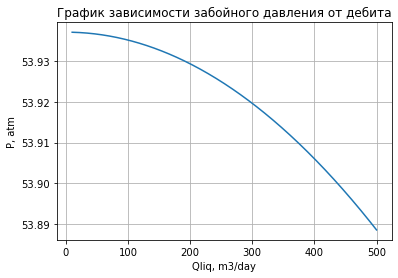

In [13]:
#График зависимости забойного давления от дебита
Q=np.linspace(10/86400,500/86400,491)
e=8*10**(-5)
d=148*10**(-3)
P_wh=22.9 * 101325 # P=22.9 atm
T_0=299.2 #T=26.2 C
T_wf=299.2+50
H=769
l=np.linspace(0,H,100)
p_res=[]
for q in Q:
    v=4*q/(const.pi*d**2)
    p=[]
    p.append(P_wh)
    for i in range(len(l)-1):
        p.append(p[-1]+ quad(dp_dx,l[i],l[i+1])[0])
#         print(p)    
    p_res.append(p[-1])
Q_days=[i*86400 for i in Q]
p_at = [i/101325 for i in p_res]
plt.plot(Q_days,p_at)
plt.title('График зависимости забойного давления от дебита')
plt.ylabel('P, atm')
plt.xlabel('Qliq, m3/day')
plt.grid()
plt.show()


41


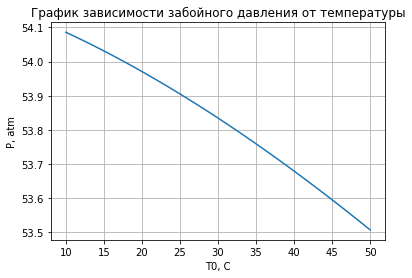

In [14]:
#Зависимость забойного давления от температуры 
Q=888/86400
e=8*10**(-5)
v=4*q/(const.pi*d**2)
d=148*10**(-3)
P_wh=22.9 * 101325 # P=22.9 atm
T_1=np.linspace(10+273,50+273,41)
T_2=np.linspace(60+273,100+273,41)
H=769
l=np.linspace(0,H,100)
p_res=[]
for dt in range (len(T_1)): 
    T_0=T_1[dt]
    T_wf=T_2[dt]
    p=[]
    p.append(P_wh)
    for i in range(len(l)-1):
        p.append(p[-1]+ quad(dp_dx,l[i],l[i+1])[0])
    #     print(p)   
    p_res.append(p[-1]/101325)   
T_C = [i-273 for i in T_1]
print(len(p_res))
plt.plot(T_C,p_res)
plt.title('График зависимости забойного давления от температуры')
plt.ylabel('P, atm')
plt.xlabel('T0, C')
plt.grid()
plt.show()

